### Enhanced Training of the GAN

Remember to **ONLY** uncomment and run the next two cells if **USING** Google Colab

In [ ]:
# from google.colab import drive
# drive.mount('/content/gdrive/')

In [ ]:
# import sys
# sys.path.append('/content/gdrive/MyDrive/ACSE-9')

In [ ]:
# Python ≥3.5 is required
import sys
assert sys.version_info >= (3, 5)

# Scikit-Learn ≥0.20 is required
import sklearn
assert sklearn.__version__ >= "0.20"

# TensorFlow ≥2.0 is required
import tensorflow as tf
from tensorflow import keras
assert tf.__version__ >= "2.0"

# Common imports
import numpy as np
import os

# To plot pretty figures
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

import pandas as pd
import time
import joblib

In [1]:
'''
  # Uncomment section if want to see GPU details on Google Colab

%tensorflow_version 2.x
import tensorflow as tf
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Select the Runtime > "Change runtime type" menu to enable a GPU accelerator, ')
  print('and then re-execute this cell.')
else:
  print(gpu_info)

'''

'\n  # Uncomment section if want to see GPU details on Google Colab\n\n%tensorflow_version 2.x\nimport tensorflow as tf\ndevice_name = tf.test.gpu_device_name()\nif device_name != \'/device:GPU:0\':\n  raise SystemError(\'GPU device not found\')\nprint(\'Found GPU at: {}\'.format(device_name))\n\ngpu_info = !nvidia-smi\ngpu_info = \'\n\'.join(gpu_info)\nif gpu_info.find(\'failed\') >= 0:\n  print(\'Select the Runtime > "Change runtime type" menu to enable a GPU accelerator, \')\n  print(\'and then re-execute this cell.\')\nelse:\n  print(gpu_info)\n\n'

### Loading in the Data

In [ ]:
enhanced_data_scaled = joblib.load('output_files/enhanced_data_scaled_410.pkl')
X_train_scaled = enhanced_data_scaled.copy()

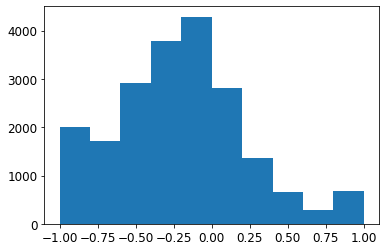

In [ ]:
'''
  Histogram showing the frequency distribution; ensuring scaling between [-1,1]
'''
plt.hist(X_train_scaled.flatten())
X_test_scaled = X_train_scaled.copy()

### Creating a TensorFlow Dataset and splitting it into batches

In [ ]:
def concat_timesteps(X_train, ntimes, step):
    '''
      The function takes in a 2D array, picks 9 time levels at a time and skips time levels if needed.  
      Parameters
      ----------

      X_train : 2D array
        Scaled enhanced array - (Time levels, No. reduced parameters)

      ntimes : int
        Number of consective outputs from the GAN

      step : int
        size of step to skip data
    '''
  
    X_train_concat = []
    for i in range(len(X_train) - ntimes*step):
        X_train_concat.append(X_train[i:i+ntimes*step:step])
    return np.array(X_train_concat) 

In [ ]:
ntimes = 9  # consecutive times for the GAN
step = 1 # step between times

X_train_concat = concat_timesteps(X_train_scaled, ntimes, step)
print("X_train_concat: ", np.shape(X_train_concat))

X_train_4d = X_train_concat.reshape((X_train_concat.shape[0], ntimes, X_train_concat.shape[2], 1))  #(148706, 100, 81, 1)
print("X_train_4d: ", X_train_4d.shape)

X_train_concat:  (401, 9, 50)
X_train_4d:  (401, 9, 50, 1)


Uncomment below if want to see available RAM on google colab

In [ ]:
'''
  # Uncomment if want to see available RAM on google colab


from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('To enable a high-RAM runtime, select the Runtime > "Change runtime type"')
  print('menu, and then select High-RAM in the Runtime shape dropdown. Then, ')
  print('re-execute this cell.')
else:
  print('You are using a high-RAM runtime!')

'''

Your runtime has 13.6 gigabytes of available RAM

To enable a high-RAM runtime, select the Runtime > "Change runtime type"
menu, and then select High-RAM in the Runtime shape dropdown. Then, 
re-execute this cell.


In [ ]:
# defining some hyper-parameters
BATCH_SIZE = 256
latent_space = 50

# Create a tensorflow dataset and split it into batches
train_dataset = tf.data.Dataset.from_tensor_slices(X_train_4d)
# shuffles at random the elements of the dataset
train_dataset = train_dataset.shuffle(len(X_train_4d))
# combines the elements of the dataset into batches
train_dataset = train_dataset.batch(BATCH_SIZE)
for data in train_dataset:
    print(data)
    break


tf.Tensor(
[[[[-0.11567001]
   [ 0.08443908]
   [-0.89334369]
   ...
   [-0.16421849]
   [ 0.98415711]
   [-0.72877224]]

  [[-0.12457354]
   [ 0.0900019 ]
   [-0.8748408 ]
   ...
   [-0.17037391]
   [ 0.98373484]
   [-0.73822222]]

  [[-0.12945322]
   [ 0.0019441 ]
   [-0.84957837]
   ...
   [-0.17660412]
   [ 0.98329499]
   [-0.74693306]]

  ...

  [[-0.15749677]
   [-0.11576322]
   [-0.87498573]
   ...
   [-0.20519613]
   [ 0.98071294]
   [-0.77475557]]

  [[-0.16361576]
   [-0.13528481]
   [-0.88510352]
   ...
   [-0.21269901]
   [ 0.97993213]
   [-0.78088204]]

  [[-0.16724909]
   [-0.15286394]
   [-0.88372016]
   ...
   [-0.21855674]
   [ 0.97931193]
   [-0.78558792]]]


 [[[-0.0357836 ]
   [ 0.02863753]
   [-0.83478243]
   ...
   [-0.0118171 ]
   [ 0.99567413]
   [-0.64230891]]

  [[-0.04228312]
   [-0.03538942]
   [-0.84141328]
   ...
   [-0.02160174]
   [ 0.99550928]
   [-0.6561315 ]]

  [[-0.04985232]
   [-0.09319205]
   [-0.8736674 ]
   ...
   [-0.03376788]
   [ 0.9952204 ]


# Make Generator

In [ ]:
def make_generator_model():
    '''
      Generator to produce a new synthietic instance of the learned distribution 
      from an input of random noise
      
      conv2DTranspose (upsampling) layers
      Batch normalisation
      Leaky ReLU activation function
      
    '''
    model = tf.keras.Sequential()
    model.add(keras.layers.Dense(2*20*256, use_bias=False, input_shape=(latent_space,)))
    model.add(keras.layers.BatchNormalization())
    model.add(keras.layers.LeakyReLU(0.2))

    model.add(keras.layers.Reshape((2, 20, 256)))

    model.add(keras.layers.Conv2DTranspose(128, (3, 3),strides=(2, 1), use_bias=False))
    model.add(keras.layers.BatchNormalization())
    model.add(keras.layers.LeakyReLU(0.3))

    model.add(keras.layers.Conv2DTranspose(64, (3, 3), strides=(1, 2), output_padding=[0,0], use_bias=False))
    model.add(keras.layers.BatchNormalization())
    model.add(keras.layers.LeakyReLU(0.3))

    model.add(keras.layers.Conv2DTranspose(1, (3, 6), strides=(1, 1), output_padding=[0,0], use_bias=False, activation='tanh'))

    return model

In [ ]:
generator = make_generator_model()
generator.summary()

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4 (Dense)              (None, 10240)             512000    
_________________________________________________________________
batch_normalization_8 (Batch (None, 10240)             40960     
_________________________________________________________________
leaky_re_lu_10 (LeakyReLU)   (None, 10240)             0         
_________________________________________________________________
reshape_2 (Reshape)          (None, 2, 20, 256)        0         
_________________________________________________________________
conv2d_transpose_6 (Conv2DTr (None, 5, 22, 128)        294912    
_________________________________________________________________
batch_normalization_9 (Batch (None, 5, 22, 128)        512       
_________________________________________________________________
leaky_re_lu_11 (LeakyReLU)   (None, 5, 22, 128)       

### Create Random Input Noise

For a random noise input, we generate an output shown below:

(1, 50)
(1, 9, 50, 1)


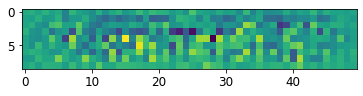

In [ ]:
noise = tf.random.normal([1, latent_space])
print(noise.shape)
generated_image = generator(noise, training=False)
print(generated_image.shape)
plt.imshow(generated_image[0, :, :, 0])

### Make Discriminator

In [ ]:
inp_shape = generated_image.shape[1:]

def make_discriminator_model():
    '''
      Discriminator to train adversarially with the generator in deducting
      whether the input sample is from the real or generated dataset

      conv2D layers
      Dropout
      Leaky ReLU activation function
      
    '''
    model = tf.keras.Sequential()
    model.add(keras.layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same',
                                    input_shape=inp_shape))
                                     
    model.add(keras.layers.LeakyReLU(0.2))
    model.add(keras.layers.Dropout(0.3)) # decrease hyper learning distribution

    model.add(keras.layers.Conv2D(128, (3, 3), strides=(1, 2), padding='same'))
    model.add(keras.layers.BatchNormalization())
    model.add(keras.layers.LeakyReLU(0.2))
    model.add(keras.layers.Dropout(0.3)) # decrease hyper learning distribution

    model.add(keras.layers.Flatten())
    model.add(keras.layers.Dense(1))

    return model

In [ ]:
discriminator = make_discriminator_model()
discriminator.summary()

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_4 (Conv2D)            (None, 5, 25, 64)         1664      
_________________________________________________________________
leaky_re_lu_13 (LeakyReLU)   (None, 5, 25, 64)         0         
_________________________________________________________________
dropout_4 (Dropout)          (None, 5, 25, 64)         0         
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 5, 13, 128)        73856     
_________________________________________________________________
batch_normalization_11 (Batc (None, 5, 13, 128)        512       
_________________________________________________________________
leaky_re_lu_14 (LeakyReLU)   (None, 5, 13, 128)        0         
_________________________________________________________________
dropout_5 (Dropout)          (None, 5, 13, 128)       

In [ ]:
decision = discriminator(generated_image)
print (decision)

tf.Tensor([[0.00116535]], shape=(1, 1), dtype=float32)


### Creating GAN by combining both Models

In [ ]:
gan = keras.models.Sequential([generator, discriminator])

### Define Losses and Optimizers

In [ ]:
# This method returns a helper function to compute cross entropy loss
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_output, fake_output):
    '''
      This function determines the discriminator loss
      Parameters
      ----------

      real_output : float32

      fake_output : float32

      Returns
      ----------

      total_loss : float32

    '''
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake_output):
    '''
      This function determines the generator loss
      Parameters
      ----------

      fake_output : float32

      Returns
      ----------

      cross entropy : float32

    '''
    return cross_entropy(tf.ones_like(fake_output), fake_output)

generator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)
discriminator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)

In [ ]:
'''
  Discriminator and generator optimizers differ as the networks will train separately
'''
generator_optimizer = tf.keras.optimizers.Adam(2e-3, 0.7, 0.999)
discriminator_optimizer = tf.keras.optimizers.Adam(5e-3, 0.7, 0.999)


In [ ]:
# logs to follow losses on tensorboard

generator_log_dir = 'output_files/logs/generator'
discriminator_log_dir = 'output_files/logs/discriminator'

generator_summary_writer = tf.summary.create_file_writer(generator_log_dir)
discriminator_summary_writer = tf.summary.create_file_writer(discriminator_log_dir)

# Define Training Loop

In [ ]:
num_examples_to_generate = 9

# You will reuse this seed overtime (so it's easier) to visualize progress in the animated GIF)
seed = tf.random.normal([num_examples_to_generate, latent_space])
print(seed.shape)


(9, 50)


In [ ]:
# Notice the use of `tf.function`
# This annotation causes the function to be "compiled".
@tf.function
def train_gen_step(batch):
    '''
      This function updates the generator, through the gradients calculated
      Parameters
      ----------

      batch : float64
        set of images drawn from the training set
    '''
    noise = tf.random.normal([BATCH_SIZE, latent_space])
    
    with tf.GradientTape() as gen_tape:
        generated_images = generator(noise, training=True)
        fake_output = discriminator(generated_images, training=True)
        real_output = discriminator(batch, training=True)
        
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    
    generator_mean_loss(gen_loss)

In [ ]:
@tf.function
def train_disc_step(batch):
    '''
      This function updates the discriminator, through the gradients calculated
      Parameters
      ----------

      batch : float64
        set of images drawn from the training set
    '''

    noise = tf.random.normal([BATCH_SIZE, latent_space])
    
    with tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)
        fake_output = discriminator(generated_images, training=True)
        real_output = discriminator(batch, training=True)
        
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    
    #generator_mean_loss(gen_loss)
    discriminator_mean_loss(disc_loss)


In [ ]:
def train(dataset, epochs):
    '''
      Training loop of the GAN
      Parameters
      ----------

      dataset : batch dataset
        set of images drawn from the real training set

      epochs : int
        number of passes the training loop occurs for

      Returns
      ---------

      hist : list
        contains subsequent epoch losses of the generator and discriminator
    '''
    # variables defined for testing
    gen_step_cnt = 0
    disc_step_cnt = 0

    # holds subsequent generator and discriminator losses
    hist = []
    for epoch in range(epochs):
        start = time.time()
        print("Epoch {}/{}".format(epoch + 1, epochs))   

        batch_num = 0

        # Training the generator twice as much as the discriminator
        for batch in dataset:
          if batch_num % 3 == 0:
            train_disc_step(batch)
            disc_step_cnt += 1
            # generator train step
            train_gen_step(batch)
            gen_step_cnt += 1
            with discriminator_summary_writer.as_default():
              tf.summary.scalar('loss', discriminator_mean_loss.result(), step=epoch)
            with generator_summary_writer.as_default():
              tf.summary.scalar('loss', generator_mean_loss.result(), step=epoch)
          else:
            # gen training without addition discrim training
            train_gen_step(batch)
            gen_step_cnt += 1
            with generator_summary_writer.as_default():
              tf.summary.scalar('loss', generator_mean_loss.result(), step=epoch)
          batch_num += 1
        
        hist.append([generator_mean_loss.result().numpy(), discriminator_mean_loss.result().numpy()])

        # reset states
        generator_mean_loss.reset_states()
        discriminator_mean_loss.reset_states()
        print ('{:.0f}s'.format( time.time()-start))


        #Global variables are used below
        if epoch%100 == 0: 
            
          print("generator loss: ", hist[-1][0])
          print("discriminator loss: ", hist[-1][-1])
          # plotting and printing loss
          print('Loss: ')
          fig, ax = plt.subplots(1,1, figsize=[20,10])
          ax.plot(hist)
          ax.legend(['loss_gen', 'loss_disc'])
          ax.set_yscale('log')
          ax.grid()
          plt.show()
            
    return hist

In [ ]:
train_dataset

<BatchDataset shapes: (None, 9, 50, 1), types: tf.float64>

Epoch 1/50000
3s
generator loss:  3.9727805
discriminator loss:  1.5836798
Loss: 


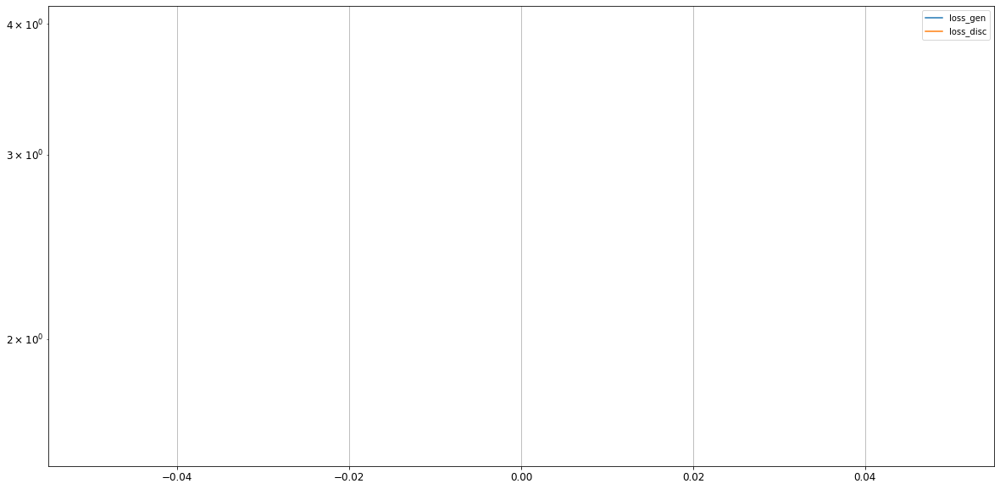

Epoch 2/50000
0s
Epoch 3/50000
0s
Epoch 4/50000
0s
Epoch 5/50000
0s
Epoch 6/50000
0s
Epoch 7/50000
0s
Epoch 8/50000
0s
Epoch 9/50000
0s
Epoch 10/50000
0s
Epoch 11/50000
0s
Epoch 12/50000
0s
Epoch 13/50000
0s
Epoch 14/50000
0s
Epoch 15/50000
0s
Epoch 16/50000
0s
Epoch 17/50000
0s
Epoch 18/50000
0s
Epoch 19/50000
0s
Epoch 20/50000
0s
Epoch 21/50000
0s
Epoch 22/50000
0s
Epoch 23/50000
0s
Epoch 24/50000
0s
Epoch 25/50000
0s
Epoch 26/50000
0s
Epoch 27/50000
0s
Epoch 28/50000
0s
Epoch 29/50000
0s
Epoch 30/50000
0s
Epoch 31/50000
0s
Epoch 32/50000
0s
Epoch 33/50000
0s
Epoch 34/50000
0s
Epoch 35/50000
0s
Epoch 36/50000
0s
Epoch 37/50000
0s
Epoch 38/50000
0s
Epoch 39/50000
0s
Epoch 40/50000
0s
Epoch 41/50000
0s
Epoch 42/50000
0s
Epoch 43/50000
0s
Epoch 44/50000
0s
Epoch 45/50000
0s
Epoch 46/50000
0s
Epoch 47/50000
0s
Epoch 48/50000
0s
Epoch 49/50000
0s
Epoch 50/50000
0s
Epoch 51/50000
0s
Epoch 52/50000
0s
Epoch 53/50000
0s
Epoch 54/50000
0s
Epoch 55/50000
0s
Epoch 56/50000
0s
Epoch 57/50000
0s


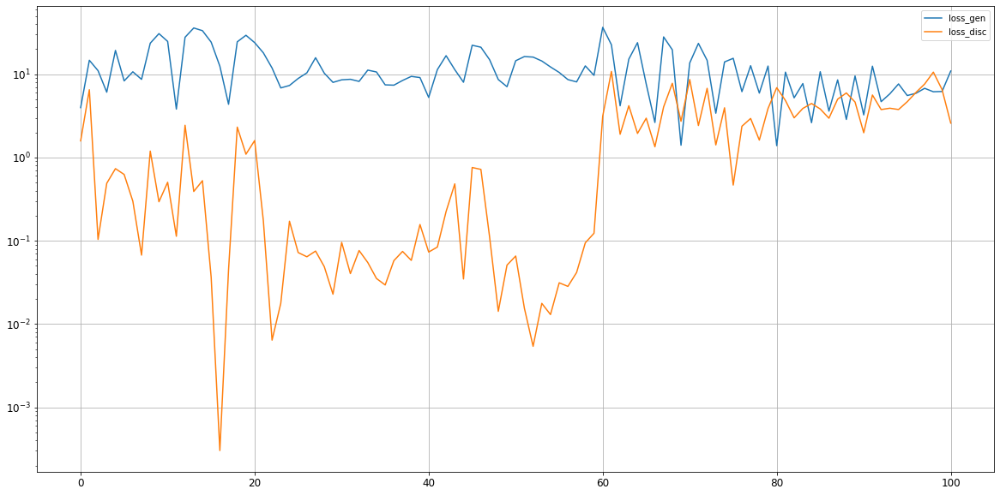

Epoch 102/50000
0s
Epoch 103/50000
0s
Epoch 104/50000
0s
Epoch 105/50000
0s
Epoch 106/50000
0s
Epoch 107/50000
0s
Epoch 108/50000
0s
Epoch 109/50000
0s
Epoch 110/50000
0s
Epoch 111/50000
0s
Epoch 112/50000
0s
Epoch 113/50000
0s
Epoch 114/50000
0s
Epoch 115/50000
0s
Epoch 116/50000
0s
Epoch 117/50000
0s
Epoch 118/50000
0s
Epoch 119/50000
0s
Epoch 120/50000
0s
Epoch 121/50000
0s
Epoch 122/50000
0s
Epoch 123/50000
0s
Epoch 124/50000
0s
Epoch 125/50000
0s
Epoch 126/50000
0s
Epoch 127/50000
0s
Epoch 128/50000
0s
Epoch 129/50000
0s
Epoch 130/50000
0s
Epoch 131/50000
0s
Epoch 132/50000
0s
Epoch 133/50000
0s
Epoch 134/50000
0s
Epoch 135/50000
0s
Epoch 136/50000
0s
Epoch 137/50000
0s
Epoch 138/50000
0s
Epoch 139/50000
0s
Epoch 140/50000
0s
Epoch 141/50000
0s
Epoch 142/50000
0s
Epoch 143/50000
0s
Epoch 144/50000
0s
Epoch 145/50000
0s
Epoch 146/50000
0s
Epoch 147/50000
0s
Epoch 148/50000
0s
Epoch 149/50000
0s
Epoch 150/50000
0s
Epoch 151/50000
0s
Epoch 152/50000
0s
Epoch 153/50000
0s
Epoch 154/50

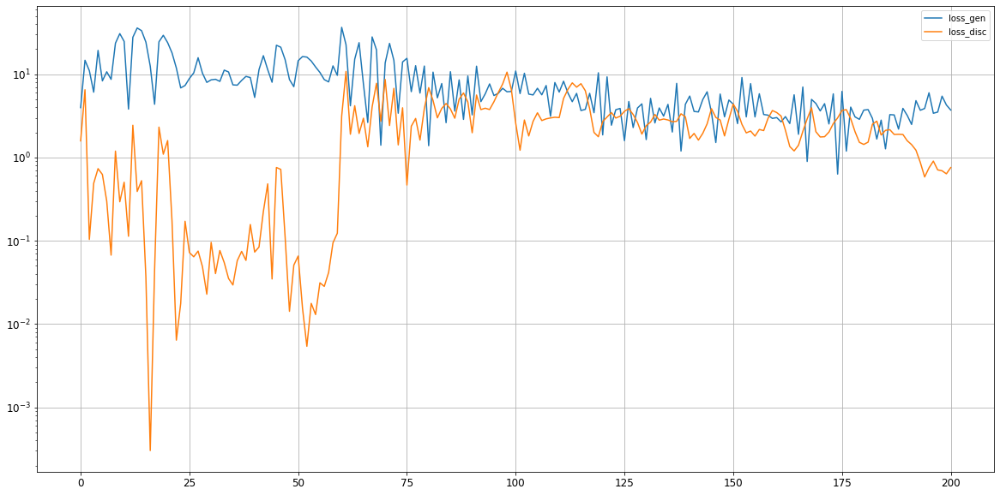

Epoch 202/50000
0s
Epoch 203/50000
0s
Epoch 204/50000
0s
Epoch 205/50000
0s
Epoch 206/50000
0s
Epoch 207/50000
0s
Epoch 208/50000
0s
Epoch 209/50000
0s
Epoch 210/50000
0s
Epoch 211/50000
0s
Epoch 212/50000
0s
Epoch 213/50000
0s
Epoch 214/50000
0s
Epoch 215/50000
0s
Epoch 216/50000
0s
Epoch 217/50000
0s
Epoch 218/50000
0s
Epoch 219/50000
0s
Epoch 220/50000
0s
Epoch 221/50000
0s
Epoch 222/50000
0s
Epoch 223/50000
0s
Epoch 224/50000
0s
Epoch 225/50000
0s
Epoch 226/50000
0s
Epoch 227/50000
0s
Epoch 228/50000
0s
Epoch 229/50000
0s
Epoch 230/50000
0s
Epoch 231/50000
0s
Epoch 232/50000
0s
Epoch 233/50000
0s
Epoch 234/50000
0s
Epoch 235/50000
0s
Epoch 236/50000
0s
Epoch 237/50000
0s
Epoch 238/50000
0s
Epoch 239/50000
0s
Epoch 240/50000
0s
Epoch 241/50000
0s
Epoch 242/50000
0s
Epoch 243/50000
0s
Epoch 244/50000
0s
Epoch 245/50000
0s
Epoch 246/50000
0s
Epoch 247/50000
0s
Epoch 248/50000
0s
Epoch 249/50000
0s
Epoch 250/50000
0s
Epoch 251/50000
0s
Epoch 252/50000
0s
Epoch 253/50000
0s
Epoch 254/50

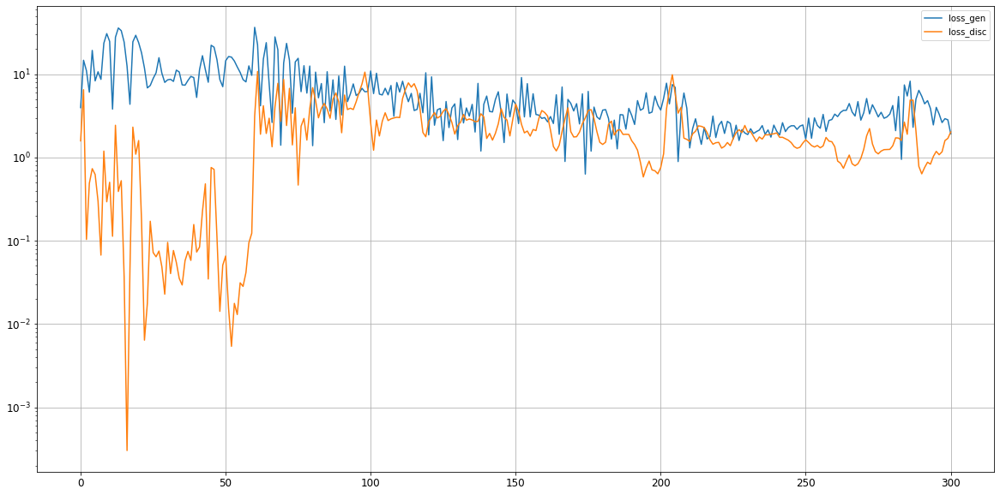

Epoch 302/50000
0s
Epoch 303/50000
0s
Epoch 304/50000
0s
Epoch 305/50000
0s
Epoch 306/50000
0s
Epoch 307/50000
0s
Epoch 308/50000
0s
Epoch 309/50000
0s
Epoch 310/50000
0s
Epoch 311/50000
0s
Epoch 312/50000
0s
Epoch 313/50000
0s
Epoch 314/50000
0s
Epoch 315/50000
0s
Epoch 316/50000
0s
Epoch 317/50000
0s
Epoch 318/50000
0s
Epoch 319/50000
0s
Epoch 320/50000
0s
Epoch 321/50000
0s
Epoch 322/50000
0s
Epoch 323/50000
0s
Epoch 324/50000
0s
Epoch 325/50000
0s
Epoch 326/50000
0s
Epoch 327/50000
0s
Epoch 328/50000
0s
Epoch 329/50000
0s
Epoch 330/50000
0s
Epoch 331/50000
0s
Epoch 332/50000
0s
Epoch 333/50000
0s
Epoch 334/50000
0s
Epoch 335/50000
0s
Epoch 336/50000
0s
Epoch 337/50000
0s
Epoch 338/50000
0s
Epoch 339/50000
0s
Epoch 340/50000
0s
Epoch 341/50000
0s
Epoch 342/50000
0s
Epoch 343/50000
0s
Epoch 344/50000
0s
Epoch 345/50000
0s
Epoch 346/50000
0s
Epoch 347/50000
0s
Epoch 348/50000
0s
Epoch 349/50000
0s
Epoch 350/50000
0s
Epoch 351/50000
0s
Epoch 352/50000
0s
Epoch 353/50000
0s
Epoch 354/50

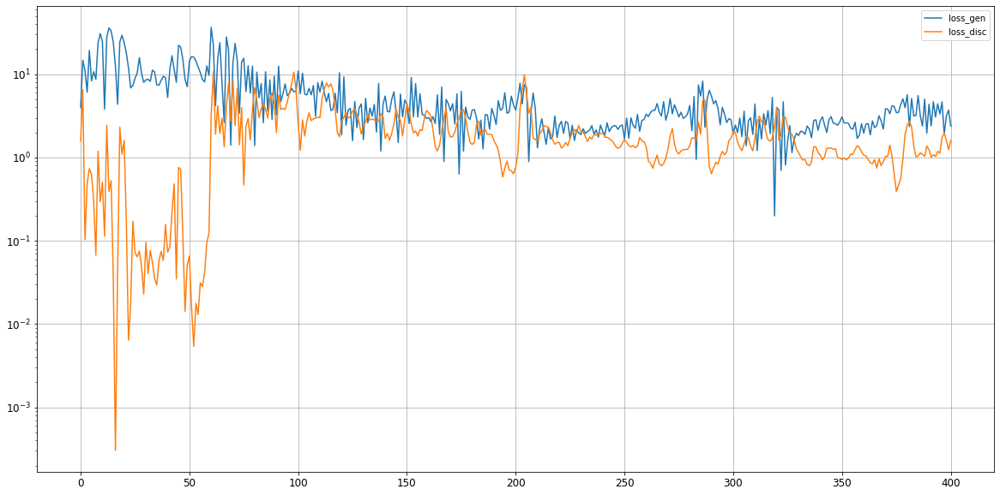

Epoch 402/50000
0s
Epoch 403/50000
0s
Epoch 404/50000
0s
Epoch 405/50000
0s
Epoch 406/50000
0s
Epoch 407/50000
0s
Epoch 408/50000
0s
Epoch 409/50000
0s
Epoch 410/50000
0s
Epoch 411/50000
0s
Epoch 412/50000
0s
Epoch 413/50000
0s
Epoch 414/50000
0s
Epoch 415/50000
0s
Epoch 416/50000
0s
Epoch 417/50000
0s
Epoch 418/50000
0s
Epoch 419/50000
0s
Epoch 420/50000
0s
Epoch 421/50000
0s
Epoch 422/50000
0s
Epoch 423/50000
0s
Epoch 424/50000
0s
Epoch 425/50000
0s
Epoch 426/50000
0s
Epoch 427/50000
0s
Epoch 428/50000
0s
Epoch 429/50000
0s
Epoch 430/50000
0s
Epoch 431/50000
0s
Epoch 432/50000
0s
Epoch 433/50000
0s
Epoch 434/50000
0s
Epoch 435/50000
0s
Epoch 436/50000
0s
Epoch 437/50000
0s
Epoch 438/50000
0s
Epoch 439/50000
0s
Epoch 440/50000
0s
Epoch 441/50000
0s
Epoch 442/50000
0s
Epoch 443/50000
0s
Epoch 444/50000
0s
Epoch 445/50000
0s
Epoch 446/50000
0s
Epoch 447/50000
0s
Epoch 448/50000
0s
Epoch 449/50000
0s
Epoch 450/50000
0s
Epoch 451/50000
0s
Epoch 452/50000
0s
Epoch 453/50000
0s
Epoch 454/50

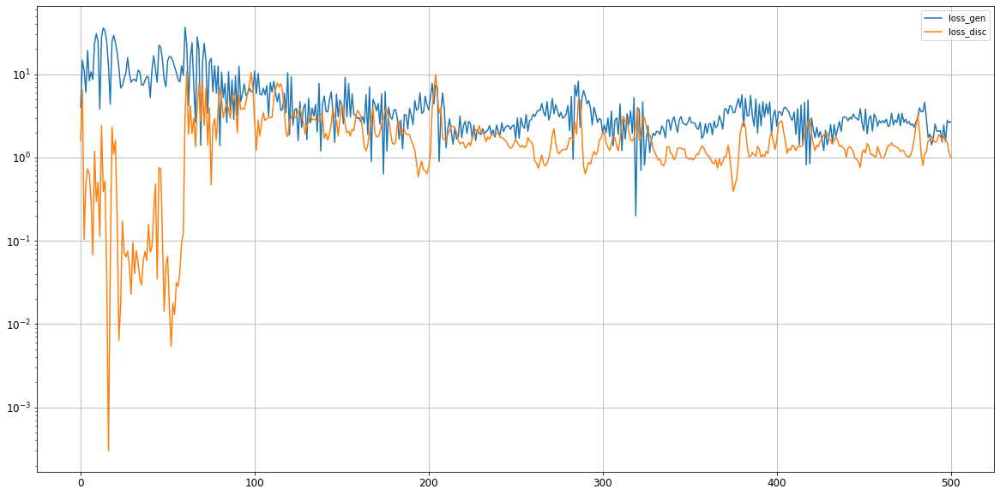

Epoch 502/50000
0s
Epoch 503/50000
0s
Epoch 504/50000
0s
Epoch 505/50000
0s
Epoch 506/50000
0s
Epoch 507/50000
0s
Epoch 508/50000
0s
Epoch 509/50000
0s
Epoch 510/50000
0s
Epoch 511/50000
0s
Epoch 512/50000
0s
Epoch 513/50000
0s
Epoch 514/50000
0s
Epoch 515/50000
0s
Epoch 516/50000
0s
Epoch 517/50000
0s
Epoch 518/50000
0s
Epoch 519/50000
0s
Epoch 520/50000
0s
Epoch 521/50000
0s
Epoch 522/50000
0s
Epoch 523/50000
0s
Epoch 524/50000
0s
Epoch 525/50000
0s
Epoch 526/50000
0s
Epoch 527/50000
0s
Epoch 528/50000
0s
Epoch 529/50000
0s
Epoch 530/50000
0s
Epoch 531/50000
0s
Epoch 532/50000
0s
Epoch 533/50000
0s
Epoch 534/50000
0s
Epoch 535/50000
0s
Epoch 536/50000
0s
Epoch 537/50000
0s
Epoch 538/50000
0s
Epoch 539/50000
0s
Epoch 540/50000
0s
Epoch 541/50000
0s
Epoch 542/50000
0s
Epoch 543/50000
0s
Epoch 544/50000
0s
Epoch 545/50000
0s
Epoch 546/50000
0s
Epoch 547/50000
0s
Epoch 548/50000
0s
Epoch 549/50000
0s
Epoch 550/50000
0s
Epoch 551/50000
0s
Epoch 552/50000
0s
Epoch 553/50000
0s
Epoch 554/50

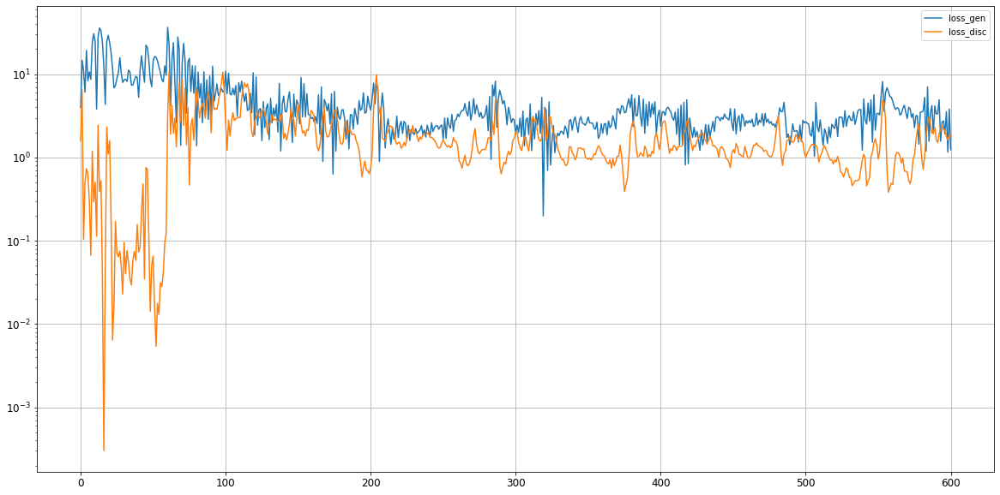

Epoch 602/50000
0s
Epoch 603/50000
0s
Epoch 604/50000
0s
Epoch 605/50000
0s
Epoch 606/50000
0s
Epoch 607/50000
0s
Epoch 608/50000
0s
Epoch 609/50000
0s
Epoch 610/50000
0s
Epoch 611/50000
0s
Epoch 612/50000
0s
Epoch 613/50000
0s
Epoch 614/50000
0s
Epoch 615/50000
0s
Epoch 616/50000
0s
Epoch 617/50000
0s
Epoch 618/50000
0s
Epoch 619/50000
0s
Epoch 620/50000
0s
Epoch 621/50000
0s
Epoch 622/50000
0s
Epoch 623/50000
0s
Epoch 624/50000
0s
Epoch 625/50000
0s
Epoch 626/50000
0s
Epoch 627/50000
0s
Epoch 628/50000
0s
Epoch 629/50000
0s
Epoch 630/50000
0s
Epoch 631/50000
0s
Epoch 632/50000
0s
Epoch 633/50000
0s
Epoch 634/50000
0s
Epoch 635/50000
0s
Epoch 636/50000
0s
Epoch 637/50000
0s
Epoch 638/50000
0s
Epoch 639/50000
0s
Epoch 640/50000
0s
Epoch 641/50000
0s
Epoch 642/50000
0s
Epoch 643/50000
0s
Epoch 644/50000
0s
Epoch 645/50000
0s
Epoch 646/50000
0s
Epoch 647/50000
0s
Epoch 648/50000
0s
Epoch 649/50000
0s
Epoch 650/50000
0s
Epoch 651/50000
0s
Epoch 652/50000
0s
Epoch 653/50000
0s
Epoch 654/50

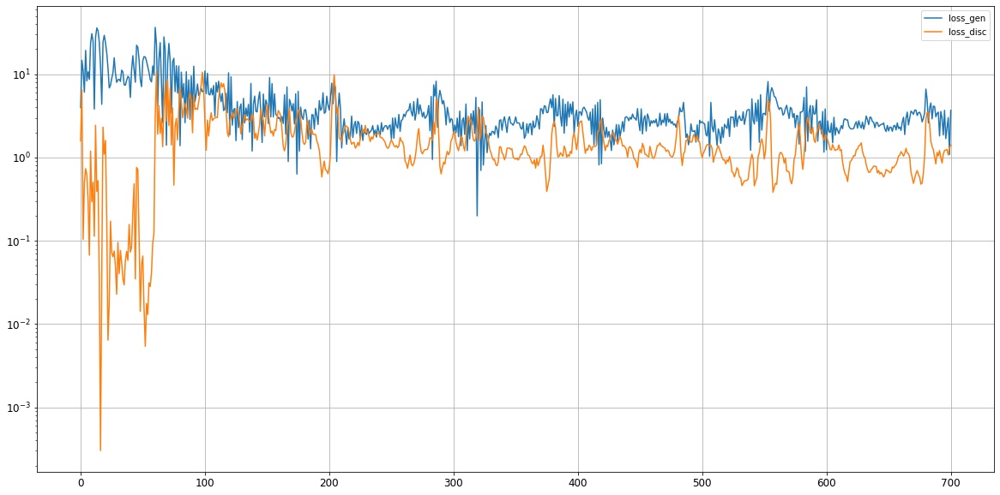

Epoch 702/50000
0s
Epoch 703/50000
0s
Epoch 704/50000
0s
Epoch 705/50000
0s
Epoch 706/50000
0s
Epoch 707/50000
0s
Epoch 708/50000
0s
Epoch 709/50000
0s
Epoch 710/50000
0s
Epoch 711/50000
0s
Epoch 712/50000
0s
Epoch 713/50000
0s
Epoch 714/50000
0s
Epoch 715/50000
0s
Epoch 716/50000
0s
Epoch 717/50000
0s
Epoch 718/50000
0s
Epoch 719/50000
0s
Epoch 720/50000
0s
Epoch 721/50000
0s
Epoch 722/50000
0s
Epoch 723/50000
0s
Epoch 724/50000
0s
Epoch 725/50000
0s
Epoch 726/50000
0s
Epoch 727/50000
0s
Epoch 728/50000
0s
Epoch 729/50000
0s
Epoch 730/50000
0s
Epoch 731/50000
0s
Epoch 732/50000
0s
Epoch 733/50000
0s
Epoch 734/50000
0s
Epoch 735/50000
0s
Epoch 736/50000
0s
Epoch 737/50000
0s
Epoch 738/50000
0s
Epoch 739/50000
0s
Epoch 740/50000
0s
Epoch 741/50000
0s
Epoch 742/50000
0s
Epoch 743/50000
0s
Epoch 744/50000
0s
Epoch 745/50000
0s
Epoch 746/50000
0s
Epoch 747/50000
0s
Epoch 748/50000
0s
Epoch 749/50000
0s
Epoch 750/50000
0s
Epoch 751/50000
0s
Epoch 752/50000
0s
Epoch 753/50000
0s
Epoch 754/50

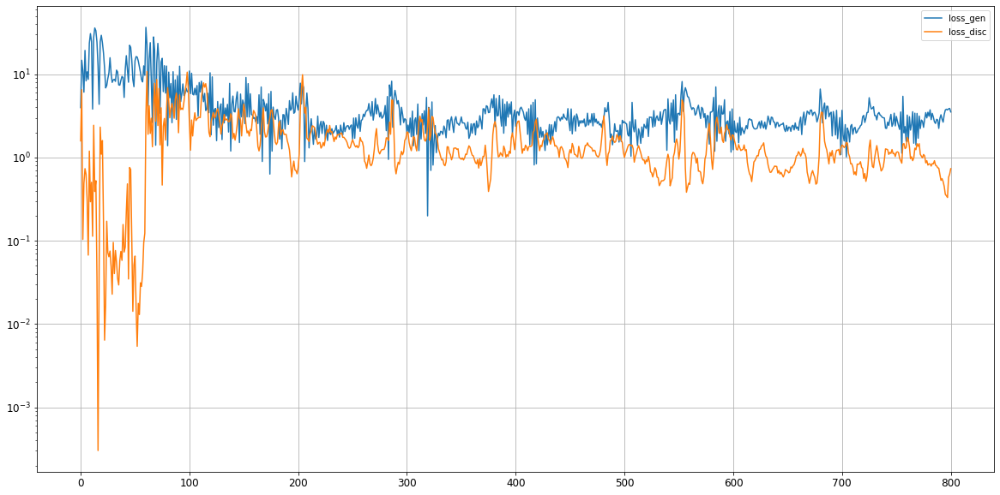

Epoch 802/50000
0s
Epoch 803/50000
0s
Epoch 804/50000
0s
Epoch 805/50000
0s
Epoch 806/50000
0s
Epoch 807/50000
0s
Epoch 808/50000
0s
Epoch 809/50000
0s
Epoch 810/50000
0s
Epoch 811/50000
0s
Epoch 812/50000
0s
Epoch 813/50000
0s
Epoch 814/50000
0s
Epoch 815/50000
0s
Epoch 816/50000
0s
Epoch 817/50000
0s
Epoch 818/50000
0s
Epoch 819/50000
0s
Epoch 820/50000
0s
Epoch 821/50000
0s
Epoch 822/50000
0s
Epoch 823/50000
0s
Epoch 824/50000
0s
Epoch 825/50000
0s
Epoch 826/50000
0s
Epoch 827/50000
0s
Epoch 828/50000
0s
Epoch 829/50000
0s
Epoch 830/50000
0s
Epoch 831/50000
0s
Epoch 832/50000
0s
Epoch 833/50000
0s
Epoch 834/50000
0s
Epoch 835/50000
0s
Epoch 836/50000
0s
Epoch 837/50000
0s
Epoch 838/50000
0s
Epoch 839/50000
0s
Epoch 840/50000
0s
Epoch 841/50000
0s
Epoch 842/50000
0s
Epoch 843/50000
0s
Epoch 844/50000
0s
Epoch 845/50000
0s
Epoch 846/50000
0s
Epoch 847/50000
0s
Epoch 848/50000
0s
Epoch 849/50000
0s
Epoch 850/50000
0s
Epoch 851/50000
0s
Epoch 852/50000
0s
Epoch 853/50000
0s
Epoch 854/50

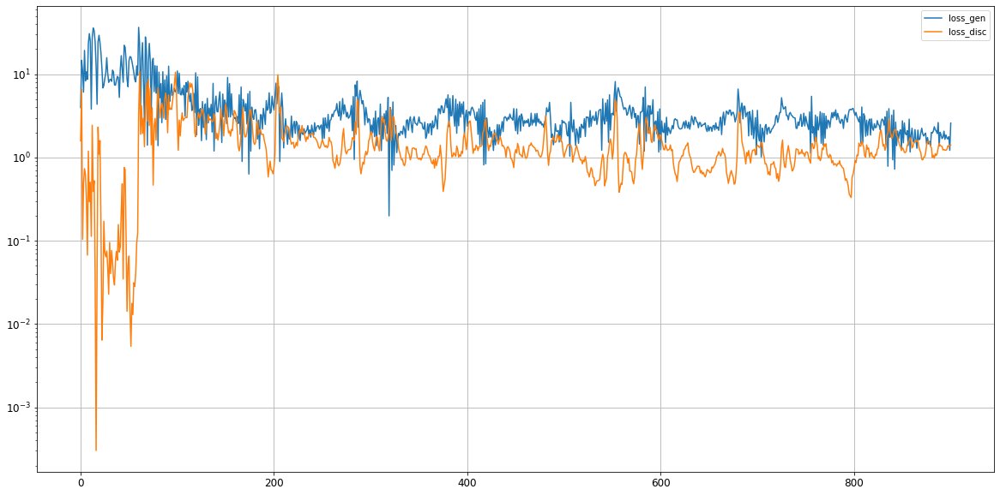

Epoch 902/50000
0s
Epoch 903/50000
0s
Epoch 904/50000
0s
Epoch 905/50000
0s
Epoch 906/50000
0s
Epoch 907/50000
0s
Epoch 908/50000
0s
Epoch 909/50000
0s
Epoch 910/50000
0s
Epoch 911/50000
0s
Epoch 912/50000
0s
Epoch 913/50000
0s
Epoch 914/50000
0s
Epoch 915/50000
0s
Epoch 916/50000
0s
Epoch 917/50000
0s
Epoch 918/50000
0s
Epoch 919/50000
0s
Epoch 920/50000
0s
Epoch 921/50000
0s
Epoch 922/50000
0s
Epoch 923/50000
0s
Epoch 924/50000
0s
Epoch 925/50000
0s
Epoch 926/50000
0s
Epoch 927/50000
0s
Epoch 928/50000
0s
Epoch 929/50000
0s
Epoch 930/50000
0s
Epoch 931/50000
0s
Epoch 932/50000
0s
Epoch 933/50000
0s
Epoch 934/50000
0s
Epoch 935/50000
0s
Epoch 936/50000
0s
Epoch 937/50000
0s
Epoch 938/50000
0s
Epoch 939/50000
0s
Epoch 940/50000
0s
Epoch 941/50000
0s
Epoch 942/50000
0s
Epoch 943/50000
0s
Epoch 944/50000
0s
Epoch 945/50000
0s
Epoch 946/50000
0s
Epoch 947/50000
0s
Epoch 948/50000
0s
Epoch 949/50000
0s
Epoch 950/50000
0s
Epoch 951/50000
0s
Epoch 952/50000
0s
Epoch 953/50000
0s
Epoch 954/50

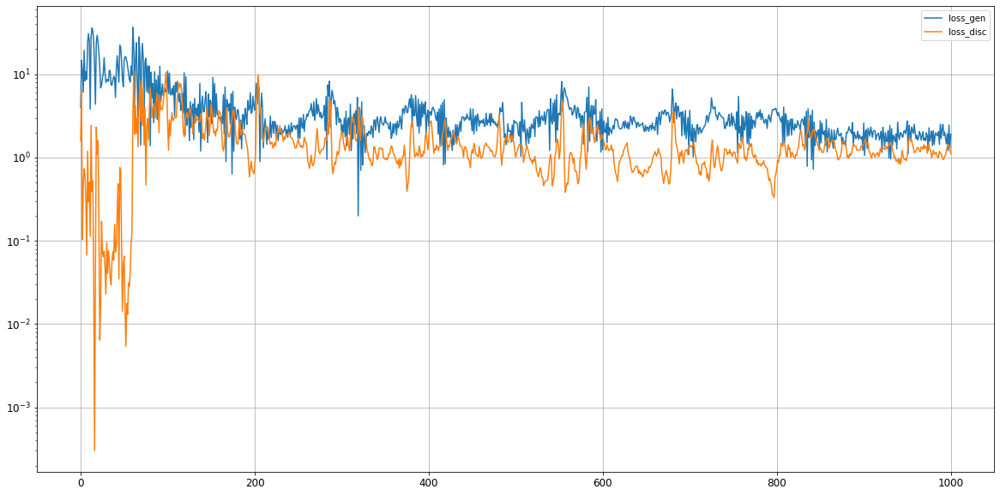

Epoch 1002/50000
0s
Epoch 1003/50000
0s
Epoch 1004/50000
0s
Epoch 1005/50000
0s
Epoch 1006/50000
0s
Epoch 1007/50000
0s
Epoch 1008/50000
0s
Epoch 1009/50000
0s
Epoch 1010/50000
0s
Epoch 1011/50000
0s
Epoch 1012/50000
0s
Epoch 1013/50000
0s
Epoch 1014/50000
0s
Epoch 1015/50000
0s
Epoch 1016/50000
0s
Epoch 1017/50000
0s
Epoch 1018/50000
0s
Epoch 1019/50000
0s
Epoch 1020/50000
0s
Epoch 1021/50000
0s
Epoch 1022/50000
0s
Epoch 1023/50000
0s
Epoch 1024/50000
0s
Epoch 1025/50000
0s
Epoch 1026/50000
0s
Epoch 1027/50000
0s
Epoch 1028/50000
0s
Epoch 1029/50000
0s
Epoch 1030/50000
0s
Epoch 1031/50000
0s
Epoch 1032/50000
0s
Epoch 1033/50000
0s
Epoch 1034/50000
0s
Epoch 1035/50000
0s
Epoch 1036/50000
0s
Epoch 1037/50000
0s
Epoch 1038/50000
0s
Epoch 1039/50000
0s
Epoch 1040/50000
0s
Epoch 1041/50000
0s
Epoch 1042/50000
0s
Epoch 1043/50000
0s
Epoch 1044/50000
0s
Epoch 1045/50000
0s
Epoch 1046/50000
0s
Epoch 1047/50000
0s
Epoch 1048/50000
0s
Epoch 1049/50000
0s
Epoch 1050/50000
0s
Epoch 1051/50000
0s


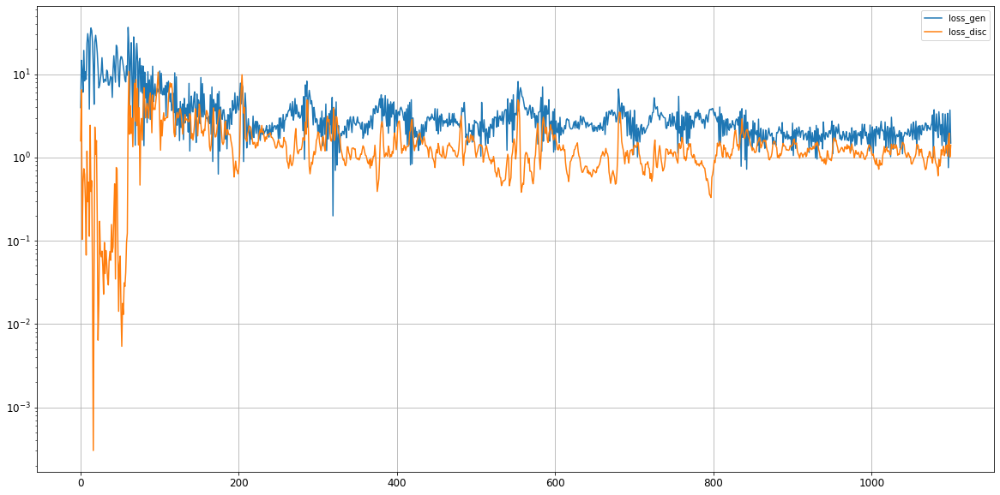

Epoch 1102/50000
0s
Epoch 1103/50000
0s
Epoch 1104/50000
0s
Epoch 1105/50000
0s
Epoch 1106/50000
0s
Epoch 1107/50000
0s
Epoch 1108/50000
0s
Epoch 1109/50000
0s
Epoch 1110/50000
0s
Epoch 1111/50000
0s
Epoch 1112/50000
0s
Epoch 1113/50000
0s
Epoch 1114/50000
0s
Epoch 1115/50000
0s
Epoch 1116/50000
0s
Epoch 1117/50000
0s
Epoch 1118/50000
0s
Epoch 1119/50000
0s
Epoch 1120/50000
0s
Epoch 1121/50000
0s
Epoch 1122/50000
0s
Epoch 1123/50000
0s
Epoch 1124/50000
0s
Epoch 1125/50000
0s
Epoch 1126/50000
0s
Epoch 1127/50000
0s
Epoch 1128/50000
0s
Epoch 1129/50000
0s
Epoch 1130/50000
0s
Epoch 1131/50000
0s
Epoch 1132/50000
0s
Epoch 1133/50000
0s
Epoch 1134/50000
0s
Epoch 1135/50000
0s
Epoch 1136/50000
0s
Epoch 1137/50000
0s
Epoch 1138/50000
0s
Epoch 1139/50000
0s
Epoch 1140/50000
0s
Epoch 1141/50000
0s
Epoch 1142/50000
0s
Epoch 1143/50000
0s
Epoch 1144/50000
0s
Epoch 1145/50000
0s
Epoch 1146/50000
0s
Epoch 1147/50000
0s
Epoch 1148/50000
0s
Epoch 1149/50000
0s
Epoch 1150/50000
0s
Epoch 1151/50000
0s


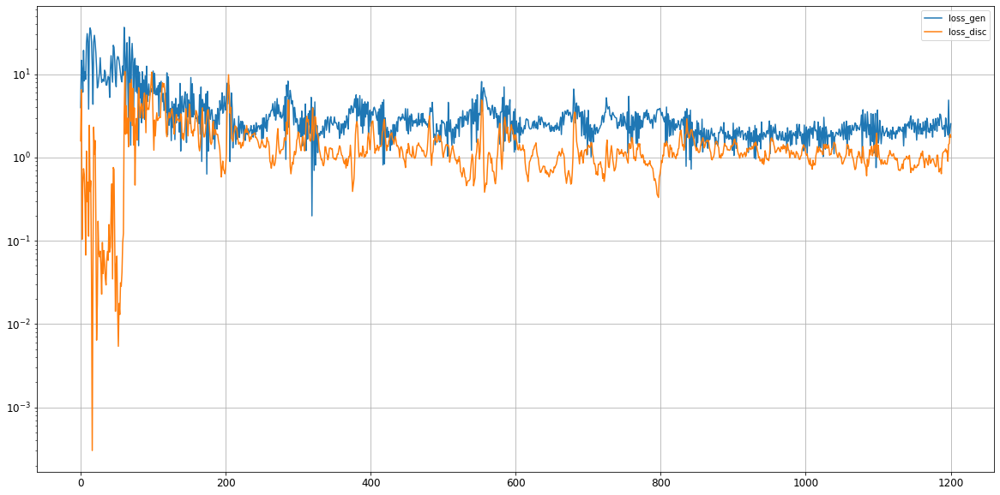

Epoch 1202/50000
0s
Epoch 1203/50000
0s
Epoch 1204/50000
0s
Epoch 1205/50000
0s
Epoch 1206/50000
0s
Epoch 1207/50000
0s
Epoch 1208/50000
0s
Epoch 1209/50000
0s
Epoch 1210/50000
0s
Epoch 1211/50000
0s
Epoch 1212/50000
0s
Epoch 1213/50000
0s
Epoch 1214/50000
0s
Epoch 1215/50000
0s
Epoch 1216/50000
0s
Epoch 1217/50000
0s
Epoch 1218/50000
0s
Epoch 1219/50000
0s
Epoch 1220/50000
0s
Epoch 1221/50000
0s
Epoch 1222/50000
0s
Epoch 1223/50000
0s
Epoch 1224/50000
0s
Epoch 1225/50000
0s
Epoch 1226/50000
0s
Epoch 1227/50000
0s
Epoch 1228/50000
0s
Epoch 1229/50000
0s
Epoch 1230/50000
0s
Epoch 1231/50000
0s
Epoch 1232/50000
0s
Epoch 1233/50000
0s
Epoch 1234/50000
0s
Epoch 1235/50000
0s
Epoch 1236/50000
0s
Epoch 1237/50000
0s
Epoch 1238/50000
0s
Epoch 1239/50000
0s
Epoch 1240/50000
0s
Epoch 1241/50000
0s
Epoch 1242/50000
0s
Epoch 1243/50000
0s
Epoch 1244/50000
0s
Epoch 1245/50000
0s
Epoch 1246/50000
0s
Epoch 1247/50000
0s
Epoch 1248/50000
0s
Epoch 1249/50000
0s
Epoch 1250/50000
0s
Epoch 1251/50000
0s


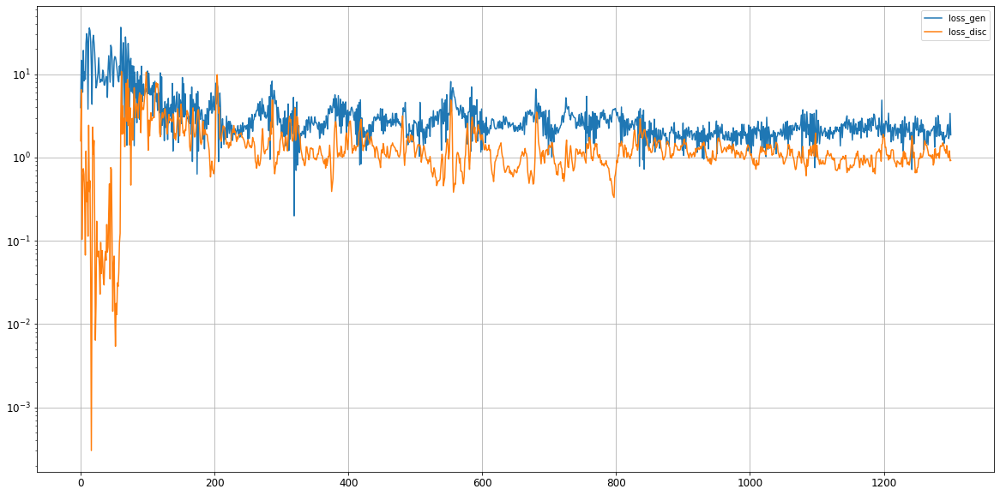

Epoch 1302/50000
0s
Epoch 1303/50000
0s
Epoch 1304/50000
0s
Epoch 1305/50000
0s
Epoch 1306/50000
0s
Epoch 1307/50000
0s
Epoch 1308/50000
0s
Epoch 1309/50000
0s
Epoch 1310/50000
0s
Epoch 1311/50000
0s
Epoch 1312/50000
0s
Epoch 1313/50000
0s
Epoch 1314/50000
0s
Epoch 1315/50000
0s
Epoch 1316/50000
0s
Epoch 1317/50000
0s
Epoch 1318/50000
0s
Epoch 1319/50000
0s
Epoch 1320/50000
0s
Epoch 1321/50000
0s
Epoch 1322/50000
0s
Epoch 1323/50000
0s
Epoch 1324/50000
0s
Epoch 1325/50000
0s
Epoch 1326/50000
0s
Epoch 1327/50000
0s
Epoch 1328/50000
0s
Epoch 1329/50000
0s
Epoch 1330/50000
0s
Epoch 1331/50000
0s
Epoch 1332/50000
0s
Epoch 1333/50000
0s
Epoch 1334/50000
0s
Epoch 1335/50000
0s
Epoch 1336/50000
0s
Epoch 1337/50000
0s
Epoch 1338/50000
0s
Epoch 1339/50000
0s
Epoch 1340/50000
0s
Epoch 1341/50000
0s
Epoch 1342/50000
0s
Epoch 1343/50000
0s
Epoch 1344/50000
0s
Epoch 1345/50000
0s
Epoch 1346/50000
0s
Epoch 1347/50000
0s
Epoch 1348/50000
0s
Epoch 1349/50000
0s
Epoch 1350/50000
0s
Epoch 1351/50000
0s


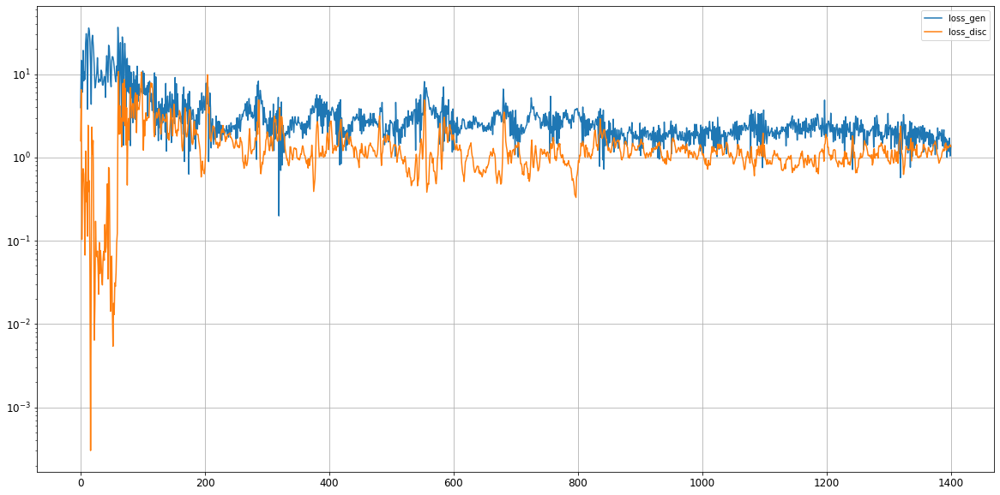

Epoch 1402/50000
0s
Epoch 1403/50000
0s
Epoch 1404/50000
0s
Epoch 1405/50000
0s
Epoch 1406/50000
0s
Epoch 1407/50000
0s
Epoch 1408/50000
0s
Epoch 1409/50000
0s
Epoch 1410/50000
0s
Epoch 1411/50000
0s
Epoch 1412/50000
0s
Epoch 1413/50000
0s
Epoch 1414/50000
0s
Epoch 1415/50000
0s
Epoch 1416/50000
0s
Epoch 1417/50000
0s
Epoch 1418/50000
0s
Epoch 1419/50000
0s
Epoch 1420/50000
0s
Epoch 1421/50000
0s
Epoch 1422/50000
0s
Epoch 1423/50000
0s
Epoch 1424/50000
0s
Epoch 1425/50000
0s
Epoch 1426/50000
0s
Epoch 1427/50000
0s
Epoch 1428/50000
0s
Epoch 1429/50000
0s
Epoch 1430/50000
0s
Epoch 1431/50000
0s
Epoch 1432/50000
0s
Epoch 1433/50000
0s
Epoch 1434/50000
0s
Epoch 1435/50000
0s
Epoch 1436/50000
0s
Epoch 1437/50000
0s
Epoch 1438/50000
0s
Epoch 1439/50000
0s
Epoch 1440/50000
0s
Epoch 1441/50000
0s
Epoch 1442/50000
0s
Epoch 1443/50000
0s
Epoch 1444/50000
0s
Epoch 1445/50000
0s
Epoch 1446/50000
0s
Epoch 1447/50000
0s
Epoch 1448/50000
0s
Epoch 1449/50000
0s
Epoch 1450/50000
0s
Epoch 1451/50000
0s


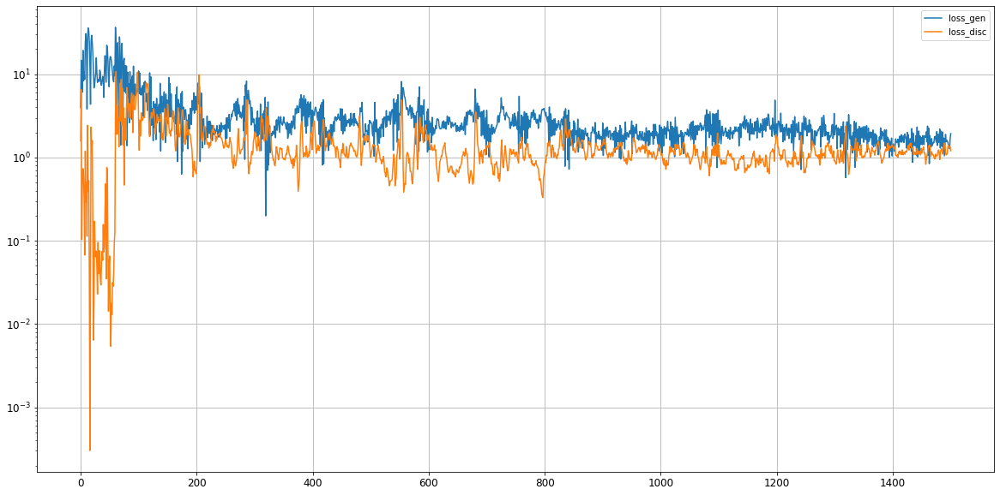

Epoch 1502/50000
0s
Epoch 1503/50000
0s
Epoch 1504/50000
0s
Epoch 1505/50000
0s
Epoch 1506/50000
0s
Epoch 1507/50000
0s
Epoch 1508/50000
0s
Epoch 1509/50000
0s
Epoch 1510/50000
0s
Epoch 1511/50000
0s
Epoch 1512/50000
0s
Epoch 1513/50000
0s
Epoch 1514/50000
0s
Epoch 1515/50000
0s
Epoch 1516/50000
0s
Epoch 1517/50000
0s
Epoch 1518/50000
0s
Epoch 1519/50000
0s
Epoch 1520/50000
0s
Epoch 1521/50000
0s
Epoch 1522/50000
0s
Epoch 1523/50000
0s
Epoch 1524/50000
0s
Epoch 1525/50000
0s
Epoch 1526/50000
0s
Epoch 1527/50000
0s
Epoch 1528/50000
0s
Epoch 1529/50000
0s
Epoch 1530/50000
0s
Epoch 1531/50000
0s
Epoch 1532/50000
0s
Epoch 1533/50000
0s
Epoch 1534/50000
0s
Epoch 1535/50000
0s
Epoch 1536/50000
0s
Epoch 1537/50000
0s
Epoch 1538/50000
0s
Epoch 1539/50000
0s
Epoch 1540/50000
0s
Epoch 1541/50000
0s
Epoch 1542/50000
0s
Epoch 1543/50000
0s
Epoch 1544/50000
0s
Epoch 1545/50000
0s
Epoch 1546/50000
0s
Epoch 1547/50000
0s
Epoch 1548/50000
0s
Epoch 1549/50000
0s
Epoch 1550/50000
0s
Epoch 1551/50000
0s


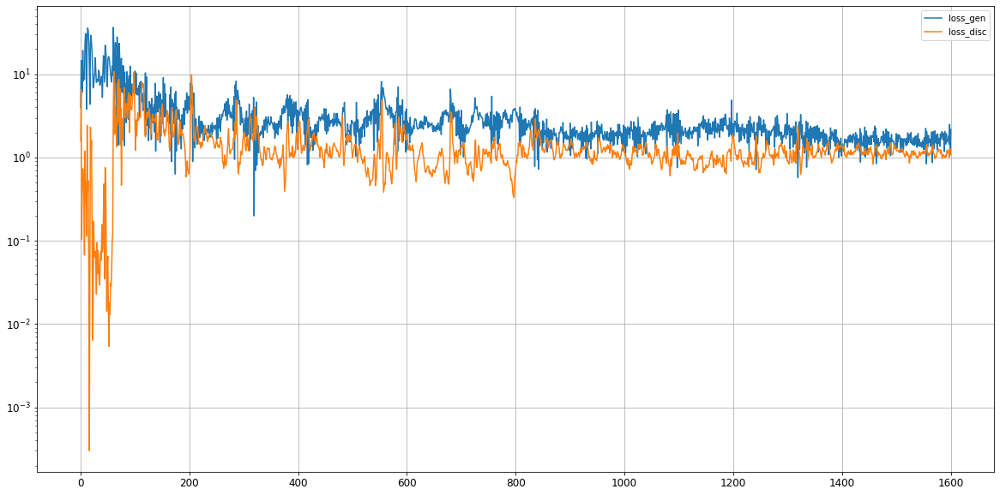

Epoch 1602/50000
0s
Epoch 1603/50000
0s
Epoch 1604/50000
0s
Epoch 1605/50000
0s
Epoch 1606/50000
0s
Epoch 1607/50000
0s
Epoch 1608/50000
0s
Epoch 1609/50000
0s
Epoch 1610/50000
0s
Epoch 1611/50000
0s
Epoch 1612/50000
0s
Epoch 1613/50000
0s
Epoch 1614/50000
0s
Epoch 1615/50000
0s
Epoch 1616/50000
0s
Epoch 1617/50000
0s
Epoch 1618/50000
0s
Epoch 1619/50000
0s
Epoch 1620/50000
0s
Epoch 1621/50000
0s
Epoch 1622/50000
0s
Epoch 1623/50000
0s
Epoch 1624/50000
0s
Epoch 1625/50000
0s
Epoch 1626/50000
0s
Epoch 1627/50000
0s
Epoch 1628/50000
0s
Epoch 1629/50000
0s
Epoch 1630/50000
0s
Epoch 1631/50000
0s
Epoch 1632/50000
0s
Epoch 1633/50000
0s
Epoch 1634/50000
0s
Epoch 1635/50000
0s
Epoch 1636/50000
0s
Epoch 1637/50000
0s
Epoch 1638/50000
0s
Epoch 1639/50000
0s
Epoch 1640/50000
0s
Epoch 1641/50000
0s
Epoch 1642/50000
0s
Epoch 1643/50000
0s
Epoch 1644/50000
0s
Epoch 1645/50000
0s
Epoch 1646/50000
0s
Epoch 1647/50000
0s
Epoch 1648/50000
0s
Epoch 1649/50000
0s
Epoch 1650/50000
0s
Epoch 1651/50000
0s


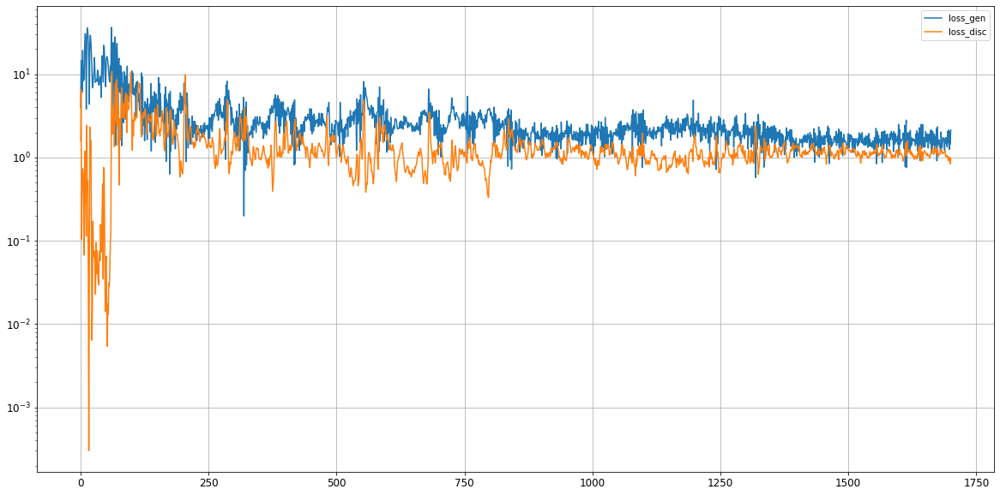

Epoch 1702/50000
0s
Epoch 1703/50000
0s
Epoch 1704/50000
0s
Epoch 1705/50000
0s
Epoch 1706/50000
0s
Epoch 1707/50000
0s
Epoch 1708/50000
0s
Epoch 1709/50000
0s
Epoch 1710/50000
0s
Epoch 1711/50000
0s
Epoch 1712/50000
0s
Epoch 1713/50000
0s
Epoch 1714/50000
0s
Epoch 1715/50000
0s
Epoch 1716/50000
0s
Epoch 1717/50000
0s
Epoch 1718/50000
0s
Epoch 1719/50000
0s
Epoch 1720/50000
0s
Epoch 1721/50000
0s
Epoch 1722/50000
0s
Epoch 1723/50000
0s
Epoch 1724/50000
0s
Epoch 1725/50000
0s
Epoch 1726/50000
0s
Epoch 1727/50000
0s
Epoch 1728/50000
0s
Epoch 1729/50000
0s
Epoch 1730/50000
0s
Epoch 1731/50000
0s
Epoch 1732/50000
0s
Epoch 1733/50000
0s
Epoch 1734/50000
0s
Epoch 1735/50000
0s
Epoch 1736/50000
0s
Epoch 1737/50000
0s
Epoch 1738/50000
0s
Epoch 1739/50000
0s
Epoch 1740/50000
0s
Epoch 1741/50000
0s
Epoch 1742/50000
0s
Epoch 1743/50000
0s
Epoch 1744/50000
0s
Epoch 1745/50000
0s
Epoch 1746/50000
0s
Epoch 1747/50000
0s
Epoch 1748/50000
0s
Epoch 1749/50000
0s
Epoch 1750/50000
0s
Epoch 1751/50000
0s


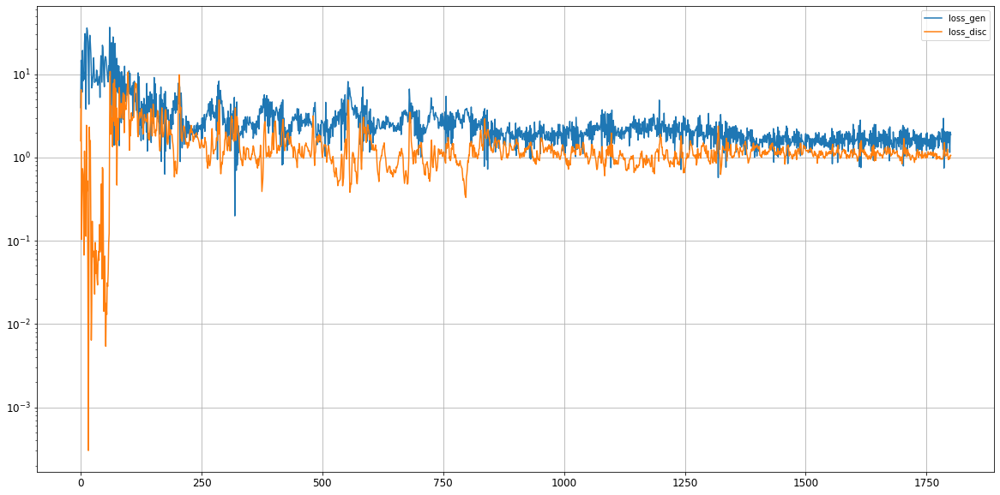

Epoch 1802/50000
0s
Epoch 1803/50000
0s
Epoch 1804/50000
0s
Epoch 1805/50000
0s
Epoch 1806/50000
0s
Epoch 1807/50000
0s
Epoch 1808/50000
0s
Epoch 1809/50000
0s
Epoch 1810/50000
0s
Epoch 1811/50000
0s
Epoch 1812/50000
0s
Epoch 1813/50000
0s
Epoch 1814/50000
0s
Epoch 1815/50000
0s
Epoch 1816/50000
0s
Epoch 1817/50000
0s
Epoch 1818/50000
0s
Epoch 1819/50000
0s
Epoch 1820/50000
0s
Epoch 1821/50000
0s
Epoch 1822/50000
0s
Epoch 1823/50000
0s
Epoch 1824/50000
0s
Epoch 1825/50000
0s
Epoch 1826/50000
0s
Epoch 1827/50000
0s
Epoch 1828/50000
0s
Epoch 1829/50000
0s
Epoch 1830/50000
0s
Epoch 1831/50000
0s
Epoch 1832/50000
0s
Epoch 1833/50000
0s
Epoch 1834/50000
0s
Epoch 1835/50000
0s
Epoch 1836/50000
0s
Epoch 1837/50000
0s
Epoch 1838/50000
0s
Epoch 1839/50000
0s
Epoch 1840/50000
0s
Epoch 1841/50000
0s
Epoch 1842/50000
0s
Epoch 1843/50000
0s
Epoch 1844/50000
0s
Epoch 1845/50000
0s
Epoch 1846/50000
0s
Epoch 1847/50000
0s
Epoch 1848/50000
0s
Epoch 1849/50000
0s
Epoch 1850/50000
0s
Epoch 1851/50000
0s


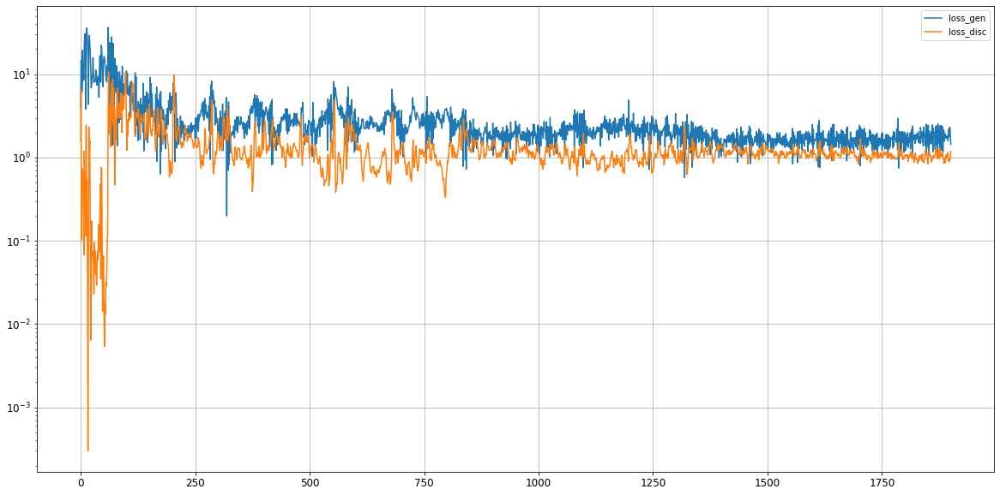

Epoch 1902/50000
0s
Epoch 1903/50000
0s
Epoch 1904/50000
0s
Epoch 1905/50000
0s
Epoch 1906/50000
0s
Epoch 1907/50000
0s
Epoch 1908/50000
0s
Epoch 1909/50000
0s
Epoch 1910/50000
0s
Epoch 1911/50000
0s
Epoch 1912/50000
0s
Epoch 1913/50000
0s
Epoch 1914/50000
0s
Epoch 1915/50000
0s
Epoch 1916/50000
0s
Epoch 1917/50000
0s
Epoch 1918/50000
0s
Epoch 1919/50000
0s
Epoch 1920/50000
0s
Epoch 1921/50000
0s
Epoch 1922/50000
0s
Epoch 1923/50000
0s
Epoch 1924/50000
0s
Epoch 1925/50000
0s
Epoch 1926/50000
0s
Epoch 1927/50000
0s
Epoch 1928/50000
0s
Epoch 1929/50000
0s
Epoch 1930/50000
0s
Epoch 1931/50000
0s
Epoch 1932/50000
0s
Epoch 1933/50000
0s
Epoch 1934/50000
0s
Epoch 1935/50000
0s
Epoch 1936/50000
0s
Epoch 1937/50000
0s
Epoch 1938/50000
0s
Epoch 1939/50000
0s
Epoch 1940/50000
0s
Epoch 1941/50000
0s
Epoch 1942/50000
0s
Epoch 1943/50000
0s
Epoch 1944/50000
0s
Epoch 1945/50000
0s
Epoch 1946/50000
0s
Epoch 1947/50000
0s
Epoch 1948/50000
0s
Epoch 1949/50000
0s
Epoch 1950/50000
0s
Epoch 1951/50000
0s


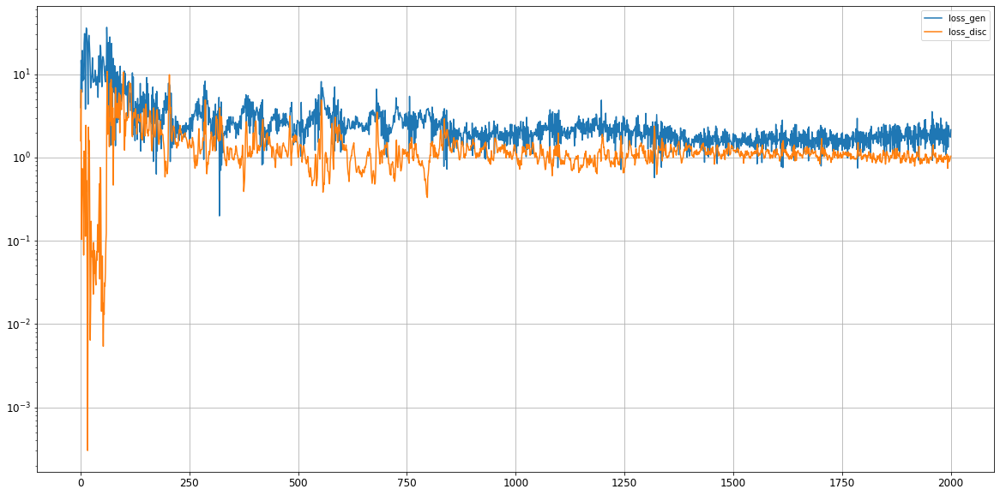

Epoch 2002/50000
0s
Epoch 2003/50000
0s
Epoch 2004/50000
0s
Epoch 2005/50000
0s
Epoch 2006/50000
0s
Epoch 2007/50000
0s
Epoch 2008/50000
0s
Epoch 2009/50000
0s
Epoch 2010/50000
0s
Epoch 2011/50000
0s
Epoch 2012/50000
0s
Epoch 2013/50000
0s
Epoch 2014/50000
0s
Epoch 2015/50000
0s
Epoch 2016/50000
0s
Epoch 2017/50000
0s
Epoch 2018/50000
0s
Epoch 2019/50000
0s
Epoch 2020/50000
0s
Epoch 2021/50000
0s
Epoch 2022/50000
0s
Epoch 2023/50000
0s
Epoch 2024/50000
0s
Epoch 2025/50000
0s
Epoch 2026/50000
0s
Epoch 2027/50000
0s
Epoch 2028/50000
0s
Epoch 2029/50000
0s
Epoch 2030/50000
0s
Epoch 2031/50000
0s
Epoch 2032/50000
0s
Epoch 2033/50000
0s
Epoch 2034/50000
0s
Epoch 2035/50000
0s
Epoch 2036/50000
0s
Epoch 2037/50000
0s
Epoch 2038/50000
0s
Epoch 2039/50000
0s
Epoch 2040/50000
0s
Epoch 2041/50000
0s
Epoch 2042/50000
0s
Epoch 2043/50000
0s
Epoch 2044/50000
0s
Epoch 2045/50000
0s
Epoch 2046/50000
0s
Epoch 2047/50000
0s
Epoch 2048/50000
0s
Epoch 2049/50000
0s
Epoch 2050/50000
0s
Epoch 2051/50000
0s


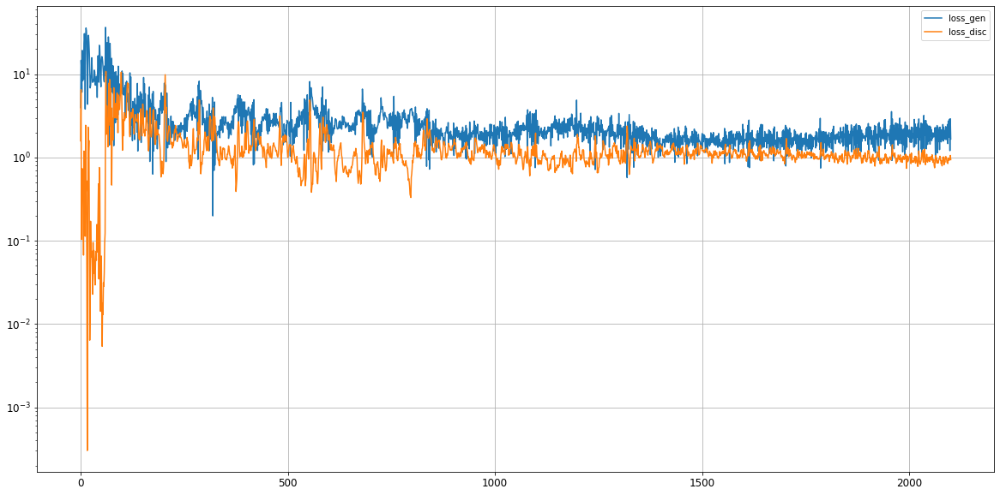

Epoch 2102/50000
0s
Epoch 2103/50000
0s
Epoch 2104/50000
0s
Epoch 2105/50000
0s
Epoch 2106/50000
0s
Epoch 2107/50000
0s
Epoch 2108/50000
0s
Epoch 2109/50000
0s
Epoch 2110/50000
0s
Epoch 2111/50000
0s
Epoch 2112/50000
0s
Epoch 2113/50000
0s
Epoch 2114/50000
0s
Epoch 2115/50000
0s
Epoch 2116/50000
0s
Epoch 2117/50000
0s
Epoch 2118/50000
0s
Epoch 2119/50000
0s
Epoch 2120/50000
0s
Epoch 2121/50000
0s
Epoch 2122/50000
0s
Epoch 2123/50000
0s
Epoch 2124/50000
0s
Epoch 2125/50000
0s
Epoch 2126/50000
0s
Epoch 2127/50000
0s
Epoch 2128/50000
0s
Epoch 2129/50000
0s
Epoch 2130/50000
0s
Epoch 2131/50000
0s
Epoch 2132/50000
0s
Epoch 2133/50000
0s
Epoch 2134/50000
0s
Epoch 2135/50000
0s
Epoch 2136/50000
0s
Epoch 2137/50000
0s
Epoch 2138/50000
0s
Epoch 2139/50000
0s
Epoch 2140/50000
0s
Epoch 2141/50000
0s
Epoch 2142/50000
0s
Epoch 2143/50000
0s
Epoch 2144/50000
0s
Epoch 2145/50000
0s
Epoch 2146/50000
0s
Epoch 2147/50000
0s
Epoch 2148/50000
0s
Epoch 2149/50000
0s
Epoch 2150/50000
0s
Epoch 2151/50000
0s


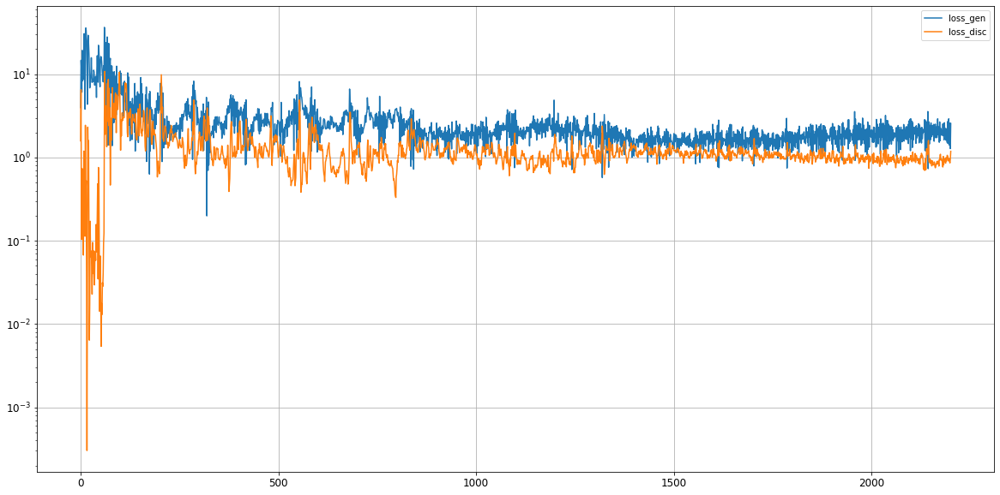

Epoch 2202/50000
0s
Epoch 2203/50000
0s
Epoch 2204/50000
0s
Epoch 2205/50000
0s
Epoch 2206/50000
0s
Epoch 2207/50000
0s
Epoch 2208/50000
0s
Epoch 2209/50000
0s
Epoch 2210/50000
0s
Epoch 2211/50000
0s
Epoch 2212/50000
0s
Epoch 2213/50000
0s
Epoch 2214/50000
0s
Epoch 2215/50000
0s
Epoch 2216/50000
0s
Epoch 2217/50000
0s
Epoch 2218/50000
0s
Epoch 2219/50000
0s
Epoch 2220/50000
0s
Epoch 2221/50000
0s
Epoch 2222/50000
0s
Epoch 2223/50000
0s
Epoch 2224/50000
0s
Epoch 2225/50000
0s
Epoch 2226/50000
0s
Epoch 2227/50000
0s
Epoch 2228/50000
0s
Epoch 2229/50000
0s
Epoch 2230/50000
0s
Epoch 2231/50000
0s
Epoch 2232/50000
0s
Epoch 2233/50000
0s
Epoch 2234/50000
0s
Epoch 2235/50000
0s
Epoch 2236/50000
0s
Epoch 2237/50000
0s
Epoch 2238/50000
0s
Epoch 2239/50000
0s
Epoch 2240/50000
0s
Epoch 2241/50000
0s
Epoch 2242/50000
0s
Epoch 2243/50000
0s
Epoch 2244/50000
0s
Epoch 2245/50000
0s
Epoch 2246/50000
0s
Epoch 2247/50000
0s
Epoch 2248/50000
0s
Epoch 2249/50000
0s
Epoch 2250/50000
0s
Epoch 2251/50000
0s


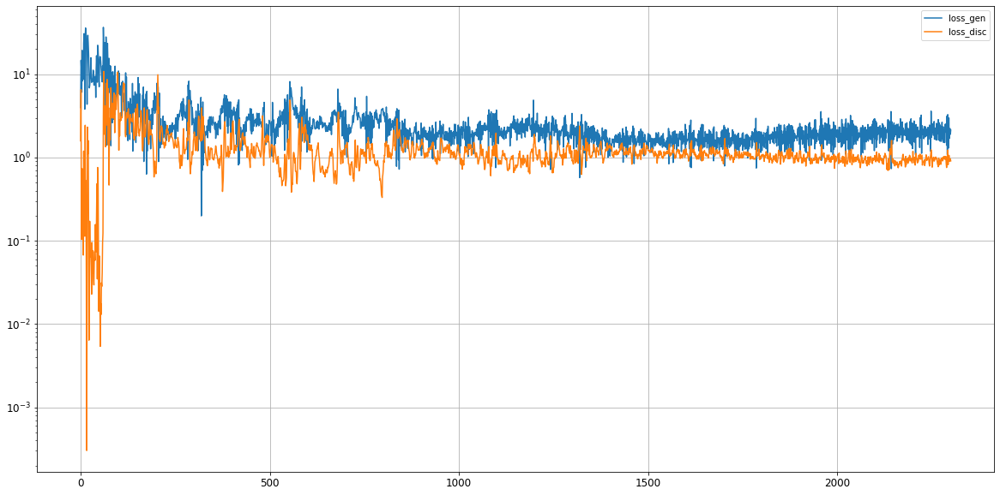

Epoch 2302/50000
0s
Epoch 2303/50000
0s
Epoch 2304/50000
0s
Epoch 2305/50000
0s
Epoch 2306/50000
0s
Epoch 2307/50000
0s
Epoch 2308/50000
0s
Epoch 2309/50000
0s
Epoch 2310/50000
0s
Epoch 2311/50000
0s
Epoch 2312/50000
0s
Epoch 2313/50000
0s
Epoch 2314/50000
0s
Epoch 2315/50000
0s
Epoch 2316/50000
0s
Epoch 2317/50000
0s
Epoch 2318/50000
0s
Epoch 2319/50000
0s
Epoch 2320/50000
0s
Epoch 2321/50000
0s
Epoch 2322/50000
0s
Epoch 2323/50000
0s
Epoch 2324/50000
0s
Epoch 2325/50000
0s
Epoch 2326/50000
0s
Epoch 2327/50000
0s
Epoch 2328/50000
0s
Epoch 2329/50000
0s
Epoch 2330/50000
0s
Epoch 2331/50000
0s
Epoch 2332/50000
0s
Epoch 2333/50000
0s
Epoch 2334/50000
0s
Epoch 2335/50000
0s
Epoch 2336/50000
0s
Epoch 2337/50000
0s
Epoch 2338/50000
0s
Epoch 2339/50000
0s
Epoch 2340/50000
0s
Epoch 2341/50000
0s
Epoch 2342/50000
0s
Epoch 2343/50000
0s
Epoch 2344/50000
0s
Epoch 2345/50000
0s
Epoch 2346/50000
0s
Epoch 2347/50000
0s
Epoch 2348/50000
0s
Epoch 2349/50000
0s
Epoch 2350/50000
0s
Epoch 2351/50000
0s


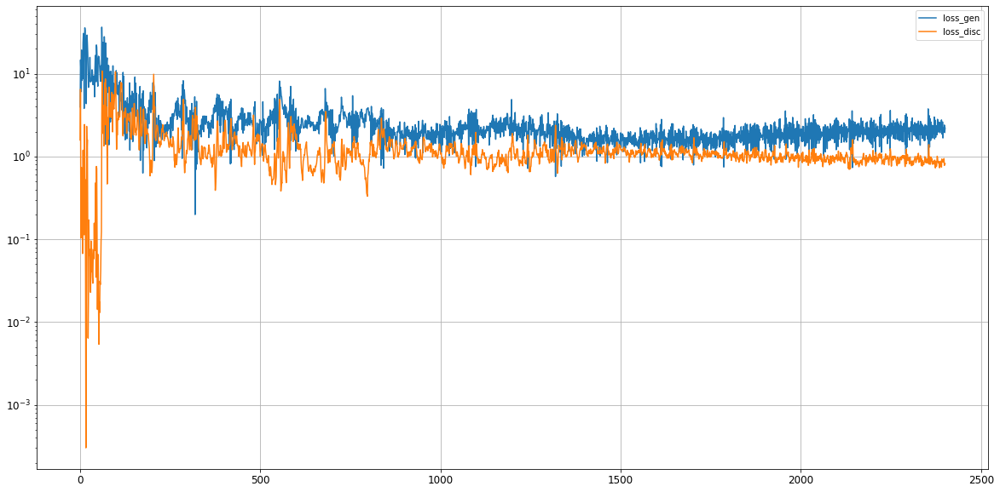

Epoch 2402/50000
0s
Epoch 2403/50000
0s
Epoch 2404/50000
0s
Epoch 2405/50000
0s
Epoch 2406/50000
0s
Epoch 2407/50000
0s
Epoch 2408/50000
0s
Epoch 2409/50000
0s
Epoch 2410/50000
0s
Epoch 2411/50000
0s
Epoch 2412/50000
0s
Epoch 2413/50000
0s
Epoch 2414/50000
0s
Epoch 2415/50000
0s
Epoch 2416/50000
0s
Epoch 2417/50000
0s
Epoch 2418/50000
0s
Epoch 2419/50000
0s
Epoch 2420/50000
0s
Epoch 2421/50000
0s
Epoch 2422/50000
0s
Epoch 2423/50000
0s
Epoch 2424/50000
0s
Epoch 2425/50000
0s
Epoch 2426/50000
0s
Epoch 2427/50000
0s
Epoch 2428/50000
0s
Epoch 2429/50000
0s
Epoch 2430/50000
0s
Epoch 2431/50000
0s
Epoch 2432/50000
0s
Epoch 2433/50000
0s
Epoch 2434/50000
0s
Epoch 2435/50000
0s
Epoch 2436/50000
0s
Epoch 2437/50000
0s
Epoch 2438/50000
0s
Epoch 2439/50000
0s
Epoch 2440/50000
0s
Epoch 2441/50000
0s
Epoch 2442/50000
0s
Epoch 2443/50000
0s
Epoch 2444/50000
0s
Epoch 2445/50000
0s
Epoch 2446/50000
0s
Epoch 2447/50000
0s
Epoch 2448/50000
0s
Epoch 2449/50000
0s
Epoch 2450/50000
0s
Epoch 2451/50000
0s


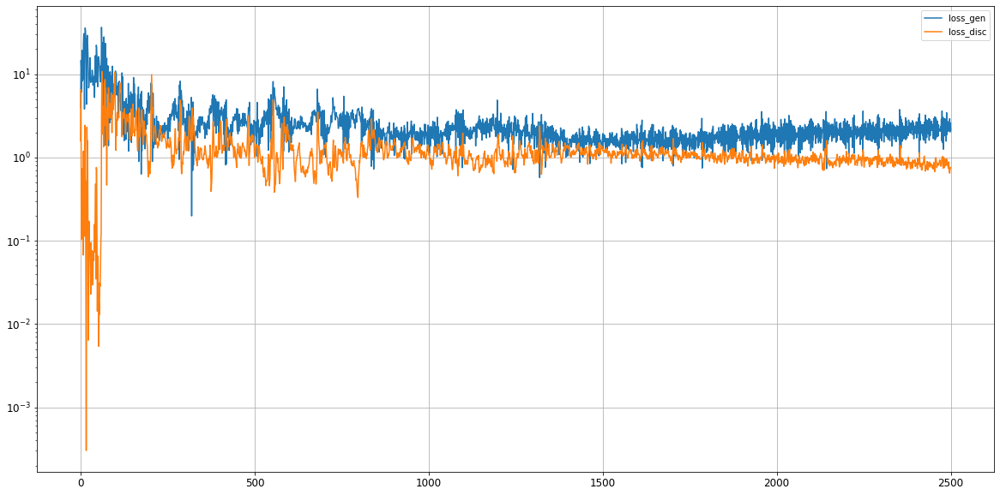

Epoch 2502/50000
0s
Epoch 2503/50000
0s
Epoch 2504/50000
0s
Epoch 2505/50000
0s
Epoch 2506/50000
0s
Epoch 2507/50000
0s
Epoch 2508/50000
0s
Epoch 2509/50000
0s
Epoch 2510/50000
0s
Epoch 2511/50000
0s
Epoch 2512/50000
0s
Epoch 2513/50000
0s
Epoch 2514/50000
0s
Epoch 2515/50000
0s
Epoch 2516/50000
0s
Epoch 2517/50000
0s
Epoch 2518/50000
0s
Epoch 2519/50000
0s
Epoch 2520/50000
0s
Epoch 2521/50000
0s
Epoch 2522/50000
0s
Epoch 2523/50000
0s
Epoch 2524/50000
0s
Epoch 2525/50000
0s
Epoch 2526/50000
0s
Epoch 2527/50000
0s
Epoch 2528/50000
0s
Epoch 2529/50000
0s
Epoch 2530/50000
0s
Epoch 2531/50000
0s
Epoch 2532/50000
0s
Epoch 2533/50000
0s
Epoch 2534/50000
0s
Epoch 2535/50000
0s
Epoch 2536/50000
0s
Epoch 2537/50000
0s
Epoch 2538/50000
0s
Epoch 2539/50000
0s
Epoch 2540/50000
0s
Epoch 2541/50000
0s
Epoch 2542/50000
0s
Epoch 2543/50000
0s
Epoch 2544/50000
0s
Epoch 2545/50000
0s
Epoch 2546/50000
0s
Epoch 2547/50000
0s
Epoch 2548/50000
0s
Epoch 2549/50000
0s
Epoch 2550/50000
0s
Epoch 2551/50000
0s


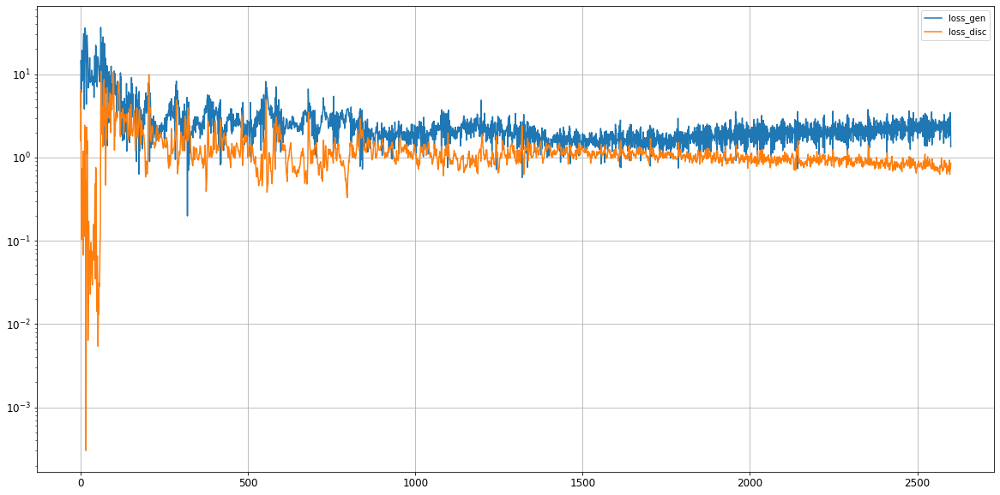

Epoch 2602/50000
0s
Epoch 2603/50000
0s
Epoch 2604/50000
0s
Epoch 2605/50000
0s
Epoch 2606/50000
0s
Epoch 2607/50000
0s
Epoch 2608/50000
0s
Epoch 2609/50000
0s
Epoch 2610/50000
0s
Epoch 2611/50000
0s
Epoch 2612/50000
0s
Epoch 2613/50000
0s
Epoch 2614/50000
0s
Epoch 2615/50000
0s
Epoch 2616/50000
0s
Epoch 2617/50000
0s
Epoch 2618/50000
0s
Epoch 2619/50000
0s
Epoch 2620/50000
0s
Epoch 2621/50000
0s
Epoch 2622/50000
0s
Epoch 2623/50000
0s
Epoch 2624/50000
0s
Epoch 2625/50000
0s
Epoch 2626/50000
0s
Epoch 2627/50000
0s
Epoch 2628/50000
0s
Epoch 2629/50000
0s
Epoch 2630/50000
0s
Epoch 2631/50000
0s
Epoch 2632/50000
0s
Epoch 2633/50000
0s
Epoch 2634/50000
0s
Epoch 2635/50000
0s
Epoch 2636/50000
0s
Epoch 2637/50000
0s
Epoch 2638/50000
0s
Epoch 2639/50000
0s
Epoch 2640/50000
0s
Epoch 2641/50000
0s
Epoch 2642/50000
0s
Epoch 2643/50000
0s
Epoch 2644/50000
0s
Epoch 2645/50000
0s
Epoch 2646/50000
0s
Epoch 2647/50000
0s
Epoch 2648/50000
0s
Epoch 2649/50000
0s
Epoch 2650/50000
0s
Epoch 2651/50000
0s


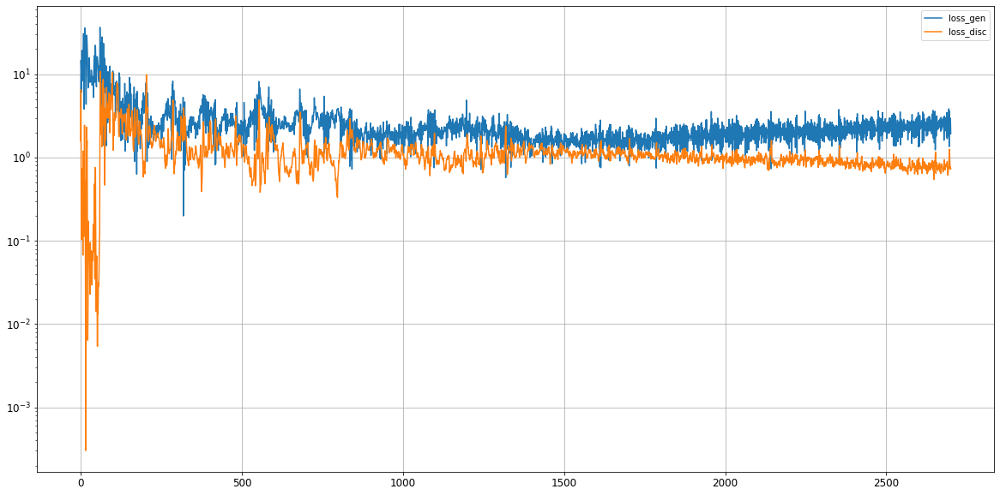

Epoch 2702/50000
0s
Epoch 2703/50000
0s
Epoch 2704/50000
0s
Epoch 2705/50000
0s
Epoch 2706/50000
0s
Epoch 2707/50000
0s
Epoch 2708/50000
0s
Epoch 2709/50000
0s
Epoch 2710/50000
0s
Epoch 2711/50000
0s
Epoch 2712/50000
0s
Epoch 2713/50000
0s
Epoch 2714/50000
0s
Epoch 2715/50000
0s
Epoch 2716/50000
0s
Epoch 2717/50000
0s
Epoch 2718/50000
0s
Epoch 2719/50000
0s
Epoch 2720/50000
0s
Epoch 2721/50000
0s
Epoch 2722/50000
0s
Epoch 2723/50000
0s
Epoch 2724/50000
0s
Epoch 2725/50000
0s
Epoch 2726/50000
0s
Epoch 2727/50000
0s
Epoch 2728/50000
0s
Epoch 2729/50000
0s
Epoch 2730/50000
0s
Epoch 2731/50000
0s
Epoch 2732/50000
0s
Epoch 2733/50000
0s
Epoch 2734/50000
0s
Epoch 2735/50000
0s
Epoch 2736/50000
0s
Epoch 2737/50000
0s
Epoch 2738/50000
0s
Epoch 2739/50000
0s
Epoch 2740/50000
0s
Epoch 2741/50000
0s
Epoch 2742/50000
0s
Epoch 2743/50000
0s
Epoch 2744/50000
0s
Epoch 2745/50000
0s
Epoch 2746/50000
0s
Epoch 2747/50000
0s
Epoch 2748/50000
0s
Epoch 2749/50000
0s
Epoch 2750/50000
0s
Epoch 2751/50000
0s


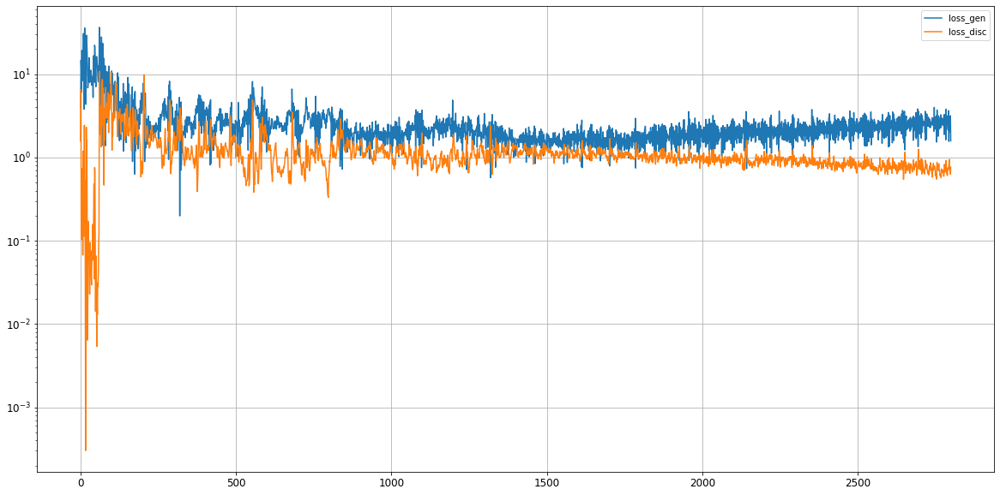

Epoch 2802/50000
0s
Epoch 2803/50000
0s
Epoch 2804/50000
0s
Epoch 2805/50000
0s
Epoch 2806/50000
0s
Epoch 2807/50000
0s
Epoch 2808/50000
0s
Epoch 2809/50000
0s
Epoch 2810/50000
0s
Epoch 2811/50000
0s
Epoch 2812/50000
0s
Epoch 2813/50000
0s
Epoch 2814/50000
0s
Epoch 2815/50000
0s
Epoch 2816/50000
0s
Epoch 2817/50000
0s
Epoch 2818/50000
0s
Epoch 2819/50000
0s
Epoch 2820/50000
0s
Epoch 2821/50000
0s
Epoch 2822/50000
0s
Epoch 2823/50000
0s
Epoch 2824/50000
0s
Epoch 2825/50000
0s
Epoch 2826/50000
0s
Epoch 2827/50000
0s
Epoch 2828/50000
0s
Epoch 2829/50000
0s
Epoch 2830/50000
0s
Epoch 2831/50000
0s
Epoch 2832/50000
0s
Epoch 2833/50000
0s
Epoch 2834/50000
0s
Epoch 2835/50000
0s
Epoch 2836/50000
0s
Epoch 2837/50000
0s
Epoch 2838/50000
0s
Epoch 2839/50000
0s
Epoch 2840/50000
0s
Epoch 2841/50000
0s
Epoch 2842/50000
0s
Epoch 2843/50000
0s
Epoch 2844/50000
0s
Epoch 2845/50000
0s
Epoch 2846/50000
0s
Epoch 2847/50000
0s
Epoch 2848/50000
0s
Epoch 2849/50000
0s
Epoch 2850/50000
0s
Epoch 2851/50000
0s


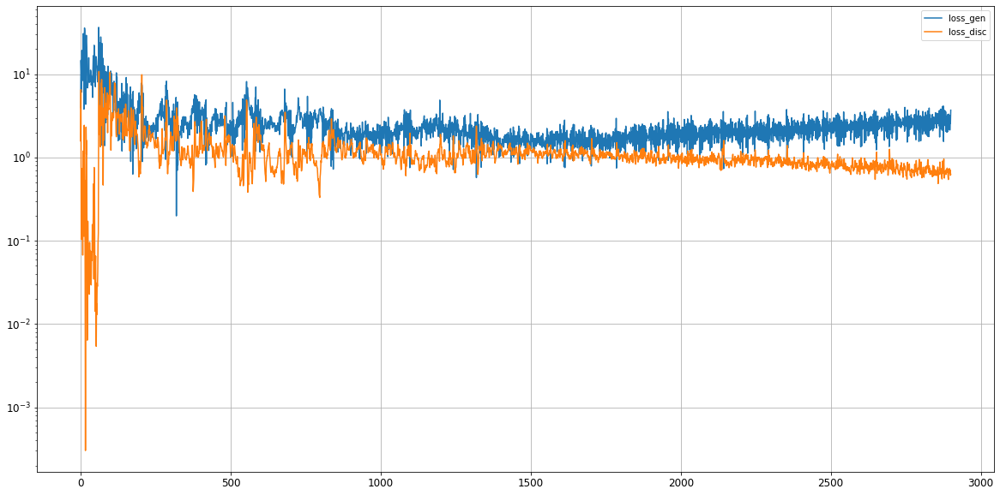

Epoch 2902/50000
0s
Epoch 2903/50000
0s
Epoch 2904/50000
0s
Epoch 2905/50000
0s
Epoch 2906/50000
0s
Epoch 2907/50000
0s
Epoch 2908/50000
0s
Epoch 2909/50000
0s
Epoch 2910/50000
0s
Epoch 2911/50000
0s
Epoch 2912/50000
0s
Epoch 2913/50000
0s
Epoch 2914/50000
0s
Epoch 2915/50000
0s
Epoch 2916/50000
0s
Epoch 2917/50000
0s
Epoch 2918/50000
0s
Epoch 2919/50000
0s
Epoch 2920/50000
0s
Epoch 2921/50000
0s
Epoch 2922/50000
0s
Epoch 2923/50000
0s
Epoch 2924/50000
0s
Epoch 2925/50000
0s
Epoch 2926/50000
0s
Epoch 2927/50000
0s
Epoch 2928/50000
0s
Epoch 2929/50000
0s
Epoch 2930/50000
0s
Epoch 2931/50000
0s
Epoch 2932/50000
0s
Epoch 2933/50000
0s
Epoch 2934/50000
0s
Epoch 2935/50000
0s
Epoch 2936/50000
0s
Epoch 2937/50000
0s
Epoch 2938/50000
0s
Epoch 2939/50000
0s
Epoch 2940/50000
0s
Epoch 2941/50000
0s
Epoch 2942/50000
0s
Epoch 2943/50000
0s
Epoch 2944/50000
0s
Epoch 2945/50000
0s
Epoch 2946/50000
0s
Epoch 2947/50000
0s
Epoch 2948/50000
0s
Epoch 2949/50000
0s
Epoch 2950/50000
0s
Epoch 2951/50000
0s


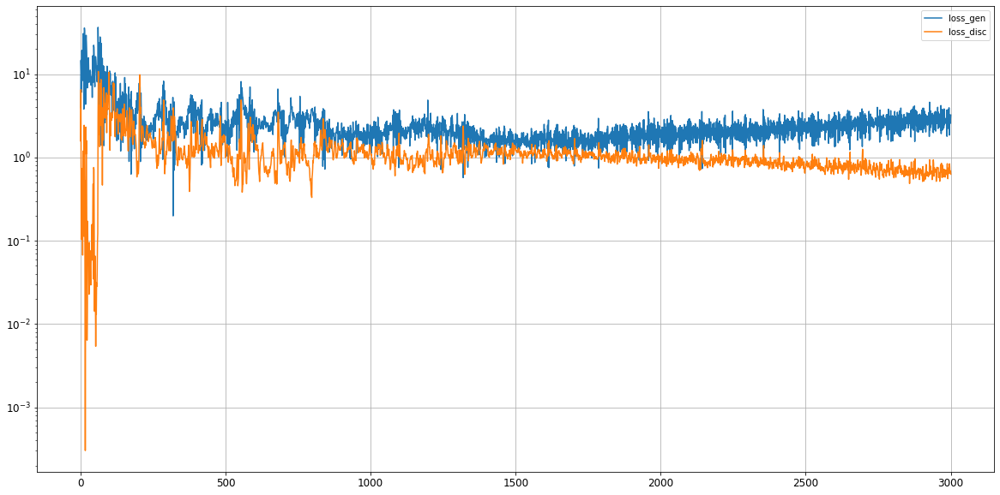

Epoch 3002/50000
0s
Epoch 3003/50000
0s
Epoch 3004/50000
0s
Epoch 3005/50000
0s
Epoch 3006/50000
0s
Epoch 3007/50000
0s
Epoch 3008/50000
0s
Epoch 3009/50000
0s
Epoch 3010/50000
0s
Epoch 3011/50000
0s
Epoch 3012/50000
0s
Epoch 3013/50000
0s
Epoch 3014/50000
0s
Epoch 3015/50000
0s
Epoch 3016/50000
0s
Epoch 3017/50000
0s
Epoch 3018/50000
0s
Epoch 3019/50000
0s
Epoch 3020/50000
0s
Epoch 3021/50000
0s
Epoch 3022/50000
0s
Epoch 3023/50000
0s
Epoch 3024/50000
0s
Epoch 3025/50000
0s
Epoch 3026/50000
0s
Epoch 3027/50000
0s
Epoch 3028/50000
0s
Epoch 3029/50000
0s
Epoch 3030/50000
0s
Epoch 3031/50000
0s
Epoch 3032/50000
0s
Epoch 3033/50000
0s
Epoch 3034/50000
0s
Epoch 3035/50000
0s
Epoch 3036/50000
0s
Epoch 3037/50000
0s
Epoch 3038/50000
0s
Epoch 3039/50000
0s
Epoch 3040/50000
0s
Epoch 3041/50000
0s
Epoch 3042/50000
0s
Epoch 3043/50000
0s
Epoch 3044/50000
0s
Epoch 3045/50000
0s
Epoch 3046/50000
0s
Epoch 3047/50000
0s
Epoch 3048/50000
0s
Epoch 3049/50000
0s
Epoch 3050/50000
0s
Epoch 3051/50000
0s


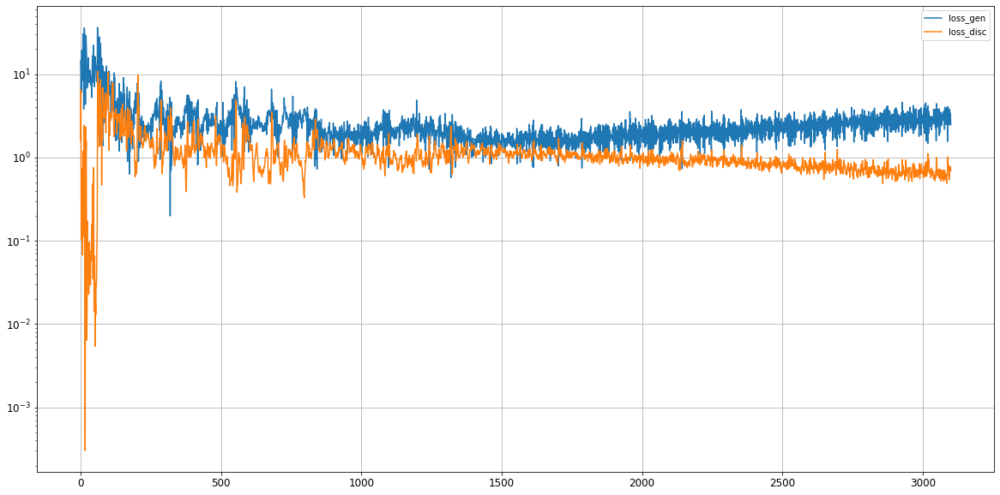

Epoch 3102/50000
0s
Epoch 3103/50000
0s
Epoch 3104/50000
0s
Epoch 3105/50000
0s
Epoch 3106/50000
0s
Epoch 3107/50000
0s
Epoch 3108/50000
0s
Epoch 3109/50000
0s
Epoch 3110/50000
0s
Epoch 3111/50000
0s
Epoch 3112/50000
0s
Epoch 3113/50000
0s
Epoch 3114/50000
0s
Epoch 3115/50000
0s
Epoch 3116/50000
0s
Epoch 3117/50000
0s
Epoch 3118/50000
0s
Epoch 3119/50000
0s
Epoch 3120/50000
0s
Epoch 3121/50000
0s
Epoch 3122/50000
0s
Epoch 3123/50000
0s
Epoch 3124/50000
0s
Epoch 3125/50000
0s
Epoch 3126/50000
0s
Epoch 3127/50000
0s
Epoch 3128/50000
0s
Epoch 3129/50000
0s
Epoch 3130/50000
0s
Epoch 3131/50000
0s
Epoch 3132/50000
0s
Epoch 3133/50000
0s
Epoch 3134/50000
0s
Epoch 3135/50000
0s
Epoch 3136/50000
0s
Epoch 3137/50000
0s
Epoch 3138/50000
0s
Epoch 3139/50000
0s
Epoch 3140/50000
0s
Epoch 3141/50000
0s
Epoch 3142/50000
0s
Epoch 3143/50000
0s
Epoch 3144/50000
0s
Epoch 3145/50000
0s
Epoch 3146/50000
0s
Epoch 3147/50000
0s
Epoch 3148/50000
0s
Epoch 3149/50000
0s
Epoch 3150/50000
0s
Epoch 3151/50000
0s


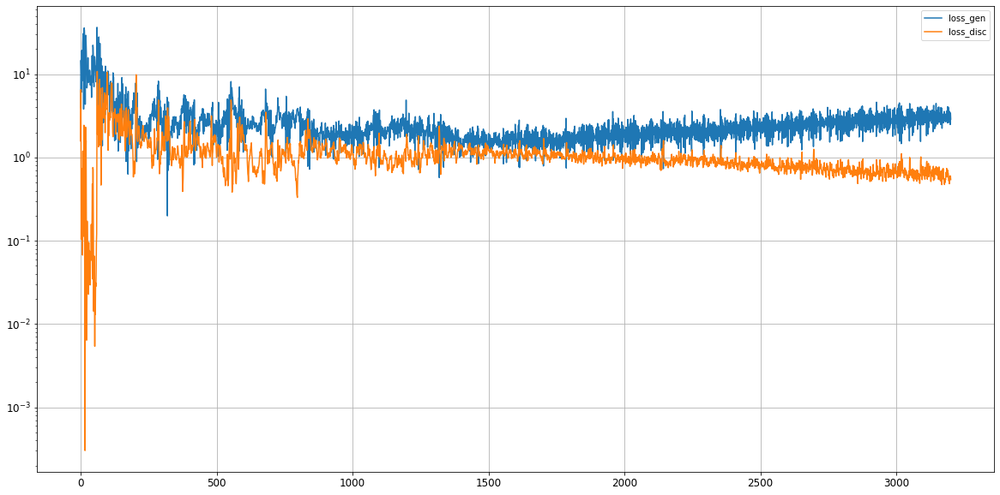

Epoch 3202/50000
0s
Epoch 3203/50000
0s
Epoch 3204/50000
0s
Epoch 3205/50000
0s
Epoch 3206/50000
0s
Epoch 3207/50000
0s
Epoch 3208/50000
0s
Epoch 3209/50000
0s
Epoch 3210/50000
0s
Epoch 3211/50000
0s
Epoch 3212/50000
0s
Epoch 3213/50000
0s
Epoch 3214/50000
0s
Epoch 3215/50000
0s
Epoch 3216/50000
0s
Epoch 3217/50000
0s
Epoch 3218/50000
0s
Epoch 3219/50000
0s
Epoch 3220/50000
0s
Epoch 3221/50000
0s
Epoch 3222/50000
0s
Epoch 3223/50000
0s
Epoch 3224/50000
0s
Epoch 3225/50000
0s
Epoch 3226/50000
0s
Epoch 3227/50000
0s
Epoch 3228/50000
0s
Epoch 3229/50000
0s
Epoch 3230/50000
0s
Epoch 3231/50000
0s
Epoch 3232/50000
0s
Epoch 3233/50000
0s
Epoch 3234/50000
0s
Epoch 3235/50000
0s
Epoch 3236/50000
0s
Epoch 3237/50000
0s
Epoch 3238/50000
0s
Epoch 3239/50000
0s
Epoch 3240/50000
0s
Epoch 3241/50000
0s
Epoch 3242/50000
0s
Epoch 3243/50000
0s
Epoch 3244/50000
0s
Epoch 3245/50000
0s
Epoch 3246/50000
0s
Epoch 3247/50000
0s
Epoch 3248/50000
0s
Epoch 3249/50000
0s
Epoch 3250/50000
0s
Epoch 3251/50000
0s


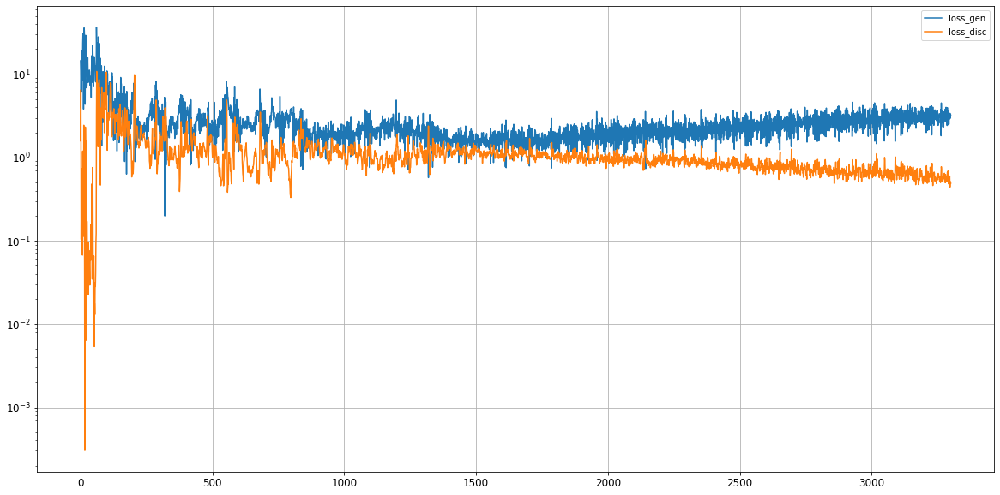

Epoch 3302/50000
0s
Epoch 3303/50000
0s
Epoch 3304/50000
0s
Epoch 3305/50000
0s
Epoch 3306/50000
0s
Epoch 3307/50000
0s
Epoch 3308/50000
0s
Epoch 3309/50000
0s
Epoch 3310/50000
0s
Epoch 3311/50000
0s
Epoch 3312/50000
0s
Epoch 3313/50000
0s
Epoch 3314/50000
0s
Epoch 3315/50000
0s
Epoch 3316/50000
0s
Epoch 3317/50000
0s
Epoch 3318/50000
0s
Epoch 3319/50000
0s
Epoch 3320/50000
0s
Epoch 3321/50000
0s
Epoch 3322/50000
0s
Epoch 3323/50000
0s
Epoch 3324/50000
0s
Epoch 3325/50000
0s
Epoch 3326/50000
0s
Epoch 3327/50000
0s
Epoch 3328/50000
0s
Epoch 3329/50000
0s
Epoch 3330/50000
0s
Epoch 3331/50000
0s
Epoch 3332/50000
0s
Epoch 3333/50000
0s
Epoch 3334/50000
0s
Epoch 3335/50000
0s
Epoch 3336/50000
0s
Epoch 3337/50000
0s
Epoch 3338/50000
0s
Epoch 3339/50000
0s
Epoch 3340/50000
0s
Epoch 3341/50000
0s
Epoch 3342/50000
0s
Epoch 3343/50000
0s
Epoch 3344/50000
0s
Epoch 3345/50000
0s
Epoch 3346/50000
0s
Epoch 3347/50000
0s
Epoch 3348/50000
0s
Epoch 3349/50000
0s
Epoch 3350/50000
0s
Epoch 3351/50000
0s


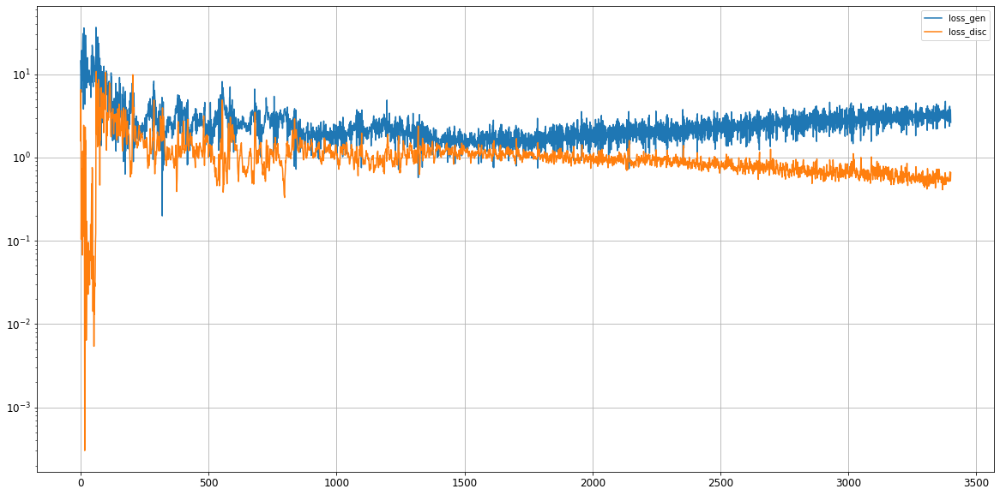

Epoch 3402/50000
0s
Epoch 3403/50000
0s
Epoch 3404/50000
0s
Epoch 3405/50000
0s
Epoch 3406/50000
0s
Epoch 3407/50000
0s
Epoch 3408/50000
0s
Epoch 3409/50000
0s
Epoch 3410/50000
0s
Epoch 3411/50000
0s
Epoch 3412/50000
0s
Epoch 3413/50000
0s
Epoch 3414/50000
0s
Epoch 3415/50000
0s
Epoch 3416/50000
0s
Epoch 3417/50000
0s
Epoch 3418/50000
0s
Epoch 3419/50000
0s
Epoch 3420/50000
0s
Epoch 3421/50000
0s
Epoch 3422/50000
0s
Epoch 3423/50000
0s
Epoch 3424/50000
0s
Epoch 3425/50000
0s
Epoch 3426/50000
0s
Epoch 3427/50000
0s
Epoch 3428/50000
0s
Epoch 3429/50000
0s
Epoch 3430/50000
0s
Epoch 3431/50000
0s
Epoch 3432/50000
0s
Epoch 3433/50000
0s
Epoch 3434/50000
0s
Epoch 3435/50000
0s
Epoch 3436/50000
0s
Epoch 3437/50000
0s
Epoch 3438/50000
0s
Epoch 3439/50000
0s
Epoch 3440/50000
0s
Epoch 3441/50000
0s
Epoch 3442/50000
0s
Epoch 3443/50000
0s
Epoch 3444/50000
0s
Epoch 3445/50000
0s
Epoch 3446/50000
0s
Epoch 3447/50000
0s
Epoch 3448/50000
0s
Epoch 3449/50000
0s
Epoch 3450/50000
0s
Epoch 3451/50000
0s


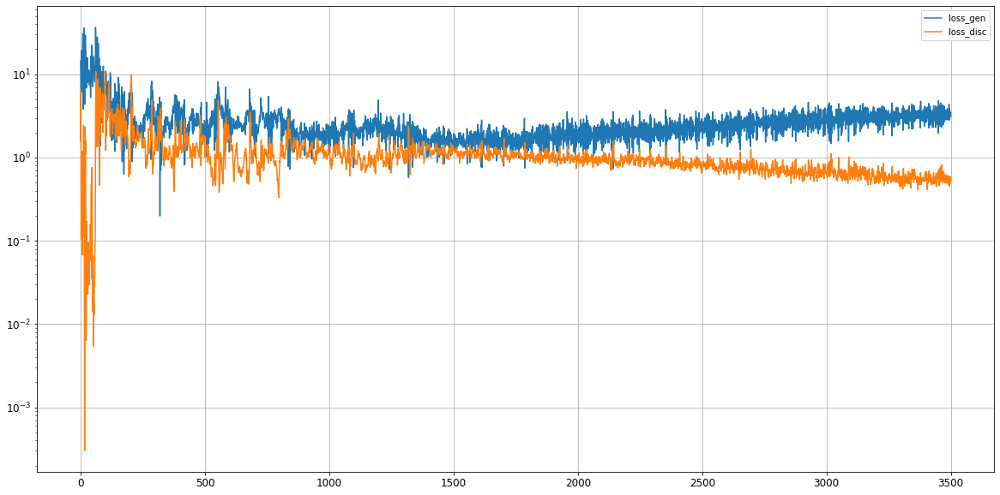

Epoch 3502/50000
0s
Epoch 3503/50000
0s
Epoch 3504/50000
0s
Epoch 3505/50000
0s
Epoch 3506/50000
0s
Epoch 3507/50000
0s
Epoch 3508/50000
0s
Epoch 3509/50000
0s
Epoch 3510/50000
0s
Epoch 3511/50000
0s
Epoch 3512/50000
0s
Epoch 3513/50000
0s
Epoch 3514/50000
0s
Epoch 3515/50000
0s
Epoch 3516/50000
0s
Epoch 3517/50000
0s
Epoch 3518/50000
0s
Epoch 3519/50000
0s
Epoch 3520/50000
0s
Epoch 3521/50000
0s
Epoch 3522/50000
0s
Epoch 3523/50000
0s
Epoch 3524/50000
0s
Epoch 3525/50000
0s
Epoch 3526/50000
0s
Epoch 3527/50000
0s
Epoch 3528/50000
0s
Epoch 3529/50000
0s
Epoch 3530/50000
0s
Epoch 3531/50000
0s
Epoch 3532/50000
0s
Epoch 3533/50000
0s
Epoch 3534/50000
0s
Epoch 3535/50000
0s
Epoch 3536/50000
0s
Epoch 3537/50000
0s
Epoch 3538/50000
0s
Epoch 3539/50000
0s
Epoch 3540/50000
0s
Epoch 3541/50000
0s
Epoch 3542/50000
0s
Epoch 3543/50000
0s
Epoch 3544/50000
0s
Epoch 3545/50000
0s
Epoch 3546/50000
0s
Epoch 3547/50000
0s
Epoch 3548/50000
0s
Epoch 3549/50000
0s
Epoch 3550/50000
0s
Epoch 3551/50000
0s


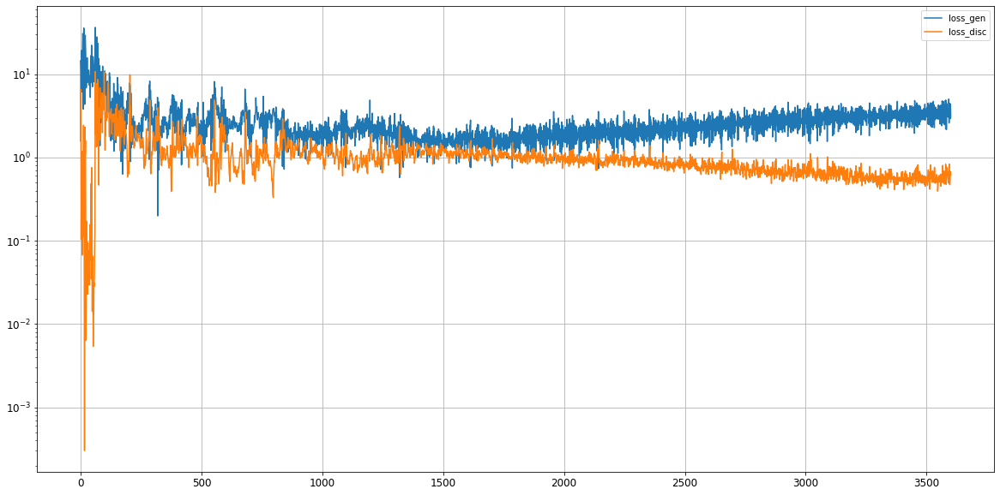

Epoch 3602/50000
0s
Epoch 3603/50000
0s
Epoch 3604/50000
0s
Epoch 3605/50000
0s
Epoch 3606/50000
0s
Epoch 3607/50000
0s
Epoch 3608/50000
0s
Epoch 3609/50000
0s
Epoch 3610/50000
0s
Epoch 3611/50000
0s
Epoch 3612/50000
0s
Epoch 3613/50000
0s
Epoch 3614/50000
0s
Epoch 3615/50000
0s
Epoch 3616/50000
0s
Epoch 3617/50000
0s
Epoch 3618/50000
0s
Epoch 3619/50000
0s
Epoch 3620/50000
0s
Epoch 3621/50000
0s
Epoch 3622/50000
0s
Epoch 3623/50000
0s
Epoch 3624/50000
0s
Epoch 3625/50000
0s
Epoch 3626/50000
0s
Epoch 3627/50000
0s
Epoch 3628/50000
0s
Epoch 3629/50000
0s
Epoch 3630/50000
0s
Epoch 3631/50000
0s
Epoch 3632/50000
0s
Epoch 3633/50000
0s
Epoch 3634/50000
0s
Epoch 3635/50000
0s
Epoch 3636/50000
0s
Epoch 3637/50000
0s
Epoch 3638/50000
0s
Epoch 3639/50000
0s
Epoch 3640/50000
0s
Epoch 3641/50000
0s
Epoch 3642/50000
0s
Epoch 3643/50000
0s
Epoch 3644/50000
0s
Epoch 3645/50000
0s
Epoch 3646/50000
0s
Epoch 3647/50000
0s
Epoch 3648/50000
0s
Epoch 3649/50000
0s
Epoch 3650/50000
0s
Epoch 3651/50000
0s


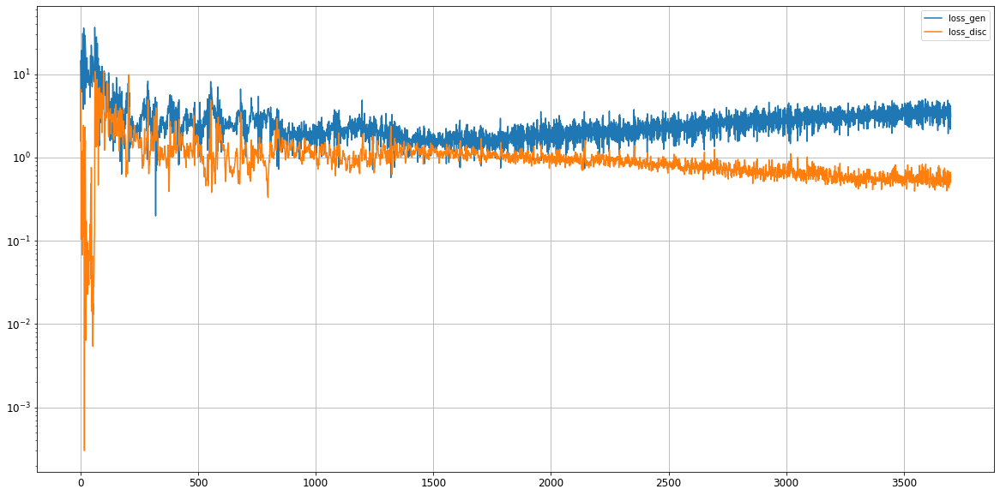

Epoch 3702/50000
0s
Epoch 3703/50000
0s
Epoch 3704/50000
0s
Epoch 3705/50000
0s
Epoch 3706/50000
0s
Epoch 3707/50000
0s
Epoch 3708/50000
0s
Epoch 3709/50000
0s
Epoch 3710/50000
0s
Epoch 3711/50000
0s
Epoch 3712/50000
0s
Epoch 3713/50000
0s
Epoch 3714/50000
0s
Epoch 3715/50000
0s
Epoch 3716/50000
0s
Epoch 3717/50000
0s
Epoch 3718/50000
0s
Epoch 3719/50000
0s
Epoch 3720/50000
0s
Epoch 3721/50000
0s
Epoch 3722/50000
0s
Epoch 3723/50000
0s
Epoch 3724/50000
0s
Epoch 3725/50000
0s
Epoch 3726/50000
0s
Epoch 3727/50000
0s
Epoch 3728/50000
0s
Epoch 3729/50000
0s
Epoch 3730/50000
0s
Epoch 3731/50000
0s
Epoch 3732/50000
0s
Epoch 3733/50000
0s
Epoch 3734/50000
0s
Epoch 3735/50000
0s
Epoch 3736/50000
0s
Epoch 3737/50000
0s
Epoch 3738/50000
0s
Epoch 3739/50000
0s
Epoch 3740/50000
0s
Epoch 3741/50000
0s
Epoch 3742/50000
0s
Epoch 3743/50000
0s
Epoch 3744/50000
0s
Epoch 3745/50000
0s
Epoch 3746/50000
0s
Epoch 3747/50000
0s
Epoch 3748/50000
0s
Epoch 3749/50000
0s
Epoch 3750/50000
0s
Epoch 3751/50000
0s


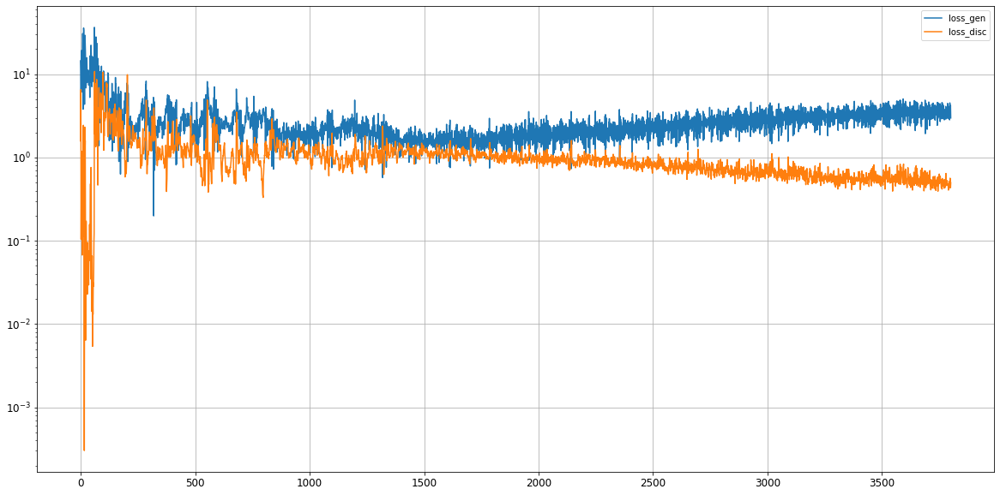

Epoch 3802/50000
0s
Epoch 3803/50000
0s
Epoch 3804/50000
0s
Epoch 3805/50000
0s
Epoch 3806/50000
0s
Epoch 3807/50000
0s
Epoch 3808/50000
0s
Epoch 3809/50000
0s
Epoch 3810/50000
0s
Epoch 3811/50000
0s
Epoch 3812/50000
0s
Epoch 3813/50000
0s
Epoch 3814/50000
0s
Epoch 3815/50000
0s
Epoch 3816/50000
0s
Epoch 3817/50000
0s
Epoch 3818/50000
0s
Epoch 3819/50000
0s
Epoch 3820/50000
0s
Epoch 3821/50000
0s
Epoch 3822/50000
0s
Epoch 3823/50000
0s
Epoch 3824/50000
0s
Epoch 3825/50000
0s
Epoch 3826/50000
0s
Epoch 3827/50000
0s
Epoch 3828/50000
0s
Epoch 3829/50000
0s
Epoch 3830/50000
0s
Epoch 3831/50000
0s
Epoch 3832/50000
0s
Epoch 3833/50000
0s
Epoch 3834/50000
0s
Epoch 3835/50000
0s
Epoch 3836/50000
0s
Epoch 3837/50000
0s
Epoch 3838/50000
0s
Epoch 3839/50000
0s
Epoch 3840/50000
0s
Epoch 3841/50000
0s
Epoch 3842/50000
0s
Epoch 3843/50000
0s
Epoch 3844/50000
0s
Epoch 3845/50000
0s
Epoch 3846/50000
0s
Epoch 3847/50000
0s
Epoch 3848/50000
0s
Epoch 3849/50000
0s
Epoch 3850/50000
0s
Epoch 3851/50000
0s


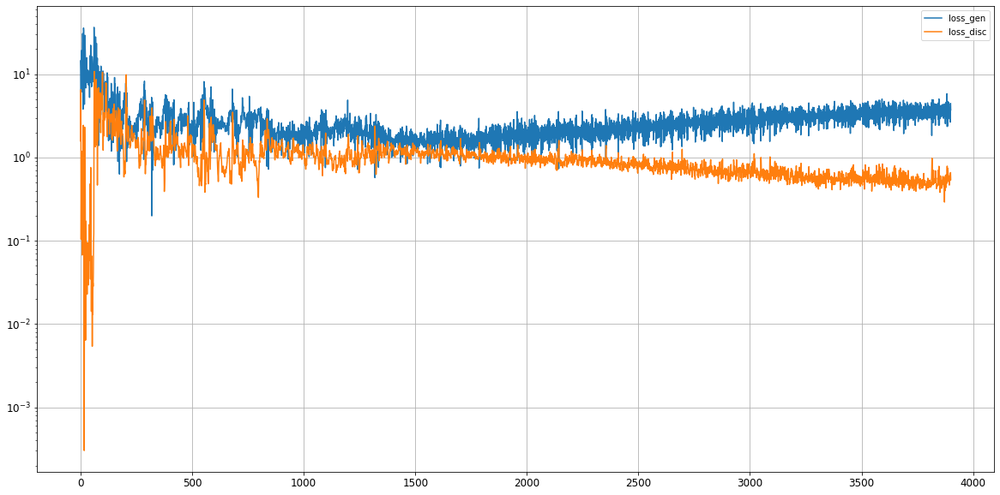

Epoch 3902/50000
0s
Epoch 3903/50000
0s
Epoch 3904/50000
0s
Epoch 3905/50000
0s
Epoch 3906/50000
0s
Epoch 3907/50000
0s
Epoch 3908/50000
0s
Epoch 3909/50000
0s
Epoch 3910/50000
0s
Epoch 3911/50000
0s
Epoch 3912/50000
0s
Epoch 3913/50000
0s
Epoch 3914/50000
0s
Epoch 3915/50000
0s
Epoch 3916/50000
0s
Epoch 3917/50000
0s
Epoch 3918/50000
0s
Epoch 3919/50000
0s
Epoch 3920/50000
0s
Epoch 3921/50000
0s
Epoch 3922/50000
0s
Epoch 3923/50000
0s
Epoch 3924/50000
0s
Epoch 3925/50000
0s
Epoch 3926/50000
0s
Epoch 3927/50000
0s
Epoch 3928/50000
0s
Epoch 3929/50000
0s
Epoch 3930/50000
0s
Epoch 3931/50000
0s
Epoch 3932/50000
0s
Epoch 3933/50000
0s
Epoch 3934/50000
0s
Epoch 3935/50000
0s
Epoch 3936/50000
0s
Epoch 3937/50000
0s
Epoch 3938/50000
0s
Epoch 3939/50000
0s
Epoch 3940/50000
0s
Epoch 3941/50000
0s
Epoch 3942/50000
0s
Epoch 3943/50000
0s
Epoch 3944/50000
0s
Epoch 3945/50000
0s
Epoch 3946/50000
0s
Epoch 3947/50000
0s
Epoch 3948/50000
0s
Epoch 3949/50000
0s
Epoch 3950/50000
0s
Epoch 3951/50000
0s


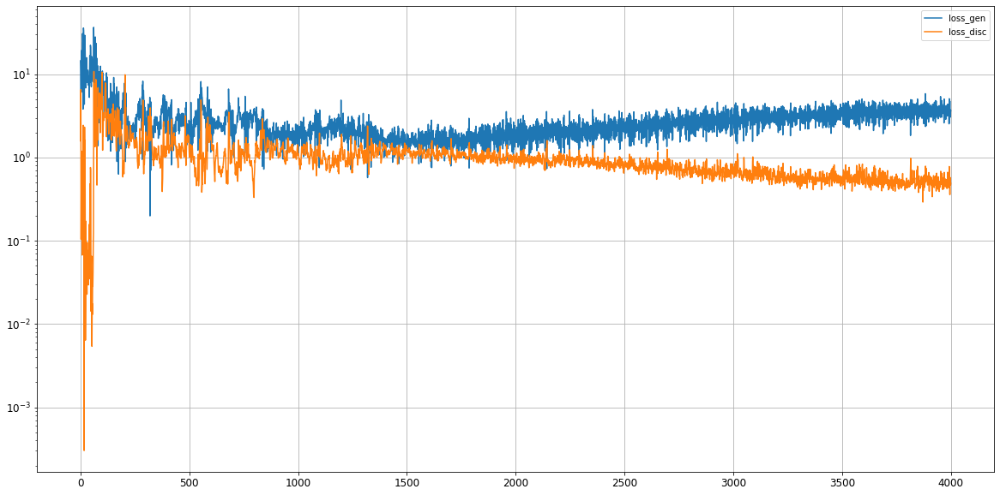

Epoch 4002/50000
0s
Epoch 4003/50000
0s
Epoch 4004/50000
0s
Epoch 4005/50000
0s
Epoch 4006/50000
0s
Epoch 4007/50000
0s
Epoch 4008/50000
0s
Epoch 4009/50000
0s
Epoch 4010/50000
0s
Epoch 4011/50000
0s
Epoch 4012/50000
0s
Epoch 4013/50000
0s
Epoch 4014/50000
0s
Epoch 4015/50000
0s
Epoch 4016/50000
0s
Epoch 4017/50000
0s
Epoch 4018/50000
0s
Epoch 4019/50000
0s
Epoch 4020/50000
0s
Epoch 4021/50000
0s
Epoch 4022/50000
0s
Epoch 4023/50000
0s
Epoch 4024/50000
0s
Epoch 4025/50000
0s
Epoch 4026/50000
0s
Epoch 4027/50000
0s
Epoch 4028/50000
0s
Epoch 4029/50000
0s
Epoch 4030/50000
0s
Epoch 4031/50000
0s
Epoch 4032/50000
0s
Epoch 4033/50000
0s
Epoch 4034/50000
0s
Epoch 4035/50000
0s
Epoch 4036/50000
0s
Epoch 4037/50000
0s
Epoch 4038/50000
0s
Epoch 4039/50000
0s
Epoch 4040/50000
0s
Epoch 4041/50000
0s
Epoch 4042/50000
0s
Epoch 4043/50000
0s
Epoch 4044/50000
0s
Epoch 4045/50000
0s
Epoch 4046/50000
0s
Epoch 4047/50000
0s
Epoch 4048/50000
0s
Epoch 4049/50000
0s
Epoch 4050/50000
0s
Epoch 4051/50000
0s


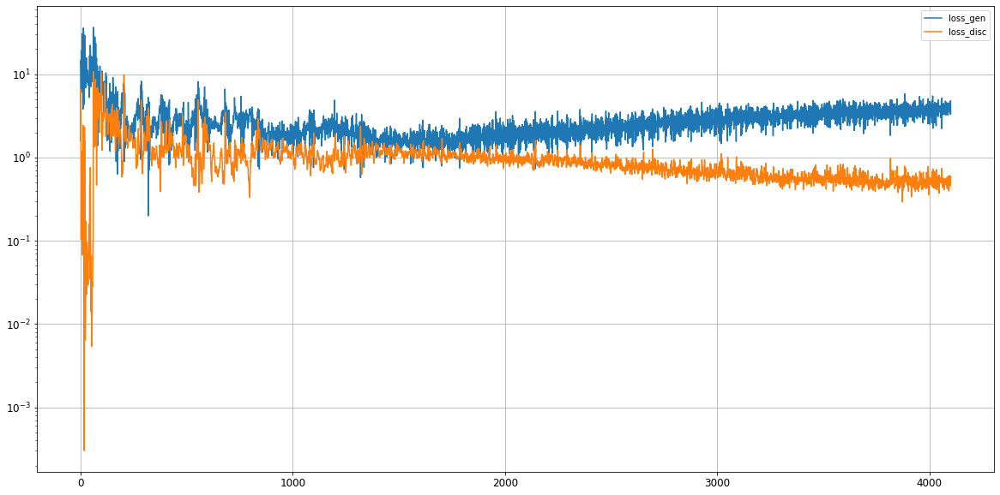

Epoch 4102/50000
0s
Epoch 4103/50000
0s
Epoch 4104/50000
0s
Epoch 4105/50000
0s
Epoch 4106/50000
0s
Epoch 4107/50000
0s
Epoch 4108/50000
0s
Epoch 4109/50000
0s
Epoch 4110/50000
0s
Epoch 4111/50000
0s
Epoch 4112/50000
0s
Epoch 4113/50000
0s
Epoch 4114/50000
0s
Epoch 4115/50000
0s
Epoch 4116/50000
0s
Epoch 4117/50000
0s
Epoch 4118/50000
0s
Epoch 4119/50000
0s
Epoch 4120/50000
0s
Epoch 4121/50000
0s
Epoch 4122/50000
0s
Epoch 4123/50000
0s
Epoch 4124/50000
0s
Epoch 4125/50000
0s
Epoch 4126/50000
0s
Epoch 4127/50000
0s
Epoch 4128/50000
0s
Epoch 4129/50000
0s
Epoch 4130/50000
0s
Epoch 4131/50000
0s
Epoch 4132/50000
0s
Epoch 4133/50000
0s
Epoch 4134/50000
0s
Epoch 4135/50000
0s
Epoch 4136/50000
0s
Epoch 4137/50000
0s
Epoch 4138/50000
0s
Epoch 4139/50000
0s
Epoch 4140/50000
0s
Epoch 4141/50000
0s
Epoch 4142/50000
0s
Epoch 4143/50000
0s
Epoch 4144/50000
0s
Epoch 4145/50000
0s
Epoch 4146/50000
0s
Epoch 4147/50000
0s
Epoch 4148/50000
0s
Epoch 4149/50000
0s
Epoch 4150/50000
0s
Epoch 4151/50000
0s


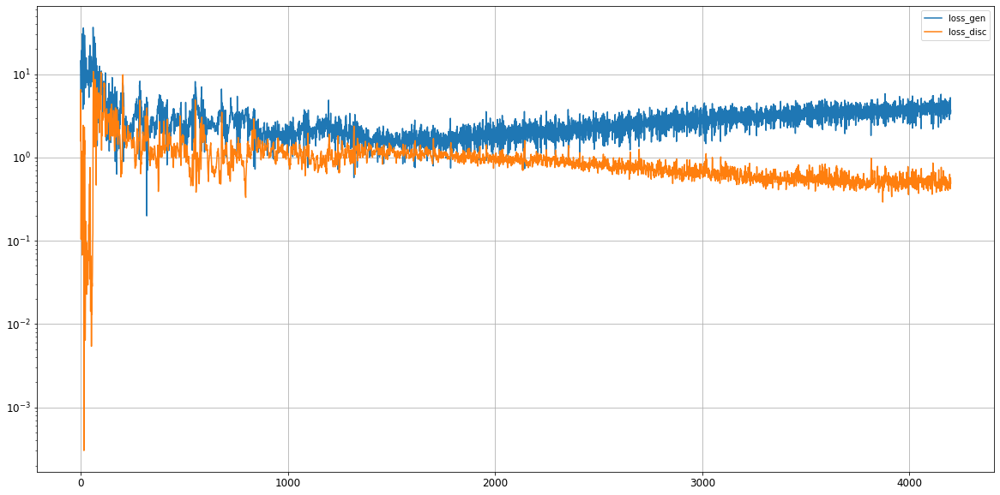

Epoch 4202/50000
0s
Epoch 4203/50000
0s
Epoch 4204/50000
0s
Epoch 4205/50000
0s
Epoch 4206/50000
0s
Epoch 4207/50000
0s
Epoch 4208/50000
0s
Epoch 4209/50000
0s
Epoch 4210/50000
0s
Epoch 4211/50000
0s
Epoch 4212/50000
0s
Epoch 4213/50000
0s
Epoch 4214/50000
0s
Epoch 4215/50000
0s
Epoch 4216/50000
0s
Epoch 4217/50000
0s
Epoch 4218/50000
0s
Epoch 4219/50000
0s
Epoch 4220/50000
0s
Epoch 4221/50000
0s
Epoch 4222/50000
0s
Epoch 4223/50000
0s
Epoch 4224/50000
0s
Epoch 4225/50000
0s
Epoch 4226/50000
0s
Epoch 4227/50000
0s
Epoch 4228/50000
0s
Epoch 4229/50000
0s
Epoch 4230/50000
0s
Epoch 4231/50000
0s
Epoch 4232/50000
0s
Epoch 4233/50000
0s
Epoch 4234/50000
0s
Epoch 4235/50000
0s
Epoch 4236/50000
0s
Epoch 4237/50000
0s
Epoch 4238/50000
0s
Epoch 4239/50000
0s
Epoch 4240/50000
0s
Epoch 4241/50000
0s
Epoch 4242/50000
0s
Epoch 4243/50000
0s
Epoch 4244/50000
0s
Epoch 4245/50000
0s
Epoch 4246/50000
0s
Epoch 4247/50000
0s
Epoch 4248/50000
0s
Epoch 4249/50000
0s
Epoch 4250/50000
0s
Epoch 4251/50000
0s


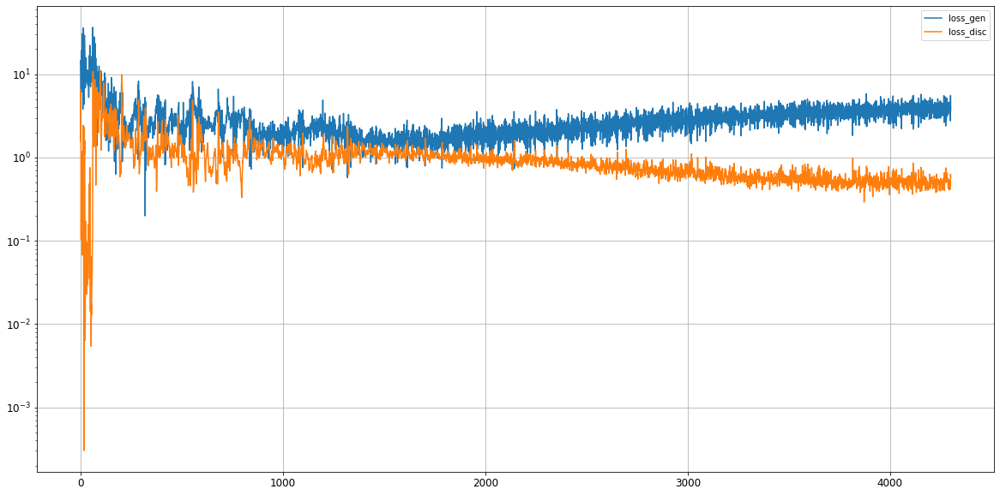

Epoch 4302/50000
0s
Epoch 4303/50000
0s
Epoch 4304/50000
0s
Epoch 4305/50000
0s
Epoch 4306/50000
0s
Epoch 4307/50000
0s
Epoch 4308/50000
0s
Epoch 4309/50000
0s
Epoch 4310/50000
0s
Epoch 4311/50000
0s
Epoch 4312/50000
0s
Epoch 4313/50000
0s
Epoch 4314/50000
0s
Epoch 4315/50000
0s
Epoch 4316/50000
0s
Epoch 4317/50000
0s
Epoch 4318/50000
0s
Epoch 4319/50000
0s
Epoch 4320/50000
0s
Epoch 4321/50000
0s
Epoch 4322/50000
0s
Epoch 4323/50000
0s
Epoch 4324/50000
0s
Epoch 4325/50000
0s
Epoch 4326/50000
0s
Epoch 4327/50000
0s
Epoch 4328/50000
0s
Epoch 4329/50000
0s
Epoch 4330/50000
0s
Epoch 4331/50000
0s
Epoch 4332/50000
0s
Epoch 4333/50000
0s
Epoch 4334/50000
0s
Epoch 4335/50000
0s
Epoch 4336/50000
0s
Epoch 4337/50000
0s
Epoch 4338/50000
0s
Epoch 4339/50000
0s
Epoch 4340/50000
0s
Epoch 4341/50000
0s
Epoch 4342/50000
0s
Epoch 4343/50000
0s
Epoch 4344/50000
0s
Epoch 4345/50000
0s
Epoch 4346/50000
0s
Epoch 4347/50000
0s
Epoch 4348/50000
0s
Epoch 4349/50000
0s
Epoch 4350/50000
0s
Epoch 4351/50000
0s


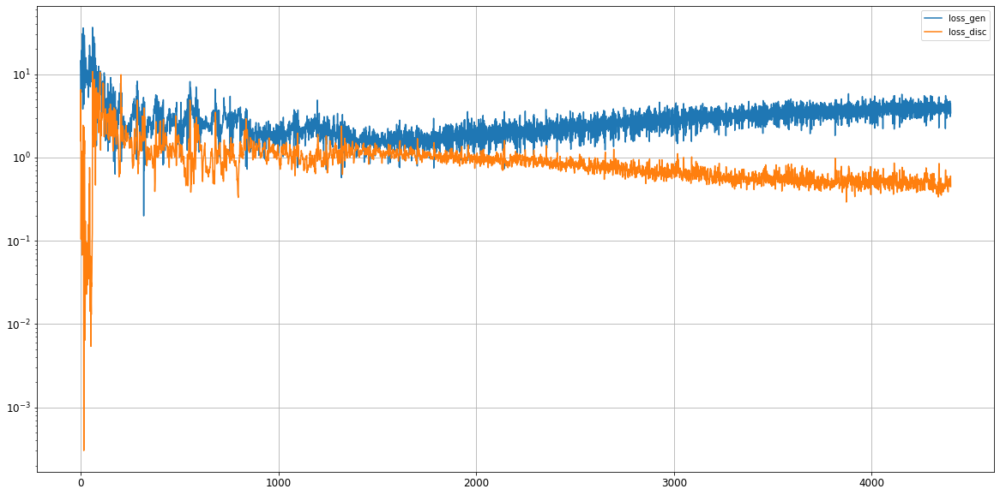

Epoch 4402/50000
0s
Epoch 4403/50000
0s
Epoch 4404/50000
0s
Epoch 4405/50000
0s
Epoch 4406/50000
0s
Epoch 4407/50000
0s
Epoch 4408/50000
0s
Epoch 4409/50000
0s
Epoch 4410/50000
0s
Epoch 4411/50000
0s
Epoch 4412/50000
0s
Epoch 4413/50000
0s
Epoch 4414/50000
0s
Epoch 4415/50000
0s
Epoch 4416/50000
0s
Epoch 4417/50000
0s
Epoch 4418/50000
0s
Epoch 4419/50000
0s
Epoch 4420/50000
0s
Epoch 4421/50000
0s
Epoch 4422/50000
0s
Epoch 4423/50000
0s
Epoch 4424/50000
0s
Epoch 4425/50000
0s
Epoch 4426/50000
0s
Epoch 4427/50000
0s
Epoch 4428/50000
0s
Epoch 4429/50000
0s
Epoch 4430/50000
0s
Epoch 4431/50000
0s
Epoch 4432/50000
0s
Epoch 4433/50000
0s
Epoch 4434/50000
0s
Epoch 4435/50000
0s
Epoch 4436/50000
0s
Epoch 4437/50000
0s
Epoch 4438/50000
0s
Epoch 4439/50000
0s
Epoch 4440/50000
0s
Epoch 4441/50000
0s
Epoch 4442/50000
0s
Epoch 4443/50000
0s
Epoch 4444/50000
0s
Epoch 4445/50000
0s
Epoch 4446/50000
0s
Epoch 4447/50000
0s
Epoch 4448/50000
0s
Epoch 4449/50000
0s
Epoch 4450/50000
0s
Epoch 4451/50000
0s


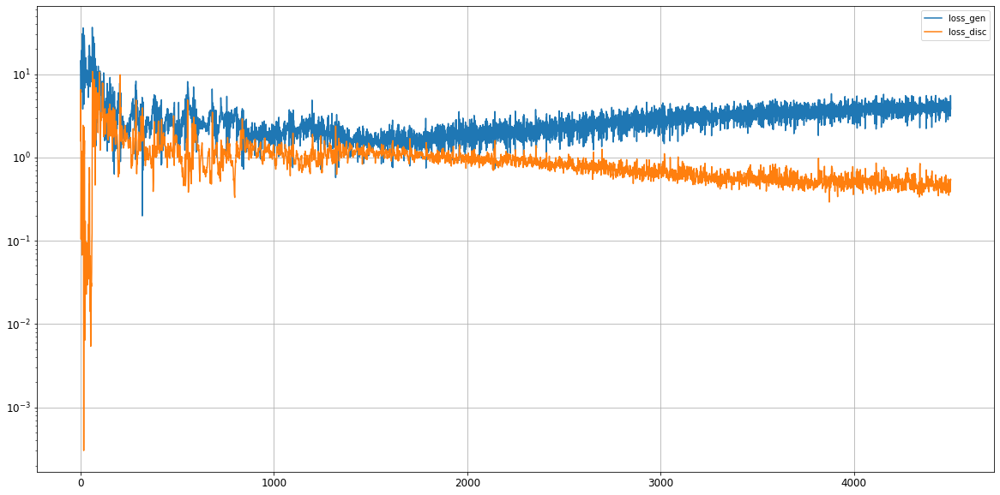

Epoch 4502/50000
0s
Epoch 4503/50000
0s
Epoch 4504/50000
0s
Epoch 4505/50000
0s
Epoch 4506/50000
0s
Epoch 4507/50000
0s
Epoch 4508/50000
0s
Epoch 4509/50000
0s
Epoch 4510/50000
0s
Epoch 4511/50000
0s
Epoch 4512/50000
0s
Epoch 4513/50000
0s
Epoch 4514/50000
0s
Epoch 4515/50000
0s
Epoch 4516/50000
0s
Epoch 4517/50000
0s
Epoch 4518/50000
0s
Epoch 4519/50000
0s
Epoch 4520/50000
0s
Epoch 4521/50000
0s
Epoch 4522/50000
0s
Epoch 4523/50000
0s
Epoch 4524/50000
0s
Epoch 4525/50000
0s
Epoch 4526/50000
0s
Epoch 4527/50000
0s
Epoch 4528/50000
0s
Epoch 4529/50000
0s
Epoch 4530/50000
0s
Epoch 4531/50000
0s
Epoch 4532/50000
0s
Epoch 4533/50000
0s
Epoch 4534/50000
0s
Epoch 4535/50000
0s
Epoch 4536/50000
0s
Epoch 4537/50000
0s
Epoch 4538/50000
0s
Epoch 4539/50000
0s
Epoch 4540/50000
0s
Epoch 4541/50000
0s
Epoch 4542/50000
0s
Epoch 4543/50000
0s
Epoch 4544/50000
0s
Epoch 4545/50000
0s
Epoch 4546/50000
0s
Epoch 4547/50000
0s
Epoch 4548/50000
0s
Epoch 4549/50000
0s
Epoch 4550/50000
0s
Epoch 4551/50000
0s


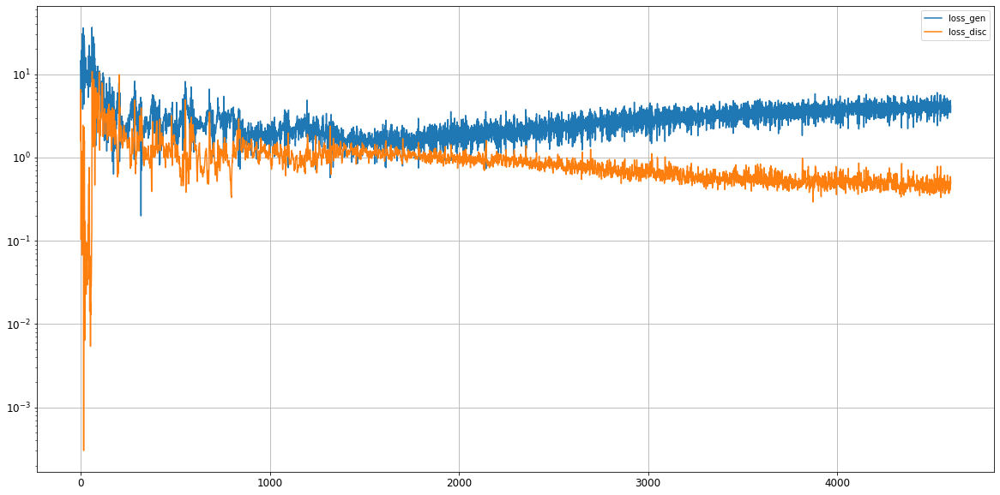

Epoch 4602/50000
0s
Epoch 4603/50000
0s
Epoch 4604/50000
0s
Epoch 4605/50000
0s
Epoch 4606/50000
0s
Epoch 4607/50000
0s
Epoch 4608/50000
0s
Epoch 4609/50000
0s
Epoch 4610/50000
0s
Epoch 4611/50000
0s
Epoch 4612/50000
0s
Epoch 4613/50000
0s
Epoch 4614/50000
0s
Epoch 4615/50000
0s
Epoch 4616/50000
0s
Epoch 4617/50000
0s
Epoch 4618/50000
0s
Epoch 4619/50000
0s
Epoch 4620/50000
0s
Epoch 4621/50000
0s
Epoch 4622/50000
0s
Epoch 4623/50000
0s
Epoch 4624/50000
0s
Epoch 4625/50000
0s
Epoch 4626/50000
0s
Epoch 4627/50000
0s
Epoch 4628/50000
0s
Epoch 4629/50000
0s
Epoch 4630/50000
0s
Epoch 4631/50000
0s
Epoch 4632/50000
0s
Epoch 4633/50000
0s
Epoch 4634/50000
0s
Epoch 4635/50000
0s
Epoch 4636/50000
0s
Epoch 4637/50000
0s
Epoch 4638/50000
0s
Epoch 4639/50000
0s
Epoch 4640/50000
0s
Epoch 4641/50000
0s
Epoch 4642/50000
0s
Epoch 4643/50000
0s
Epoch 4644/50000
0s
Epoch 4645/50000
0s
Epoch 4646/50000
0s
Epoch 4647/50000
0s
Epoch 4648/50000
0s
Epoch 4649/50000
0s
Epoch 4650/50000
0s
Epoch 4651/50000
0s


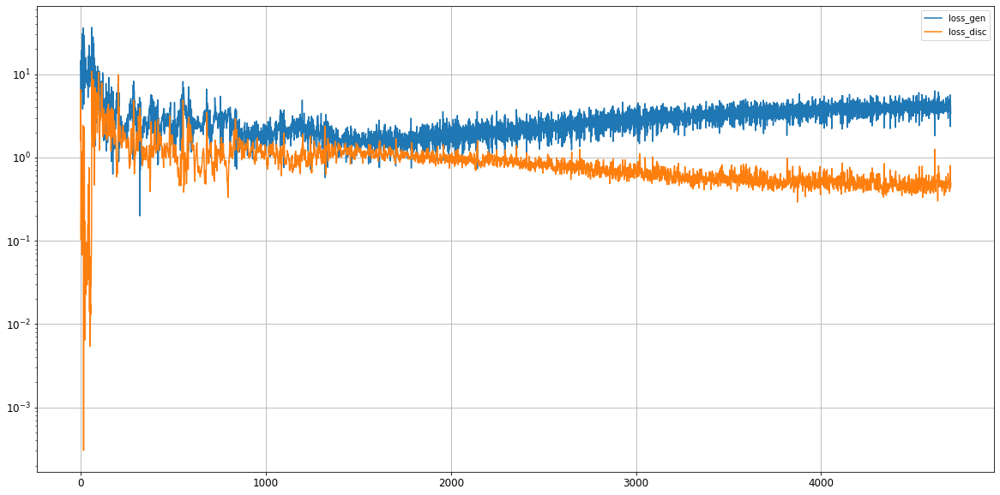

Epoch 4702/50000
0s
Epoch 4703/50000
0s
Epoch 4704/50000
0s
Epoch 4705/50000
0s
Epoch 4706/50000
0s
Epoch 4707/50000
0s
Epoch 4708/50000
0s
Epoch 4709/50000
0s
Epoch 4710/50000
0s
Epoch 4711/50000
0s
Epoch 4712/50000
0s
Epoch 4713/50000
0s
Epoch 4714/50000
0s
Epoch 4715/50000
0s
Epoch 4716/50000
0s
Epoch 4717/50000
0s
Epoch 4718/50000
0s
Epoch 4719/50000
0s
Epoch 4720/50000
0s
Epoch 4721/50000
0s
Epoch 4722/50000
0s
Epoch 4723/50000
0s
Epoch 4724/50000
0s
Epoch 4725/50000
0s
Epoch 4726/50000
0s
Epoch 4727/50000
0s
Epoch 4728/50000
0s
Epoch 4729/50000
0s
Epoch 4730/50000
0s
Epoch 4731/50000
0s
Epoch 4732/50000
0s
Epoch 4733/50000
0s
Epoch 4734/50000
0s
Epoch 4735/50000
0s
Epoch 4736/50000
0s
Epoch 4737/50000
0s
Epoch 4738/50000
0s
Epoch 4739/50000
0s
Epoch 4740/50000
0s
Epoch 4741/50000
0s
Epoch 4742/50000
0s
Epoch 4743/50000
0s
Epoch 4744/50000
0s
Epoch 4745/50000
0s
Epoch 4746/50000
0s
Epoch 4747/50000
0s
Epoch 4748/50000
0s
Epoch 4749/50000
0s
Epoch 4750/50000
0s
Epoch 4751/50000
0s


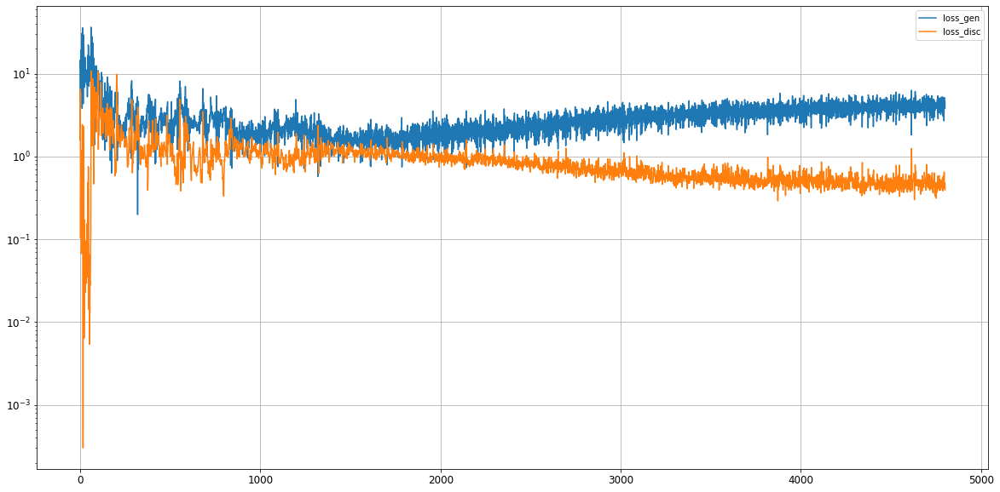

Epoch 4802/50000
0s
Epoch 4803/50000
0s
Epoch 4804/50000
0s
Epoch 4805/50000
0s
Epoch 4806/50000
0s
Epoch 4807/50000
0s
Epoch 4808/50000
0s
Epoch 4809/50000
0s
Epoch 4810/50000
0s
Epoch 4811/50000
0s
Epoch 4812/50000
0s
Epoch 4813/50000
0s
Epoch 4814/50000
0s
Epoch 4815/50000
0s
Epoch 4816/50000
0s
Epoch 4817/50000
0s
Epoch 4818/50000
0s
Epoch 4819/50000
0s
Epoch 4820/50000
0s
Epoch 4821/50000
0s
Epoch 4822/50000
0s
Epoch 4823/50000
0s
Epoch 4824/50000
0s
Epoch 4825/50000
0s
Epoch 4826/50000
0s
Epoch 4827/50000
0s
Epoch 4828/50000
0s
Epoch 4829/50000
0s
Epoch 4830/50000
0s
Epoch 4831/50000
0s
Epoch 4832/50000
0s
Epoch 4833/50000
0s
Epoch 4834/50000
0s
Epoch 4835/50000
0s
Epoch 4836/50000
0s
Epoch 4837/50000
0s
Epoch 4838/50000
0s
Epoch 4839/50000
0s
Epoch 4840/50000
0s
Epoch 4841/50000
0s
Epoch 4842/50000
0s
Epoch 4843/50000
0s
Epoch 4844/50000
0s
Epoch 4845/50000
0s
Epoch 4846/50000
0s
Epoch 4847/50000
0s
Epoch 4848/50000
0s
Epoch 4849/50000
0s
Epoch 4850/50000
0s
Epoch 4851/50000
0s


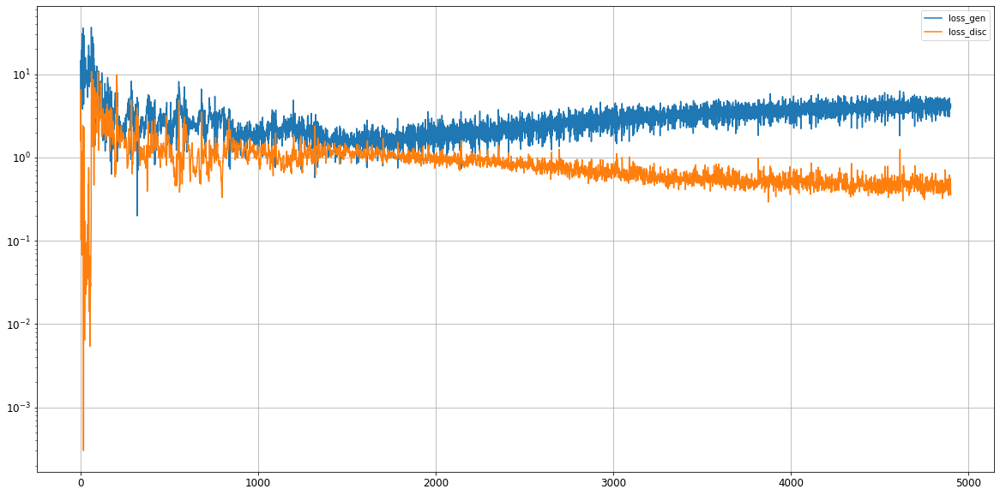

Epoch 4902/50000
0s
Epoch 4903/50000
0s
Epoch 4904/50000
0s
Epoch 4905/50000
0s
Epoch 4906/50000
0s
Epoch 4907/50000
0s
Epoch 4908/50000
0s
Epoch 4909/50000
0s
Epoch 4910/50000
0s
Epoch 4911/50000
0s
Epoch 4912/50000
0s
Epoch 4913/50000
0s
Epoch 4914/50000
0s
Epoch 4915/50000
0s
Epoch 4916/50000
0s
Epoch 4917/50000
0s
Epoch 4918/50000
0s
Epoch 4919/50000
0s
Epoch 4920/50000
0s
Epoch 4921/50000
0s
Epoch 4922/50000
0s
Epoch 4923/50000
0s
Epoch 4924/50000
0s
Epoch 4925/50000
0s
Epoch 4926/50000
0s
Epoch 4927/50000
0s
Epoch 4928/50000
0s
Epoch 4929/50000
0s
Epoch 4930/50000
0s
Epoch 4931/50000
0s
Epoch 4932/50000
0s
Epoch 4933/50000
0s
Epoch 4934/50000
0s
Epoch 4935/50000
0s
Epoch 4936/50000
0s
Epoch 4937/50000
0s
Epoch 4938/50000
0s
Epoch 4939/50000
0s
Epoch 4940/50000
0s
Epoch 4941/50000
0s
Epoch 4942/50000
0s
Epoch 4943/50000
0s
Epoch 4944/50000
0s
Epoch 4945/50000
0s
Epoch 4946/50000
0s
Epoch 4947/50000
0s
Epoch 4948/50000
0s
Epoch 4949/50000
0s
Epoch 4950/50000
0s
Epoch 4951/50000
0s


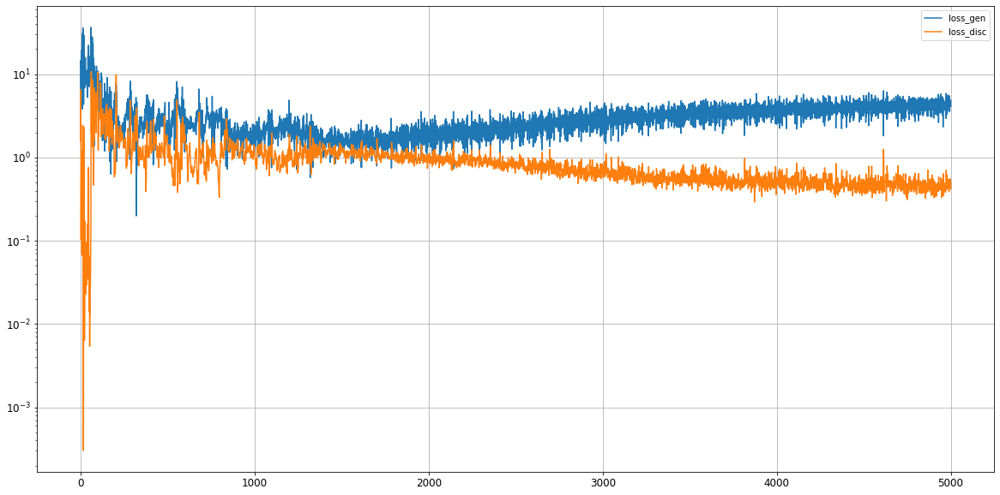

Epoch 5002/50000
0s
Epoch 5003/50000
0s
Epoch 5004/50000
0s
Epoch 5005/50000
0s
Epoch 5006/50000
0s
Epoch 5007/50000
0s
Epoch 5008/50000
0s
Epoch 5009/50000
0s
Epoch 5010/50000
0s
Epoch 5011/50000
0s
Epoch 5012/50000
0s
Epoch 5013/50000
0s
Epoch 5014/50000
0s
Epoch 5015/50000
0s
Epoch 5016/50000
0s
Epoch 5017/50000
0s
Epoch 5018/50000
0s
Epoch 5019/50000
0s
Epoch 5020/50000
0s
Epoch 5021/50000
0s
Epoch 5022/50000
0s
Epoch 5023/50000
0s
Epoch 5024/50000
0s
Epoch 5025/50000
0s
Epoch 5026/50000
0s
Epoch 5027/50000
0s
Epoch 5028/50000
0s
Epoch 5029/50000
0s
Epoch 5030/50000
0s
Epoch 5031/50000
0s
Epoch 5032/50000
0s
Epoch 5033/50000
0s
Epoch 5034/50000
0s
Epoch 5035/50000
0s
Epoch 5036/50000
0s
Epoch 5037/50000
0s
Epoch 5038/50000
0s
Epoch 5039/50000
0s
Epoch 5040/50000
0s
Epoch 5041/50000
0s
Epoch 5042/50000
0s
Epoch 5043/50000
0s
Epoch 5044/50000
0s
Epoch 5045/50000
0s
Epoch 5046/50000
0s
Epoch 5047/50000
0s
Epoch 5048/50000
0s
Epoch 5049/50000
0s
Epoch 5050/50000
0s
Epoch 5051/50000
0s


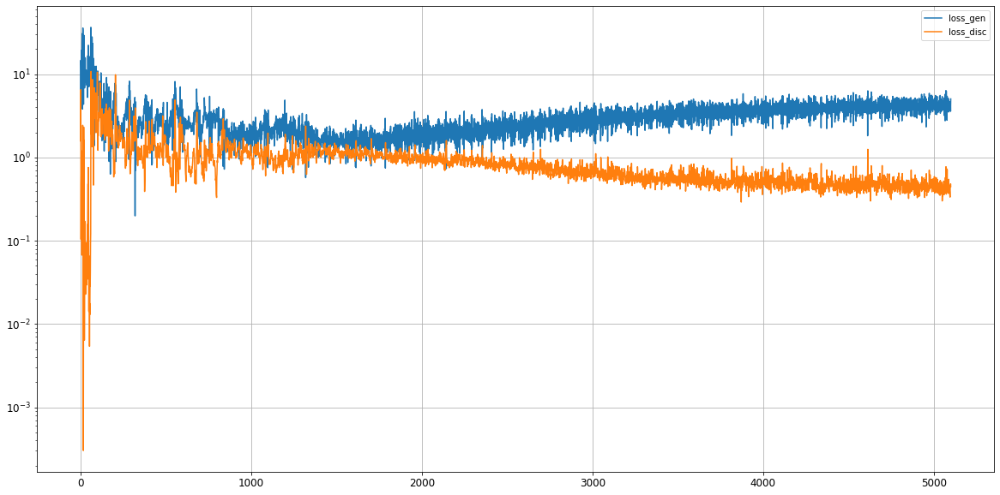

Epoch 5102/50000
0s
Epoch 5103/50000
0s
Epoch 5104/50000
0s
Epoch 5105/50000
0s
Epoch 5106/50000
0s
Epoch 5107/50000
0s
Epoch 5108/50000
0s
Epoch 5109/50000
0s
Epoch 5110/50000
0s
Epoch 5111/50000
0s
Epoch 5112/50000
0s
Epoch 5113/50000
0s
Epoch 5114/50000
0s
Epoch 5115/50000
0s
Epoch 5116/50000
0s
Epoch 5117/50000
0s
Epoch 5118/50000
0s
Epoch 5119/50000
0s
Epoch 5120/50000
0s
Epoch 5121/50000
0s
Epoch 5122/50000
0s
Epoch 5123/50000
0s
Epoch 5124/50000
0s
Epoch 5125/50000
0s
Epoch 5126/50000
0s
Epoch 5127/50000
0s
Epoch 5128/50000
0s
Epoch 5129/50000
0s
Epoch 5130/50000
0s
Epoch 5131/50000
0s
Epoch 5132/50000
0s
Epoch 5133/50000
0s
Epoch 5134/50000
0s
Epoch 5135/50000
0s
Epoch 5136/50000
0s
Epoch 5137/50000
0s
Epoch 5138/50000
0s
Epoch 5139/50000
0s
Epoch 5140/50000
0s
Epoch 5141/50000
0s
Epoch 5142/50000
0s
Epoch 5143/50000
0s
Epoch 5144/50000
0s
Epoch 5145/50000
0s
Epoch 5146/50000
0s
Epoch 5147/50000
0s
Epoch 5148/50000
0s
Epoch 5149/50000
0s
Epoch 5150/50000
0s
Epoch 5151/50000
0s


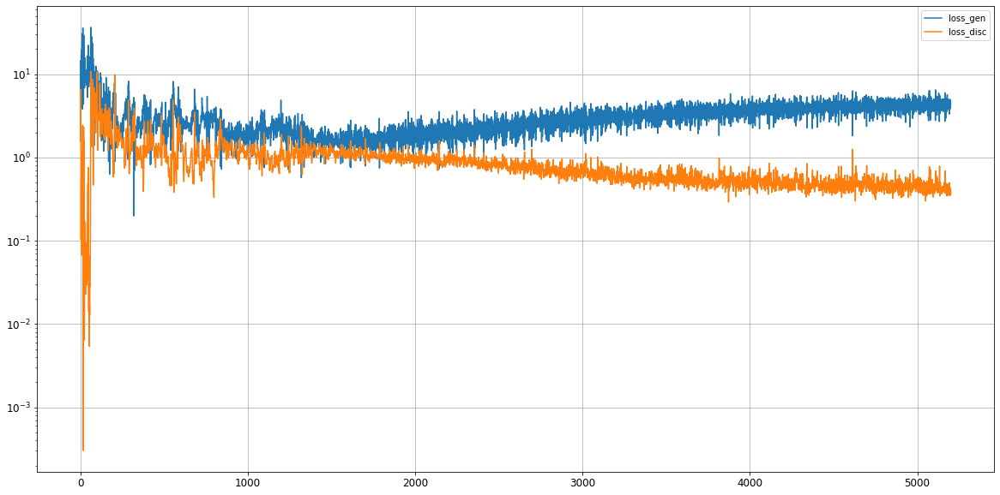

Epoch 5202/50000
0s
Epoch 5203/50000
0s
Epoch 5204/50000
0s
Epoch 5205/50000
0s
Epoch 5206/50000
0s
Epoch 5207/50000
0s
Epoch 5208/50000
0s
Epoch 5209/50000
0s
Epoch 5210/50000
0s
Epoch 5211/50000
0s
Epoch 5212/50000
0s
Epoch 5213/50000
0s
Epoch 5214/50000
0s
Epoch 5215/50000
0s
Epoch 5216/50000
0s
Epoch 5217/50000
0s
Epoch 5218/50000
0s
Epoch 5219/50000
0s
Epoch 5220/50000
0s
Epoch 5221/50000
0s
Epoch 5222/50000
0s
Epoch 5223/50000
0s
Epoch 5224/50000
0s
Epoch 5225/50000
0s
Epoch 5226/50000
0s
Epoch 5227/50000
0s
Epoch 5228/50000
0s
Epoch 5229/50000
0s
Epoch 5230/50000
0s
Epoch 5231/50000
0s
Epoch 5232/50000
0s
Epoch 5233/50000
0s
Epoch 5234/50000
0s
Epoch 5235/50000
0s
Epoch 5236/50000
0s
Epoch 5237/50000
0s
Epoch 5238/50000
0s
Epoch 5239/50000
0s
Epoch 5240/50000
0s
Epoch 5241/50000
0s
Epoch 5242/50000
0s
Epoch 5243/50000
0s
Epoch 5244/50000
0s
Epoch 5245/50000
0s
Epoch 5246/50000
0s
Epoch 5247/50000
0s
Epoch 5248/50000
0s
Epoch 5249/50000
0s
Epoch 5250/50000
0s
Epoch 5251/50000
0s


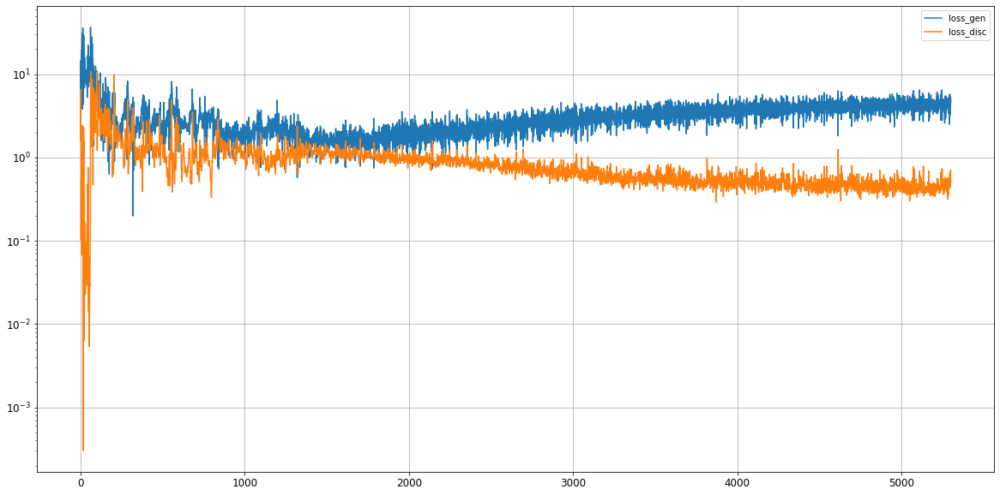

Epoch 5302/50000
0s
Epoch 5303/50000
0s
Epoch 5304/50000
0s
Epoch 5305/50000
0s
Epoch 5306/50000
0s
Epoch 5307/50000
0s
Epoch 5308/50000
0s
Epoch 5309/50000
0s
Epoch 5310/50000
0s
Epoch 5311/50000
0s
Epoch 5312/50000
0s
Epoch 5313/50000
0s
Epoch 5314/50000
0s
Epoch 5315/50000
0s
Epoch 5316/50000
0s
Epoch 5317/50000
0s
Epoch 5318/50000
0s
Epoch 5319/50000
0s
Epoch 5320/50000
0s
Epoch 5321/50000
0s
Epoch 5322/50000
0s
Epoch 5323/50000
0s
Epoch 5324/50000
0s
Epoch 5325/50000
0s
Epoch 5326/50000
0s
Epoch 5327/50000
0s
Epoch 5328/50000
0s
Epoch 5329/50000
0s
Epoch 5330/50000
0s
Epoch 5331/50000
0s
Epoch 5332/50000
0s
Epoch 5333/50000
0s
Epoch 5334/50000
0s
Epoch 5335/50000
0s
Epoch 5336/50000
0s
Epoch 5337/50000
0s
Epoch 5338/50000
0s
Epoch 5339/50000
0s
Epoch 5340/50000
0s
Epoch 5341/50000
0s
Epoch 5342/50000
0s
Epoch 5343/50000
0s
Epoch 5344/50000
0s
Epoch 5345/50000
0s
Epoch 5346/50000
0s
Epoch 5347/50000
0s
Epoch 5348/50000
0s
Epoch 5349/50000
0s
Epoch 5350/50000
0s
Epoch 5351/50000
0s


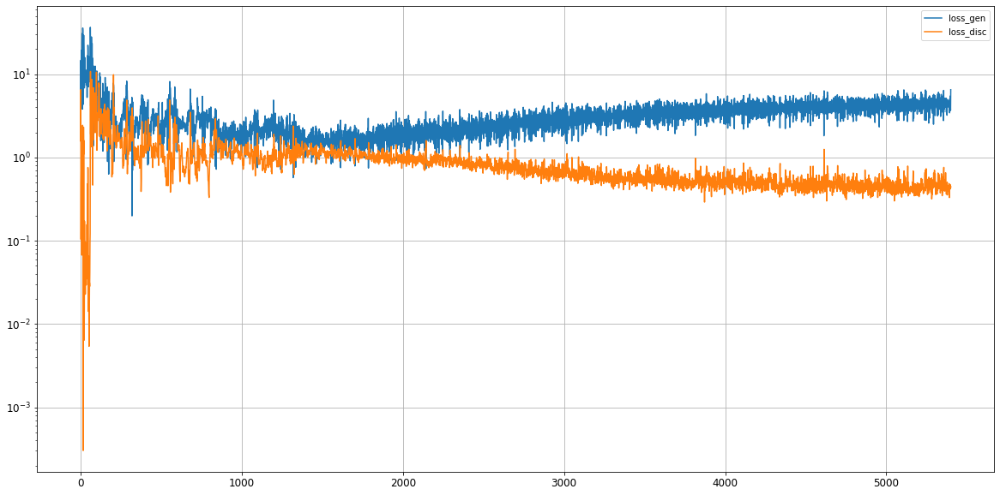

Epoch 5402/50000
0s
Epoch 5403/50000
0s
Epoch 5404/50000
0s
Epoch 5405/50000
0s
Epoch 5406/50000
0s
Epoch 5407/50000
0s
Epoch 5408/50000
0s
Epoch 5409/50000
0s
Epoch 5410/50000
0s
Epoch 5411/50000
0s
Epoch 5412/50000
0s
Epoch 5413/50000
0s
Epoch 5414/50000
0s
Epoch 5415/50000
0s
Epoch 5416/50000
0s
Epoch 5417/50000
0s
Epoch 5418/50000
0s
Epoch 5419/50000
0s
Epoch 5420/50000
0s
Epoch 5421/50000
0s
Epoch 5422/50000
0s
Epoch 5423/50000
0s
Epoch 5424/50000
0s
Epoch 5425/50000
0s
Epoch 5426/50000
0s
Epoch 5427/50000
0s
Epoch 5428/50000
0s
Epoch 5429/50000
0s
Epoch 5430/50000
0s
Epoch 5431/50000
0s
Epoch 5432/50000
0s
Epoch 5433/50000
0s
Epoch 5434/50000
0s
Epoch 5435/50000
0s
Epoch 5436/50000
0s
Epoch 5437/50000
0s
Epoch 5438/50000
0s
Epoch 5439/50000
0s
Epoch 5440/50000
0s
Epoch 5441/50000
0s
Epoch 5442/50000
0s
Epoch 5443/50000
0s
Epoch 5444/50000
0s
Epoch 5445/50000
0s
Epoch 5446/50000
0s
Epoch 5447/50000
0s
Epoch 5448/50000
0s
Epoch 5449/50000
0s
Epoch 5450/50000
0s
Epoch 5451/50000
0s


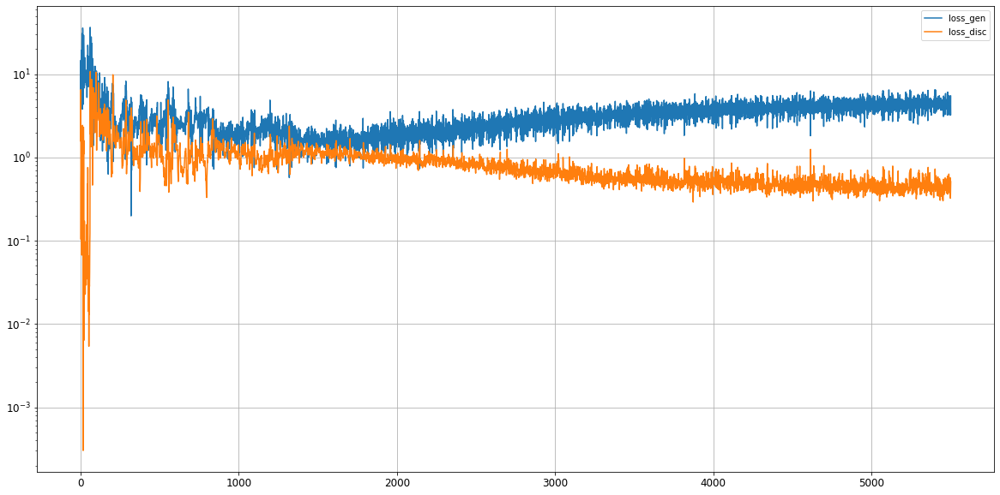

Epoch 5502/50000
0s
Epoch 5503/50000
0s
Epoch 5504/50000
0s
Epoch 5505/50000
0s
Epoch 5506/50000
0s
Epoch 5507/50000
0s
Epoch 5508/50000
0s
Epoch 5509/50000
0s
Epoch 5510/50000
0s
Epoch 5511/50000
0s
Epoch 5512/50000
0s
Epoch 5513/50000
0s
Epoch 5514/50000
0s
Epoch 5515/50000
0s
Epoch 5516/50000
0s
Epoch 5517/50000
0s
Epoch 5518/50000
0s
Epoch 5519/50000
0s
Epoch 5520/50000
0s
Epoch 5521/50000
0s
Epoch 5522/50000
0s
Epoch 5523/50000
0s
Epoch 5524/50000
0s
Epoch 5525/50000
0s
Epoch 5526/50000
0s
Epoch 5527/50000
0s
Epoch 5528/50000
0s
Epoch 5529/50000
0s
Epoch 5530/50000
0s
Epoch 5531/50000
0s
Epoch 5532/50000
0s
Epoch 5533/50000
0s
Epoch 5534/50000
0s
Epoch 5535/50000
0s
Epoch 5536/50000
0s
Epoch 5537/50000
0s
Epoch 5538/50000
0s
Epoch 5539/50000
0s
Epoch 5540/50000
0s
Epoch 5541/50000
0s
Epoch 5542/50000
0s
Epoch 5543/50000
0s
Epoch 5544/50000
0s
Epoch 5545/50000
0s
Epoch 5546/50000
0s
Epoch 5547/50000
0s
Epoch 5548/50000
0s
Epoch 5549/50000
0s
Epoch 5550/50000
0s
Epoch 5551/50000
0s


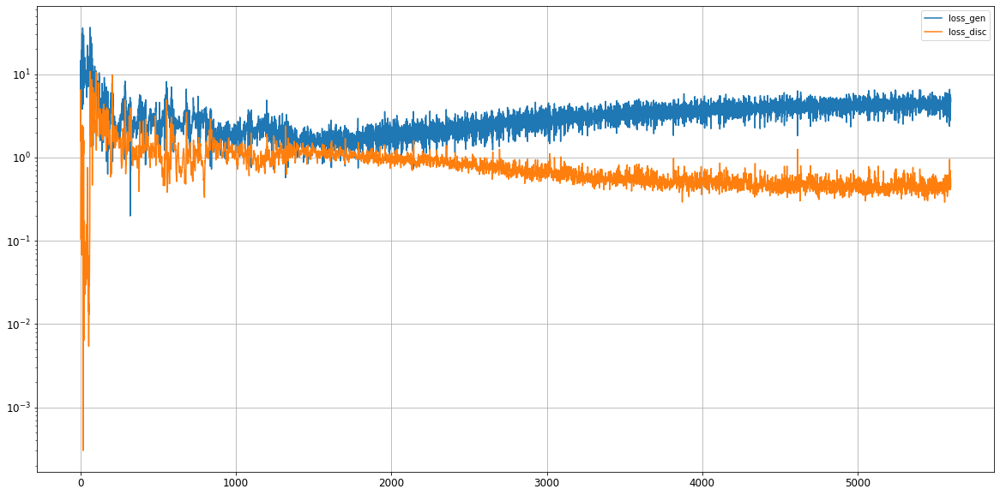

Epoch 5602/50000
0s
Epoch 5603/50000
0s
Epoch 5604/50000
0s
Epoch 5605/50000
0s
Epoch 5606/50000
0s
Epoch 5607/50000
0s
Epoch 5608/50000
0s
Epoch 5609/50000
0s
Epoch 5610/50000
0s
Epoch 5611/50000
0s
Epoch 5612/50000
0s
Epoch 5613/50000
0s
Epoch 5614/50000
0s
Epoch 5615/50000
0s
Epoch 5616/50000
0s
Epoch 5617/50000
0s
Epoch 5618/50000
0s
Epoch 5619/50000
0s
Epoch 5620/50000
0s
Epoch 5621/50000
0s
Epoch 5622/50000
0s
Epoch 5623/50000
0s
Epoch 5624/50000
0s
Epoch 5625/50000
0s
Epoch 5626/50000
0s
Epoch 5627/50000
0s
Epoch 5628/50000
0s
Epoch 5629/50000
0s
Epoch 5630/50000
0s
Epoch 5631/50000
0s
Epoch 5632/50000
0s
Epoch 5633/50000
0s
Epoch 5634/50000
0s
Epoch 5635/50000
0s
Epoch 5636/50000
0s
Epoch 5637/50000
0s
Epoch 5638/50000
0s
Epoch 5639/50000
0s
Epoch 5640/50000
0s
Epoch 5641/50000
0s
Epoch 5642/50000
0s
Epoch 5643/50000
0s
Epoch 5644/50000
0s
Epoch 5645/50000
0s
Epoch 5646/50000
0s
Epoch 5647/50000
0s
Epoch 5648/50000
0s
Epoch 5649/50000
0s
Epoch 5650/50000
0s
Epoch 5651/50000
0s


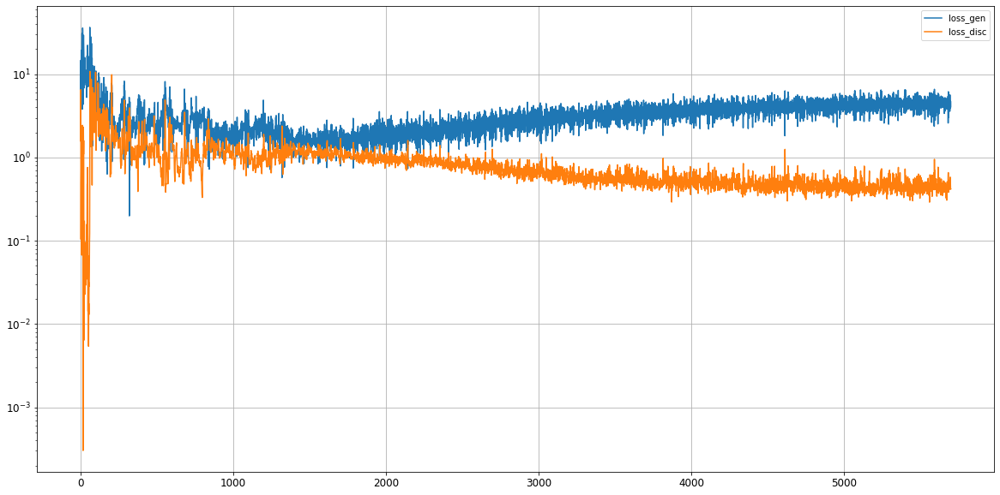

Epoch 5702/50000
0s
Epoch 5703/50000
0s
Epoch 5704/50000
0s
Epoch 5705/50000
0s
Epoch 5706/50000
0s
Epoch 5707/50000
0s
Epoch 5708/50000
0s
Epoch 5709/50000
0s
Epoch 5710/50000
0s
Epoch 5711/50000
0s
Epoch 5712/50000
0s
Epoch 5713/50000
0s
Epoch 5714/50000
0s
Epoch 5715/50000
0s
Epoch 5716/50000
0s
Epoch 5717/50000
0s
Epoch 5718/50000
0s
Epoch 5719/50000
0s
Epoch 5720/50000
0s
Epoch 5721/50000
0s
Epoch 5722/50000
0s
Epoch 5723/50000
0s
Epoch 5724/50000
0s
Epoch 5725/50000
0s
Epoch 5726/50000
0s
Epoch 5727/50000
0s
Epoch 5728/50000
0s
Epoch 5729/50000
0s
Epoch 5730/50000
0s
Epoch 5731/50000
0s
Epoch 5732/50000
0s
Epoch 5733/50000
0s
Epoch 5734/50000
0s
Epoch 5735/50000
0s
Epoch 5736/50000
0s
Epoch 5737/50000
0s
Epoch 5738/50000
0s
Epoch 5739/50000
0s
Epoch 5740/50000
0s
Epoch 5741/50000
0s
Epoch 5742/50000
0s
Epoch 5743/50000
0s
Epoch 5744/50000
0s
Epoch 5745/50000
0s
Epoch 5746/50000
0s
Epoch 5747/50000
0s
Epoch 5748/50000
0s
Epoch 5749/50000
0s
Epoch 5750/50000
0s
Epoch 5751/50000
0s


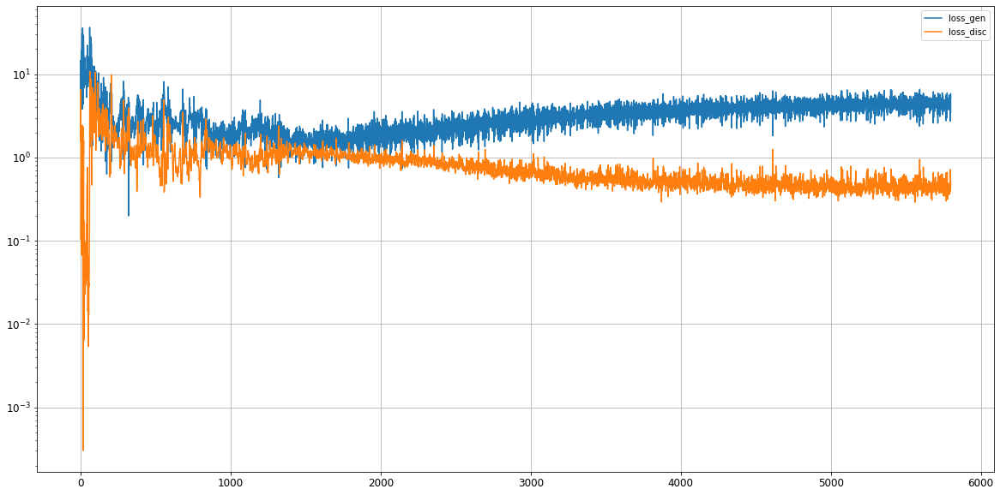

Epoch 5802/50000
0s
Epoch 5803/50000
0s
Epoch 5804/50000
0s
Epoch 5805/50000
0s
Epoch 5806/50000
0s
Epoch 5807/50000
0s
Epoch 5808/50000
0s
Epoch 5809/50000
0s
Epoch 5810/50000
0s
Epoch 5811/50000
0s
Epoch 5812/50000
0s
Epoch 5813/50000
0s
Epoch 5814/50000
0s
Epoch 5815/50000
0s
Epoch 5816/50000
0s
Epoch 5817/50000
0s
Epoch 5818/50000
0s
Epoch 5819/50000
0s
Epoch 5820/50000
0s
Epoch 5821/50000
0s
Epoch 5822/50000
0s
Epoch 5823/50000
0s
Epoch 5824/50000
0s
Epoch 5825/50000
0s
Epoch 5826/50000
0s
Epoch 5827/50000
0s
Epoch 5828/50000
0s
Epoch 5829/50000
0s
Epoch 5830/50000
0s
Epoch 5831/50000
0s
Epoch 5832/50000
0s
Epoch 5833/50000
0s
Epoch 5834/50000
0s
Epoch 5835/50000
0s
Epoch 5836/50000
0s
Epoch 5837/50000
0s
Epoch 5838/50000
0s
Epoch 5839/50000
0s
Epoch 5840/50000
0s
Epoch 5841/50000
0s
Epoch 5842/50000
0s
Epoch 5843/50000
0s
Epoch 5844/50000
0s
Epoch 5845/50000
0s
Epoch 5846/50000
0s
Epoch 5847/50000
0s
Epoch 5848/50000
0s
Epoch 5849/50000
0s
Epoch 5850/50000
0s
Epoch 5851/50000
0s


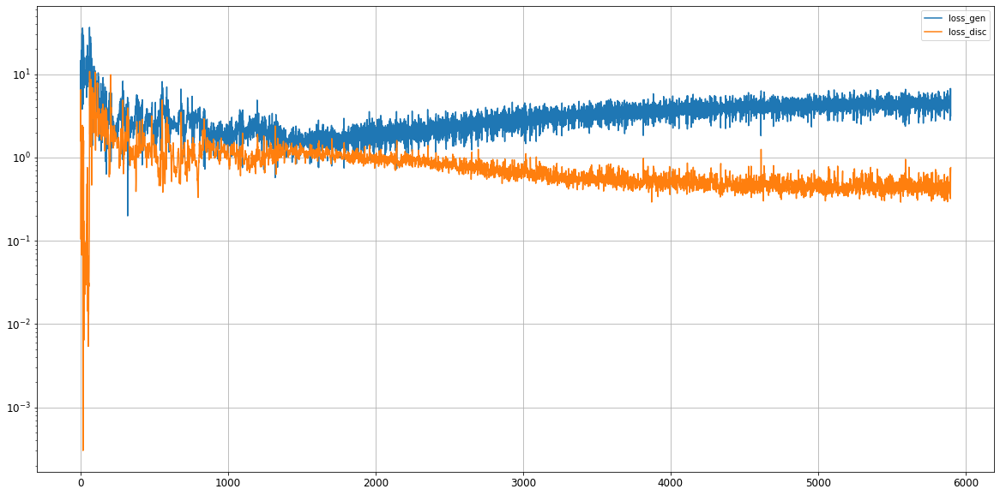

Epoch 5902/50000
0s
Epoch 5903/50000
0s
Epoch 5904/50000
0s
Epoch 5905/50000
0s
Epoch 5906/50000
0s
Epoch 5907/50000
0s
Epoch 5908/50000
0s
Epoch 5909/50000
0s
Epoch 5910/50000
0s
Epoch 5911/50000
0s
Epoch 5912/50000
0s
Epoch 5913/50000
0s
Epoch 5914/50000
0s
Epoch 5915/50000
0s
Epoch 5916/50000
0s
Epoch 5917/50000
0s
Epoch 5918/50000
0s
Epoch 5919/50000
0s
Epoch 5920/50000
0s
Epoch 5921/50000
0s
Epoch 5922/50000
0s
Epoch 5923/50000
0s
Epoch 5924/50000
0s
Epoch 5925/50000
0s
Epoch 5926/50000
0s
Epoch 5927/50000
0s
Epoch 5928/50000
0s
Epoch 5929/50000
0s
Epoch 5930/50000
0s
Epoch 5931/50000
0s
Epoch 5932/50000
0s
Epoch 5933/50000
0s
Epoch 5934/50000
0s
Epoch 5935/50000
0s
Epoch 5936/50000
0s
Epoch 5937/50000
0s
Epoch 5938/50000
0s
Epoch 5939/50000
0s
Epoch 5940/50000
0s
Epoch 5941/50000
0s
Epoch 5942/50000
0s
Epoch 5943/50000
0s
Epoch 5944/50000
0s
Epoch 5945/50000
0s
Epoch 5946/50000
0s
Epoch 5947/50000
0s
Epoch 5948/50000
0s
Epoch 5949/50000
0s
Epoch 5950/50000
0s
Epoch 5951/50000
0s


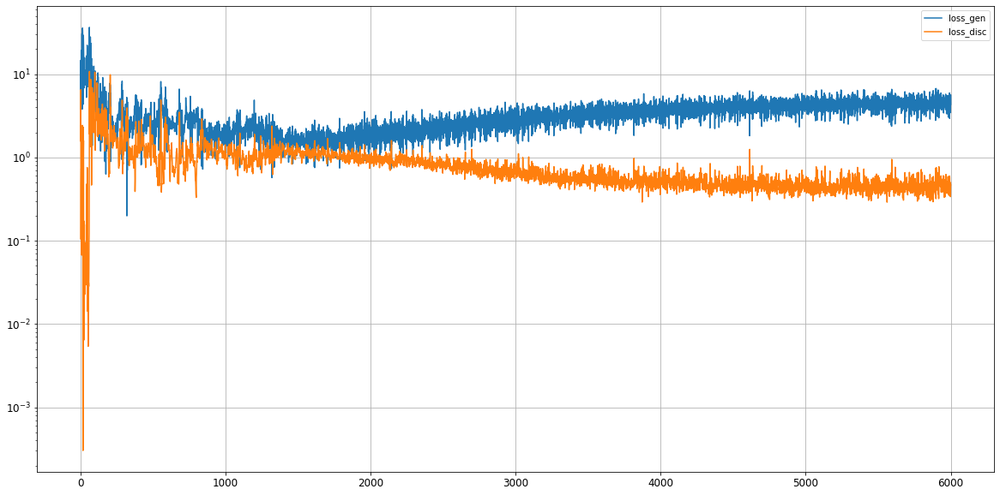

Epoch 6002/50000
0s
Epoch 6003/50000
0s
Epoch 6004/50000
0s
Epoch 6005/50000
0s
Epoch 6006/50000
0s
Epoch 6007/50000
0s
Epoch 6008/50000
0s
Epoch 6009/50000
0s
Epoch 6010/50000
0s
Epoch 6011/50000
0s
Epoch 6012/50000
0s
Epoch 6013/50000
0s
Epoch 6014/50000
0s
Epoch 6015/50000
0s
Epoch 6016/50000
0s
Epoch 6017/50000
0s
Epoch 6018/50000
0s
Epoch 6019/50000
0s
Epoch 6020/50000
0s
Epoch 6021/50000
0s
Epoch 6022/50000
0s
Epoch 6023/50000
0s
Epoch 6024/50000
0s
Epoch 6025/50000
0s
Epoch 6026/50000
0s
Epoch 6027/50000
0s
Epoch 6028/50000
0s
Epoch 6029/50000
0s
Epoch 6030/50000
0s
Epoch 6031/50000
0s
Epoch 6032/50000
0s
Epoch 6033/50000
0s
Epoch 6034/50000
0s
Epoch 6035/50000
0s
Epoch 6036/50000
0s
Epoch 6037/50000
0s
Epoch 6038/50000
0s
Epoch 6039/50000
0s
Epoch 6040/50000
0s
Epoch 6041/50000
0s
Epoch 6042/50000
0s
Epoch 6043/50000
0s
Epoch 6044/50000
0s
Epoch 6045/50000
0s
Epoch 6046/50000
0s
Epoch 6047/50000
0s
Epoch 6048/50000
0s
Epoch 6049/50000
0s
Epoch 6050/50000
0s
Epoch 6051/50000
0s


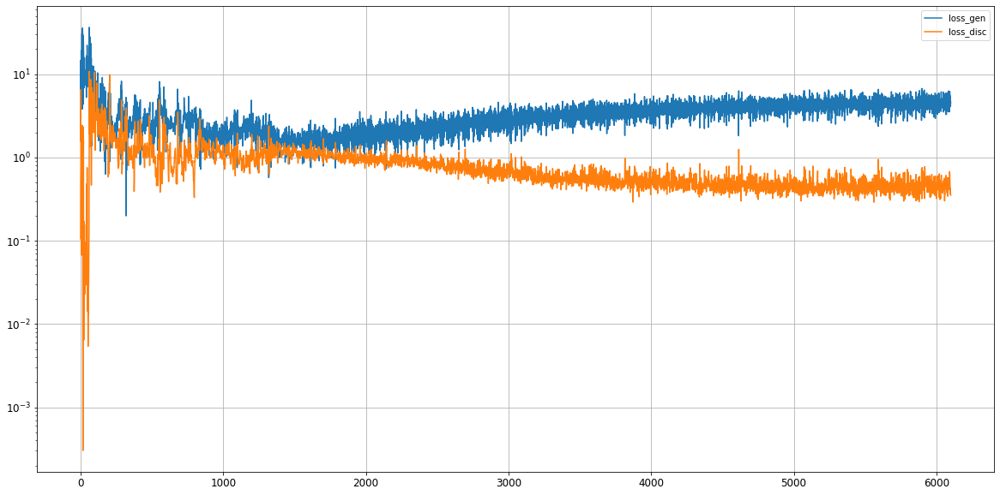

Epoch 6102/50000
0s
Epoch 6103/50000
0s
Epoch 6104/50000
0s
Epoch 6105/50000
0s
Epoch 6106/50000
0s
Epoch 6107/50000
0s
Epoch 6108/50000
0s
Epoch 6109/50000
0s
Epoch 6110/50000
0s
Epoch 6111/50000
0s
Epoch 6112/50000
0s
Epoch 6113/50000
0s
Epoch 6114/50000
0s
Epoch 6115/50000
0s
Epoch 6116/50000
0s
Epoch 6117/50000
0s
Epoch 6118/50000
0s
Epoch 6119/50000
0s
Epoch 6120/50000
0s
Epoch 6121/50000
0s
Epoch 6122/50000
0s
Epoch 6123/50000
0s
Epoch 6124/50000
0s
Epoch 6125/50000
0s
Epoch 6126/50000
0s
Epoch 6127/50000
0s
Epoch 6128/50000
0s
Epoch 6129/50000
0s
Epoch 6130/50000
0s
Epoch 6131/50000
0s
Epoch 6132/50000
0s
Epoch 6133/50000
0s
Epoch 6134/50000
0s
Epoch 6135/50000
0s
Epoch 6136/50000
0s
Epoch 6137/50000
0s
Epoch 6138/50000
0s
Epoch 6139/50000
0s
Epoch 6140/50000
0s
Epoch 6141/50000
0s
Epoch 6142/50000
0s
Epoch 6143/50000
0s
Epoch 6144/50000
0s
Epoch 6145/50000
0s
Epoch 6146/50000
0s
Epoch 6147/50000
0s
Epoch 6148/50000
0s
Epoch 6149/50000
0s
Epoch 6150/50000
0s
Epoch 6151/50000
0s


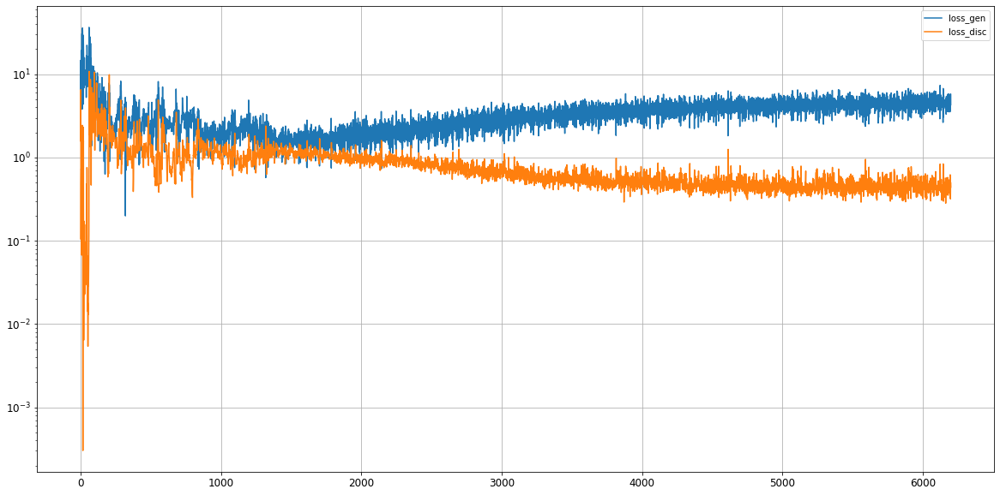

Epoch 6202/50000
0s
Epoch 6203/50000
0s
Epoch 6204/50000
0s
Epoch 6205/50000
0s
Epoch 6206/50000
0s
Epoch 6207/50000
0s
Epoch 6208/50000
0s
Epoch 6209/50000
0s
Epoch 6210/50000
0s
Epoch 6211/50000
0s
Epoch 6212/50000
0s
Epoch 6213/50000
0s
Epoch 6214/50000
0s
Epoch 6215/50000
0s
Epoch 6216/50000
0s
Epoch 6217/50000
0s
Epoch 6218/50000
0s
Epoch 6219/50000
0s
Epoch 6220/50000
0s
Epoch 6221/50000
0s
Epoch 6222/50000
0s
Epoch 6223/50000
0s
Epoch 6224/50000
0s
Epoch 6225/50000
0s
Epoch 6226/50000
0s
Epoch 6227/50000
0s
Epoch 6228/50000
0s
Epoch 6229/50000
0s
Epoch 6230/50000
0s
Epoch 6231/50000
0s
Epoch 6232/50000
0s
Epoch 6233/50000
0s
Epoch 6234/50000
0s
Epoch 6235/50000
0s
Epoch 6236/50000
0s
Epoch 6237/50000
0s
Epoch 6238/50000
0s
Epoch 6239/50000
0s
Epoch 6240/50000
0s
Epoch 6241/50000
0s
Epoch 6242/50000
0s
Epoch 6243/50000
0s
Epoch 6244/50000
0s
Epoch 6245/50000
0s
Epoch 6246/50000
0s
Epoch 6247/50000
0s
Epoch 6248/50000
0s
Epoch 6249/50000
0s
Epoch 6250/50000
0s
Epoch 6251/50000
0s


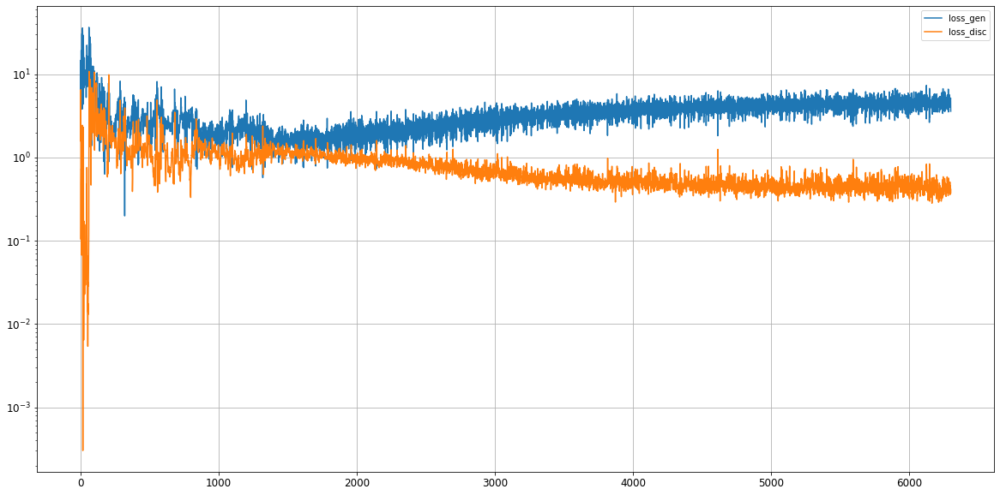

Epoch 6302/50000
0s
Epoch 6303/50000
0s
Epoch 6304/50000
0s
Epoch 6305/50000
0s
Epoch 6306/50000
0s
Epoch 6307/50000
0s
Epoch 6308/50000
0s
Epoch 6309/50000
0s
Epoch 6310/50000
0s
Epoch 6311/50000
0s
Epoch 6312/50000
0s
Epoch 6313/50000
0s
Epoch 6314/50000
0s
Epoch 6315/50000
0s
Epoch 6316/50000
0s
Epoch 6317/50000
0s
Epoch 6318/50000
0s
Epoch 6319/50000
0s
Epoch 6320/50000
0s
Epoch 6321/50000
0s
Epoch 6322/50000
0s
Epoch 6323/50000
0s
Epoch 6324/50000
0s
Epoch 6325/50000
0s
Epoch 6326/50000
0s
Epoch 6327/50000
0s
Epoch 6328/50000
0s
Epoch 6329/50000
0s
Epoch 6330/50000
0s
Epoch 6331/50000
0s
Epoch 6332/50000
0s
Epoch 6333/50000
0s
Epoch 6334/50000
0s
Epoch 6335/50000
0s
Epoch 6336/50000
0s
Epoch 6337/50000
0s
Epoch 6338/50000
0s
Epoch 6339/50000
0s
Epoch 6340/50000
0s
Epoch 6341/50000
0s
Epoch 6342/50000
0s
Epoch 6343/50000
0s
Epoch 6344/50000
0s
Epoch 6345/50000
0s
Epoch 6346/50000
0s
Epoch 6347/50000
0s
Epoch 6348/50000
0s
Epoch 6349/50000
0s
Epoch 6350/50000
0s
Epoch 6351/50000
0s


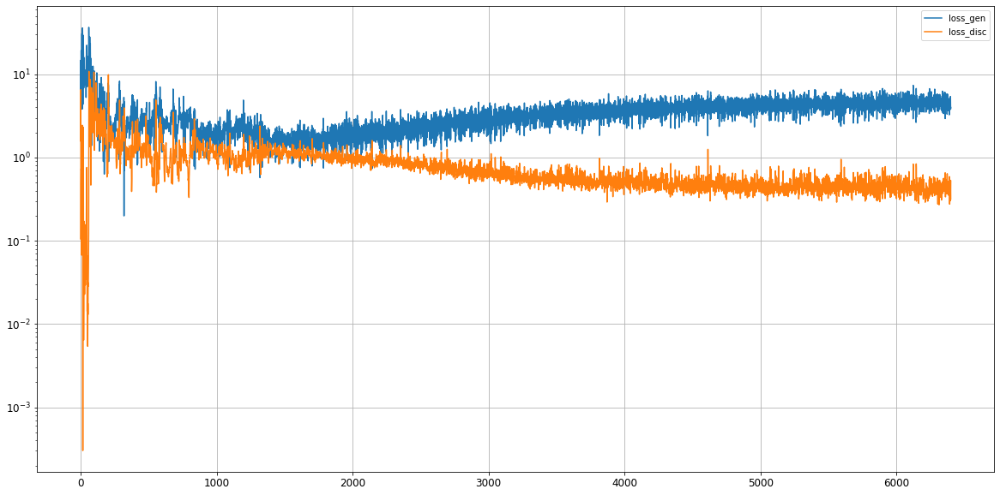

Epoch 6402/50000
0s
Epoch 6403/50000
0s
Epoch 6404/50000
0s
Epoch 6405/50000
0s
Epoch 6406/50000
0s
Epoch 6407/50000
0s
Epoch 6408/50000
0s
Epoch 6409/50000
0s
Epoch 6410/50000
0s
Epoch 6411/50000
0s
Epoch 6412/50000
0s
Epoch 6413/50000
0s
Epoch 6414/50000
0s
Epoch 6415/50000
0s
Epoch 6416/50000
0s
Epoch 6417/50000
0s
Epoch 6418/50000
0s
Epoch 6419/50000
0s
Epoch 6420/50000
0s
Epoch 6421/50000
0s
Epoch 6422/50000
0s
Epoch 6423/50000
0s
Epoch 6424/50000
0s
Epoch 6425/50000
0s
Epoch 6426/50000
0s
Epoch 6427/50000
0s
Epoch 6428/50000
0s
Epoch 6429/50000
0s
Epoch 6430/50000
0s
Epoch 6431/50000
0s
Epoch 6432/50000
0s
Epoch 6433/50000
0s
Epoch 6434/50000
0s
Epoch 6435/50000
0s
Epoch 6436/50000
0s
Epoch 6437/50000
0s
Epoch 6438/50000
0s
Epoch 6439/50000
0s
Epoch 6440/50000
0s
Epoch 6441/50000
0s
Epoch 6442/50000
0s
Epoch 6443/50000
0s
Epoch 6444/50000
0s
Epoch 6445/50000
0s
Epoch 6446/50000
0s
Epoch 6447/50000
0s
Epoch 6448/50000
0s
Epoch 6449/50000
0s
Epoch 6450/50000
0s
Epoch 6451/50000
0s


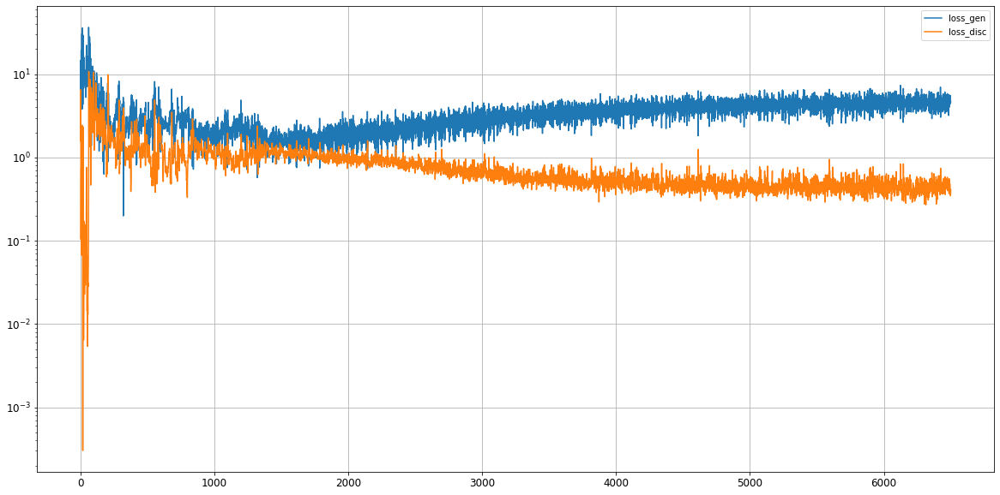

Epoch 6502/50000
0s
Epoch 6503/50000
0s
Epoch 6504/50000
0s
Epoch 6505/50000
0s
Epoch 6506/50000
0s
Epoch 6507/50000
0s
Epoch 6508/50000
0s
Epoch 6509/50000
0s
Epoch 6510/50000
0s
Epoch 6511/50000
0s
Epoch 6512/50000
0s
Epoch 6513/50000
0s
Epoch 6514/50000
0s
Epoch 6515/50000
0s
Epoch 6516/50000
0s
Epoch 6517/50000
0s
Epoch 6518/50000
0s
Epoch 6519/50000
0s
Epoch 6520/50000
0s
Epoch 6521/50000
0s
Epoch 6522/50000
0s
Epoch 6523/50000
0s
Epoch 6524/50000
0s
Epoch 6525/50000
0s
Epoch 6526/50000
0s
Epoch 6527/50000
0s
Epoch 6528/50000
0s
Epoch 6529/50000
0s
Epoch 6530/50000
0s
Epoch 6531/50000
0s
Epoch 6532/50000
0s
Epoch 6533/50000
0s
Epoch 6534/50000
0s
Epoch 6535/50000
0s
Epoch 6536/50000
0s
Epoch 6537/50000
0s
Epoch 6538/50000
0s
Epoch 6539/50000
0s
Epoch 6540/50000
0s
Epoch 6541/50000
0s
Epoch 6542/50000
0s
Epoch 6543/50000
0s
Epoch 6544/50000
0s
Epoch 6545/50000
0s
Epoch 6546/50000
0s
Epoch 6547/50000
0s
Epoch 6548/50000
0s
Epoch 6549/50000
0s
Epoch 6550/50000
0s
Epoch 6551/50000
0s


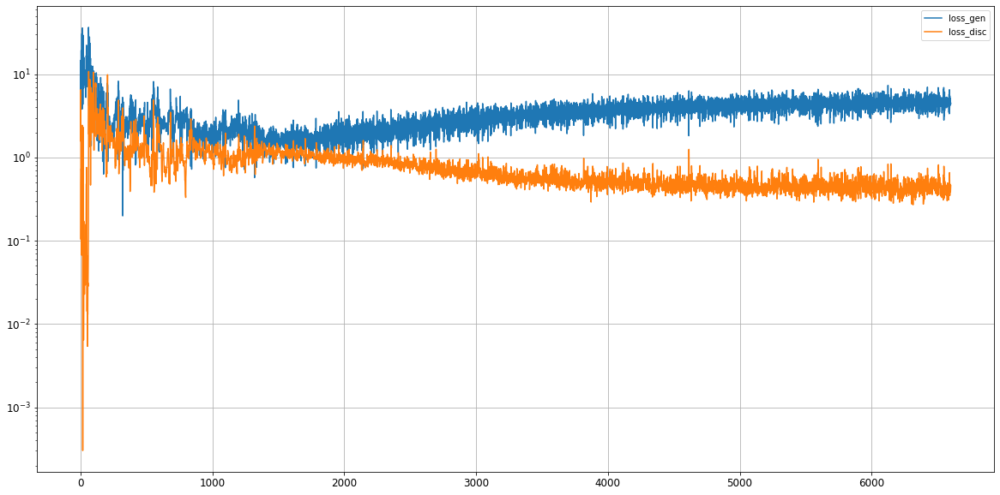

Epoch 6602/50000
0s
Epoch 6603/50000
0s
Epoch 6604/50000
0s
Epoch 6605/50000
0s
Epoch 6606/50000
0s
Epoch 6607/50000
0s
Epoch 6608/50000
0s
Epoch 6609/50000
0s
Epoch 6610/50000
0s
Epoch 6611/50000
0s
Epoch 6612/50000
0s
Epoch 6613/50000
0s
Epoch 6614/50000
0s
Epoch 6615/50000
0s
Epoch 6616/50000
0s
Epoch 6617/50000
0s
Epoch 6618/50000
0s
Epoch 6619/50000
0s
Epoch 6620/50000
0s
Epoch 6621/50000
0s
Epoch 6622/50000
0s
Epoch 6623/50000
0s
Epoch 6624/50000
0s
Epoch 6625/50000
0s
Epoch 6626/50000
0s
Epoch 6627/50000
0s
Epoch 6628/50000
0s
Epoch 6629/50000
0s
Epoch 6630/50000
0s
Epoch 6631/50000
0s
Epoch 6632/50000
0s
Epoch 6633/50000
0s
Epoch 6634/50000
0s
Epoch 6635/50000
0s
Epoch 6636/50000
0s
Epoch 6637/50000
0s
Epoch 6638/50000
0s
Epoch 6639/50000
0s
Epoch 6640/50000
0s
Epoch 6641/50000
0s
Epoch 6642/50000
0s
Epoch 6643/50000
0s
Epoch 6644/50000
0s
Epoch 6645/50000
0s
Epoch 6646/50000
0s
Epoch 6647/50000
0s
Epoch 6648/50000
0s
Epoch 6649/50000
0s
Epoch 6650/50000
0s
Epoch 6651/50000
0s


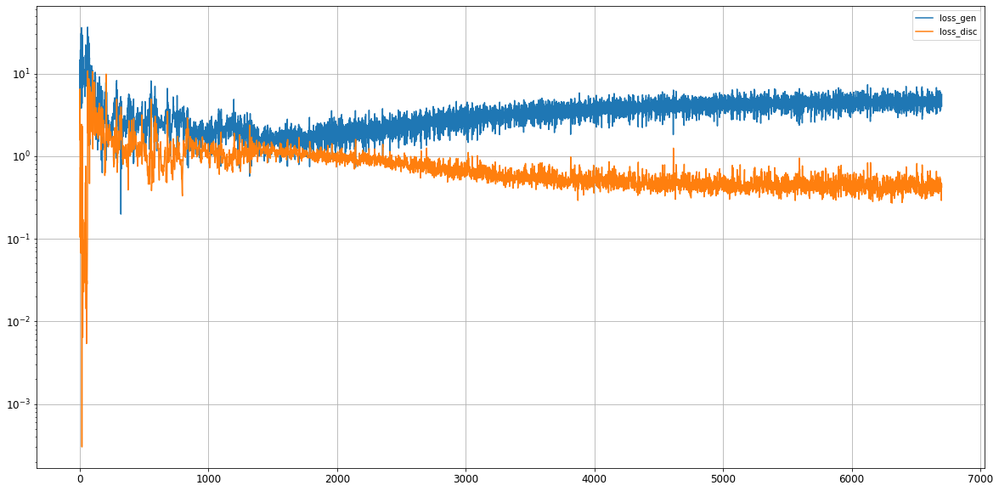

Epoch 6702/50000
0s
Epoch 6703/50000
0s
Epoch 6704/50000
0s
Epoch 6705/50000
0s
Epoch 6706/50000
0s
Epoch 6707/50000
0s
Epoch 6708/50000
0s
Epoch 6709/50000
0s
Epoch 6710/50000
0s
Epoch 6711/50000
0s
Epoch 6712/50000
0s
Epoch 6713/50000
0s
Epoch 6714/50000
0s
Epoch 6715/50000
0s
Epoch 6716/50000
0s
Epoch 6717/50000
0s
Epoch 6718/50000
0s
Epoch 6719/50000
0s
Epoch 6720/50000
0s
Epoch 6721/50000
0s
Epoch 6722/50000
0s
Epoch 6723/50000
0s
Epoch 6724/50000
0s
Epoch 6725/50000
0s
Epoch 6726/50000
0s
Epoch 6727/50000
0s
Epoch 6728/50000
0s
Epoch 6729/50000
0s
Epoch 6730/50000
0s
Epoch 6731/50000
0s
Epoch 6732/50000
0s
Epoch 6733/50000
0s
Epoch 6734/50000
0s
Epoch 6735/50000
0s
Epoch 6736/50000
0s
Epoch 6737/50000
0s
Epoch 6738/50000
0s
Epoch 6739/50000
0s
Epoch 6740/50000
0s
Epoch 6741/50000
0s
Epoch 6742/50000
0s
Epoch 6743/50000
0s
Epoch 6744/50000
0s
Epoch 6745/50000
0s
Epoch 6746/50000
0s
Epoch 6747/50000
0s
Epoch 6748/50000
0s
Epoch 6749/50000
0s
Epoch 6750/50000
0s
Epoch 6751/50000
0s


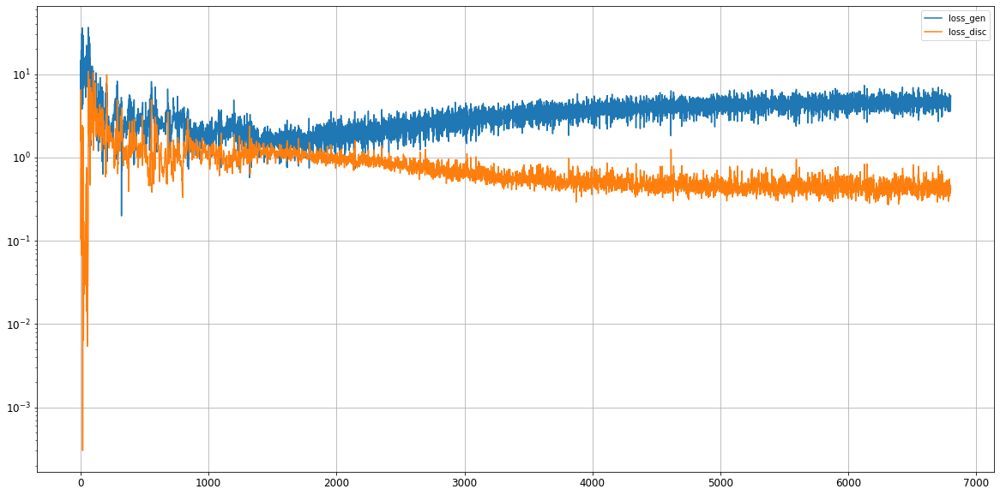

Epoch 6802/50000
0s
Epoch 6803/50000
0s
Epoch 6804/50000
0s
Epoch 6805/50000
0s
Epoch 6806/50000
0s
Epoch 6807/50000
0s
Epoch 6808/50000
0s
Epoch 6809/50000
0s
Epoch 6810/50000
0s
Epoch 6811/50000
0s
Epoch 6812/50000
0s
Epoch 6813/50000
0s
Epoch 6814/50000
0s
Epoch 6815/50000
0s
Epoch 6816/50000
0s
Epoch 6817/50000
0s
Epoch 6818/50000
0s
Epoch 6819/50000
0s
Epoch 6820/50000
0s
Epoch 6821/50000
0s
Epoch 6822/50000
0s
Epoch 6823/50000
0s
Epoch 6824/50000
0s
Epoch 6825/50000
0s
Epoch 6826/50000
0s
Epoch 6827/50000
0s
Epoch 6828/50000
0s
Epoch 6829/50000
0s
Epoch 6830/50000
0s
Epoch 6831/50000
0s
Epoch 6832/50000
0s
Epoch 6833/50000
0s
Epoch 6834/50000
0s
Epoch 6835/50000
0s
Epoch 6836/50000
0s
Epoch 6837/50000
0s
Epoch 6838/50000
0s
Epoch 6839/50000
0s
Epoch 6840/50000
0s
Epoch 6841/50000
0s
Epoch 6842/50000
0s
Epoch 6843/50000
0s
Epoch 6844/50000
0s
Epoch 6845/50000
0s
Epoch 6846/50000
0s
Epoch 6847/50000
0s
Epoch 6848/50000
0s
Epoch 6849/50000
0s
Epoch 6850/50000
0s
Epoch 6851/50000
0s


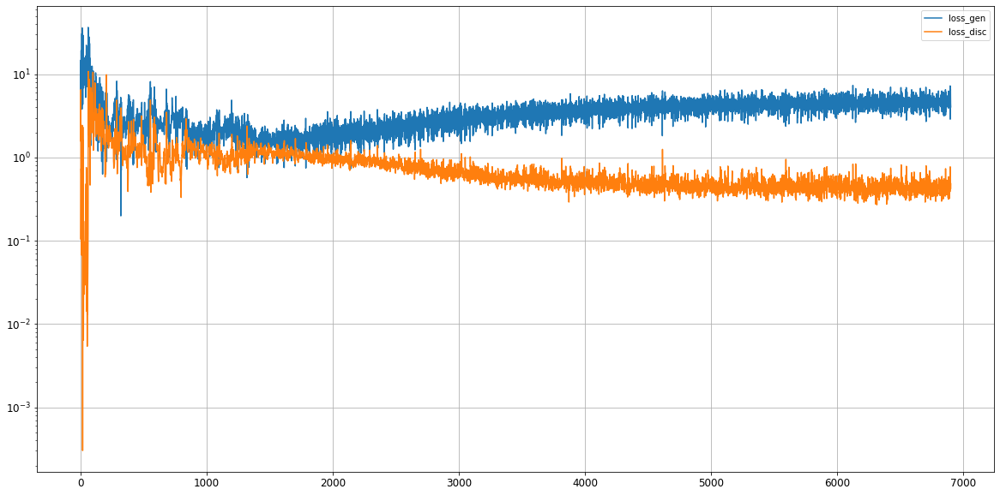

Epoch 6902/50000
0s
Epoch 6903/50000
0s
Epoch 6904/50000
0s
Epoch 6905/50000
0s
Epoch 6906/50000
0s
Epoch 6907/50000
0s
Epoch 6908/50000
0s
Epoch 6909/50000
0s
Epoch 6910/50000
0s
Epoch 6911/50000
0s
Epoch 6912/50000
0s
Epoch 6913/50000
0s
Epoch 6914/50000
0s
Epoch 6915/50000
0s
Epoch 6916/50000
0s
Epoch 6917/50000
0s
Epoch 6918/50000
0s
Epoch 6919/50000
0s
Epoch 6920/50000
0s
Epoch 6921/50000
0s
Epoch 6922/50000
0s
Epoch 6923/50000
0s
Epoch 6924/50000
0s
Epoch 6925/50000
0s
Epoch 6926/50000
0s
Epoch 6927/50000
0s
Epoch 6928/50000
0s
Epoch 6929/50000
0s
Epoch 6930/50000
0s
Epoch 6931/50000
0s
Epoch 6932/50000
0s
Epoch 6933/50000
0s
Epoch 6934/50000
0s
Epoch 6935/50000
0s
Epoch 6936/50000
0s
Epoch 6937/50000
0s
Epoch 6938/50000
0s
Epoch 6939/50000
0s
Epoch 6940/50000
0s
Epoch 6941/50000
0s
Epoch 6942/50000
0s
Epoch 6943/50000
0s
Epoch 6944/50000
0s
Epoch 6945/50000
0s
Epoch 6946/50000
0s
Epoch 6947/50000
0s
Epoch 6948/50000
0s
Epoch 6949/50000
0s
Epoch 6950/50000
0s
Epoch 6951/50000
0s


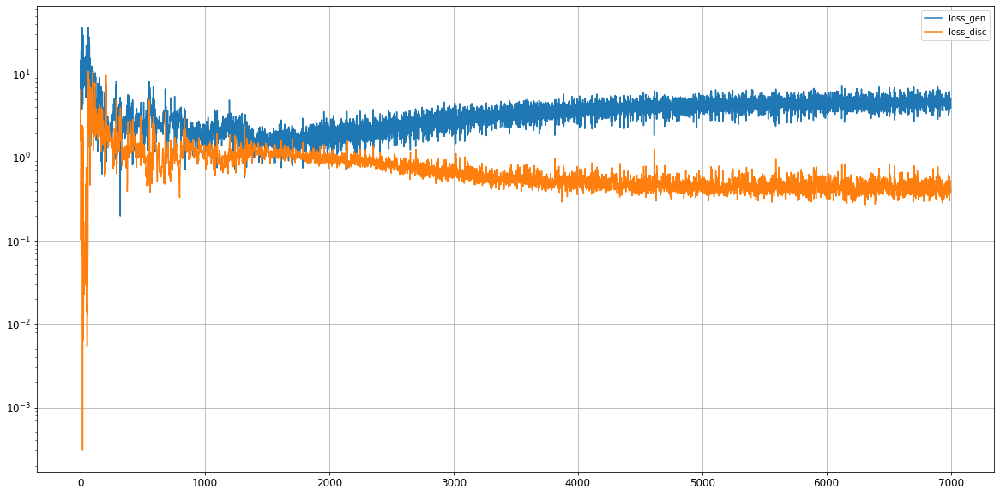

Epoch 7002/50000
0s
Epoch 7003/50000
0s
Epoch 7004/50000
0s
Epoch 7005/50000
0s
Epoch 7006/50000
0s
Epoch 7007/50000
0s
Epoch 7008/50000
0s
Epoch 7009/50000
0s
Epoch 7010/50000
0s
Epoch 7011/50000
0s
Epoch 7012/50000
0s
Epoch 7013/50000
0s
Epoch 7014/50000
0s
Epoch 7015/50000
0s
Epoch 7016/50000
0s
Epoch 7017/50000
0s
Epoch 7018/50000
0s
Epoch 7019/50000
0s
Epoch 7020/50000
0s
Epoch 7021/50000
0s
Epoch 7022/50000
0s
Epoch 7023/50000
0s
Epoch 7024/50000
0s
Epoch 7025/50000
0s
Epoch 7026/50000
0s
Epoch 7027/50000
0s
Epoch 7028/50000
0s
Epoch 7029/50000
0s
Epoch 7030/50000
0s
Epoch 7031/50000
0s
Epoch 7032/50000
0s
Epoch 7033/50000
0s
Epoch 7034/50000
0s
Epoch 7035/50000
0s
Epoch 7036/50000
0s
Epoch 7037/50000
0s
Epoch 7038/50000
0s
Epoch 7039/50000
0s
Epoch 7040/50000
0s
Epoch 7041/50000
0s
Epoch 7042/50000
0s
Epoch 7043/50000
0s
Epoch 7044/50000
0s
Epoch 7045/50000
0s
Epoch 7046/50000
0s
Epoch 7047/50000
0s
Epoch 7048/50000
0s
Epoch 7049/50000
0s
Epoch 7050/50000
0s
Epoch 7051/50000
0s


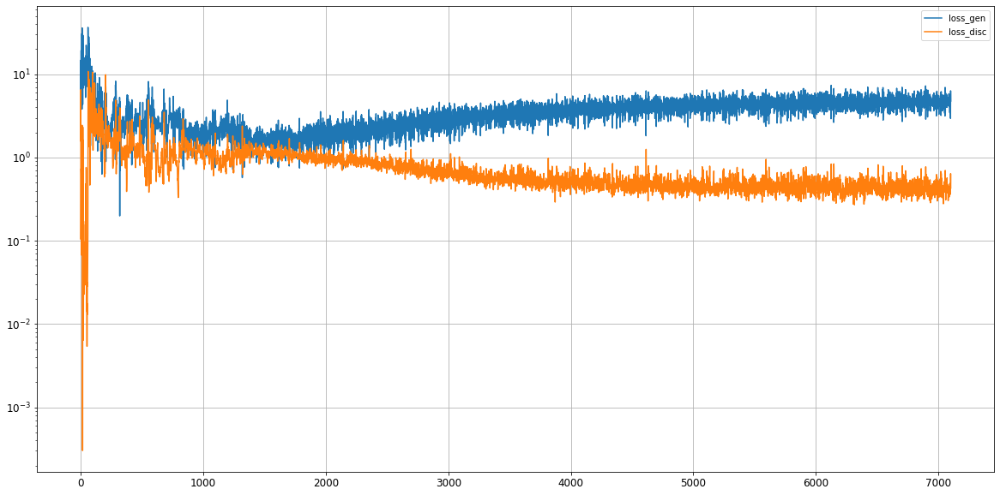

Epoch 7102/50000
0s
Epoch 7103/50000
0s
Epoch 7104/50000
0s
Epoch 7105/50000
0s
Epoch 7106/50000
0s
Epoch 7107/50000
0s
Epoch 7108/50000
0s
Epoch 7109/50000
0s
Epoch 7110/50000
0s
Epoch 7111/50000
0s
Epoch 7112/50000
0s
Epoch 7113/50000
0s
Epoch 7114/50000
0s
Epoch 7115/50000
0s
Epoch 7116/50000
0s
Epoch 7117/50000
0s
Epoch 7118/50000
0s
Epoch 7119/50000
0s
Epoch 7120/50000
0s
Epoch 7121/50000
0s
Epoch 7122/50000
0s
Epoch 7123/50000
0s
Epoch 7124/50000
0s
Epoch 7125/50000
0s
Epoch 7126/50000
0s
Epoch 7127/50000
0s
Epoch 7128/50000
0s
Epoch 7129/50000
0s
Epoch 7130/50000
0s
Epoch 7131/50000
0s
Epoch 7132/50000
0s
Epoch 7133/50000
0s
Epoch 7134/50000
0s
Epoch 7135/50000
0s
Epoch 7136/50000
0s
Epoch 7137/50000
0s
Epoch 7138/50000
0s
Epoch 7139/50000
0s
Epoch 7140/50000
0s
Epoch 7141/50000
0s
Epoch 7142/50000
0s
Epoch 7143/50000
0s
Epoch 7144/50000
0s
Epoch 7145/50000
0s
Epoch 7146/50000
0s
Epoch 7147/50000
0s
Epoch 7148/50000
0s
Epoch 7149/50000
0s
Epoch 7150/50000
0s
Epoch 7151/50000
0s


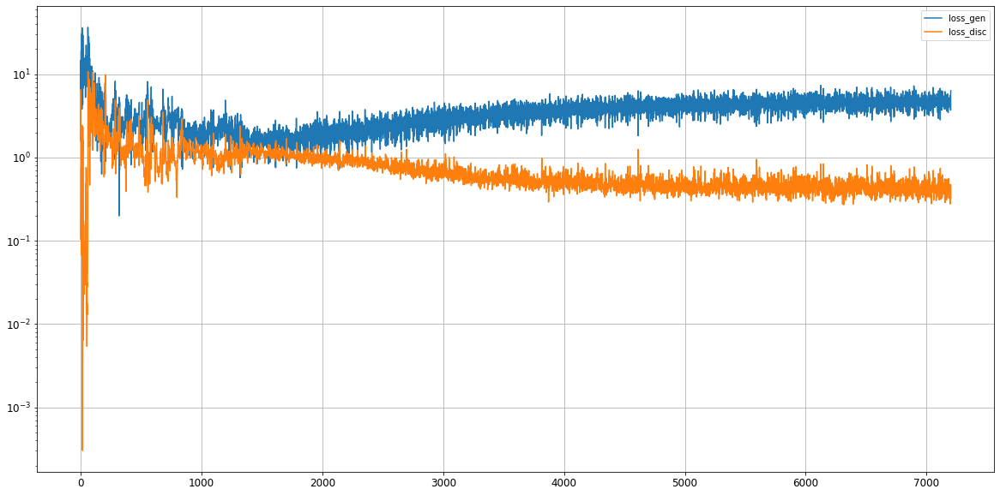

Epoch 7202/50000
0s
Epoch 7203/50000
0s
Epoch 7204/50000
0s
Epoch 7205/50000
0s
Epoch 7206/50000
0s
Epoch 7207/50000
0s
Epoch 7208/50000
0s
Epoch 7209/50000
0s
Epoch 7210/50000
0s
Epoch 7211/50000
0s
Epoch 7212/50000
0s
Epoch 7213/50000
0s
Epoch 7214/50000
0s
Epoch 7215/50000
0s
Epoch 7216/50000
0s
Epoch 7217/50000
0s
Epoch 7218/50000
0s
Epoch 7219/50000
0s
Epoch 7220/50000
0s
Epoch 7221/50000
0s
Epoch 7222/50000
0s
Epoch 7223/50000
0s
Epoch 7224/50000
0s
Epoch 7225/50000
0s
Epoch 7226/50000
0s
Epoch 7227/50000
0s
Epoch 7228/50000
0s
Epoch 7229/50000
0s
Epoch 7230/50000
0s
Epoch 7231/50000
0s
Epoch 7232/50000
0s
Epoch 7233/50000
0s
Epoch 7234/50000
0s
Epoch 7235/50000
0s
Epoch 7236/50000
0s
Epoch 7237/50000
0s
Epoch 7238/50000
0s
Epoch 7239/50000
0s
Epoch 7240/50000
0s
Epoch 7241/50000
0s
Epoch 7242/50000
0s
Epoch 7243/50000
0s
Epoch 7244/50000
0s
Epoch 7245/50000
0s
Epoch 7246/50000
0s
Epoch 7247/50000
0s
Epoch 7248/50000
0s
Epoch 7249/50000
0s
Epoch 7250/50000
0s
Epoch 7251/50000
0s


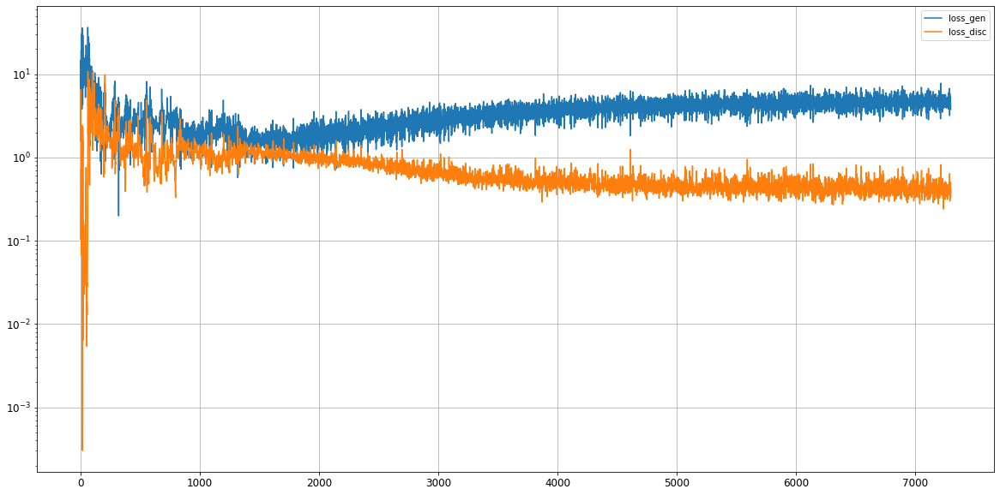

Epoch 7302/50000
0s
Epoch 7303/50000
0s
Epoch 7304/50000
0s
Epoch 7305/50000
0s
Epoch 7306/50000
0s
Epoch 7307/50000
0s
Epoch 7308/50000
0s
Epoch 7309/50000
0s
Epoch 7310/50000
0s
Epoch 7311/50000
0s
Epoch 7312/50000
0s
Epoch 7313/50000
0s
Epoch 7314/50000
0s
Epoch 7315/50000
0s
Epoch 7316/50000
0s
Epoch 7317/50000
0s
Epoch 7318/50000
0s
Epoch 7319/50000
0s
Epoch 7320/50000
0s
Epoch 7321/50000
0s
Epoch 7322/50000
0s
Epoch 7323/50000
0s
Epoch 7324/50000
0s
Epoch 7325/50000
0s
Epoch 7326/50000
0s
Epoch 7327/50000
0s
Epoch 7328/50000
0s
Epoch 7329/50000
0s
Epoch 7330/50000
0s
Epoch 7331/50000
0s
Epoch 7332/50000
0s
Epoch 7333/50000
0s
Epoch 7334/50000
0s
Epoch 7335/50000
0s
Epoch 7336/50000
0s
Epoch 7337/50000
0s
Epoch 7338/50000
0s
Epoch 7339/50000
0s
Epoch 7340/50000
0s
Epoch 7341/50000
0s
Epoch 7342/50000
0s
Epoch 7343/50000
0s
Epoch 7344/50000
0s
Epoch 7345/50000
0s
Epoch 7346/50000
0s
Epoch 7347/50000
0s
Epoch 7348/50000
0s
Epoch 7349/50000
0s
Epoch 7350/50000
0s
Epoch 7351/50000
0s


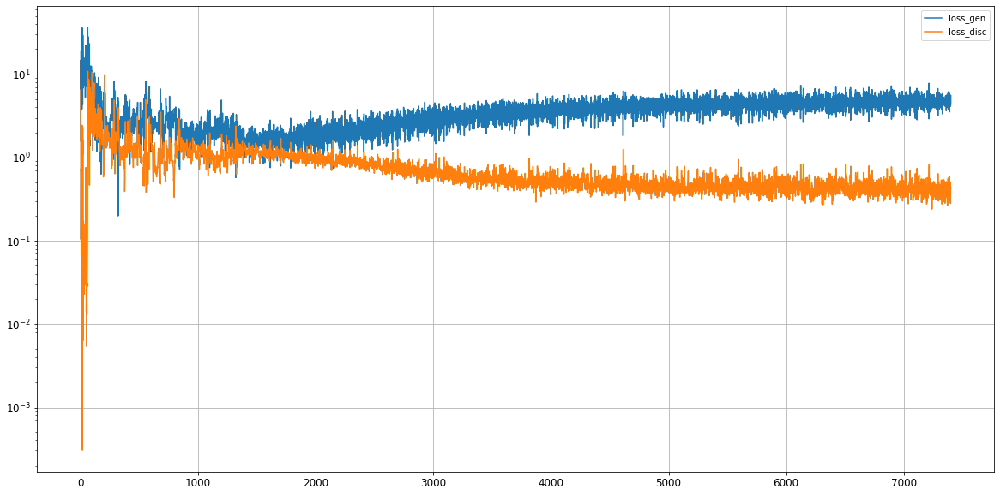

Epoch 7402/50000
0s
Epoch 7403/50000
0s
Epoch 7404/50000
0s
Epoch 7405/50000
0s
Epoch 7406/50000
0s
Epoch 7407/50000
0s
Epoch 7408/50000
0s
Epoch 7409/50000
0s
Epoch 7410/50000
0s
Epoch 7411/50000
0s
Epoch 7412/50000
0s
Epoch 7413/50000
0s
Epoch 7414/50000
0s
Epoch 7415/50000
0s
Epoch 7416/50000
0s
Epoch 7417/50000
0s
Epoch 7418/50000
0s
Epoch 7419/50000
0s
Epoch 7420/50000
0s
Epoch 7421/50000
0s
Epoch 7422/50000
0s
Epoch 7423/50000
0s
Epoch 7424/50000
0s
Epoch 7425/50000
0s
Epoch 7426/50000
0s
Epoch 7427/50000
0s
Epoch 7428/50000
0s
Epoch 7429/50000
0s
Epoch 7430/50000
0s
Epoch 7431/50000
0s
Epoch 7432/50000
0s
Epoch 7433/50000
0s
Epoch 7434/50000
0s
Epoch 7435/50000
0s
Epoch 7436/50000
0s
Epoch 7437/50000
0s
Epoch 7438/50000
0s
Epoch 7439/50000
0s
Epoch 7440/50000
0s
Epoch 7441/50000
0s
Epoch 7442/50000
0s
Epoch 7443/50000
0s
Epoch 7444/50000
0s
Epoch 7445/50000
0s
Epoch 7446/50000
0s
Epoch 7447/50000
0s
Epoch 7448/50000
0s
Epoch 7449/50000
0s
Epoch 7450/50000
0s
Epoch 7451/50000
0s


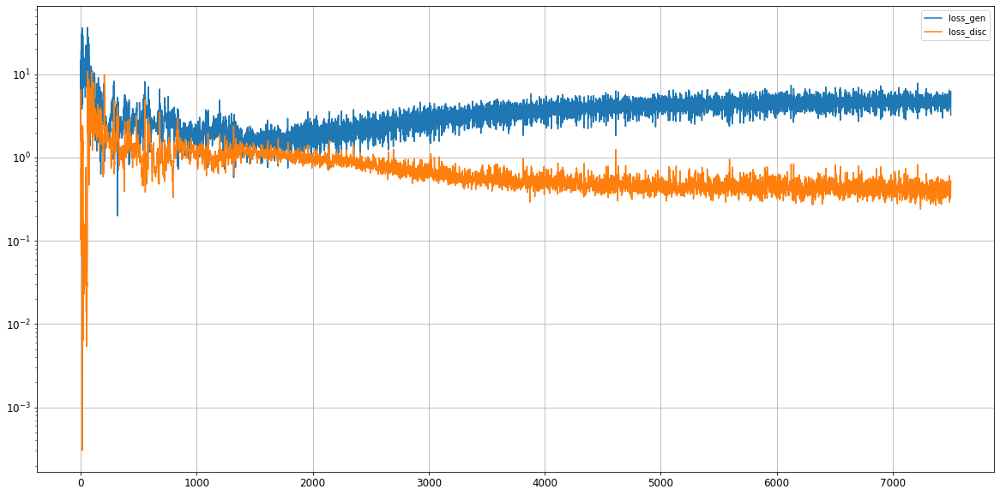

Epoch 7502/50000
0s
Epoch 7503/50000
0s
Epoch 7504/50000
0s
Epoch 7505/50000
0s
Epoch 7506/50000
0s
Epoch 7507/50000
0s
Epoch 7508/50000
0s
Epoch 7509/50000
0s
Epoch 7510/50000
0s
Epoch 7511/50000
0s
Epoch 7512/50000
0s
Epoch 7513/50000
0s
Epoch 7514/50000
0s
Epoch 7515/50000
0s
Epoch 7516/50000
0s
Epoch 7517/50000
0s
Epoch 7518/50000
0s
Epoch 7519/50000
0s
Epoch 7520/50000
0s
Epoch 7521/50000
0s
Epoch 7522/50000
0s
Epoch 7523/50000
0s
Epoch 7524/50000
0s
Epoch 7525/50000
0s
Epoch 7526/50000
0s
Epoch 7527/50000
0s
Epoch 7528/50000
0s
Epoch 7529/50000
0s
Epoch 7530/50000
0s
Epoch 7531/50000
0s
Epoch 7532/50000
0s
Epoch 7533/50000
0s
Epoch 7534/50000
0s
Epoch 7535/50000
0s
Epoch 7536/50000
0s
Epoch 7537/50000
0s
Epoch 7538/50000
0s
Epoch 7539/50000
0s
Epoch 7540/50000
0s
Epoch 7541/50000
0s
Epoch 7542/50000
0s
Epoch 7543/50000
0s
Epoch 7544/50000
0s
Epoch 7545/50000
0s
Epoch 7546/50000
0s
Epoch 7547/50000
0s
Epoch 7548/50000
0s
Epoch 7549/50000
0s
Epoch 7550/50000
0s
Epoch 7551/50000
0s


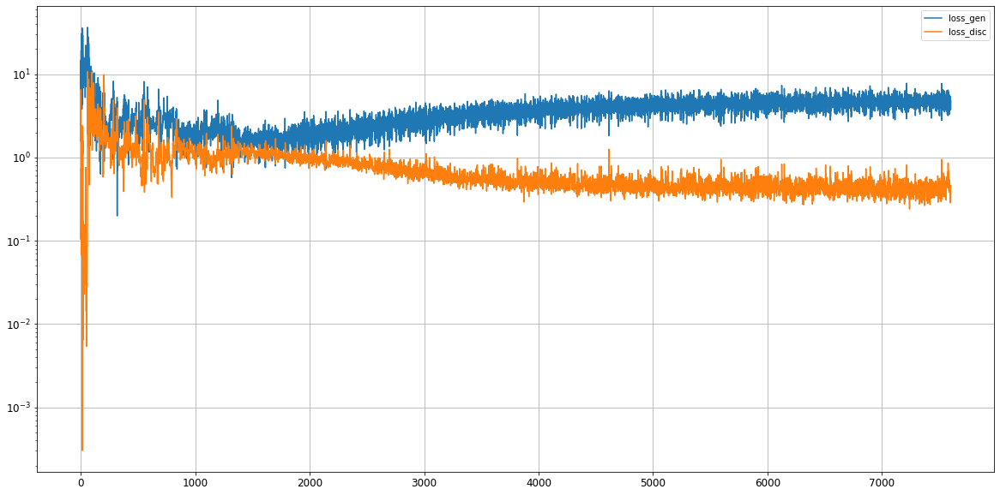

Epoch 7602/50000
0s
Epoch 7603/50000
0s
Epoch 7604/50000
0s
Epoch 7605/50000
0s
Epoch 7606/50000
0s
Epoch 7607/50000
0s
Epoch 7608/50000
0s
Epoch 7609/50000
0s
Epoch 7610/50000
0s
Epoch 7611/50000
0s
Epoch 7612/50000
0s
Epoch 7613/50000
0s
Epoch 7614/50000
0s
Epoch 7615/50000
0s
Epoch 7616/50000
0s
Epoch 7617/50000
0s
Epoch 7618/50000
0s
Epoch 7619/50000
0s
Epoch 7620/50000
0s
Epoch 7621/50000
0s
Epoch 7622/50000
0s
Epoch 7623/50000
0s
Epoch 7624/50000
0s
Epoch 7625/50000
0s
Epoch 7626/50000
0s
Epoch 7627/50000
0s
Epoch 7628/50000
0s
Epoch 7629/50000
0s
Epoch 7630/50000
0s
Epoch 7631/50000
0s
Epoch 7632/50000
0s
Epoch 7633/50000
0s
Epoch 7634/50000
0s
Epoch 7635/50000
0s
Epoch 7636/50000
0s
Epoch 7637/50000
0s
Epoch 7638/50000
0s
Epoch 7639/50000
0s
Epoch 7640/50000
0s
Epoch 7641/50000
0s
Epoch 7642/50000
0s
Epoch 7643/50000
0s
Epoch 7644/50000
0s
Epoch 7645/50000
0s
Epoch 7646/50000
0s
Epoch 7647/50000
0s
Epoch 7648/50000
0s
Epoch 7649/50000
0s
Epoch 7650/50000
0s
Epoch 7651/50000
0s


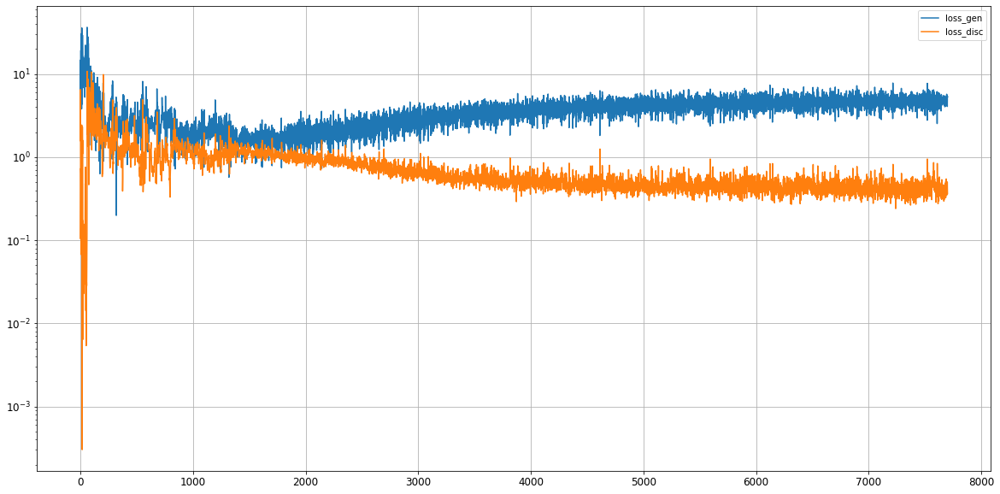

Epoch 7702/50000
0s
Epoch 7703/50000
0s
Epoch 7704/50000
0s
Epoch 7705/50000
0s
Epoch 7706/50000
0s
Epoch 7707/50000
0s
Epoch 7708/50000
0s
Epoch 7709/50000
0s
Epoch 7710/50000
0s
Epoch 7711/50000
0s
Epoch 7712/50000
0s
Epoch 7713/50000
0s
Epoch 7714/50000
0s
Epoch 7715/50000
0s
Epoch 7716/50000
0s
Epoch 7717/50000
0s
Epoch 7718/50000
0s
Epoch 7719/50000
0s
Epoch 7720/50000
0s
Epoch 7721/50000
0s
Epoch 7722/50000
0s
Epoch 7723/50000
0s
Epoch 7724/50000
0s
Epoch 7725/50000
0s
Epoch 7726/50000
0s
Epoch 7727/50000
0s
Epoch 7728/50000
0s
Epoch 7729/50000
0s
Epoch 7730/50000
0s
Epoch 7731/50000
0s
Epoch 7732/50000
0s
Epoch 7733/50000
0s
Epoch 7734/50000
0s
Epoch 7735/50000
0s
Epoch 7736/50000
0s
Epoch 7737/50000
0s
Epoch 7738/50000
0s
Epoch 7739/50000
0s
Epoch 7740/50000
0s
Epoch 7741/50000
0s
Epoch 7742/50000
0s
Epoch 7743/50000
0s
Epoch 7744/50000
0s
Epoch 7745/50000
0s
Epoch 7746/50000
0s
Epoch 7747/50000
0s
Epoch 7748/50000
0s
Epoch 7749/50000
0s
Epoch 7750/50000
0s
Epoch 7751/50000
0s


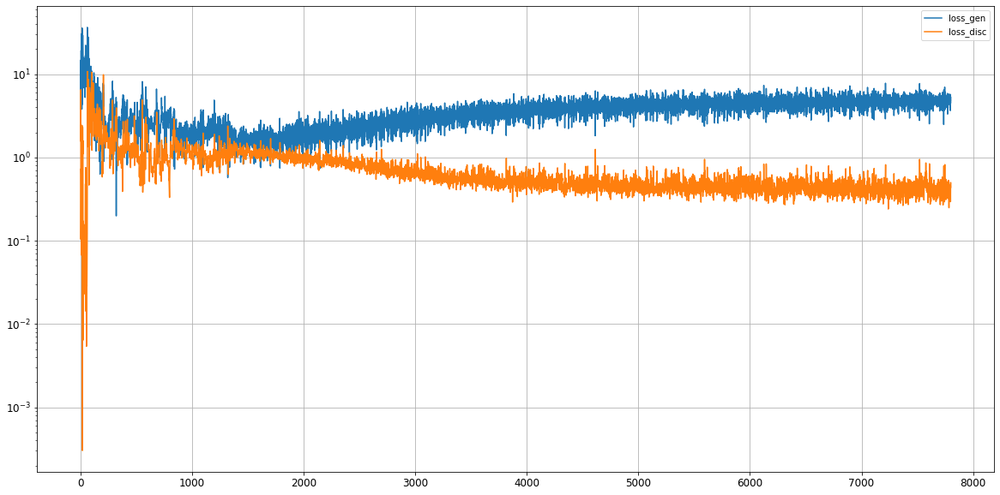

Epoch 7802/50000
0s
Epoch 7803/50000
0s
Epoch 7804/50000
0s
Epoch 7805/50000
0s
Epoch 7806/50000
0s
Epoch 7807/50000
0s
Epoch 7808/50000
0s
Epoch 7809/50000
0s
Epoch 7810/50000
0s
Epoch 7811/50000
0s
Epoch 7812/50000
0s
Epoch 7813/50000
0s
Epoch 7814/50000
0s
Epoch 7815/50000
0s
Epoch 7816/50000
0s
Epoch 7817/50000
0s
Epoch 7818/50000
0s
Epoch 7819/50000
0s
Epoch 7820/50000
0s
Epoch 7821/50000
0s
Epoch 7822/50000
0s
Epoch 7823/50000
0s
Epoch 7824/50000
0s
Epoch 7825/50000
0s
Epoch 7826/50000
0s
Epoch 7827/50000
0s
Epoch 7828/50000
0s
Epoch 7829/50000
0s
Epoch 7830/50000
0s
Epoch 7831/50000
0s
Epoch 7832/50000
0s
Epoch 7833/50000
0s
Epoch 7834/50000
0s
Epoch 7835/50000
0s
Epoch 7836/50000
0s
Epoch 7837/50000
0s
Epoch 7838/50000
0s
Epoch 7839/50000
0s
Epoch 7840/50000
0s
Epoch 7841/50000
0s
Epoch 7842/50000
0s
Epoch 7843/50000
0s
Epoch 7844/50000
0s
Epoch 7845/50000
0s
Epoch 7846/50000
0s
Epoch 7847/50000
0s
Epoch 7848/50000
0s
Epoch 7849/50000
0s
Epoch 7850/50000
0s
Epoch 7851/50000
0s


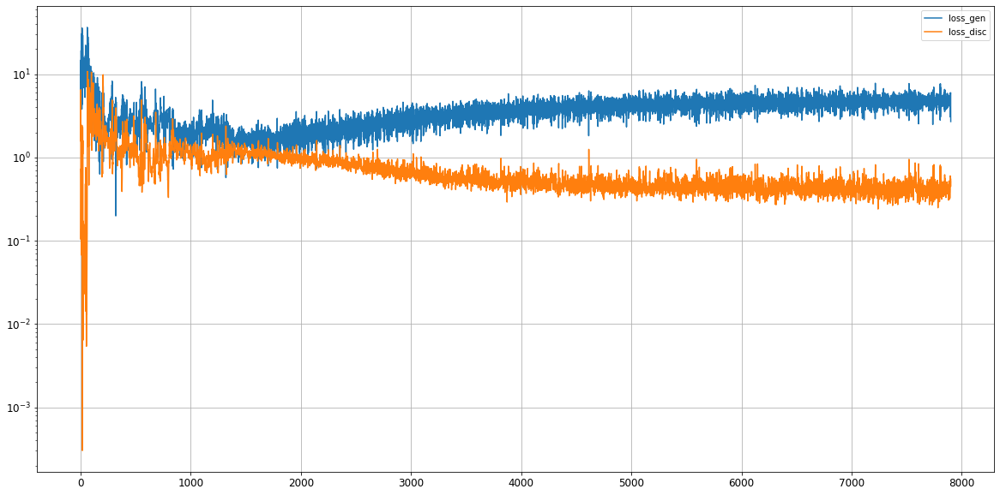

Epoch 7902/50000
0s
Epoch 7903/50000
0s
Epoch 7904/50000
0s
Epoch 7905/50000
0s
Epoch 7906/50000
0s
Epoch 7907/50000
0s
Epoch 7908/50000
0s
Epoch 7909/50000
0s
Epoch 7910/50000
0s
Epoch 7911/50000
0s
Epoch 7912/50000
0s
Epoch 7913/50000
0s
Epoch 7914/50000
0s
Epoch 7915/50000
0s
Epoch 7916/50000
0s
Epoch 7917/50000
0s
Epoch 7918/50000
0s
Epoch 7919/50000
0s
Epoch 7920/50000
0s
Epoch 7921/50000
0s
Epoch 7922/50000
0s
Epoch 7923/50000
0s
Epoch 7924/50000
0s
Epoch 7925/50000
0s
Epoch 7926/50000
0s
Epoch 7927/50000
0s
Epoch 7928/50000
0s
Epoch 7929/50000
0s
Epoch 7930/50000
0s
Epoch 7931/50000
0s
Epoch 7932/50000
0s
Epoch 7933/50000
0s
Epoch 7934/50000
0s
Epoch 7935/50000
0s
Epoch 7936/50000
0s
Epoch 7937/50000
0s
Epoch 7938/50000
0s
Epoch 7939/50000
0s
Epoch 7940/50000
0s
Epoch 7941/50000
0s
Epoch 7942/50000
0s
Epoch 7943/50000
0s
Epoch 7944/50000
0s
Epoch 7945/50000
0s
Epoch 7946/50000
0s
Epoch 7947/50000
0s
Epoch 7948/50000
0s
Epoch 7949/50000
0s
Epoch 7950/50000
0s
Epoch 7951/50000
0s


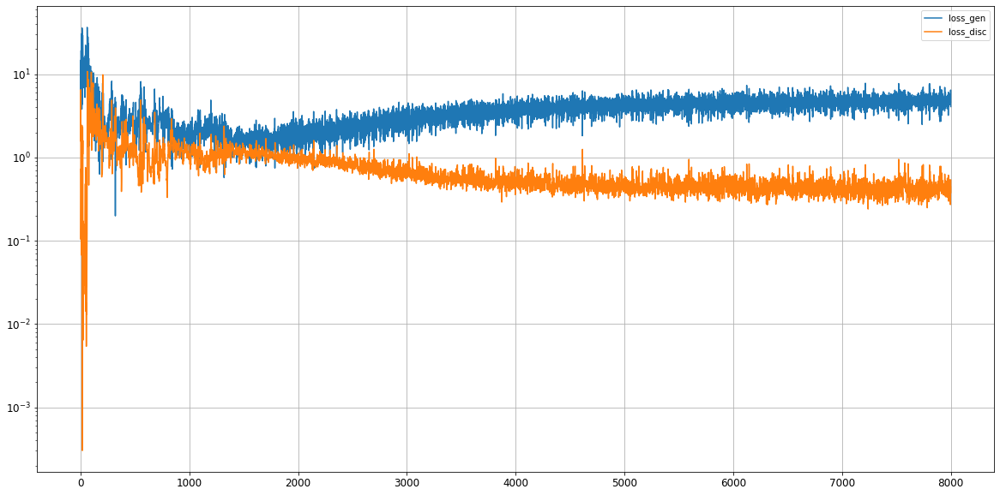

Epoch 8002/50000
0s
Epoch 8003/50000
0s
Epoch 8004/50000
0s
Epoch 8005/50000
0s
Epoch 8006/50000
0s
Epoch 8007/50000
0s
Epoch 8008/50000
0s
Epoch 8009/50000
0s
Epoch 8010/50000
0s
Epoch 8011/50000
0s
Epoch 8012/50000
0s
Epoch 8013/50000
0s
Epoch 8014/50000
0s
Epoch 8015/50000
0s
Epoch 8016/50000
0s
Epoch 8017/50000
0s
Epoch 8018/50000
0s
Epoch 8019/50000
0s
Epoch 8020/50000
0s
Epoch 8021/50000
0s
Epoch 8022/50000
0s
Epoch 8023/50000
0s
Epoch 8024/50000
0s
Epoch 8025/50000
0s
Epoch 8026/50000
0s
Epoch 8027/50000
0s
Epoch 8028/50000
0s
Epoch 8029/50000
0s
Epoch 8030/50000
0s
Epoch 8031/50000
0s
Epoch 8032/50000
0s
Epoch 8033/50000
0s
Epoch 8034/50000
0s
Epoch 8035/50000
0s
Epoch 8036/50000
0s
Epoch 8037/50000
0s
Epoch 8038/50000
0s
Epoch 8039/50000
0s
Epoch 8040/50000
0s
Epoch 8041/50000
0s
Epoch 8042/50000
0s
Epoch 8043/50000
0s
Epoch 8044/50000
0s
Epoch 8045/50000
0s
Epoch 8046/50000
0s
Epoch 8047/50000
0s
Epoch 8048/50000
0s
Epoch 8049/50000
0s
Epoch 8050/50000
0s
Epoch 8051/50000
0s


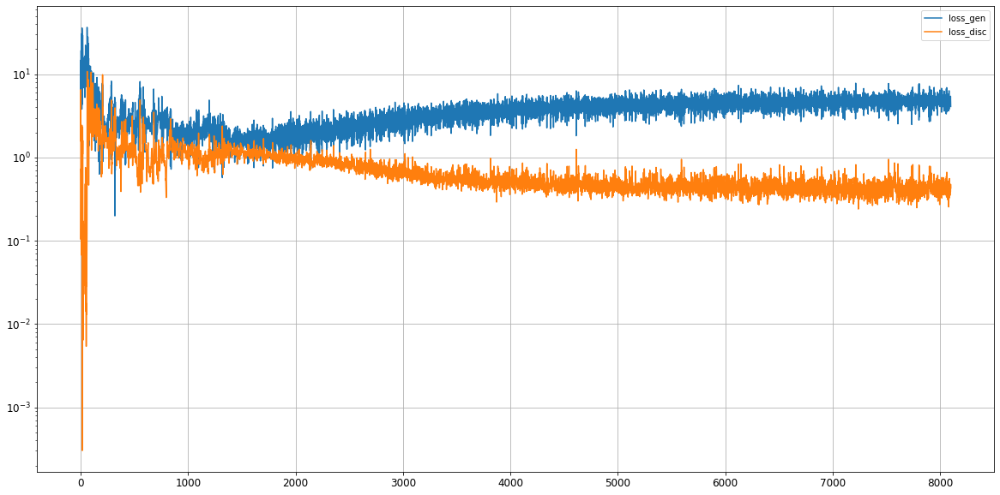

Epoch 8102/50000
0s
Epoch 8103/50000
0s
Epoch 8104/50000
0s
Epoch 8105/50000
0s
Epoch 8106/50000
0s
Epoch 8107/50000
0s
Epoch 8108/50000
0s
Epoch 8109/50000
0s
Epoch 8110/50000
0s
Epoch 8111/50000
0s
Epoch 8112/50000
0s
Epoch 8113/50000
0s
Epoch 8114/50000
0s
Epoch 8115/50000
0s
Epoch 8116/50000
0s
Epoch 8117/50000
0s
Epoch 8118/50000
0s
Epoch 8119/50000
0s
Epoch 8120/50000
0s
Epoch 8121/50000
0s
Epoch 8122/50000
0s
Epoch 8123/50000
0s
Epoch 8124/50000
0s
Epoch 8125/50000
0s
Epoch 8126/50000
0s
Epoch 8127/50000
0s
Epoch 8128/50000
0s
Epoch 8129/50000
0s
Epoch 8130/50000
0s
Epoch 8131/50000
0s
Epoch 8132/50000
0s
Epoch 8133/50000
0s
Epoch 8134/50000
0s
Epoch 8135/50000
0s
Epoch 8136/50000
0s
Epoch 8137/50000
0s
Epoch 8138/50000
0s
Epoch 8139/50000
0s
Epoch 8140/50000
0s
Epoch 8141/50000
0s
Epoch 8142/50000
0s
Epoch 8143/50000
0s
Epoch 8144/50000
0s
Epoch 8145/50000
0s
Epoch 8146/50000
0s
Epoch 8147/50000
0s
Epoch 8148/50000
0s
Epoch 8149/50000
0s
Epoch 8150/50000
0s
Epoch 8151/50000
0s


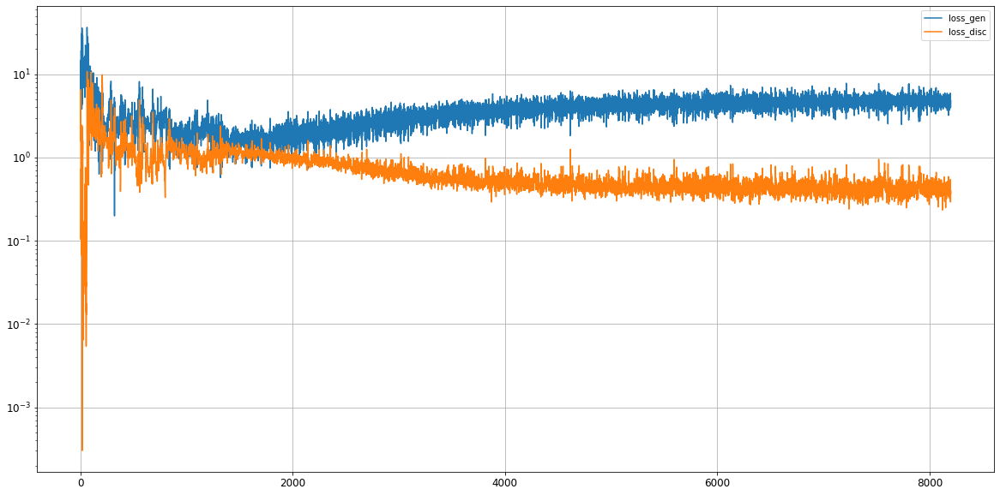

Epoch 8202/50000
0s
Epoch 8203/50000
0s
Epoch 8204/50000
0s
Epoch 8205/50000
0s
Epoch 8206/50000
0s
Epoch 8207/50000
0s
Epoch 8208/50000
0s
Epoch 8209/50000
0s
Epoch 8210/50000
0s
Epoch 8211/50000
0s
Epoch 8212/50000
0s
Epoch 8213/50000
0s
Epoch 8214/50000
0s
Epoch 8215/50000
0s
Epoch 8216/50000
0s
Epoch 8217/50000
0s
Epoch 8218/50000
0s
Epoch 8219/50000
0s
Epoch 8220/50000
0s
Epoch 8221/50000
0s
Epoch 8222/50000
0s
Epoch 8223/50000
0s
Epoch 8224/50000
0s
Epoch 8225/50000
0s
Epoch 8226/50000
0s
Epoch 8227/50000
0s
Epoch 8228/50000
0s
Epoch 8229/50000
0s
Epoch 8230/50000
0s
Epoch 8231/50000
0s
Epoch 8232/50000
0s
Epoch 8233/50000
0s
Epoch 8234/50000
0s
Epoch 8235/50000
0s
Epoch 8236/50000
0s
Epoch 8237/50000
0s
Epoch 8238/50000
0s
Epoch 8239/50000
0s
Epoch 8240/50000
0s
Epoch 8241/50000
0s
Epoch 8242/50000
0s
Epoch 8243/50000
0s
Epoch 8244/50000
0s
Epoch 8245/50000
0s
Epoch 8246/50000
0s
Epoch 8247/50000
0s
Epoch 8248/50000
0s
Epoch 8249/50000
0s
Epoch 8250/50000
0s
Epoch 8251/50000
0s


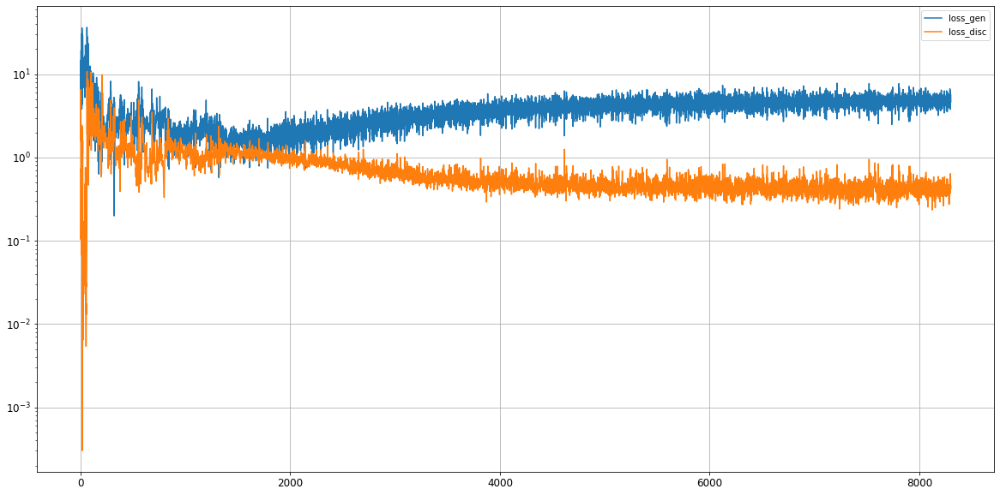

Epoch 8302/50000
0s
Epoch 8303/50000
0s
Epoch 8304/50000
0s
Epoch 8305/50000
0s
Epoch 8306/50000
0s
Epoch 8307/50000
0s
Epoch 8308/50000
0s
Epoch 8309/50000
0s
Epoch 8310/50000
0s
Epoch 8311/50000
0s
Epoch 8312/50000
0s
Epoch 8313/50000
0s
Epoch 8314/50000
0s
Epoch 8315/50000
0s
Epoch 8316/50000
0s
Epoch 8317/50000
0s
Epoch 8318/50000
0s
Epoch 8319/50000
0s
Epoch 8320/50000
0s
Epoch 8321/50000
0s
Epoch 8322/50000
0s
Epoch 8323/50000
0s
Epoch 8324/50000
0s
Epoch 8325/50000
0s
Epoch 8326/50000
0s
Epoch 8327/50000
0s
Epoch 8328/50000
0s
Epoch 8329/50000
0s
Epoch 8330/50000
0s
Epoch 8331/50000
0s
Epoch 8332/50000
0s
Epoch 8333/50000
0s
Epoch 8334/50000
0s
Epoch 8335/50000
0s
Epoch 8336/50000
0s
Epoch 8337/50000
0s
Epoch 8338/50000
0s
Epoch 8339/50000
0s
Epoch 8340/50000
0s
Epoch 8341/50000
0s
Epoch 8342/50000
0s
Epoch 8343/50000
0s
Epoch 8344/50000
0s
Epoch 8345/50000
0s
Epoch 8346/50000
0s
Epoch 8347/50000
0s
Epoch 8348/50000
0s
Epoch 8349/50000
0s
Epoch 8350/50000
0s
Epoch 8351/50000
0s


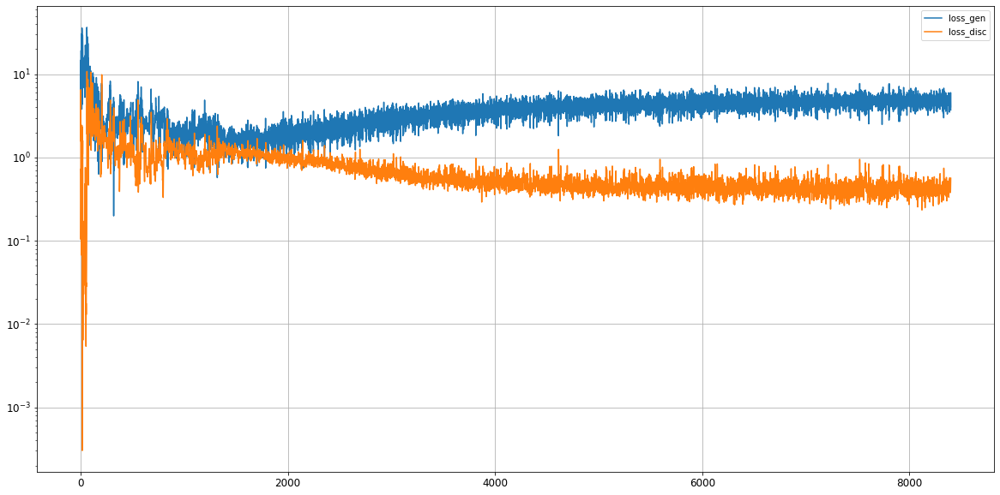

Epoch 8402/50000
0s
Epoch 8403/50000
0s
Epoch 8404/50000
0s
Epoch 8405/50000
0s
Epoch 8406/50000
0s
Epoch 8407/50000
0s
Epoch 8408/50000
0s
Epoch 8409/50000
0s
Epoch 8410/50000
0s
Epoch 8411/50000
0s
Epoch 8412/50000
0s
Epoch 8413/50000
0s
Epoch 8414/50000
0s
Epoch 8415/50000
0s
Epoch 8416/50000
0s
Epoch 8417/50000
0s
Epoch 8418/50000
0s
Epoch 8419/50000
0s
Epoch 8420/50000
0s
Epoch 8421/50000
0s
Epoch 8422/50000
0s
Epoch 8423/50000
0s
Epoch 8424/50000
0s
Epoch 8425/50000
0s
Epoch 8426/50000
0s
Epoch 8427/50000
0s
Epoch 8428/50000
0s
Epoch 8429/50000
0s
Epoch 8430/50000
0s
Epoch 8431/50000
0s
Epoch 8432/50000
0s
Epoch 8433/50000
0s
Epoch 8434/50000
0s
Epoch 8435/50000
0s
Epoch 8436/50000
0s
Epoch 8437/50000
0s
Epoch 8438/50000
0s
Epoch 8439/50000
0s
Epoch 8440/50000
0s
Epoch 8441/50000
0s
Epoch 8442/50000
0s
Epoch 8443/50000
0s
Epoch 8444/50000
0s
Epoch 8445/50000
0s
Epoch 8446/50000
0s
Epoch 8447/50000
0s
Epoch 8448/50000
0s
Epoch 8449/50000
0s
Epoch 8450/50000
0s
Epoch 8451/50000
0s


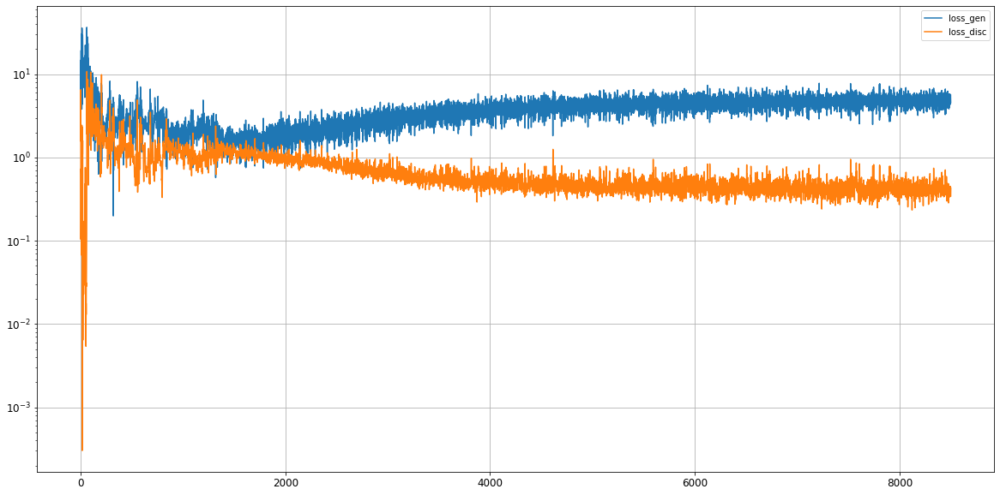

Epoch 8502/50000
0s
Epoch 8503/50000
0s
Epoch 8504/50000
0s
Epoch 8505/50000
0s
Epoch 8506/50000
0s
Epoch 8507/50000
0s
Epoch 8508/50000
0s
Epoch 8509/50000
0s
Epoch 8510/50000
0s
Epoch 8511/50000
0s
Epoch 8512/50000
0s
Epoch 8513/50000
0s
Epoch 8514/50000
0s
Epoch 8515/50000
0s
Epoch 8516/50000
0s
Epoch 8517/50000
0s
Epoch 8518/50000
0s
Epoch 8519/50000
0s
Epoch 8520/50000
0s
Epoch 8521/50000
0s
Epoch 8522/50000
0s
Epoch 8523/50000
0s
Epoch 8524/50000
0s
Epoch 8525/50000
0s
Epoch 8526/50000
0s
Epoch 8527/50000
0s
Epoch 8528/50000
0s
Epoch 8529/50000
0s
Epoch 8530/50000
0s
Epoch 8531/50000
0s
Epoch 8532/50000
0s
Epoch 8533/50000
0s
Epoch 8534/50000
0s
Epoch 8535/50000
0s
Epoch 8536/50000
0s
Epoch 8537/50000
0s
Epoch 8538/50000
0s
Epoch 8539/50000
0s
Epoch 8540/50000
0s
Epoch 8541/50000
0s
Epoch 8542/50000
0s
Epoch 8543/50000
0s
Epoch 8544/50000
0s
Epoch 8545/50000
0s
Epoch 8546/50000
0s
Epoch 8547/50000
0s
Epoch 8548/50000
0s
Epoch 8549/50000
0s
Epoch 8550/50000
0s
Epoch 8551/50000
0s


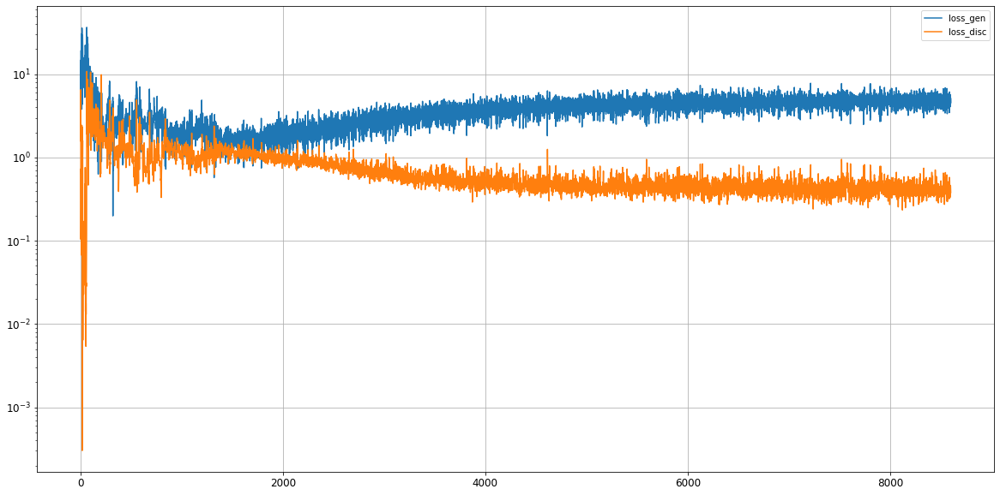

Epoch 8602/50000
0s
Epoch 8603/50000
0s
Epoch 8604/50000
0s
Epoch 8605/50000
0s
Epoch 8606/50000
0s
Epoch 8607/50000
0s
Epoch 8608/50000
0s
Epoch 8609/50000
0s
Epoch 8610/50000
0s
Epoch 8611/50000
0s
Epoch 8612/50000
0s
Epoch 8613/50000
0s
Epoch 8614/50000
0s
Epoch 8615/50000
0s
Epoch 8616/50000
0s
Epoch 8617/50000
0s
Epoch 8618/50000
0s
Epoch 8619/50000
0s
Epoch 8620/50000
0s
Epoch 8621/50000
0s
Epoch 8622/50000
0s
Epoch 8623/50000
0s
Epoch 8624/50000
0s
Epoch 8625/50000
0s
Epoch 8626/50000
0s
Epoch 8627/50000
0s
Epoch 8628/50000
0s
Epoch 8629/50000
0s
Epoch 8630/50000
0s
Epoch 8631/50000
0s
Epoch 8632/50000
0s
Epoch 8633/50000
0s
Epoch 8634/50000
0s
Epoch 8635/50000
0s
Epoch 8636/50000
0s
Epoch 8637/50000
0s
Epoch 8638/50000
0s
Epoch 8639/50000
0s
Epoch 8640/50000
0s
Epoch 8641/50000
0s
Epoch 8642/50000
0s
Epoch 8643/50000
0s
Epoch 8644/50000
0s
Epoch 8645/50000
0s
Epoch 8646/50000
0s
Epoch 8647/50000
0s
Epoch 8648/50000
0s
Epoch 8649/50000
0s
Epoch 8650/50000
0s
Epoch 8651/50000
0s


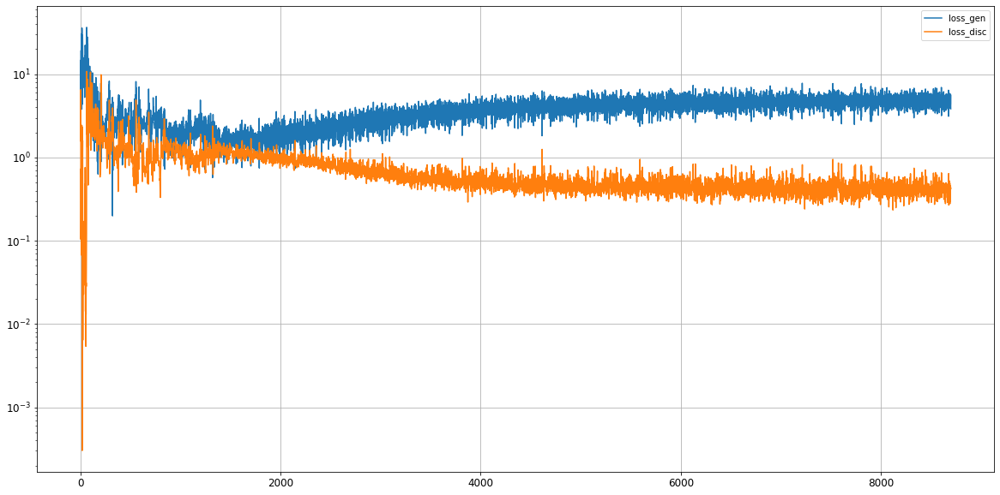

Epoch 8702/50000
0s
Epoch 8703/50000
0s
Epoch 8704/50000
0s
Epoch 8705/50000
0s
Epoch 8706/50000
0s
Epoch 8707/50000
0s
Epoch 8708/50000
0s
Epoch 8709/50000
0s
Epoch 8710/50000
0s
Epoch 8711/50000
0s
Epoch 8712/50000
0s
Epoch 8713/50000
0s
Epoch 8714/50000
0s
Epoch 8715/50000
0s
Epoch 8716/50000
0s
Epoch 8717/50000
0s
Epoch 8718/50000
0s
Epoch 8719/50000
0s
Epoch 8720/50000
0s
Epoch 8721/50000
0s
Epoch 8722/50000
0s
Epoch 8723/50000
0s
Epoch 8724/50000
0s
Epoch 8725/50000
0s
Epoch 8726/50000
0s
Epoch 8727/50000
0s
Epoch 8728/50000
0s
Epoch 8729/50000
0s
Epoch 8730/50000
0s
Epoch 8731/50000
0s
Epoch 8732/50000
0s
Epoch 8733/50000
0s
Epoch 8734/50000
0s
Epoch 8735/50000
0s
Epoch 8736/50000
0s
Epoch 8737/50000
0s
Epoch 8738/50000
0s
Epoch 8739/50000
0s
Epoch 8740/50000
0s
Epoch 8741/50000
0s
Epoch 8742/50000
0s
Epoch 8743/50000
0s
Epoch 8744/50000
0s
Epoch 8745/50000
0s
Epoch 8746/50000
0s
Epoch 8747/50000
0s
Epoch 8748/50000
0s
Epoch 8749/50000
0s
Epoch 8750/50000
0s
Epoch 8751/50000
0s


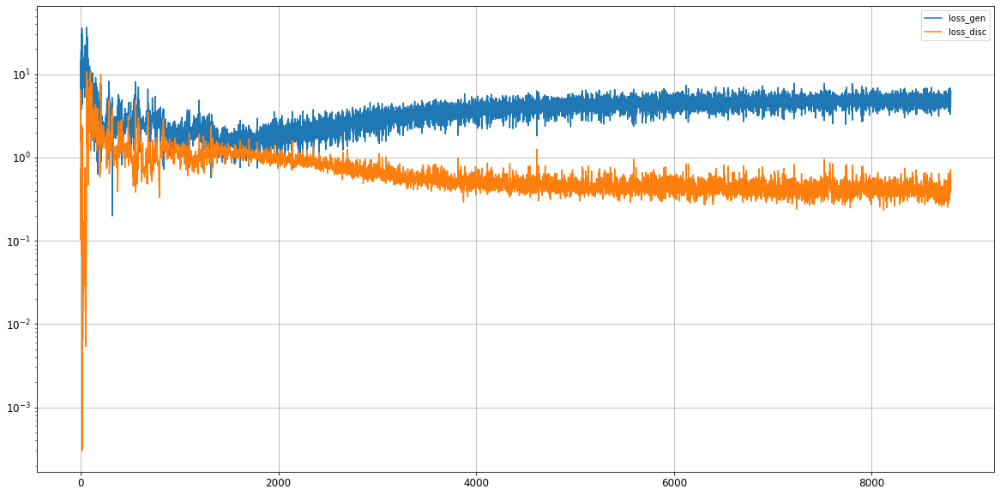

Epoch 8802/50000
0s
Epoch 8803/50000
0s
Epoch 8804/50000
0s
Epoch 8805/50000
0s
Epoch 8806/50000
0s
Epoch 8807/50000
0s
Epoch 8808/50000
0s
Epoch 8809/50000
0s
Epoch 8810/50000
0s
Epoch 8811/50000
0s
Epoch 8812/50000
0s
Epoch 8813/50000
0s
Epoch 8814/50000
0s
Epoch 8815/50000
0s
Epoch 8816/50000
0s
Epoch 8817/50000
0s
Epoch 8818/50000
0s
Epoch 8819/50000
0s
Epoch 8820/50000
0s
Epoch 8821/50000
0s
Epoch 8822/50000
0s
Epoch 8823/50000
0s
Epoch 8824/50000
0s
Epoch 8825/50000
0s
Epoch 8826/50000
0s
Epoch 8827/50000
0s
Epoch 8828/50000
0s
Epoch 8829/50000
0s
Epoch 8830/50000
0s
Epoch 8831/50000
0s
Epoch 8832/50000
0s
Epoch 8833/50000
0s
Epoch 8834/50000
0s
Epoch 8835/50000
0s
Epoch 8836/50000
0s
Epoch 8837/50000
0s
Epoch 8838/50000
0s
Epoch 8839/50000
0s
Epoch 8840/50000
0s
Epoch 8841/50000
0s
Epoch 8842/50000
0s
Epoch 8843/50000
0s
Epoch 8844/50000
0s
Epoch 8845/50000
0s
Epoch 8846/50000
0s
Epoch 8847/50000
0s
Epoch 8848/50000
0s
Epoch 8849/50000
0s
Epoch 8850/50000
0s
Epoch 8851/50000
0s


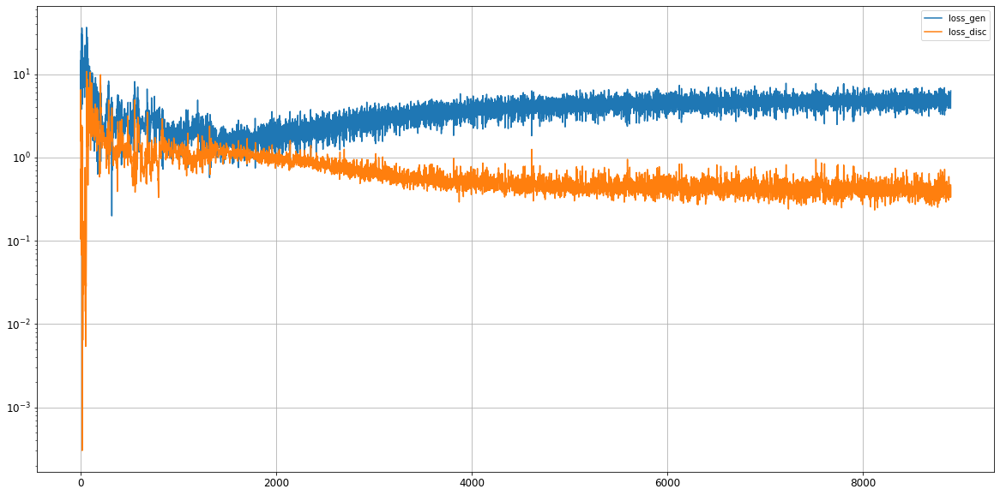

Epoch 8902/50000
0s
Epoch 8903/50000
0s
Epoch 8904/50000
0s
Epoch 8905/50000
0s
Epoch 8906/50000
0s
Epoch 8907/50000
0s
Epoch 8908/50000
0s
Epoch 8909/50000
0s
Epoch 8910/50000
0s
Epoch 8911/50000
0s
Epoch 8912/50000
0s
Epoch 8913/50000
0s
Epoch 8914/50000
0s
Epoch 8915/50000
0s
Epoch 8916/50000
0s
Epoch 8917/50000
0s
Epoch 8918/50000
0s
Epoch 8919/50000
0s
Epoch 8920/50000
0s
Epoch 8921/50000
0s
Epoch 8922/50000
0s
Epoch 8923/50000
0s
Epoch 8924/50000
0s
Epoch 8925/50000
0s
Epoch 8926/50000
0s
Epoch 8927/50000
0s
Epoch 8928/50000
0s
Epoch 8929/50000
0s
Epoch 8930/50000
0s
Epoch 8931/50000
0s
Epoch 8932/50000
0s
Epoch 8933/50000
0s
Epoch 8934/50000
0s
Epoch 8935/50000
0s
Epoch 8936/50000
0s
Epoch 8937/50000
0s
Epoch 8938/50000
0s
Epoch 8939/50000
0s
Epoch 8940/50000
0s
Epoch 8941/50000
0s
Epoch 8942/50000
0s
Epoch 8943/50000
0s
Epoch 8944/50000
0s
Epoch 8945/50000
0s
Epoch 8946/50000
0s
Epoch 8947/50000
0s
Epoch 8948/50000
0s
Epoch 8949/50000
0s
Epoch 8950/50000
0s
Epoch 8951/50000
0s


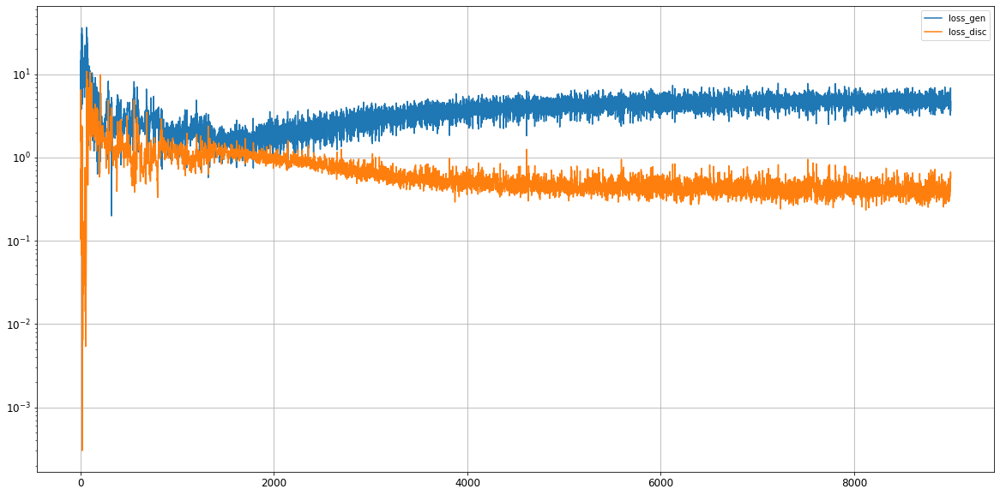

Epoch 9002/50000
0s
Epoch 9003/50000
0s
Epoch 9004/50000
0s
Epoch 9005/50000
0s
Epoch 9006/50000
0s
Epoch 9007/50000
0s
Epoch 9008/50000
0s
Epoch 9009/50000
0s
Epoch 9010/50000
0s
Epoch 9011/50000
0s
Epoch 9012/50000
0s
Epoch 9013/50000
0s
Epoch 9014/50000
0s
Epoch 9015/50000
0s
Epoch 9016/50000
0s
Epoch 9017/50000
0s
Epoch 9018/50000
0s
Epoch 9019/50000
0s
Epoch 9020/50000
0s
Epoch 9021/50000
0s
Epoch 9022/50000
0s
Epoch 9023/50000
0s
Epoch 9024/50000
0s
Epoch 9025/50000
0s
Epoch 9026/50000
0s
Epoch 9027/50000
0s
Epoch 9028/50000
0s
Epoch 9029/50000
0s
Epoch 9030/50000
0s
Epoch 9031/50000
0s
Epoch 9032/50000
0s
Epoch 9033/50000
0s
Epoch 9034/50000
0s
Epoch 9035/50000
0s
Epoch 9036/50000
0s
Epoch 9037/50000
0s
Epoch 9038/50000
0s
Epoch 9039/50000
0s
Epoch 9040/50000
0s
Epoch 9041/50000
0s
Epoch 9042/50000
0s
Epoch 9043/50000
0s
Epoch 9044/50000
0s
Epoch 9045/50000
0s
Epoch 9046/50000
0s
Epoch 9047/50000
0s
Epoch 9048/50000
0s
Epoch 9049/50000
0s
Epoch 9050/50000
0s
Epoch 9051/50000
0s


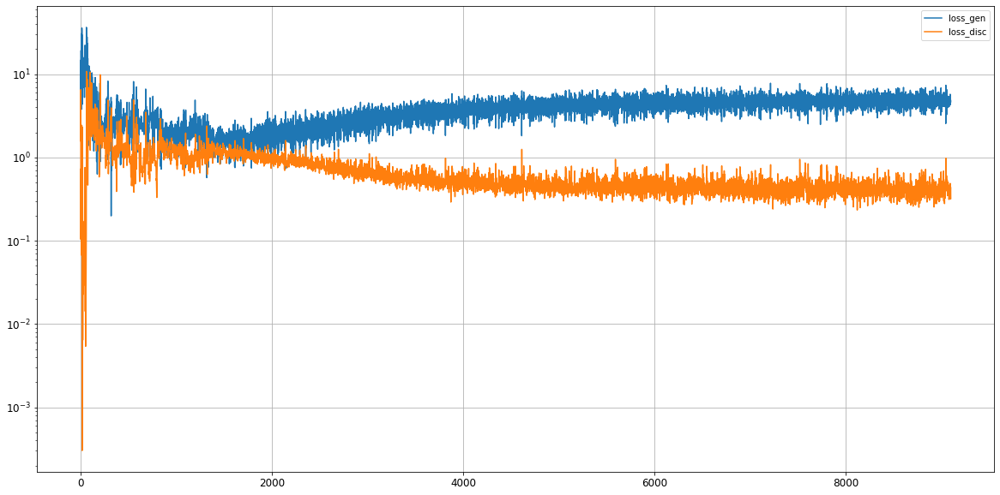

Epoch 9102/50000
0s
Epoch 9103/50000
0s
Epoch 9104/50000
0s
Epoch 9105/50000
0s
Epoch 9106/50000
0s
Epoch 9107/50000
0s
Epoch 9108/50000
0s
Epoch 9109/50000
0s
Epoch 9110/50000
0s
Epoch 9111/50000
0s
Epoch 9112/50000
0s
Epoch 9113/50000
0s
Epoch 9114/50000
0s
Epoch 9115/50000
0s
Epoch 9116/50000
0s
Epoch 9117/50000
0s
Epoch 9118/50000
0s
Epoch 9119/50000
0s
Epoch 9120/50000
0s
Epoch 9121/50000
0s
Epoch 9122/50000
0s
Epoch 9123/50000
0s
Epoch 9124/50000
0s
Epoch 9125/50000
0s
Epoch 9126/50000
0s
Epoch 9127/50000
0s
Epoch 9128/50000
0s
Epoch 9129/50000
0s
Epoch 9130/50000
0s
Epoch 9131/50000
0s
Epoch 9132/50000
0s
Epoch 9133/50000
0s
Epoch 9134/50000
0s
Epoch 9135/50000
0s
Epoch 9136/50000
0s
Epoch 9137/50000
0s
Epoch 9138/50000
0s
Epoch 9139/50000
0s
Epoch 9140/50000
0s
Epoch 9141/50000
0s
Epoch 9142/50000
0s
Epoch 9143/50000
0s
Epoch 9144/50000
0s
Epoch 9145/50000
0s
Epoch 9146/50000
0s
Epoch 9147/50000
0s
Epoch 9148/50000
0s
Epoch 9149/50000
0s
Epoch 9150/50000
0s
Epoch 9151/50000
0s


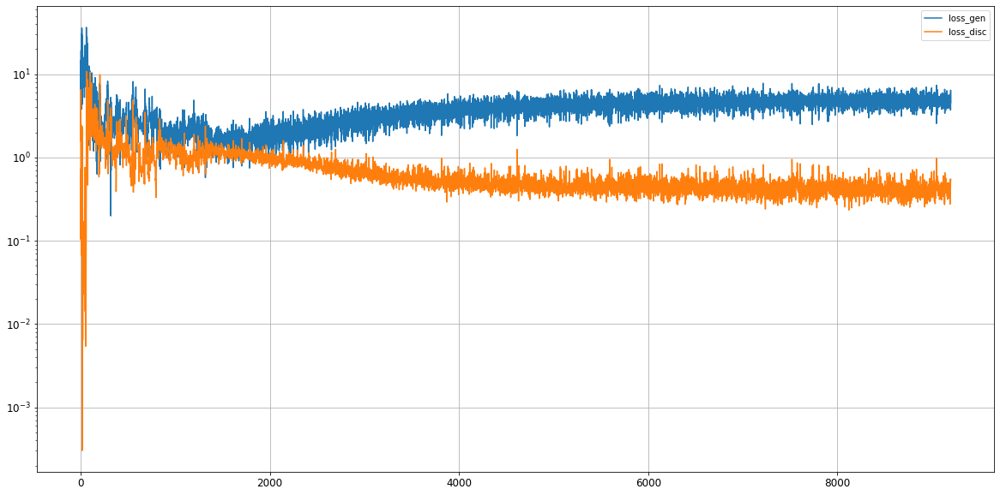

Epoch 9202/50000
0s
Epoch 9203/50000
0s
Epoch 9204/50000
0s
Epoch 9205/50000
0s
Epoch 9206/50000
0s
Epoch 9207/50000
0s
Epoch 9208/50000
0s
Epoch 9209/50000
0s
Epoch 9210/50000
0s
Epoch 9211/50000
0s
Epoch 9212/50000
0s
Epoch 9213/50000
0s
Epoch 9214/50000
0s
Epoch 9215/50000
0s
Epoch 9216/50000
0s
Epoch 9217/50000
0s
Epoch 9218/50000
0s
Epoch 9219/50000
0s
Epoch 9220/50000
0s
Epoch 9221/50000
0s
Epoch 9222/50000
0s
Epoch 9223/50000
0s
Epoch 9224/50000
0s
Epoch 9225/50000
0s
Epoch 9226/50000
0s
Epoch 9227/50000
0s
Epoch 9228/50000
0s
Epoch 9229/50000
0s
Epoch 9230/50000
0s
Epoch 9231/50000
0s
Epoch 9232/50000
0s
Epoch 9233/50000
0s
Epoch 9234/50000
0s
Epoch 9235/50000
0s
Epoch 9236/50000
0s
Epoch 9237/50000
0s
Epoch 9238/50000
0s
Epoch 9239/50000
0s
Epoch 9240/50000
0s
Epoch 9241/50000
0s
Epoch 9242/50000
0s
Epoch 9243/50000
0s
Epoch 9244/50000
0s
Epoch 9245/50000
0s
Epoch 9246/50000
0s
Epoch 9247/50000
0s
Epoch 9248/50000
0s
Epoch 9249/50000
0s
Epoch 9250/50000
0s
Epoch 9251/50000
0s


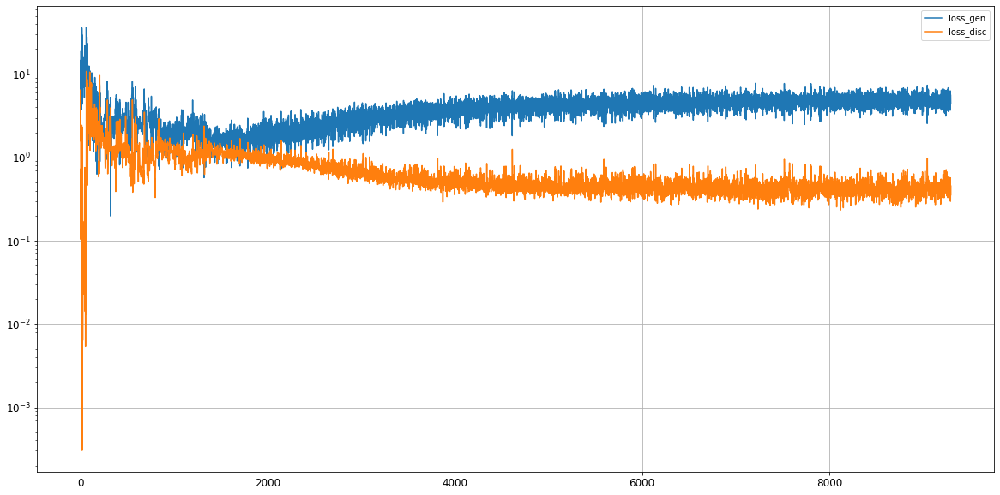

Epoch 9302/50000
0s
Epoch 9303/50000
0s
Epoch 9304/50000
0s
Epoch 9305/50000
0s
Epoch 9306/50000
0s
Epoch 9307/50000
0s
Epoch 9308/50000
0s
Epoch 9309/50000
0s
Epoch 9310/50000
0s
Epoch 9311/50000
0s
Epoch 9312/50000
0s
Epoch 9313/50000
0s
Epoch 9314/50000
0s
Epoch 9315/50000
0s
Epoch 9316/50000
0s
Epoch 9317/50000
0s
Epoch 9318/50000
0s
Epoch 9319/50000
0s
Epoch 9320/50000
0s
Epoch 9321/50000
0s
Epoch 9322/50000
0s
Epoch 9323/50000
0s
Epoch 9324/50000
0s
Epoch 9325/50000
0s
Epoch 9326/50000
0s
Epoch 9327/50000
0s
Epoch 9328/50000
0s
Epoch 9329/50000
0s
Epoch 9330/50000
0s
Epoch 9331/50000
0s
Epoch 9332/50000
0s
Epoch 9333/50000
0s
Epoch 9334/50000
0s
Epoch 9335/50000
0s
Epoch 9336/50000
0s
Epoch 9337/50000
0s
Epoch 9338/50000
0s
Epoch 9339/50000
0s
Epoch 9340/50000
0s
Epoch 9341/50000
0s
Epoch 9342/50000
0s
Epoch 9343/50000
0s
Epoch 9344/50000
0s
Epoch 9345/50000
0s
Epoch 9346/50000
0s
Epoch 9347/50000
0s
Epoch 9348/50000
0s
Epoch 9349/50000
0s
Epoch 9350/50000
0s
Epoch 9351/50000
0s


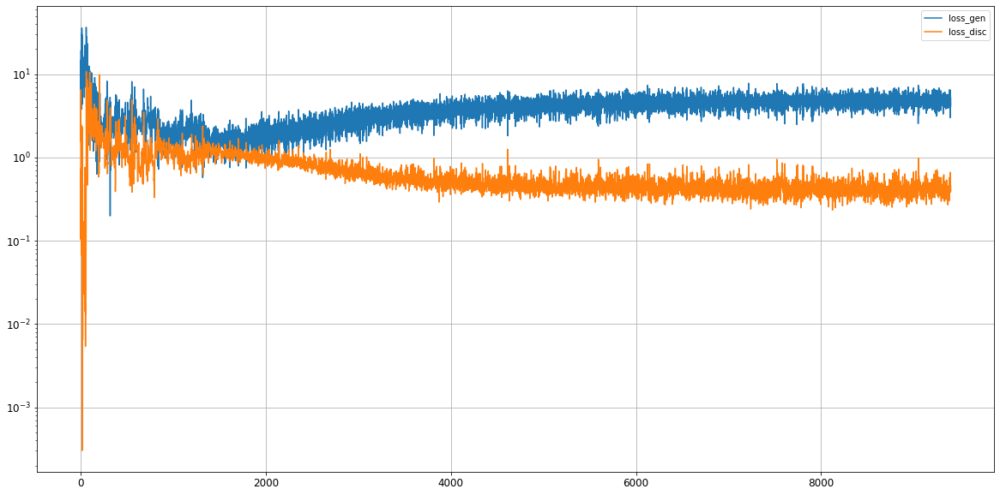

Epoch 9402/50000
0s
Epoch 9403/50000
0s
Epoch 9404/50000
0s
Epoch 9405/50000
0s
Epoch 9406/50000
0s
Epoch 9407/50000
0s
Epoch 9408/50000
0s
Epoch 9409/50000
0s
Epoch 9410/50000
0s
Epoch 9411/50000
0s
Epoch 9412/50000
0s
Epoch 9413/50000
0s
Epoch 9414/50000
0s
Epoch 9415/50000
0s
Epoch 9416/50000
0s
Epoch 9417/50000
0s
Epoch 9418/50000
0s
Epoch 9419/50000
0s
Epoch 9420/50000
0s
Epoch 9421/50000
0s
Epoch 9422/50000
0s
Epoch 9423/50000
0s
Epoch 9424/50000
0s
Epoch 9425/50000
0s
Epoch 9426/50000
0s
Epoch 9427/50000
0s
Epoch 9428/50000
0s
Epoch 9429/50000
0s
Epoch 9430/50000
0s
Epoch 9431/50000
0s
Epoch 9432/50000
0s
Epoch 9433/50000
0s
Epoch 9434/50000
0s
Epoch 9435/50000
0s
Epoch 9436/50000
0s
Epoch 9437/50000
0s
Epoch 9438/50000
0s
Epoch 9439/50000
0s
Epoch 9440/50000
0s
Epoch 9441/50000
0s
Epoch 9442/50000
0s
Epoch 9443/50000
0s
Epoch 9444/50000
0s
Epoch 9445/50000
0s
Epoch 9446/50000
0s
Epoch 9447/50000
0s
Epoch 9448/50000
0s
Epoch 9449/50000
0s
Epoch 9450/50000
0s
Epoch 9451/50000
0s


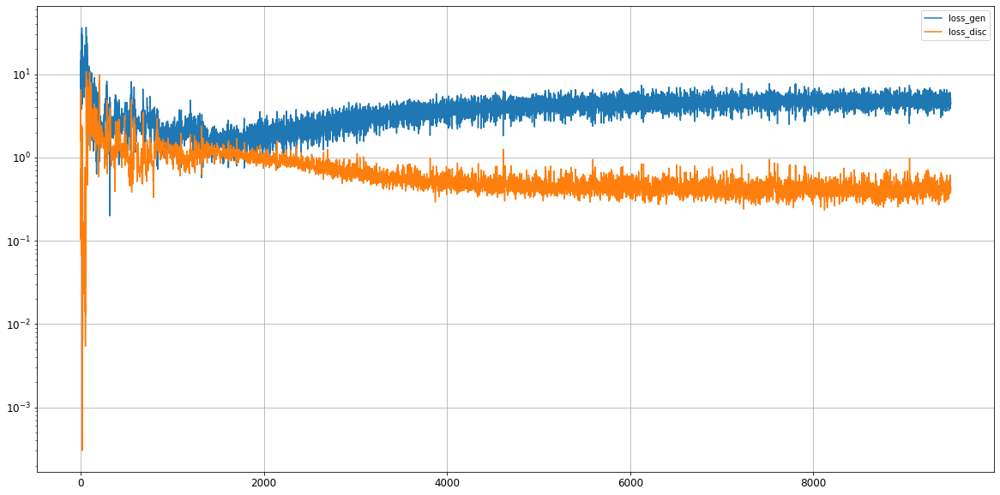

Epoch 9502/50000
0s
Epoch 9503/50000
0s
Epoch 9504/50000
0s
Epoch 9505/50000
0s
Epoch 9506/50000
0s
Epoch 9507/50000
0s
Epoch 9508/50000
0s
Epoch 9509/50000
0s
Epoch 9510/50000
0s
Epoch 9511/50000
0s
Epoch 9512/50000
0s
Epoch 9513/50000
0s
Epoch 9514/50000
0s
Epoch 9515/50000
0s
Epoch 9516/50000
0s
Epoch 9517/50000
0s
Epoch 9518/50000
0s
Epoch 9519/50000
0s
Epoch 9520/50000
0s
Epoch 9521/50000
0s
Epoch 9522/50000
0s
Epoch 9523/50000
0s
Epoch 9524/50000
0s
Epoch 9525/50000
0s
Epoch 9526/50000
0s
Epoch 9527/50000
0s
Epoch 9528/50000
0s
Epoch 9529/50000
0s
Epoch 9530/50000
0s
Epoch 9531/50000
0s
Epoch 9532/50000
0s
Epoch 9533/50000
0s
Epoch 9534/50000
0s
Epoch 9535/50000
0s
Epoch 9536/50000
0s
Epoch 9537/50000
0s
Epoch 9538/50000
0s
Epoch 9539/50000
0s
Epoch 9540/50000
0s
Epoch 9541/50000
0s
Epoch 9542/50000
0s
Epoch 9543/50000
0s
Epoch 9544/50000
0s
Epoch 9545/50000
0s
Epoch 9546/50000
0s
Epoch 9547/50000
0s
Epoch 9548/50000
0s
Epoch 9549/50000
0s
Epoch 9550/50000
0s
Epoch 9551/50000
0s


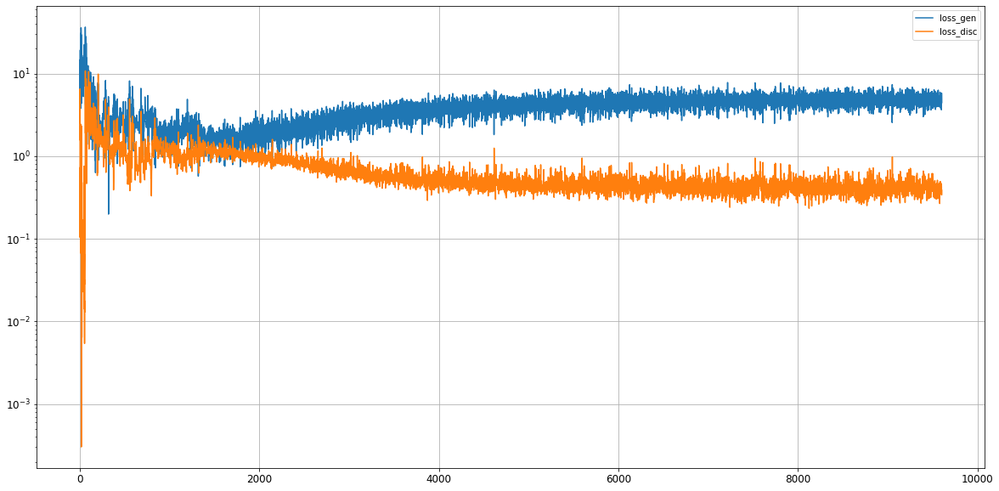

Epoch 9602/50000
0s
Epoch 9603/50000
0s
Epoch 9604/50000
0s
Epoch 9605/50000
0s
Epoch 9606/50000
0s
Epoch 9607/50000
0s
Epoch 9608/50000
0s
Epoch 9609/50000
0s
Epoch 9610/50000
0s
Epoch 9611/50000
0s
Epoch 9612/50000
0s
Epoch 9613/50000
0s
Epoch 9614/50000
0s
Epoch 9615/50000
0s
Epoch 9616/50000
0s
Epoch 9617/50000
0s
Epoch 9618/50000
0s
Epoch 9619/50000
0s
Epoch 9620/50000
0s
Epoch 9621/50000
0s
Epoch 9622/50000
0s
Epoch 9623/50000
0s
Epoch 9624/50000
0s
Epoch 9625/50000
0s
Epoch 9626/50000
0s
Epoch 9627/50000
0s
Epoch 9628/50000
0s
Epoch 9629/50000
0s
Epoch 9630/50000
0s
Epoch 9631/50000
0s
Epoch 9632/50000
0s
Epoch 9633/50000
0s
Epoch 9634/50000
0s
Epoch 9635/50000
0s
Epoch 9636/50000
0s
Epoch 9637/50000
0s
Epoch 9638/50000
0s
Epoch 9639/50000
0s
Epoch 9640/50000
0s
Epoch 9641/50000
0s
Epoch 9642/50000
0s
Epoch 9643/50000
0s
Epoch 9644/50000
0s
Epoch 9645/50000
0s
Epoch 9646/50000
0s
Epoch 9647/50000
0s
Epoch 9648/50000
0s
Epoch 9649/50000
0s
Epoch 9650/50000
0s
Epoch 9651/50000
0s


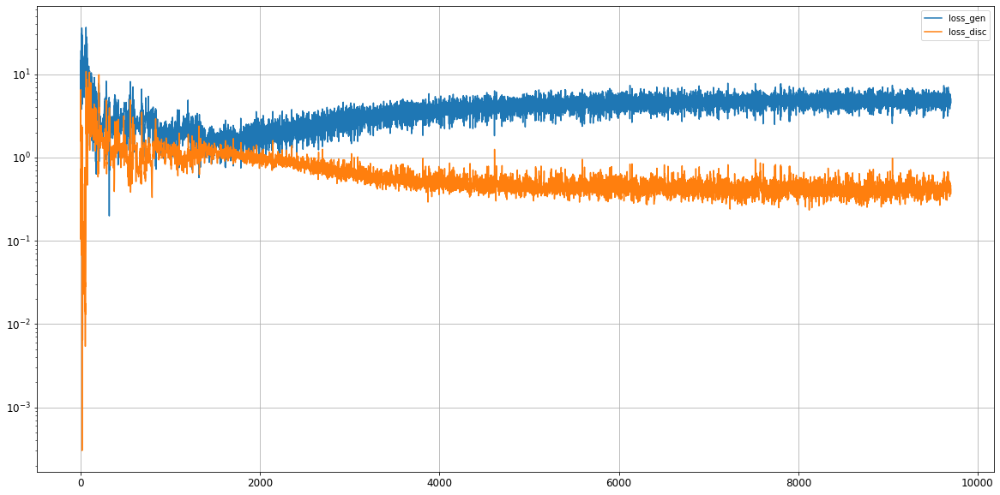

Epoch 9702/50000
0s
Epoch 9703/50000
0s
Epoch 9704/50000
0s
Epoch 9705/50000
0s
Epoch 9706/50000
0s
Epoch 9707/50000
0s
Epoch 9708/50000
0s
Epoch 9709/50000
0s
Epoch 9710/50000
0s
Epoch 9711/50000
0s
Epoch 9712/50000
0s
Epoch 9713/50000
0s
Epoch 9714/50000
0s
Epoch 9715/50000
0s
Epoch 9716/50000
0s
Epoch 9717/50000
0s
Epoch 9718/50000
0s
Epoch 9719/50000
0s
Epoch 9720/50000
0s
Epoch 9721/50000
0s
Epoch 9722/50000
0s
Epoch 9723/50000
0s
Epoch 9724/50000
0s
Epoch 9725/50000
0s
Epoch 9726/50000
0s
Epoch 9727/50000
0s
Epoch 9728/50000
0s
Epoch 9729/50000
0s
Epoch 9730/50000
0s
Epoch 9731/50000
0s
Epoch 9732/50000
0s
Epoch 9733/50000
0s
Epoch 9734/50000
0s
Epoch 9735/50000
0s
Epoch 9736/50000
0s
Epoch 9737/50000
0s
Epoch 9738/50000
0s
Epoch 9739/50000
0s
Epoch 9740/50000
0s
Epoch 9741/50000
0s
Epoch 9742/50000
0s
Epoch 9743/50000
0s
Epoch 9744/50000
0s
Epoch 9745/50000
0s
Epoch 9746/50000
0s
Epoch 9747/50000
0s
Epoch 9748/50000
0s
Epoch 9749/50000
0s
Epoch 9750/50000
0s
Epoch 9751/50000
0s


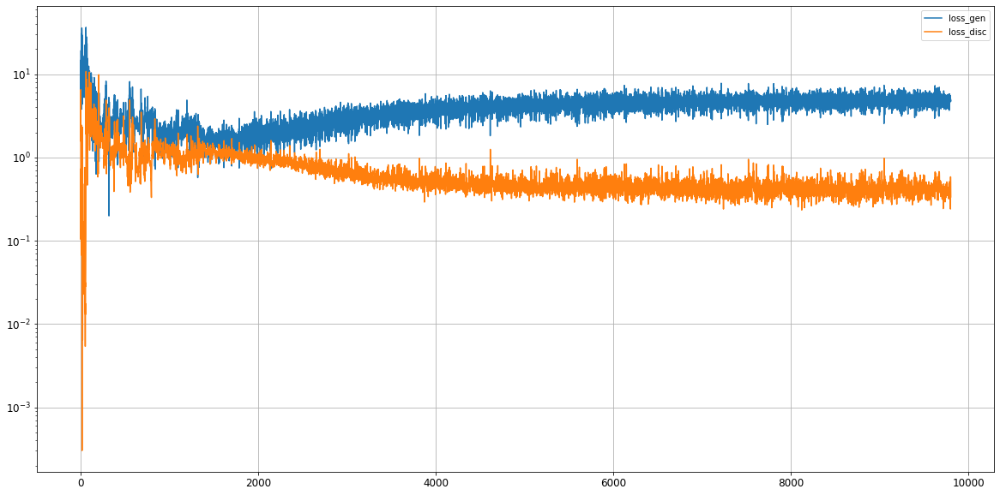

Epoch 9802/50000
0s
Epoch 9803/50000
0s
Epoch 9804/50000
0s
Epoch 9805/50000
0s
Epoch 9806/50000
0s
Epoch 9807/50000
0s
Epoch 9808/50000
0s
Epoch 9809/50000
0s
Epoch 9810/50000
0s
Epoch 9811/50000
0s
Epoch 9812/50000
0s
Epoch 9813/50000
0s
Epoch 9814/50000
0s
Epoch 9815/50000
0s
Epoch 9816/50000
0s
Epoch 9817/50000
0s
Epoch 9818/50000
0s
Epoch 9819/50000
0s
Epoch 9820/50000
0s
Epoch 9821/50000
0s
Epoch 9822/50000
0s
Epoch 9823/50000
0s
Epoch 9824/50000
0s
Epoch 9825/50000
0s
Epoch 9826/50000
0s
Epoch 9827/50000
0s
Epoch 9828/50000
0s
Epoch 9829/50000
0s
Epoch 9830/50000
0s
Epoch 9831/50000
0s
Epoch 9832/50000
0s
Epoch 9833/50000
0s
Epoch 9834/50000
0s
Epoch 9835/50000
0s
Epoch 9836/50000
0s
Epoch 9837/50000
0s
Epoch 9838/50000
0s
Epoch 9839/50000
0s
Epoch 9840/50000
0s
Epoch 9841/50000
0s
Epoch 9842/50000
0s
Epoch 9843/50000
0s
Epoch 9844/50000
0s
Epoch 9845/50000
0s
Epoch 9846/50000
0s
Epoch 9847/50000
0s
Epoch 9848/50000
0s
Epoch 9849/50000
0s
Epoch 9850/50000
0s
Epoch 9851/50000
0s


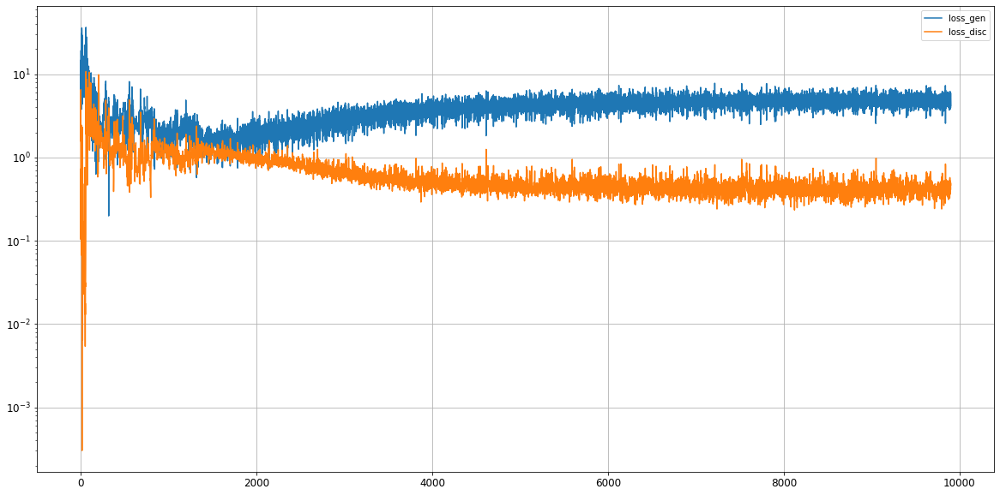

Epoch 9902/50000
0s
Epoch 9903/50000
0s
Epoch 9904/50000
0s
Epoch 9905/50000
0s
Epoch 9906/50000
0s
Epoch 9907/50000
0s
Epoch 9908/50000
0s
Epoch 9909/50000
0s
Epoch 9910/50000
0s
Epoch 9911/50000
0s
Epoch 9912/50000
0s
Epoch 9913/50000
0s
Epoch 9914/50000
0s
Epoch 9915/50000
0s
Epoch 9916/50000
0s
Epoch 9917/50000
0s
Epoch 9918/50000
0s
Epoch 9919/50000
0s
Epoch 9920/50000
0s
Epoch 9921/50000
0s
Epoch 9922/50000
0s
Epoch 9923/50000
0s
Epoch 9924/50000
0s
Epoch 9925/50000
0s
Epoch 9926/50000
0s
Epoch 9927/50000
0s
Epoch 9928/50000
0s
Epoch 9929/50000
0s
Epoch 9930/50000
0s
Epoch 9931/50000
0s
Epoch 9932/50000
0s
Epoch 9933/50000
0s
Epoch 9934/50000
0s
Epoch 9935/50000
0s
Epoch 9936/50000
0s
Epoch 9937/50000
0s
Epoch 9938/50000
0s
Epoch 9939/50000
0s
Epoch 9940/50000
0s
Epoch 9941/50000
0s
Epoch 9942/50000
0s
Epoch 9943/50000
0s
Epoch 9944/50000
0s
Epoch 9945/50000
0s
Epoch 9946/50000
0s
Epoch 9947/50000
0s
Epoch 9948/50000
0s
Epoch 9949/50000
0s
Epoch 9950/50000
0s
Epoch 9951/50000
0s


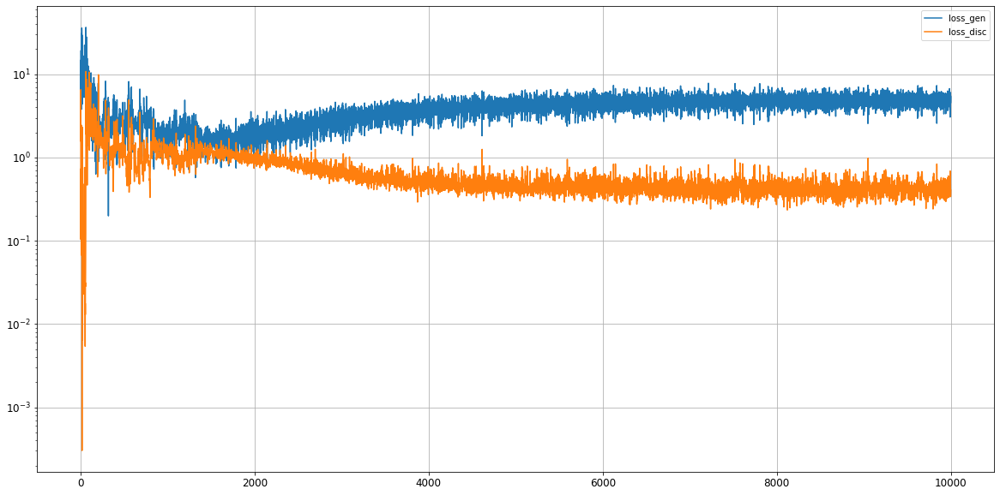

Epoch 10002/50000
0s
Epoch 10003/50000
0s
Epoch 10004/50000
0s
Epoch 10005/50000
0s
Epoch 10006/50000
0s
Epoch 10007/50000
0s
Epoch 10008/50000
0s
Epoch 10009/50000
0s
Epoch 10010/50000
0s
Epoch 10011/50000
0s
Epoch 10012/50000
0s
Epoch 10013/50000
0s
Epoch 10014/50000
0s
Epoch 10015/50000
0s
Epoch 10016/50000
0s
Epoch 10017/50000
0s
Epoch 10018/50000
0s
Epoch 10019/50000
0s
Epoch 10020/50000
0s
Epoch 10021/50000
0s
Epoch 10022/50000
0s
Epoch 10023/50000
0s
Epoch 10024/50000
0s
Epoch 10025/50000
0s
Epoch 10026/50000
0s
Epoch 10027/50000
0s
Epoch 10028/50000
0s
Epoch 10029/50000
0s
Epoch 10030/50000
0s
Epoch 10031/50000
0s
Epoch 10032/50000
0s
Epoch 10033/50000
0s
Epoch 10034/50000
0s
Epoch 10035/50000
0s
Epoch 10036/50000
0s
Epoch 10037/50000
0s
Epoch 10038/50000
0s
Epoch 10039/50000
0s
Epoch 10040/50000
0s
Epoch 10041/50000
0s
Epoch 10042/50000
0s
Epoch 10043/50000
0s
Epoch 10044/50000
0s
Epoch 10045/50000
0s
Epoch 10046/50000
0s
Epoch 10047/50000
0s
Epoch 10048/50000
0s
Epoch 10049/5

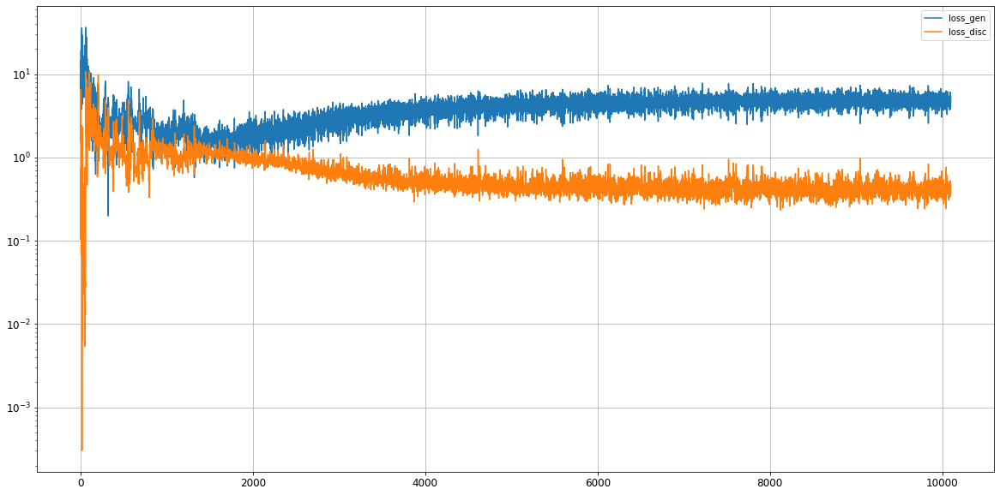

Epoch 10102/50000
0s
Epoch 10103/50000
0s
Epoch 10104/50000
0s
Epoch 10105/50000
0s
Epoch 10106/50000
0s
Epoch 10107/50000
0s
Epoch 10108/50000
0s
Epoch 10109/50000
0s
Epoch 10110/50000
0s
Epoch 10111/50000
0s
Epoch 10112/50000
0s
Epoch 10113/50000
0s
Epoch 10114/50000
0s
Epoch 10115/50000
0s
Epoch 10116/50000
0s
Epoch 10117/50000
0s
Epoch 10118/50000
0s
Epoch 10119/50000
0s
Epoch 10120/50000
0s
Epoch 10121/50000
0s
Epoch 10122/50000
0s
Epoch 10123/50000
0s
Epoch 10124/50000
0s
Epoch 10125/50000
0s
Epoch 10126/50000
0s
Epoch 10127/50000
0s
Epoch 10128/50000
0s
Epoch 10129/50000
0s
Epoch 10130/50000
0s
Epoch 10131/50000
0s
Epoch 10132/50000
0s
Epoch 10133/50000
0s
Epoch 10134/50000
0s
Epoch 10135/50000
0s
Epoch 10136/50000
0s
Epoch 10137/50000
0s
Epoch 10138/50000
0s
Epoch 10139/50000
0s
Epoch 10140/50000
0s
Epoch 10141/50000
0s
Epoch 10142/50000
0s
Epoch 10143/50000
0s
Epoch 10144/50000
0s
Epoch 10145/50000
0s
Epoch 10146/50000
0s
Epoch 10147/50000
0s
Epoch 10148/50000
0s
Epoch 10149/5

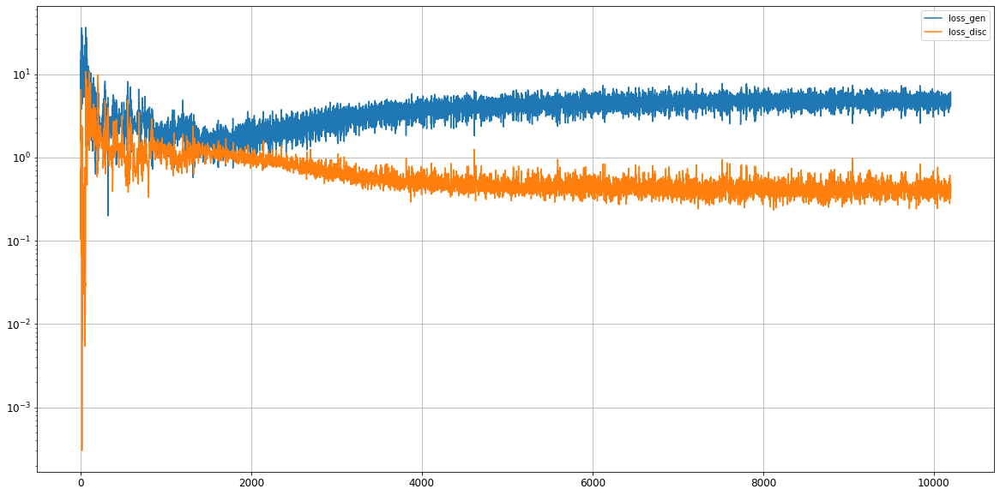

Epoch 10202/50000
0s
Epoch 10203/50000
0s
Epoch 10204/50000
0s
Epoch 10205/50000
0s
Epoch 10206/50000
0s
Epoch 10207/50000
0s
Epoch 10208/50000
0s
Epoch 10209/50000
0s
Epoch 10210/50000
0s
Epoch 10211/50000
0s
Epoch 10212/50000
0s
Epoch 10213/50000
0s
Epoch 10214/50000
0s
Epoch 10215/50000
0s
Epoch 10216/50000
0s
Epoch 10217/50000
0s
Epoch 10218/50000
0s
Epoch 10219/50000
0s
Epoch 10220/50000
0s
Epoch 10221/50000
0s
Epoch 10222/50000
0s
Epoch 10223/50000
0s
Epoch 10224/50000
0s
Epoch 10225/50000
0s
Epoch 10226/50000
0s
Epoch 10227/50000
0s
Epoch 10228/50000
0s
Epoch 10229/50000
0s
Epoch 10230/50000
0s
Epoch 10231/50000
0s
Epoch 10232/50000
0s
Epoch 10233/50000
0s
Epoch 10234/50000
0s
Epoch 10235/50000
0s
Epoch 10236/50000
0s
Epoch 10237/50000
0s
Epoch 10238/50000
0s
Epoch 10239/50000
0s
Epoch 10240/50000
0s
Epoch 10241/50000
0s
Epoch 10242/50000
0s
Epoch 10243/50000
0s
Epoch 10244/50000
0s
Epoch 10245/50000
0s
Epoch 10246/50000
0s
Epoch 10247/50000
0s
Epoch 10248/50000
0s
Epoch 10249/5

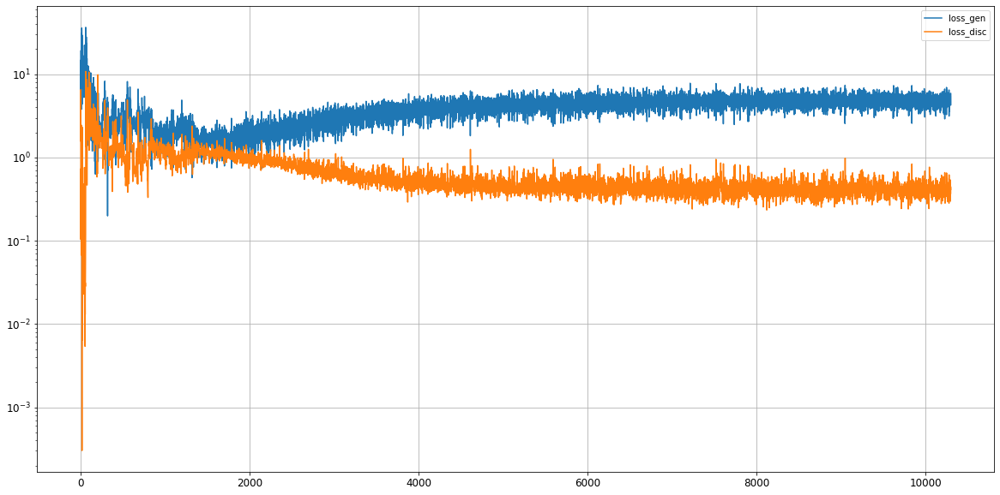

Epoch 10302/50000
0s
Epoch 10303/50000
0s
Epoch 10304/50000
0s
Epoch 10305/50000
0s
Epoch 10306/50000
0s
Epoch 10307/50000
0s
Epoch 10308/50000
0s
Epoch 10309/50000
0s
Epoch 10310/50000
0s
Epoch 10311/50000
0s
Epoch 10312/50000
0s
Epoch 10313/50000
0s
Epoch 10314/50000
0s
Epoch 10315/50000
0s
Epoch 10316/50000
0s
Epoch 10317/50000
0s
Epoch 10318/50000
0s
Epoch 10319/50000
0s
Epoch 10320/50000
0s
Epoch 10321/50000
0s
Epoch 10322/50000
0s
Epoch 10323/50000
0s
Epoch 10324/50000
0s
Epoch 10325/50000
0s
Epoch 10326/50000
0s
Epoch 10327/50000
0s
Epoch 10328/50000
0s
Epoch 10329/50000
0s
Epoch 10330/50000
0s
Epoch 10331/50000
0s
Epoch 10332/50000
0s
Epoch 10333/50000
0s
Epoch 10334/50000
0s
Epoch 10335/50000
0s
Epoch 10336/50000
0s
Epoch 10337/50000
0s
Epoch 10338/50000
0s
Epoch 10339/50000
0s
Epoch 10340/50000
0s
Epoch 10341/50000
0s
Epoch 10342/50000
0s
Epoch 10343/50000
0s
Epoch 10344/50000
0s
Epoch 10345/50000
0s
Epoch 10346/50000
0s
Epoch 10347/50000
0s
Epoch 10348/50000
0s
Epoch 10349/5

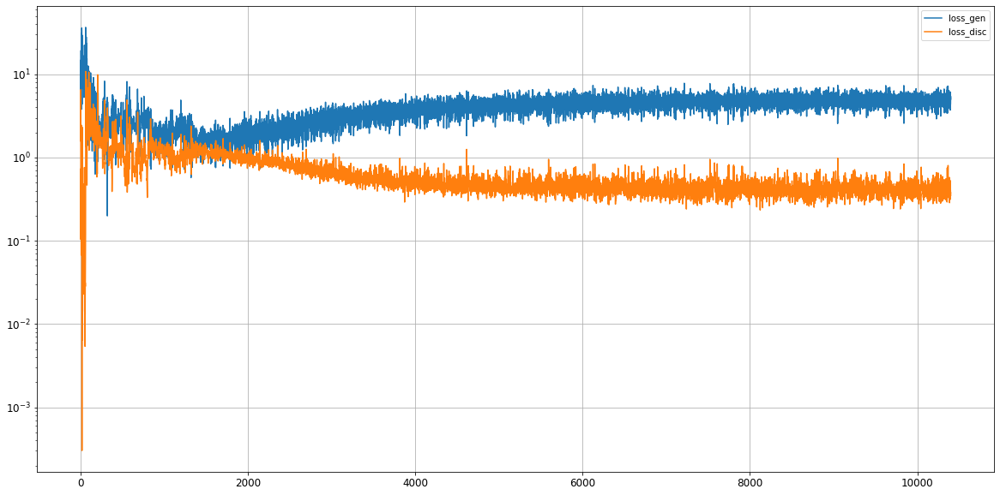

Epoch 10402/50000
0s
Epoch 10403/50000
0s
Epoch 10404/50000
0s
Epoch 10405/50000
0s
Epoch 10406/50000
0s
Epoch 10407/50000
0s
Epoch 10408/50000
0s
Epoch 10409/50000
0s
Epoch 10410/50000
0s
Epoch 10411/50000
0s
Epoch 10412/50000
0s
Epoch 10413/50000
0s
Epoch 10414/50000
0s
Epoch 10415/50000
0s
Epoch 10416/50000
0s
Epoch 10417/50000
0s
Epoch 10418/50000
0s
Epoch 10419/50000
0s
Epoch 10420/50000
0s
Epoch 10421/50000
0s
Epoch 10422/50000
0s
Epoch 10423/50000
0s
Epoch 10424/50000
0s
Epoch 10425/50000
0s
Epoch 10426/50000
0s
Epoch 10427/50000
0s
Epoch 10428/50000
0s
Epoch 10429/50000
0s
Epoch 10430/50000
0s
Epoch 10431/50000
0s
Epoch 10432/50000
0s
Epoch 10433/50000
0s
Epoch 10434/50000
0s
Epoch 10435/50000
0s
Epoch 10436/50000
0s
Epoch 10437/50000
0s
Epoch 10438/50000
0s
Epoch 10439/50000
0s
Epoch 10440/50000
0s
Epoch 10441/50000
0s
Epoch 10442/50000
0s
Epoch 10443/50000
0s
Epoch 10444/50000
0s
Epoch 10445/50000
0s
Epoch 10446/50000
0s
Epoch 10447/50000
0s
Epoch 10448/50000
0s
Epoch 10449/5

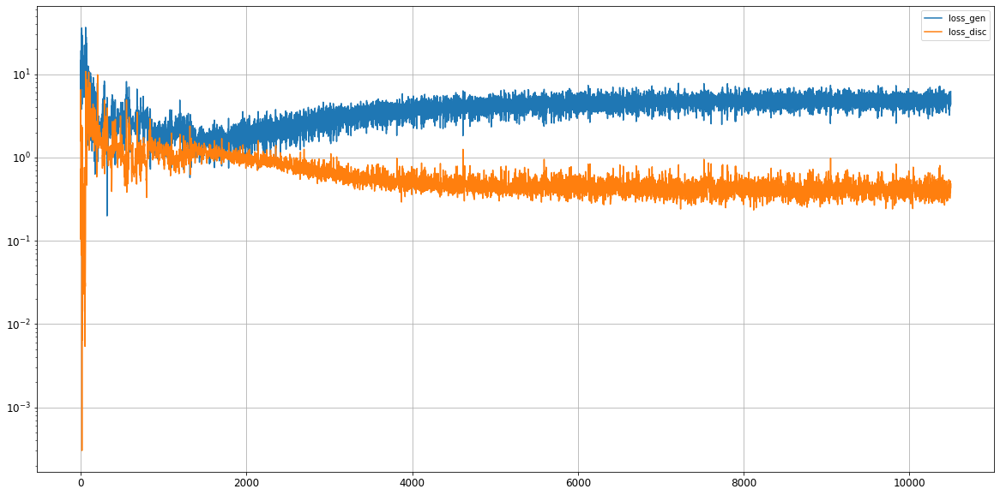

Epoch 10502/50000
0s
Epoch 10503/50000
0s
Epoch 10504/50000
0s
Epoch 10505/50000
0s
Epoch 10506/50000
0s
Epoch 10507/50000
0s
Epoch 10508/50000
0s
Epoch 10509/50000
0s
Epoch 10510/50000
0s
Epoch 10511/50000
0s
Epoch 10512/50000
0s
Epoch 10513/50000
0s
Epoch 10514/50000
0s
Epoch 10515/50000
0s
Epoch 10516/50000
0s
Epoch 10517/50000
0s
Epoch 10518/50000
0s
Epoch 10519/50000
0s
Epoch 10520/50000
0s
Epoch 10521/50000
0s
Epoch 10522/50000
0s
Epoch 10523/50000
0s
Epoch 10524/50000
0s
Epoch 10525/50000
0s
Epoch 10526/50000
0s
Epoch 10527/50000
0s
Epoch 10528/50000
0s
Epoch 10529/50000
0s
Epoch 10530/50000
0s
Epoch 10531/50000
0s
Epoch 10532/50000
0s
Epoch 10533/50000
0s
Epoch 10534/50000
0s
Epoch 10535/50000
0s
Epoch 10536/50000
0s
Epoch 10537/50000
0s
Epoch 10538/50000
0s
Epoch 10539/50000
0s
Epoch 10540/50000
0s
Epoch 10541/50000
0s
Epoch 10542/50000
0s
Epoch 10543/50000
0s
Epoch 10544/50000
0s
Epoch 10545/50000
0s
Epoch 10546/50000
0s
Epoch 10547/50000
0s
Epoch 10548/50000
0s
Epoch 10549/5

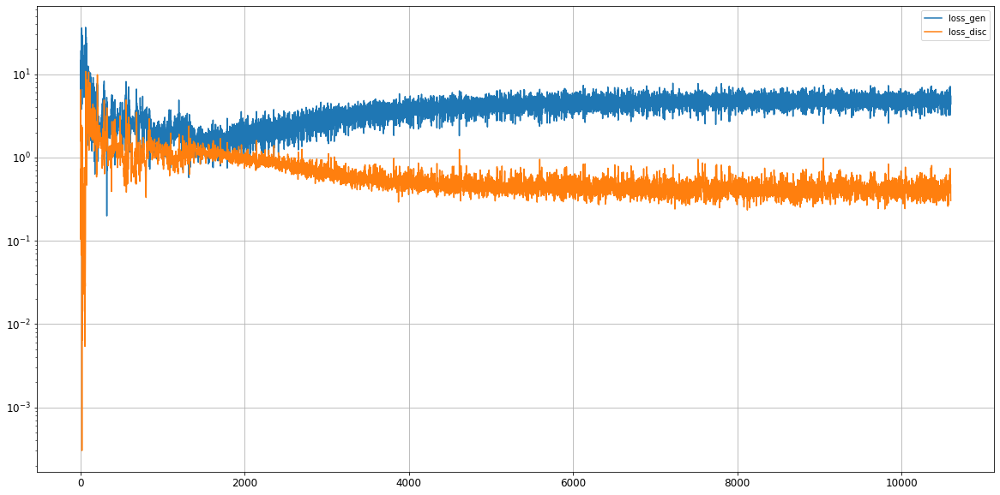

Epoch 10602/50000
0s
Epoch 10603/50000
0s
Epoch 10604/50000
0s
Epoch 10605/50000
0s
Epoch 10606/50000
0s
Epoch 10607/50000
0s
Epoch 10608/50000
0s
Epoch 10609/50000
0s
Epoch 10610/50000
0s
Epoch 10611/50000
0s
Epoch 10612/50000
0s
Epoch 10613/50000
0s
Epoch 10614/50000
0s
Epoch 10615/50000
0s
Epoch 10616/50000
0s
Epoch 10617/50000
0s
Epoch 10618/50000
0s
Epoch 10619/50000
0s
Epoch 10620/50000
0s
Epoch 10621/50000
0s
Epoch 10622/50000
0s
Epoch 10623/50000
0s
Epoch 10624/50000
0s
Epoch 10625/50000
0s
Epoch 10626/50000
0s
Epoch 10627/50000
0s
Epoch 10628/50000
0s
Epoch 10629/50000
0s
Epoch 10630/50000
0s
Epoch 10631/50000
0s
Epoch 10632/50000
0s
Epoch 10633/50000
0s
Epoch 10634/50000
0s
Epoch 10635/50000
0s
Epoch 10636/50000
0s
Epoch 10637/50000
0s
Epoch 10638/50000
0s
Epoch 10639/50000
0s
Epoch 10640/50000
0s
Epoch 10641/50000
0s
Epoch 10642/50000
0s
Epoch 10643/50000
0s
Epoch 10644/50000
0s
Epoch 10645/50000
0s
Epoch 10646/50000
0s
Epoch 10647/50000
0s
Epoch 10648/50000
0s
Epoch 10649/5

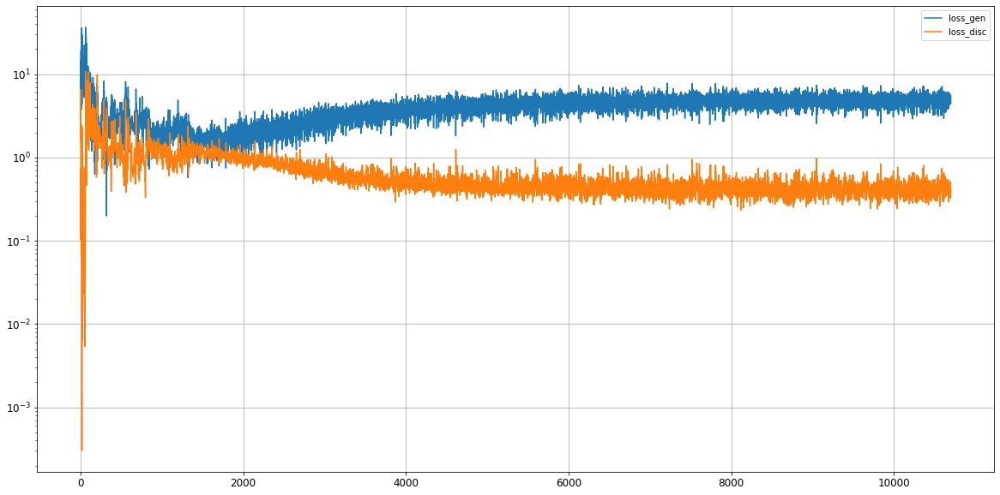

Epoch 10702/50000
0s
Epoch 10703/50000
0s
Epoch 10704/50000
0s
Epoch 10705/50000
0s
Epoch 10706/50000
0s
Epoch 10707/50000
0s
Epoch 10708/50000
0s
Epoch 10709/50000
0s
Epoch 10710/50000
0s
Epoch 10711/50000
0s
Epoch 10712/50000
0s
Epoch 10713/50000
0s
Epoch 10714/50000
0s
Epoch 10715/50000
0s
Epoch 10716/50000
0s
Epoch 10717/50000
0s
Epoch 10718/50000
0s
Epoch 10719/50000
0s
Epoch 10720/50000
0s
Epoch 10721/50000
0s
Epoch 10722/50000
0s
Epoch 10723/50000
0s
Epoch 10724/50000
0s
Epoch 10725/50000
0s
Epoch 10726/50000
0s
Epoch 10727/50000
0s
Epoch 10728/50000
0s
Epoch 10729/50000
0s
Epoch 10730/50000
0s
Epoch 10731/50000
0s
Epoch 10732/50000
0s
Epoch 10733/50000
0s
Epoch 10734/50000
0s
Epoch 10735/50000
0s
Epoch 10736/50000
0s
Epoch 10737/50000
0s
Epoch 10738/50000
0s
Epoch 10739/50000
0s
Epoch 10740/50000
0s
Epoch 10741/50000
0s
Epoch 10742/50000
0s
Epoch 10743/50000
0s
Epoch 10744/50000
0s
Epoch 10745/50000
0s
Epoch 10746/50000
0s
Epoch 10747/50000
0s
Epoch 10748/50000
0s
Epoch 10749/5

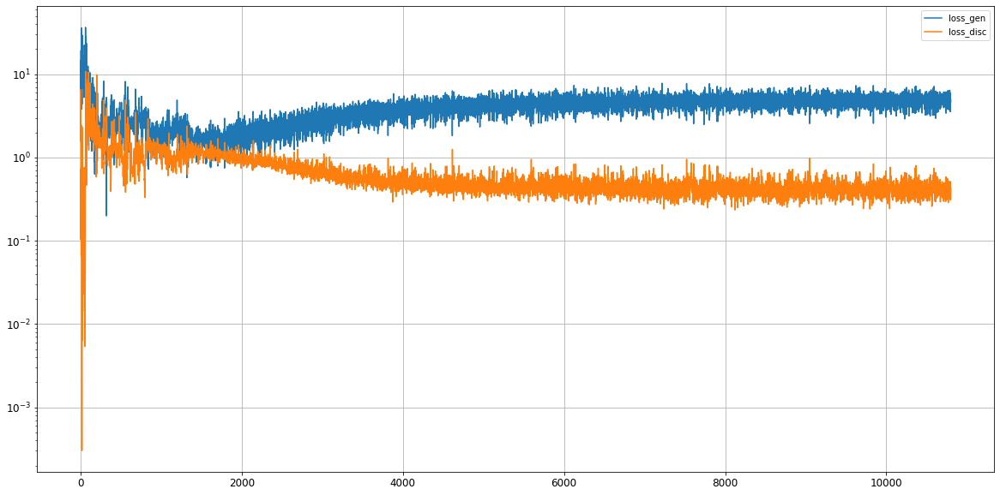

Epoch 10802/50000
0s
Epoch 10803/50000
0s
Epoch 10804/50000
0s
Epoch 10805/50000
0s
Epoch 10806/50000
0s
Epoch 10807/50000
0s
Epoch 10808/50000
0s
Epoch 10809/50000
0s
Epoch 10810/50000
0s
Epoch 10811/50000
0s
Epoch 10812/50000
0s
Epoch 10813/50000
0s
Epoch 10814/50000
0s
Epoch 10815/50000
0s
Epoch 10816/50000
0s
Epoch 10817/50000
0s
Epoch 10818/50000
0s
Epoch 10819/50000
0s
Epoch 10820/50000
0s
Epoch 10821/50000
0s
Epoch 10822/50000
0s
Epoch 10823/50000
0s
Epoch 10824/50000
0s
Epoch 10825/50000
0s
Epoch 10826/50000
0s
Epoch 10827/50000
0s
Epoch 10828/50000
0s
Epoch 10829/50000
0s
Epoch 10830/50000
0s
Epoch 10831/50000
0s
Epoch 10832/50000
0s
Epoch 10833/50000
0s
Epoch 10834/50000
0s
Epoch 10835/50000
0s
Epoch 10836/50000
0s
Epoch 10837/50000
0s
Epoch 10838/50000
0s
Epoch 10839/50000
0s
Epoch 10840/50000
0s
Epoch 10841/50000
0s
Epoch 10842/50000
0s
Epoch 10843/50000
0s
Epoch 10844/50000
0s
Epoch 10845/50000
0s
Epoch 10846/50000
0s
Epoch 10847/50000
0s
Epoch 10848/50000
0s
Epoch 10849/5

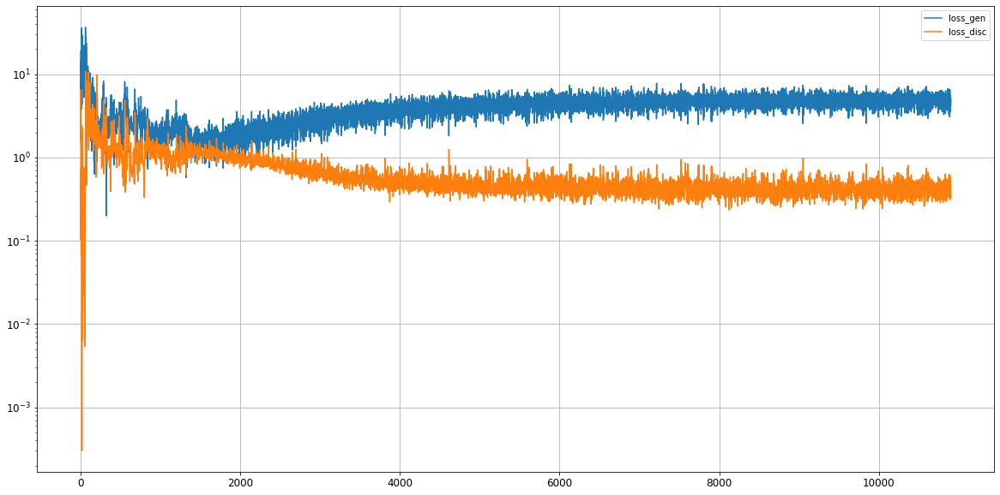

Epoch 10902/50000
0s
Epoch 10903/50000
0s
Epoch 10904/50000
0s
Epoch 10905/50000
0s
Epoch 10906/50000
0s
Epoch 10907/50000
0s
Epoch 10908/50000
0s
Epoch 10909/50000
0s
Epoch 10910/50000
0s
Epoch 10911/50000
0s
Epoch 10912/50000
0s
Epoch 10913/50000
0s
Epoch 10914/50000
0s
Epoch 10915/50000
0s
Epoch 10916/50000
0s
Epoch 10917/50000
0s
Epoch 10918/50000
0s
Epoch 10919/50000
0s
Epoch 10920/50000
0s
Epoch 10921/50000
0s
Epoch 10922/50000
0s
Epoch 10923/50000
0s
Epoch 10924/50000
0s
Epoch 10925/50000
0s
Epoch 10926/50000
0s
Epoch 10927/50000
0s
Epoch 10928/50000
0s
Epoch 10929/50000
0s
Epoch 10930/50000
0s
Epoch 10931/50000
0s
Epoch 10932/50000
0s
Epoch 10933/50000
0s
Epoch 10934/50000
0s
Epoch 10935/50000
0s
Epoch 10936/50000
0s
Epoch 10937/50000
0s
Epoch 10938/50000
0s
Epoch 10939/50000
0s
Epoch 10940/50000
0s
Epoch 10941/50000
0s
Epoch 10942/50000
0s
Epoch 10943/50000
0s
Epoch 10944/50000
0s
Epoch 10945/50000
0s
Epoch 10946/50000
0s
Epoch 10947/50000
0s
Epoch 10948/50000
0s
Epoch 10949/5

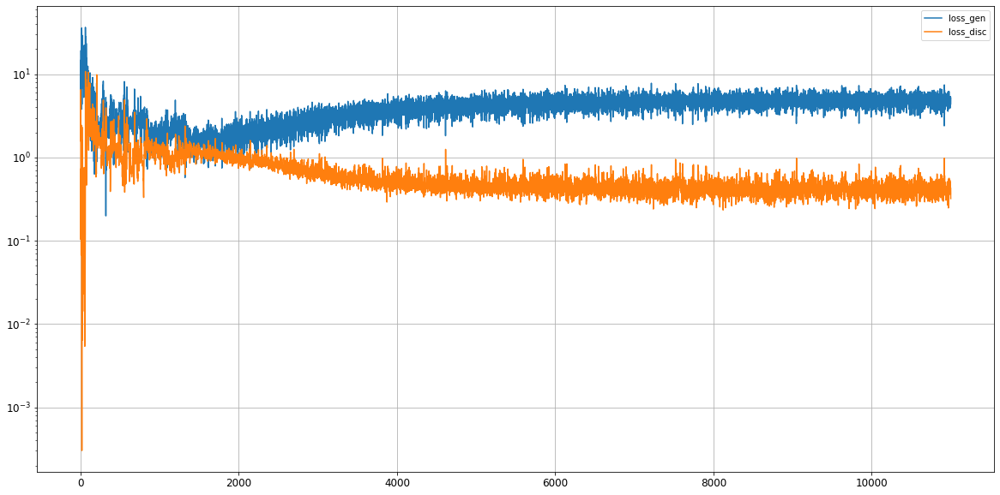

Epoch 11002/50000
0s
Epoch 11003/50000
0s
Epoch 11004/50000
0s
Epoch 11005/50000
0s
Epoch 11006/50000
0s
Epoch 11007/50000
0s
Epoch 11008/50000
0s
Epoch 11009/50000
0s
Epoch 11010/50000
0s
Epoch 11011/50000
0s
Epoch 11012/50000
0s
Epoch 11013/50000
0s
Epoch 11014/50000
0s
Epoch 11015/50000
0s
Epoch 11016/50000
0s
Epoch 11017/50000
0s
Epoch 11018/50000
0s
Epoch 11019/50000
0s
Epoch 11020/50000
0s
Epoch 11021/50000
0s
Epoch 11022/50000
0s
Epoch 11023/50000
0s
Epoch 11024/50000
0s
Epoch 11025/50000
0s
Epoch 11026/50000
0s
Epoch 11027/50000
0s
Epoch 11028/50000
0s
Epoch 11029/50000
0s
Epoch 11030/50000
0s
Epoch 11031/50000
0s
Epoch 11032/50000
0s
Epoch 11033/50000
0s
Epoch 11034/50000
0s
Epoch 11035/50000
0s
Epoch 11036/50000
0s
Epoch 11037/50000
0s
Epoch 11038/50000
0s
Epoch 11039/50000
0s
Epoch 11040/50000
0s
Epoch 11041/50000
0s
Epoch 11042/50000
0s
Epoch 11043/50000
0s
Epoch 11044/50000
0s
Epoch 11045/50000
0s
Epoch 11046/50000
0s
Epoch 11047/50000
0s
Epoch 11048/50000
0s
Epoch 11049/5

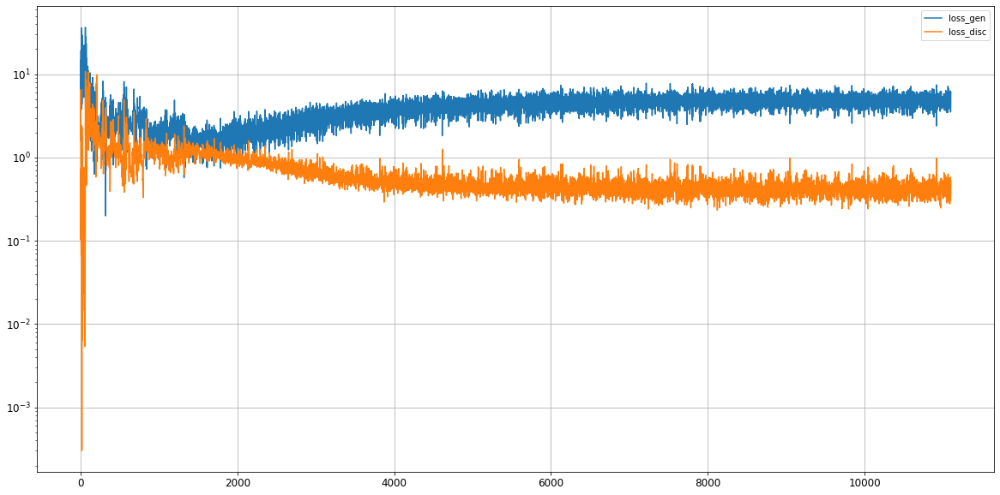

Epoch 11102/50000
0s
Epoch 11103/50000
0s
Epoch 11104/50000
0s
Epoch 11105/50000
0s
Epoch 11106/50000
0s
Epoch 11107/50000
0s
Epoch 11108/50000
0s
Epoch 11109/50000
0s
Epoch 11110/50000
0s
Epoch 11111/50000
0s
Epoch 11112/50000
0s
Epoch 11113/50000
0s
Epoch 11114/50000
0s
Epoch 11115/50000
0s
Epoch 11116/50000
0s
Epoch 11117/50000
0s
Epoch 11118/50000
0s
Epoch 11119/50000
0s
Epoch 11120/50000
0s
Epoch 11121/50000
0s
Epoch 11122/50000
0s
Epoch 11123/50000
0s
Epoch 11124/50000
0s
Epoch 11125/50000
0s
Epoch 11126/50000
0s
Epoch 11127/50000
0s
Epoch 11128/50000
0s
Epoch 11129/50000
0s
Epoch 11130/50000
0s
Epoch 11131/50000
0s
Epoch 11132/50000
0s
Epoch 11133/50000
0s
Epoch 11134/50000
0s
Epoch 11135/50000
0s
Epoch 11136/50000
0s
Epoch 11137/50000
0s
Epoch 11138/50000
0s
Epoch 11139/50000
0s
Epoch 11140/50000
0s
Epoch 11141/50000
0s
Epoch 11142/50000
0s
Epoch 11143/50000
0s
Epoch 11144/50000
0s
Epoch 11145/50000
0s
Epoch 11146/50000
0s
Epoch 11147/50000
0s
Epoch 11148/50000
0s
Epoch 11149/5

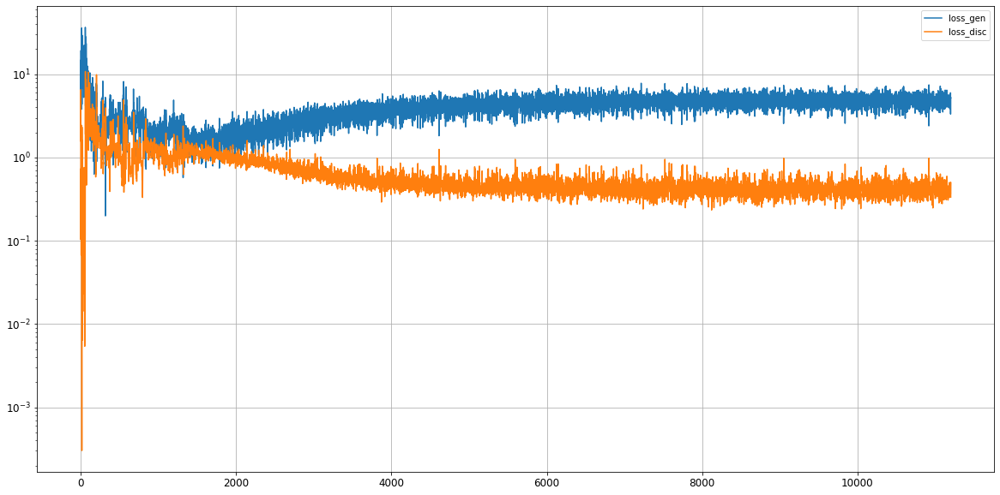

Epoch 11202/50000
0s
Epoch 11203/50000
0s
Epoch 11204/50000
0s
Epoch 11205/50000
0s
Epoch 11206/50000
0s
Epoch 11207/50000
0s
Epoch 11208/50000
0s
Epoch 11209/50000
0s
Epoch 11210/50000
0s
Epoch 11211/50000
0s
Epoch 11212/50000
0s
Epoch 11213/50000
0s
Epoch 11214/50000
0s
Epoch 11215/50000
0s
Epoch 11216/50000
0s
Epoch 11217/50000
0s
Epoch 11218/50000
0s
Epoch 11219/50000
0s
Epoch 11220/50000
0s
Epoch 11221/50000
0s
Epoch 11222/50000
0s
Epoch 11223/50000
0s
Epoch 11224/50000
0s
Epoch 11225/50000
0s
Epoch 11226/50000
0s
Epoch 11227/50000
0s
Epoch 11228/50000
0s
Epoch 11229/50000
0s
Epoch 11230/50000
0s
Epoch 11231/50000
0s
Epoch 11232/50000
0s
Epoch 11233/50000
0s
Epoch 11234/50000
0s
Epoch 11235/50000
0s
Epoch 11236/50000
0s
Epoch 11237/50000
0s
Epoch 11238/50000
0s
Epoch 11239/50000
0s
Epoch 11240/50000
0s
Epoch 11241/50000
0s
Epoch 11242/50000
0s
Epoch 11243/50000
0s
Epoch 11244/50000
0s
Epoch 11245/50000
0s
Epoch 11246/50000
0s
Epoch 11247/50000
0s
Epoch 11248/50000
0s
Epoch 11249/5

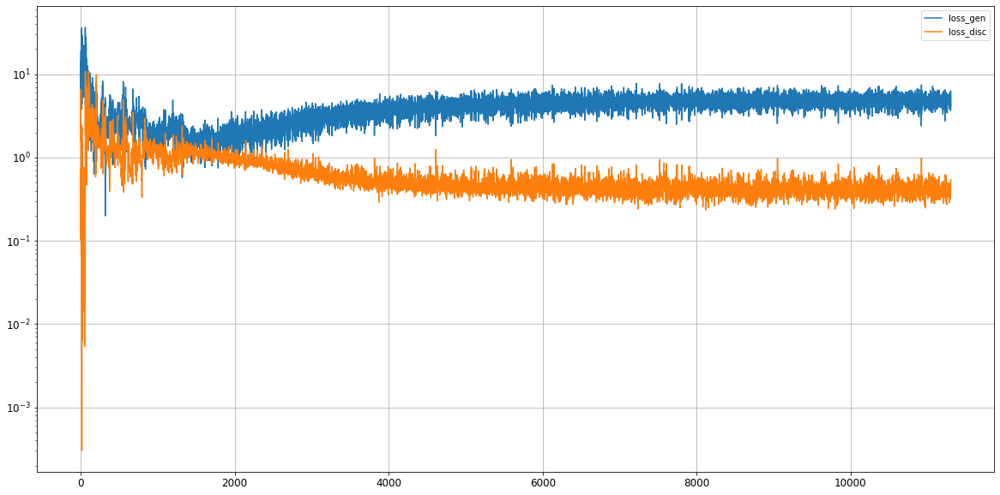

Epoch 11302/50000
0s
Epoch 11303/50000
0s
Epoch 11304/50000
0s
Epoch 11305/50000
0s
Epoch 11306/50000
0s
Epoch 11307/50000
0s
Epoch 11308/50000
0s
Epoch 11309/50000
0s
Epoch 11310/50000
0s
Epoch 11311/50000
0s
Epoch 11312/50000
0s
Epoch 11313/50000
0s
Epoch 11314/50000
0s
Epoch 11315/50000
0s
Epoch 11316/50000
0s
Epoch 11317/50000
0s
Epoch 11318/50000
0s
Epoch 11319/50000
0s
Epoch 11320/50000
0s
Epoch 11321/50000
0s
Epoch 11322/50000
0s
Epoch 11323/50000
0s
Epoch 11324/50000
0s
Epoch 11325/50000
0s
Epoch 11326/50000
0s
Epoch 11327/50000
0s
Epoch 11328/50000
0s
Epoch 11329/50000
0s
Epoch 11330/50000
0s
Epoch 11331/50000
0s
Epoch 11332/50000
0s
Epoch 11333/50000
0s
Epoch 11334/50000
0s
Epoch 11335/50000
0s
Epoch 11336/50000
0s
Epoch 11337/50000
0s
Epoch 11338/50000
0s
Epoch 11339/50000
0s
Epoch 11340/50000
0s
Epoch 11341/50000
0s
Epoch 11342/50000
0s
Epoch 11343/50000
0s
Epoch 11344/50000
0s
Epoch 11345/50000
0s
Epoch 11346/50000
0s
Epoch 11347/50000
0s
Epoch 11348/50000
0s
Epoch 11349/5

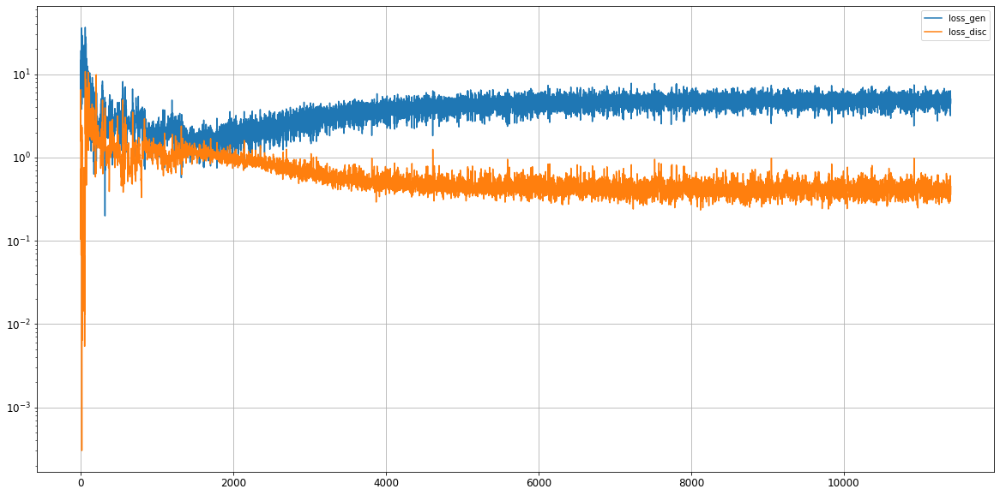

Epoch 11402/50000
0s
Epoch 11403/50000
0s
Epoch 11404/50000
0s
Epoch 11405/50000
0s
Epoch 11406/50000
0s
Epoch 11407/50000
0s
Epoch 11408/50000
0s
Epoch 11409/50000
0s
Epoch 11410/50000
0s
Epoch 11411/50000
0s
Epoch 11412/50000
0s
Epoch 11413/50000
0s
Epoch 11414/50000
0s
Epoch 11415/50000
0s
Epoch 11416/50000
0s
Epoch 11417/50000
0s
Epoch 11418/50000
0s
Epoch 11419/50000
0s
Epoch 11420/50000
0s
Epoch 11421/50000
0s
Epoch 11422/50000
0s
Epoch 11423/50000
0s
Epoch 11424/50000
0s
Epoch 11425/50000
0s
Epoch 11426/50000
0s
Epoch 11427/50000
0s
Epoch 11428/50000
0s
Epoch 11429/50000
0s
Epoch 11430/50000
0s
Epoch 11431/50000
0s
Epoch 11432/50000
0s
Epoch 11433/50000
0s
Epoch 11434/50000
0s
Epoch 11435/50000
0s
Epoch 11436/50000
0s
Epoch 11437/50000
0s
Epoch 11438/50000
0s
Epoch 11439/50000
0s
Epoch 11440/50000
0s
Epoch 11441/50000
0s
Epoch 11442/50000
0s
Epoch 11443/50000
0s
Epoch 11444/50000
0s
Epoch 11445/50000
0s
Epoch 11446/50000
0s
Epoch 11447/50000
0s
Epoch 11448/50000
0s
Epoch 11449/5

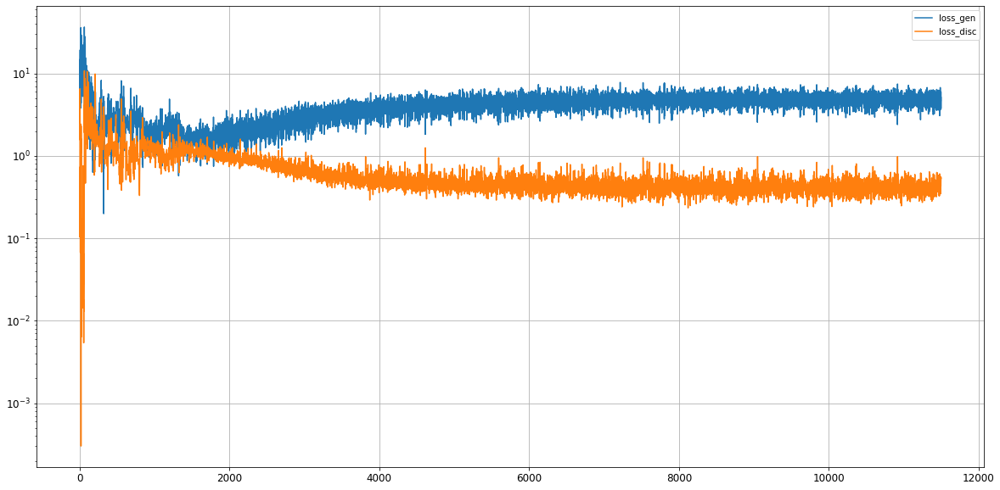

Epoch 11502/50000
0s
Epoch 11503/50000
0s
Epoch 11504/50000
0s
Epoch 11505/50000
0s
Epoch 11506/50000
0s
Epoch 11507/50000
0s
Epoch 11508/50000
0s
Epoch 11509/50000
0s
Epoch 11510/50000
0s
Epoch 11511/50000
0s
Epoch 11512/50000
0s
Epoch 11513/50000
0s
Epoch 11514/50000
0s
Epoch 11515/50000
0s
Epoch 11516/50000
0s
Epoch 11517/50000
0s
Epoch 11518/50000
0s
Epoch 11519/50000
0s
Epoch 11520/50000
0s
Epoch 11521/50000
0s
Epoch 11522/50000
0s
Epoch 11523/50000
0s
Epoch 11524/50000
0s
Epoch 11525/50000
0s
Epoch 11526/50000
0s
Epoch 11527/50000
0s
Epoch 11528/50000
0s
Epoch 11529/50000
0s
Epoch 11530/50000
0s
Epoch 11531/50000
0s
Epoch 11532/50000
0s
Epoch 11533/50000
0s
Epoch 11534/50000
0s
Epoch 11535/50000
0s
Epoch 11536/50000
0s
Epoch 11537/50000
0s
Epoch 11538/50000
0s
Epoch 11539/50000
0s
Epoch 11540/50000
0s
Epoch 11541/50000
0s
Epoch 11542/50000
0s
Epoch 11543/50000
0s
Epoch 11544/50000
0s
Epoch 11545/50000
0s
Epoch 11546/50000
0s
Epoch 11547/50000
0s
Epoch 11548/50000
0s
Epoch 11549/5

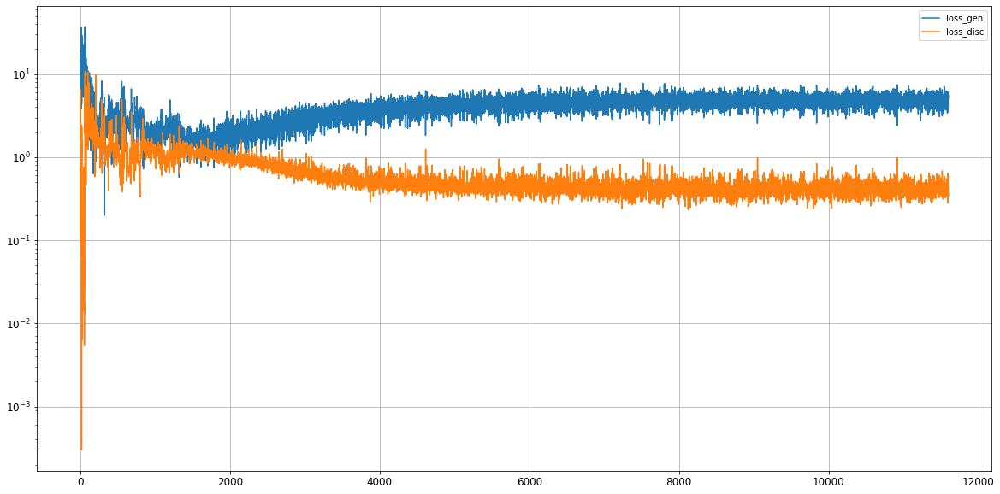

Epoch 11602/50000
0s
Epoch 11603/50000
0s
Epoch 11604/50000
0s
Epoch 11605/50000
0s
Epoch 11606/50000
0s
Epoch 11607/50000
0s
Epoch 11608/50000
0s
Epoch 11609/50000
0s
Epoch 11610/50000
0s
Epoch 11611/50000
0s
Epoch 11612/50000
0s
Epoch 11613/50000
0s
Epoch 11614/50000
0s
Epoch 11615/50000
0s
Epoch 11616/50000
0s
Epoch 11617/50000
0s
Epoch 11618/50000
0s
Epoch 11619/50000
0s
Epoch 11620/50000
0s
Epoch 11621/50000
0s
Epoch 11622/50000
0s
Epoch 11623/50000
0s
Epoch 11624/50000
0s
Epoch 11625/50000
0s
Epoch 11626/50000
0s
Epoch 11627/50000
0s
Epoch 11628/50000
0s
Epoch 11629/50000
0s
Epoch 11630/50000
0s
Epoch 11631/50000
0s
Epoch 11632/50000
0s
Epoch 11633/50000
0s
Epoch 11634/50000
0s
Epoch 11635/50000
0s
Epoch 11636/50000
0s
Epoch 11637/50000
0s
Epoch 11638/50000
0s
Epoch 11639/50000
0s
Epoch 11640/50000
0s
Epoch 11641/50000
0s
Epoch 11642/50000
0s
Epoch 11643/50000
0s
Epoch 11644/50000
0s
Epoch 11645/50000
0s
Epoch 11646/50000
0s
Epoch 11647/50000
0s
Epoch 11648/50000
0s
Epoch 11649/5

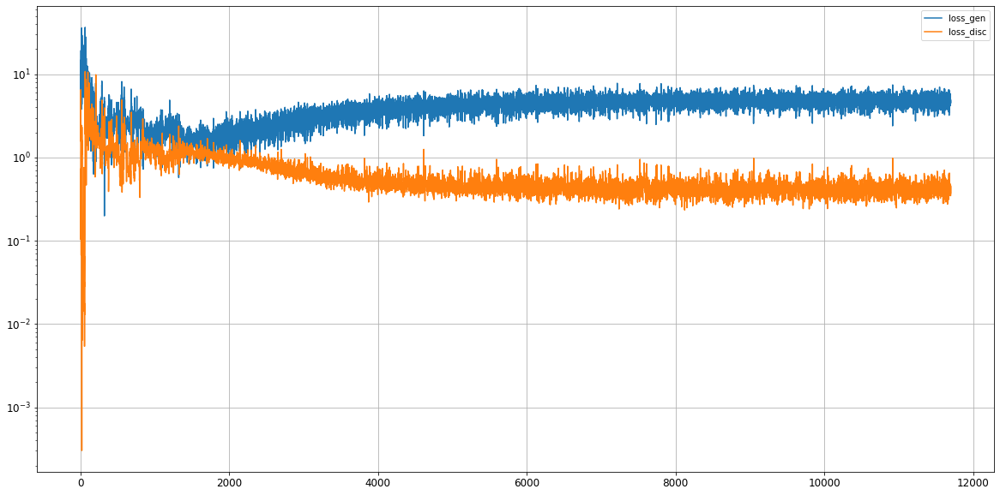

Epoch 11702/50000
0s
Epoch 11703/50000
0s
Epoch 11704/50000
0s
Epoch 11705/50000
0s
Epoch 11706/50000
0s
Epoch 11707/50000
0s
Epoch 11708/50000
0s
Epoch 11709/50000
0s
Epoch 11710/50000
0s
Epoch 11711/50000
0s
Epoch 11712/50000
0s
Epoch 11713/50000
0s
Epoch 11714/50000
0s
Epoch 11715/50000
0s
Epoch 11716/50000
0s
Epoch 11717/50000
0s
Epoch 11718/50000
0s
Epoch 11719/50000
0s
Epoch 11720/50000
0s
Epoch 11721/50000
0s
Epoch 11722/50000
0s
Epoch 11723/50000
0s
Epoch 11724/50000
0s
Epoch 11725/50000
0s
Epoch 11726/50000
0s
Epoch 11727/50000
0s
Epoch 11728/50000
0s
Epoch 11729/50000
0s
Epoch 11730/50000
0s
Epoch 11731/50000
0s
Epoch 11732/50000
0s
Epoch 11733/50000
0s
Epoch 11734/50000
0s
Epoch 11735/50000
0s
Epoch 11736/50000
0s
Epoch 11737/50000
0s
Epoch 11738/50000
0s
Epoch 11739/50000
0s
Epoch 11740/50000
0s
Epoch 11741/50000
0s
Epoch 11742/50000
0s
Epoch 11743/50000
0s
Epoch 11744/50000
0s
Epoch 11745/50000
0s
Epoch 11746/50000
0s
Epoch 11747/50000
0s
Epoch 11748/50000
0s
Epoch 11749/5

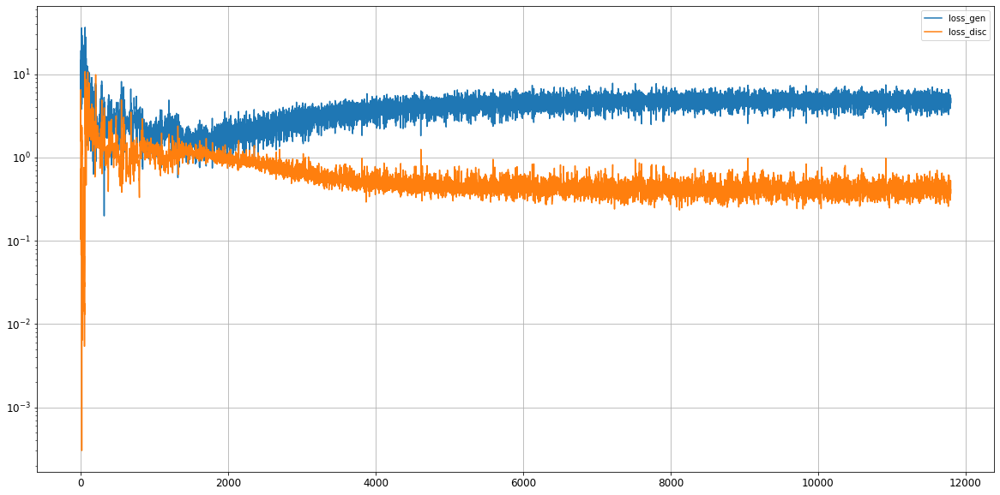

Epoch 11802/50000
0s
Epoch 11803/50000
0s
Epoch 11804/50000
0s
Epoch 11805/50000
0s
Epoch 11806/50000
0s
Epoch 11807/50000
0s
Epoch 11808/50000
0s
Epoch 11809/50000
0s
Epoch 11810/50000
0s
Epoch 11811/50000
0s
Epoch 11812/50000
0s
Epoch 11813/50000
0s
Epoch 11814/50000
0s
Epoch 11815/50000
0s
Epoch 11816/50000
0s
Epoch 11817/50000
0s
Epoch 11818/50000
0s
Epoch 11819/50000
0s
Epoch 11820/50000
0s
Epoch 11821/50000
0s
Epoch 11822/50000
0s
Epoch 11823/50000
0s
Epoch 11824/50000
0s
Epoch 11825/50000
0s
Epoch 11826/50000
0s
Epoch 11827/50000
0s
Epoch 11828/50000
0s
Epoch 11829/50000
0s
Epoch 11830/50000
0s
Epoch 11831/50000
0s
Epoch 11832/50000
0s
Epoch 11833/50000
0s
Epoch 11834/50000
0s
Epoch 11835/50000
0s
Epoch 11836/50000
0s
Epoch 11837/50000
0s
Epoch 11838/50000
0s
Epoch 11839/50000
0s
Epoch 11840/50000
0s
Epoch 11841/50000
0s
Epoch 11842/50000
0s
Epoch 11843/50000
0s
Epoch 11844/50000
0s
Epoch 11845/50000
0s
Epoch 11846/50000
0s
Epoch 11847/50000
0s
Epoch 11848/50000
0s
Epoch 11849/5

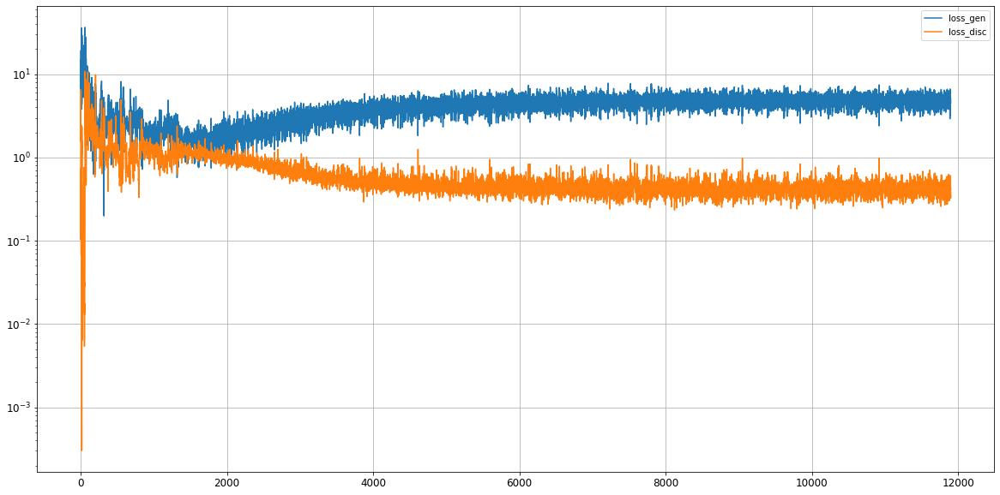

Epoch 11902/50000
0s
Epoch 11903/50000
0s
Epoch 11904/50000
0s
Epoch 11905/50000
0s
Epoch 11906/50000
0s
Epoch 11907/50000
0s
Epoch 11908/50000
0s
Epoch 11909/50000
0s
Epoch 11910/50000
0s
Epoch 11911/50000
0s
Epoch 11912/50000
0s
Epoch 11913/50000
0s
Epoch 11914/50000
0s
Epoch 11915/50000
0s
Epoch 11916/50000
0s
Epoch 11917/50000
0s
Epoch 11918/50000
0s
Epoch 11919/50000
0s
Epoch 11920/50000
0s
Epoch 11921/50000
0s
Epoch 11922/50000
0s
Epoch 11923/50000
0s
Epoch 11924/50000
0s
Epoch 11925/50000
0s
Epoch 11926/50000
0s
Epoch 11927/50000
0s
Epoch 11928/50000
0s
Epoch 11929/50000
0s
Epoch 11930/50000
0s
Epoch 11931/50000
0s
Epoch 11932/50000
0s
Epoch 11933/50000
0s
Epoch 11934/50000
0s
Epoch 11935/50000
0s
Epoch 11936/50000
0s
Epoch 11937/50000
0s
Epoch 11938/50000
0s
Epoch 11939/50000
0s
Epoch 11940/50000
0s
Epoch 11941/50000
0s
Epoch 11942/50000
0s
Epoch 11943/50000
0s
Epoch 11944/50000
0s
Epoch 11945/50000
0s
Epoch 11946/50000
0s
Epoch 11947/50000
0s
Epoch 11948/50000
0s
Epoch 11949/5

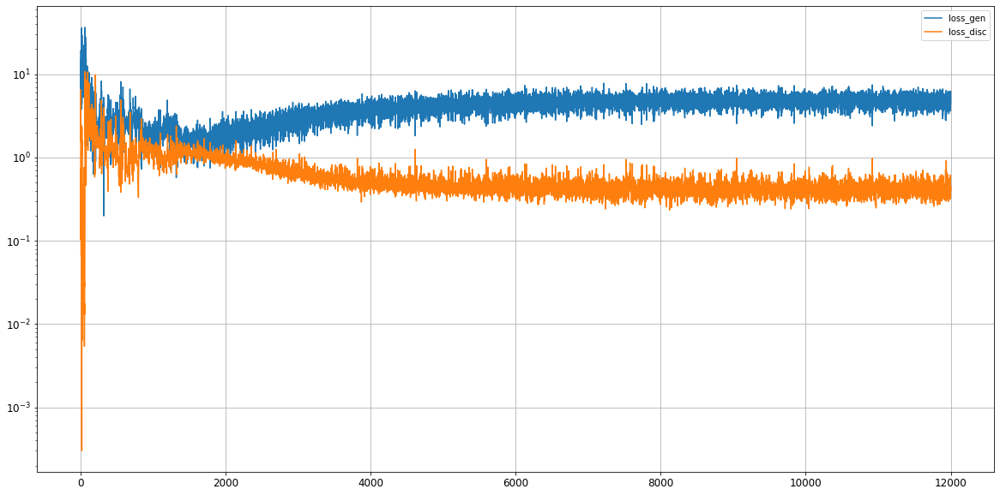

Epoch 12002/50000
0s
Epoch 12003/50000
0s
Epoch 12004/50000
0s
Epoch 12005/50000
0s
Epoch 12006/50000
0s
Epoch 12007/50000
0s
Epoch 12008/50000
0s
Epoch 12009/50000
0s
Epoch 12010/50000
0s
Epoch 12011/50000
0s
Epoch 12012/50000
0s
Epoch 12013/50000
0s
Epoch 12014/50000
0s
Epoch 12015/50000
0s
Epoch 12016/50000
0s
Epoch 12017/50000
0s
Epoch 12018/50000
0s
Epoch 12019/50000
0s
Epoch 12020/50000
0s
Epoch 12021/50000
0s
Epoch 12022/50000
0s
Epoch 12023/50000
0s
Epoch 12024/50000
0s
Epoch 12025/50000
0s
Epoch 12026/50000
0s
Epoch 12027/50000
0s
Epoch 12028/50000
0s
Epoch 12029/50000
0s
Epoch 12030/50000
0s
Epoch 12031/50000
0s
Epoch 12032/50000
0s
Epoch 12033/50000
0s
Epoch 12034/50000
0s
Epoch 12035/50000
0s
Epoch 12036/50000
0s
Epoch 12037/50000
0s
Epoch 12038/50000
0s
Epoch 12039/50000
0s
Epoch 12040/50000
0s
Epoch 12041/50000
0s
Epoch 12042/50000
0s
Epoch 12043/50000
0s
Epoch 12044/50000
0s
Epoch 12045/50000
0s
Epoch 12046/50000
0s
Epoch 12047/50000
0s
Epoch 12048/50000
0s
Epoch 12049/5

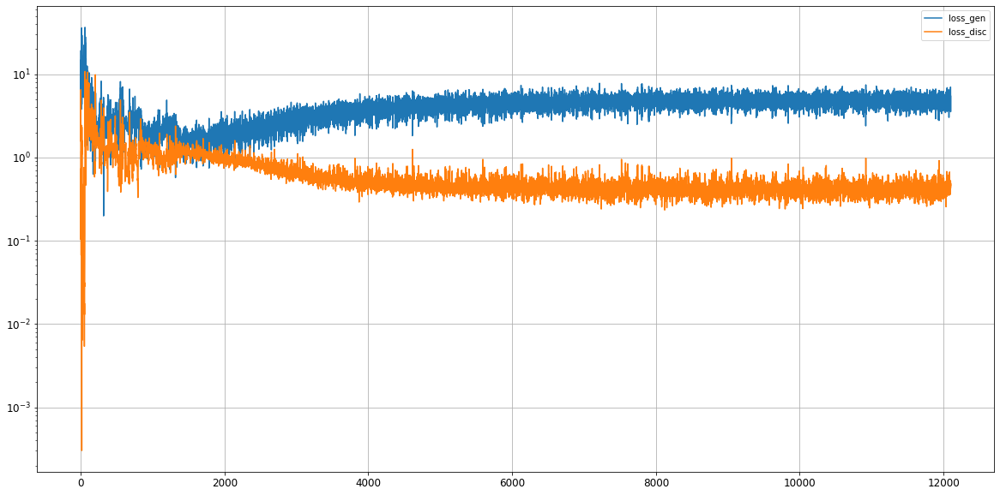

Epoch 12102/50000
0s
Epoch 12103/50000
0s
Epoch 12104/50000
0s
Epoch 12105/50000
0s
Epoch 12106/50000
0s
Epoch 12107/50000
0s
Epoch 12108/50000
0s
Epoch 12109/50000
0s
Epoch 12110/50000
0s
Epoch 12111/50000
0s
Epoch 12112/50000
0s
Epoch 12113/50000
0s
Epoch 12114/50000
0s
Epoch 12115/50000
0s
Epoch 12116/50000
0s
Epoch 12117/50000
0s
Epoch 12118/50000
0s
Epoch 12119/50000
0s
Epoch 12120/50000
0s
Epoch 12121/50000
0s
Epoch 12122/50000
0s
Epoch 12123/50000
0s
Epoch 12124/50000
0s
Epoch 12125/50000
0s
Epoch 12126/50000
0s
Epoch 12127/50000
0s
Epoch 12128/50000
0s
Epoch 12129/50000
0s
Epoch 12130/50000
0s
Epoch 12131/50000
0s
Epoch 12132/50000
0s
Epoch 12133/50000
0s
Epoch 12134/50000
0s
Epoch 12135/50000
0s
Epoch 12136/50000
0s
Epoch 12137/50000
0s
Epoch 12138/50000
0s
Epoch 12139/50000
0s
Epoch 12140/50000
0s
Epoch 12141/50000
0s
Epoch 12142/50000
0s
Epoch 12143/50000
0s
Epoch 12144/50000
0s
Epoch 12145/50000
0s
Epoch 12146/50000
0s
Epoch 12147/50000
0s
Epoch 12148/50000
0s
Epoch 12149/5

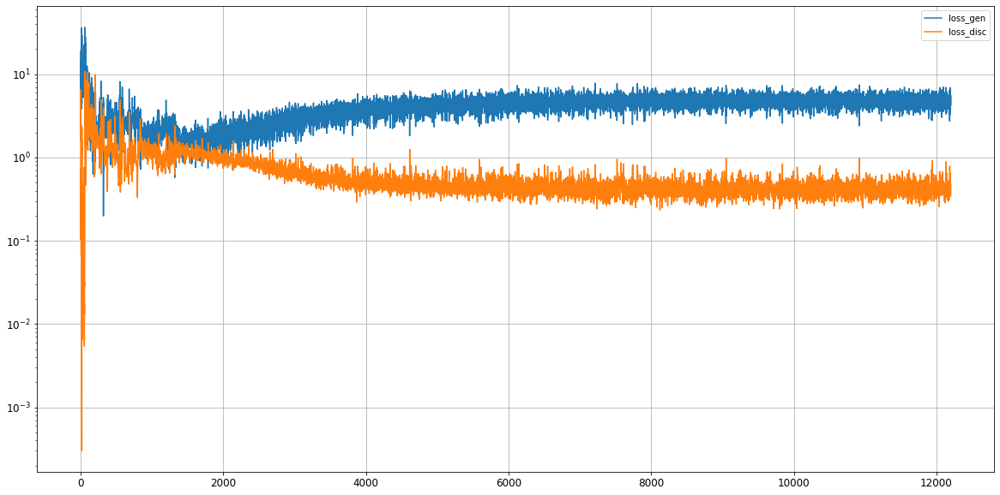

Epoch 12202/50000
0s
Epoch 12203/50000
0s
Epoch 12204/50000
0s
Epoch 12205/50000
0s
Epoch 12206/50000
0s
Epoch 12207/50000
0s
Epoch 12208/50000
0s
Epoch 12209/50000
0s
Epoch 12210/50000
0s
Epoch 12211/50000
0s
Epoch 12212/50000
0s
Epoch 12213/50000
0s
Epoch 12214/50000
0s
Epoch 12215/50000
0s
Epoch 12216/50000
0s
Epoch 12217/50000
0s
Epoch 12218/50000
0s
Epoch 12219/50000
0s
Epoch 12220/50000
0s
Epoch 12221/50000
0s
Epoch 12222/50000
0s
Epoch 12223/50000
0s
Epoch 12224/50000
0s
Epoch 12225/50000
0s
Epoch 12226/50000
0s
Epoch 12227/50000
0s
Epoch 12228/50000
0s
Epoch 12229/50000
0s
Epoch 12230/50000
0s
Epoch 12231/50000
0s
Epoch 12232/50000
0s
Epoch 12233/50000
0s
Epoch 12234/50000
0s
Epoch 12235/50000
0s
Epoch 12236/50000
0s
Epoch 12237/50000
0s
Epoch 12238/50000
0s
Epoch 12239/50000
0s
Epoch 12240/50000
0s
Epoch 12241/50000
0s
Epoch 12242/50000
0s
Epoch 12243/50000
0s
Epoch 12244/50000
0s
Epoch 12245/50000
0s
Epoch 12246/50000
0s
Epoch 12247/50000
0s
Epoch 12248/50000
0s
Epoch 12249/5

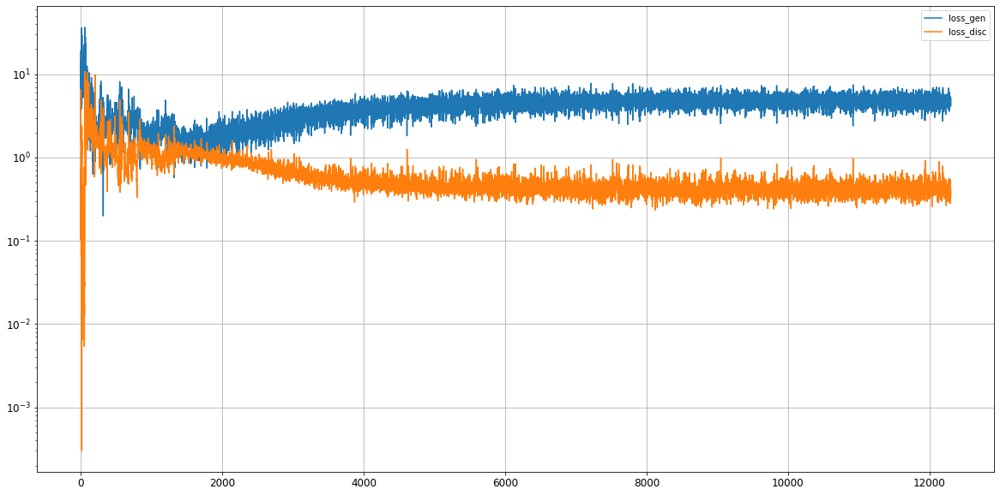

Epoch 12302/50000
0s
Epoch 12303/50000
0s
Epoch 12304/50000
0s
Epoch 12305/50000
0s
Epoch 12306/50000
0s
Epoch 12307/50000
0s
Epoch 12308/50000
0s
Epoch 12309/50000
0s
Epoch 12310/50000
0s
Epoch 12311/50000
0s
Epoch 12312/50000
0s
Epoch 12313/50000
0s
Epoch 12314/50000
0s
Epoch 12315/50000
0s
Epoch 12316/50000
0s
Epoch 12317/50000
0s
Epoch 12318/50000
0s
Epoch 12319/50000
0s
Epoch 12320/50000
0s
Epoch 12321/50000
0s
Epoch 12322/50000
0s
Epoch 12323/50000
0s
Epoch 12324/50000
0s
Epoch 12325/50000
0s
Epoch 12326/50000
0s
Epoch 12327/50000
0s
Epoch 12328/50000
0s
Epoch 12329/50000
0s
Epoch 12330/50000
0s
Epoch 12331/50000
0s
Epoch 12332/50000
0s
Epoch 12333/50000
0s
Epoch 12334/50000
0s
Epoch 12335/50000
0s
Epoch 12336/50000
0s
Epoch 12337/50000
0s
Epoch 12338/50000
0s
Epoch 12339/50000
0s
Epoch 12340/50000
0s
Epoch 12341/50000
0s
Epoch 12342/50000
0s
Epoch 12343/50000
0s
Epoch 12344/50000
0s
Epoch 12345/50000
0s
Epoch 12346/50000
0s
Epoch 12347/50000
0s
Epoch 12348/50000
0s
Epoch 12349/5

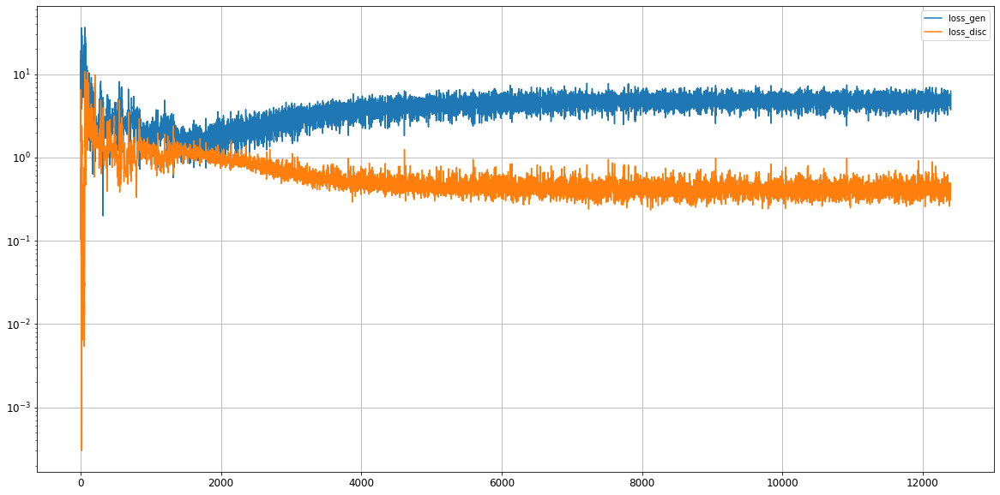

Epoch 12402/50000
0s
Epoch 12403/50000
0s
Epoch 12404/50000
0s
Epoch 12405/50000
0s
Epoch 12406/50000
0s
Epoch 12407/50000
0s
Epoch 12408/50000
0s
Epoch 12409/50000
0s
Epoch 12410/50000
0s
Epoch 12411/50000
0s
Epoch 12412/50000
0s
Epoch 12413/50000
0s
Epoch 12414/50000
0s
Epoch 12415/50000
0s
Epoch 12416/50000
0s
Epoch 12417/50000
0s
Epoch 12418/50000
0s
Epoch 12419/50000
0s
Epoch 12420/50000
0s
Epoch 12421/50000
0s
Epoch 12422/50000
0s
Epoch 12423/50000
0s
Epoch 12424/50000
0s
Epoch 12425/50000
0s
Epoch 12426/50000
0s
Epoch 12427/50000
0s
Epoch 12428/50000
0s
Epoch 12429/50000
0s
Epoch 12430/50000
0s
Epoch 12431/50000
0s
Epoch 12432/50000
0s
Epoch 12433/50000
0s
Epoch 12434/50000
0s
Epoch 12435/50000
0s
Epoch 12436/50000
0s
Epoch 12437/50000
0s
Epoch 12438/50000
0s
Epoch 12439/50000
0s
Epoch 12440/50000
0s
Epoch 12441/50000
0s
Epoch 12442/50000
0s
Epoch 12443/50000
0s
Epoch 12444/50000
0s
Epoch 12445/50000
0s
Epoch 12446/50000
0s
Epoch 12447/50000
0s
Epoch 12448/50000
0s
Epoch 12449/5

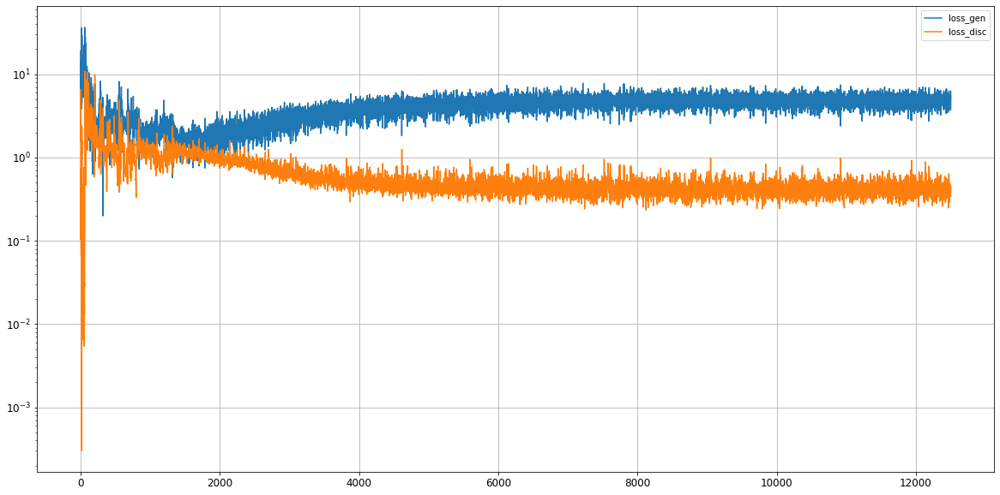

Epoch 12502/50000
0s
Epoch 12503/50000
0s
Epoch 12504/50000
0s
Epoch 12505/50000
0s
Epoch 12506/50000
0s
Epoch 12507/50000
0s
Epoch 12508/50000
0s
Epoch 12509/50000
0s
Epoch 12510/50000
0s
Epoch 12511/50000
0s
Epoch 12512/50000
0s
Epoch 12513/50000
0s
Epoch 12514/50000
0s
Epoch 12515/50000
0s
Epoch 12516/50000
0s
Epoch 12517/50000
0s
Epoch 12518/50000
0s
Epoch 12519/50000
0s
Epoch 12520/50000
0s
Epoch 12521/50000
0s
Epoch 12522/50000
0s
Epoch 12523/50000
0s
Epoch 12524/50000
0s
Epoch 12525/50000
0s
Epoch 12526/50000
0s
Epoch 12527/50000
0s
Epoch 12528/50000
0s
Epoch 12529/50000
0s
Epoch 12530/50000
0s
Epoch 12531/50000
0s
Epoch 12532/50000
0s
Epoch 12533/50000
0s
Epoch 12534/50000
0s
Epoch 12535/50000
0s
Epoch 12536/50000
0s
Epoch 12537/50000
0s
Epoch 12538/50000
0s
Epoch 12539/50000
0s
Epoch 12540/50000
0s
Epoch 12541/50000
0s
Epoch 12542/50000
0s
Epoch 12543/50000
0s
Epoch 12544/50000
0s
Epoch 12545/50000
0s
Epoch 12546/50000
0s
Epoch 12547/50000
0s
Epoch 12548/50000
0s
Epoch 12549/5

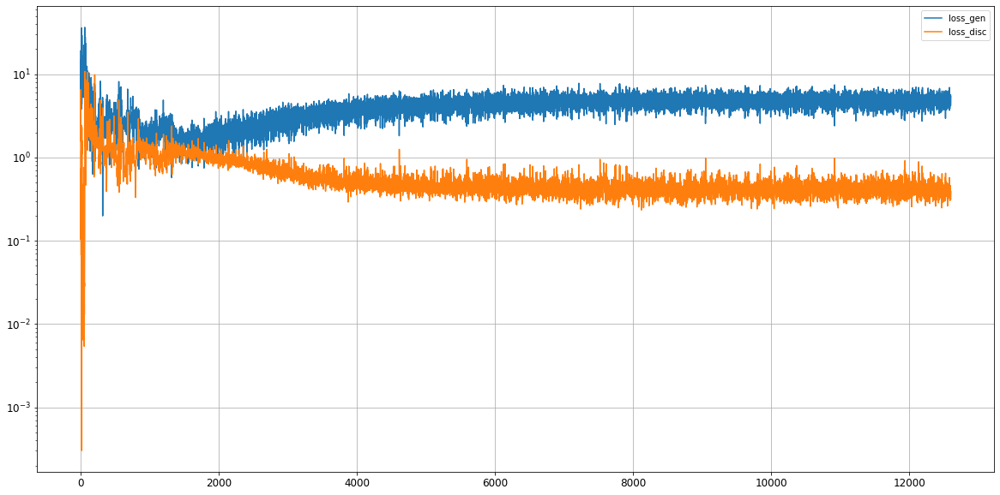

Epoch 12602/50000
0s
Epoch 12603/50000
0s
Epoch 12604/50000
0s
Epoch 12605/50000
0s
Epoch 12606/50000
0s
Epoch 12607/50000
0s
Epoch 12608/50000
0s
Epoch 12609/50000
0s
Epoch 12610/50000
0s
Epoch 12611/50000
0s
Epoch 12612/50000
0s
Epoch 12613/50000
0s
Epoch 12614/50000
0s
Epoch 12615/50000
0s
Epoch 12616/50000
0s
Epoch 12617/50000
0s
Epoch 12618/50000
0s
Epoch 12619/50000
0s
Epoch 12620/50000
0s
Epoch 12621/50000
0s
Epoch 12622/50000
0s
Epoch 12623/50000
0s
Epoch 12624/50000
0s
Epoch 12625/50000
0s
Epoch 12626/50000
0s
Epoch 12627/50000
0s
Epoch 12628/50000
0s
Epoch 12629/50000
0s
Epoch 12630/50000
0s
Epoch 12631/50000
0s
Epoch 12632/50000
0s
Epoch 12633/50000
0s
Epoch 12634/50000
0s
Epoch 12635/50000
0s
Epoch 12636/50000
0s
Epoch 12637/50000
0s
Epoch 12638/50000
0s
Epoch 12639/50000
0s
Epoch 12640/50000
0s
Epoch 12641/50000
0s
Epoch 12642/50000
0s
Epoch 12643/50000
0s
Epoch 12644/50000
0s
Epoch 12645/50000
0s
Epoch 12646/50000
0s
Epoch 12647/50000
0s
Epoch 12648/50000
0s
Epoch 12649/5

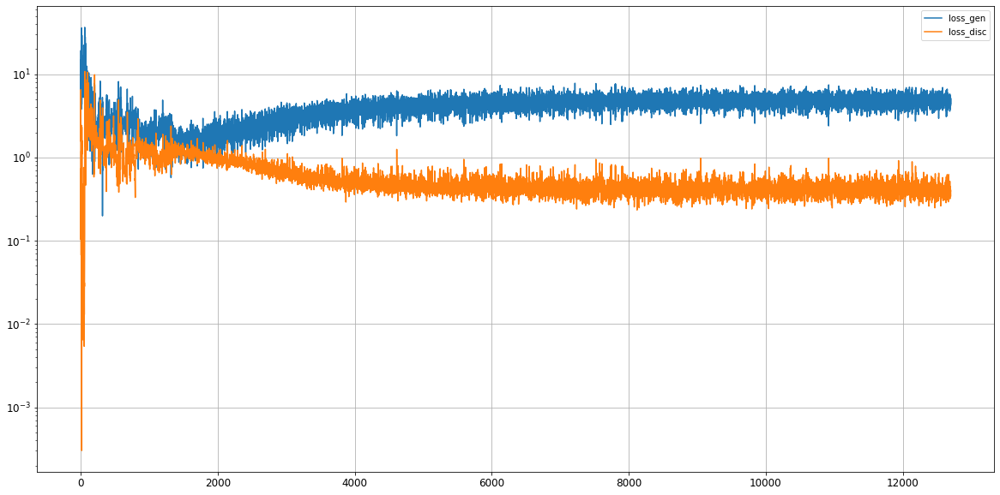

Epoch 12702/50000
0s
Epoch 12703/50000
0s
Epoch 12704/50000
0s
Epoch 12705/50000
0s
Epoch 12706/50000
0s
Epoch 12707/50000
0s
Epoch 12708/50000
0s
Epoch 12709/50000
0s
Epoch 12710/50000
0s
Epoch 12711/50000
0s
Epoch 12712/50000
0s
Epoch 12713/50000
0s
Epoch 12714/50000
0s
Epoch 12715/50000
0s
Epoch 12716/50000
0s
Epoch 12717/50000
0s
Epoch 12718/50000
0s
Epoch 12719/50000
0s
Epoch 12720/50000
0s
Epoch 12721/50000
0s
Epoch 12722/50000
0s
Epoch 12723/50000
0s
Epoch 12724/50000
0s
Epoch 12725/50000
0s
Epoch 12726/50000
0s
Epoch 12727/50000
0s
Epoch 12728/50000
0s
Epoch 12729/50000
0s
Epoch 12730/50000
0s
Epoch 12731/50000
0s
Epoch 12732/50000
0s
Epoch 12733/50000
0s
Epoch 12734/50000
0s
Epoch 12735/50000
0s
Epoch 12736/50000
0s
Epoch 12737/50000
0s
Epoch 12738/50000
0s
Epoch 12739/50000
0s
Epoch 12740/50000
0s
Epoch 12741/50000
0s
Epoch 12742/50000
0s
Epoch 12743/50000
0s
Epoch 12744/50000
0s
Epoch 12745/50000
0s
Epoch 12746/50000
0s
Epoch 12747/50000
0s
Epoch 12748/50000
0s
Epoch 12749/5

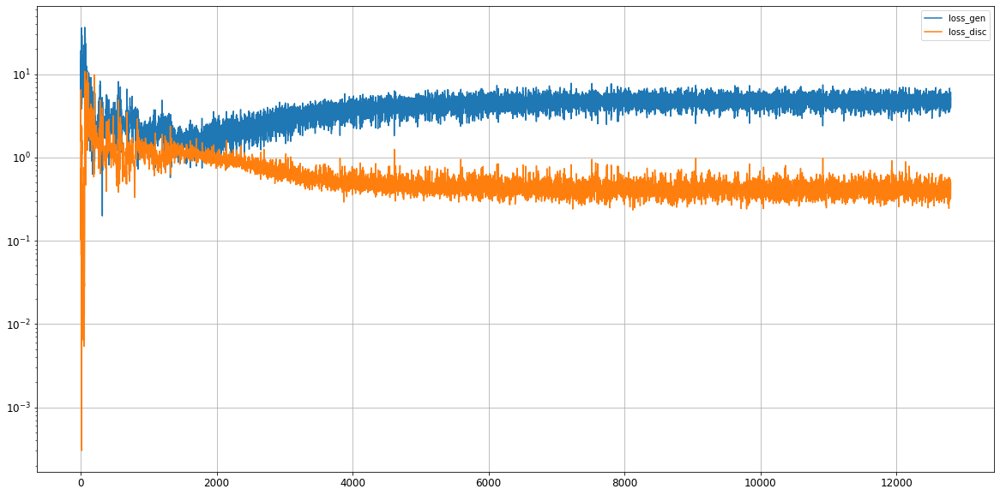

Epoch 12802/50000
0s
Epoch 12803/50000
0s
Epoch 12804/50000
0s
Epoch 12805/50000
0s
Epoch 12806/50000
0s
Epoch 12807/50000
0s
Epoch 12808/50000
0s
Epoch 12809/50000
0s
Epoch 12810/50000
0s
Epoch 12811/50000
0s
Epoch 12812/50000
0s
Epoch 12813/50000
0s
Epoch 12814/50000
0s
Epoch 12815/50000
0s
Epoch 12816/50000
0s
Epoch 12817/50000
0s
Epoch 12818/50000
0s
Epoch 12819/50000
0s
Epoch 12820/50000
0s
Epoch 12821/50000
0s
Epoch 12822/50000
0s
Epoch 12823/50000
0s
Epoch 12824/50000
0s
Epoch 12825/50000
0s
Epoch 12826/50000
0s
Epoch 12827/50000
0s
Epoch 12828/50000
0s
Epoch 12829/50000
0s
Epoch 12830/50000
0s
Epoch 12831/50000
0s
Epoch 12832/50000
0s
Epoch 12833/50000
0s
Epoch 12834/50000
0s
Epoch 12835/50000
0s
Epoch 12836/50000
0s
Epoch 12837/50000
0s
Epoch 12838/50000
0s
Epoch 12839/50000
0s
Epoch 12840/50000
0s
Epoch 12841/50000
0s
Epoch 12842/50000
0s
Epoch 12843/50000
0s
Epoch 12844/50000
0s
Epoch 12845/50000
0s
Epoch 12846/50000
0s
Epoch 12847/50000
0s
Epoch 12848/50000
0s
Epoch 12849/5

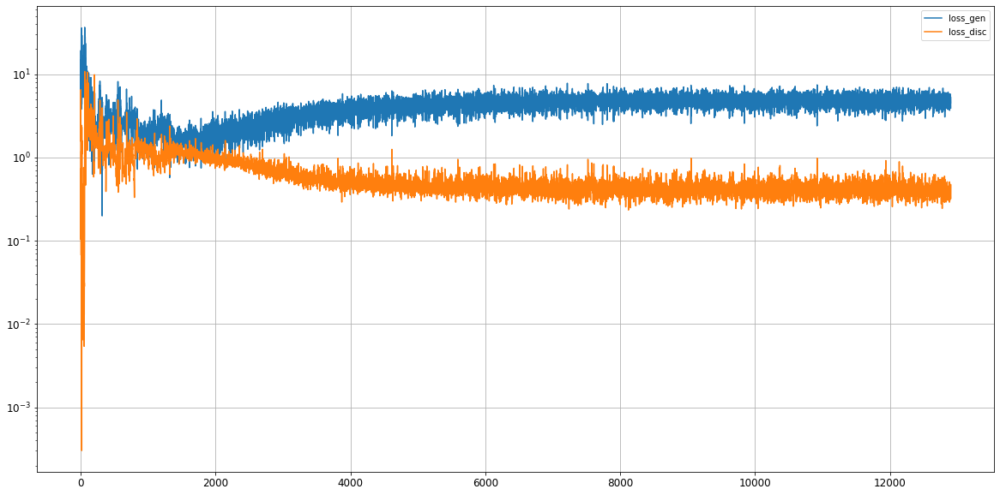

Epoch 12902/50000
0s
Epoch 12903/50000
0s
Epoch 12904/50000
0s
Epoch 12905/50000
0s
Epoch 12906/50000
0s
Epoch 12907/50000
0s
Epoch 12908/50000
0s
Epoch 12909/50000
0s
Epoch 12910/50000
0s
Epoch 12911/50000
0s
Epoch 12912/50000
0s
Epoch 12913/50000
0s
Epoch 12914/50000
0s
Epoch 12915/50000
0s
Epoch 12916/50000
0s
Epoch 12917/50000
0s
Epoch 12918/50000
0s
Epoch 12919/50000
0s
Epoch 12920/50000
0s
Epoch 12921/50000
0s
Epoch 12922/50000
0s
Epoch 12923/50000
0s
Epoch 12924/50000
0s
Epoch 12925/50000
0s
Epoch 12926/50000
0s
Epoch 12927/50000
0s
Epoch 12928/50000
0s
Epoch 12929/50000
0s
Epoch 12930/50000
0s
Epoch 12931/50000
0s
Epoch 12932/50000
0s
Epoch 12933/50000
0s
Epoch 12934/50000
0s
Epoch 12935/50000
0s
Epoch 12936/50000
0s
Epoch 12937/50000
0s
Epoch 12938/50000
0s
Epoch 12939/50000
0s
Epoch 12940/50000
0s
Epoch 12941/50000
0s
Epoch 12942/50000
0s
Epoch 12943/50000
0s
Epoch 12944/50000
0s
Epoch 12945/50000
0s
Epoch 12946/50000
0s
Epoch 12947/50000
0s
Epoch 12948/50000
0s
Epoch 12949/5

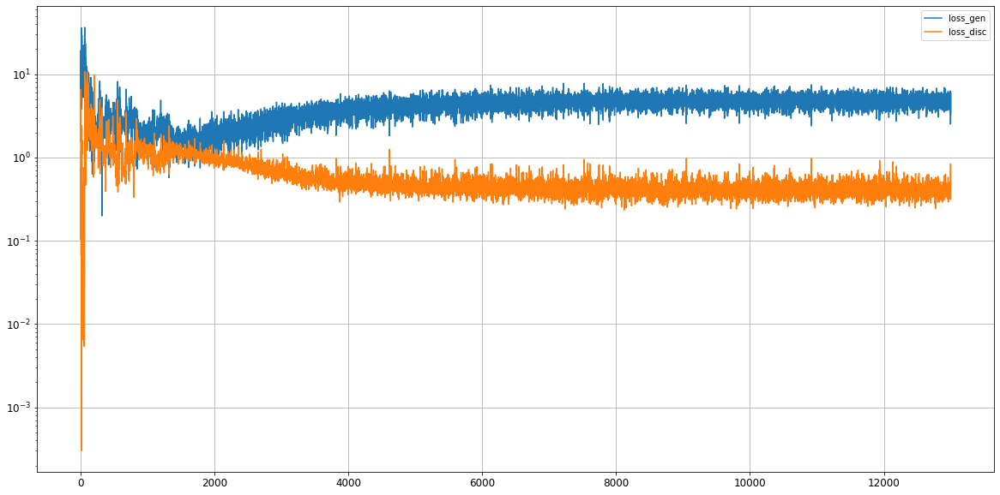

Epoch 13002/50000
0s
Epoch 13003/50000
0s
Epoch 13004/50000
0s
Epoch 13005/50000
0s
Epoch 13006/50000
0s
Epoch 13007/50000
0s
Epoch 13008/50000
0s
Epoch 13009/50000
0s
Epoch 13010/50000
0s
Epoch 13011/50000
0s
Epoch 13012/50000
0s
Epoch 13013/50000
0s
Epoch 13014/50000
0s
Epoch 13015/50000
0s
Epoch 13016/50000
0s
Epoch 13017/50000
0s
Epoch 13018/50000
0s
Epoch 13019/50000
0s
Epoch 13020/50000
0s
Epoch 13021/50000
0s
Epoch 13022/50000
0s
Epoch 13023/50000
0s
Epoch 13024/50000
0s
Epoch 13025/50000
0s
Epoch 13026/50000
0s
Epoch 13027/50000
0s
Epoch 13028/50000
0s
Epoch 13029/50000
0s
Epoch 13030/50000
0s
Epoch 13031/50000
0s
Epoch 13032/50000
0s
Epoch 13033/50000
0s
Epoch 13034/50000
0s
Epoch 13035/50000
0s
Epoch 13036/50000
0s
Epoch 13037/50000
0s
Epoch 13038/50000
0s
Epoch 13039/50000
0s
Epoch 13040/50000
0s
Epoch 13041/50000
0s
Epoch 13042/50000
0s
Epoch 13043/50000
0s
Epoch 13044/50000
0s
Epoch 13045/50000
0s
Epoch 13046/50000
0s
Epoch 13047/50000
0s
Epoch 13048/50000
0s
Epoch 13049/5

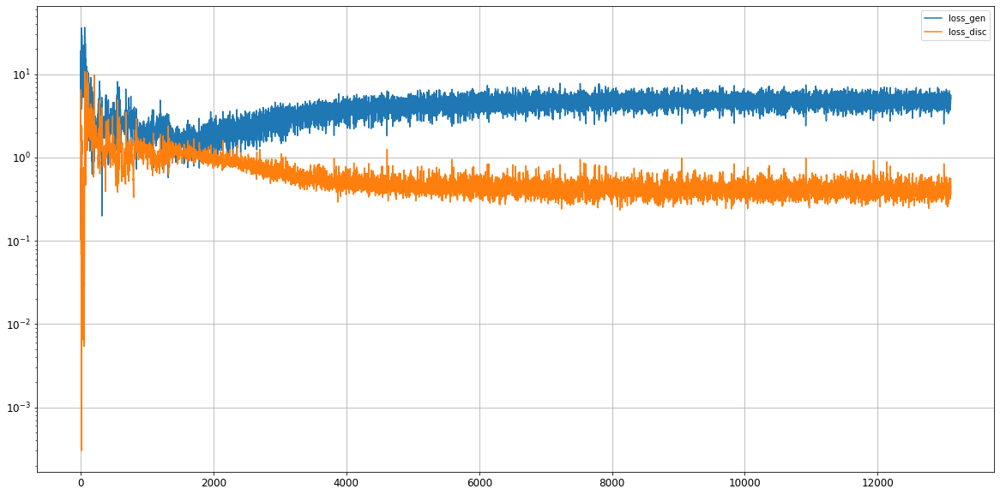

Epoch 13102/50000
0s
Epoch 13103/50000
0s
Epoch 13104/50000
0s
Epoch 13105/50000
0s
Epoch 13106/50000
0s
Epoch 13107/50000
0s
Epoch 13108/50000
0s
Epoch 13109/50000
0s
Epoch 13110/50000
0s
Epoch 13111/50000
0s
Epoch 13112/50000
0s
Epoch 13113/50000
0s
Epoch 13114/50000
0s
Epoch 13115/50000
0s
Epoch 13116/50000
0s
Epoch 13117/50000
0s
Epoch 13118/50000
0s
Epoch 13119/50000
0s
Epoch 13120/50000
0s
Epoch 13121/50000
0s
Epoch 13122/50000
0s
Epoch 13123/50000
0s
Epoch 13124/50000
0s
Epoch 13125/50000
0s
Epoch 13126/50000
0s
Epoch 13127/50000
0s
Epoch 13128/50000
0s
Epoch 13129/50000
0s
Epoch 13130/50000
0s
Epoch 13131/50000
0s
Epoch 13132/50000
0s
Epoch 13133/50000
0s
Epoch 13134/50000
0s
Epoch 13135/50000
0s
Epoch 13136/50000
0s
Epoch 13137/50000
0s
Epoch 13138/50000
0s
Epoch 13139/50000
0s
Epoch 13140/50000
0s
Epoch 13141/50000
0s
Epoch 13142/50000
0s
Epoch 13143/50000
0s
Epoch 13144/50000
0s
Epoch 13145/50000
0s
Epoch 13146/50000
0s
Epoch 13147/50000
0s
Epoch 13148/50000
0s
Epoch 13149/5

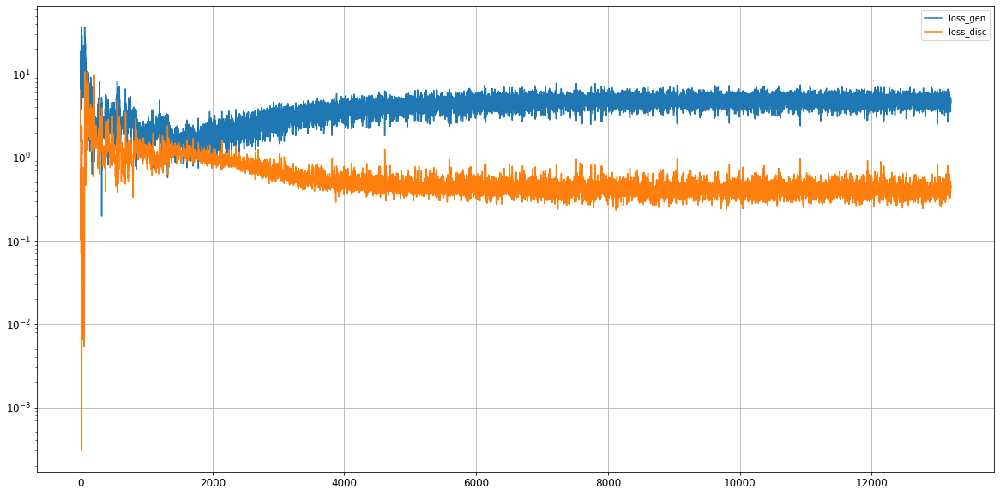

Epoch 13202/50000
0s
Epoch 13203/50000
0s
Epoch 13204/50000
0s
Epoch 13205/50000
0s
Epoch 13206/50000
0s
Epoch 13207/50000
0s
Epoch 13208/50000
0s
Epoch 13209/50000
0s
Epoch 13210/50000
0s
Epoch 13211/50000
0s
Epoch 13212/50000
0s
Epoch 13213/50000
0s
Epoch 13214/50000
0s
Epoch 13215/50000
0s
Epoch 13216/50000
0s
Epoch 13217/50000
0s
Epoch 13218/50000
0s
Epoch 13219/50000
0s
Epoch 13220/50000
0s
Epoch 13221/50000
0s
Epoch 13222/50000
0s
Epoch 13223/50000
0s
Epoch 13224/50000
0s
Epoch 13225/50000
0s
Epoch 13226/50000
0s
Epoch 13227/50000
0s
Epoch 13228/50000
0s
Epoch 13229/50000
0s
Epoch 13230/50000
0s
Epoch 13231/50000
0s
Epoch 13232/50000
0s
Epoch 13233/50000
0s
Epoch 13234/50000
0s
Epoch 13235/50000
0s
Epoch 13236/50000
0s
Epoch 13237/50000
0s
Epoch 13238/50000
0s
Epoch 13239/50000
0s
Epoch 13240/50000
0s
Epoch 13241/50000
0s
Epoch 13242/50000
0s
Epoch 13243/50000
0s
Epoch 13244/50000
0s
Epoch 13245/50000
0s
Epoch 13246/50000
0s
Epoch 13247/50000
0s
Epoch 13248/50000
0s
Epoch 13249/5

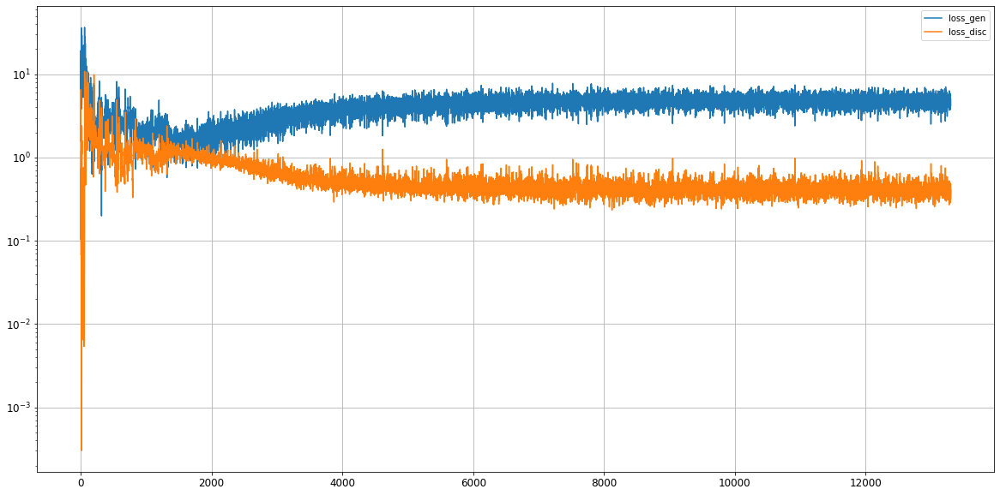

Epoch 13302/50000
0s
Epoch 13303/50000
0s
Epoch 13304/50000
0s
Epoch 13305/50000
0s
Epoch 13306/50000
0s
Epoch 13307/50000
0s
Epoch 13308/50000
0s
Epoch 13309/50000
0s
Epoch 13310/50000
0s
Epoch 13311/50000
0s
Epoch 13312/50000
0s
Epoch 13313/50000
0s
Epoch 13314/50000
0s
Epoch 13315/50000
0s
Epoch 13316/50000
0s
Epoch 13317/50000
0s
Epoch 13318/50000
0s
Epoch 13319/50000
0s
Epoch 13320/50000
0s
Epoch 13321/50000
0s
Epoch 13322/50000
0s
Epoch 13323/50000
0s
Epoch 13324/50000
0s
Epoch 13325/50000
0s
Epoch 13326/50000
0s
Epoch 13327/50000
0s
Epoch 13328/50000
0s
Epoch 13329/50000
0s
Epoch 13330/50000
0s
Epoch 13331/50000
0s
Epoch 13332/50000
0s
Epoch 13333/50000
0s
Epoch 13334/50000
0s
Epoch 13335/50000
0s
Epoch 13336/50000
0s
Epoch 13337/50000
0s
Epoch 13338/50000
0s
Epoch 13339/50000
0s
Epoch 13340/50000
0s
Epoch 13341/50000
0s
Epoch 13342/50000
0s
Epoch 13343/50000
0s
Epoch 13344/50000
0s
Epoch 13345/50000
0s
Epoch 13346/50000
0s
Epoch 13347/50000
0s
Epoch 13348/50000
0s
Epoch 13349/5

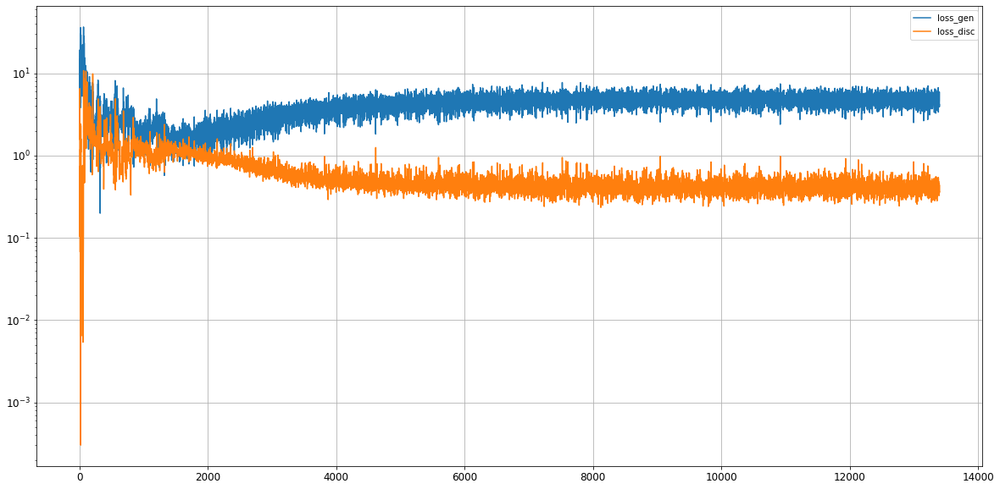

Epoch 13402/50000
0s
Epoch 13403/50000
0s
Epoch 13404/50000
0s
Epoch 13405/50000
0s
Epoch 13406/50000
0s
Epoch 13407/50000
0s
Epoch 13408/50000
0s
Epoch 13409/50000
0s
Epoch 13410/50000
0s
Epoch 13411/50000
0s
Epoch 13412/50000
0s
Epoch 13413/50000
0s
Epoch 13414/50000
0s
Epoch 13415/50000
0s
Epoch 13416/50000
0s
Epoch 13417/50000
0s
Epoch 13418/50000
0s
Epoch 13419/50000
0s
Epoch 13420/50000
0s
Epoch 13421/50000
0s
Epoch 13422/50000
0s
Epoch 13423/50000
0s
Epoch 13424/50000
0s
Epoch 13425/50000
0s
Epoch 13426/50000
0s
Epoch 13427/50000
0s
Epoch 13428/50000
0s
Epoch 13429/50000
0s
Epoch 13430/50000
0s
Epoch 13431/50000
0s
Epoch 13432/50000
0s
Epoch 13433/50000
0s
Epoch 13434/50000
0s
Epoch 13435/50000
0s
Epoch 13436/50000
0s
Epoch 13437/50000
0s
Epoch 13438/50000
0s
Epoch 13439/50000
0s
Epoch 13440/50000
0s
Epoch 13441/50000
0s
Epoch 13442/50000
0s
Epoch 13443/50000
0s
Epoch 13444/50000
0s
Epoch 13445/50000
0s
Epoch 13446/50000
0s
Epoch 13447/50000
0s
Epoch 13448/50000
0s
Epoch 13449/5

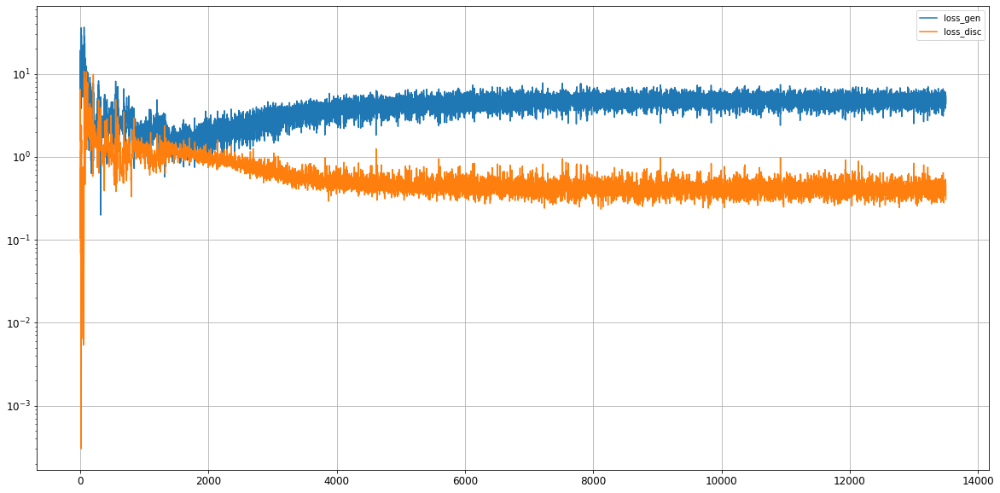

Epoch 13502/50000
0s
Epoch 13503/50000
0s
Epoch 13504/50000
0s
Epoch 13505/50000
0s
Epoch 13506/50000
0s
Epoch 13507/50000
0s
Epoch 13508/50000
0s
Epoch 13509/50000
0s
Epoch 13510/50000
0s
Epoch 13511/50000
0s
Epoch 13512/50000
0s
Epoch 13513/50000
0s
Epoch 13514/50000
0s
Epoch 13515/50000
0s
Epoch 13516/50000
0s
Epoch 13517/50000
0s
Epoch 13518/50000
0s
Epoch 13519/50000
0s
Epoch 13520/50000
0s
Epoch 13521/50000
0s
Epoch 13522/50000
0s
Epoch 13523/50000
0s
Epoch 13524/50000
0s
Epoch 13525/50000
0s
Epoch 13526/50000
0s
Epoch 13527/50000
0s
Epoch 13528/50000
0s
Epoch 13529/50000
0s
Epoch 13530/50000
0s
Epoch 13531/50000
0s
Epoch 13532/50000
0s
Epoch 13533/50000
0s
Epoch 13534/50000
0s
Epoch 13535/50000
0s
Epoch 13536/50000
0s
Epoch 13537/50000
0s
Epoch 13538/50000
0s
Epoch 13539/50000
0s
Epoch 13540/50000
0s
Epoch 13541/50000
0s
Epoch 13542/50000
0s
Epoch 13543/50000
0s
Epoch 13544/50000
0s
Epoch 13545/50000
0s
Epoch 13546/50000
0s
Epoch 13547/50000
0s
Epoch 13548/50000
0s
Epoch 13549/5

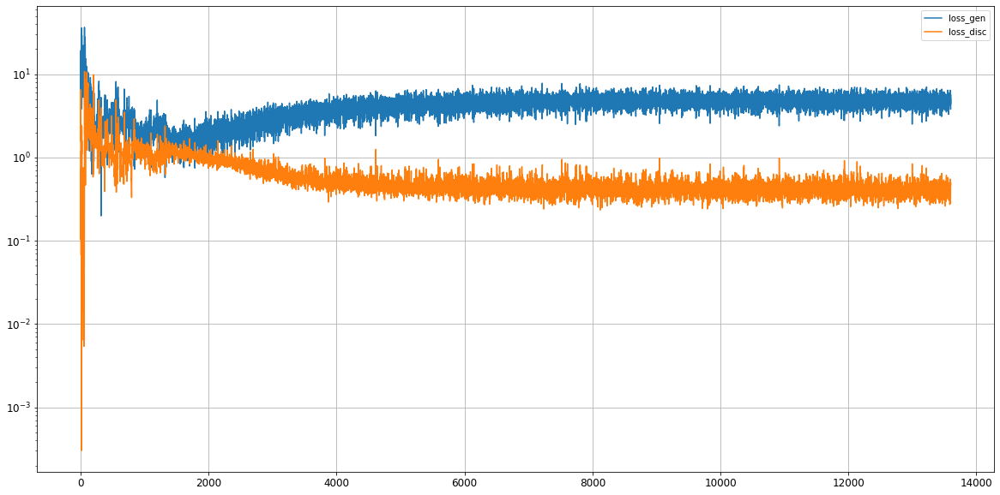

Epoch 13602/50000
0s
Epoch 13603/50000
0s
Epoch 13604/50000
0s
Epoch 13605/50000
0s
Epoch 13606/50000
0s
Epoch 13607/50000
0s
Epoch 13608/50000
0s
Epoch 13609/50000
0s
Epoch 13610/50000
0s
Epoch 13611/50000
0s
Epoch 13612/50000
0s
Epoch 13613/50000
0s
Epoch 13614/50000
0s
Epoch 13615/50000
0s
Epoch 13616/50000
0s
Epoch 13617/50000
0s
Epoch 13618/50000
0s
Epoch 13619/50000
0s
Epoch 13620/50000
0s
Epoch 13621/50000
0s
Epoch 13622/50000
0s
Epoch 13623/50000
0s
Epoch 13624/50000
0s
Epoch 13625/50000
0s
Epoch 13626/50000
0s
Epoch 13627/50000
0s
Epoch 13628/50000
0s
Epoch 13629/50000
0s
Epoch 13630/50000
0s
Epoch 13631/50000
0s
Epoch 13632/50000
0s
Epoch 13633/50000
0s
Epoch 13634/50000
0s
Epoch 13635/50000
0s
Epoch 13636/50000
0s
Epoch 13637/50000
0s
Epoch 13638/50000
0s
Epoch 13639/50000
0s
Epoch 13640/50000
0s
Epoch 13641/50000
0s
Epoch 13642/50000
0s
Epoch 13643/50000
0s
Epoch 13644/50000
0s
Epoch 13645/50000
0s
Epoch 13646/50000
0s
Epoch 13647/50000
0s
Epoch 13648/50000
0s
Epoch 13649/5

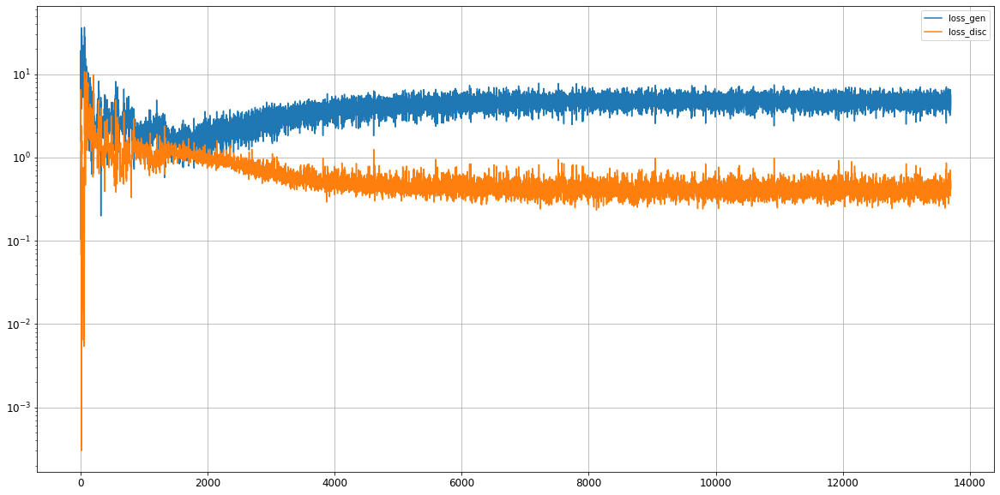

Epoch 13702/50000
0s
Epoch 13703/50000
0s
Epoch 13704/50000
0s
Epoch 13705/50000
0s
Epoch 13706/50000
0s
Epoch 13707/50000
0s
Epoch 13708/50000
0s
Epoch 13709/50000
0s
Epoch 13710/50000
0s
Epoch 13711/50000
0s
Epoch 13712/50000
0s
Epoch 13713/50000
0s
Epoch 13714/50000
0s
Epoch 13715/50000
0s
Epoch 13716/50000
0s
Epoch 13717/50000
0s
Epoch 13718/50000
0s
Epoch 13719/50000
0s
Epoch 13720/50000
0s
Epoch 13721/50000
0s
Epoch 13722/50000
0s
Epoch 13723/50000
0s
Epoch 13724/50000
0s
Epoch 13725/50000
0s
Epoch 13726/50000
0s
Epoch 13727/50000
0s
Epoch 13728/50000
0s
Epoch 13729/50000
0s
Epoch 13730/50000
0s
Epoch 13731/50000
0s
Epoch 13732/50000
0s
Epoch 13733/50000
0s
Epoch 13734/50000
0s
Epoch 13735/50000
0s
Epoch 13736/50000
0s
Epoch 13737/50000
0s
Epoch 13738/50000
0s
Epoch 13739/50000
0s
Epoch 13740/50000
0s
Epoch 13741/50000
0s
Epoch 13742/50000
0s
Epoch 13743/50000
0s
Epoch 13744/50000
0s
Epoch 13745/50000
0s
Epoch 13746/50000
0s
Epoch 13747/50000
0s
Epoch 13748/50000
0s
Epoch 13749/5

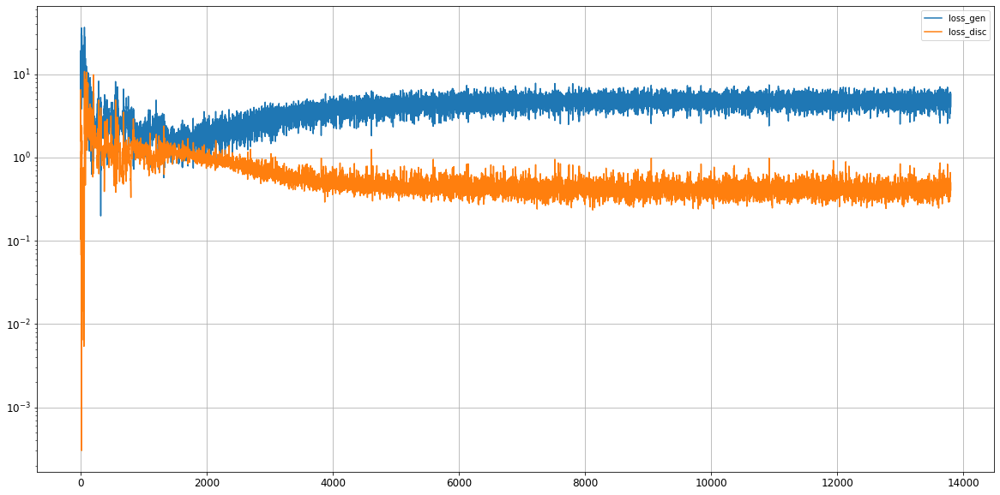

Epoch 13802/50000
0s
Epoch 13803/50000
0s
Epoch 13804/50000
0s
Epoch 13805/50000
0s
Epoch 13806/50000
0s
Epoch 13807/50000
0s
Epoch 13808/50000
0s
Epoch 13809/50000
0s
Epoch 13810/50000
0s
Epoch 13811/50000
0s
Epoch 13812/50000
0s
Epoch 13813/50000
0s
Epoch 13814/50000
0s
Epoch 13815/50000
0s
Epoch 13816/50000
0s
Epoch 13817/50000
0s
Epoch 13818/50000
0s
Epoch 13819/50000
0s
Epoch 13820/50000
0s
Epoch 13821/50000
0s
Epoch 13822/50000
0s
Epoch 13823/50000
0s
Epoch 13824/50000
0s
Epoch 13825/50000
0s
Epoch 13826/50000
0s
Epoch 13827/50000
0s
Epoch 13828/50000
0s
Epoch 13829/50000
0s
Epoch 13830/50000
0s
Epoch 13831/50000
0s
Epoch 13832/50000
0s
Epoch 13833/50000
0s
Epoch 13834/50000
0s
Epoch 13835/50000
0s
Epoch 13836/50000
0s
Epoch 13837/50000
0s
Epoch 13838/50000
0s
Epoch 13839/50000
0s
Epoch 13840/50000
0s
Epoch 13841/50000
0s
Epoch 13842/50000
0s
Epoch 13843/50000
0s
Epoch 13844/50000
0s
Epoch 13845/50000
0s
Epoch 13846/50000
0s
Epoch 13847/50000
0s
Epoch 13848/50000
0s
Epoch 13849/5

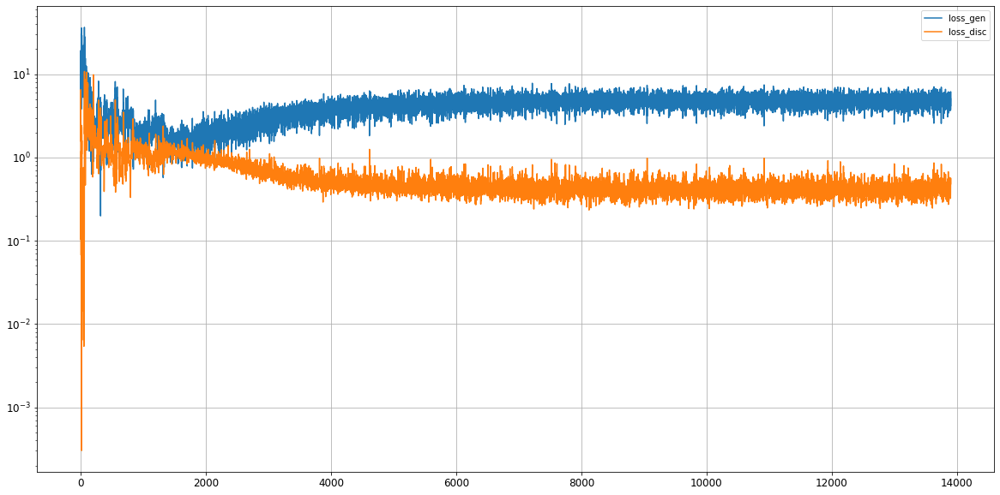

Epoch 13902/50000
0s
Epoch 13903/50000
0s
Epoch 13904/50000
0s
Epoch 13905/50000
0s
Epoch 13906/50000
0s
Epoch 13907/50000
0s
Epoch 13908/50000
0s
Epoch 13909/50000
0s
Epoch 13910/50000
0s
Epoch 13911/50000
0s
Epoch 13912/50000
0s
Epoch 13913/50000
0s
Epoch 13914/50000
0s
Epoch 13915/50000
0s
Epoch 13916/50000
0s
Epoch 13917/50000
0s
Epoch 13918/50000
0s
Epoch 13919/50000
0s
Epoch 13920/50000
0s
Epoch 13921/50000
0s
Epoch 13922/50000
0s
Epoch 13923/50000
0s
Epoch 13924/50000
0s
Epoch 13925/50000
0s
Epoch 13926/50000
0s
Epoch 13927/50000
0s
Epoch 13928/50000
0s
Epoch 13929/50000
0s
Epoch 13930/50000
0s
Epoch 13931/50000
0s
Epoch 13932/50000
0s
Epoch 13933/50000
0s
Epoch 13934/50000
0s
Epoch 13935/50000
0s
Epoch 13936/50000
0s
Epoch 13937/50000
0s
Epoch 13938/50000
0s
Epoch 13939/50000
0s
Epoch 13940/50000
0s
Epoch 13941/50000
0s
Epoch 13942/50000
0s
Epoch 13943/50000
0s
Epoch 13944/50000
0s
Epoch 13945/50000
0s
Epoch 13946/50000
0s
Epoch 13947/50000
0s
Epoch 13948/50000
0s
Epoch 13949/5

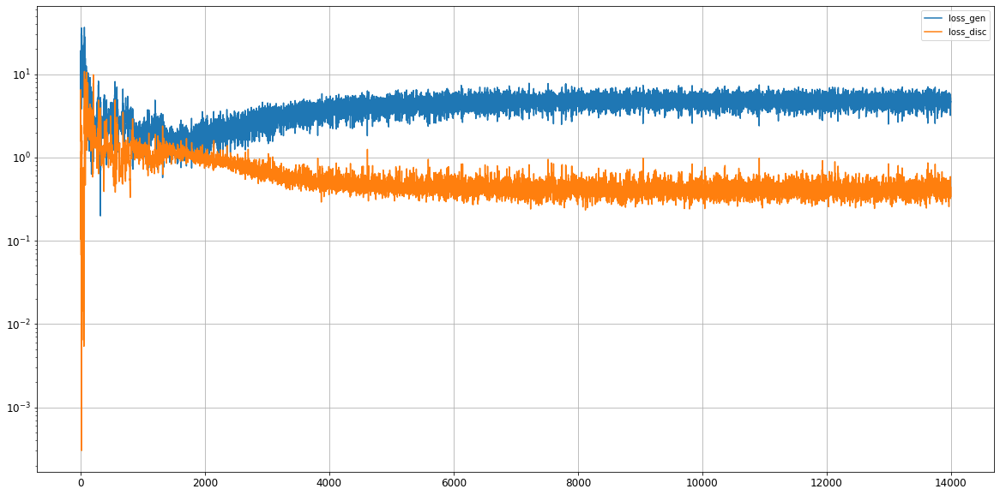

Epoch 14002/50000
0s
Epoch 14003/50000
0s
Epoch 14004/50000
0s
Epoch 14005/50000
0s
Epoch 14006/50000
0s
Epoch 14007/50000
0s
Epoch 14008/50000
0s
Epoch 14009/50000
0s
Epoch 14010/50000
0s
Epoch 14011/50000
0s
Epoch 14012/50000
0s
Epoch 14013/50000
0s
Epoch 14014/50000
0s
Epoch 14015/50000
0s
Epoch 14016/50000
0s
Epoch 14017/50000
0s
Epoch 14018/50000
0s
Epoch 14019/50000
0s
Epoch 14020/50000
0s
Epoch 14021/50000
0s
Epoch 14022/50000
0s
Epoch 14023/50000
0s
Epoch 14024/50000
0s
Epoch 14025/50000
0s
Epoch 14026/50000
0s
Epoch 14027/50000
0s
Epoch 14028/50000
0s
Epoch 14029/50000
0s
Epoch 14030/50000
0s
Epoch 14031/50000
0s
Epoch 14032/50000
0s
Epoch 14033/50000
0s
Epoch 14034/50000
0s
Epoch 14035/50000
0s
Epoch 14036/50000
0s
Epoch 14037/50000
0s
Epoch 14038/50000
0s
Epoch 14039/50000
0s
Epoch 14040/50000
0s
Epoch 14041/50000
0s
Epoch 14042/50000
0s
Epoch 14043/50000
0s
Epoch 14044/50000
0s
Epoch 14045/50000
0s
Epoch 14046/50000
0s
Epoch 14047/50000
0s
Epoch 14048/50000
0s
Epoch 14049/5

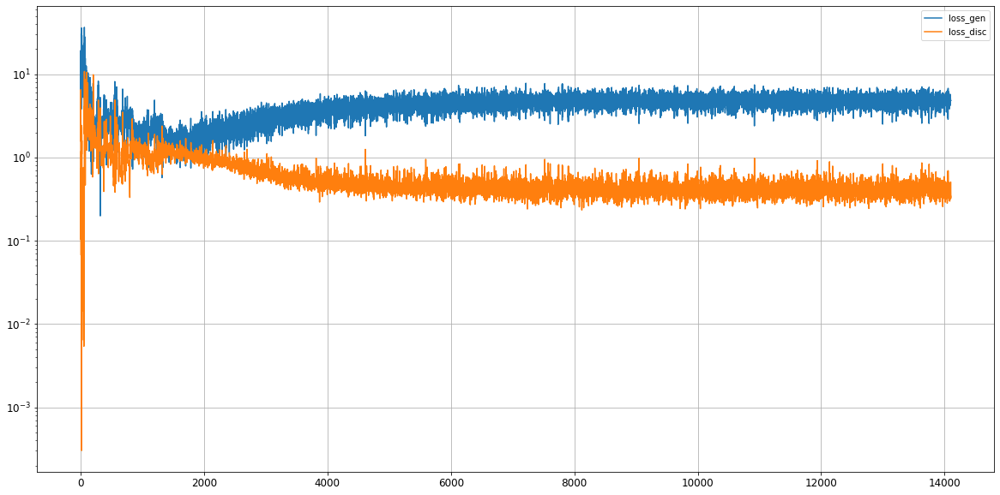

Epoch 14102/50000
0s
Epoch 14103/50000
0s
Epoch 14104/50000
0s
Epoch 14105/50000
0s
Epoch 14106/50000
0s
Epoch 14107/50000
0s
Epoch 14108/50000
0s
Epoch 14109/50000
0s
Epoch 14110/50000
0s
Epoch 14111/50000
0s
Epoch 14112/50000
0s
Epoch 14113/50000
0s
Epoch 14114/50000
0s
Epoch 14115/50000
0s
Epoch 14116/50000
0s
Epoch 14117/50000
0s
Epoch 14118/50000
0s
Epoch 14119/50000
0s
Epoch 14120/50000
0s
Epoch 14121/50000
0s
Epoch 14122/50000
0s
Epoch 14123/50000
0s
Epoch 14124/50000
0s
Epoch 14125/50000
0s
Epoch 14126/50000
0s
Epoch 14127/50000
0s
Epoch 14128/50000
0s
Epoch 14129/50000
0s
Epoch 14130/50000
0s
Epoch 14131/50000
0s
Epoch 14132/50000
0s
Epoch 14133/50000
0s
Epoch 14134/50000
0s
Epoch 14135/50000
0s
Epoch 14136/50000
0s
Epoch 14137/50000
0s
Epoch 14138/50000
0s
Epoch 14139/50000
0s
Epoch 14140/50000
0s
Epoch 14141/50000
0s
Epoch 14142/50000
0s
Epoch 14143/50000
0s
Epoch 14144/50000
0s
Epoch 14145/50000
0s
Epoch 14146/50000
0s
Epoch 14147/50000
0s
Epoch 14148/50000
0s
Epoch 14149/5

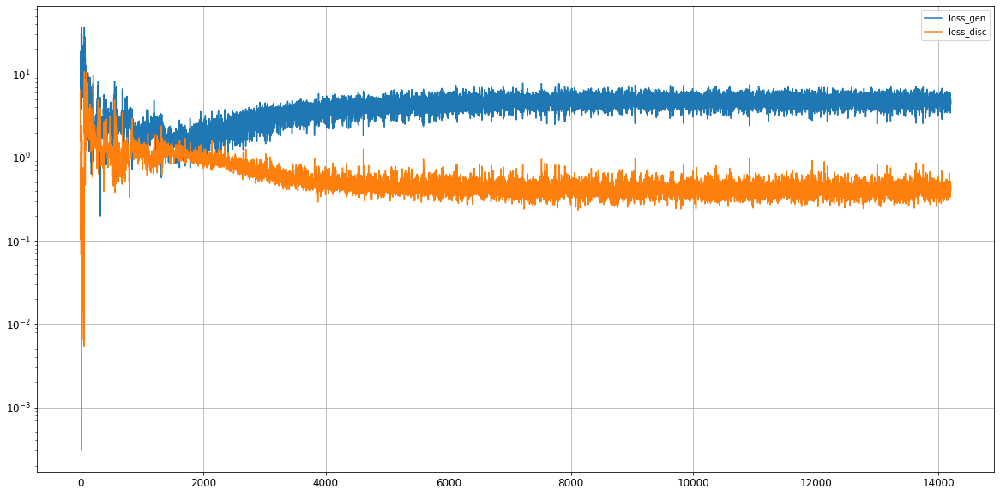

Epoch 14202/50000
0s
Epoch 14203/50000
0s
Epoch 14204/50000
0s
Epoch 14205/50000
0s
Epoch 14206/50000
0s
Epoch 14207/50000
0s
Epoch 14208/50000
0s
Epoch 14209/50000
0s
Epoch 14210/50000
0s
Epoch 14211/50000
0s
Epoch 14212/50000
0s
Epoch 14213/50000
0s
Epoch 14214/50000
0s
Epoch 14215/50000
0s
Epoch 14216/50000
0s
Epoch 14217/50000
0s
Epoch 14218/50000
0s
Epoch 14219/50000
0s
Epoch 14220/50000
0s
Epoch 14221/50000
0s
Epoch 14222/50000
0s
Epoch 14223/50000
0s
Epoch 14224/50000
0s
Epoch 14225/50000
0s
Epoch 14226/50000
0s
Epoch 14227/50000
0s
Epoch 14228/50000
0s
Epoch 14229/50000
0s
Epoch 14230/50000
0s
Epoch 14231/50000
0s
Epoch 14232/50000
0s
Epoch 14233/50000
0s
Epoch 14234/50000
0s
Epoch 14235/50000
0s
Epoch 14236/50000
0s
Epoch 14237/50000
0s
Epoch 14238/50000
0s
Epoch 14239/50000
0s
Epoch 14240/50000
0s
Epoch 14241/50000
0s
Epoch 14242/50000
0s
Epoch 14243/50000
0s
Epoch 14244/50000
0s
Epoch 14245/50000
0s
Epoch 14246/50000
0s
Epoch 14247/50000
0s
Epoch 14248/50000
0s
Epoch 14249/5

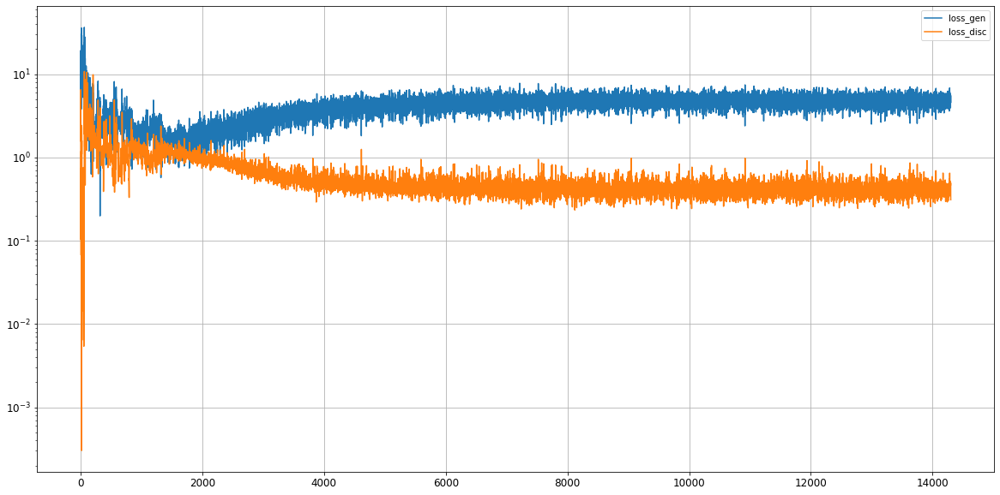

Epoch 14302/50000
0s
Epoch 14303/50000
0s
Epoch 14304/50000
0s
Epoch 14305/50000
0s
Epoch 14306/50000
0s
Epoch 14307/50000
0s
Epoch 14308/50000
0s
Epoch 14309/50000
0s
Epoch 14310/50000
0s
Epoch 14311/50000
0s
Epoch 14312/50000
0s
Epoch 14313/50000
0s
Epoch 14314/50000
0s
Epoch 14315/50000
0s
Epoch 14316/50000
0s
Epoch 14317/50000
0s
Epoch 14318/50000
0s
Epoch 14319/50000
0s
Epoch 14320/50000
0s
Epoch 14321/50000
0s
Epoch 14322/50000
0s
Epoch 14323/50000
0s
Epoch 14324/50000
0s
Epoch 14325/50000
0s
Epoch 14326/50000
0s
Epoch 14327/50000
0s
Epoch 14328/50000
0s
Epoch 14329/50000
0s
Epoch 14330/50000
0s
Epoch 14331/50000
0s
Epoch 14332/50000
0s
Epoch 14333/50000
0s
Epoch 14334/50000
0s
Epoch 14335/50000
0s
Epoch 14336/50000
0s
Epoch 14337/50000
0s
Epoch 14338/50000
0s
Epoch 14339/50000
0s
Epoch 14340/50000
0s
Epoch 14341/50000
0s
Epoch 14342/50000
0s
Epoch 14343/50000
0s
Epoch 14344/50000
0s
Epoch 14345/50000
0s
Epoch 14346/50000
0s
Epoch 14347/50000
0s
Epoch 14348/50000
0s
Epoch 14349/5

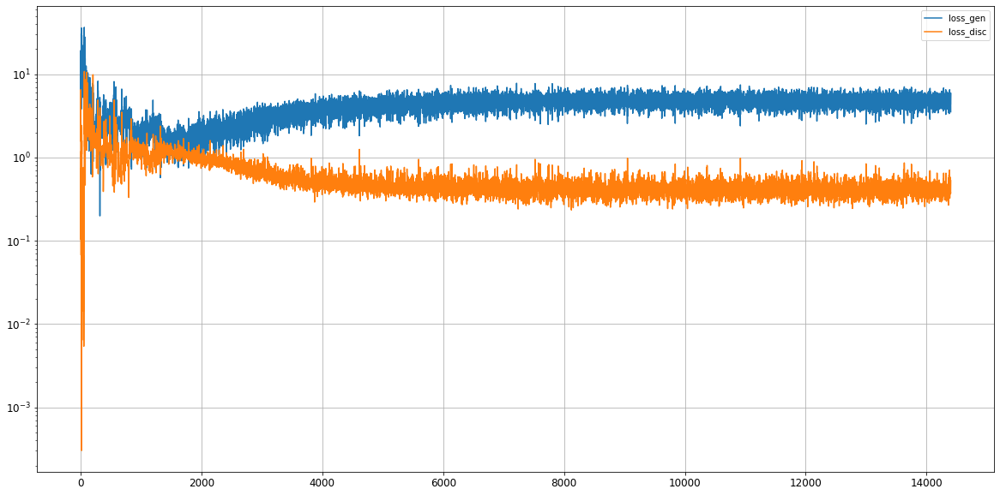

Epoch 14402/50000
0s
Epoch 14403/50000
0s
Epoch 14404/50000
0s
Epoch 14405/50000
0s
Epoch 14406/50000
0s
Epoch 14407/50000
0s
Epoch 14408/50000
0s
Epoch 14409/50000
0s
Epoch 14410/50000
0s
Epoch 14411/50000
0s
Epoch 14412/50000
0s
Epoch 14413/50000
0s
Epoch 14414/50000
0s
Epoch 14415/50000
0s
Epoch 14416/50000
0s
Epoch 14417/50000
0s
Epoch 14418/50000
0s
Epoch 14419/50000
0s
Epoch 14420/50000
0s
Epoch 14421/50000
0s
Epoch 14422/50000
0s
Epoch 14423/50000
0s
Epoch 14424/50000
0s
Epoch 14425/50000
0s
Epoch 14426/50000
0s
Epoch 14427/50000
0s
Epoch 14428/50000
0s
Epoch 14429/50000
0s
Epoch 14430/50000
0s
Epoch 14431/50000
0s
Epoch 14432/50000
0s
Epoch 14433/50000
0s
Epoch 14434/50000
0s
Epoch 14435/50000
0s
Epoch 14436/50000
0s
Epoch 14437/50000
0s
Epoch 14438/50000
0s
Epoch 14439/50000
0s
Epoch 14440/50000
0s
Epoch 14441/50000
0s
Epoch 14442/50000
0s
Epoch 14443/50000
0s
Epoch 14444/50000
0s
Epoch 14445/50000
0s
Epoch 14446/50000
0s
Epoch 14447/50000
0s
Epoch 14448/50000
0s
Epoch 14449/5

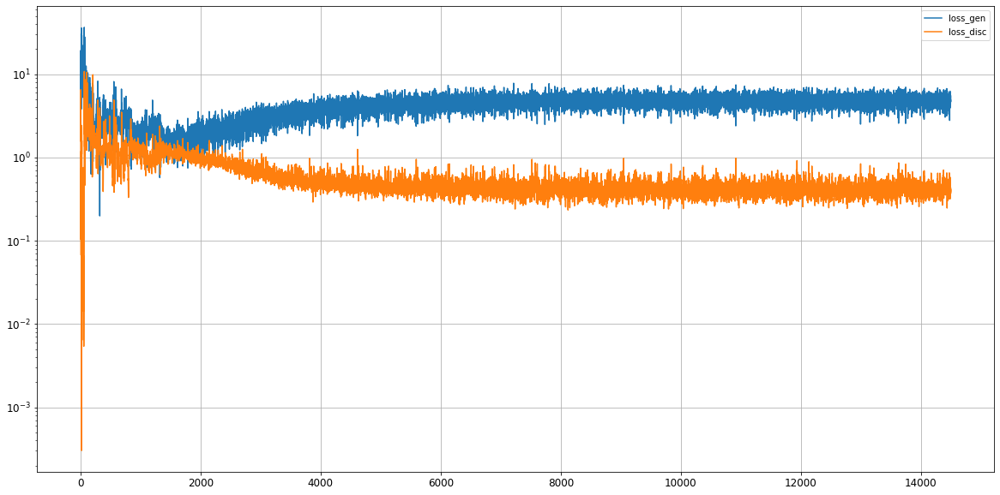

Epoch 14502/50000
0s
Epoch 14503/50000
0s
Epoch 14504/50000
0s
Epoch 14505/50000
0s
Epoch 14506/50000
0s
Epoch 14507/50000
0s
Epoch 14508/50000
0s
Epoch 14509/50000
0s
Epoch 14510/50000
0s
Epoch 14511/50000
0s
Epoch 14512/50000
0s
Epoch 14513/50000
0s
Epoch 14514/50000
0s
Epoch 14515/50000
0s
Epoch 14516/50000
0s
Epoch 14517/50000
0s
Epoch 14518/50000
0s
Epoch 14519/50000
0s
Epoch 14520/50000
0s
Epoch 14521/50000
0s
Epoch 14522/50000
0s
Epoch 14523/50000
0s
Epoch 14524/50000
0s
Epoch 14525/50000
0s
Epoch 14526/50000
0s
Epoch 14527/50000
0s
Epoch 14528/50000
0s
Epoch 14529/50000
0s
Epoch 14530/50000
0s
Epoch 14531/50000
0s
Epoch 14532/50000
0s
Epoch 14533/50000
0s
Epoch 14534/50000
0s
Epoch 14535/50000
0s
Epoch 14536/50000
0s
Epoch 14537/50000
0s
Epoch 14538/50000
0s
Epoch 14539/50000
0s
Epoch 14540/50000
0s
Epoch 14541/50000
0s
Epoch 14542/50000
0s
Epoch 14543/50000
0s
Epoch 14544/50000
0s
Epoch 14545/50000
0s
Epoch 14546/50000
0s
Epoch 14547/50000
0s
Epoch 14548/50000
0s
Epoch 14549/5

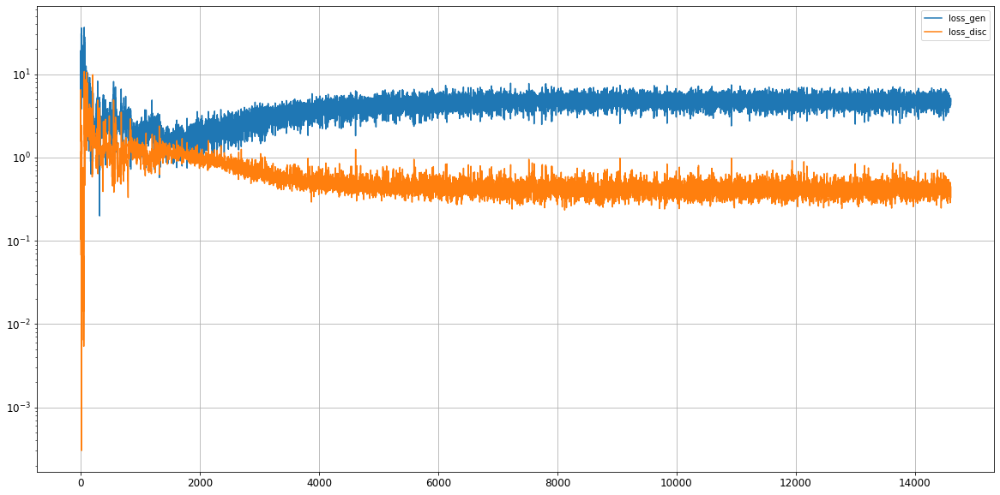

Epoch 14602/50000
0s
Epoch 14603/50000
0s
Epoch 14604/50000
0s
Epoch 14605/50000
0s
Epoch 14606/50000
0s
Epoch 14607/50000
0s
Epoch 14608/50000
0s
Epoch 14609/50000
0s
Epoch 14610/50000
0s
Epoch 14611/50000
0s
Epoch 14612/50000
0s
Epoch 14613/50000
0s
Epoch 14614/50000
0s
Epoch 14615/50000
0s
Epoch 14616/50000
0s
Epoch 14617/50000
0s
Epoch 14618/50000
0s
Epoch 14619/50000
0s
Epoch 14620/50000
0s
Epoch 14621/50000
0s
Epoch 14622/50000
0s
Epoch 14623/50000
0s
Epoch 14624/50000
0s
Epoch 14625/50000
0s
Epoch 14626/50000
0s
Epoch 14627/50000
0s
Epoch 14628/50000
0s
Epoch 14629/50000
0s
Epoch 14630/50000
0s
Epoch 14631/50000
0s
Epoch 14632/50000
0s
Epoch 14633/50000
0s
Epoch 14634/50000
0s
Epoch 14635/50000
0s
Epoch 14636/50000
0s
Epoch 14637/50000
0s
Epoch 14638/50000
0s
Epoch 14639/50000
0s
Epoch 14640/50000
0s
Epoch 14641/50000
0s
Epoch 14642/50000
0s
Epoch 14643/50000
0s
Epoch 14644/50000
0s
Epoch 14645/50000
0s
Epoch 14646/50000
0s
Epoch 14647/50000
0s
Epoch 14648/50000
0s
Epoch 14649/5

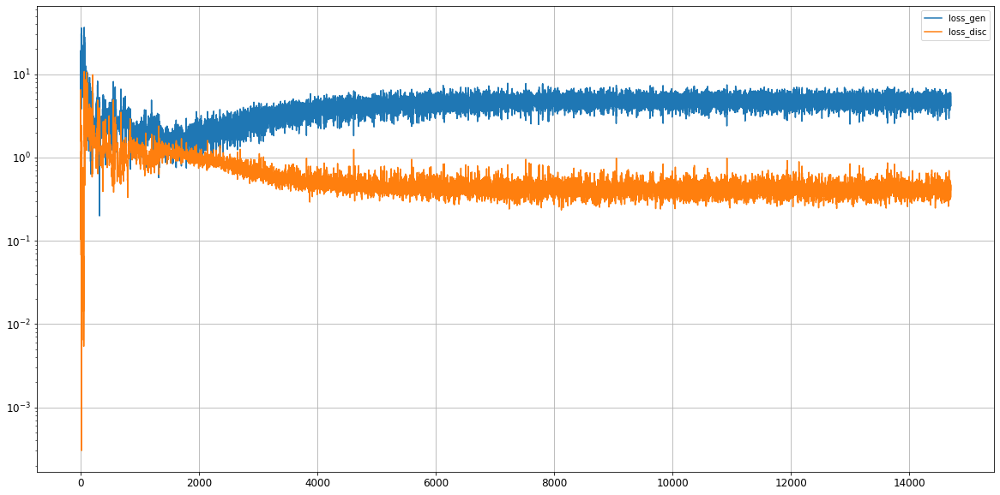

Epoch 14702/50000
0s
Epoch 14703/50000
0s
Epoch 14704/50000
0s
Epoch 14705/50000
0s
Epoch 14706/50000
0s
Epoch 14707/50000
0s
Epoch 14708/50000
0s
Epoch 14709/50000
0s
Epoch 14710/50000
0s
Epoch 14711/50000
0s
Epoch 14712/50000
0s
Epoch 14713/50000
0s
Epoch 14714/50000
0s
Epoch 14715/50000
0s
Epoch 14716/50000
0s
Epoch 14717/50000
0s
Epoch 14718/50000
0s
Epoch 14719/50000
0s
Epoch 14720/50000
0s
Epoch 14721/50000
0s
Epoch 14722/50000
0s
Epoch 14723/50000
0s
Epoch 14724/50000
0s
Epoch 14725/50000
0s
Epoch 14726/50000
0s
Epoch 14727/50000
0s
Epoch 14728/50000
0s
Epoch 14729/50000
0s
Epoch 14730/50000
0s
Epoch 14731/50000
0s
Epoch 14732/50000
0s
Epoch 14733/50000
0s
Epoch 14734/50000
0s
Epoch 14735/50000
0s
Epoch 14736/50000
0s
Epoch 14737/50000
0s
Epoch 14738/50000
0s
Epoch 14739/50000
0s
Epoch 14740/50000
0s
Epoch 14741/50000
0s
Epoch 14742/50000
0s
Epoch 14743/50000
0s
Epoch 14744/50000
0s
Epoch 14745/50000
0s
Epoch 14746/50000
0s
Epoch 14747/50000
0s
Epoch 14748/50000
0s
Epoch 14749/5

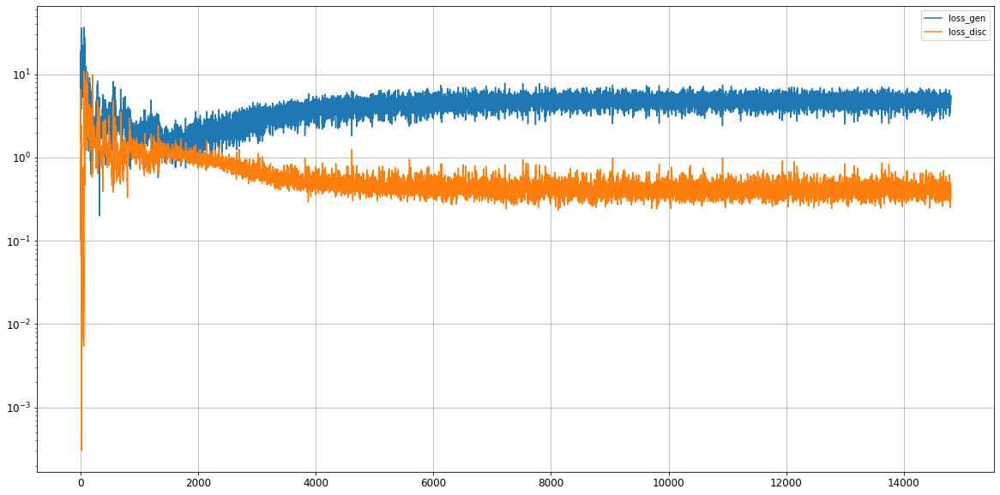

Epoch 14802/50000
0s
Epoch 14803/50000
0s
Epoch 14804/50000
0s
Epoch 14805/50000
0s
Epoch 14806/50000
0s
Epoch 14807/50000
0s
Epoch 14808/50000
0s
Epoch 14809/50000
0s
Epoch 14810/50000
0s
Epoch 14811/50000
0s
Epoch 14812/50000
0s
Epoch 14813/50000
0s
Epoch 14814/50000
0s
Epoch 14815/50000
0s
Epoch 14816/50000
0s
Epoch 14817/50000
0s
Epoch 14818/50000
0s
Epoch 14819/50000
0s
Epoch 14820/50000
0s
Epoch 14821/50000
0s
Epoch 14822/50000
0s
Epoch 14823/50000
0s
Epoch 14824/50000
0s
Epoch 14825/50000
0s
Epoch 14826/50000
0s
Epoch 14827/50000
0s
Epoch 14828/50000
0s
Epoch 14829/50000
0s
Epoch 14830/50000
0s
Epoch 14831/50000
0s
Epoch 14832/50000
0s
Epoch 14833/50000
0s
Epoch 14834/50000
0s
Epoch 14835/50000
0s
Epoch 14836/50000
0s
Epoch 14837/50000
0s
Epoch 14838/50000
0s
Epoch 14839/50000
0s
Epoch 14840/50000
0s
Epoch 14841/50000
0s
Epoch 14842/50000
0s
Epoch 14843/50000
0s
Epoch 14844/50000
0s
Epoch 14845/50000
0s
Epoch 14846/50000
0s
Epoch 14847/50000
0s
Epoch 14848/50000
0s
Epoch 14849/5

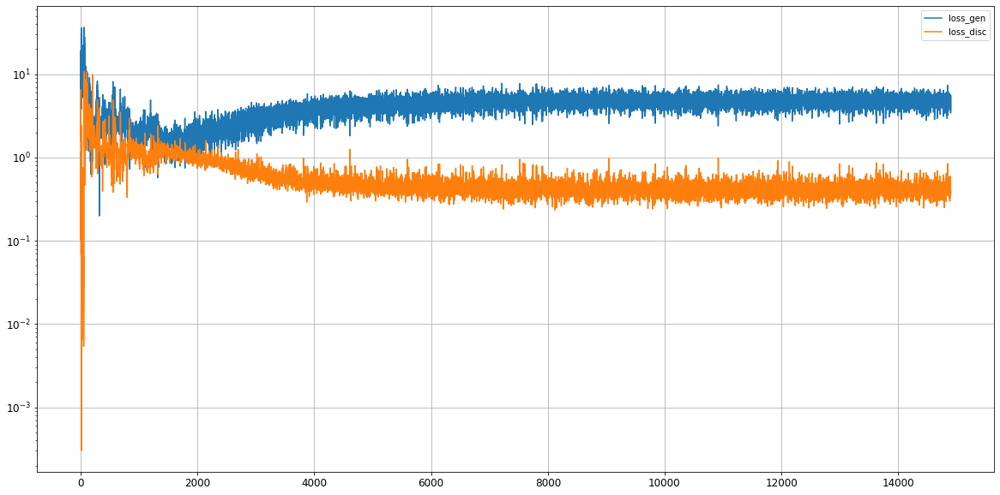

Epoch 14902/50000
0s
Epoch 14903/50000
0s
Epoch 14904/50000
0s
Epoch 14905/50000
0s
Epoch 14906/50000
0s
Epoch 14907/50000
0s
Epoch 14908/50000
0s
Epoch 14909/50000
0s
Epoch 14910/50000
0s
Epoch 14911/50000
0s
Epoch 14912/50000
0s
Epoch 14913/50000
0s
Epoch 14914/50000
0s
Epoch 14915/50000
0s
Epoch 14916/50000
0s
Epoch 14917/50000
0s
Epoch 14918/50000
0s
Epoch 14919/50000
0s
Epoch 14920/50000
0s
Epoch 14921/50000
0s
Epoch 14922/50000
0s
Epoch 14923/50000
0s
Epoch 14924/50000
0s
Epoch 14925/50000
0s
Epoch 14926/50000
0s
Epoch 14927/50000
0s
Epoch 14928/50000
0s
Epoch 14929/50000
0s
Epoch 14930/50000
0s
Epoch 14931/50000
0s
Epoch 14932/50000
0s
Epoch 14933/50000
0s
Epoch 14934/50000
0s
Epoch 14935/50000
0s
Epoch 14936/50000
0s
Epoch 14937/50000
0s
Epoch 14938/50000
0s
Epoch 14939/50000
0s
Epoch 14940/50000
0s
Epoch 14941/50000
0s
Epoch 14942/50000
0s
Epoch 14943/50000
0s
Epoch 14944/50000
0s
Epoch 14945/50000
0s
Epoch 14946/50000
0s
Epoch 14947/50000
0s
Epoch 14948/50000
0s
Epoch 14949/5

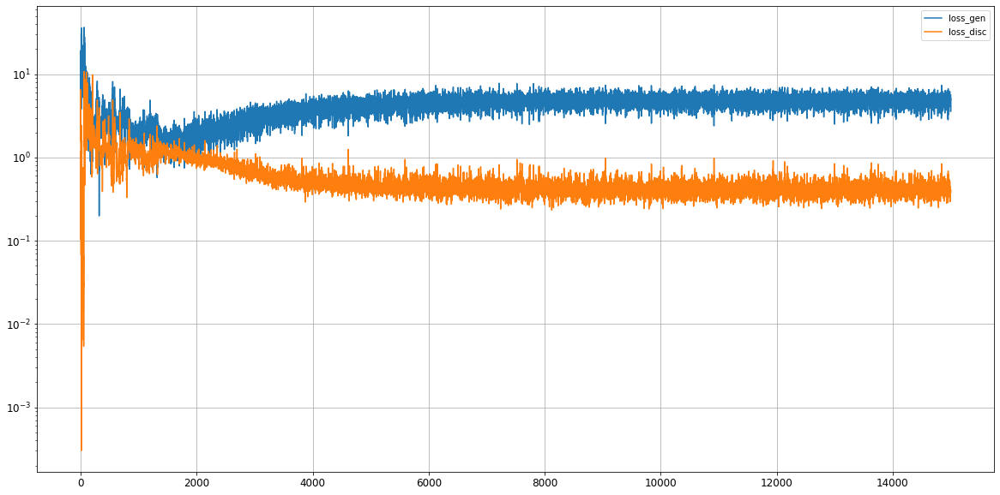

Epoch 15002/50000
0s
Epoch 15003/50000
0s
Epoch 15004/50000
0s
Epoch 15005/50000
0s
Epoch 15006/50000
0s
Epoch 15007/50000
0s
Epoch 15008/50000
0s
Epoch 15009/50000
0s
Epoch 15010/50000
0s
Epoch 15011/50000
0s
Epoch 15012/50000
0s
Epoch 15013/50000
0s
Epoch 15014/50000
0s
Epoch 15015/50000
0s
Epoch 15016/50000
0s
Epoch 15017/50000
0s
Epoch 15018/50000
0s
Epoch 15019/50000
0s
Epoch 15020/50000
0s
Epoch 15021/50000
0s
Epoch 15022/50000
0s
Epoch 15023/50000
0s
Epoch 15024/50000
0s
Epoch 15025/50000
0s
Epoch 15026/50000
0s
Epoch 15027/50000
0s
Epoch 15028/50000
0s
Epoch 15029/50000
0s
Epoch 15030/50000
0s
Epoch 15031/50000
0s
Epoch 15032/50000
0s
Epoch 15033/50000
0s
Epoch 15034/50000
0s
Epoch 15035/50000
0s
Epoch 15036/50000
0s
Epoch 15037/50000
0s
Epoch 15038/50000
0s
Epoch 15039/50000
0s
Epoch 15040/50000
0s
Epoch 15041/50000
0s
Epoch 15042/50000
0s
Epoch 15043/50000
0s
Epoch 15044/50000
0s
Epoch 15045/50000
0s
Epoch 15046/50000
0s
Epoch 15047/50000
0s
Epoch 15048/50000
0s
Epoch 15049/5

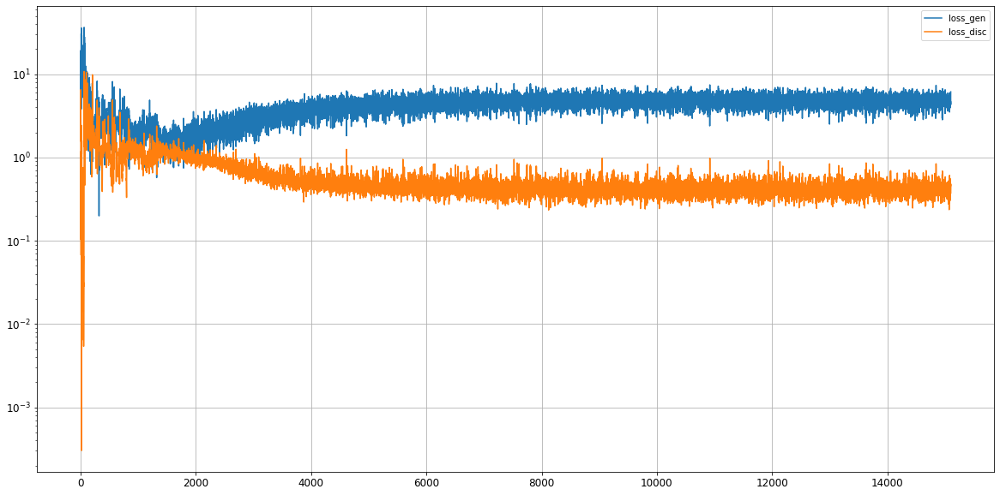

Epoch 15102/50000
0s
Epoch 15103/50000
0s
Epoch 15104/50000
0s
Epoch 15105/50000
0s
Epoch 15106/50000
0s
Epoch 15107/50000
0s
Epoch 15108/50000
0s
Epoch 15109/50000
0s
Epoch 15110/50000
0s
Epoch 15111/50000
0s
Epoch 15112/50000
0s
Epoch 15113/50000
0s
Epoch 15114/50000
0s
Epoch 15115/50000
0s
Epoch 15116/50000
0s
Epoch 15117/50000
0s
Epoch 15118/50000
0s
Epoch 15119/50000
0s
Epoch 15120/50000
0s
Epoch 15121/50000
0s
Epoch 15122/50000
0s
Epoch 15123/50000
0s
Epoch 15124/50000
0s
Epoch 15125/50000
0s
Epoch 15126/50000
0s
Epoch 15127/50000
0s
Epoch 15128/50000
0s
Epoch 15129/50000
0s
Epoch 15130/50000
0s
Epoch 15131/50000
0s
Epoch 15132/50000
0s
Epoch 15133/50000
0s
Epoch 15134/50000
0s
Epoch 15135/50000
0s
Epoch 15136/50000
0s
Epoch 15137/50000
0s
Epoch 15138/50000
0s
Epoch 15139/50000
0s
Epoch 15140/50000
0s
Epoch 15141/50000
0s
Epoch 15142/50000
0s
Epoch 15143/50000
0s
Epoch 15144/50000
0s
Epoch 15145/50000
0s
Epoch 15146/50000
0s
Epoch 15147/50000
0s
Epoch 15148/50000
0s
Epoch 15149/5

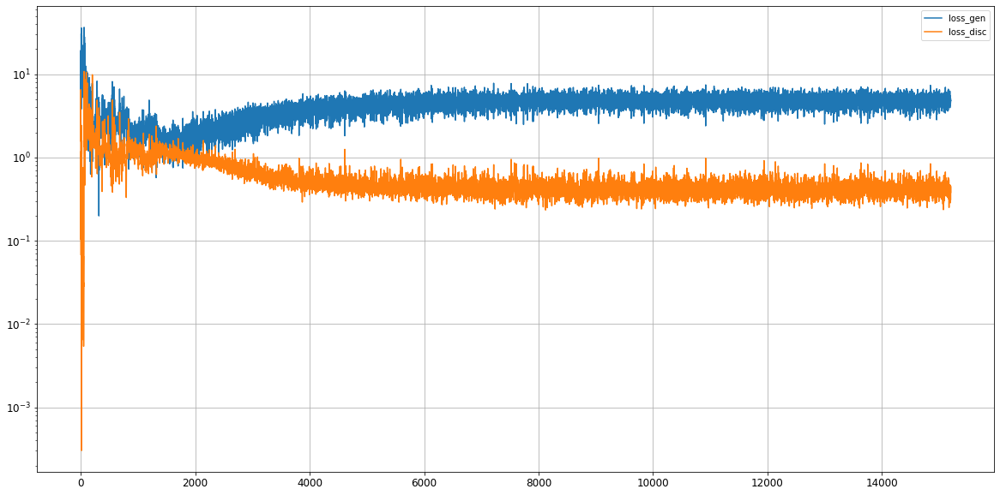

Epoch 15202/50000
0s
Epoch 15203/50000
0s
Epoch 15204/50000
0s
Epoch 15205/50000
0s
Epoch 15206/50000
0s
Epoch 15207/50000
0s
Epoch 15208/50000
0s
Epoch 15209/50000
0s
Epoch 15210/50000
0s
Epoch 15211/50000
0s
Epoch 15212/50000
0s
Epoch 15213/50000
0s
Epoch 15214/50000
0s
Epoch 15215/50000
0s
Epoch 15216/50000
0s
Epoch 15217/50000
0s
Epoch 15218/50000
0s
Epoch 15219/50000
0s
Epoch 15220/50000
0s
Epoch 15221/50000
0s
Epoch 15222/50000
0s
Epoch 15223/50000
0s
Epoch 15224/50000
0s
Epoch 15225/50000
0s
Epoch 15226/50000
0s
Epoch 15227/50000
0s
Epoch 15228/50000
0s
Epoch 15229/50000
0s
Epoch 15230/50000
0s
Epoch 15231/50000
0s
Epoch 15232/50000
0s
Epoch 15233/50000
0s
Epoch 15234/50000
0s
Epoch 15235/50000
0s
Epoch 15236/50000
0s
Epoch 15237/50000
0s
Epoch 15238/50000
0s
Epoch 15239/50000
0s
Epoch 15240/50000
0s
Epoch 15241/50000
0s
Epoch 15242/50000
0s
Epoch 15243/50000
0s
Epoch 15244/50000
0s
Epoch 15245/50000
0s
Epoch 15246/50000
0s
Epoch 15247/50000
0s
Epoch 15248/50000
0s
Epoch 15249/5

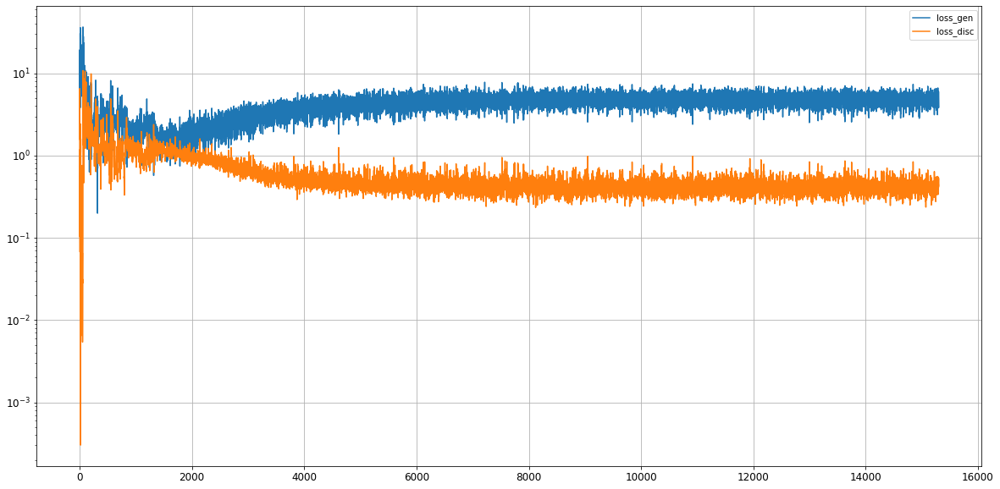

Epoch 15302/50000
0s
Epoch 15303/50000
0s
Epoch 15304/50000
0s
Epoch 15305/50000
0s
Epoch 15306/50000
0s
Epoch 15307/50000
0s
Epoch 15308/50000
0s
Epoch 15309/50000
0s
Epoch 15310/50000
0s
Epoch 15311/50000
0s
Epoch 15312/50000
0s
Epoch 15313/50000
0s
Epoch 15314/50000
0s
Epoch 15315/50000
0s
Epoch 15316/50000
0s
Epoch 15317/50000
0s
Epoch 15318/50000
0s
Epoch 15319/50000
0s
Epoch 15320/50000
0s
Epoch 15321/50000
0s
Epoch 15322/50000
0s
Epoch 15323/50000
0s
Epoch 15324/50000
0s
Epoch 15325/50000
0s
Epoch 15326/50000
0s
Epoch 15327/50000
0s
Epoch 15328/50000
0s
Epoch 15329/50000
0s
Epoch 15330/50000
0s
Epoch 15331/50000
0s
Epoch 15332/50000
0s
Epoch 15333/50000
0s
Epoch 15334/50000
0s
Epoch 15335/50000
0s
Epoch 15336/50000
0s
Epoch 15337/50000
0s
Epoch 15338/50000
0s
Epoch 15339/50000
0s
Epoch 15340/50000
0s
Epoch 15341/50000
0s
Epoch 15342/50000
0s
Epoch 15343/50000
0s
Epoch 15344/50000
0s
Epoch 15345/50000
0s
Epoch 15346/50000
0s
Epoch 15347/50000
0s
Epoch 15348/50000
0s
Epoch 15349/5

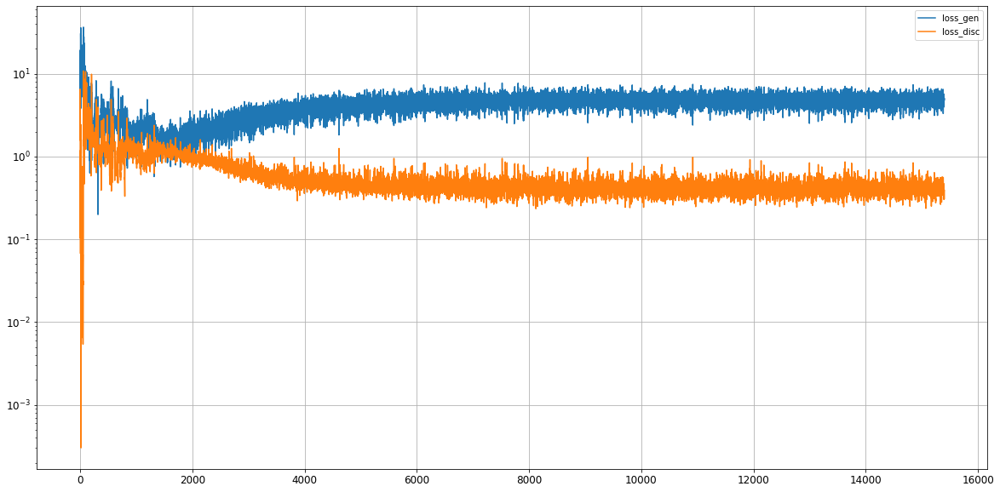

Epoch 15402/50000
0s
Epoch 15403/50000
0s
Epoch 15404/50000
0s
Epoch 15405/50000
0s
Epoch 15406/50000
0s
Epoch 15407/50000
0s
Epoch 15408/50000
0s
Epoch 15409/50000
0s
Epoch 15410/50000
0s
Epoch 15411/50000
0s
Epoch 15412/50000
0s
Epoch 15413/50000
0s
Epoch 15414/50000
0s
Epoch 15415/50000
0s
Epoch 15416/50000
0s
Epoch 15417/50000
0s
Epoch 15418/50000
0s
Epoch 15419/50000
0s
Epoch 15420/50000
0s
Epoch 15421/50000
0s
Epoch 15422/50000
0s
Epoch 15423/50000
0s
Epoch 15424/50000
0s
Epoch 15425/50000
0s
Epoch 15426/50000
0s
Epoch 15427/50000
0s
Epoch 15428/50000
0s
Epoch 15429/50000
0s
Epoch 15430/50000
0s
Epoch 15431/50000
0s
Epoch 15432/50000
0s
Epoch 15433/50000
0s
Epoch 15434/50000
0s
Epoch 15435/50000
0s
Epoch 15436/50000
0s
Epoch 15437/50000
0s
Epoch 15438/50000
0s
Epoch 15439/50000
0s
Epoch 15440/50000
0s
Epoch 15441/50000
0s
Epoch 15442/50000
0s
Epoch 15443/50000
0s
Epoch 15444/50000
0s
Epoch 15445/50000
0s
Epoch 15446/50000
0s
Epoch 15447/50000
0s
Epoch 15448/50000
0s
Epoch 15449/5

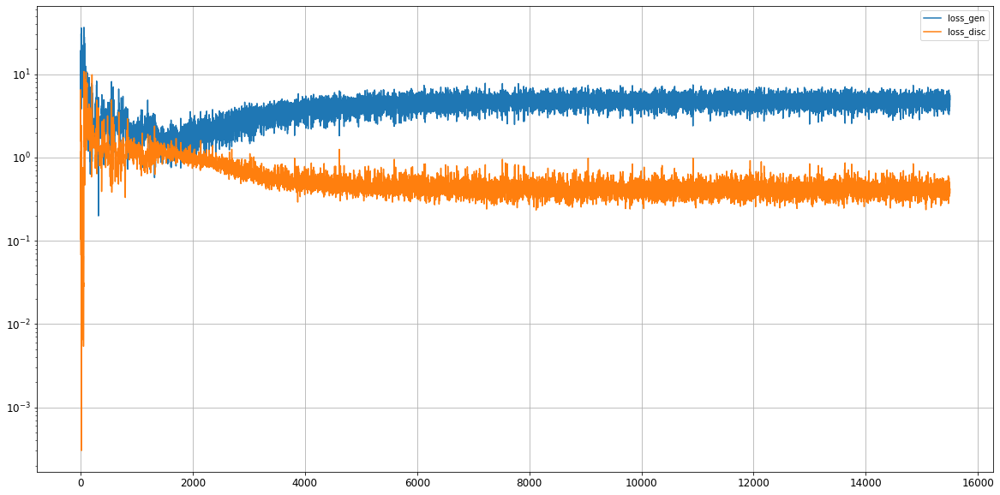

Epoch 15502/50000
0s
Epoch 15503/50000
0s
Epoch 15504/50000
0s
Epoch 15505/50000
0s
Epoch 15506/50000
0s
Epoch 15507/50000
0s
Epoch 15508/50000
0s
Epoch 15509/50000
0s
Epoch 15510/50000
0s
Epoch 15511/50000
0s
Epoch 15512/50000
0s
Epoch 15513/50000
0s
Epoch 15514/50000
0s
Epoch 15515/50000
0s
Epoch 15516/50000
0s
Epoch 15517/50000
0s
Epoch 15518/50000
0s
Epoch 15519/50000
0s
Epoch 15520/50000
0s
Epoch 15521/50000
0s
Epoch 15522/50000
0s
Epoch 15523/50000
0s
Epoch 15524/50000
0s
Epoch 15525/50000
0s
Epoch 15526/50000
0s
Epoch 15527/50000
0s
Epoch 15528/50000
0s
Epoch 15529/50000
0s
Epoch 15530/50000
0s
Epoch 15531/50000
0s
Epoch 15532/50000
0s
Epoch 15533/50000
0s
Epoch 15534/50000
0s
Epoch 15535/50000
0s
Epoch 15536/50000
0s
Epoch 15537/50000
0s
Epoch 15538/50000
0s
Epoch 15539/50000
0s
Epoch 15540/50000
0s
Epoch 15541/50000
0s
Epoch 15542/50000
0s
Epoch 15543/50000
0s
Epoch 15544/50000
0s
Epoch 15545/50000
0s
Epoch 15546/50000
0s
Epoch 15547/50000
0s
Epoch 15548/50000
0s
Epoch 15549/5

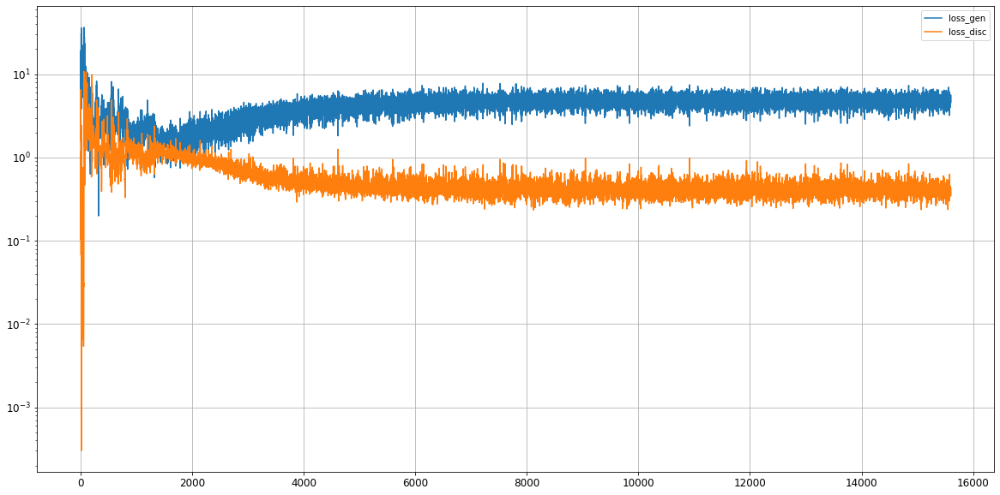

Epoch 15602/50000
0s
Epoch 15603/50000
0s
Epoch 15604/50000
0s
Epoch 15605/50000
0s
Epoch 15606/50000
0s
Epoch 15607/50000
0s
Epoch 15608/50000
0s
Epoch 15609/50000
0s
Epoch 15610/50000
0s
Epoch 15611/50000
0s
Epoch 15612/50000
0s
Epoch 15613/50000
0s
Epoch 15614/50000
0s
Epoch 15615/50000
0s
Epoch 15616/50000
0s
Epoch 15617/50000
0s
Epoch 15618/50000
0s
Epoch 15619/50000
0s
Epoch 15620/50000
0s
Epoch 15621/50000
0s
Epoch 15622/50000
0s
Epoch 15623/50000
0s
Epoch 15624/50000
0s
Epoch 15625/50000
0s
Epoch 15626/50000
0s
Epoch 15627/50000
0s
Epoch 15628/50000
0s
Epoch 15629/50000
0s
Epoch 15630/50000
0s
Epoch 15631/50000
0s
Epoch 15632/50000
0s
Epoch 15633/50000
0s
Epoch 15634/50000
0s
Epoch 15635/50000
0s
Epoch 15636/50000
0s
Epoch 15637/50000
0s
Epoch 15638/50000
0s
Epoch 15639/50000
0s
Epoch 15640/50000
0s
Epoch 15641/50000
0s
Epoch 15642/50000
0s
Epoch 15643/50000
0s
Epoch 15644/50000
0s
Epoch 15645/50000
0s
Epoch 15646/50000
0s
Epoch 15647/50000
0s
Epoch 15648/50000
0s
Epoch 15649/5

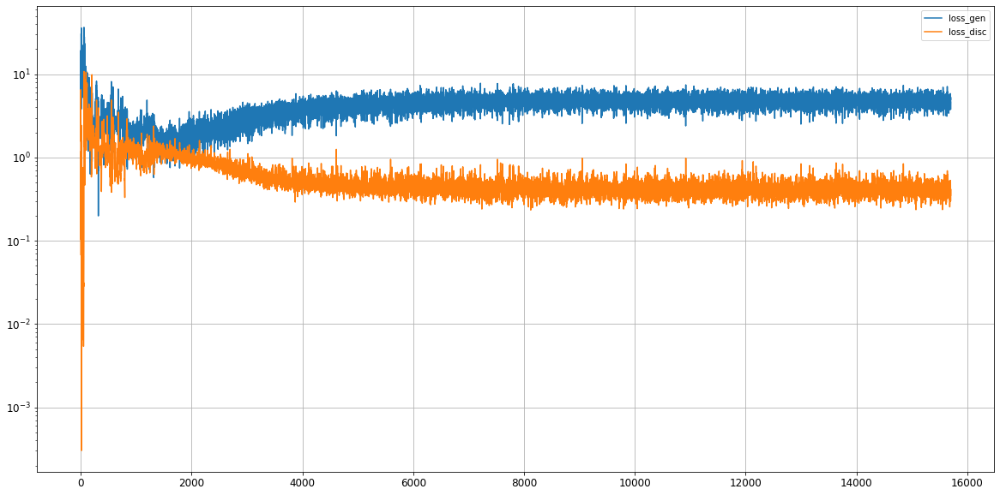

Epoch 15702/50000
0s
Epoch 15703/50000
0s
Epoch 15704/50000
0s
Epoch 15705/50000
0s
Epoch 15706/50000
0s
Epoch 15707/50000
0s
Epoch 15708/50000
0s
Epoch 15709/50000
0s
Epoch 15710/50000
0s
Epoch 15711/50000
0s
Epoch 15712/50000
0s
Epoch 15713/50000
0s
Epoch 15714/50000
0s
Epoch 15715/50000
0s
Epoch 15716/50000
0s
Epoch 15717/50000
0s
Epoch 15718/50000
0s
Epoch 15719/50000
0s
Epoch 15720/50000
0s
Epoch 15721/50000
0s
Epoch 15722/50000
0s
Epoch 15723/50000
0s
Epoch 15724/50000
0s
Epoch 15725/50000
0s
Epoch 15726/50000
0s
Epoch 15727/50000
0s
Epoch 15728/50000
0s
Epoch 15729/50000
0s
Epoch 15730/50000
0s
Epoch 15731/50000
0s
Epoch 15732/50000
0s
Epoch 15733/50000
0s
Epoch 15734/50000
0s
Epoch 15735/50000
0s
Epoch 15736/50000
0s
Epoch 15737/50000
0s
Epoch 15738/50000
0s
Epoch 15739/50000
0s
Epoch 15740/50000
0s
Epoch 15741/50000
0s
Epoch 15742/50000
0s
Epoch 15743/50000
0s
Epoch 15744/50000
0s
Epoch 15745/50000
0s
Epoch 15746/50000
0s
Epoch 15747/50000
0s
Epoch 15748/50000
0s
Epoch 15749/5

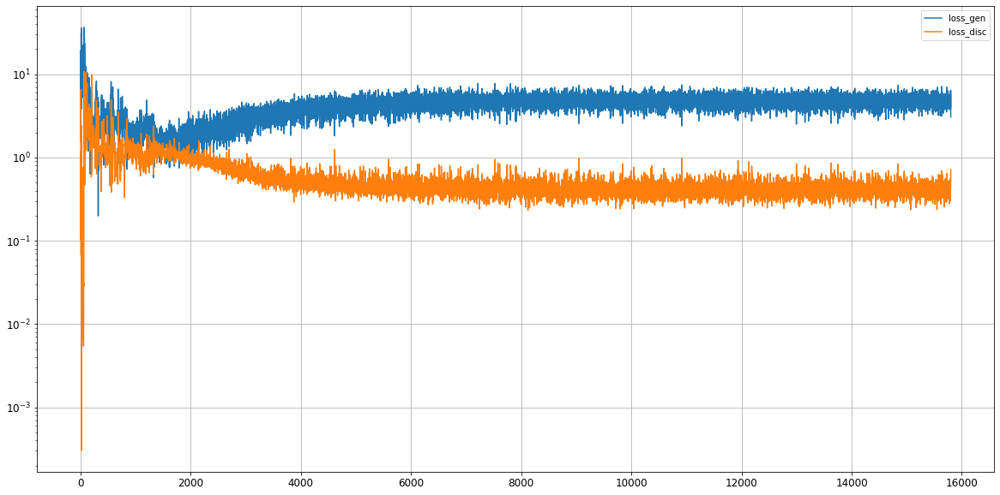

Epoch 15802/50000
0s
Epoch 15803/50000
0s
Epoch 15804/50000
0s
Epoch 15805/50000
0s
Epoch 15806/50000
0s
Epoch 15807/50000
0s
Epoch 15808/50000
0s
Epoch 15809/50000
0s
Epoch 15810/50000
0s
Epoch 15811/50000
0s
Epoch 15812/50000
0s
Epoch 15813/50000
0s
Epoch 15814/50000
0s
Epoch 15815/50000
0s
Epoch 15816/50000
0s
Epoch 15817/50000
0s
Epoch 15818/50000
0s
Epoch 15819/50000
0s
Epoch 15820/50000
0s
Epoch 15821/50000
0s
Epoch 15822/50000
0s
Epoch 15823/50000
0s
Epoch 15824/50000
0s
Epoch 15825/50000
0s
Epoch 15826/50000
0s
Epoch 15827/50000
0s
Epoch 15828/50000
0s
Epoch 15829/50000
0s
Epoch 15830/50000
0s
Epoch 15831/50000
0s
Epoch 15832/50000
0s
Epoch 15833/50000
0s
Epoch 15834/50000
0s
Epoch 15835/50000
0s
Epoch 15836/50000
0s
Epoch 15837/50000
0s
Epoch 15838/50000
0s
Epoch 15839/50000
0s
Epoch 15840/50000
0s
Epoch 15841/50000
0s
Epoch 15842/50000
0s
Epoch 15843/50000
0s
Epoch 15844/50000
0s
Epoch 15845/50000
0s
Epoch 15846/50000
0s
Epoch 15847/50000
0s
Epoch 15848/50000
0s
Epoch 15849/5

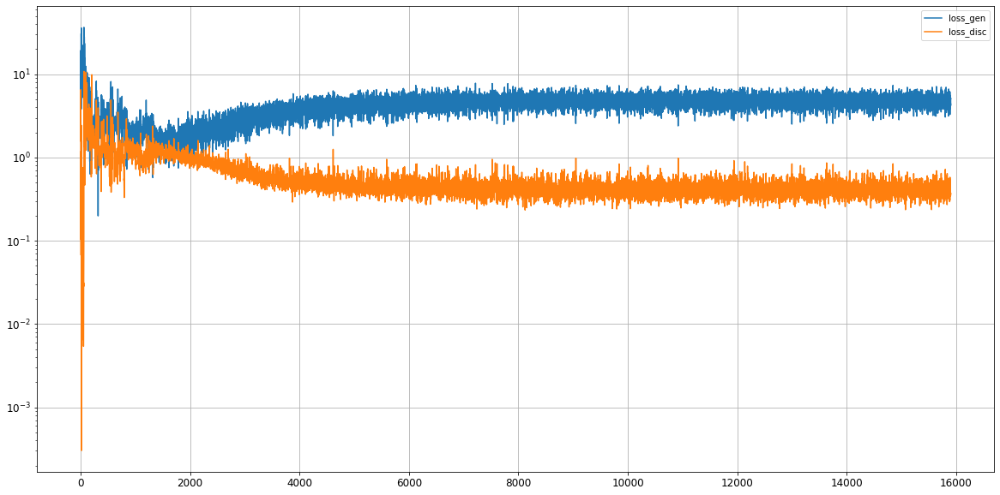

Epoch 15902/50000
0s
Epoch 15903/50000
0s
Epoch 15904/50000
0s
Epoch 15905/50000
0s
Epoch 15906/50000
0s
Epoch 15907/50000
0s
Epoch 15908/50000
0s
Epoch 15909/50000
0s
Epoch 15910/50000
0s
Epoch 15911/50000
0s
Epoch 15912/50000
0s
Epoch 15913/50000
0s
Epoch 15914/50000
0s
Epoch 15915/50000
0s
Epoch 15916/50000
0s
Epoch 15917/50000
0s
Epoch 15918/50000
0s
Epoch 15919/50000
0s
Epoch 15920/50000
0s
Epoch 15921/50000
0s
Epoch 15922/50000
0s
Epoch 15923/50000
0s
Epoch 15924/50000
0s
Epoch 15925/50000
0s
Epoch 15926/50000
0s
Epoch 15927/50000
0s
Epoch 15928/50000
0s
Epoch 15929/50000
0s
Epoch 15930/50000
0s
Epoch 15931/50000
0s
Epoch 15932/50000
0s
Epoch 15933/50000
0s
Epoch 15934/50000
0s
Epoch 15935/50000
0s
Epoch 15936/50000
0s
Epoch 15937/50000
0s
Epoch 15938/50000
0s
Epoch 15939/50000
0s
Epoch 15940/50000
0s
Epoch 15941/50000
0s
Epoch 15942/50000
0s
Epoch 15943/50000
0s
Epoch 15944/50000
0s
Epoch 15945/50000
0s
Epoch 15946/50000
0s
Epoch 15947/50000
0s
Epoch 15948/50000
0s
Epoch 15949/5

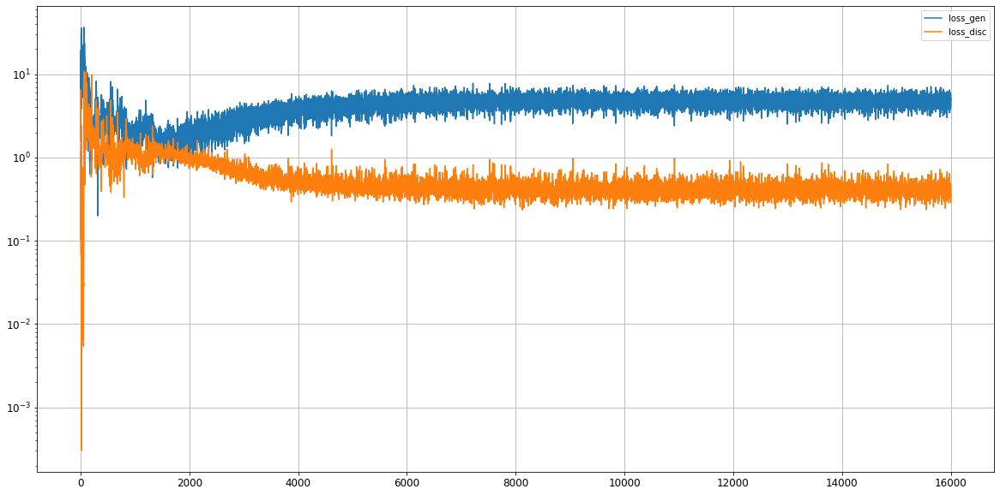

Epoch 16002/50000
0s
Epoch 16003/50000
0s
Epoch 16004/50000
0s
Epoch 16005/50000
0s
Epoch 16006/50000
0s
Epoch 16007/50000
0s
Epoch 16008/50000
0s
Epoch 16009/50000
0s
Epoch 16010/50000
0s
Epoch 16011/50000
0s
Epoch 16012/50000
0s
Epoch 16013/50000
0s
Epoch 16014/50000
0s
Epoch 16015/50000
0s
Epoch 16016/50000
0s
Epoch 16017/50000
0s
Epoch 16018/50000
0s
Epoch 16019/50000
0s
Epoch 16020/50000
0s
Epoch 16021/50000
0s
Epoch 16022/50000
0s
Epoch 16023/50000
0s
Epoch 16024/50000
0s
Epoch 16025/50000
0s
Epoch 16026/50000
0s
Epoch 16027/50000
0s
Epoch 16028/50000
0s
Epoch 16029/50000
0s
Epoch 16030/50000
0s
Epoch 16031/50000
0s
Epoch 16032/50000
0s
Epoch 16033/50000
0s
Epoch 16034/50000
0s
Epoch 16035/50000
0s
Epoch 16036/50000
0s
Epoch 16037/50000
0s
Epoch 16038/50000
0s
Epoch 16039/50000
0s
Epoch 16040/50000
0s
Epoch 16041/50000
0s
Epoch 16042/50000
0s
Epoch 16043/50000
0s
Epoch 16044/50000
0s
Epoch 16045/50000
0s
Epoch 16046/50000
0s
Epoch 16047/50000
0s
Epoch 16048/50000
0s
Epoch 16049/5

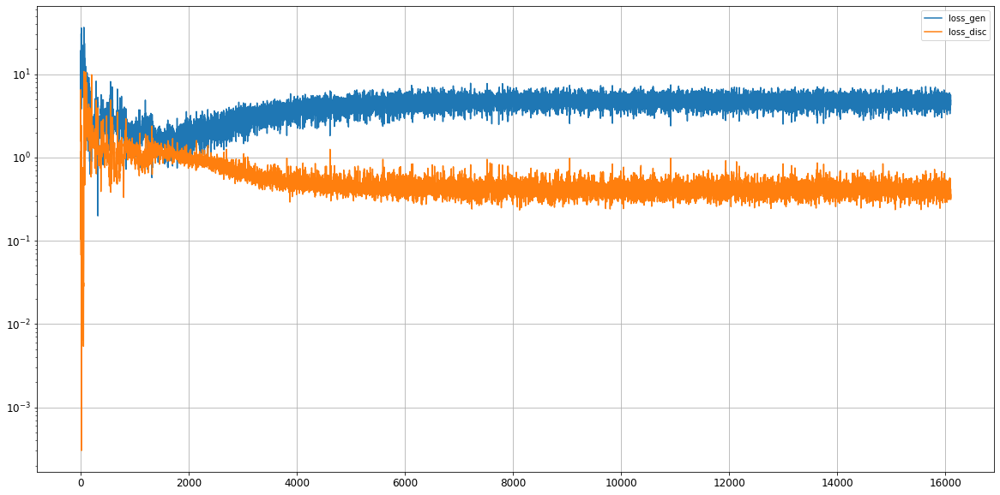

Epoch 16102/50000
0s
Epoch 16103/50000
0s
Epoch 16104/50000
0s
Epoch 16105/50000
0s
Epoch 16106/50000
0s
Epoch 16107/50000
0s
Epoch 16108/50000
0s
Epoch 16109/50000
0s
Epoch 16110/50000
0s
Epoch 16111/50000
0s
Epoch 16112/50000
0s
Epoch 16113/50000
0s
Epoch 16114/50000
0s
Epoch 16115/50000
0s
Epoch 16116/50000
0s
Epoch 16117/50000
0s
Epoch 16118/50000
0s
Epoch 16119/50000
0s
Epoch 16120/50000
0s
Epoch 16121/50000
0s
Epoch 16122/50000
0s
Epoch 16123/50000
0s
Epoch 16124/50000
0s
Epoch 16125/50000
0s
Epoch 16126/50000
0s
Epoch 16127/50000
0s
Epoch 16128/50000
0s
Epoch 16129/50000
0s
Epoch 16130/50000
0s
Epoch 16131/50000
0s
Epoch 16132/50000
0s
Epoch 16133/50000
0s
Epoch 16134/50000
0s
Epoch 16135/50000
0s
Epoch 16136/50000
0s
Epoch 16137/50000
0s
Epoch 16138/50000
0s
Epoch 16139/50000
0s
Epoch 16140/50000
0s
Epoch 16141/50000
0s
Epoch 16142/50000
0s
Epoch 16143/50000
0s
Epoch 16144/50000
0s
Epoch 16145/50000
0s
Epoch 16146/50000
0s
Epoch 16147/50000
0s
Epoch 16148/50000
0s
Epoch 16149/5

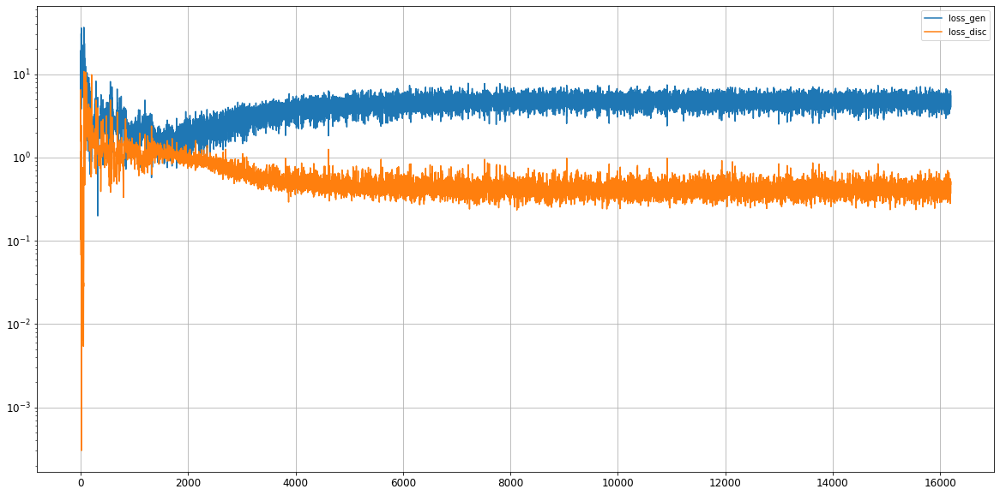

Epoch 16202/50000
0s
Epoch 16203/50000
0s
Epoch 16204/50000
0s
Epoch 16205/50000
0s
Epoch 16206/50000
0s
Epoch 16207/50000
0s
Epoch 16208/50000
0s
Epoch 16209/50000
0s
Epoch 16210/50000
0s
Epoch 16211/50000
0s
Epoch 16212/50000
0s
Epoch 16213/50000
0s
Epoch 16214/50000
0s
Epoch 16215/50000
0s
Epoch 16216/50000
0s
Epoch 16217/50000
0s
Epoch 16218/50000
0s
Epoch 16219/50000
0s
Epoch 16220/50000
0s
Epoch 16221/50000
0s
Epoch 16222/50000
0s
Epoch 16223/50000
0s
Epoch 16224/50000
0s
Epoch 16225/50000
0s
Epoch 16226/50000
0s
Epoch 16227/50000
0s
Epoch 16228/50000
0s
Epoch 16229/50000
0s
Epoch 16230/50000
0s
Epoch 16231/50000
0s
Epoch 16232/50000
0s
Epoch 16233/50000
0s
Epoch 16234/50000
0s
Epoch 16235/50000
0s
Epoch 16236/50000
0s
Epoch 16237/50000
0s
Epoch 16238/50000
0s
Epoch 16239/50000
0s
Epoch 16240/50000
0s
Epoch 16241/50000
0s
Epoch 16242/50000
0s
Epoch 16243/50000
0s
Epoch 16244/50000
0s
Epoch 16245/50000
0s
Epoch 16246/50000
0s
Epoch 16247/50000
0s
Epoch 16248/50000
0s
Epoch 16249/5

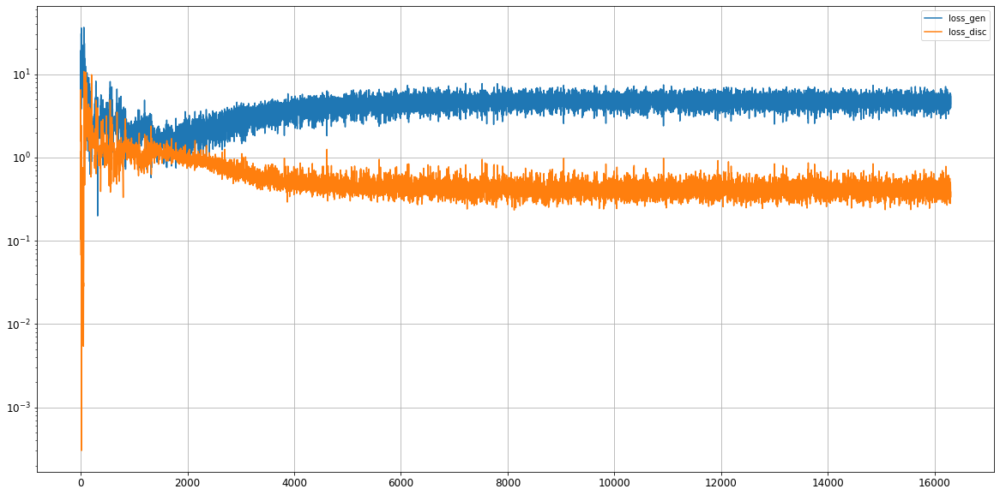

Epoch 16302/50000
0s
Epoch 16303/50000
0s
Epoch 16304/50000
0s
Epoch 16305/50000
0s
Epoch 16306/50000
0s
Epoch 16307/50000
0s
Epoch 16308/50000
0s
Epoch 16309/50000
0s
Epoch 16310/50000
0s
Epoch 16311/50000
0s
Epoch 16312/50000
0s
Epoch 16313/50000
0s
Epoch 16314/50000
0s
Epoch 16315/50000
0s
Epoch 16316/50000
0s
Epoch 16317/50000
0s
Epoch 16318/50000
0s
Epoch 16319/50000
0s
Epoch 16320/50000
0s
Epoch 16321/50000
0s
Epoch 16322/50000
0s
Epoch 16323/50000
0s
Epoch 16324/50000
0s
Epoch 16325/50000
0s
Epoch 16326/50000
0s
Epoch 16327/50000
0s
Epoch 16328/50000
0s
Epoch 16329/50000
0s
Epoch 16330/50000
0s
Epoch 16331/50000
0s
Epoch 16332/50000
0s
Epoch 16333/50000
0s
Epoch 16334/50000
0s
Epoch 16335/50000
0s
Epoch 16336/50000
0s
Epoch 16337/50000
0s
Epoch 16338/50000
0s
Epoch 16339/50000
0s
Epoch 16340/50000
0s
Epoch 16341/50000
0s
Epoch 16342/50000
0s
Epoch 16343/50000
0s
Epoch 16344/50000
0s
Epoch 16345/50000
0s
Epoch 16346/50000
0s
Epoch 16347/50000
0s
Epoch 16348/50000
0s
Epoch 16349/5

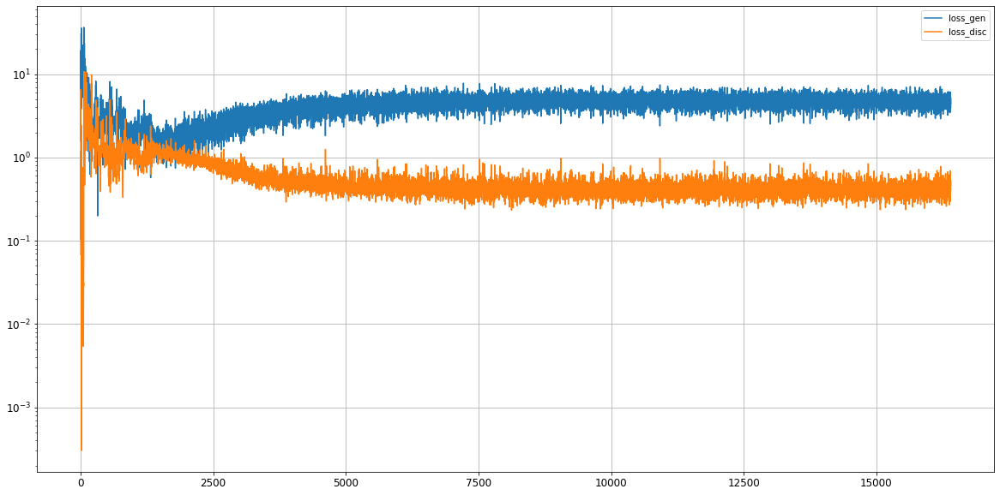

Epoch 16402/50000
0s
Epoch 16403/50000
0s
Epoch 16404/50000
0s
Epoch 16405/50000
0s
Epoch 16406/50000
0s
Epoch 16407/50000
0s
Epoch 16408/50000
0s
Epoch 16409/50000
0s
Epoch 16410/50000
0s
Epoch 16411/50000
0s
Epoch 16412/50000
0s
Epoch 16413/50000
0s
Epoch 16414/50000
0s
Epoch 16415/50000
0s
Epoch 16416/50000
0s
Epoch 16417/50000
0s
Epoch 16418/50000
0s
Epoch 16419/50000
0s
Epoch 16420/50000
0s
Epoch 16421/50000
0s
Epoch 16422/50000
0s
Epoch 16423/50000
0s
Epoch 16424/50000
0s
Epoch 16425/50000
0s
Epoch 16426/50000
0s
Epoch 16427/50000
0s
Epoch 16428/50000
0s
Epoch 16429/50000
0s
Epoch 16430/50000
0s
Epoch 16431/50000
0s
Epoch 16432/50000
0s
Epoch 16433/50000
0s
Epoch 16434/50000
0s
Epoch 16435/50000
0s
Epoch 16436/50000
0s
Epoch 16437/50000
0s
Epoch 16438/50000
0s
Epoch 16439/50000
0s
Epoch 16440/50000
0s
Epoch 16441/50000
0s
Epoch 16442/50000
0s
Epoch 16443/50000
0s
Epoch 16444/50000
0s
Epoch 16445/50000
0s
Epoch 16446/50000
0s
Epoch 16447/50000
0s
Epoch 16448/50000
0s
Epoch 16449/5

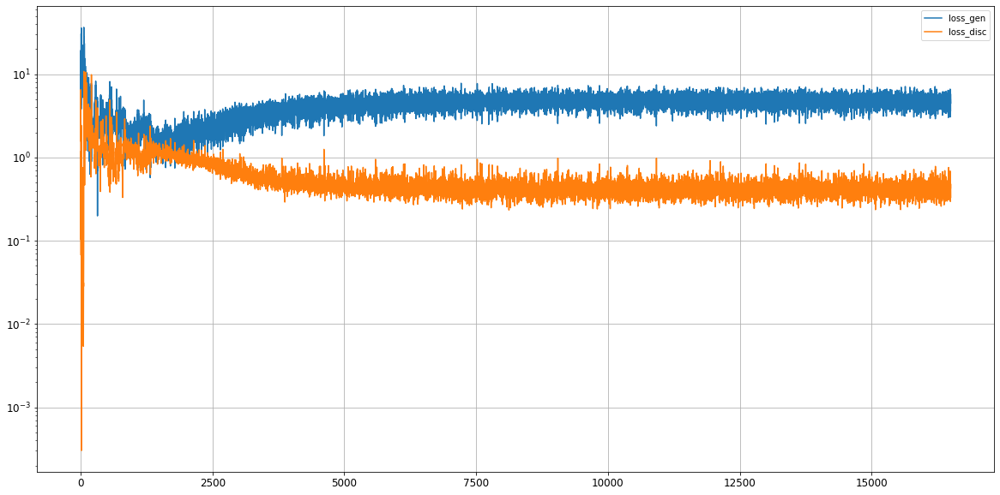

Epoch 16502/50000
0s
Epoch 16503/50000
0s
Epoch 16504/50000
0s
Epoch 16505/50000
0s
Epoch 16506/50000
0s
Epoch 16507/50000
0s
Epoch 16508/50000
0s
Epoch 16509/50000
0s
Epoch 16510/50000
0s
Epoch 16511/50000
0s
Epoch 16512/50000
0s
Epoch 16513/50000
0s
Epoch 16514/50000
0s
Epoch 16515/50000
0s
Epoch 16516/50000
0s
Epoch 16517/50000
0s
Epoch 16518/50000
0s
Epoch 16519/50000
0s
Epoch 16520/50000
0s
Epoch 16521/50000
0s
Epoch 16522/50000
0s
Epoch 16523/50000
0s
Epoch 16524/50000
0s
Epoch 16525/50000
0s
Epoch 16526/50000
0s
Epoch 16527/50000
0s
Epoch 16528/50000
0s
Epoch 16529/50000
0s
Epoch 16530/50000
0s
Epoch 16531/50000
0s
Epoch 16532/50000
0s
Epoch 16533/50000
0s
Epoch 16534/50000
0s
Epoch 16535/50000
0s
Epoch 16536/50000
0s
Epoch 16537/50000
0s
Epoch 16538/50000
0s
Epoch 16539/50000
0s
Epoch 16540/50000
0s
Epoch 16541/50000
0s
Epoch 16542/50000
0s
Epoch 16543/50000
0s
Epoch 16544/50000
0s
Epoch 16545/50000
0s
Epoch 16546/50000
0s
Epoch 16547/50000
0s
Epoch 16548/50000
0s
Epoch 16549/5

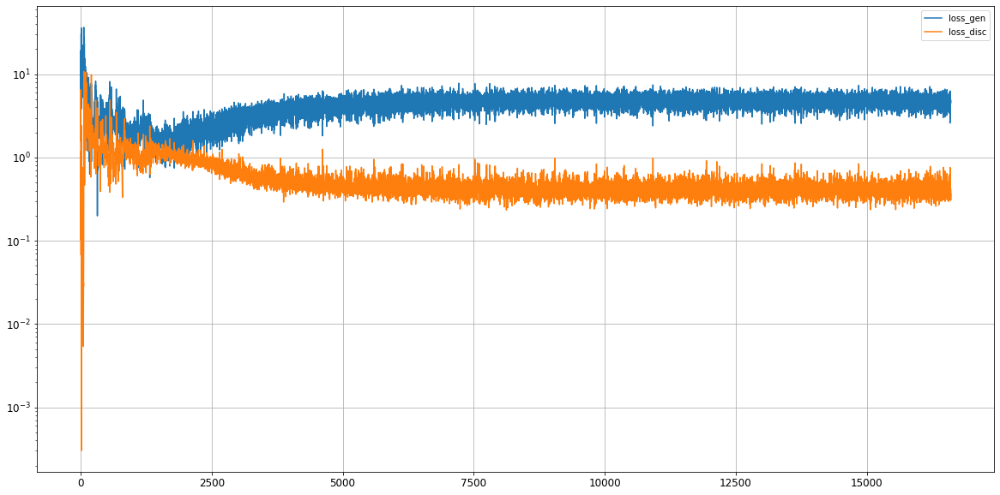

Epoch 16602/50000
0s
Epoch 16603/50000
0s
Epoch 16604/50000
0s
Epoch 16605/50000
0s
Epoch 16606/50000
0s
Epoch 16607/50000
0s
Epoch 16608/50000
0s
Epoch 16609/50000
0s
Epoch 16610/50000
0s
Epoch 16611/50000
0s
Epoch 16612/50000
0s
Epoch 16613/50000
0s
Epoch 16614/50000
0s
Epoch 16615/50000
0s
Epoch 16616/50000
0s
Epoch 16617/50000
0s
Epoch 16618/50000
0s
Epoch 16619/50000
0s
Epoch 16620/50000
0s
Epoch 16621/50000
0s
Epoch 16622/50000
0s
Epoch 16623/50000
0s
Epoch 16624/50000
0s
Epoch 16625/50000
0s
Epoch 16626/50000
0s
Epoch 16627/50000
0s
Epoch 16628/50000
0s
Epoch 16629/50000
0s
Epoch 16630/50000
0s
Epoch 16631/50000
0s
Epoch 16632/50000
0s
Epoch 16633/50000
0s
Epoch 16634/50000
0s
Epoch 16635/50000
0s
Epoch 16636/50000
0s
Epoch 16637/50000
0s
Epoch 16638/50000
0s
Epoch 16639/50000
0s
Epoch 16640/50000
0s
Epoch 16641/50000
0s
Epoch 16642/50000
0s
Epoch 16643/50000
0s
Epoch 16644/50000
0s
Epoch 16645/50000
0s
Epoch 16646/50000
0s
Epoch 16647/50000
0s
Epoch 16648/50000
0s
Epoch 16649/5

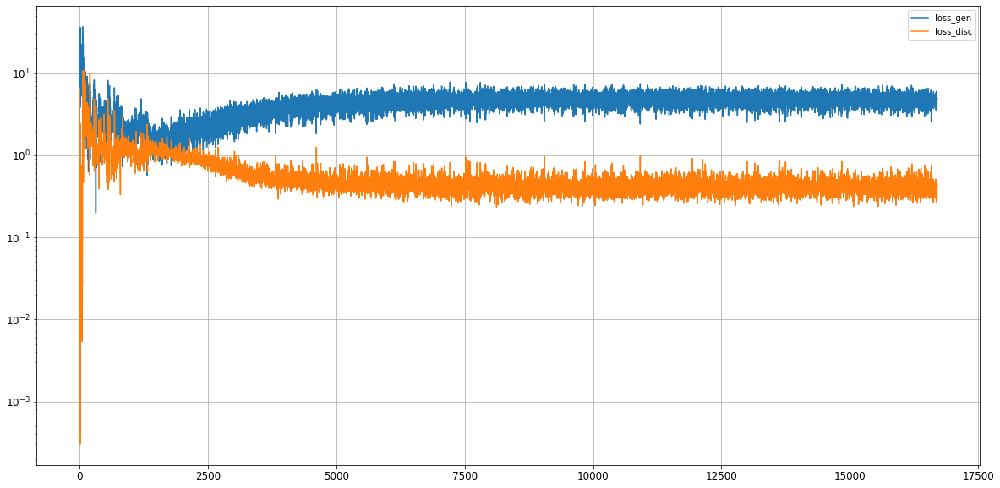

Epoch 16702/50000
0s
Epoch 16703/50000
0s
Epoch 16704/50000
0s
Epoch 16705/50000
0s
Epoch 16706/50000
0s
Epoch 16707/50000
0s
Epoch 16708/50000
0s
Epoch 16709/50000
0s
Epoch 16710/50000
0s
Epoch 16711/50000
0s
Epoch 16712/50000
0s
Epoch 16713/50000
0s
Epoch 16714/50000
0s
Epoch 16715/50000
0s
Epoch 16716/50000
0s
Epoch 16717/50000
0s
Epoch 16718/50000
0s
Epoch 16719/50000
0s
Epoch 16720/50000
0s
Epoch 16721/50000
0s
Epoch 16722/50000
0s
Epoch 16723/50000
0s
Epoch 16724/50000
0s
Epoch 16725/50000
0s
Epoch 16726/50000
0s
Epoch 16727/50000
0s
Epoch 16728/50000
0s
Epoch 16729/50000
0s
Epoch 16730/50000
0s
Epoch 16731/50000
0s
Epoch 16732/50000
0s
Epoch 16733/50000
0s
Epoch 16734/50000
0s
Epoch 16735/50000
0s
Epoch 16736/50000
0s
Epoch 16737/50000
0s
Epoch 16738/50000
0s
Epoch 16739/50000
0s
Epoch 16740/50000
0s
Epoch 16741/50000
0s
Epoch 16742/50000
0s
Epoch 16743/50000
0s
Epoch 16744/50000
0s
Epoch 16745/50000
0s
Epoch 16746/50000
0s
Epoch 16747/50000
0s
Epoch 16748/50000
0s
Epoch 16749/5

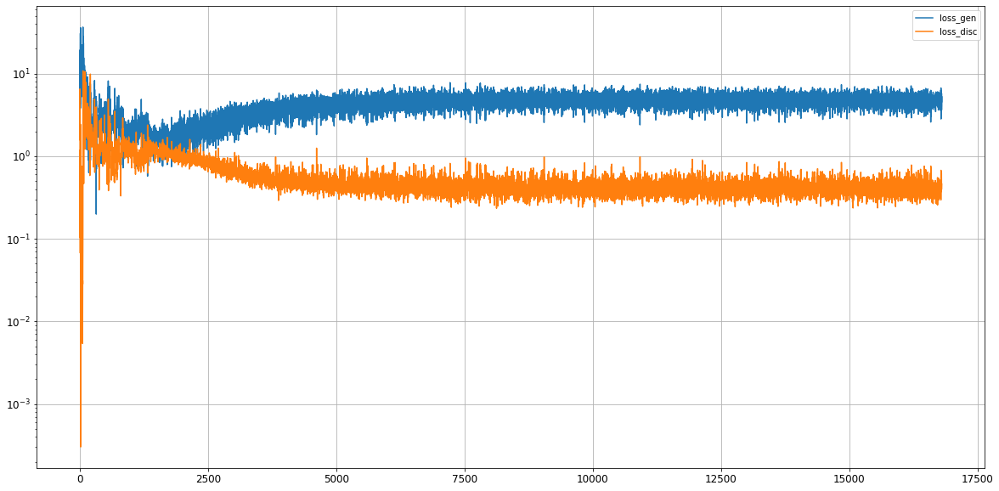

Epoch 16802/50000
0s
Epoch 16803/50000
0s
Epoch 16804/50000
0s
Epoch 16805/50000
0s
Epoch 16806/50000
0s
Epoch 16807/50000
0s
Epoch 16808/50000
0s
Epoch 16809/50000
0s
Epoch 16810/50000
0s
Epoch 16811/50000
0s
Epoch 16812/50000
0s
Epoch 16813/50000
0s
Epoch 16814/50000
0s
Epoch 16815/50000
0s
Epoch 16816/50000
0s
Epoch 16817/50000
0s
Epoch 16818/50000
0s
Epoch 16819/50000
0s
Epoch 16820/50000
0s
Epoch 16821/50000
0s
Epoch 16822/50000
0s
Epoch 16823/50000
0s
Epoch 16824/50000
0s
Epoch 16825/50000
0s
Epoch 16826/50000
0s
Epoch 16827/50000
0s
Epoch 16828/50000
0s
Epoch 16829/50000
0s
Epoch 16830/50000
0s
Epoch 16831/50000
0s
Epoch 16832/50000
0s
Epoch 16833/50000
0s
Epoch 16834/50000
0s
Epoch 16835/50000
0s
Epoch 16836/50000
0s
Epoch 16837/50000
0s
Epoch 16838/50000
0s
Epoch 16839/50000
0s
Epoch 16840/50000
0s
Epoch 16841/50000
0s
Epoch 16842/50000
0s
Epoch 16843/50000
0s
Epoch 16844/50000
0s
Epoch 16845/50000
0s
Epoch 16846/50000
0s
Epoch 16847/50000
0s
Epoch 16848/50000
0s
Epoch 16849/5

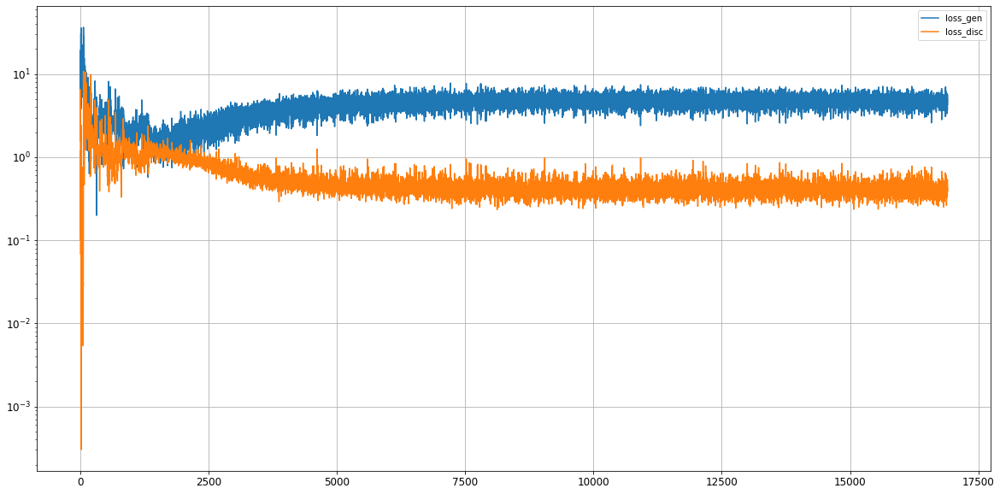

Epoch 16902/50000
0s
Epoch 16903/50000
0s
Epoch 16904/50000
0s
Epoch 16905/50000
0s
Epoch 16906/50000
0s
Epoch 16907/50000
0s
Epoch 16908/50000
0s
Epoch 16909/50000
0s
Epoch 16910/50000
0s
Epoch 16911/50000
0s
Epoch 16912/50000
0s
Epoch 16913/50000
0s
Epoch 16914/50000
0s
Epoch 16915/50000
0s
Epoch 16916/50000
0s
Epoch 16917/50000
0s
Epoch 16918/50000
0s
Epoch 16919/50000
0s
Epoch 16920/50000
0s
Epoch 16921/50000
0s
Epoch 16922/50000
0s
Epoch 16923/50000
0s
Epoch 16924/50000
0s
Epoch 16925/50000
0s
Epoch 16926/50000
0s
Epoch 16927/50000
0s
Epoch 16928/50000
0s
Epoch 16929/50000
0s
Epoch 16930/50000
0s
Epoch 16931/50000
0s
Epoch 16932/50000
0s
Epoch 16933/50000
0s
Epoch 16934/50000
0s
Epoch 16935/50000
0s
Epoch 16936/50000
0s
Epoch 16937/50000
0s
Epoch 16938/50000
0s
Epoch 16939/50000
0s
Epoch 16940/50000
0s
Epoch 16941/50000
0s
Epoch 16942/50000
0s
Epoch 16943/50000
0s
Epoch 16944/50000
0s
Epoch 16945/50000
0s
Epoch 16946/50000
0s
Epoch 16947/50000
0s
Epoch 16948/50000
0s
Epoch 16949/5

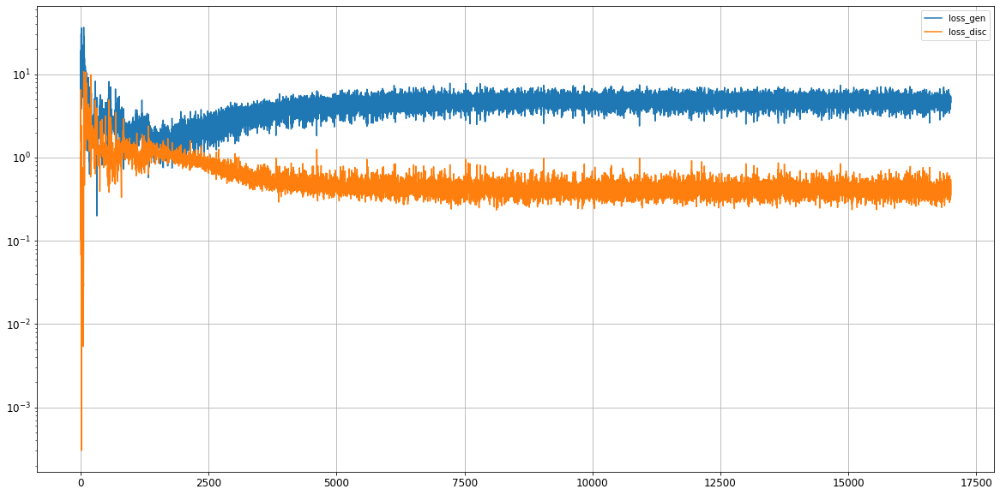

Epoch 17002/50000
0s
Epoch 17003/50000
0s
Epoch 17004/50000
0s
Epoch 17005/50000
0s
Epoch 17006/50000
0s
Epoch 17007/50000
0s
Epoch 17008/50000
0s
Epoch 17009/50000
0s
Epoch 17010/50000
0s
Epoch 17011/50000
0s
Epoch 17012/50000
0s
Epoch 17013/50000
0s
Epoch 17014/50000
0s
Epoch 17015/50000
0s
Epoch 17016/50000
0s
Epoch 17017/50000
0s
Epoch 17018/50000
0s
Epoch 17019/50000
0s
Epoch 17020/50000
0s
Epoch 17021/50000
0s
Epoch 17022/50000
0s
Epoch 17023/50000
0s
Epoch 17024/50000
0s
Epoch 17025/50000
0s
Epoch 17026/50000
0s
Epoch 17027/50000
0s
Epoch 17028/50000
0s
Epoch 17029/50000
0s
Epoch 17030/50000
0s
Epoch 17031/50000
0s
Epoch 17032/50000
0s
Epoch 17033/50000
0s
Epoch 17034/50000
0s
Epoch 17035/50000
0s
Epoch 17036/50000
0s
Epoch 17037/50000
0s
Epoch 17038/50000
0s
Epoch 17039/50000
0s
Epoch 17040/50000
0s
Epoch 17041/50000
0s
Epoch 17042/50000
0s
Epoch 17043/50000
0s
Epoch 17044/50000
0s
Epoch 17045/50000
0s
Epoch 17046/50000
0s
Epoch 17047/50000
0s
Epoch 17048/50000
0s
Epoch 17049/5

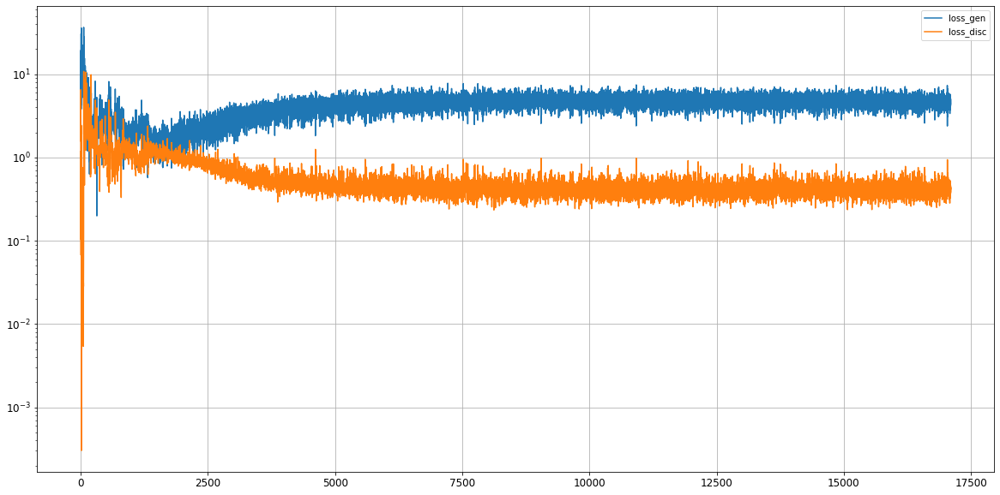

Epoch 17102/50000
0s
Epoch 17103/50000
0s
Epoch 17104/50000
0s
Epoch 17105/50000
0s
Epoch 17106/50000
0s
Epoch 17107/50000
0s
Epoch 17108/50000
0s
Epoch 17109/50000
0s
Epoch 17110/50000
0s
Epoch 17111/50000
0s
Epoch 17112/50000
0s
Epoch 17113/50000
0s
Epoch 17114/50000
0s
Epoch 17115/50000
0s
Epoch 17116/50000
0s
Epoch 17117/50000
0s
Epoch 17118/50000
0s
Epoch 17119/50000
0s
Epoch 17120/50000
0s
Epoch 17121/50000
0s
Epoch 17122/50000
0s
Epoch 17123/50000
0s
Epoch 17124/50000
0s
Epoch 17125/50000
0s
Epoch 17126/50000
0s
Epoch 17127/50000
0s
Epoch 17128/50000
0s
Epoch 17129/50000
0s
Epoch 17130/50000
0s
Epoch 17131/50000
0s
Epoch 17132/50000
0s
Epoch 17133/50000
0s
Epoch 17134/50000
0s
Epoch 17135/50000
0s
Epoch 17136/50000
0s
Epoch 17137/50000
0s
Epoch 17138/50000
0s
Epoch 17139/50000
0s
Epoch 17140/50000
0s
Epoch 17141/50000
0s
Epoch 17142/50000
0s
Epoch 17143/50000
0s
Epoch 17144/50000
0s
Epoch 17145/50000
0s
Epoch 17146/50000
0s
Epoch 17147/50000
0s
Epoch 17148/50000
0s
Epoch 17149/5

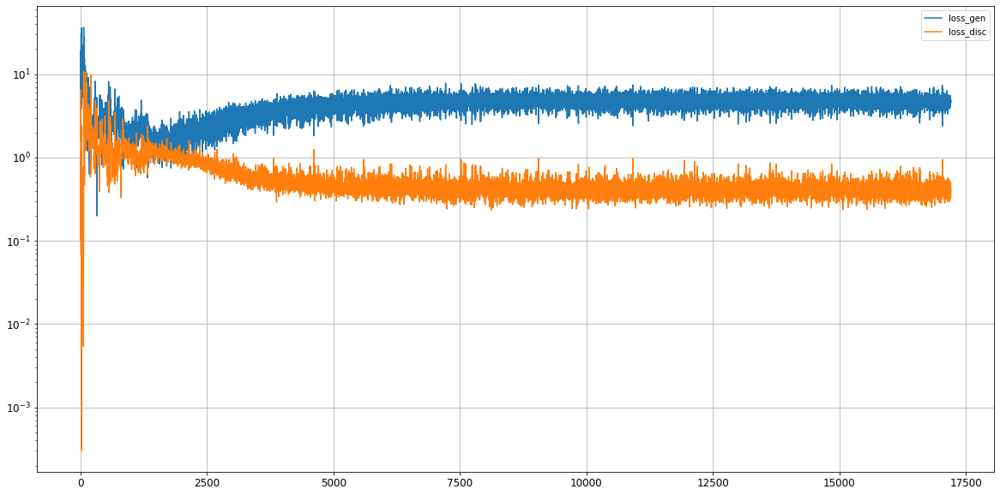

Epoch 17202/50000
0s
Epoch 17203/50000
0s
Epoch 17204/50000
0s
Epoch 17205/50000
0s
Epoch 17206/50000
0s
Epoch 17207/50000
0s
Epoch 17208/50000
0s
Epoch 17209/50000
0s
Epoch 17210/50000
0s
Epoch 17211/50000
0s
Epoch 17212/50000
0s
Epoch 17213/50000
0s
Epoch 17214/50000
0s
Epoch 17215/50000
0s
Epoch 17216/50000
0s
Epoch 17217/50000
0s
Epoch 17218/50000
0s
Epoch 17219/50000
0s
Epoch 17220/50000
0s
Epoch 17221/50000
0s
Epoch 17222/50000
0s
Epoch 17223/50000
0s
Epoch 17224/50000
0s
Epoch 17225/50000
0s
Epoch 17226/50000
0s
Epoch 17227/50000
0s
Epoch 17228/50000
0s
Epoch 17229/50000
0s
Epoch 17230/50000
0s
Epoch 17231/50000
0s
Epoch 17232/50000
0s
Epoch 17233/50000
0s
Epoch 17234/50000
0s
Epoch 17235/50000
0s
Epoch 17236/50000
0s
Epoch 17237/50000
0s
Epoch 17238/50000
0s
Epoch 17239/50000
0s
Epoch 17240/50000
0s
Epoch 17241/50000
0s
Epoch 17242/50000
0s
Epoch 17243/50000
0s
Epoch 17244/50000
0s
Epoch 17245/50000
0s
Epoch 17246/50000
0s
Epoch 17247/50000
0s
Epoch 17248/50000
0s
Epoch 17249/5

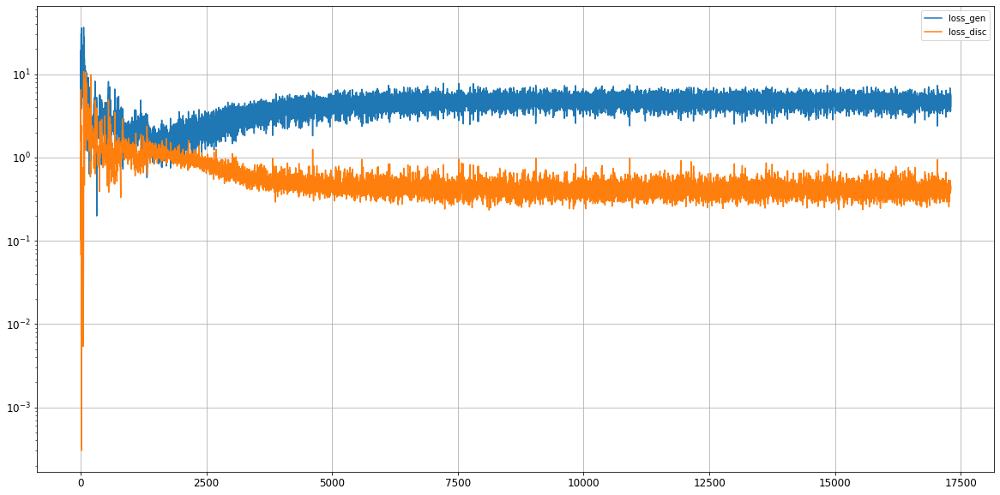

Epoch 17302/50000
0s
Epoch 17303/50000
0s
Epoch 17304/50000
0s
Epoch 17305/50000
0s
Epoch 17306/50000
0s
Epoch 17307/50000
0s
Epoch 17308/50000
0s
Epoch 17309/50000
0s
Epoch 17310/50000
0s
Epoch 17311/50000
0s
Epoch 17312/50000
0s
Epoch 17313/50000
0s
Epoch 17314/50000
0s
Epoch 17315/50000
0s
Epoch 17316/50000
0s
Epoch 17317/50000
0s
Epoch 17318/50000
0s
Epoch 17319/50000
0s
Epoch 17320/50000
0s
Epoch 17321/50000
0s
Epoch 17322/50000
0s
Epoch 17323/50000
0s
Epoch 17324/50000
0s
Epoch 17325/50000
0s
Epoch 17326/50000
0s
Epoch 17327/50000
0s
Epoch 17328/50000
0s
Epoch 17329/50000
0s
Epoch 17330/50000
0s
Epoch 17331/50000
0s
Epoch 17332/50000
0s
Epoch 17333/50000
0s
Epoch 17334/50000
0s
Epoch 17335/50000
0s
Epoch 17336/50000
0s
Epoch 17337/50000
0s
Epoch 17338/50000
0s
Epoch 17339/50000
0s
Epoch 17340/50000
0s
Epoch 17341/50000
0s
Epoch 17342/50000
0s
Epoch 17343/50000
0s
Epoch 17344/50000
0s
Epoch 17345/50000
0s
Epoch 17346/50000
0s
Epoch 17347/50000
0s
Epoch 17348/50000
0s
Epoch 17349/5

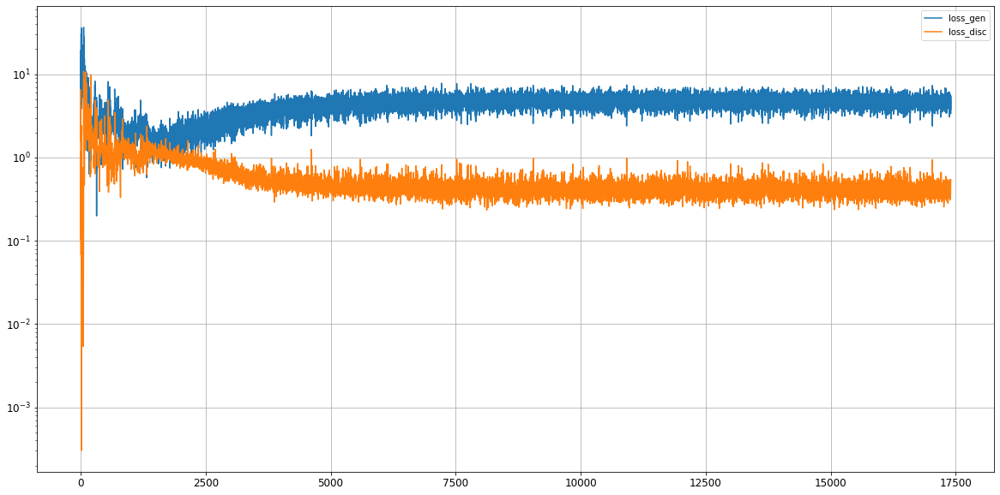

Epoch 17402/50000
0s
Epoch 17403/50000
0s
Epoch 17404/50000
0s
Epoch 17405/50000
0s
Epoch 17406/50000
0s
Epoch 17407/50000
0s
Epoch 17408/50000
0s
Epoch 17409/50000
0s
Epoch 17410/50000
0s
Epoch 17411/50000
0s
Epoch 17412/50000
0s
Epoch 17413/50000
0s
Epoch 17414/50000
0s
Epoch 17415/50000
0s
Epoch 17416/50000
0s
Epoch 17417/50000
0s
Epoch 17418/50000
0s
Epoch 17419/50000
0s
Epoch 17420/50000
0s
Epoch 17421/50000
0s
Epoch 17422/50000
0s
Epoch 17423/50000
0s
Epoch 17424/50000
0s
Epoch 17425/50000
0s
Epoch 17426/50000
0s
Epoch 17427/50000
0s
Epoch 17428/50000
0s
Epoch 17429/50000
0s
Epoch 17430/50000
0s
Epoch 17431/50000
0s
Epoch 17432/50000
0s
Epoch 17433/50000
0s
Epoch 17434/50000
0s
Epoch 17435/50000
0s
Epoch 17436/50000
0s
Epoch 17437/50000
0s
Epoch 17438/50000
0s
Epoch 17439/50000
0s
Epoch 17440/50000
0s
Epoch 17441/50000
0s
Epoch 17442/50000
0s
Epoch 17443/50000
0s
Epoch 17444/50000
0s
Epoch 17445/50000
0s
Epoch 17446/50000
0s
Epoch 17447/50000
0s
Epoch 17448/50000
0s
Epoch 17449/5

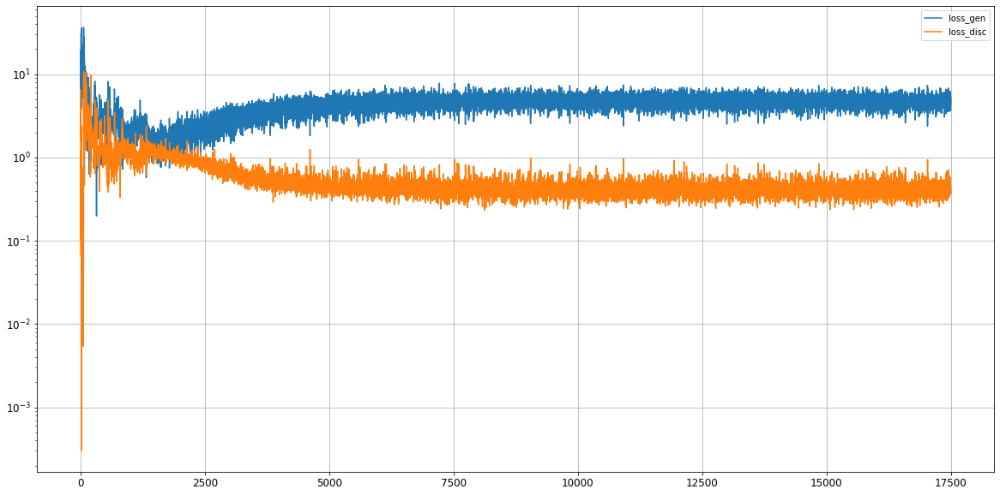

Epoch 17502/50000
0s
Epoch 17503/50000
0s
Epoch 17504/50000
0s
Epoch 17505/50000
0s
Epoch 17506/50000
0s
Epoch 17507/50000
0s
Epoch 17508/50000
0s
Epoch 17509/50000
0s
Epoch 17510/50000
0s
Epoch 17511/50000
0s
Epoch 17512/50000
0s
Epoch 17513/50000
0s
Epoch 17514/50000
0s
Epoch 17515/50000
0s
Epoch 17516/50000
0s
Epoch 17517/50000
0s
Epoch 17518/50000
0s
Epoch 17519/50000
0s
Epoch 17520/50000
0s
Epoch 17521/50000
0s
Epoch 17522/50000
0s
Epoch 17523/50000
0s
Epoch 17524/50000
0s
Epoch 17525/50000
0s
Epoch 17526/50000
0s
Epoch 17527/50000
0s
Epoch 17528/50000
0s
Epoch 17529/50000
0s
Epoch 17530/50000
0s
Epoch 17531/50000
0s
Epoch 17532/50000
0s
Epoch 17533/50000
0s
Epoch 17534/50000
0s
Epoch 17535/50000
0s
Epoch 17536/50000
0s
Epoch 17537/50000
0s
Epoch 17538/50000
0s
Epoch 17539/50000
0s
Epoch 17540/50000
0s
Epoch 17541/50000
0s
Epoch 17542/50000
0s
Epoch 17543/50000
0s
Epoch 17544/50000
0s
Epoch 17545/50000
0s
Epoch 17546/50000
0s
Epoch 17547/50000
0s
Epoch 17548/50000
0s
Epoch 17549/5

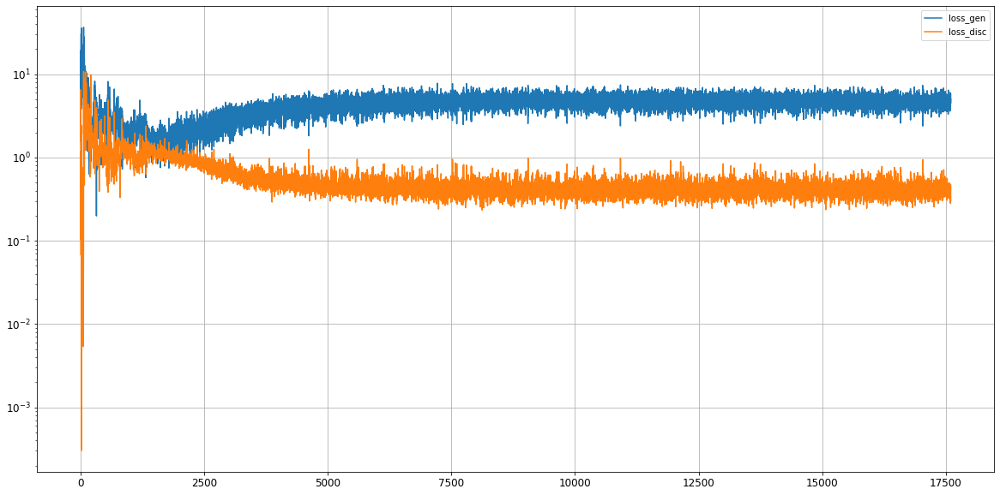

Epoch 17602/50000
0s
Epoch 17603/50000
0s
Epoch 17604/50000
0s
Epoch 17605/50000
0s
Epoch 17606/50000
0s
Epoch 17607/50000
0s
Epoch 17608/50000
0s
Epoch 17609/50000
0s
Epoch 17610/50000
0s
Epoch 17611/50000
0s
Epoch 17612/50000
0s
Epoch 17613/50000
0s
Epoch 17614/50000
0s
Epoch 17615/50000
0s
Epoch 17616/50000
0s
Epoch 17617/50000
0s
Epoch 17618/50000
0s
Epoch 17619/50000
0s
Epoch 17620/50000
0s
Epoch 17621/50000
0s
Epoch 17622/50000
0s
Epoch 17623/50000
0s
Epoch 17624/50000
0s
Epoch 17625/50000
0s
Epoch 17626/50000
0s
Epoch 17627/50000
0s
Epoch 17628/50000
0s
Epoch 17629/50000
0s
Epoch 17630/50000
0s
Epoch 17631/50000
0s
Epoch 17632/50000
0s
Epoch 17633/50000
0s
Epoch 17634/50000
0s
Epoch 17635/50000
0s
Epoch 17636/50000
0s
Epoch 17637/50000
0s
Epoch 17638/50000
0s
Epoch 17639/50000
0s
Epoch 17640/50000
0s
Epoch 17641/50000
0s
Epoch 17642/50000
0s
Epoch 17643/50000
0s
Epoch 17644/50000
0s
Epoch 17645/50000
0s
Epoch 17646/50000
0s
Epoch 17647/50000
0s
Epoch 17648/50000
0s
Epoch 17649/5

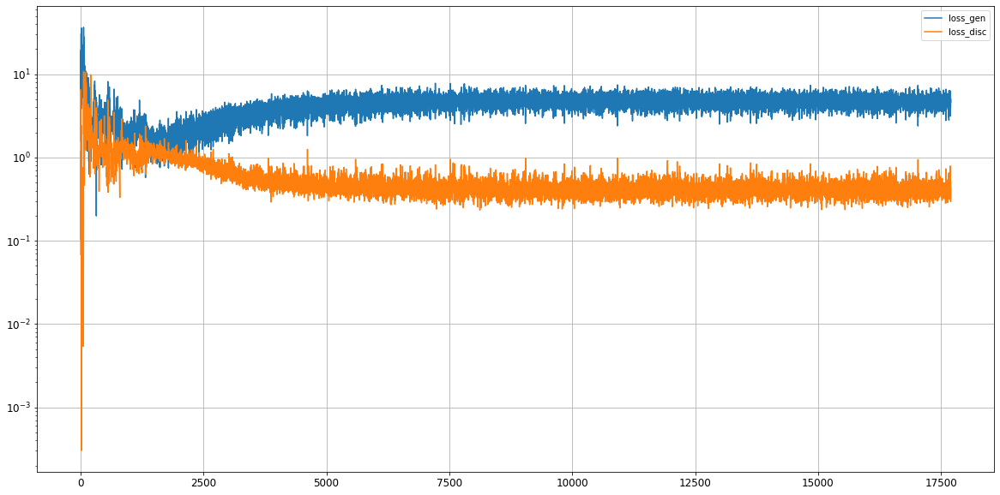

Epoch 17702/50000
0s
Epoch 17703/50000
0s
Epoch 17704/50000
0s
Epoch 17705/50000
0s
Epoch 17706/50000
0s
Epoch 17707/50000
0s
Epoch 17708/50000
0s
Epoch 17709/50000
0s
Epoch 17710/50000
0s
Epoch 17711/50000
0s
Epoch 17712/50000
0s
Epoch 17713/50000
0s
Epoch 17714/50000
0s
Epoch 17715/50000
0s
Epoch 17716/50000
0s
Epoch 17717/50000
0s
Epoch 17718/50000
0s
Epoch 17719/50000
0s
Epoch 17720/50000
0s
Epoch 17721/50000
0s
Epoch 17722/50000
0s
Epoch 17723/50000
0s
Epoch 17724/50000
0s
Epoch 17725/50000
0s
Epoch 17726/50000
0s
Epoch 17727/50000
0s
Epoch 17728/50000
0s
Epoch 17729/50000
0s
Epoch 17730/50000
0s
Epoch 17731/50000
0s
Epoch 17732/50000
0s
Epoch 17733/50000
0s
Epoch 17734/50000
0s
Epoch 17735/50000
0s
Epoch 17736/50000
0s
Epoch 17737/50000
0s
Epoch 17738/50000
0s
Epoch 17739/50000
0s
Epoch 17740/50000
0s
Epoch 17741/50000
0s
Epoch 17742/50000
0s
Epoch 17743/50000
0s
Epoch 17744/50000
0s
Epoch 17745/50000
0s
Epoch 17746/50000
0s
Epoch 17747/50000
0s
Epoch 17748/50000
0s
Epoch 17749/5

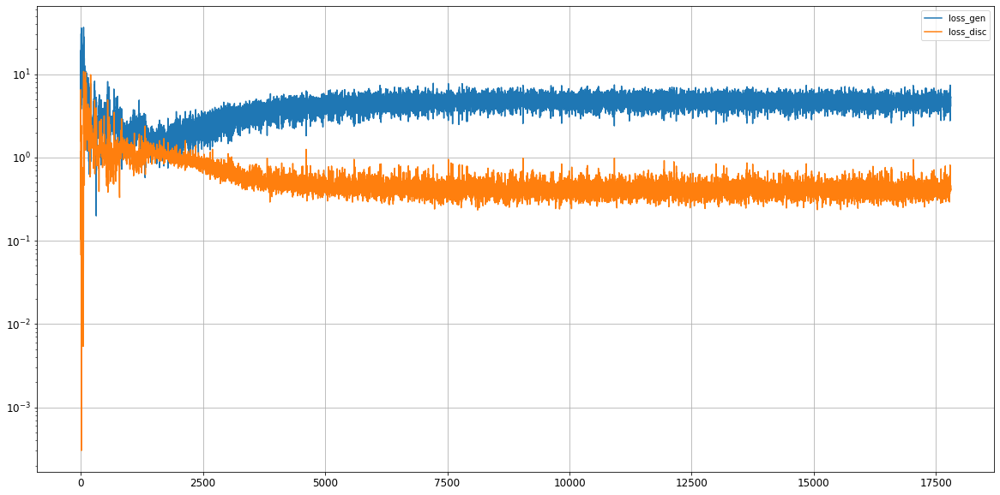

Epoch 17802/50000
0s
Epoch 17803/50000
0s
Epoch 17804/50000
0s
Epoch 17805/50000
0s
Epoch 17806/50000
0s
Epoch 17807/50000
0s
Epoch 17808/50000
0s
Epoch 17809/50000
0s
Epoch 17810/50000
0s
Epoch 17811/50000
0s
Epoch 17812/50000
0s
Epoch 17813/50000
0s
Epoch 17814/50000
0s
Epoch 17815/50000
0s
Epoch 17816/50000
0s
Epoch 17817/50000
0s
Epoch 17818/50000
0s
Epoch 17819/50000
0s
Epoch 17820/50000
0s
Epoch 17821/50000
0s
Epoch 17822/50000
0s
Epoch 17823/50000
0s
Epoch 17824/50000
0s
Epoch 17825/50000
0s
Epoch 17826/50000
0s
Epoch 17827/50000
0s
Epoch 17828/50000
0s
Epoch 17829/50000
0s
Epoch 17830/50000
0s
Epoch 17831/50000
0s
Epoch 17832/50000
0s
Epoch 17833/50000
0s
Epoch 17834/50000
0s
Epoch 17835/50000
0s
Epoch 17836/50000
0s
Epoch 17837/50000
0s
Epoch 17838/50000
0s
Epoch 17839/50000
0s
Epoch 17840/50000
0s
Epoch 17841/50000
0s
Epoch 17842/50000
0s
Epoch 17843/50000
0s
Epoch 17844/50000
0s
Epoch 17845/50000
0s
Epoch 17846/50000
0s
Epoch 17847/50000
0s
Epoch 17848/50000
0s
Epoch 17849/5

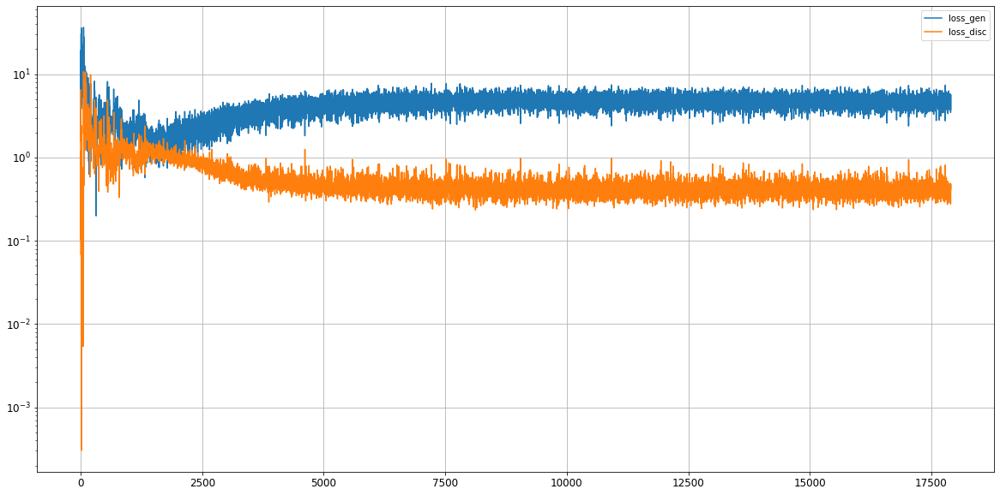

Epoch 17902/50000
0s
Epoch 17903/50000
0s
Epoch 17904/50000
0s
Epoch 17905/50000
0s
Epoch 17906/50000
0s
Epoch 17907/50000
0s
Epoch 17908/50000
0s
Epoch 17909/50000
0s
Epoch 17910/50000
0s
Epoch 17911/50000
0s
Epoch 17912/50000
0s
Epoch 17913/50000
0s
Epoch 17914/50000
0s
Epoch 17915/50000
0s
Epoch 17916/50000
0s
Epoch 17917/50000
0s
Epoch 17918/50000
0s
Epoch 17919/50000
0s
Epoch 17920/50000
0s
Epoch 17921/50000
0s
Epoch 17922/50000
0s
Epoch 17923/50000
0s
Epoch 17924/50000
0s
Epoch 17925/50000
0s
Epoch 17926/50000
0s
Epoch 17927/50000
0s
Epoch 17928/50000
0s
Epoch 17929/50000
0s
Epoch 17930/50000
0s
Epoch 17931/50000
0s
Epoch 17932/50000
0s
Epoch 17933/50000
0s
Epoch 17934/50000
0s
Epoch 17935/50000
0s
Epoch 17936/50000
0s
Epoch 17937/50000
0s
Epoch 17938/50000
0s
Epoch 17939/50000
0s
Epoch 17940/50000
0s
Epoch 17941/50000
0s
Epoch 17942/50000
0s
Epoch 17943/50000
0s
Epoch 17944/50000
0s
Epoch 17945/50000
0s
Epoch 17946/50000
0s
Epoch 17947/50000
0s
Epoch 17948/50000
0s
Epoch 17949/5

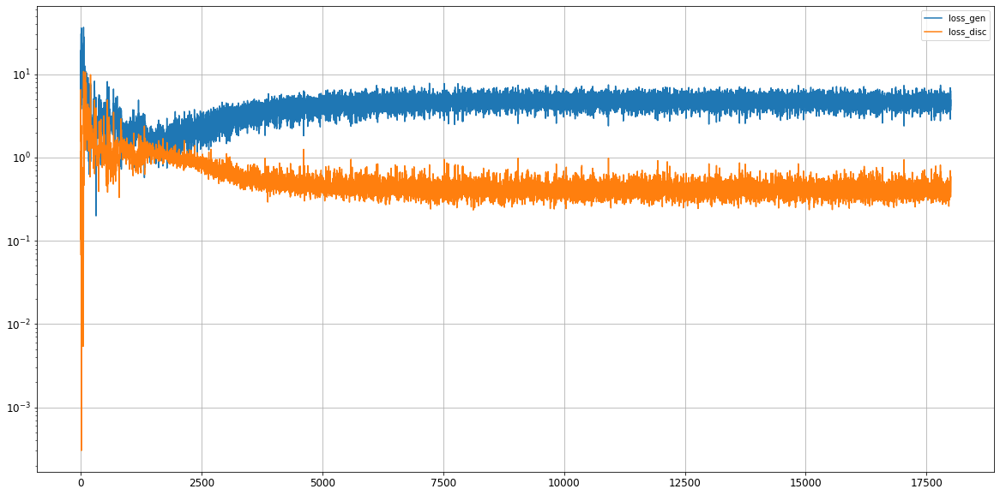

Epoch 18002/50000
0s
Epoch 18003/50000
0s
Epoch 18004/50000
0s
Epoch 18005/50000
0s
Epoch 18006/50000
0s
Epoch 18007/50000
0s
Epoch 18008/50000
0s
Epoch 18009/50000
0s
Epoch 18010/50000
0s
Epoch 18011/50000
0s
Epoch 18012/50000
0s
Epoch 18013/50000
0s
Epoch 18014/50000
0s
Epoch 18015/50000
0s
Epoch 18016/50000
0s
Epoch 18017/50000
0s
Epoch 18018/50000
0s
Epoch 18019/50000
0s
Epoch 18020/50000
0s
Epoch 18021/50000
0s
Epoch 18022/50000
0s
Epoch 18023/50000
0s
Epoch 18024/50000
0s
Epoch 18025/50000
0s
Epoch 18026/50000
0s
Epoch 18027/50000
0s
Epoch 18028/50000
0s
Epoch 18029/50000
0s
Epoch 18030/50000
0s
Epoch 18031/50000
0s
Epoch 18032/50000
0s
Epoch 18033/50000
0s
Epoch 18034/50000
0s
Epoch 18035/50000
0s
Epoch 18036/50000
0s
Epoch 18037/50000
0s
Epoch 18038/50000
0s
Epoch 18039/50000
0s
Epoch 18040/50000
0s
Epoch 18041/50000
0s
Epoch 18042/50000
0s
Epoch 18043/50000
0s
Epoch 18044/50000
0s
Epoch 18045/50000
0s
Epoch 18046/50000
0s
Epoch 18047/50000
0s
Epoch 18048/50000
0s
Epoch 18049/5

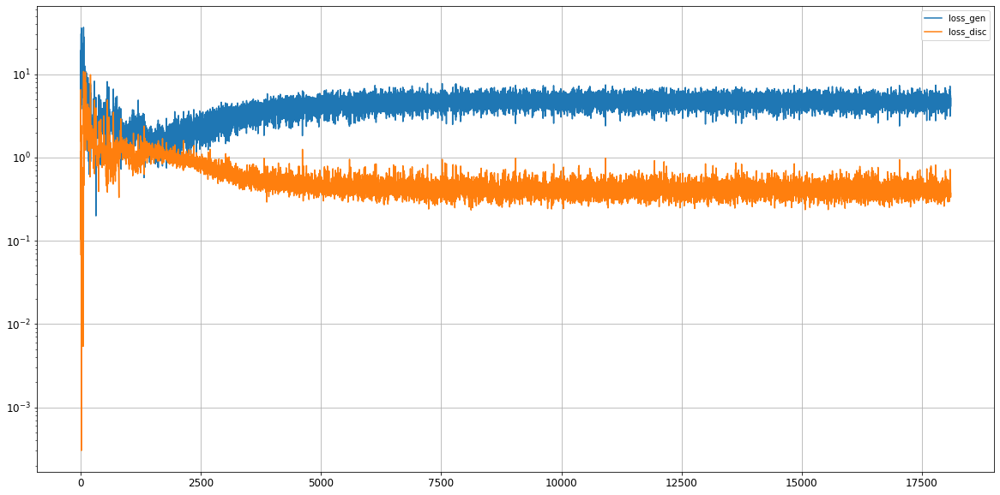

Epoch 18102/50000
0s
Epoch 18103/50000
0s
Epoch 18104/50000
0s
Epoch 18105/50000
0s
Epoch 18106/50000
0s
Epoch 18107/50000
0s
Epoch 18108/50000
0s
Epoch 18109/50000
0s
Epoch 18110/50000
0s
Epoch 18111/50000
0s
Epoch 18112/50000
0s
Epoch 18113/50000
0s
Epoch 18114/50000
0s
Epoch 18115/50000
0s
Epoch 18116/50000
0s
Epoch 18117/50000
0s
Epoch 18118/50000
0s
Epoch 18119/50000
0s
Epoch 18120/50000
0s
Epoch 18121/50000
0s
Epoch 18122/50000
0s
Epoch 18123/50000
0s
Epoch 18124/50000
0s
Epoch 18125/50000
0s
Epoch 18126/50000
0s
Epoch 18127/50000
0s
Epoch 18128/50000
0s
Epoch 18129/50000
0s
Epoch 18130/50000
0s
Epoch 18131/50000
0s
Epoch 18132/50000
0s
Epoch 18133/50000
0s
Epoch 18134/50000
0s
Epoch 18135/50000
0s
Epoch 18136/50000
0s
Epoch 18137/50000
0s
Epoch 18138/50000
0s
Epoch 18139/50000
0s
Epoch 18140/50000
0s
Epoch 18141/50000
0s
Epoch 18142/50000
0s
Epoch 18143/50000
0s
Epoch 18144/50000
0s
Epoch 18145/50000
0s
Epoch 18146/50000
0s
Epoch 18147/50000
0s
Epoch 18148/50000
0s
Epoch 18149/5

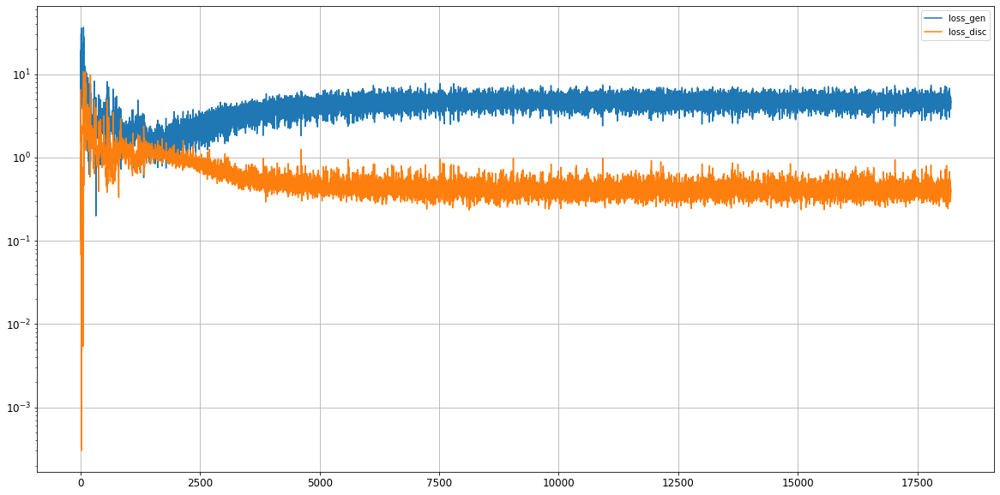

Epoch 18202/50000
0s
Epoch 18203/50000
0s
Epoch 18204/50000
0s
Epoch 18205/50000
0s
Epoch 18206/50000
0s
Epoch 18207/50000
0s
Epoch 18208/50000
0s
Epoch 18209/50000
0s
Epoch 18210/50000
0s
Epoch 18211/50000
0s
Epoch 18212/50000
0s
Epoch 18213/50000
0s
Epoch 18214/50000
0s
Epoch 18215/50000
0s
Epoch 18216/50000
0s
Epoch 18217/50000
0s
Epoch 18218/50000
0s
Epoch 18219/50000
0s
Epoch 18220/50000
0s
Epoch 18221/50000
0s
Epoch 18222/50000
0s
Epoch 18223/50000
0s
Epoch 18224/50000
0s
Epoch 18225/50000
0s
Epoch 18226/50000
0s
Epoch 18227/50000
0s
Epoch 18228/50000
0s
Epoch 18229/50000
0s
Epoch 18230/50000
0s
Epoch 18231/50000
0s
Epoch 18232/50000
0s
Epoch 18233/50000
0s
Epoch 18234/50000
0s
Epoch 18235/50000
0s
Epoch 18236/50000
0s
Epoch 18237/50000
0s
Epoch 18238/50000
0s
Epoch 18239/50000
0s
Epoch 18240/50000
0s
Epoch 18241/50000
0s
Epoch 18242/50000
0s
Epoch 18243/50000
0s
Epoch 18244/50000
0s
Epoch 18245/50000
0s
Epoch 18246/50000
0s
Epoch 18247/50000
0s
Epoch 18248/50000
0s
Epoch 18249/5

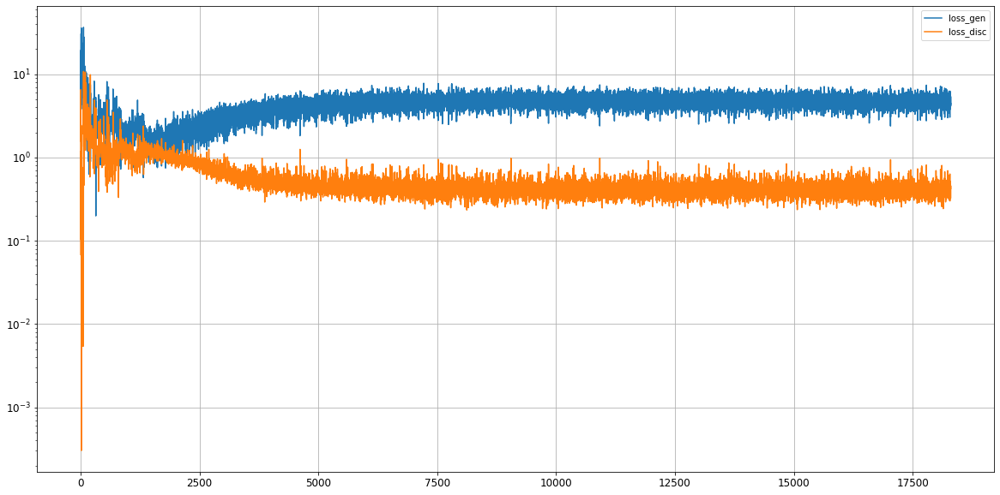

Epoch 18302/50000
0s
Epoch 18303/50000
0s
Epoch 18304/50000
0s
Epoch 18305/50000
0s
Epoch 18306/50000
0s
Epoch 18307/50000
0s
Epoch 18308/50000
0s
Epoch 18309/50000
0s
Epoch 18310/50000
0s
Epoch 18311/50000
0s
Epoch 18312/50000
0s
Epoch 18313/50000
0s
Epoch 18314/50000
0s
Epoch 18315/50000
0s
Epoch 18316/50000
0s
Epoch 18317/50000
0s
Epoch 18318/50000
0s
Epoch 18319/50000
0s
Epoch 18320/50000
0s
Epoch 18321/50000
0s
Epoch 18322/50000
0s
Epoch 18323/50000
0s
Epoch 18324/50000
0s
Epoch 18325/50000
0s
Epoch 18326/50000
0s
Epoch 18327/50000
0s
Epoch 18328/50000
0s
Epoch 18329/50000
0s
Epoch 18330/50000
0s
Epoch 18331/50000
0s
Epoch 18332/50000
0s
Epoch 18333/50000
0s
Epoch 18334/50000
0s
Epoch 18335/50000
0s
Epoch 18336/50000
0s
Epoch 18337/50000
0s
Epoch 18338/50000
0s
Epoch 18339/50000
0s
Epoch 18340/50000
0s
Epoch 18341/50000
0s
Epoch 18342/50000
0s
Epoch 18343/50000
0s
Epoch 18344/50000
0s
Epoch 18345/50000
0s
Epoch 18346/50000
0s
Epoch 18347/50000
0s
Epoch 18348/50000
0s
Epoch 18349/5

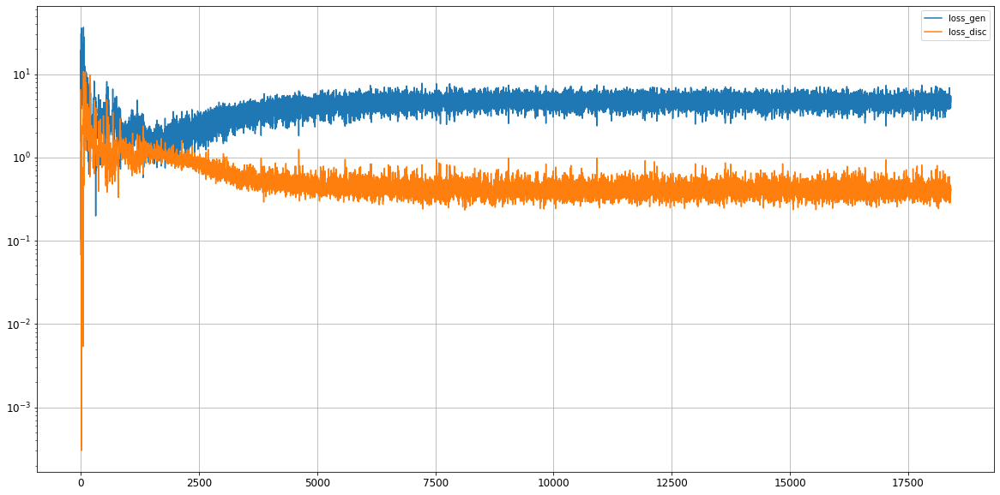

Epoch 18402/50000
0s
Epoch 18403/50000
0s
Epoch 18404/50000
0s
Epoch 18405/50000
0s
Epoch 18406/50000
0s
Epoch 18407/50000
0s
Epoch 18408/50000
0s
Epoch 18409/50000
0s
Epoch 18410/50000
0s
Epoch 18411/50000
0s
Epoch 18412/50000
0s
Epoch 18413/50000
0s
Epoch 18414/50000
0s
Epoch 18415/50000
0s
Epoch 18416/50000
0s
Epoch 18417/50000
0s
Epoch 18418/50000
0s
Epoch 18419/50000
0s
Epoch 18420/50000
0s
Epoch 18421/50000
0s
Epoch 18422/50000
0s
Epoch 18423/50000
0s
Epoch 18424/50000
0s
Epoch 18425/50000
0s
Epoch 18426/50000
0s
Epoch 18427/50000
0s
Epoch 18428/50000
0s
Epoch 18429/50000
0s
Epoch 18430/50000
0s
Epoch 18431/50000
0s
Epoch 18432/50000
0s
Epoch 18433/50000
0s
Epoch 18434/50000
0s
Epoch 18435/50000
0s
Epoch 18436/50000
0s
Epoch 18437/50000
0s
Epoch 18438/50000
0s
Epoch 18439/50000
0s
Epoch 18440/50000
0s
Epoch 18441/50000
0s
Epoch 18442/50000
0s
Epoch 18443/50000
0s
Epoch 18444/50000
0s
Epoch 18445/50000
0s
Epoch 18446/50000
0s
Epoch 18447/50000
0s
Epoch 18448/50000
0s
Epoch 18449/5

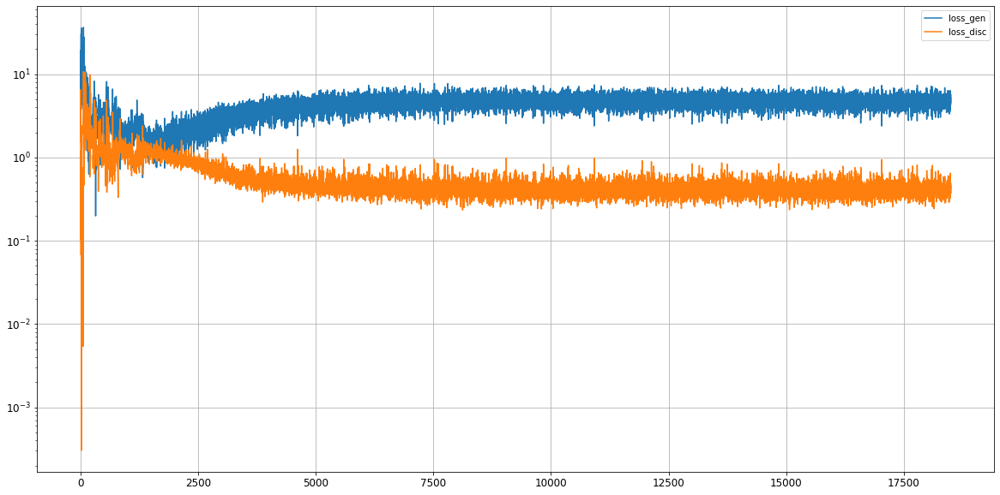

Epoch 18502/50000
0s
Epoch 18503/50000
0s
Epoch 18504/50000
0s
Epoch 18505/50000
0s
Epoch 18506/50000
0s
Epoch 18507/50000
0s
Epoch 18508/50000
0s
Epoch 18509/50000
0s
Epoch 18510/50000
0s
Epoch 18511/50000
0s
Epoch 18512/50000
0s
Epoch 18513/50000
0s
Epoch 18514/50000
0s
Epoch 18515/50000
0s
Epoch 18516/50000
0s
Epoch 18517/50000
0s
Epoch 18518/50000
0s
Epoch 18519/50000
0s
Epoch 18520/50000
0s
Epoch 18521/50000
0s
Epoch 18522/50000
0s
Epoch 18523/50000
0s
Epoch 18524/50000
0s
Epoch 18525/50000
0s
Epoch 18526/50000
0s
Epoch 18527/50000
0s
Epoch 18528/50000
0s
Epoch 18529/50000
0s
Epoch 18530/50000
0s
Epoch 18531/50000
0s
Epoch 18532/50000
0s
Epoch 18533/50000
0s
Epoch 18534/50000
0s
Epoch 18535/50000
0s
Epoch 18536/50000
0s
Epoch 18537/50000
0s
Epoch 18538/50000
0s
Epoch 18539/50000
0s
Epoch 18540/50000
0s
Epoch 18541/50000
0s
Epoch 18542/50000
0s
Epoch 18543/50000
0s
Epoch 18544/50000
0s
Epoch 18545/50000
0s
Epoch 18546/50000
0s
Epoch 18547/50000
0s
Epoch 18548/50000
0s
Epoch 18549/5

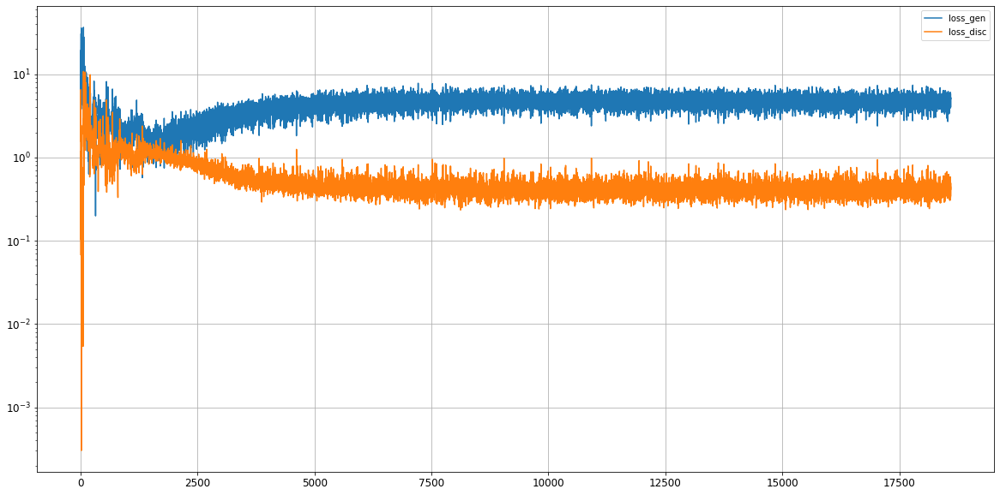

Epoch 18602/50000
0s
Epoch 18603/50000
0s
Epoch 18604/50000
0s
Epoch 18605/50000
0s
Epoch 18606/50000
0s
Epoch 18607/50000
0s
Epoch 18608/50000
0s
Epoch 18609/50000
0s
Epoch 18610/50000
0s
Epoch 18611/50000
0s
Epoch 18612/50000
0s
Epoch 18613/50000
0s
Epoch 18614/50000
0s
Epoch 18615/50000
0s
Epoch 18616/50000
0s
Epoch 18617/50000
0s
Epoch 18618/50000
0s
Epoch 18619/50000
0s
Epoch 18620/50000
0s
Epoch 18621/50000
0s
Epoch 18622/50000
0s
Epoch 18623/50000
0s
Epoch 18624/50000
0s
Epoch 18625/50000
0s
Epoch 18626/50000
0s
Epoch 18627/50000
0s
Epoch 18628/50000
0s
Epoch 18629/50000
0s
Epoch 18630/50000
0s
Epoch 18631/50000
0s
Epoch 18632/50000
0s
Epoch 18633/50000
0s
Epoch 18634/50000
0s
Epoch 18635/50000
0s
Epoch 18636/50000
0s
Epoch 18637/50000
0s
Epoch 18638/50000
0s
Epoch 18639/50000
0s
Epoch 18640/50000
0s
Epoch 18641/50000
0s
Epoch 18642/50000
0s
Epoch 18643/50000
0s
Epoch 18644/50000
0s
Epoch 18645/50000
0s
Epoch 18646/50000
0s
Epoch 18647/50000
0s
Epoch 18648/50000
0s
Epoch 18649/5

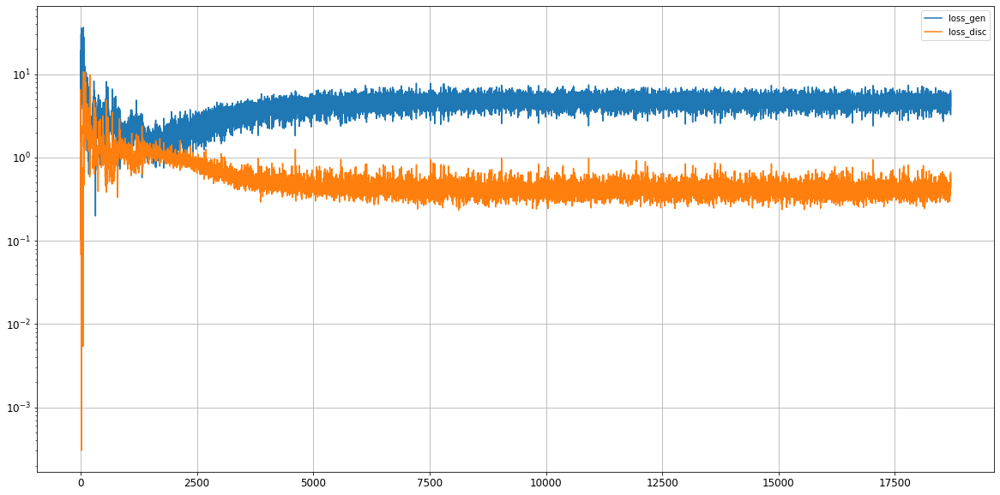

Epoch 18702/50000
0s
Epoch 18703/50000
0s
Epoch 18704/50000
0s
Epoch 18705/50000
0s
Epoch 18706/50000
0s
Epoch 18707/50000
0s
Epoch 18708/50000
0s
Epoch 18709/50000
0s
Epoch 18710/50000
0s
Epoch 18711/50000
0s
Epoch 18712/50000
0s
Epoch 18713/50000
0s
Epoch 18714/50000
0s
Epoch 18715/50000
0s
Epoch 18716/50000
0s
Epoch 18717/50000
0s
Epoch 18718/50000
0s
Epoch 18719/50000
0s
Epoch 18720/50000
0s
Epoch 18721/50000
0s
Epoch 18722/50000
0s
Epoch 18723/50000
0s
Epoch 18724/50000
0s
Epoch 18725/50000
0s
Epoch 18726/50000
0s
Epoch 18727/50000
0s
Epoch 18728/50000
0s
Epoch 18729/50000
0s
Epoch 18730/50000
0s
Epoch 18731/50000
0s
Epoch 18732/50000
0s
Epoch 18733/50000
0s
Epoch 18734/50000
0s
Epoch 18735/50000
0s
Epoch 18736/50000
0s
Epoch 18737/50000
0s
Epoch 18738/50000
0s
Epoch 18739/50000
0s
Epoch 18740/50000
0s
Epoch 18741/50000
0s
Epoch 18742/50000
0s
Epoch 18743/50000
0s
Epoch 18744/50000
0s
Epoch 18745/50000
0s
Epoch 18746/50000
0s
Epoch 18747/50000
0s
Epoch 18748/50000
0s
Epoch 18749/5

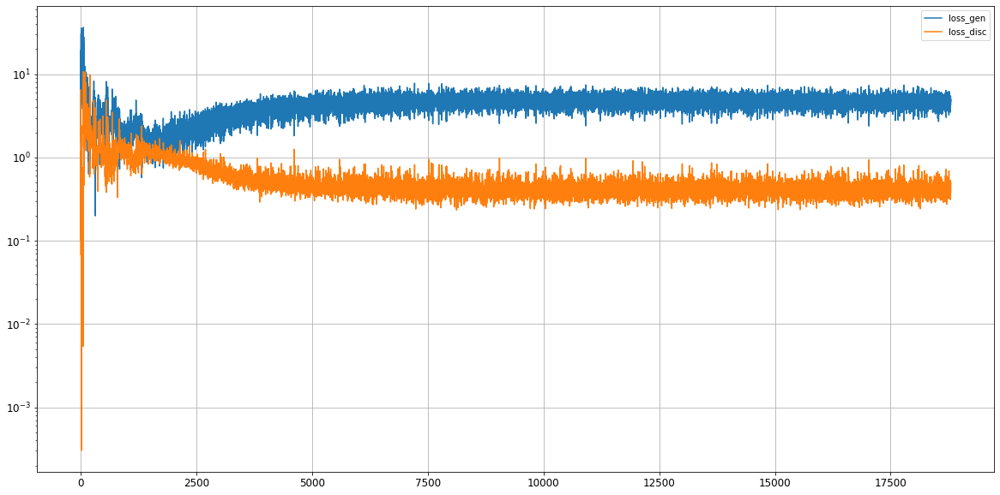

Epoch 18802/50000
0s
Epoch 18803/50000
0s
Epoch 18804/50000
0s
Epoch 18805/50000
0s
Epoch 18806/50000
0s
Epoch 18807/50000
0s
Epoch 18808/50000
0s
Epoch 18809/50000
0s
Epoch 18810/50000
0s
Epoch 18811/50000
0s
Epoch 18812/50000
0s
Epoch 18813/50000
0s
Epoch 18814/50000
0s
Epoch 18815/50000
0s
Epoch 18816/50000
0s
Epoch 18817/50000
0s
Epoch 18818/50000
0s
Epoch 18819/50000
0s
Epoch 18820/50000
0s
Epoch 18821/50000
0s
Epoch 18822/50000
0s
Epoch 18823/50000
0s
Epoch 18824/50000
0s
Epoch 18825/50000
0s
Epoch 18826/50000
0s
Epoch 18827/50000
0s
Epoch 18828/50000
0s
Epoch 18829/50000
0s
Epoch 18830/50000
0s
Epoch 18831/50000
0s
Epoch 18832/50000
0s
Epoch 18833/50000
0s
Epoch 18834/50000
0s
Epoch 18835/50000
0s
Epoch 18836/50000
0s
Epoch 18837/50000
0s
Epoch 18838/50000
0s
Epoch 18839/50000
0s
Epoch 18840/50000
0s
Epoch 18841/50000
0s
Epoch 18842/50000
0s
Epoch 18843/50000
0s
Epoch 18844/50000
0s
Epoch 18845/50000
0s
Epoch 18846/50000
0s
Epoch 18847/50000
0s
Epoch 18848/50000
0s
Epoch 18849/5

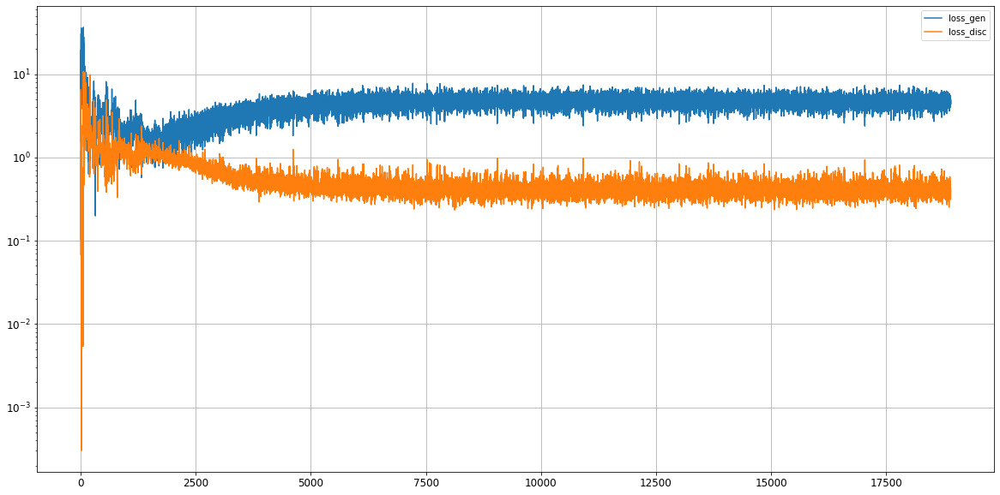

Epoch 18902/50000
0s
Epoch 18903/50000
0s
Epoch 18904/50000
0s
Epoch 18905/50000
0s
Epoch 18906/50000
0s
Epoch 18907/50000
0s
Epoch 18908/50000
0s
Epoch 18909/50000
0s
Epoch 18910/50000
0s
Epoch 18911/50000
0s
Epoch 18912/50000
0s
Epoch 18913/50000
0s
Epoch 18914/50000
0s
Epoch 18915/50000
0s
Epoch 18916/50000
0s
Epoch 18917/50000
0s
Epoch 18918/50000
0s
Epoch 18919/50000
0s
Epoch 18920/50000
0s
Epoch 18921/50000
0s
Epoch 18922/50000
0s
Epoch 18923/50000
0s
Epoch 18924/50000
0s
Epoch 18925/50000
0s
Epoch 18926/50000
0s
Epoch 18927/50000
0s
Epoch 18928/50000
0s
Epoch 18929/50000
0s
Epoch 18930/50000
0s
Epoch 18931/50000
0s
Epoch 18932/50000
0s
Epoch 18933/50000
0s
Epoch 18934/50000
0s
Epoch 18935/50000
0s
Epoch 18936/50000
0s
Epoch 18937/50000
0s
Epoch 18938/50000
0s
Epoch 18939/50000
0s
Epoch 18940/50000
0s
Epoch 18941/50000
0s
Epoch 18942/50000
0s
Epoch 18943/50000
0s
Epoch 18944/50000
0s
Epoch 18945/50000
0s
Epoch 18946/50000
0s
Epoch 18947/50000
0s
Epoch 18948/50000
0s
Epoch 18949/5

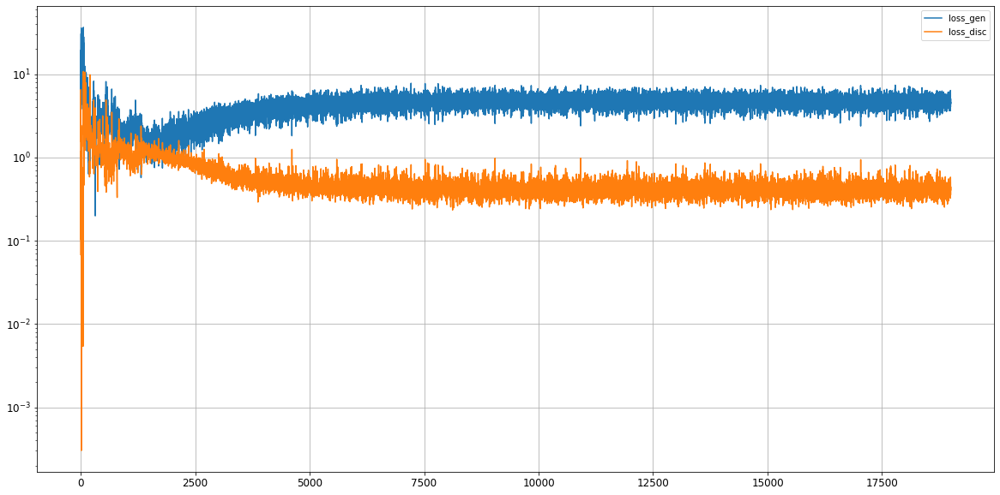

Epoch 19002/50000
0s
Epoch 19003/50000
0s
Epoch 19004/50000
0s
Epoch 19005/50000
0s
Epoch 19006/50000
0s
Epoch 19007/50000
0s
Epoch 19008/50000
0s
Epoch 19009/50000
0s
Epoch 19010/50000
0s
Epoch 19011/50000
0s
Epoch 19012/50000
0s
Epoch 19013/50000
0s
Epoch 19014/50000
0s
Epoch 19015/50000
0s
Epoch 19016/50000
0s
Epoch 19017/50000
0s
Epoch 19018/50000
0s
Epoch 19019/50000
0s
Epoch 19020/50000
0s
Epoch 19021/50000
0s
Epoch 19022/50000
0s
Epoch 19023/50000
0s
Epoch 19024/50000
0s
Epoch 19025/50000
0s
Epoch 19026/50000
0s
Epoch 19027/50000
0s
Epoch 19028/50000
0s
Epoch 19029/50000
0s
Epoch 19030/50000
0s
Epoch 19031/50000
0s
Epoch 19032/50000
0s
Epoch 19033/50000
0s
Epoch 19034/50000
0s
Epoch 19035/50000
0s
Epoch 19036/50000
0s
Epoch 19037/50000
0s
Epoch 19038/50000
0s
Epoch 19039/50000
0s
Epoch 19040/50000
0s
Epoch 19041/50000
0s
Epoch 19042/50000
0s
Epoch 19043/50000
0s
Epoch 19044/50000
0s
Epoch 19045/50000
0s
Epoch 19046/50000
0s
Epoch 19047/50000
0s
Epoch 19048/50000
0s
Epoch 19049/5

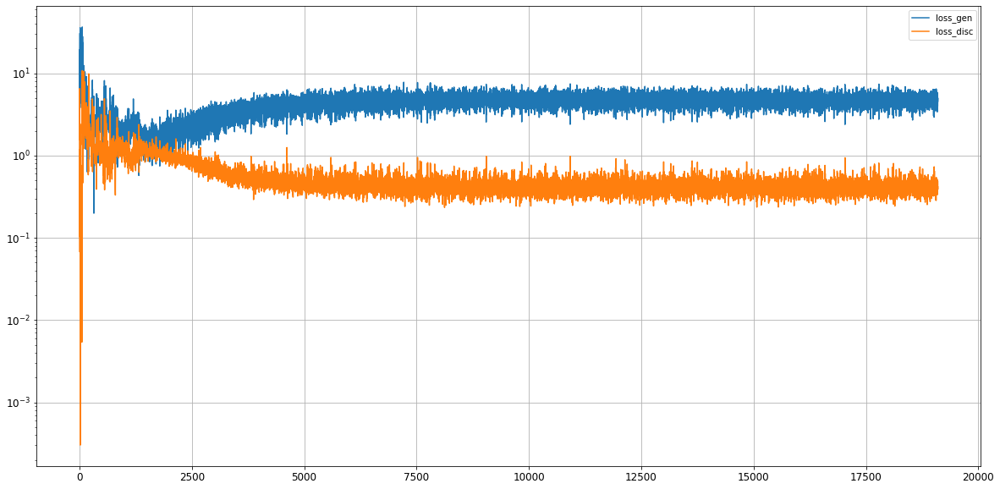

Epoch 19102/50000
0s
Epoch 19103/50000
0s
Epoch 19104/50000
0s
Epoch 19105/50000
0s
Epoch 19106/50000
0s
Epoch 19107/50000
0s
Epoch 19108/50000
0s
Epoch 19109/50000
0s
Epoch 19110/50000
0s
Epoch 19111/50000
0s
Epoch 19112/50000
0s
Epoch 19113/50000
0s
Epoch 19114/50000
0s
Epoch 19115/50000
0s
Epoch 19116/50000
0s
Epoch 19117/50000
0s
Epoch 19118/50000
0s
Epoch 19119/50000
0s
Epoch 19120/50000
0s
Epoch 19121/50000
0s
Epoch 19122/50000
0s
Epoch 19123/50000
0s
Epoch 19124/50000
0s
Epoch 19125/50000
0s
Epoch 19126/50000
0s
Epoch 19127/50000
0s
Epoch 19128/50000
0s
Epoch 19129/50000
0s
Epoch 19130/50000
0s
Epoch 19131/50000
0s
Epoch 19132/50000
0s
Epoch 19133/50000
0s
Epoch 19134/50000
0s
Epoch 19135/50000
0s
Epoch 19136/50000
0s
Epoch 19137/50000
0s
Epoch 19138/50000
0s
Epoch 19139/50000
0s
Epoch 19140/50000
0s
Epoch 19141/50000
0s
Epoch 19142/50000
0s
Epoch 19143/50000
0s
Epoch 19144/50000
0s
Epoch 19145/50000
0s
Epoch 19146/50000
0s
Epoch 19147/50000
0s
Epoch 19148/50000
0s
Epoch 19149/5

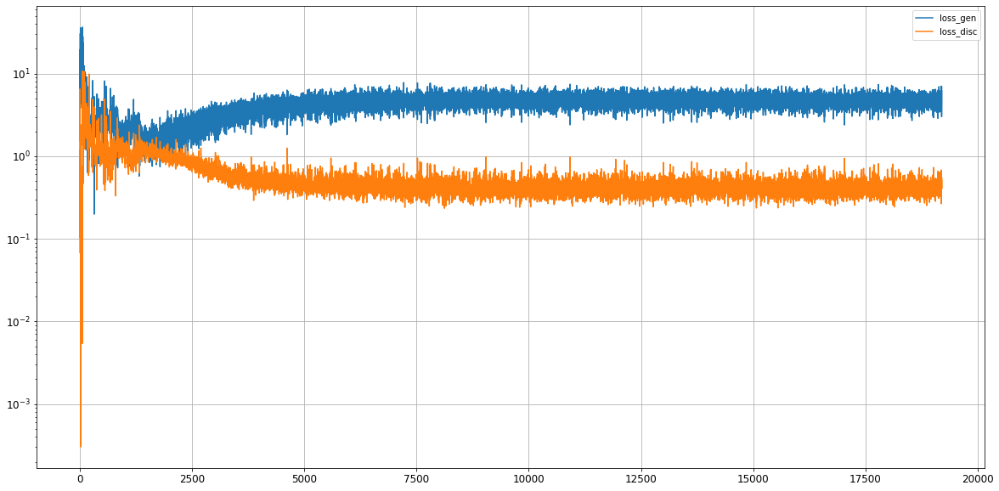

Epoch 19202/50000
0s
Epoch 19203/50000
0s
Epoch 19204/50000
0s
Epoch 19205/50000
0s
Epoch 19206/50000
0s
Epoch 19207/50000
0s
Epoch 19208/50000
0s
Epoch 19209/50000
0s
Epoch 19210/50000
0s
Epoch 19211/50000
0s
Epoch 19212/50000
0s
Epoch 19213/50000
0s
Epoch 19214/50000
0s
Epoch 19215/50000
0s
Epoch 19216/50000
0s
Epoch 19217/50000
0s
Epoch 19218/50000
0s
Epoch 19219/50000
0s
Epoch 19220/50000
0s
Epoch 19221/50000
0s
Epoch 19222/50000
0s
Epoch 19223/50000
0s
Epoch 19224/50000
0s
Epoch 19225/50000
0s
Epoch 19226/50000
0s
Epoch 19227/50000
0s
Epoch 19228/50000
0s
Epoch 19229/50000
0s
Epoch 19230/50000
0s
Epoch 19231/50000
0s
Epoch 19232/50000
0s
Epoch 19233/50000
0s
Epoch 19234/50000
0s
Epoch 19235/50000
0s
Epoch 19236/50000
0s
Epoch 19237/50000
0s
Epoch 19238/50000
0s
Epoch 19239/50000
0s
Epoch 19240/50000
0s
Epoch 19241/50000
0s
Epoch 19242/50000
0s
Epoch 19243/50000
0s
Epoch 19244/50000
0s
Epoch 19245/50000
0s
Epoch 19246/50000
0s
Epoch 19247/50000
0s
Epoch 19248/50000
0s
Epoch 19249/5

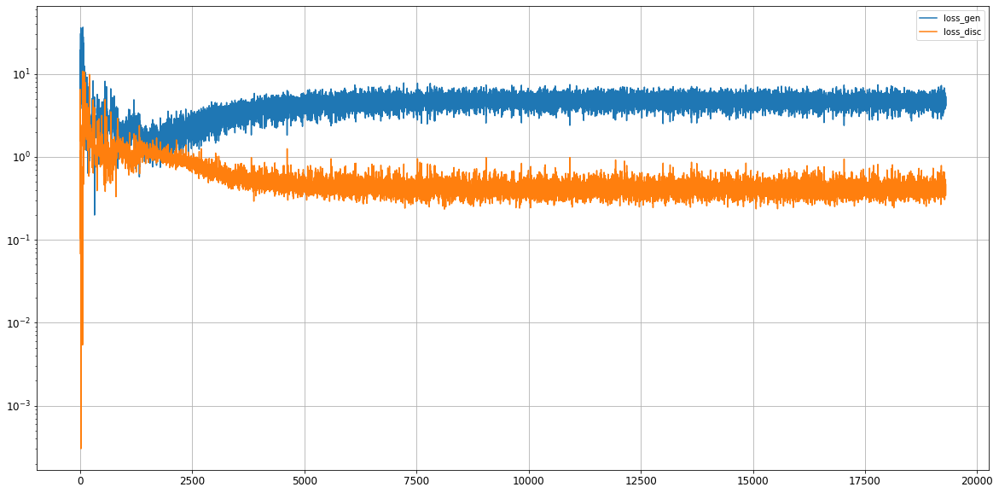

Epoch 19302/50000
0s
Epoch 19303/50000
0s
Epoch 19304/50000
0s
Epoch 19305/50000
0s
Epoch 19306/50000
0s
Epoch 19307/50000
0s
Epoch 19308/50000
0s
Epoch 19309/50000
0s
Epoch 19310/50000
0s
Epoch 19311/50000
0s
Epoch 19312/50000
0s
Epoch 19313/50000
0s
Epoch 19314/50000
0s
Epoch 19315/50000
0s
Epoch 19316/50000
0s
Epoch 19317/50000
0s
Epoch 19318/50000
0s
Epoch 19319/50000
0s
Epoch 19320/50000
0s
Epoch 19321/50000
0s
Epoch 19322/50000
0s
Epoch 19323/50000
0s
Epoch 19324/50000
0s
Epoch 19325/50000
0s
Epoch 19326/50000
0s
Epoch 19327/50000
0s
Epoch 19328/50000
0s
Epoch 19329/50000
0s
Epoch 19330/50000
0s
Epoch 19331/50000
0s
Epoch 19332/50000
0s
Epoch 19333/50000
0s
Epoch 19334/50000
0s
Epoch 19335/50000
0s
Epoch 19336/50000
0s
Epoch 19337/50000
0s
Epoch 19338/50000
0s
Epoch 19339/50000
0s
Epoch 19340/50000
0s
Epoch 19341/50000
0s
Epoch 19342/50000
0s
Epoch 19343/50000
0s
Epoch 19344/50000
0s
Epoch 19345/50000
0s
Epoch 19346/50000
0s
Epoch 19347/50000
0s
Epoch 19348/50000
0s
Epoch 19349/5

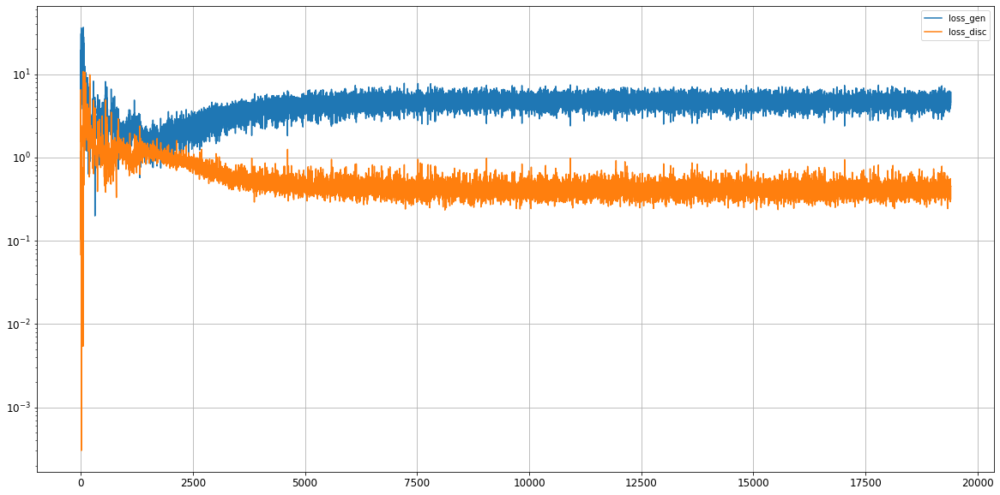

Epoch 19402/50000
0s
Epoch 19403/50000
0s
Epoch 19404/50000
0s
Epoch 19405/50000
0s
Epoch 19406/50000
0s
Epoch 19407/50000
0s
Epoch 19408/50000
0s
Epoch 19409/50000
0s
Epoch 19410/50000
0s
Epoch 19411/50000
0s
Epoch 19412/50000
0s
Epoch 19413/50000
0s
Epoch 19414/50000
0s
Epoch 19415/50000
0s
Epoch 19416/50000
0s
Epoch 19417/50000
0s
Epoch 19418/50000
0s
Epoch 19419/50000
0s
Epoch 19420/50000
0s
Epoch 19421/50000
0s
Epoch 19422/50000
0s
Epoch 19423/50000
0s
Epoch 19424/50000
0s
Epoch 19425/50000
0s
Epoch 19426/50000
0s
Epoch 19427/50000
0s
Epoch 19428/50000
0s
Epoch 19429/50000
0s
Epoch 19430/50000
0s
Epoch 19431/50000
0s
Epoch 19432/50000
0s
Epoch 19433/50000
0s
Epoch 19434/50000
0s
Epoch 19435/50000
0s
Epoch 19436/50000
0s
Epoch 19437/50000
0s
Epoch 19438/50000
0s
Epoch 19439/50000
0s
Epoch 19440/50000
0s
Epoch 19441/50000
0s
Epoch 19442/50000
0s
Epoch 19443/50000
0s
Epoch 19444/50000
0s
Epoch 19445/50000
0s
Epoch 19446/50000
0s
Epoch 19447/50000
0s
Epoch 19448/50000
0s
Epoch 19449/5

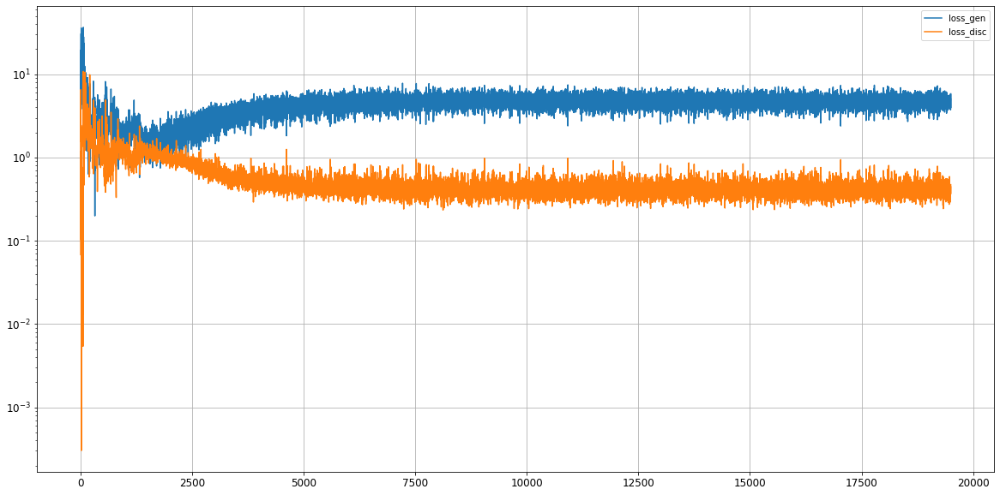

Epoch 19502/50000
0s
Epoch 19503/50000
0s
Epoch 19504/50000
0s
Epoch 19505/50000
0s
Epoch 19506/50000
0s
Epoch 19507/50000
0s
Epoch 19508/50000
0s
Epoch 19509/50000
0s
Epoch 19510/50000
0s
Epoch 19511/50000
0s
Epoch 19512/50000
0s
Epoch 19513/50000
0s
Epoch 19514/50000
0s
Epoch 19515/50000
0s
Epoch 19516/50000
0s
Epoch 19517/50000
0s
Epoch 19518/50000
0s
Epoch 19519/50000
0s
Epoch 19520/50000
0s
Epoch 19521/50000
0s
Epoch 19522/50000
0s
Epoch 19523/50000
0s
Epoch 19524/50000
0s
Epoch 19525/50000
0s
Epoch 19526/50000
0s
Epoch 19527/50000
0s
Epoch 19528/50000
0s
Epoch 19529/50000
0s
Epoch 19530/50000
0s
Epoch 19531/50000
0s
Epoch 19532/50000
0s
Epoch 19533/50000
0s
Epoch 19534/50000
0s
Epoch 19535/50000
0s
Epoch 19536/50000
0s
Epoch 19537/50000
0s
Epoch 19538/50000
0s
Epoch 19539/50000
0s
Epoch 19540/50000
0s
Epoch 19541/50000
0s
Epoch 19542/50000
0s
Epoch 19543/50000
0s
Epoch 19544/50000
0s
Epoch 19545/50000
0s
Epoch 19546/50000
0s
Epoch 19547/50000
0s
Epoch 19548/50000
0s
Epoch 19549/5

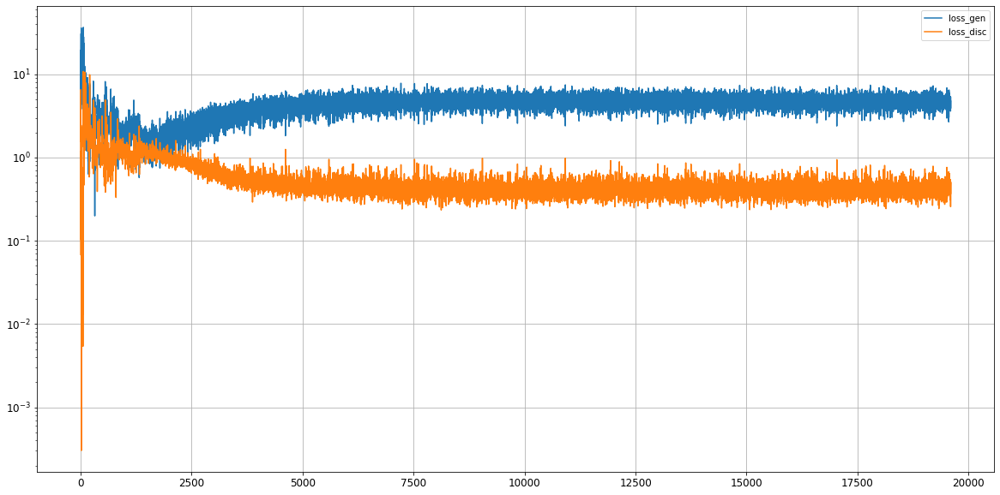

Epoch 19602/50000
0s
Epoch 19603/50000
0s
Epoch 19604/50000
0s
Epoch 19605/50000
0s
Epoch 19606/50000
0s
Epoch 19607/50000
0s
Epoch 19608/50000
0s
Epoch 19609/50000
0s
Epoch 19610/50000
0s
Epoch 19611/50000
0s
Epoch 19612/50000
0s
Epoch 19613/50000
0s
Epoch 19614/50000
0s
Epoch 19615/50000
0s
Epoch 19616/50000
0s
Epoch 19617/50000
0s
Epoch 19618/50000
0s
Epoch 19619/50000
0s
Epoch 19620/50000
0s
Epoch 19621/50000
0s
Epoch 19622/50000
0s
Epoch 19623/50000
0s
Epoch 19624/50000
0s
Epoch 19625/50000
0s
Epoch 19626/50000
0s
Epoch 19627/50000
0s
Epoch 19628/50000
0s
Epoch 19629/50000
0s
Epoch 19630/50000
0s
Epoch 19631/50000
0s
Epoch 19632/50000
0s
Epoch 19633/50000
0s
Epoch 19634/50000
0s
Epoch 19635/50000
0s
Epoch 19636/50000
0s
Epoch 19637/50000
0s
Epoch 19638/50000
0s
Epoch 19639/50000
0s
Epoch 19640/50000
0s
Epoch 19641/50000
0s
Epoch 19642/50000
0s
Epoch 19643/50000
0s
Epoch 19644/50000
0s
Epoch 19645/50000
0s
Epoch 19646/50000
0s
Epoch 19647/50000
0s
Epoch 19648/50000
0s
Epoch 19649/5

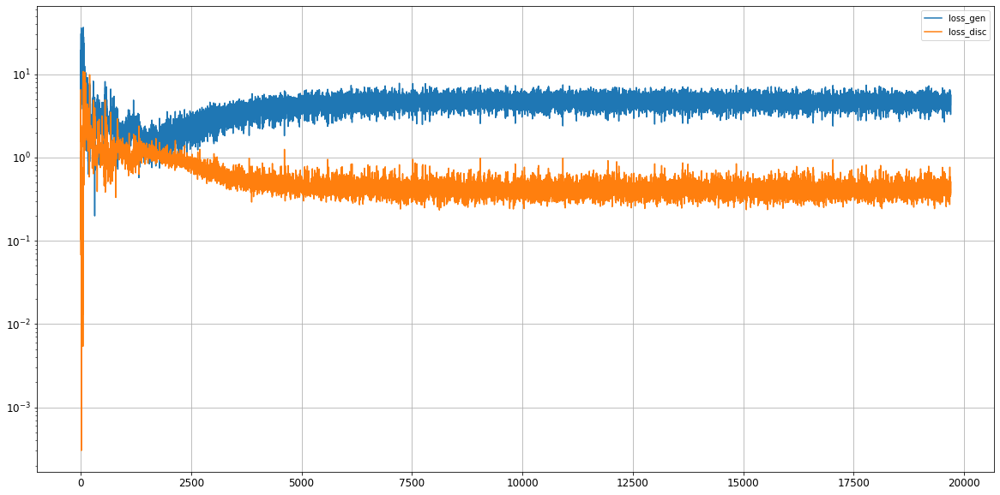

Epoch 19702/50000
0s
Epoch 19703/50000
0s
Epoch 19704/50000
0s
Epoch 19705/50000
0s
Epoch 19706/50000
0s
Epoch 19707/50000
0s
Epoch 19708/50000
0s
Epoch 19709/50000
0s
Epoch 19710/50000
0s
Epoch 19711/50000
0s
Epoch 19712/50000
0s
Epoch 19713/50000
0s
Epoch 19714/50000
0s
Epoch 19715/50000
0s
Epoch 19716/50000
0s
Epoch 19717/50000
0s
Epoch 19718/50000
0s
Epoch 19719/50000
0s
Epoch 19720/50000
0s
Epoch 19721/50000
0s
Epoch 19722/50000
0s
Epoch 19723/50000
0s
Epoch 19724/50000
0s
Epoch 19725/50000
0s
Epoch 19726/50000
0s
Epoch 19727/50000
0s
Epoch 19728/50000
0s
Epoch 19729/50000
0s
Epoch 19730/50000
0s
Epoch 19731/50000
0s
Epoch 19732/50000
0s
Epoch 19733/50000
0s
Epoch 19734/50000
0s
Epoch 19735/50000
0s
Epoch 19736/50000
0s
Epoch 19737/50000
0s
Epoch 19738/50000
0s
Epoch 19739/50000
0s
Epoch 19740/50000
0s
Epoch 19741/50000
0s
Epoch 19742/50000
0s
Epoch 19743/50000
0s
Epoch 19744/50000
0s
Epoch 19745/50000
0s
Epoch 19746/50000
0s
Epoch 19747/50000
0s
Epoch 19748/50000
0s
Epoch 19749/5

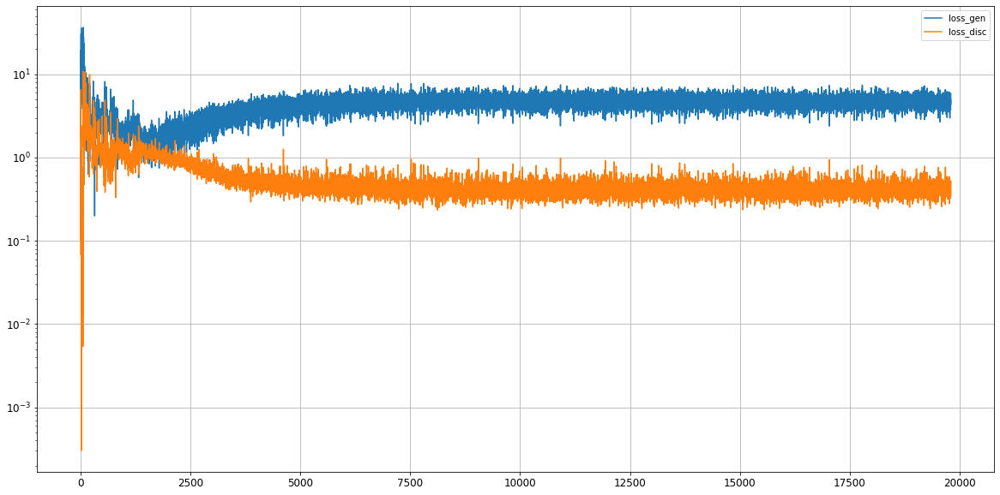

Epoch 19802/50000
0s
Epoch 19803/50000
0s
Epoch 19804/50000
0s
Epoch 19805/50000
0s
Epoch 19806/50000
0s
Epoch 19807/50000
0s
Epoch 19808/50000
0s
Epoch 19809/50000
0s
Epoch 19810/50000
0s
Epoch 19811/50000
0s
Epoch 19812/50000
0s
Epoch 19813/50000
0s
Epoch 19814/50000
0s
Epoch 19815/50000
0s
Epoch 19816/50000
0s
Epoch 19817/50000
0s
Epoch 19818/50000
0s
Epoch 19819/50000
0s
Epoch 19820/50000
0s
Epoch 19821/50000
0s
Epoch 19822/50000
0s
Epoch 19823/50000
0s
Epoch 19824/50000
0s
Epoch 19825/50000
0s
Epoch 19826/50000
0s
Epoch 19827/50000
0s
Epoch 19828/50000
0s
Epoch 19829/50000
0s
Epoch 19830/50000
0s
Epoch 19831/50000
0s
Epoch 19832/50000
0s
Epoch 19833/50000
0s
Epoch 19834/50000
0s
Epoch 19835/50000
0s
Epoch 19836/50000
0s
Epoch 19837/50000
0s
Epoch 19838/50000
0s
Epoch 19839/50000
0s
Epoch 19840/50000
0s
Epoch 19841/50000
0s
Epoch 19842/50000
0s
Epoch 19843/50000
0s
Epoch 19844/50000
0s
Epoch 19845/50000
0s
Epoch 19846/50000
0s
Epoch 19847/50000
0s
Epoch 19848/50000
0s
Epoch 19849/5

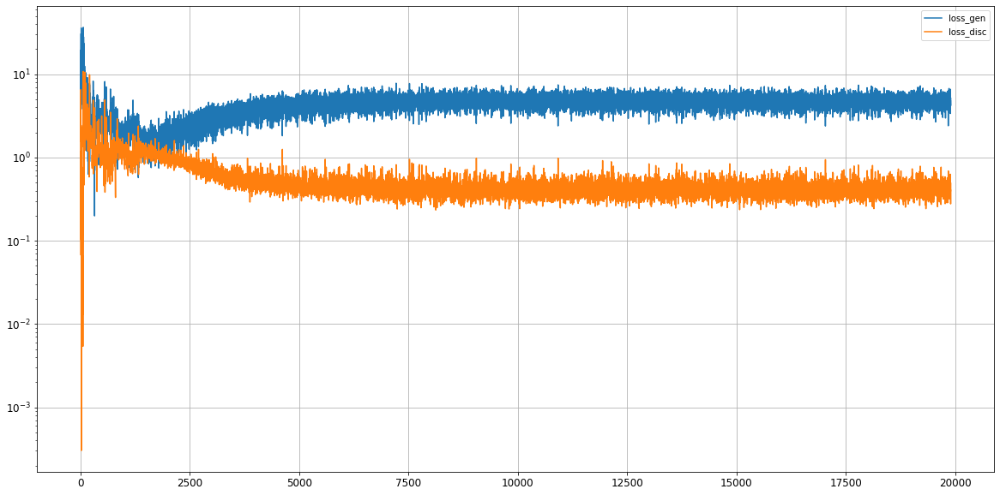

Epoch 19902/50000
0s
Epoch 19903/50000
0s
Epoch 19904/50000
0s
Epoch 19905/50000
0s
Epoch 19906/50000
0s
Epoch 19907/50000
0s
Epoch 19908/50000
0s
Epoch 19909/50000
0s
Epoch 19910/50000
0s
Epoch 19911/50000
0s
Epoch 19912/50000
0s
Epoch 19913/50000
0s
Epoch 19914/50000
0s
Epoch 19915/50000
0s
Epoch 19916/50000
0s
Epoch 19917/50000
0s
Epoch 19918/50000
0s
Epoch 19919/50000
0s
Epoch 19920/50000
0s
Epoch 19921/50000
0s
Epoch 19922/50000
0s
Epoch 19923/50000
0s
Epoch 19924/50000
0s
Epoch 19925/50000
0s
Epoch 19926/50000
0s
Epoch 19927/50000
0s
Epoch 19928/50000
0s
Epoch 19929/50000
0s
Epoch 19930/50000
0s
Epoch 19931/50000
0s
Epoch 19932/50000
0s
Epoch 19933/50000
0s
Epoch 19934/50000
0s
Epoch 19935/50000
0s
Epoch 19936/50000
0s
Epoch 19937/50000
0s
Epoch 19938/50000
0s
Epoch 19939/50000
0s
Epoch 19940/50000
0s
Epoch 19941/50000
0s
Epoch 19942/50000
0s
Epoch 19943/50000
0s
Epoch 19944/50000
0s
Epoch 19945/50000
0s
Epoch 19946/50000
0s
Epoch 19947/50000
0s
Epoch 19948/50000
0s
Epoch 19949/5

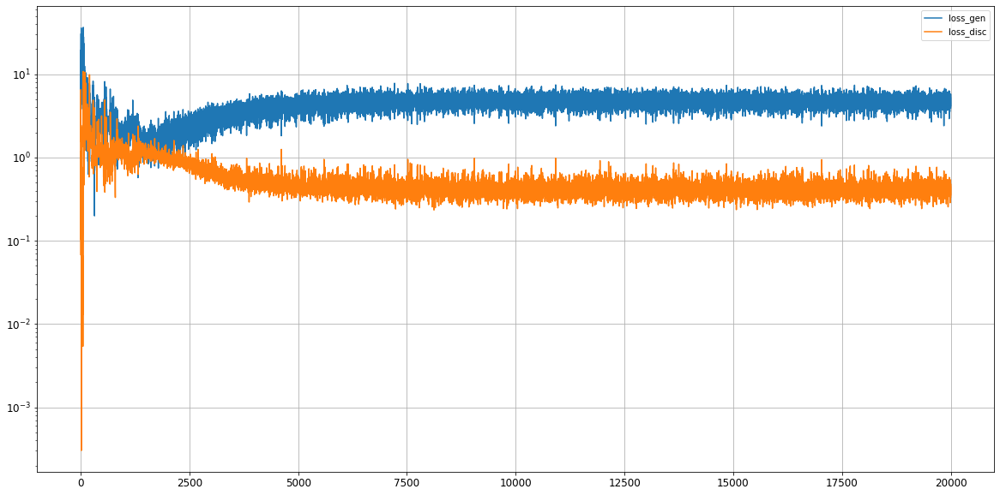

Epoch 20002/50000
0s
Epoch 20003/50000
0s
Epoch 20004/50000
0s
Epoch 20005/50000
0s
Epoch 20006/50000
0s
Epoch 20007/50000
0s
Epoch 20008/50000
0s
Epoch 20009/50000
0s
Epoch 20010/50000
0s
Epoch 20011/50000
0s
Epoch 20012/50000
0s
Epoch 20013/50000
0s
Epoch 20014/50000
0s
Epoch 20015/50000
0s
Epoch 20016/50000
0s
Epoch 20017/50000
0s
Epoch 20018/50000
0s
Epoch 20019/50000
0s
Epoch 20020/50000
0s
Epoch 20021/50000
0s
Epoch 20022/50000
0s
Epoch 20023/50000
0s
Epoch 20024/50000
0s
Epoch 20025/50000
0s
Epoch 20026/50000
0s
Epoch 20027/50000
0s
Epoch 20028/50000
0s
Epoch 20029/50000
0s
Epoch 20030/50000
0s
Epoch 20031/50000
0s
Epoch 20032/50000
0s
Epoch 20033/50000
0s
Epoch 20034/50000
0s
Epoch 20035/50000
0s
Epoch 20036/50000
0s
Epoch 20037/50000
0s
Epoch 20038/50000
0s
Epoch 20039/50000
0s
Epoch 20040/50000
0s
Epoch 20041/50000
0s
Epoch 20042/50000
0s
Epoch 20043/50000
0s
Epoch 20044/50000
0s
Epoch 20045/50000
0s
Epoch 20046/50000
0s
Epoch 20047/50000
0s
Epoch 20048/50000
0s
Epoch 20049/5

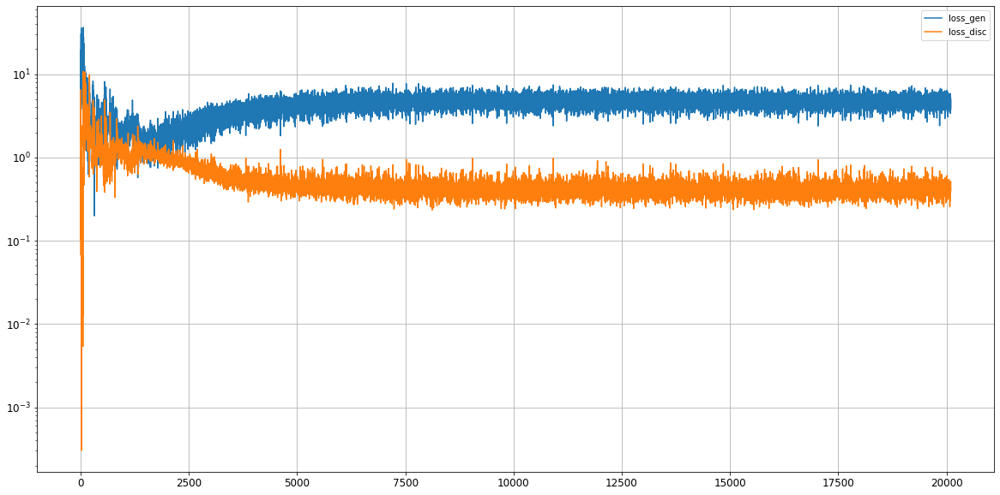

Epoch 20102/50000
0s
Epoch 20103/50000
0s
Epoch 20104/50000
0s
Epoch 20105/50000
0s
Epoch 20106/50000
0s
Epoch 20107/50000
0s
Epoch 20108/50000
0s
Epoch 20109/50000
0s
Epoch 20110/50000
0s
Epoch 20111/50000
0s
Epoch 20112/50000
0s
Epoch 20113/50000
0s
Epoch 20114/50000
0s
Epoch 20115/50000
0s
Epoch 20116/50000
0s
Epoch 20117/50000
0s
Epoch 20118/50000
0s
Epoch 20119/50000
0s
Epoch 20120/50000
0s
Epoch 20121/50000
0s
Epoch 20122/50000
0s
Epoch 20123/50000
0s
Epoch 20124/50000
0s
Epoch 20125/50000
0s
Epoch 20126/50000
0s
Epoch 20127/50000
0s
Epoch 20128/50000
0s
Epoch 20129/50000
0s
Epoch 20130/50000
0s
Epoch 20131/50000
0s
Epoch 20132/50000
0s
Epoch 20133/50000
0s
Epoch 20134/50000
0s
Epoch 20135/50000
0s
Epoch 20136/50000
0s
Epoch 20137/50000
0s
Epoch 20138/50000
0s
Epoch 20139/50000
0s
Epoch 20140/50000
0s
Epoch 20141/50000
0s
Epoch 20142/50000
0s
Epoch 20143/50000
0s
Epoch 20144/50000
0s
Epoch 20145/50000
0s
Epoch 20146/50000
0s
Epoch 20147/50000
0s
Epoch 20148/50000
0s
Epoch 20149/5

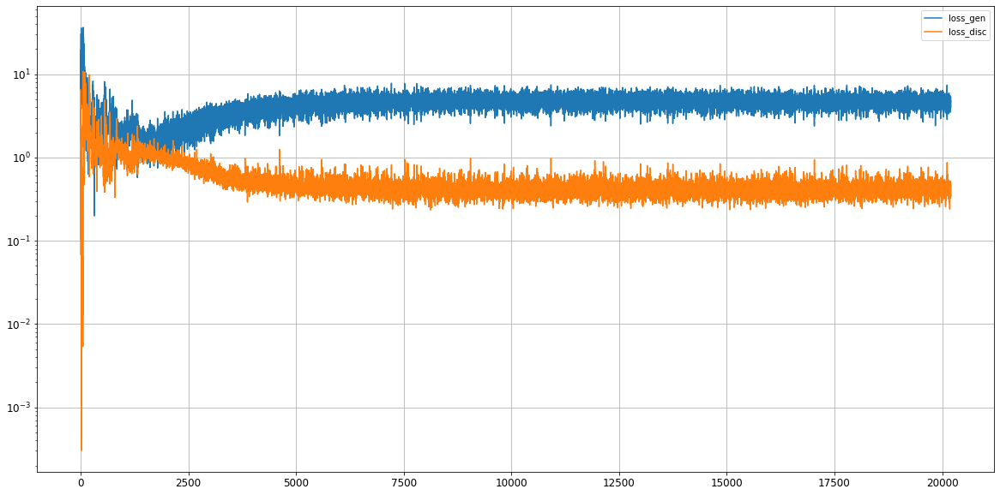

Epoch 20202/50000
0s
Epoch 20203/50000
0s
Epoch 20204/50000
0s
Epoch 20205/50000
0s
Epoch 20206/50000
0s
Epoch 20207/50000
0s
Epoch 20208/50000
0s
Epoch 20209/50000
0s
Epoch 20210/50000
0s
Epoch 20211/50000
0s
Epoch 20212/50000
0s
Epoch 20213/50000
0s
Epoch 20214/50000
0s
Epoch 20215/50000
0s
Epoch 20216/50000
0s
Epoch 20217/50000
0s
Epoch 20218/50000
0s
Epoch 20219/50000
0s
Epoch 20220/50000
0s
Epoch 20221/50000
0s
Epoch 20222/50000
0s
Epoch 20223/50000
0s
Epoch 20224/50000
0s
Epoch 20225/50000
0s
Epoch 20226/50000
0s
Epoch 20227/50000
0s
Epoch 20228/50000
0s
Epoch 20229/50000
0s
Epoch 20230/50000
0s
Epoch 20231/50000
0s
Epoch 20232/50000
0s
Epoch 20233/50000
0s
Epoch 20234/50000
0s
Epoch 20235/50000
0s
Epoch 20236/50000
0s
Epoch 20237/50000
0s
Epoch 20238/50000
0s
Epoch 20239/50000
0s
Epoch 20240/50000
0s
Epoch 20241/50000
0s
Epoch 20242/50000
0s
Epoch 20243/50000
0s
Epoch 20244/50000
0s
Epoch 20245/50000
0s
Epoch 20246/50000
0s
Epoch 20247/50000
0s
Epoch 20248/50000
0s
Epoch 20249/5

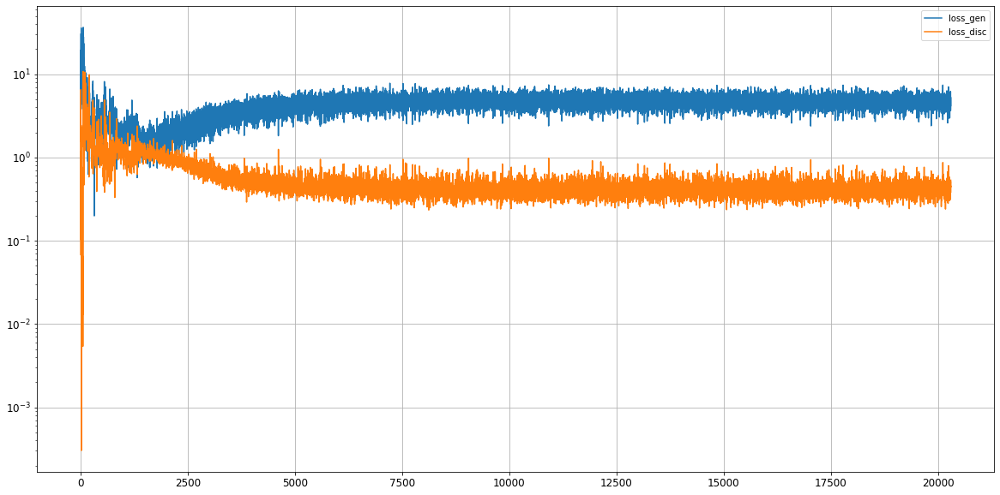

Epoch 20302/50000
0s
Epoch 20303/50000
0s
Epoch 20304/50000
0s
Epoch 20305/50000
0s
Epoch 20306/50000
0s
Epoch 20307/50000
0s
Epoch 20308/50000
0s
Epoch 20309/50000
0s
Epoch 20310/50000
0s
Epoch 20311/50000
0s
Epoch 20312/50000
0s
Epoch 20313/50000
0s
Epoch 20314/50000
0s
Epoch 20315/50000
0s
Epoch 20316/50000
0s
Epoch 20317/50000
0s
Epoch 20318/50000
0s
Epoch 20319/50000
0s
Epoch 20320/50000
0s
Epoch 20321/50000
0s
Epoch 20322/50000
0s
Epoch 20323/50000
0s
Epoch 20324/50000
0s
Epoch 20325/50000
0s
Epoch 20326/50000
0s
Epoch 20327/50000
0s
Epoch 20328/50000
0s
Epoch 20329/50000
0s
Epoch 20330/50000
0s
Epoch 20331/50000
0s
Epoch 20332/50000
0s
Epoch 20333/50000
0s
Epoch 20334/50000
0s
Epoch 20335/50000
0s
Epoch 20336/50000
0s
Epoch 20337/50000
0s
Epoch 20338/50000
0s
Epoch 20339/50000
0s
Epoch 20340/50000
0s
Epoch 20341/50000
0s
Epoch 20342/50000
0s
Epoch 20343/50000
0s
Epoch 20344/50000
0s
Epoch 20345/50000
0s
Epoch 20346/50000
0s
Epoch 20347/50000
0s
Epoch 20348/50000
0s
Epoch 20349/5

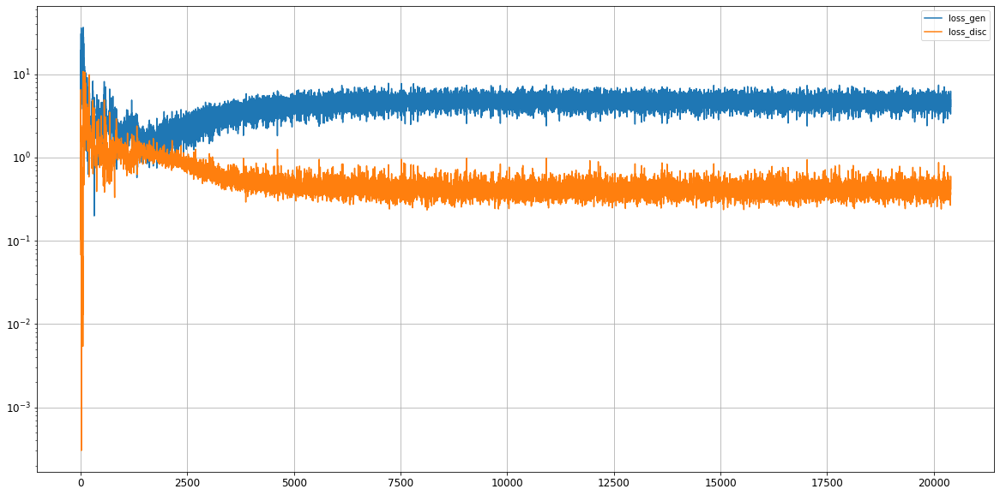

Epoch 20402/50000
0s
Epoch 20403/50000
0s
Epoch 20404/50000
0s
Epoch 20405/50000
0s
Epoch 20406/50000
0s
Epoch 20407/50000
0s
Epoch 20408/50000
0s
Epoch 20409/50000
0s
Epoch 20410/50000
0s
Epoch 20411/50000
0s
Epoch 20412/50000
0s
Epoch 20413/50000
0s
Epoch 20414/50000
0s
Epoch 20415/50000
0s
Epoch 20416/50000
0s
Epoch 20417/50000
0s
Epoch 20418/50000
0s
Epoch 20419/50000
0s
Epoch 20420/50000
0s
Epoch 20421/50000
0s
Epoch 20422/50000
0s
Epoch 20423/50000
0s
Epoch 20424/50000
0s
Epoch 20425/50000
0s
Epoch 20426/50000
0s
Epoch 20427/50000
0s
Epoch 20428/50000
0s
Epoch 20429/50000
0s
Epoch 20430/50000
0s
Epoch 20431/50000
0s
Epoch 20432/50000
0s
Epoch 20433/50000
0s
Epoch 20434/50000
0s
Epoch 20435/50000
0s
Epoch 20436/50000
0s
Epoch 20437/50000
0s
Epoch 20438/50000
0s
Epoch 20439/50000
0s
Epoch 20440/50000
0s
Epoch 20441/50000
0s
Epoch 20442/50000
0s
Epoch 20443/50000
0s
Epoch 20444/50000
0s
Epoch 20445/50000
0s
Epoch 20446/50000
0s
Epoch 20447/50000
0s
Epoch 20448/50000
0s
Epoch 20449/5

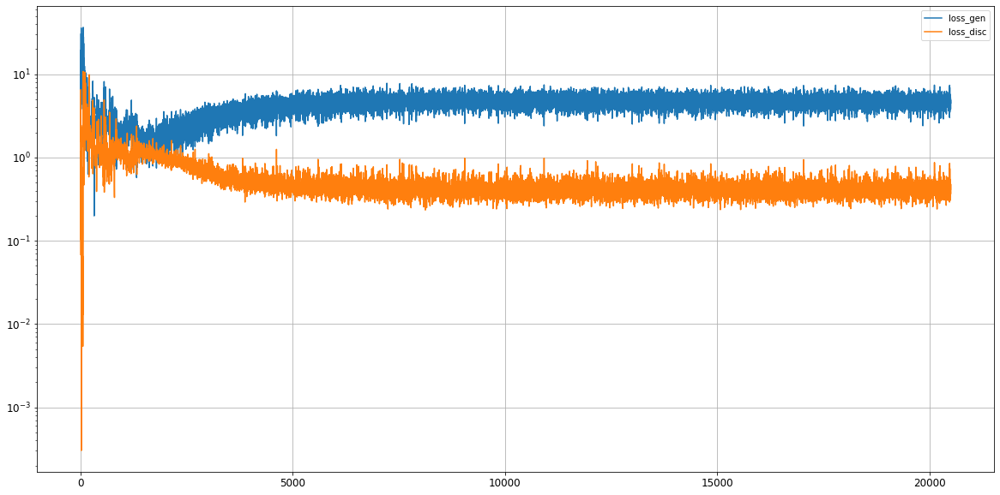

Epoch 20502/50000
0s
Epoch 20503/50000
0s
Epoch 20504/50000
0s
Epoch 20505/50000
0s
Epoch 20506/50000
0s
Epoch 20507/50000
0s
Epoch 20508/50000
0s
Epoch 20509/50000
0s
Epoch 20510/50000
0s
Epoch 20511/50000
0s
Epoch 20512/50000
0s
Epoch 20513/50000
0s
Epoch 20514/50000
0s
Epoch 20515/50000
0s
Epoch 20516/50000
0s
Epoch 20517/50000
0s
Epoch 20518/50000
0s
Epoch 20519/50000
0s
Epoch 20520/50000
0s
Epoch 20521/50000
0s
Epoch 20522/50000
0s
Epoch 20523/50000
0s
Epoch 20524/50000
0s
Epoch 20525/50000
0s
Epoch 20526/50000
0s
Epoch 20527/50000
0s
Epoch 20528/50000
0s
Epoch 20529/50000
0s
Epoch 20530/50000
0s
Epoch 20531/50000
0s
Epoch 20532/50000
0s
Epoch 20533/50000
0s
Epoch 20534/50000
0s
Epoch 20535/50000
0s
Epoch 20536/50000
0s
Epoch 20537/50000
0s
Epoch 20538/50000
0s
Epoch 20539/50000
0s
Epoch 20540/50000
0s
Epoch 20541/50000
0s
Epoch 20542/50000
0s
Epoch 20543/50000
0s
Epoch 20544/50000
0s
Epoch 20545/50000
0s
Epoch 20546/50000
0s
Epoch 20547/50000
0s
Epoch 20548/50000
0s
Epoch 20549/5

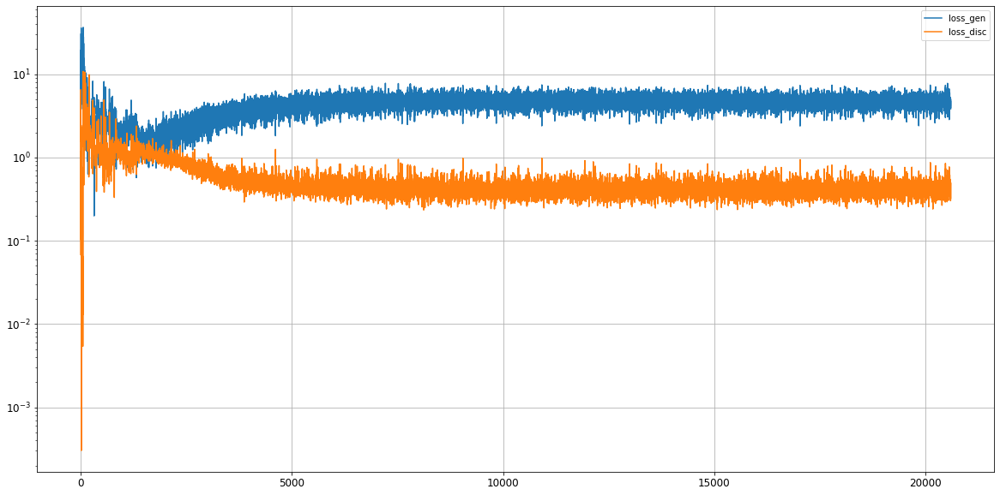

Epoch 20602/50000
0s
Epoch 20603/50000
0s
Epoch 20604/50000
0s
Epoch 20605/50000
0s
Epoch 20606/50000
0s
Epoch 20607/50000
0s
Epoch 20608/50000
0s
Epoch 20609/50000
0s
Epoch 20610/50000
0s
Epoch 20611/50000
0s
Epoch 20612/50000
0s
Epoch 20613/50000
0s
Epoch 20614/50000
0s
Epoch 20615/50000
0s
Epoch 20616/50000
0s
Epoch 20617/50000
0s
Epoch 20618/50000
0s
Epoch 20619/50000
0s
Epoch 20620/50000
0s
Epoch 20621/50000
0s
Epoch 20622/50000
0s
Epoch 20623/50000
0s
Epoch 20624/50000
0s
Epoch 20625/50000
0s
Epoch 20626/50000
0s
Epoch 20627/50000
0s
Epoch 20628/50000
0s
Epoch 20629/50000
0s
Epoch 20630/50000
0s
Epoch 20631/50000
0s
Epoch 20632/50000
0s
Epoch 20633/50000
0s
Epoch 20634/50000
0s
Epoch 20635/50000
0s
Epoch 20636/50000
0s
Epoch 20637/50000
0s
Epoch 20638/50000
0s
Epoch 20639/50000
0s
Epoch 20640/50000
0s
Epoch 20641/50000
0s
Epoch 20642/50000
0s
Epoch 20643/50000
0s
Epoch 20644/50000
0s
Epoch 20645/50000
0s
Epoch 20646/50000
0s
Epoch 20647/50000
0s
Epoch 20648/50000
0s
Epoch 20649/5

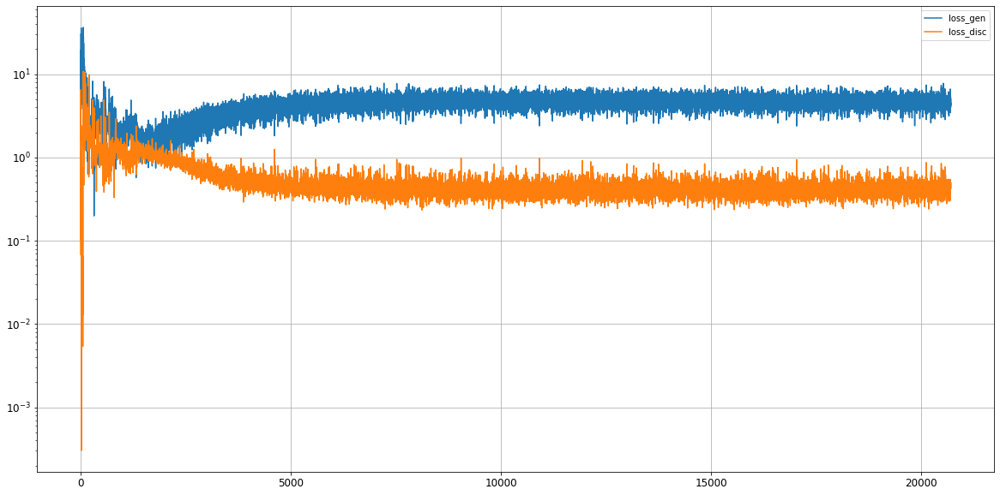

Epoch 20702/50000
0s
Epoch 20703/50000
0s
Epoch 20704/50000
0s
Epoch 20705/50000
0s
Epoch 20706/50000
0s
Epoch 20707/50000
0s
Epoch 20708/50000
0s
Epoch 20709/50000
0s
Epoch 20710/50000
0s
Epoch 20711/50000
0s
Epoch 20712/50000
0s
Epoch 20713/50000
0s
Epoch 20714/50000
0s
Epoch 20715/50000
0s
Epoch 20716/50000
0s
Epoch 20717/50000
0s
Epoch 20718/50000
0s
Epoch 20719/50000
0s
Epoch 20720/50000
0s
Epoch 20721/50000
0s
Epoch 20722/50000
0s
Epoch 20723/50000
0s
Epoch 20724/50000
0s
Epoch 20725/50000
0s
Epoch 20726/50000
0s
Epoch 20727/50000
0s
Epoch 20728/50000
0s
Epoch 20729/50000
0s
Epoch 20730/50000
0s
Epoch 20731/50000
0s
Epoch 20732/50000
0s
Epoch 20733/50000
0s
Epoch 20734/50000
0s
Epoch 20735/50000
0s
Epoch 20736/50000
0s
Epoch 20737/50000
0s
Epoch 20738/50000
0s
Epoch 20739/50000
0s
Epoch 20740/50000
0s
Epoch 20741/50000
0s
Epoch 20742/50000
0s
Epoch 20743/50000
0s
Epoch 20744/50000
0s
Epoch 20745/50000
0s
Epoch 20746/50000
0s
Epoch 20747/50000
0s
Epoch 20748/50000
0s
Epoch 20749/5

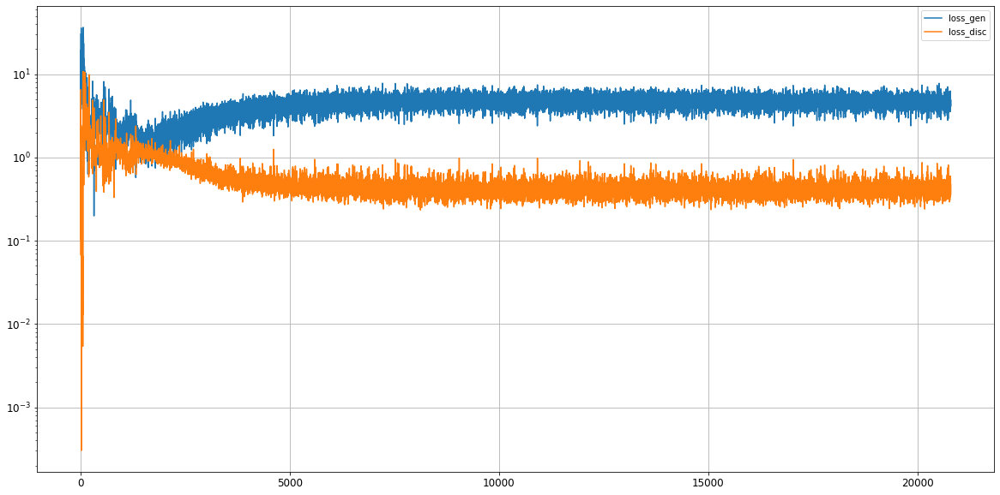

Epoch 20802/50000
0s
Epoch 20803/50000
0s
Epoch 20804/50000
0s
Epoch 20805/50000
0s
Epoch 20806/50000
0s
Epoch 20807/50000
0s
Epoch 20808/50000
0s
Epoch 20809/50000
0s
Epoch 20810/50000
0s
Epoch 20811/50000
0s
Epoch 20812/50000
0s
Epoch 20813/50000
0s
Epoch 20814/50000
0s
Epoch 20815/50000
0s
Epoch 20816/50000
0s
Epoch 20817/50000
0s
Epoch 20818/50000
0s
Epoch 20819/50000
0s
Epoch 20820/50000
0s
Epoch 20821/50000
0s
Epoch 20822/50000
0s
Epoch 20823/50000
0s
Epoch 20824/50000
0s
Epoch 20825/50000
0s
Epoch 20826/50000
0s
Epoch 20827/50000
0s
Epoch 20828/50000
0s
Epoch 20829/50000
0s
Epoch 20830/50000
0s
Epoch 20831/50000
0s
Epoch 20832/50000
0s
Epoch 20833/50000
0s
Epoch 20834/50000
0s
Epoch 20835/50000
0s
Epoch 20836/50000
0s
Epoch 20837/50000
0s
Epoch 20838/50000
0s
Epoch 20839/50000
0s
Epoch 20840/50000
0s
Epoch 20841/50000
0s
Epoch 20842/50000
0s
Epoch 20843/50000
0s
Epoch 20844/50000
0s
Epoch 20845/50000
0s
Epoch 20846/50000
0s
Epoch 20847/50000
0s
Epoch 20848/50000
0s
Epoch 20849/5

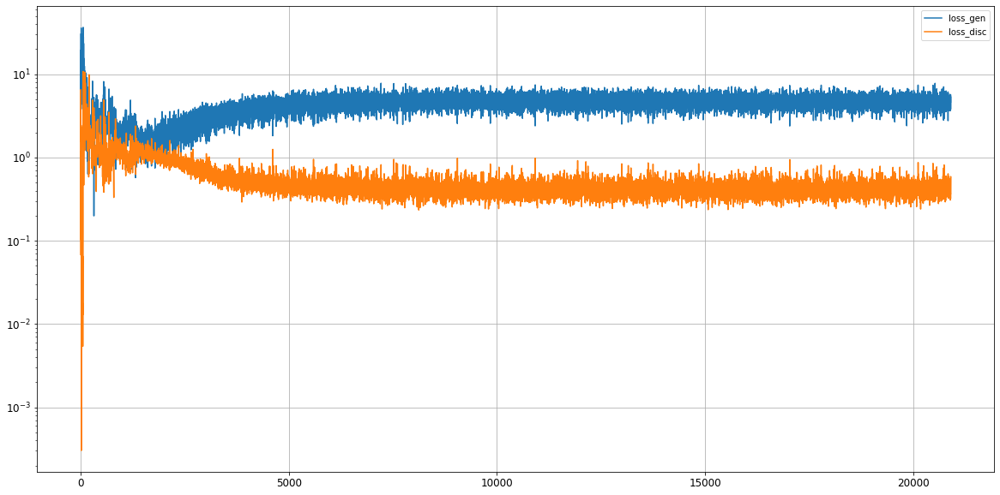

Epoch 20902/50000
0s
Epoch 20903/50000
0s
Epoch 20904/50000
0s
Epoch 20905/50000
0s
Epoch 20906/50000
0s
Epoch 20907/50000
0s
Epoch 20908/50000
0s
Epoch 20909/50000
0s
Epoch 20910/50000
0s
Epoch 20911/50000
0s
Epoch 20912/50000
0s
Epoch 20913/50000
0s
Epoch 20914/50000
0s
Epoch 20915/50000
0s
Epoch 20916/50000
0s
Epoch 20917/50000
0s
Epoch 20918/50000
0s
Epoch 20919/50000
0s
Epoch 20920/50000
0s
Epoch 20921/50000
0s
Epoch 20922/50000
0s
Epoch 20923/50000
0s
Epoch 20924/50000
0s
Epoch 20925/50000
0s
Epoch 20926/50000
0s
Epoch 20927/50000
0s
Epoch 20928/50000
0s
Epoch 20929/50000
0s
Epoch 20930/50000
0s
Epoch 20931/50000
0s
Epoch 20932/50000
0s
Epoch 20933/50000
0s
Epoch 20934/50000
0s
Epoch 20935/50000
0s
Epoch 20936/50000
0s
Epoch 20937/50000
0s
Epoch 20938/50000
0s
Epoch 20939/50000
0s
Epoch 20940/50000
0s
Epoch 20941/50000
0s
Epoch 20942/50000
0s
Epoch 20943/50000
0s
Epoch 20944/50000
0s
Epoch 20945/50000
0s
Epoch 20946/50000
0s
Epoch 20947/50000
0s
Epoch 20948/50000
0s
Epoch 20949/5

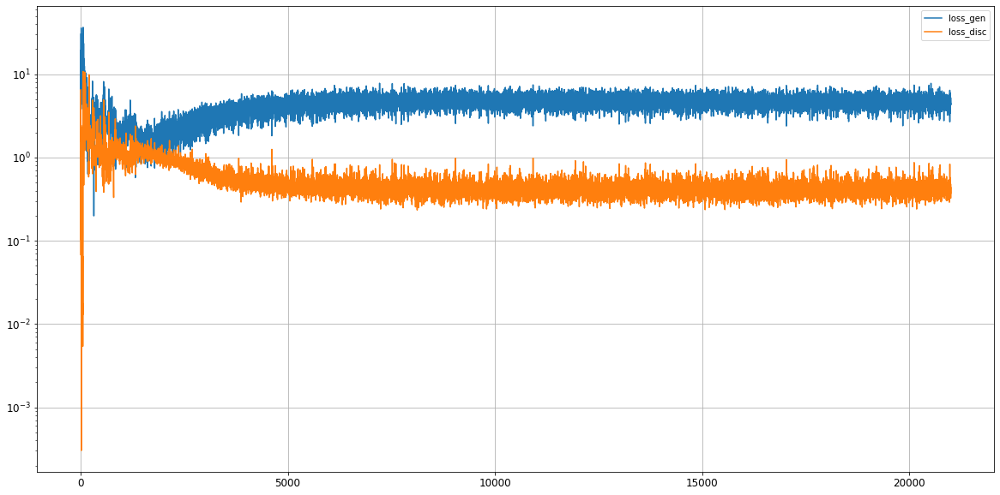

Epoch 21002/50000
0s
Epoch 21003/50000
0s
Epoch 21004/50000
0s
Epoch 21005/50000
0s
Epoch 21006/50000
0s
Epoch 21007/50000
0s
Epoch 21008/50000
0s
Epoch 21009/50000
0s
Epoch 21010/50000
0s
Epoch 21011/50000
0s
Epoch 21012/50000
0s
Epoch 21013/50000
0s
Epoch 21014/50000
0s
Epoch 21015/50000
0s
Epoch 21016/50000
0s
Epoch 21017/50000
0s
Epoch 21018/50000
0s
Epoch 21019/50000
0s
Epoch 21020/50000
0s
Epoch 21021/50000
0s
Epoch 21022/50000
0s
Epoch 21023/50000
0s
Epoch 21024/50000
0s
Epoch 21025/50000
0s
Epoch 21026/50000
0s
Epoch 21027/50000
0s
Epoch 21028/50000
0s
Epoch 21029/50000
0s
Epoch 21030/50000
0s
Epoch 21031/50000
0s
Epoch 21032/50000
0s
Epoch 21033/50000
0s
Epoch 21034/50000
0s
Epoch 21035/50000
0s
Epoch 21036/50000
0s
Epoch 21037/50000
0s
Epoch 21038/50000
0s
Epoch 21039/50000
0s
Epoch 21040/50000
0s
Epoch 21041/50000
0s
Epoch 21042/50000
0s
Epoch 21043/50000
0s
Epoch 21044/50000
0s
Epoch 21045/50000
0s
Epoch 21046/50000
0s
Epoch 21047/50000
0s
Epoch 21048/50000
0s
Epoch 21049/5

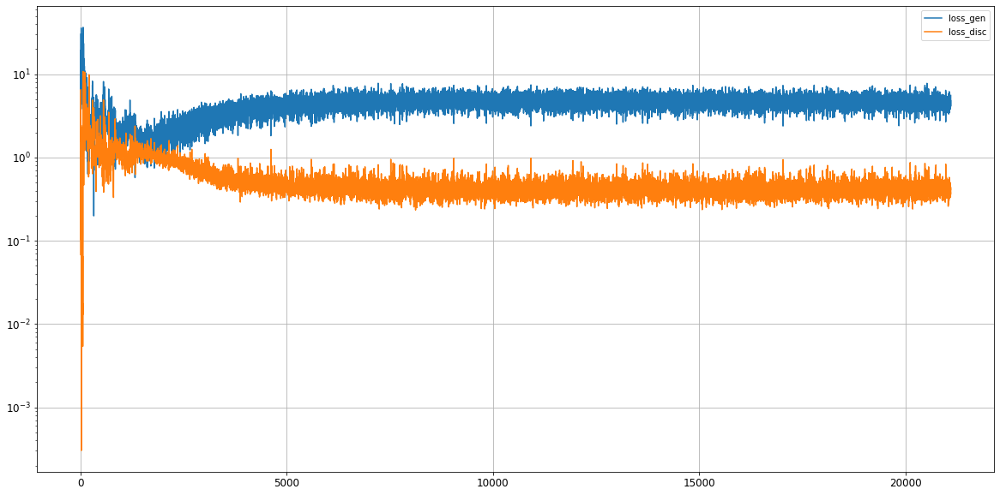

Epoch 21102/50000
0s
Epoch 21103/50000
0s
Epoch 21104/50000
0s
Epoch 21105/50000
0s
Epoch 21106/50000
0s
Epoch 21107/50000
0s
Epoch 21108/50000
0s
Epoch 21109/50000
0s
Epoch 21110/50000
0s
Epoch 21111/50000
0s
Epoch 21112/50000
0s
Epoch 21113/50000
0s
Epoch 21114/50000
0s
Epoch 21115/50000
0s
Epoch 21116/50000
0s
Epoch 21117/50000
0s
Epoch 21118/50000
0s
Epoch 21119/50000
0s
Epoch 21120/50000
0s
Epoch 21121/50000
0s
Epoch 21122/50000
0s
Epoch 21123/50000
0s
Epoch 21124/50000
0s
Epoch 21125/50000
0s
Epoch 21126/50000
0s
Epoch 21127/50000
0s
Epoch 21128/50000
0s
Epoch 21129/50000
0s
Epoch 21130/50000
0s
Epoch 21131/50000
0s
Epoch 21132/50000
0s
Epoch 21133/50000
0s
Epoch 21134/50000
0s
Epoch 21135/50000
0s
Epoch 21136/50000
0s
Epoch 21137/50000
0s
Epoch 21138/50000
0s
Epoch 21139/50000
0s
Epoch 21140/50000
0s
Epoch 21141/50000
0s
Epoch 21142/50000
0s
Epoch 21143/50000
0s
Epoch 21144/50000
0s
Epoch 21145/50000
0s
Epoch 21146/50000
0s
Epoch 21147/50000
0s
Epoch 21148/50000
0s
Epoch 21149/5

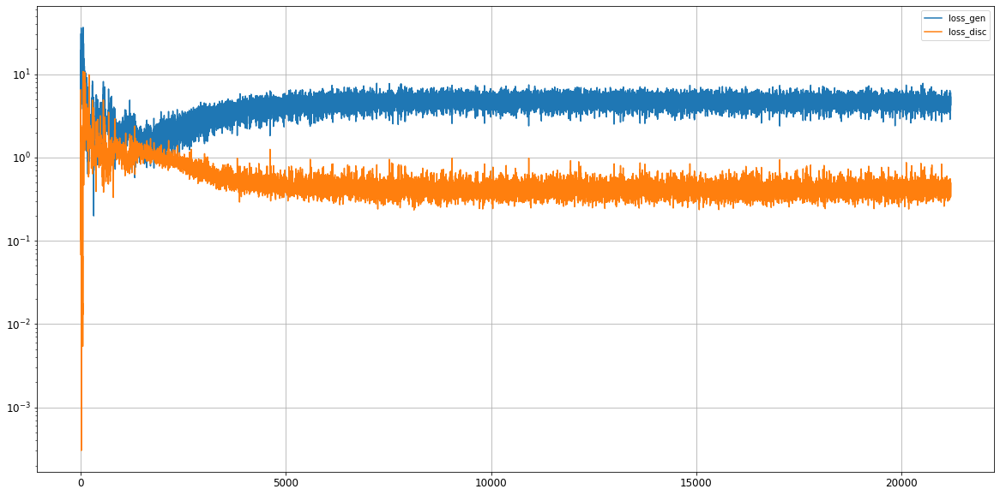

Epoch 21202/50000
0s
Epoch 21203/50000
0s
Epoch 21204/50000
0s
Epoch 21205/50000
0s
Epoch 21206/50000
0s
Epoch 21207/50000
0s
Epoch 21208/50000
0s
Epoch 21209/50000
0s
Epoch 21210/50000
0s
Epoch 21211/50000
0s
Epoch 21212/50000
0s
Epoch 21213/50000
0s
Epoch 21214/50000
0s
Epoch 21215/50000
0s
Epoch 21216/50000
0s
Epoch 21217/50000
0s
Epoch 21218/50000
0s
Epoch 21219/50000
0s
Epoch 21220/50000
0s
Epoch 21221/50000
0s
Epoch 21222/50000
0s
Epoch 21223/50000
0s
Epoch 21224/50000
0s
Epoch 21225/50000
0s
Epoch 21226/50000
0s
Epoch 21227/50000
0s
Epoch 21228/50000
0s
Epoch 21229/50000
0s
Epoch 21230/50000
0s
Epoch 21231/50000
0s
Epoch 21232/50000
0s
Epoch 21233/50000
0s
Epoch 21234/50000
0s
Epoch 21235/50000
0s
Epoch 21236/50000
0s
Epoch 21237/50000
0s
Epoch 21238/50000
0s
Epoch 21239/50000
0s
Epoch 21240/50000
0s
Epoch 21241/50000
0s
Epoch 21242/50000
0s
Epoch 21243/50000
0s
Epoch 21244/50000
0s
Epoch 21245/50000
0s
Epoch 21246/50000
0s
Epoch 21247/50000
0s
Epoch 21248/50000
0s
Epoch 21249/5

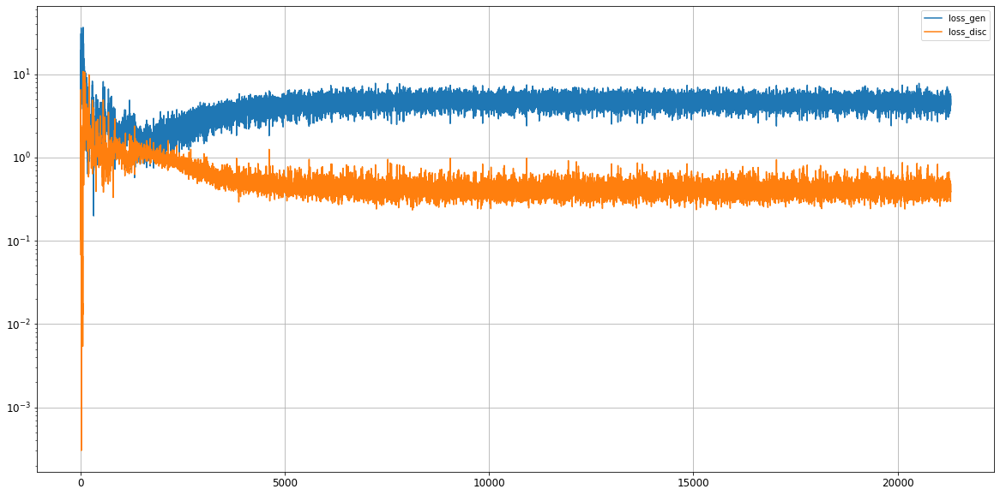

Epoch 21302/50000
0s
Epoch 21303/50000
0s
Epoch 21304/50000
0s
Epoch 21305/50000
0s
Epoch 21306/50000
0s
Epoch 21307/50000
0s
Epoch 21308/50000
0s
Epoch 21309/50000
0s
Epoch 21310/50000
0s
Epoch 21311/50000
0s
Epoch 21312/50000
0s
Epoch 21313/50000
0s
Epoch 21314/50000
0s
Epoch 21315/50000
0s
Epoch 21316/50000
0s
Epoch 21317/50000
0s
Epoch 21318/50000
0s
Epoch 21319/50000
0s
Epoch 21320/50000
0s
Epoch 21321/50000
0s
Epoch 21322/50000
0s
Epoch 21323/50000
0s
Epoch 21324/50000
0s
Epoch 21325/50000
0s
Epoch 21326/50000
0s
Epoch 21327/50000
0s
Epoch 21328/50000
0s
Epoch 21329/50000
0s
Epoch 21330/50000
0s
Epoch 21331/50000
0s
Epoch 21332/50000
0s
Epoch 21333/50000
0s
Epoch 21334/50000
0s
Epoch 21335/50000
0s
Epoch 21336/50000
0s
Epoch 21337/50000
0s
Epoch 21338/50000
0s
Epoch 21339/50000
0s
Epoch 21340/50000
0s
Epoch 21341/50000
0s
Epoch 21342/50000
0s
Epoch 21343/50000
0s
Epoch 21344/50000
0s
Epoch 21345/50000
0s
Epoch 21346/50000
0s
Epoch 21347/50000
0s
Epoch 21348/50000
0s
Epoch 21349/5

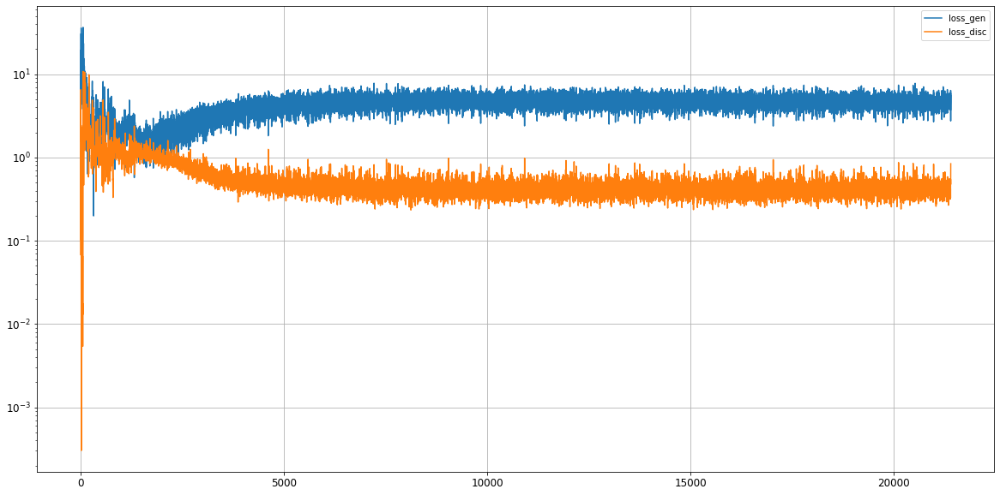

Epoch 21402/50000
0s
Epoch 21403/50000
0s
Epoch 21404/50000
0s
Epoch 21405/50000
0s
Epoch 21406/50000
0s
Epoch 21407/50000
0s
Epoch 21408/50000
0s
Epoch 21409/50000
0s
Epoch 21410/50000
0s
Epoch 21411/50000
0s
Epoch 21412/50000
0s
Epoch 21413/50000
0s
Epoch 21414/50000
0s
Epoch 21415/50000
0s
Epoch 21416/50000
0s
Epoch 21417/50000
0s
Epoch 21418/50000
0s
Epoch 21419/50000
0s
Epoch 21420/50000
0s
Epoch 21421/50000
0s
Epoch 21422/50000
0s
Epoch 21423/50000
0s
Epoch 21424/50000
0s
Epoch 21425/50000
0s
Epoch 21426/50000
0s
Epoch 21427/50000
0s
Epoch 21428/50000
0s
Epoch 21429/50000
0s
Epoch 21430/50000
0s
Epoch 21431/50000
0s
Epoch 21432/50000
0s
Epoch 21433/50000
0s
Epoch 21434/50000
0s
Epoch 21435/50000
0s
Epoch 21436/50000
0s
Epoch 21437/50000
0s
Epoch 21438/50000
0s
Epoch 21439/50000
0s
Epoch 21440/50000
0s
Epoch 21441/50000
0s
Epoch 21442/50000
0s
Epoch 21443/50000
0s
Epoch 21444/50000
0s
Epoch 21445/50000
0s
Epoch 21446/50000
0s
Epoch 21447/50000
0s
Epoch 21448/50000
0s
Epoch 21449/5

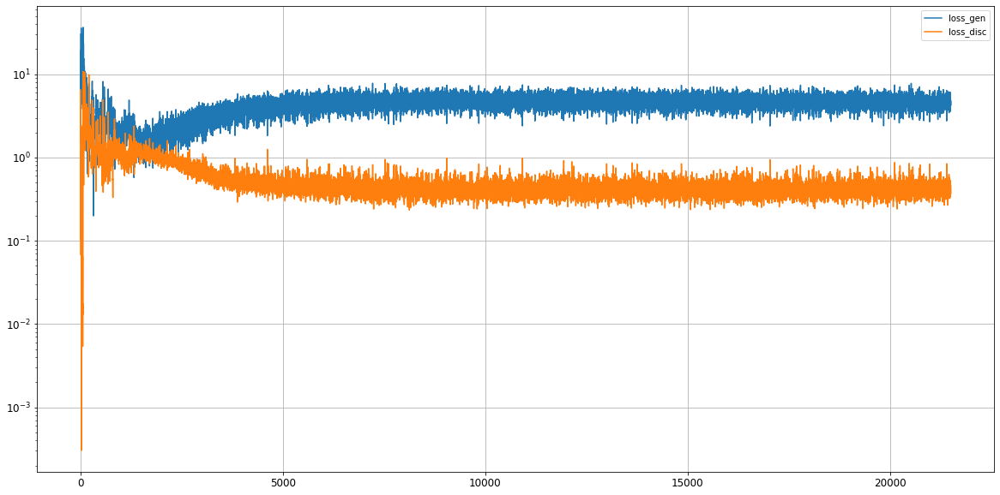

Epoch 21502/50000
0s
Epoch 21503/50000
0s
Epoch 21504/50000
0s
Epoch 21505/50000
0s
Epoch 21506/50000
0s
Epoch 21507/50000
0s
Epoch 21508/50000
0s
Epoch 21509/50000
0s
Epoch 21510/50000
0s
Epoch 21511/50000
0s
Epoch 21512/50000
0s
Epoch 21513/50000
0s
Epoch 21514/50000
0s
Epoch 21515/50000
0s
Epoch 21516/50000
0s
Epoch 21517/50000
0s
Epoch 21518/50000
0s
Epoch 21519/50000
0s
Epoch 21520/50000
0s
Epoch 21521/50000
0s
Epoch 21522/50000
0s
Epoch 21523/50000
0s
Epoch 21524/50000
0s
Epoch 21525/50000
0s
Epoch 21526/50000
0s
Epoch 21527/50000
0s
Epoch 21528/50000
0s
Epoch 21529/50000
0s
Epoch 21530/50000
0s
Epoch 21531/50000
0s
Epoch 21532/50000
0s
Epoch 21533/50000
0s
Epoch 21534/50000
0s
Epoch 21535/50000
0s
Epoch 21536/50000
0s
Epoch 21537/50000
0s
Epoch 21538/50000
0s
Epoch 21539/50000
0s
Epoch 21540/50000
0s
Epoch 21541/50000
0s
Epoch 21542/50000
0s
Epoch 21543/50000
0s
Epoch 21544/50000
0s
Epoch 21545/50000
0s
Epoch 21546/50000
0s
Epoch 21547/50000
0s
Epoch 21548/50000
0s
Epoch 21549/5

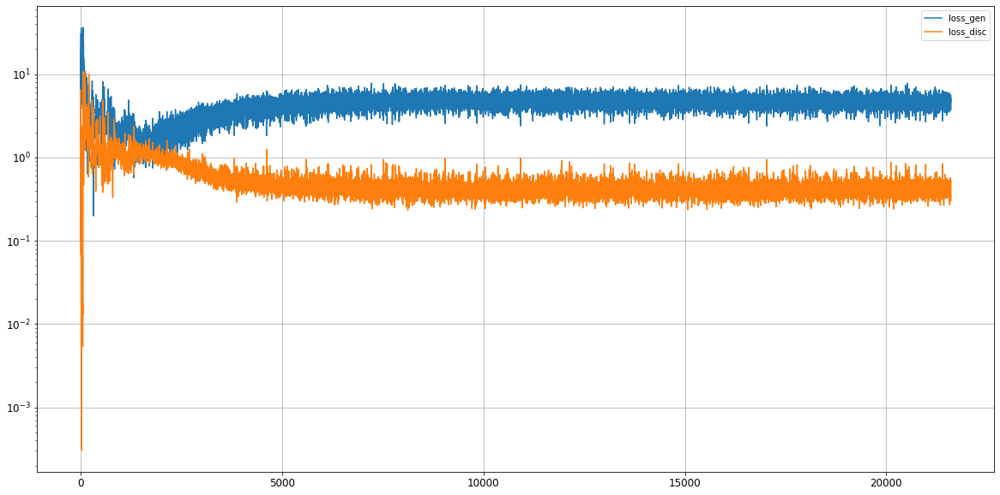

Epoch 21602/50000
0s
Epoch 21603/50000
0s
Epoch 21604/50000
0s
Epoch 21605/50000
0s
Epoch 21606/50000
0s
Epoch 21607/50000
0s
Epoch 21608/50000
0s
Epoch 21609/50000
0s
Epoch 21610/50000
0s
Epoch 21611/50000
0s
Epoch 21612/50000
0s
Epoch 21613/50000
0s
Epoch 21614/50000
0s
Epoch 21615/50000
0s
Epoch 21616/50000
0s
Epoch 21617/50000
0s
Epoch 21618/50000
0s
Epoch 21619/50000
0s
Epoch 21620/50000
0s
Epoch 21621/50000
0s
Epoch 21622/50000
0s
Epoch 21623/50000
0s
Epoch 21624/50000
0s
Epoch 21625/50000
0s
Epoch 21626/50000
0s
Epoch 21627/50000
0s
Epoch 21628/50000
0s
Epoch 21629/50000
0s
Epoch 21630/50000
0s
Epoch 21631/50000
0s
Epoch 21632/50000
0s
Epoch 21633/50000
0s
Epoch 21634/50000
0s
Epoch 21635/50000
0s
Epoch 21636/50000
0s
Epoch 21637/50000
0s
Epoch 21638/50000
0s
Epoch 21639/50000
0s
Epoch 21640/50000
0s
Epoch 21641/50000
0s
Epoch 21642/50000
0s
Epoch 21643/50000
0s
Epoch 21644/50000
0s
Epoch 21645/50000
0s
Epoch 21646/50000
0s
Epoch 21647/50000
0s
Epoch 21648/50000
0s
Epoch 21649/5

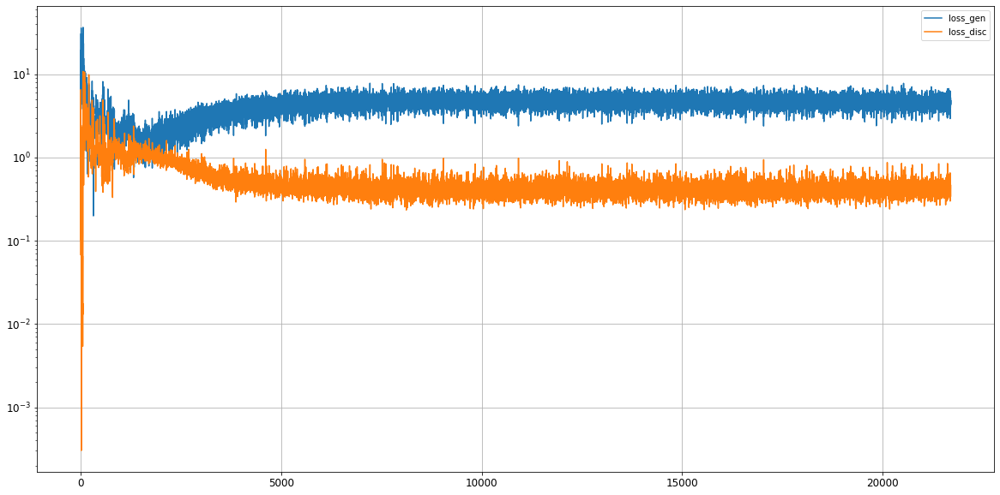

Epoch 21702/50000
0s
Epoch 21703/50000
0s
Epoch 21704/50000
0s
Epoch 21705/50000
0s
Epoch 21706/50000
0s
Epoch 21707/50000
0s
Epoch 21708/50000
0s
Epoch 21709/50000
0s
Epoch 21710/50000
0s
Epoch 21711/50000
0s
Epoch 21712/50000
0s
Epoch 21713/50000
0s
Epoch 21714/50000
0s
Epoch 21715/50000
0s
Epoch 21716/50000
0s
Epoch 21717/50000
0s
Epoch 21718/50000
0s
Epoch 21719/50000
0s
Epoch 21720/50000
0s
Epoch 21721/50000
0s
Epoch 21722/50000
0s
Epoch 21723/50000
0s
Epoch 21724/50000
0s
Epoch 21725/50000
0s
Epoch 21726/50000
0s
Epoch 21727/50000
0s
Epoch 21728/50000
0s
Epoch 21729/50000
0s
Epoch 21730/50000
0s
Epoch 21731/50000
0s
Epoch 21732/50000
0s
Epoch 21733/50000
0s
Epoch 21734/50000
0s
Epoch 21735/50000
0s
Epoch 21736/50000
0s
Epoch 21737/50000
0s
Epoch 21738/50000
0s
Epoch 21739/50000
0s
Epoch 21740/50000
0s
Epoch 21741/50000
0s
Epoch 21742/50000
0s
Epoch 21743/50000
0s
Epoch 21744/50000
0s
Epoch 21745/50000
0s
Epoch 21746/50000
0s
Epoch 21747/50000
0s
Epoch 21748/50000
0s
Epoch 21749/5

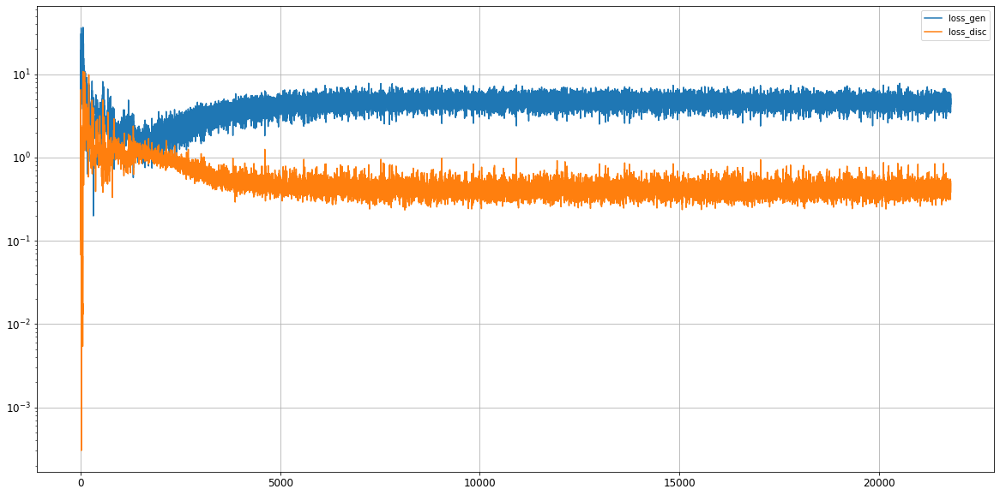

Epoch 21802/50000
0s
Epoch 21803/50000
0s
Epoch 21804/50000
0s
Epoch 21805/50000
0s
Epoch 21806/50000
0s
Epoch 21807/50000
0s
Epoch 21808/50000
0s
Epoch 21809/50000
0s
Epoch 21810/50000
0s
Epoch 21811/50000
0s
Epoch 21812/50000
0s
Epoch 21813/50000
0s
Epoch 21814/50000
0s
Epoch 21815/50000
0s
Epoch 21816/50000
0s
Epoch 21817/50000
0s
Epoch 21818/50000
0s
Epoch 21819/50000
0s
Epoch 21820/50000
0s
Epoch 21821/50000
0s
Epoch 21822/50000
0s
Epoch 21823/50000
0s
Epoch 21824/50000
0s
Epoch 21825/50000
0s
Epoch 21826/50000
0s
Epoch 21827/50000
0s
Epoch 21828/50000
0s
Epoch 21829/50000
0s
Epoch 21830/50000
0s
Epoch 21831/50000
0s
Epoch 21832/50000
0s
Epoch 21833/50000
0s
Epoch 21834/50000
0s
Epoch 21835/50000
0s
Epoch 21836/50000
0s
Epoch 21837/50000
0s
Epoch 21838/50000
0s
Epoch 21839/50000
0s
Epoch 21840/50000
0s
Epoch 21841/50000
0s
Epoch 21842/50000
0s
Epoch 21843/50000
0s
Epoch 21844/50000
0s
Epoch 21845/50000
0s
Epoch 21846/50000
0s
Epoch 21847/50000
0s
Epoch 21848/50000
0s
Epoch 21849/5

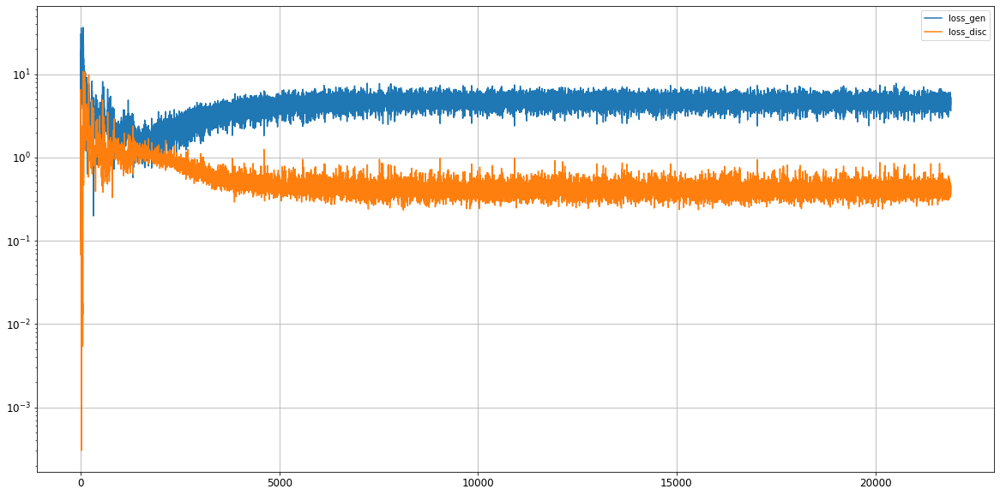

Epoch 21902/50000
0s
Epoch 21903/50000
0s
Epoch 21904/50000
0s
Epoch 21905/50000
0s
Epoch 21906/50000
0s
Epoch 21907/50000
0s
Epoch 21908/50000
0s
Epoch 21909/50000
0s
Epoch 21910/50000
0s
Epoch 21911/50000
0s
Epoch 21912/50000
0s
Epoch 21913/50000
0s
Epoch 21914/50000
0s
Epoch 21915/50000
0s
Epoch 21916/50000
0s
Epoch 21917/50000
0s
Epoch 21918/50000
0s
Epoch 21919/50000
0s
Epoch 21920/50000
0s
Epoch 21921/50000
0s
Epoch 21922/50000
0s
Epoch 21923/50000
0s
Epoch 21924/50000
0s
Epoch 21925/50000
0s
Epoch 21926/50000
0s
Epoch 21927/50000
0s
Epoch 21928/50000
0s
Epoch 21929/50000
0s
Epoch 21930/50000
0s
Epoch 21931/50000
0s
Epoch 21932/50000
0s
Epoch 21933/50000
0s
Epoch 21934/50000
0s
Epoch 21935/50000
0s
Epoch 21936/50000
0s
Epoch 21937/50000
0s
Epoch 21938/50000
0s
Epoch 21939/50000
0s
Epoch 21940/50000
0s
Epoch 21941/50000
0s
Epoch 21942/50000
0s
Epoch 21943/50000
0s
Epoch 21944/50000
0s
Epoch 21945/50000
0s
Epoch 21946/50000
0s
Epoch 21947/50000
0s
Epoch 21948/50000
0s
Epoch 21949/5

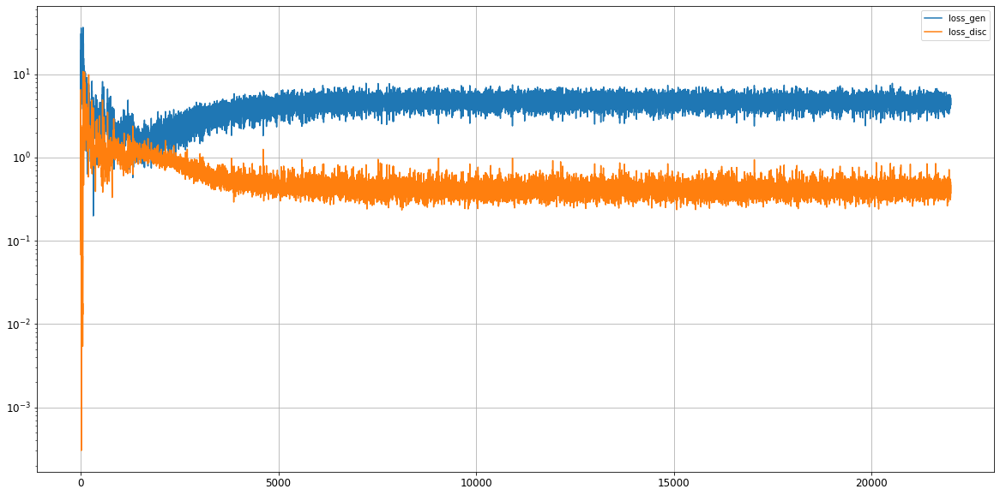

Epoch 22002/50000
0s
Epoch 22003/50000
0s
Epoch 22004/50000
0s
Epoch 22005/50000
0s
Epoch 22006/50000
0s
Epoch 22007/50000
0s
Epoch 22008/50000
0s
Epoch 22009/50000
0s
Epoch 22010/50000
0s
Epoch 22011/50000
0s
Epoch 22012/50000
0s
Epoch 22013/50000
0s
Epoch 22014/50000
0s
Epoch 22015/50000
0s
Epoch 22016/50000
0s
Epoch 22017/50000
0s
Epoch 22018/50000
0s
Epoch 22019/50000
0s
Epoch 22020/50000
0s
Epoch 22021/50000
0s
Epoch 22022/50000
0s
Epoch 22023/50000
0s
Epoch 22024/50000
0s
Epoch 22025/50000
0s
Epoch 22026/50000
0s
Epoch 22027/50000
0s
Epoch 22028/50000
0s
Epoch 22029/50000
0s
Epoch 22030/50000
0s
Epoch 22031/50000
0s
Epoch 22032/50000
0s
Epoch 22033/50000
0s
Epoch 22034/50000
0s
Epoch 22035/50000
0s
Epoch 22036/50000
0s
Epoch 22037/50000
0s
Epoch 22038/50000
0s
Epoch 22039/50000
0s
Epoch 22040/50000
0s
Epoch 22041/50000
0s
Epoch 22042/50000
0s
Epoch 22043/50000
0s
Epoch 22044/50000
0s
Epoch 22045/50000
0s
Epoch 22046/50000
0s
Epoch 22047/50000
0s
Epoch 22048/50000
0s
Epoch 22049/5

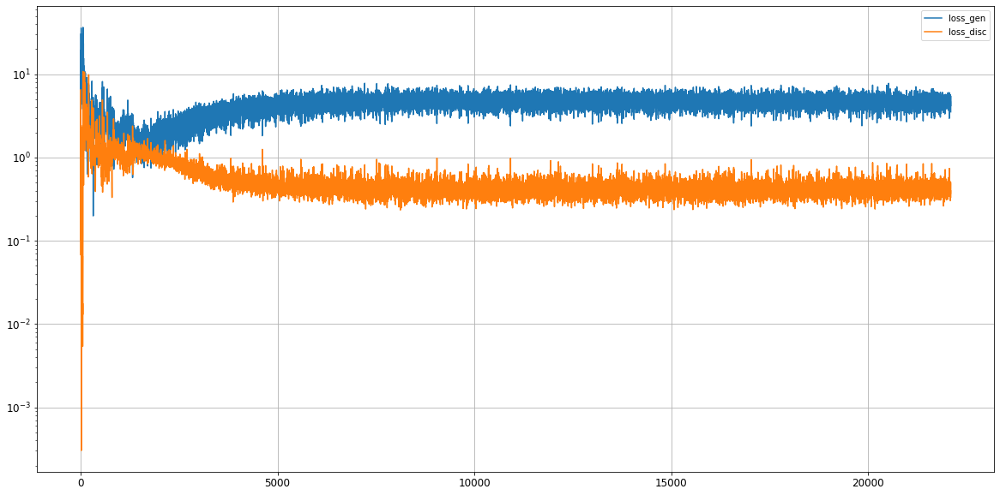

Epoch 22102/50000
0s
Epoch 22103/50000
0s
Epoch 22104/50000
0s
Epoch 22105/50000
0s
Epoch 22106/50000
0s
Epoch 22107/50000
0s
Epoch 22108/50000
0s
Epoch 22109/50000
0s
Epoch 22110/50000
0s
Epoch 22111/50000
0s
Epoch 22112/50000
0s
Epoch 22113/50000
0s
Epoch 22114/50000
0s
Epoch 22115/50000
0s
Epoch 22116/50000
0s
Epoch 22117/50000
0s
Epoch 22118/50000
0s
Epoch 22119/50000
0s
Epoch 22120/50000
0s
Epoch 22121/50000
0s
Epoch 22122/50000
0s
Epoch 22123/50000
0s
Epoch 22124/50000
0s
Epoch 22125/50000
0s
Epoch 22126/50000
0s
Epoch 22127/50000
0s
Epoch 22128/50000
0s
Epoch 22129/50000
0s
Epoch 22130/50000
0s
Epoch 22131/50000
0s
Epoch 22132/50000
0s
Epoch 22133/50000
0s
Epoch 22134/50000
0s
Epoch 22135/50000
0s
Epoch 22136/50000
0s
Epoch 22137/50000
0s
Epoch 22138/50000
0s
Epoch 22139/50000
0s
Epoch 22140/50000
0s
Epoch 22141/50000
0s
Epoch 22142/50000
0s
Epoch 22143/50000
0s
Epoch 22144/50000
0s
Epoch 22145/50000
0s
Epoch 22146/50000
0s
Epoch 22147/50000
0s
Epoch 22148/50000
0s
Epoch 22149/5

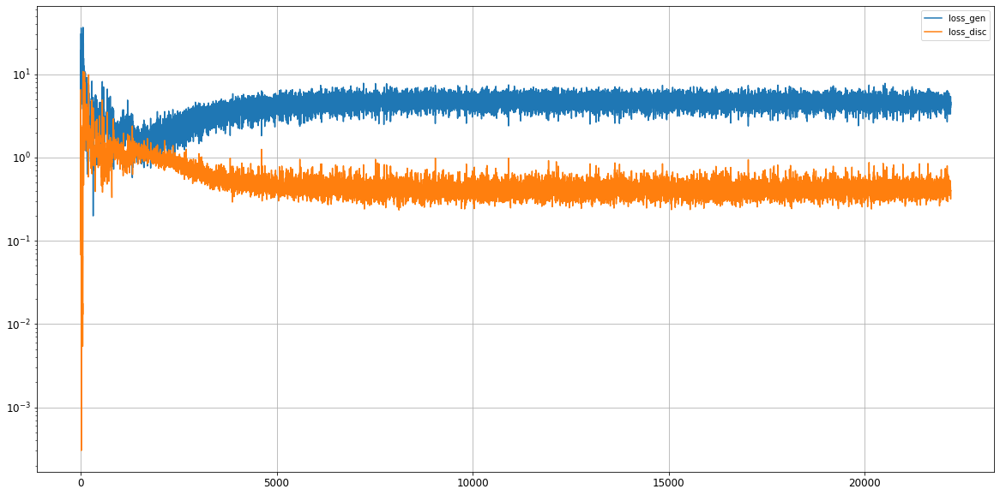

Epoch 22202/50000
0s
Epoch 22203/50000
0s
Epoch 22204/50000
0s
Epoch 22205/50000
0s
Epoch 22206/50000
0s
Epoch 22207/50000
0s
Epoch 22208/50000
0s
Epoch 22209/50000
0s
Epoch 22210/50000
0s
Epoch 22211/50000
0s
Epoch 22212/50000
0s
Epoch 22213/50000
0s
Epoch 22214/50000
0s
Epoch 22215/50000
0s
Epoch 22216/50000
0s
Epoch 22217/50000
0s
Epoch 22218/50000
0s
Epoch 22219/50000
0s
Epoch 22220/50000
0s
Epoch 22221/50000
0s
Epoch 22222/50000
0s
Epoch 22223/50000
0s
Epoch 22224/50000
0s
Epoch 22225/50000
0s
Epoch 22226/50000
0s
Epoch 22227/50000
0s
Epoch 22228/50000
0s
Epoch 22229/50000
0s
Epoch 22230/50000
0s
Epoch 22231/50000
0s
Epoch 22232/50000
0s
Epoch 22233/50000
0s
Epoch 22234/50000
0s
Epoch 22235/50000
0s
Epoch 22236/50000
0s
Epoch 22237/50000
0s
Epoch 22238/50000
0s
Epoch 22239/50000
0s
Epoch 22240/50000
0s
Epoch 22241/50000
0s
Epoch 22242/50000
0s
Epoch 22243/50000
0s
Epoch 22244/50000
0s
Epoch 22245/50000
0s
Epoch 22246/50000
0s
Epoch 22247/50000
0s
Epoch 22248/50000
0s
Epoch 22249/5

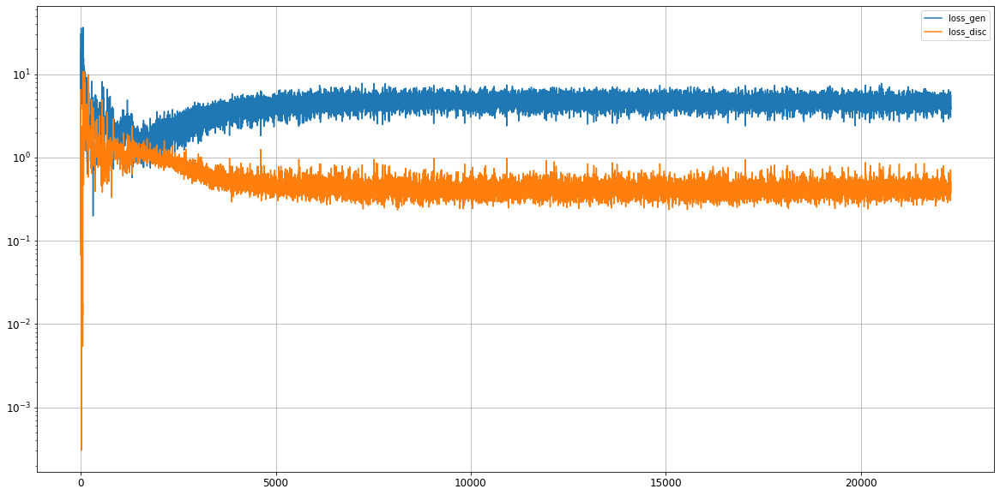

Epoch 22302/50000
0s
Epoch 22303/50000
0s
Epoch 22304/50000
0s
Epoch 22305/50000
0s
Epoch 22306/50000
0s
Epoch 22307/50000
0s
Epoch 22308/50000
0s
Epoch 22309/50000
0s
Epoch 22310/50000
0s
Epoch 22311/50000
0s
Epoch 22312/50000
0s
Epoch 22313/50000
0s
Epoch 22314/50000
0s
Epoch 22315/50000
0s
Epoch 22316/50000
0s
Epoch 22317/50000
0s
Epoch 22318/50000
0s
Epoch 22319/50000
0s
Epoch 22320/50000
0s
Epoch 22321/50000
0s
Epoch 22322/50000
0s
Epoch 22323/50000
0s
Epoch 22324/50000
0s
Epoch 22325/50000
0s
Epoch 22326/50000
0s
Epoch 22327/50000
0s
Epoch 22328/50000
0s
Epoch 22329/50000
0s
Epoch 22330/50000
0s
Epoch 22331/50000
0s
Epoch 22332/50000
0s
Epoch 22333/50000
0s
Epoch 22334/50000
0s
Epoch 22335/50000
0s
Epoch 22336/50000
0s
Epoch 22337/50000
0s
Epoch 22338/50000
0s
Epoch 22339/50000
0s
Epoch 22340/50000
0s
Epoch 22341/50000
0s
Epoch 22342/50000
0s
Epoch 22343/50000
0s
Epoch 22344/50000
0s
Epoch 22345/50000
0s
Epoch 22346/50000
0s
Epoch 22347/50000
0s
Epoch 22348/50000
0s
Epoch 22349/5

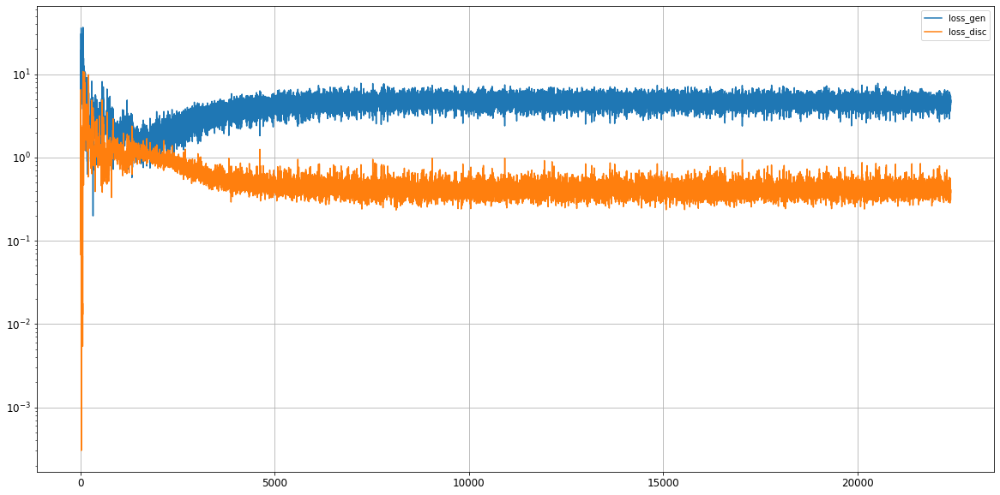

Epoch 22402/50000
0s
Epoch 22403/50000
0s
Epoch 22404/50000
0s
Epoch 22405/50000
0s
Epoch 22406/50000
0s
Epoch 22407/50000
0s
Epoch 22408/50000
0s
Epoch 22409/50000
0s
Epoch 22410/50000
0s
Epoch 22411/50000
0s
Epoch 22412/50000
0s
Epoch 22413/50000
0s
Epoch 22414/50000
0s
Epoch 22415/50000
0s
Epoch 22416/50000
0s
Epoch 22417/50000
0s
Epoch 22418/50000
0s
Epoch 22419/50000
0s
Epoch 22420/50000
0s
Epoch 22421/50000
0s
Epoch 22422/50000
0s
Epoch 22423/50000
0s
Epoch 22424/50000
0s
Epoch 22425/50000
0s
Epoch 22426/50000
0s
Epoch 22427/50000
0s
Epoch 22428/50000
0s
Epoch 22429/50000
0s
Epoch 22430/50000
0s
Epoch 22431/50000
0s
Epoch 22432/50000
0s
Epoch 22433/50000
0s
Epoch 22434/50000
0s
Epoch 22435/50000
0s
Epoch 22436/50000
0s
Epoch 22437/50000
0s
Epoch 22438/50000
0s
Epoch 22439/50000
0s
Epoch 22440/50000
0s
Epoch 22441/50000
0s
Epoch 22442/50000
0s
Epoch 22443/50000
0s
Epoch 22444/50000
0s
Epoch 22445/50000
0s
Epoch 22446/50000
0s
Epoch 22447/50000
0s
Epoch 22448/50000
0s
Epoch 22449/5

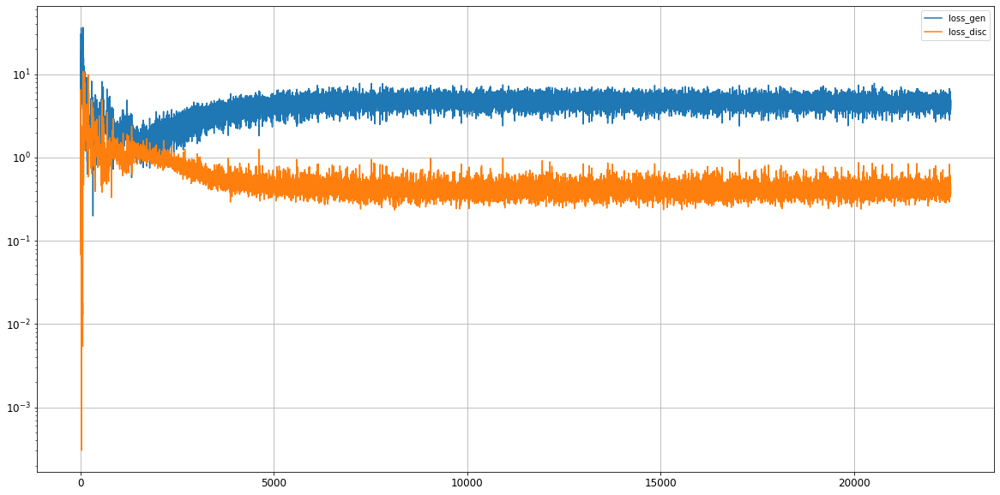

Epoch 22502/50000
0s
Epoch 22503/50000
0s
Epoch 22504/50000
0s
Epoch 22505/50000
0s
Epoch 22506/50000
0s
Epoch 22507/50000
0s
Epoch 22508/50000
0s
Epoch 22509/50000
0s
Epoch 22510/50000
0s
Epoch 22511/50000
0s
Epoch 22512/50000
0s
Epoch 22513/50000
0s
Epoch 22514/50000
0s
Epoch 22515/50000
0s
Epoch 22516/50000
0s
Epoch 22517/50000
0s
Epoch 22518/50000
0s
Epoch 22519/50000
0s
Epoch 22520/50000
0s
Epoch 22521/50000
0s
Epoch 22522/50000
0s
Epoch 22523/50000
0s
Epoch 22524/50000
0s
Epoch 22525/50000
0s
Epoch 22526/50000
0s
Epoch 22527/50000
0s
Epoch 22528/50000
0s
Epoch 22529/50000
0s
Epoch 22530/50000
0s
Epoch 22531/50000
0s
Epoch 22532/50000
0s
Epoch 22533/50000
0s
Epoch 22534/50000
0s
Epoch 22535/50000
0s
Epoch 22536/50000
0s
Epoch 22537/50000
0s
Epoch 22538/50000
0s
Epoch 22539/50000
0s
Epoch 22540/50000
0s
Epoch 22541/50000
0s
Epoch 22542/50000
0s
Epoch 22543/50000
0s
Epoch 22544/50000
0s
Epoch 22545/50000
0s
Epoch 22546/50000
0s
Epoch 22547/50000
0s
Epoch 22548/50000
0s
Epoch 22549/5

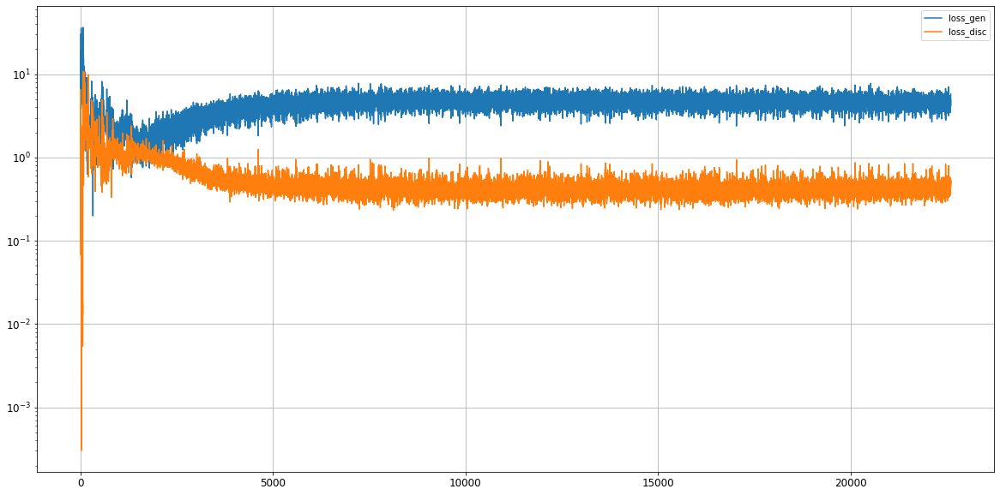

Epoch 22602/50000
0s
Epoch 22603/50000
0s
Epoch 22604/50000
0s
Epoch 22605/50000
0s
Epoch 22606/50000
0s
Epoch 22607/50000
0s
Epoch 22608/50000
0s
Epoch 22609/50000
0s
Epoch 22610/50000
0s
Epoch 22611/50000
0s
Epoch 22612/50000
0s
Epoch 22613/50000
0s
Epoch 22614/50000
0s
Epoch 22615/50000
0s
Epoch 22616/50000
0s
Epoch 22617/50000
0s
Epoch 22618/50000
0s
Epoch 22619/50000
0s
Epoch 22620/50000
0s
Epoch 22621/50000
0s
Epoch 22622/50000
0s
Epoch 22623/50000
0s
Epoch 22624/50000
0s
Epoch 22625/50000
0s
Epoch 22626/50000
0s
Epoch 22627/50000
0s
Epoch 22628/50000
0s
Epoch 22629/50000
0s
Epoch 22630/50000
0s
Epoch 22631/50000
0s
Epoch 22632/50000
0s
Epoch 22633/50000
0s
Epoch 22634/50000
0s
Epoch 22635/50000
0s
Epoch 22636/50000
0s
Epoch 22637/50000
0s
Epoch 22638/50000
0s
Epoch 22639/50000
0s
Epoch 22640/50000
0s
Epoch 22641/50000
0s
Epoch 22642/50000
0s
Epoch 22643/50000
0s
Epoch 22644/50000
0s
Epoch 22645/50000
0s
Epoch 22646/50000
0s
Epoch 22647/50000
0s
Epoch 22648/50000
0s
Epoch 22649/5

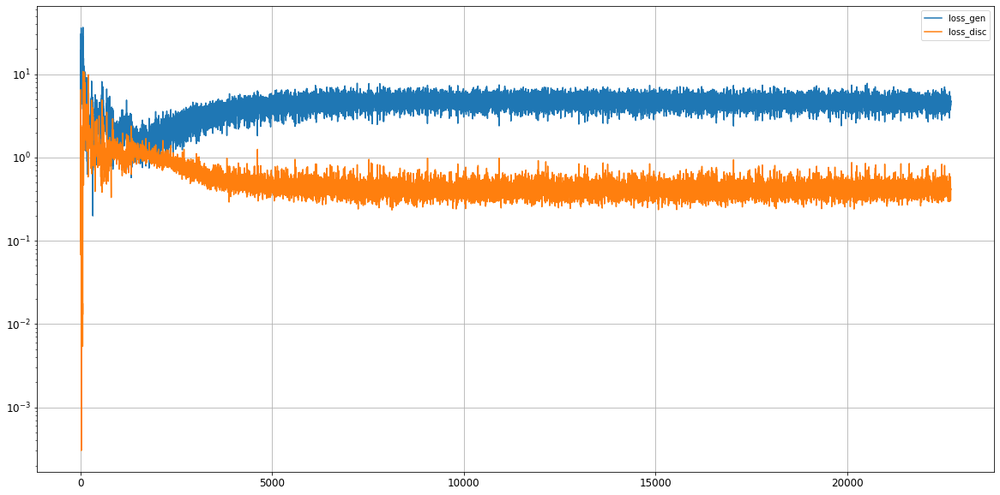

Epoch 22702/50000
0s
Epoch 22703/50000
0s
Epoch 22704/50000
0s
Epoch 22705/50000
0s
Epoch 22706/50000
0s
Epoch 22707/50000
0s
Epoch 22708/50000
0s
Epoch 22709/50000
0s
Epoch 22710/50000
0s
Epoch 22711/50000
0s
Epoch 22712/50000
0s
Epoch 22713/50000
0s
Epoch 22714/50000
0s
Epoch 22715/50000
0s
Epoch 22716/50000
0s
Epoch 22717/50000
0s
Epoch 22718/50000
0s
Epoch 22719/50000
0s
Epoch 22720/50000
0s
Epoch 22721/50000
0s
Epoch 22722/50000
0s
Epoch 22723/50000
0s
Epoch 22724/50000
0s
Epoch 22725/50000
0s
Epoch 22726/50000
0s
Epoch 22727/50000
0s
Epoch 22728/50000
0s
Epoch 22729/50000
0s
Epoch 22730/50000
0s
Epoch 22731/50000
0s
Epoch 22732/50000
0s
Epoch 22733/50000
0s
Epoch 22734/50000
0s
Epoch 22735/50000
0s
Epoch 22736/50000
0s
Epoch 22737/50000
0s
Epoch 22738/50000
0s
Epoch 22739/50000
0s
Epoch 22740/50000
0s
Epoch 22741/50000
0s
Epoch 22742/50000
0s
Epoch 22743/50000
0s
Epoch 22744/50000
0s
Epoch 22745/50000
0s
Epoch 22746/50000
0s
Epoch 22747/50000
0s
Epoch 22748/50000
0s
Epoch 22749/5

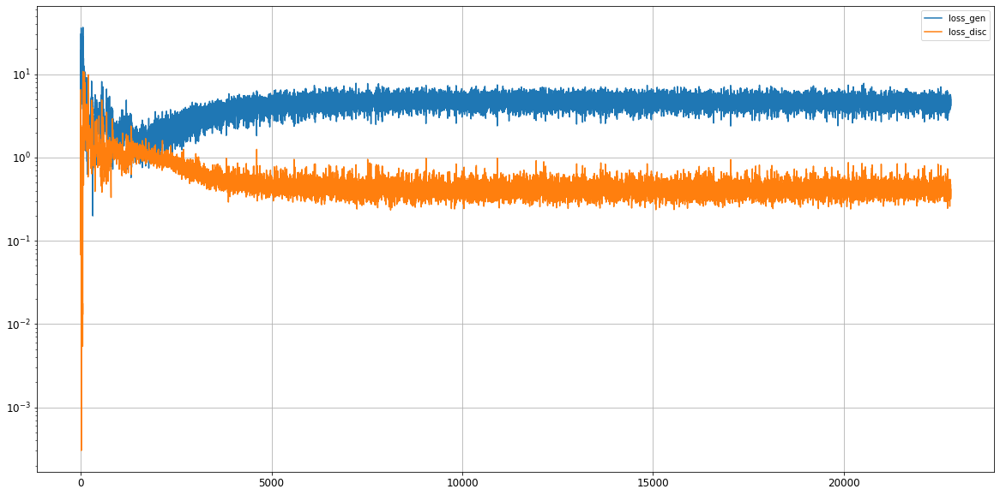

Epoch 22802/50000
0s
Epoch 22803/50000
0s
Epoch 22804/50000
0s
Epoch 22805/50000
0s
Epoch 22806/50000
0s
Epoch 22807/50000
0s
Epoch 22808/50000
0s
Epoch 22809/50000
0s
Epoch 22810/50000
0s
Epoch 22811/50000
0s
Epoch 22812/50000
0s
Epoch 22813/50000
0s
Epoch 22814/50000
0s
Epoch 22815/50000
0s
Epoch 22816/50000
0s
Epoch 22817/50000
0s
Epoch 22818/50000
0s
Epoch 22819/50000
0s
Epoch 22820/50000
0s
Epoch 22821/50000
0s
Epoch 22822/50000
0s
Epoch 22823/50000
0s
Epoch 22824/50000
0s
Epoch 22825/50000
0s
Epoch 22826/50000
0s
Epoch 22827/50000
0s
Epoch 22828/50000
0s
Epoch 22829/50000
0s
Epoch 22830/50000
0s
Epoch 22831/50000
0s
Epoch 22832/50000
0s
Epoch 22833/50000
0s
Epoch 22834/50000
0s
Epoch 22835/50000
0s
Epoch 22836/50000
0s
Epoch 22837/50000
0s
Epoch 22838/50000
0s
Epoch 22839/50000
0s
Epoch 22840/50000
0s
Epoch 22841/50000
0s
Epoch 22842/50000
0s
Epoch 22843/50000
0s
Epoch 22844/50000
0s
Epoch 22845/50000
0s
Epoch 22846/50000
0s
Epoch 22847/50000
0s
Epoch 22848/50000
0s
Epoch 22849/5

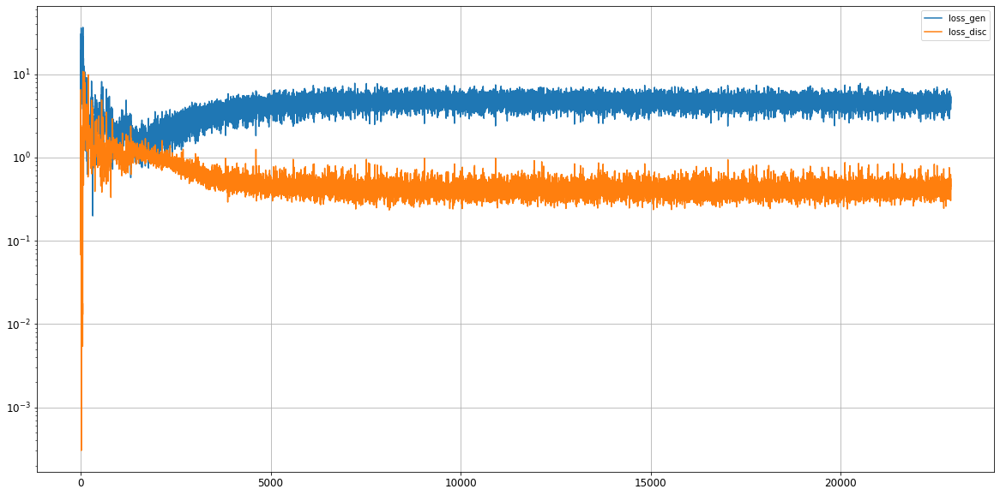

Epoch 22902/50000
0s
Epoch 22903/50000
0s
Epoch 22904/50000
0s
Epoch 22905/50000
0s
Epoch 22906/50000
0s
Epoch 22907/50000
0s
Epoch 22908/50000
0s
Epoch 22909/50000
0s
Epoch 22910/50000
0s
Epoch 22911/50000
0s
Epoch 22912/50000
0s
Epoch 22913/50000
0s
Epoch 22914/50000
0s
Epoch 22915/50000
0s
Epoch 22916/50000
0s
Epoch 22917/50000
0s
Epoch 22918/50000
0s
Epoch 22919/50000
0s
Epoch 22920/50000
0s
Epoch 22921/50000
0s
Epoch 22922/50000
0s
Epoch 22923/50000
0s
Epoch 22924/50000
0s
Epoch 22925/50000
0s
Epoch 22926/50000
0s
Epoch 22927/50000
0s
Epoch 22928/50000
0s
Epoch 22929/50000
0s
Epoch 22930/50000
0s
Epoch 22931/50000
0s
Epoch 22932/50000
0s
Epoch 22933/50000
0s
Epoch 22934/50000
0s
Epoch 22935/50000
0s
Epoch 22936/50000
0s
Epoch 22937/50000
0s
Epoch 22938/50000
0s
Epoch 22939/50000
0s
Epoch 22940/50000
0s
Epoch 22941/50000
0s
Epoch 22942/50000
0s
Epoch 22943/50000
0s
Epoch 22944/50000
0s
Epoch 22945/50000
0s
Epoch 22946/50000
0s
Epoch 22947/50000
0s
Epoch 22948/50000
0s
Epoch 22949/5

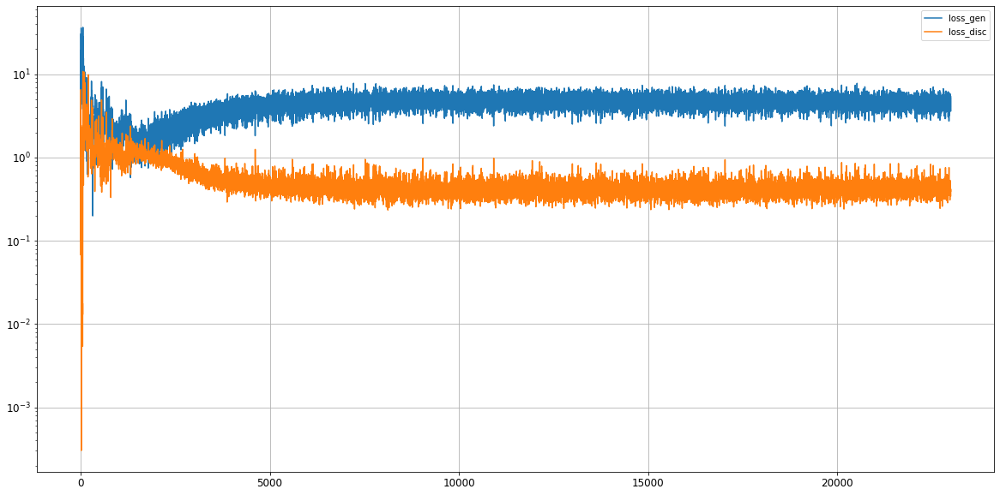

Epoch 23002/50000
0s
Epoch 23003/50000
0s
Epoch 23004/50000
0s
Epoch 23005/50000
0s
Epoch 23006/50000
0s
Epoch 23007/50000
0s
Epoch 23008/50000
0s
Epoch 23009/50000
0s
Epoch 23010/50000
0s
Epoch 23011/50000
0s
Epoch 23012/50000
0s
Epoch 23013/50000
0s
Epoch 23014/50000
0s
Epoch 23015/50000
0s
Epoch 23016/50000
0s
Epoch 23017/50000
0s
Epoch 23018/50000
0s
Epoch 23019/50000
0s
Epoch 23020/50000
0s
Epoch 23021/50000
0s
Epoch 23022/50000
0s
Epoch 23023/50000
0s
Epoch 23024/50000
0s
Epoch 23025/50000
0s
Epoch 23026/50000
0s
Epoch 23027/50000
0s
Epoch 23028/50000
0s
Epoch 23029/50000
0s
Epoch 23030/50000
0s
Epoch 23031/50000
0s
Epoch 23032/50000
0s
Epoch 23033/50000
0s
Epoch 23034/50000
0s
Epoch 23035/50000
0s
Epoch 23036/50000
0s
Epoch 23037/50000
0s
Epoch 23038/50000
0s
Epoch 23039/50000
0s
Epoch 23040/50000
0s
Epoch 23041/50000
0s
Epoch 23042/50000
0s
Epoch 23043/50000
0s
Epoch 23044/50000
0s
Epoch 23045/50000
0s
Epoch 23046/50000
0s
Epoch 23047/50000
0s
Epoch 23048/50000
0s
Epoch 23049/5

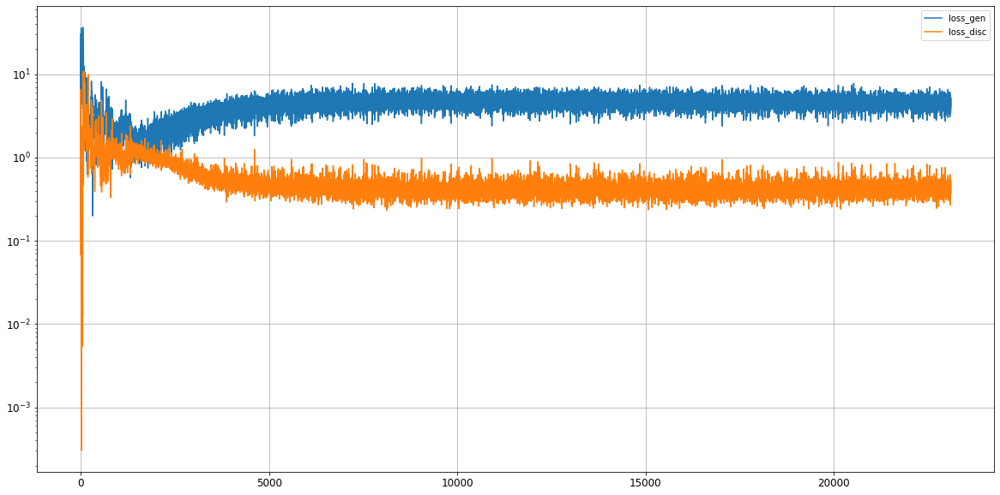

Epoch 23102/50000
0s
Epoch 23103/50000
0s
Epoch 23104/50000
0s
Epoch 23105/50000
0s
Epoch 23106/50000
0s
Epoch 23107/50000
0s
Epoch 23108/50000
0s
Epoch 23109/50000
0s
Epoch 23110/50000
0s
Epoch 23111/50000
0s
Epoch 23112/50000
0s
Epoch 23113/50000
0s
Epoch 23114/50000
0s
Epoch 23115/50000
0s
Epoch 23116/50000
0s
Epoch 23117/50000
0s
Epoch 23118/50000
0s
Epoch 23119/50000
0s
Epoch 23120/50000
0s
Epoch 23121/50000
0s
Epoch 23122/50000
0s
Epoch 23123/50000
0s
Epoch 23124/50000
0s
Epoch 23125/50000
0s
Epoch 23126/50000
0s
Epoch 23127/50000
0s
Epoch 23128/50000
0s
Epoch 23129/50000
0s
Epoch 23130/50000
0s
Epoch 23131/50000
0s
Epoch 23132/50000
0s
Epoch 23133/50000
0s
Epoch 23134/50000
0s
Epoch 23135/50000
0s
Epoch 23136/50000
0s
Epoch 23137/50000
0s
Epoch 23138/50000
0s
Epoch 23139/50000
0s
Epoch 23140/50000
0s
Epoch 23141/50000
0s
Epoch 23142/50000
0s
Epoch 23143/50000
0s
Epoch 23144/50000
0s
Epoch 23145/50000
0s
Epoch 23146/50000
0s
Epoch 23147/50000
0s
Epoch 23148/50000
0s
Epoch 23149/5

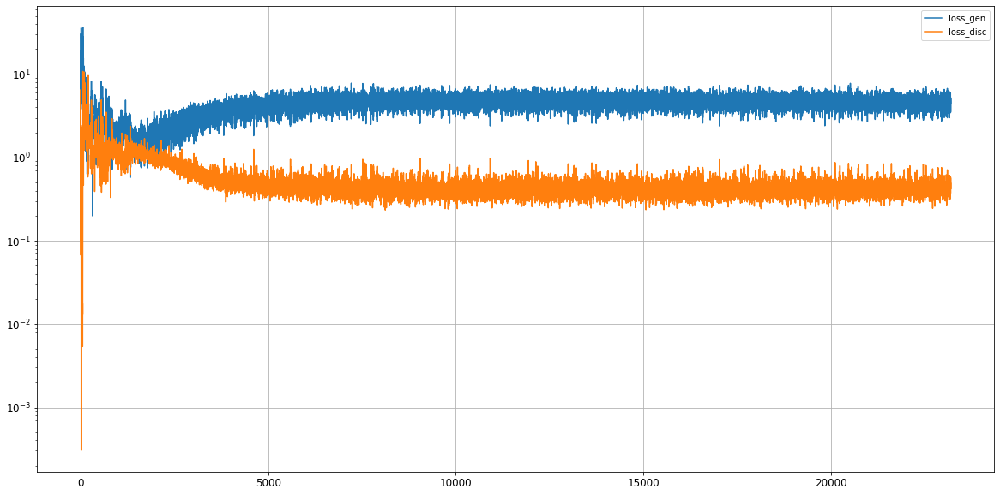

Epoch 23202/50000
0s
Epoch 23203/50000
0s
Epoch 23204/50000
0s
Epoch 23205/50000
0s
Epoch 23206/50000
0s
Epoch 23207/50000
0s
Epoch 23208/50000
0s
Epoch 23209/50000
0s
Epoch 23210/50000
0s
Epoch 23211/50000
0s
Epoch 23212/50000
0s
Epoch 23213/50000
0s
Epoch 23214/50000
0s
Epoch 23215/50000
0s
Epoch 23216/50000
0s
Epoch 23217/50000
0s
Epoch 23218/50000
0s
Epoch 23219/50000
0s
Epoch 23220/50000
0s
Epoch 23221/50000
0s
Epoch 23222/50000
0s
Epoch 23223/50000
0s
Epoch 23224/50000
0s
Epoch 23225/50000
0s
Epoch 23226/50000
0s
Epoch 23227/50000
0s
Epoch 23228/50000
0s
Epoch 23229/50000
0s
Epoch 23230/50000
0s
Epoch 23231/50000
0s
Epoch 23232/50000
0s
Epoch 23233/50000
0s
Epoch 23234/50000
0s
Epoch 23235/50000
0s
Epoch 23236/50000
0s
Epoch 23237/50000
0s
Epoch 23238/50000
0s
Epoch 23239/50000
0s
Epoch 23240/50000
0s
Epoch 23241/50000
0s
Epoch 23242/50000
0s
Epoch 23243/50000
0s
Epoch 23244/50000
0s
Epoch 23245/50000
0s
Epoch 23246/50000
0s
Epoch 23247/50000
0s
Epoch 23248/50000
0s
Epoch 23249/5

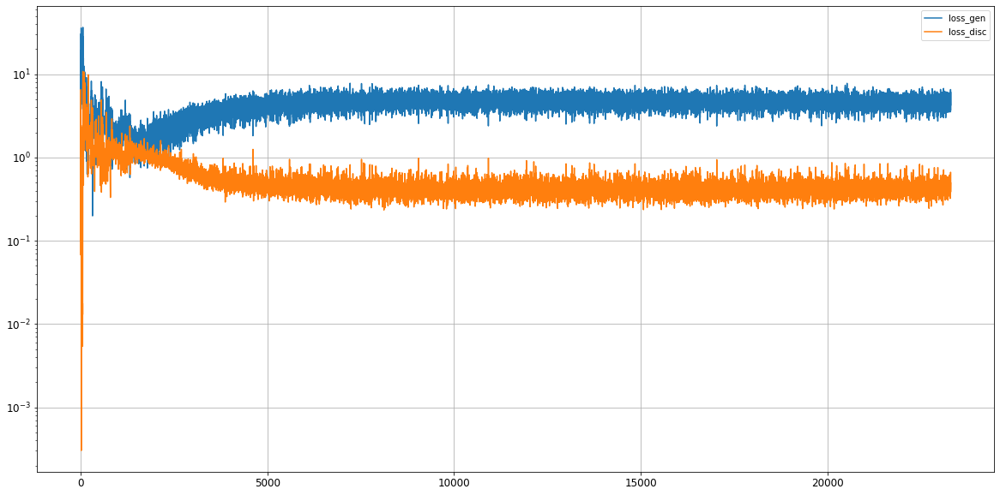

Epoch 23302/50000
0s
Epoch 23303/50000
0s
Epoch 23304/50000
0s
Epoch 23305/50000
0s
Epoch 23306/50000
0s
Epoch 23307/50000
0s
Epoch 23308/50000
0s
Epoch 23309/50000
0s
Epoch 23310/50000
0s
Epoch 23311/50000
0s
Epoch 23312/50000
0s
Epoch 23313/50000
0s
Epoch 23314/50000
0s
Epoch 23315/50000
0s
Epoch 23316/50000
0s
Epoch 23317/50000
0s
Epoch 23318/50000
0s
Epoch 23319/50000
0s
Epoch 23320/50000
0s
Epoch 23321/50000
0s
Epoch 23322/50000
0s
Epoch 23323/50000
0s
Epoch 23324/50000
0s
Epoch 23325/50000
0s
Epoch 23326/50000
0s
Epoch 23327/50000
0s
Epoch 23328/50000
0s
Epoch 23329/50000
0s
Epoch 23330/50000
0s
Epoch 23331/50000
0s
Epoch 23332/50000
0s
Epoch 23333/50000
0s
Epoch 23334/50000
0s
Epoch 23335/50000
0s
Epoch 23336/50000
0s
Epoch 23337/50000
0s
Epoch 23338/50000
0s
Epoch 23339/50000
0s
Epoch 23340/50000
0s
Epoch 23341/50000
0s
Epoch 23342/50000
0s
Epoch 23343/50000
0s
Epoch 23344/50000
0s
Epoch 23345/50000
0s
Epoch 23346/50000
0s
Epoch 23347/50000
0s
Epoch 23348/50000
0s
Epoch 23349/5

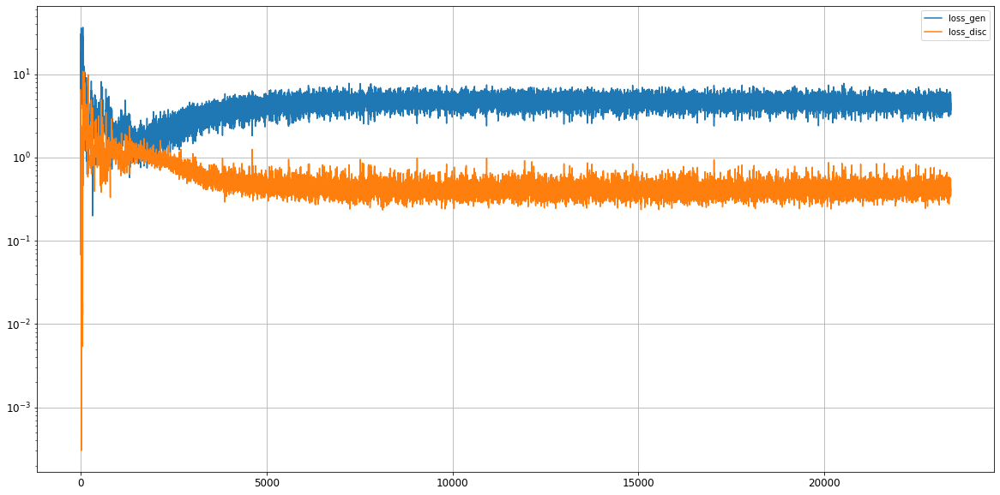

Epoch 23402/50000
0s
Epoch 23403/50000
0s
Epoch 23404/50000
0s
Epoch 23405/50000
0s
Epoch 23406/50000
0s
Epoch 23407/50000
0s
Epoch 23408/50000
0s
Epoch 23409/50000
0s
Epoch 23410/50000
0s
Epoch 23411/50000
0s
Epoch 23412/50000
0s
Epoch 23413/50000
0s
Epoch 23414/50000
0s
Epoch 23415/50000
0s
Epoch 23416/50000
0s
Epoch 23417/50000
0s
Epoch 23418/50000
0s
Epoch 23419/50000
0s
Epoch 23420/50000
0s
Epoch 23421/50000
0s
Epoch 23422/50000
0s
Epoch 23423/50000
0s
Epoch 23424/50000
0s
Epoch 23425/50000
0s
Epoch 23426/50000
0s
Epoch 23427/50000
0s
Epoch 23428/50000
0s
Epoch 23429/50000
0s
Epoch 23430/50000
0s
Epoch 23431/50000
0s
Epoch 23432/50000
0s
Epoch 23433/50000
0s
Epoch 23434/50000
0s
Epoch 23435/50000
0s
Epoch 23436/50000
0s
Epoch 23437/50000
0s
Epoch 23438/50000
0s
Epoch 23439/50000
0s
Epoch 23440/50000
0s
Epoch 23441/50000
0s
Epoch 23442/50000
0s
Epoch 23443/50000
0s
Epoch 23444/50000
0s
Epoch 23445/50000
0s
Epoch 23446/50000
0s
Epoch 23447/50000
0s
Epoch 23448/50000
0s
Epoch 23449/5

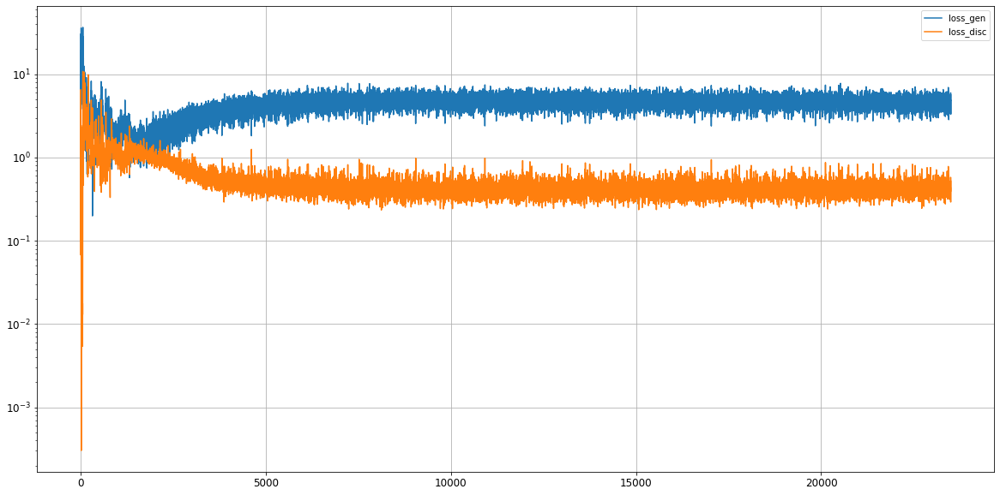

Epoch 23502/50000
0s
Epoch 23503/50000
0s
Epoch 23504/50000
0s
Epoch 23505/50000
0s
Epoch 23506/50000
0s
Epoch 23507/50000
0s
Epoch 23508/50000
0s
Epoch 23509/50000
0s
Epoch 23510/50000
0s
Epoch 23511/50000
0s
Epoch 23512/50000
0s
Epoch 23513/50000
0s
Epoch 23514/50000
0s
Epoch 23515/50000
0s
Epoch 23516/50000
0s
Epoch 23517/50000
0s
Epoch 23518/50000
0s
Epoch 23519/50000
0s
Epoch 23520/50000
0s
Epoch 23521/50000
0s
Epoch 23522/50000
0s
Epoch 23523/50000
0s
Epoch 23524/50000
0s
Epoch 23525/50000
0s
Epoch 23526/50000
0s
Epoch 23527/50000
0s
Epoch 23528/50000
0s
Epoch 23529/50000
0s
Epoch 23530/50000
0s
Epoch 23531/50000
0s
Epoch 23532/50000
0s
Epoch 23533/50000
0s
Epoch 23534/50000
0s
Epoch 23535/50000
0s
Epoch 23536/50000
0s
Epoch 23537/50000
0s
Epoch 23538/50000
0s
Epoch 23539/50000
0s
Epoch 23540/50000
0s
Epoch 23541/50000
0s
Epoch 23542/50000
0s
Epoch 23543/50000
0s
Epoch 23544/50000
0s
Epoch 23545/50000
0s
Epoch 23546/50000
0s
Epoch 23547/50000
0s
Epoch 23548/50000
0s
Epoch 23549/5

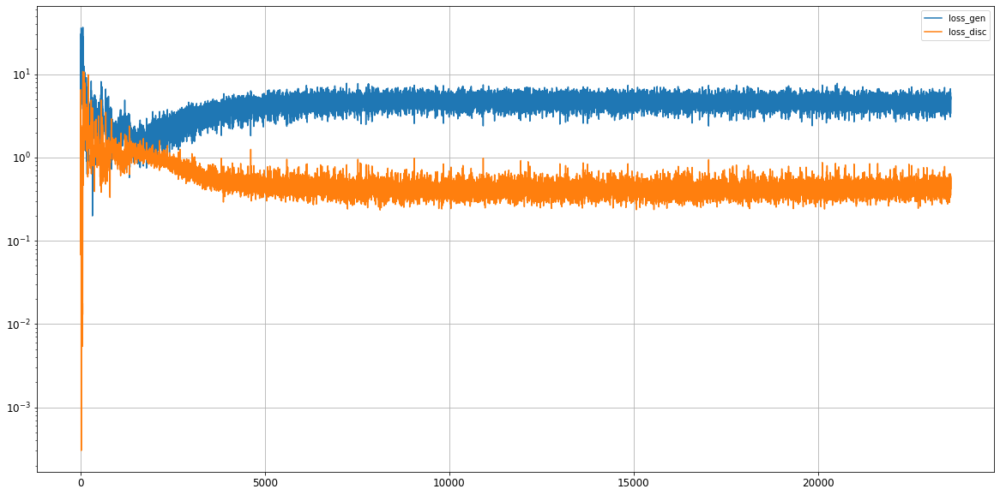

Epoch 23602/50000
0s
Epoch 23603/50000
0s
Epoch 23604/50000
0s
Epoch 23605/50000
0s
Epoch 23606/50000
0s
Epoch 23607/50000
0s
Epoch 23608/50000
0s
Epoch 23609/50000
0s
Epoch 23610/50000
0s
Epoch 23611/50000
0s
Epoch 23612/50000
0s
Epoch 23613/50000
0s
Epoch 23614/50000
0s
Epoch 23615/50000
0s
Epoch 23616/50000
0s
Epoch 23617/50000
0s
Epoch 23618/50000
0s
Epoch 23619/50000
0s
Epoch 23620/50000
0s
Epoch 23621/50000
0s
Epoch 23622/50000
0s
Epoch 23623/50000
0s
Epoch 23624/50000
0s
Epoch 23625/50000
0s
Epoch 23626/50000
0s
Epoch 23627/50000
0s
Epoch 23628/50000
0s
Epoch 23629/50000
0s
Epoch 23630/50000
0s
Epoch 23631/50000
0s
Epoch 23632/50000
0s
Epoch 23633/50000
0s
Epoch 23634/50000
0s
Epoch 23635/50000
0s
Epoch 23636/50000
0s
Epoch 23637/50000
0s
Epoch 23638/50000
0s
Epoch 23639/50000
0s
Epoch 23640/50000
0s
Epoch 23641/50000
0s
Epoch 23642/50000
0s
Epoch 23643/50000
0s
Epoch 23644/50000
0s
Epoch 23645/50000
0s
Epoch 23646/50000
0s
Epoch 23647/50000
0s
Epoch 23648/50000
0s
Epoch 23649/5

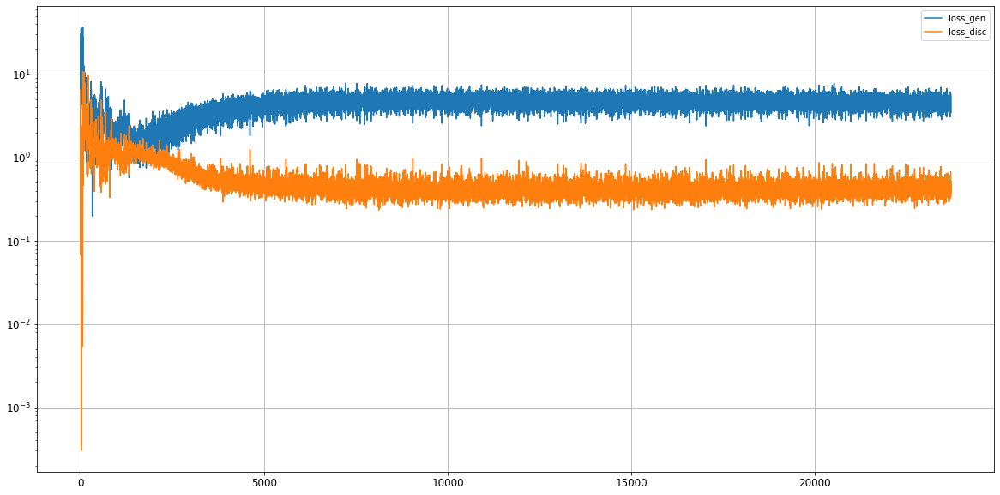

Epoch 23702/50000
0s
Epoch 23703/50000
0s
Epoch 23704/50000
0s
Epoch 23705/50000
0s
Epoch 23706/50000
0s
Epoch 23707/50000
0s
Epoch 23708/50000
0s
Epoch 23709/50000
0s
Epoch 23710/50000
0s
Epoch 23711/50000
0s
Epoch 23712/50000
0s
Epoch 23713/50000
0s
Epoch 23714/50000
0s
Epoch 23715/50000
0s
Epoch 23716/50000
0s
Epoch 23717/50000
0s
Epoch 23718/50000
0s
Epoch 23719/50000
0s
Epoch 23720/50000
0s
Epoch 23721/50000
0s
Epoch 23722/50000
0s
Epoch 23723/50000
0s
Epoch 23724/50000
0s
Epoch 23725/50000
0s
Epoch 23726/50000
0s
Epoch 23727/50000
0s
Epoch 23728/50000
0s
Epoch 23729/50000
0s
Epoch 23730/50000
0s
Epoch 23731/50000
0s
Epoch 23732/50000
0s
Epoch 23733/50000
0s
Epoch 23734/50000
0s
Epoch 23735/50000
0s
Epoch 23736/50000
0s
Epoch 23737/50000
0s
Epoch 23738/50000
0s
Epoch 23739/50000
0s
Epoch 23740/50000
0s
Epoch 23741/50000
0s
Epoch 23742/50000
0s
Epoch 23743/50000
0s
Epoch 23744/50000
0s
Epoch 23745/50000
0s
Epoch 23746/50000
0s
Epoch 23747/50000
0s
Epoch 23748/50000
0s
Epoch 23749/5

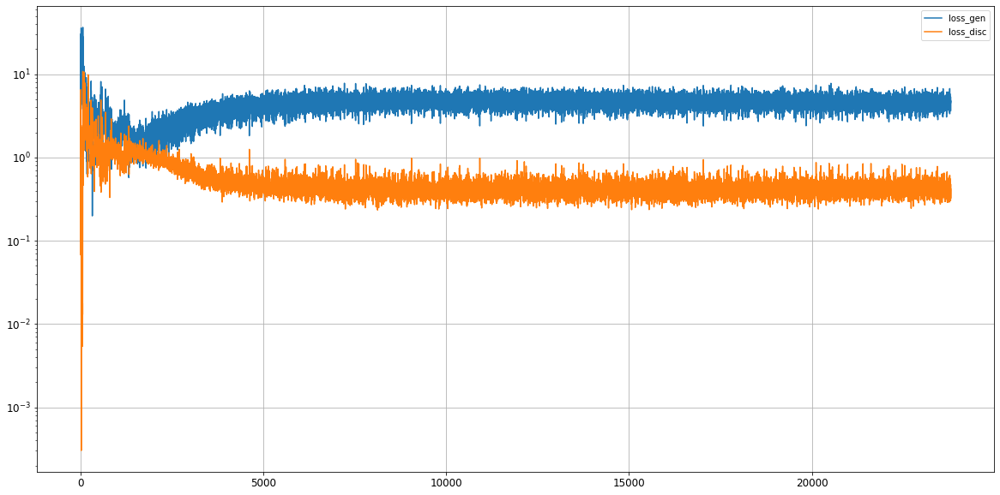

Epoch 23802/50000
0s
Epoch 23803/50000
0s
Epoch 23804/50000
0s
Epoch 23805/50000
0s
Epoch 23806/50000
0s
Epoch 23807/50000
0s
Epoch 23808/50000
0s
Epoch 23809/50000
0s
Epoch 23810/50000
0s
Epoch 23811/50000
0s
Epoch 23812/50000
0s
Epoch 23813/50000
0s
Epoch 23814/50000
0s
Epoch 23815/50000
0s
Epoch 23816/50000
0s
Epoch 23817/50000
0s
Epoch 23818/50000
0s
Epoch 23819/50000
0s
Epoch 23820/50000
0s
Epoch 23821/50000
0s
Epoch 23822/50000
0s
Epoch 23823/50000
0s
Epoch 23824/50000
0s
Epoch 23825/50000
0s
Epoch 23826/50000
0s
Epoch 23827/50000
0s
Epoch 23828/50000
0s
Epoch 23829/50000
0s
Epoch 23830/50000
0s
Epoch 23831/50000
0s
Epoch 23832/50000
0s
Epoch 23833/50000
0s
Epoch 23834/50000
0s
Epoch 23835/50000
0s
Epoch 23836/50000
0s
Epoch 23837/50000
0s
Epoch 23838/50000
0s
Epoch 23839/50000
0s
Epoch 23840/50000
0s
Epoch 23841/50000
0s
Epoch 23842/50000
0s
Epoch 23843/50000
0s
Epoch 23844/50000
0s
Epoch 23845/50000
0s
Epoch 23846/50000
0s
Epoch 23847/50000
0s
Epoch 23848/50000
0s
Epoch 23849/5

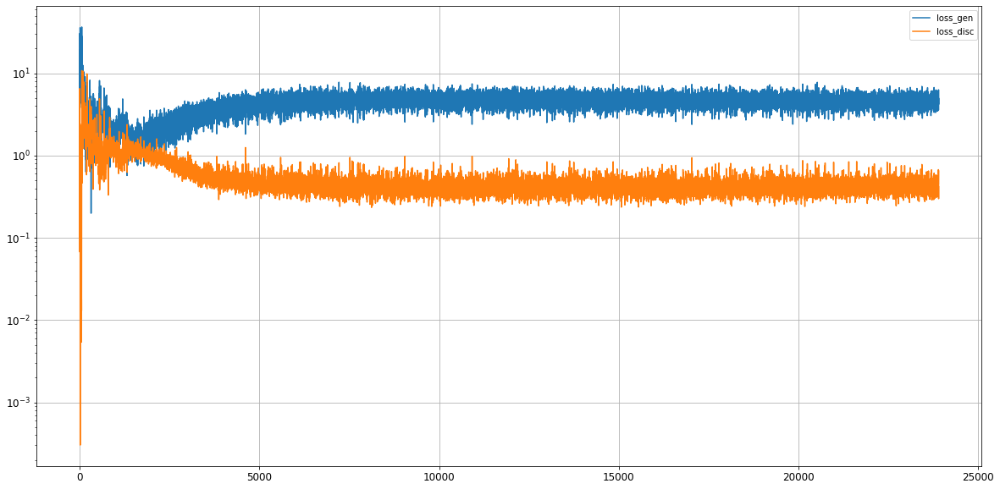

Epoch 23902/50000
0s
Epoch 23903/50000
0s
Epoch 23904/50000
0s
Epoch 23905/50000
0s
Epoch 23906/50000
0s
Epoch 23907/50000
0s
Epoch 23908/50000
0s
Epoch 23909/50000
0s
Epoch 23910/50000
0s
Epoch 23911/50000
0s
Epoch 23912/50000
0s
Epoch 23913/50000
0s
Epoch 23914/50000
0s
Epoch 23915/50000
0s
Epoch 23916/50000
0s
Epoch 23917/50000
0s
Epoch 23918/50000
0s
Epoch 23919/50000
0s
Epoch 23920/50000
0s
Epoch 23921/50000
0s
Epoch 23922/50000
0s
Epoch 23923/50000
0s
Epoch 23924/50000
0s
Epoch 23925/50000
0s
Epoch 23926/50000
0s
Epoch 23927/50000
0s
Epoch 23928/50000
0s
Epoch 23929/50000
0s
Epoch 23930/50000
0s
Epoch 23931/50000
0s
Epoch 23932/50000
0s
Epoch 23933/50000
0s
Epoch 23934/50000
0s
Epoch 23935/50000
0s
Epoch 23936/50000
0s
Epoch 23937/50000
0s
Epoch 23938/50000
0s
Epoch 23939/50000
0s
Epoch 23940/50000
0s
Epoch 23941/50000
0s
Epoch 23942/50000
0s
Epoch 23943/50000
0s
Epoch 23944/50000
0s
Epoch 23945/50000
0s
Epoch 23946/50000
0s
Epoch 23947/50000
0s
Epoch 23948/50000
0s
Epoch 23949/5

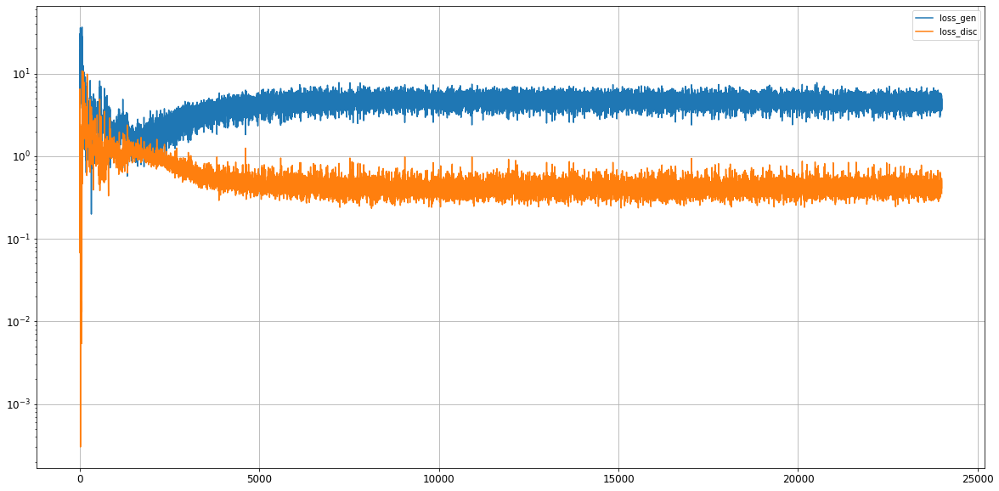

Epoch 24002/50000
0s
Epoch 24003/50000
0s
Epoch 24004/50000
0s
Epoch 24005/50000
0s
Epoch 24006/50000
0s
Epoch 24007/50000
0s
Epoch 24008/50000
0s
Epoch 24009/50000
0s
Epoch 24010/50000
0s
Epoch 24011/50000
0s
Epoch 24012/50000
0s
Epoch 24013/50000
0s
Epoch 24014/50000
0s
Epoch 24015/50000
0s
Epoch 24016/50000
0s
Epoch 24017/50000
0s
Epoch 24018/50000
0s
Epoch 24019/50000
0s
Epoch 24020/50000
0s
Epoch 24021/50000
0s
Epoch 24022/50000
0s
Epoch 24023/50000
0s
Epoch 24024/50000
0s
Epoch 24025/50000
0s
Epoch 24026/50000
0s
Epoch 24027/50000
0s
Epoch 24028/50000
0s
Epoch 24029/50000
0s
Epoch 24030/50000
0s
Epoch 24031/50000
0s
Epoch 24032/50000
0s
Epoch 24033/50000
0s
Epoch 24034/50000
0s
Epoch 24035/50000
0s
Epoch 24036/50000
0s
Epoch 24037/50000
0s
Epoch 24038/50000
0s
Epoch 24039/50000
0s
Epoch 24040/50000
0s
Epoch 24041/50000
0s
Epoch 24042/50000
0s
Epoch 24043/50000
0s
Epoch 24044/50000
0s
Epoch 24045/50000
0s
Epoch 24046/50000
0s
Epoch 24047/50000
0s
Epoch 24048/50000
0s
Epoch 24049/5

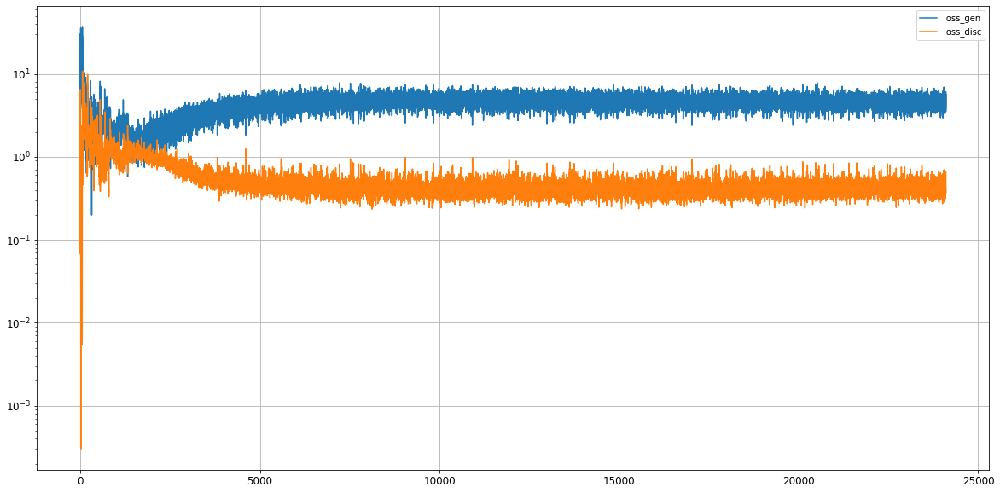

Epoch 24102/50000
0s
Epoch 24103/50000
0s
Epoch 24104/50000
0s
Epoch 24105/50000
0s
Epoch 24106/50000
0s
Epoch 24107/50000
0s
Epoch 24108/50000
0s
Epoch 24109/50000
0s
Epoch 24110/50000
0s
Epoch 24111/50000
0s
Epoch 24112/50000
0s
Epoch 24113/50000
0s
Epoch 24114/50000
0s
Epoch 24115/50000
0s
Epoch 24116/50000
0s
Epoch 24117/50000
0s
Epoch 24118/50000
0s
Epoch 24119/50000
0s
Epoch 24120/50000
0s
Epoch 24121/50000
0s
Epoch 24122/50000
0s
Epoch 24123/50000
0s
Epoch 24124/50000
0s
Epoch 24125/50000
0s
Epoch 24126/50000
0s
Epoch 24127/50000
0s
Epoch 24128/50000
0s
Epoch 24129/50000
0s
Epoch 24130/50000
0s
Epoch 24131/50000
0s
Epoch 24132/50000
0s
Epoch 24133/50000
0s
Epoch 24134/50000
0s
Epoch 24135/50000
0s
Epoch 24136/50000
0s
Epoch 24137/50000
0s
Epoch 24138/50000
0s
Epoch 24139/50000
0s
Epoch 24140/50000
0s
Epoch 24141/50000
0s
Epoch 24142/50000
0s
Epoch 24143/50000
0s
Epoch 24144/50000
0s
Epoch 24145/50000
0s
Epoch 24146/50000
0s
Epoch 24147/50000
0s
Epoch 24148/50000
0s
Epoch 24149/5

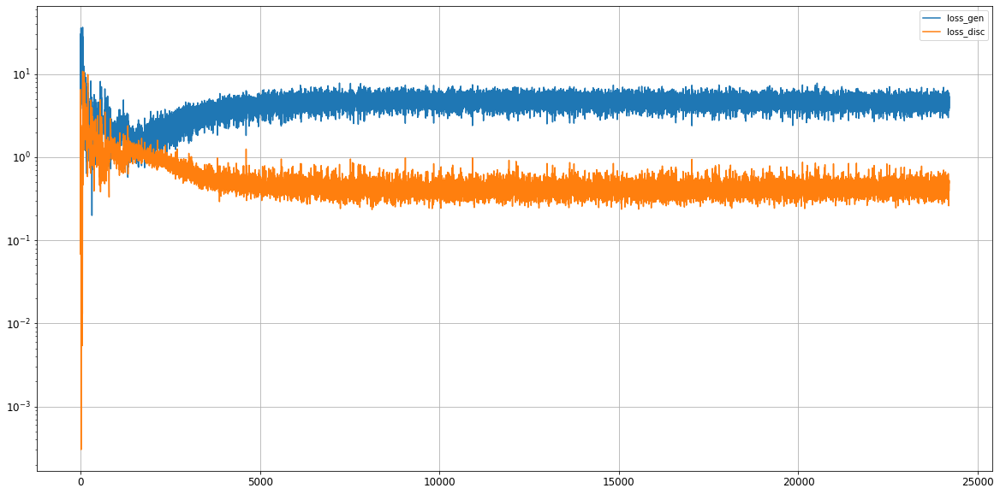

Epoch 24202/50000
0s
Epoch 24203/50000
0s
Epoch 24204/50000
0s
Epoch 24205/50000
0s
Epoch 24206/50000
0s
Epoch 24207/50000
0s
Epoch 24208/50000
0s
Epoch 24209/50000
0s
Epoch 24210/50000
0s
Epoch 24211/50000
0s
Epoch 24212/50000
0s
Epoch 24213/50000
0s
Epoch 24214/50000
0s
Epoch 24215/50000
0s
Epoch 24216/50000
0s
Epoch 24217/50000
0s
Epoch 24218/50000
0s
Epoch 24219/50000
0s
Epoch 24220/50000
0s
Epoch 24221/50000
0s
Epoch 24222/50000
0s
Epoch 24223/50000
0s
Epoch 24224/50000
0s
Epoch 24225/50000
0s
Epoch 24226/50000
0s
Epoch 24227/50000
0s
Epoch 24228/50000
0s
Epoch 24229/50000
0s
Epoch 24230/50000
0s
Epoch 24231/50000
0s
Epoch 24232/50000
0s
Epoch 24233/50000
0s
Epoch 24234/50000
0s
Epoch 24235/50000
0s
Epoch 24236/50000
0s
Epoch 24237/50000
0s
Epoch 24238/50000
0s
Epoch 24239/50000
0s
Epoch 24240/50000
0s
Epoch 24241/50000
0s
Epoch 24242/50000
0s
Epoch 24243/50000
0s
Epoch 24244/50000
0s
Epoch 24245/50000
0s
Epoch 24246/50000
0s
Epoch 24247/50000
0s
Epoch 24248/50000
0s
Epoch 24249/5

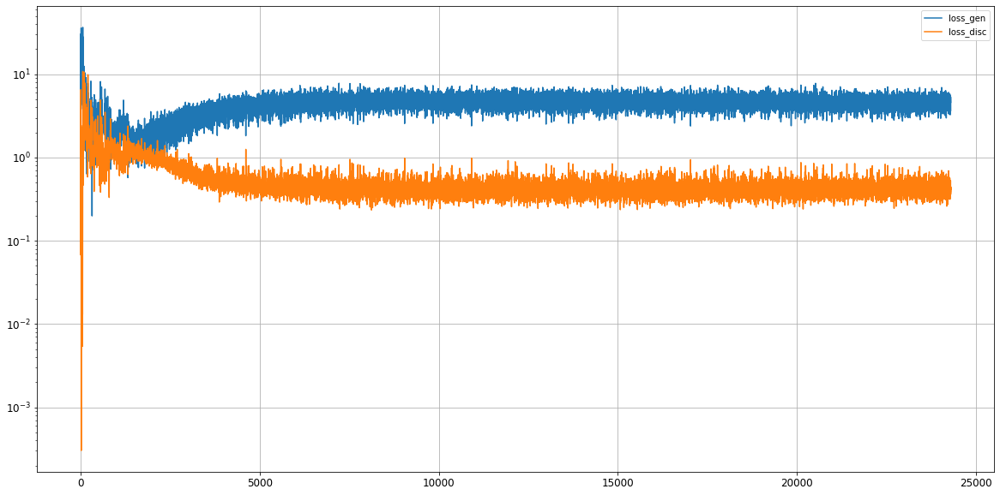

Epoch 24302/50000
0s
Epoch 24303/50000
0s
Epoch 24304/50000
0s
Epoch 24305/50000
0s
Epoch 24306/50000
0s
Epoch 24307/50000
0s
Epoch 24308/50000
0s
Epoch 24309/50000
0s
Epoch 24310/50000
0s
Epoch 24311/50000
0s
Epoch 24312/50000
0s
Epoch 24313/50000
0s
Epoch 24314/50000
0s
Epoch 24315/50000
0s
Epoch 24316/50000
0s
Epoch 24317/50000
0s
Epoch 24318/50000
0s
Epoch 24319/50000
0s
Epoch 24320/50000
0s
Epoch 24321/50000
0s
Epoch 24322/50000
0s
Epoch 24323/50000
0s
Epoch 24324/50000
0s
Epoch 24325/50000
0s
Epoch 24326/50000
0s
Epoch 24327/50000
0s
Epoch 24328/50000
0s
Epoch 24329/50000
0s
Epoch 24330/50000
0s
Epoch 24331/50000
0s
Epoch 24332/50000
0s
Epoch 24333/50000
0s
Epoch 24334/50000
0s
Epoch 24335/50000
0s
Epoch 24336/50000
0s
Epoch 24337/50000
0s
Epoch 24338/50000
0s
Epoch 24339/50000
0s
Epoch 24340/50000
0s
Epoch 24341/50000
0s
Epoch 24342/50000
0s
Epoch 24343/50000
0s
Epoch 24344/50000
0s
Epoch 24345/50000
0s
Epoch 24346/50000
0s
Epoch 24347/50000
0s
Epoch 24348/50000
0s
Epoch 24349/5

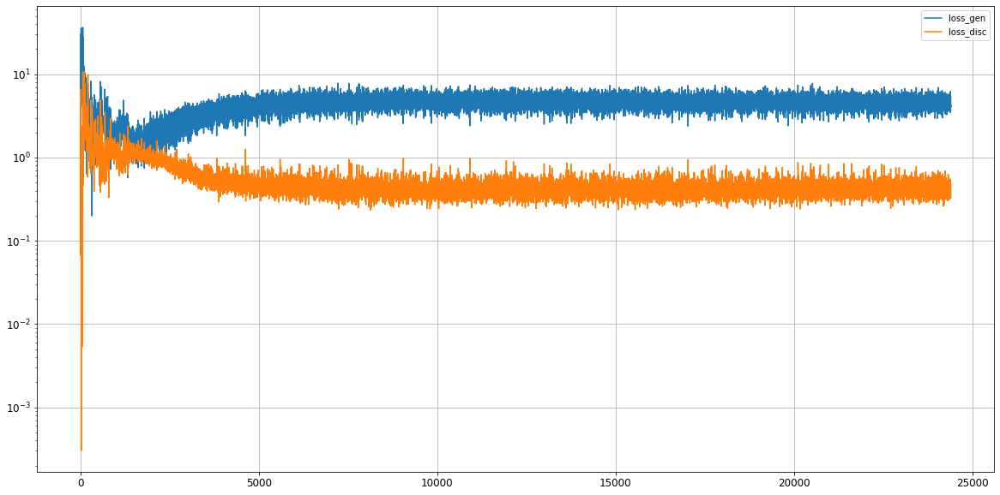

Epoch 24402/50000
0s
Epoch 24403/50000
0s
Epoch 24404/50000
0s
Epoch 24405/50000
0s
Epoch 24406/50000
0s
Epoch 24407/50000
0s
Epoch 24408/50000
0s
Epoch 24409/50000
0s
Epoch 24410/50000
0s
Epoch 24411/50000
0s
Epoch 24412/50000
0s
Epoch 24413/50000
0s
Epoch 24414/50000
0s
Epoch 24415/50000
0s
Epoch 24416/50000
0s
Epoch 24417/50000
0s
Epoch 24418/50000
0s
Epoch 24419/50000
0s
Epoch 24420/50000
0s
Epoch 24421/50000
0s
Epoch 24422/50000
0s
Epoch 24423/50000
0s
Epoch 24424/50000
0s
Epoch 24425/50000
0s
Epoch 24426/50000
0s
Epoch 24427/50000
0s
Epoch 24428/50000
0s
Epoch 24429/50000
0s
Epoch 24430/50000
0s
Epoch 24431/50000
0s
Epoch 24432/50000
0s
Epoch 24433/50000
0s
Epoch 24434/50000
0s
Epoch 24435/50000
0s
Epoch 24436/50000
0s
Epoch 24437/50000
0s
Epoch 24438/50000
0s
Epoch 24439/50000
0s
Epoch 24440/50000
0s
Epoch 24441/50000
0s
Epoch 24442/50000
0s
Epoch 24443/50000
0s
Epoch 24444/50000
0s
Epoch 24445/50000
0s
Epoch 24446/50000
0s
Epoch 24447/50000
0s
Epoch 24448/50000
0s
Epoch 24449/5

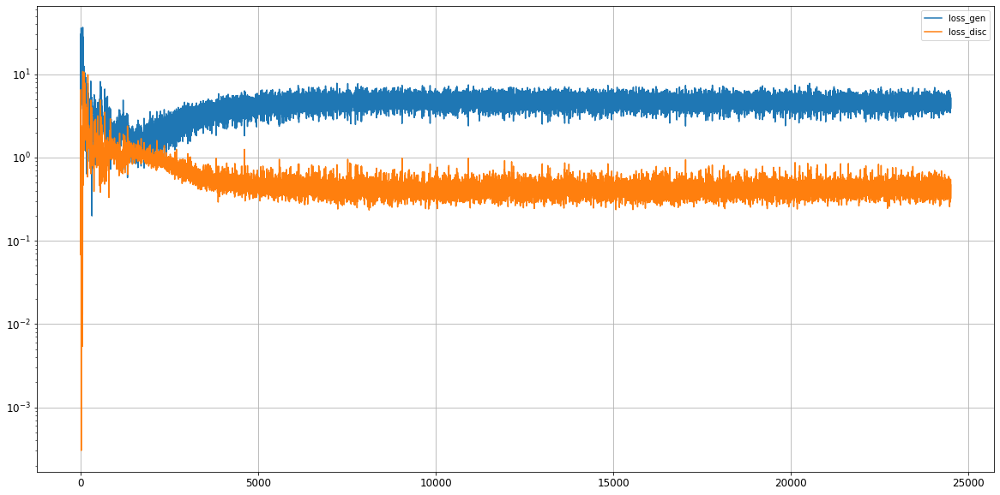

Epoch 24502/50000
0s
Epoch 24503/50000
0s
Epoch 24504/50000
0s
Epoch 24505/50000
0s
Epoch 24506/50000
0s
Epoch 24507/50000
0s
Epoch 24508/50000
0s
Epoch 24509/50000
0s
Epoch 24510/50000
0s
Epoch 24511/50000
0s
Epoch 24512/50000
0s
Epoch 24513/50000
0s
Epoch 24514/50000
0s
Epoch 24515/50000
0s
Epoch 24516/50000
0s
Epoch 24517/50000
0s
Epoch 24518/50000
0s
Epoch 24519/50000
0s
Epoch 24520/50000
0s
Epoch 24521/50000
0s
Epoch 24522/50000
0s
Epoch 24523/50000
0s
Epoch 24524/50000
0s
Epoch 24525/50000
0s
Epoch 24526/50000
0s
Epoch 24527/50000
0s
Epoch 24528/50000
0s
Epoch 24529/50000
0s
Epoch 24530/50000
0s
Epoch 24531/50000
0s
Epoch 24532/50000
0s
Epoch 24533/50000
0s
Epoch 24534/50000
0s
Epoch 24535/50000
0s
Epoch 24536/50000
0s
Epoch 24537/50000
0s
Epoch 24538/50000
0s
Epoch 24539/50000
0s
Epoch 24540/50000
0s
Epoch 24541/50000
0s
Epoch 24542/50000
0s
Epoch 24543/50000
0s
Epoch 24544/50000
0s
Epoch 24545/50000
0s
Epoch 24546/50000
0s
Epoch 24547/50000
0s
Epoch 24548/50000
0s
Epoch 24549/5

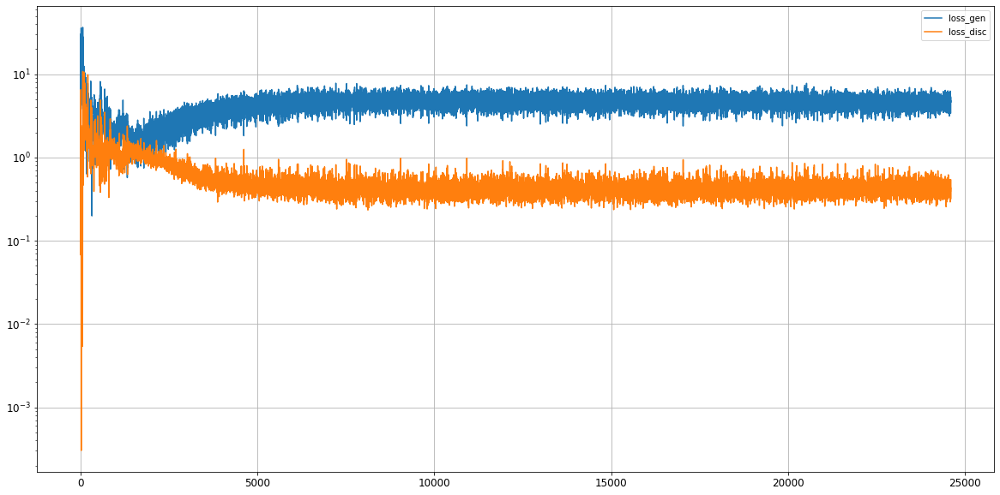

Epoch 24602/50000
0s
Epoch 24603/50000
0s
Epoch 24604/50000
0s
Epoch 24605/50000
0s
Epoch 24606/50000
0s
Epoch 24607/50000
0s
Epoch 24608/50000
0s
Epoch 24609/50000
0s
Epoch 24610/50000
0s
Epoch 24611/50000
0s
Epoch 24612/50000
0s
Epoch 24613/50000
0s
Epoch 24614/50000
0s
Epoch 24615/50000
0s
Epoch 24616/50000
0s
Epoch 24617/50000
0s
Epoch 24618/50000
0s
Epoch 24619/50000
0s
Epoch 24620/50000
0s
Epoch 24621/50000
0s
Epoch 24622/50000
0s
Epoch 24623/50000
0s
Epoch 24624/50000
0s
Epoch 24625/50000
0s
Epoch 24626/50000
0s
Epoch 24627/50000
0s
Epoch 24628/50000
0s
Epoch 24629/50000
0s
Epoch 24630/50000
0s
Epoch 24631/50000
0s
Epoch 24632/50000
0s
Epoch 24633/50000
0s
Epoch 24634/50000
0s
Epoch 24635/50000
0s
Epoch 24636/50000
0s
Epoch 24637/50000
0s
Epoch 24638/50000
0s
Epoch 24639/50000
0s
Epoch 24640/50000
0s
Epoch 24641/50000
0s
Epoch 24642/50000
0s
Epoch 24643/50000
0s
Epoch 24644/50000
0s
Epoch 24645/50000
0s
Epoch 24646/50000
0s
Epoch 24647/50000
0s
Epoch 24648/50000
0s
Epoch 24649/5

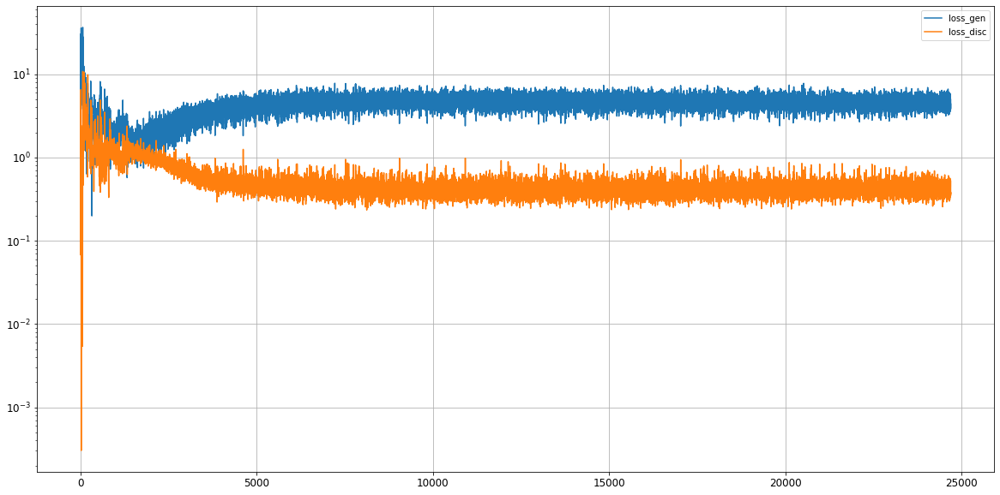

Epoch 24702/50000
0s
Epoch 24703/50000
0s
Epoch 24704/50000
0s
Epoch 24705/50000
0s
Epoch 24706/50000
0s
Epoch 24707/50000
0s
Epoch 24708/50000
0s
Epoch 24709/50000
0s
Epoch 24710/50000
0s
Epoch 24711/50000
0s
Epoch 24712/50000
0s
Epoch 24713/50000
0s
Epoch 24714/50000
0s
Epoch 24715/50000
0s
Epoch 24716/50000
0s
Epoch 24717/50000
0s
Epoch 24718/50000
0s
Epoch 24719/50000
0s
Epoch 24720/50000
0s
Epoch 24721/50000
0s
Epoch 24722/50000
0s
Epoch 24723/50000
0s
Epoch 24724/50000
0s
Epoch 24725/50000
0s
Epoch 24726/50000
0s
Epoch 24727/50000
0s
Epoch 24728/50000
0s
Epoch 24729/50000
0s
Epoch 24730/50000
0s
Epoch 24731/50000
0s
Epoch 24732/50000
0s
Epoch 24733/50000
0s
Epoch 24734/50000
0s
Epoch 24735/50000
0s
Epoch 24736/50000
0s
Epoch 24737/50000
0s
Epoch 24738/50000
0s
Epoch 24739/50000
0s
Epoch 24740/50000
0s
Epoch 24741/50000
0s
Epoch 24742/50000
0s
Epoch 24743/50000
0s
Epoch 24744/50000
0s
Epoch 24745/50000
0s
Epoch 24746/50000
0s
Epoch 24747/50000
0s
Epoch 24748/50000
0s
Epoch 24749/5

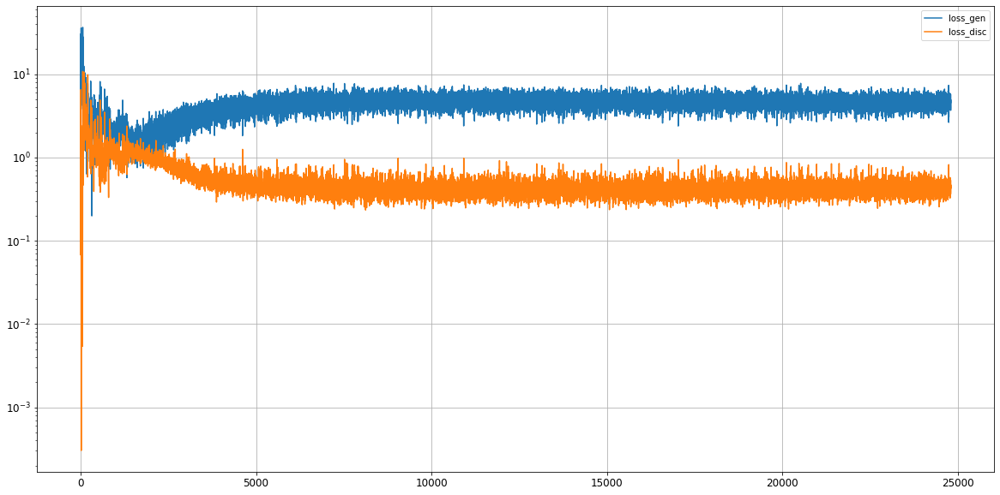

Epoch 24802/50000
0s
Epoch 24803/50000
0s
Epoch 24804/50000
0s
Epoch 24805/50000
0s
Epoch 24806/50000
0s
Epoch 24807/50000
0s
Epoch 24808/50000
0s
Epoch 24809/50000
0s
Epoch 24810/50000
0s
Epoch 24811/50000
0s
Epoch 24812/50000
0s
Epoch 24813/50000
0s
Epoch 24814/50000
0s
Epoch 24815/50000
0s
Epoch 24816/50000
0s
Epoch 24817/50000
0s
Epoch 24818/50000
0s
Epoch 24819/50000
0s
Epoch 24820/50000
0s
Epoch 24821/50000
0s
Epoch 24822/50000
0s
Epoch 24823/50000
0s
Epoch 24824/50000
0s
Epoch 24825/50000
0s
Epoch 24826/50000
0s
Epoch 24827/50000
0s
Epoch 24828/50000
0s
Epoch 24829/50000
0s
Epoch 24830/50000
0s
Epoch 24831/50000
0s
Epoch 24832/50000
0s
Epoch 24833/50000
0s
Epoch 24834/50000
0s
Epoch 24835/50000
0s
Epoch 24836/50000
0s
Epoch 24837/50000
0s
Epoch 24838/50000
0s
Epoch 24839/50000
0s
Epoch 24840/50000
0s
Epoch 24841/50000
0s
Epoch 24842/50000
0s
Epoch 24843/50000
0s
Epoch 24844/50000
0s
Epoch 24845/50000
0s
Epoch 24846/50000
0s
Epoch 24847/50000
0s
Epoch 24848/50000
0s
Epoch 24849/5

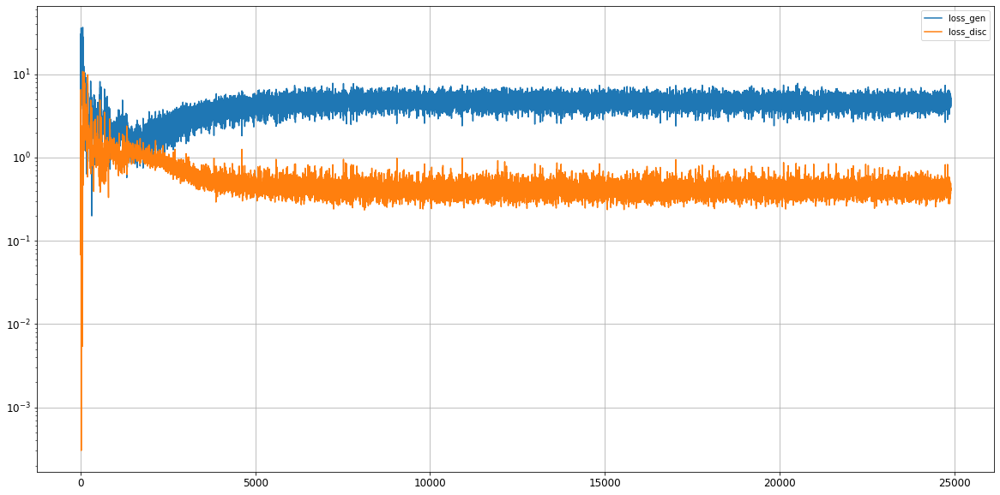

Epoch 24902/50000
0s
Epoch 24903/50000
0s
Epoch 24904/50000
0s
Epoch 24905/50000
0s
Epoch 24906/50000
0s
Epoch 24907/50000
0s
Epoch 24908/50000
0s
Epoch 24909/50000
0s
Epoch 24910/50000
0s
Epoch 24911/50000
0s
Epoch 24912/50000
0s
Epoch 24913/50000
0s
Epoch 24914/50000
0s
Epoch 24915/50000
0s
Epoch 24916/50000
0s
Epoch 24917/50000
0s
Epoch 24918/50000
0s
Epoch 24919/50000
0s
Epoch 24920/50000
0s
Epoch 24921/50000
0s
Epoch 24922/50000
0s
Epoch 24923/50000
0s
Epoch 24924/50000
0s
Epoch 24925/50000
0s
Epoch 24926/50000
0s
Epoch 24927/50000
0s
Epoch 24928/50000
0s
Epoch 24929/50000
0s
Epoch 24930/50000
0s
Epoch 24931/50000
0s
Epoch 24932/50000
0s
Epoch 24933/50000
0s
Epoch 24934/50000
0s
Epoch 24935/50000
0s
Epoch 24936/50000
0s
Epoch 24937/50000
0s
Epoch 24938/50000
0s
Epoch 24939/50000
0s
Epoch 24940/50000
0s
Epoch 24941/50000
0s
Epoch 24942/50000
0s
Epoch 24943/50000
0s
Epoch 24944/50000
0s
Epoch 24945/50000
0s
Epoch 24946/50000
0s
Epoch 24947/50000
0s
Epoch 24948/50000
0s
Epoch 24949/5

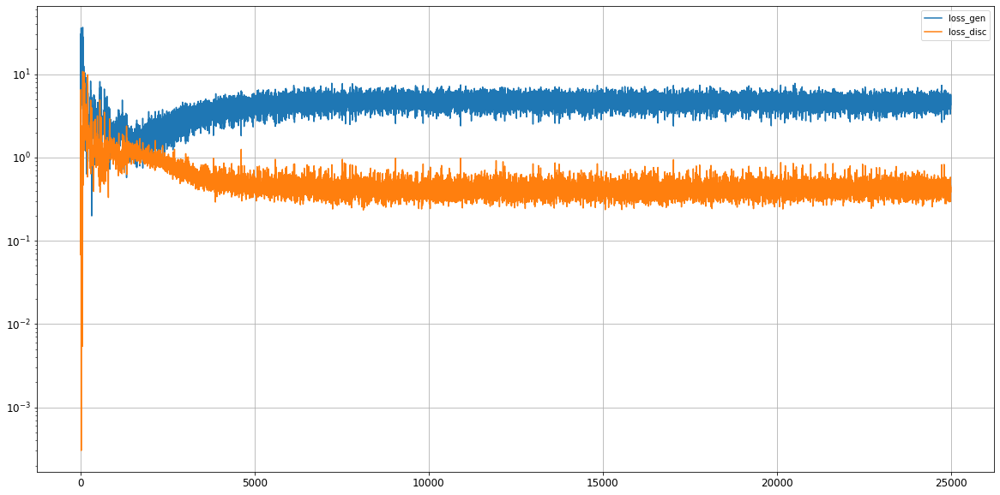

Epoch 25002/50000
0s
Epoch 25003/50000
0s
Epoch 25004/50000
0s
Epoch 25005/50000
0s
Epoch 25006/50000
0s
Epoch 25007/50000
0s
Epoch 25008/50000
0s
Epoch 25009/50000
0s
Epoch 25010/50000
0s
Epoch 25011/50000
0s
Epoch 25012/50000
0s
Epoch 25013/50000
0s
Epoch 25014/50000
0s
Epoch 25015/50000
0s
Epoch 25016/50000
0s
Epoch 25017/50000
0s
Epoch 25018/50000
0s
Epoch 25019/50000
0s
Epoch 25020/50000
0s
Epoch 25021/50000
0s
Epoch 25022/50000
0s
Epoch 25023/50000
0s
Epoch 25024/50000
0s
Epoch 25025/50000
0s
Epoch 25026/50000
0s
Epoch 25027/50000
0s
Epoch 25028/50000
0s
Epoch 25029/50000
0s
Epoch 25030/50000
0s
Epoch 25031/50000
0s
Epoch 25032/50000
0s
Epoch 25033/50000
0s
Epoch 25034/50000
0s
Epoch 25035/50000
0s
Epoch 25036/50000
0s
Epoch 25037/50000
0s
Epoch 25038/50000
0s
Epoch 25039/50000
0s
Epoch 25040/50000
0s
Epoch 25041/50000
0s
Epoch 25042/50000
0s
Epoch 25043/50000
0s
Epoch 25044/50000
0s
Epoch 25045/50000
0s
Epoch 25046/50000
0s
Epoch 25047/50000
0s
Epoch 25048/50000
0s
Epoch 25049/5

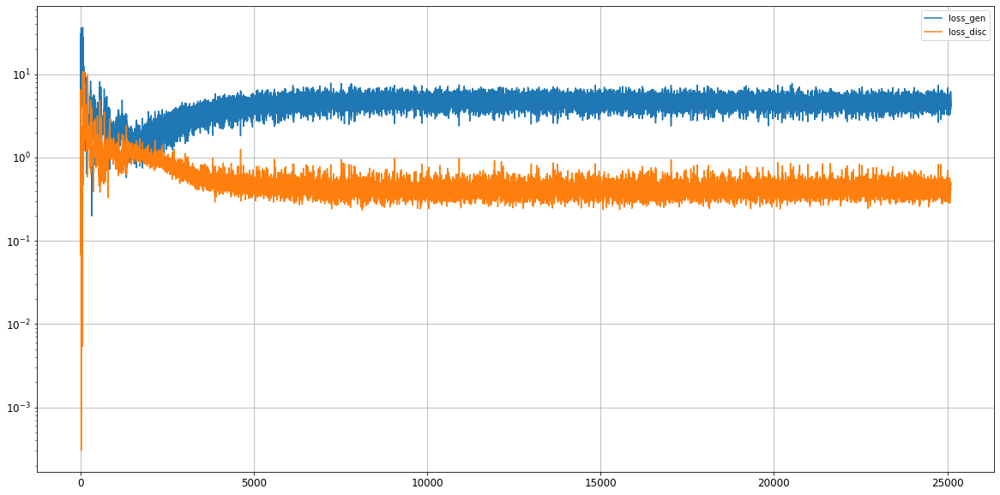

Epoch 25102/50000
0s
Epoch 25103/50000
0s
Epoch 25104/50000
0s
Epoch 25105/50000
0s
Epoch 25106/50000
0s
Epoch 25107/50000
0s
Epoch 25108/50000
0s
Epoch 25109/50000
0s
Epoch 25110/50000
0s
Epoch 25111/50000
0s
Epoch 25112/50000
0s
Epoch 25113/50000
0s
Epoch 25114/50000
0s
Epoch 25115/50000
0s
Epoch 25116/50000
0s
Epoch 25117/50000
0s
Epoch 25118/50000
0s
Epoch 25119/50000
0s
Epoch 25120/50000
0s
Epoch 25121/50000
0s
Epoch 25122/50000
0s
Epoch 25123/50000
0s
Epoch 25124/50000
0s
Epoch 25125/50000
0s
Epoch 25126/50000
0s
Epoch 25127/50000
0s
Epoch 25128/50000
0s
Epoch 25129/50000
0s
Epoch 25130/50000
0s
Epoch 25131/50000
0s
Epoch 25132/50000
0s
Epoch 25133/50000
0s
Epoch 25134/50000
0s
Epoch 25135/50000
0s
Epoch 25136/50000
0s
Epoch 25137/50000
0s
Epoch 25138/50000
0s
Epoch 25139/50000
0s
Epoch 25140/50000
0s
Epoch 25141/50000
0s
Epoch 25142/50000
0s
Epoch 25143/50000
0s
Epoch 25144/50000
0s
Epoch 25145/50000
0s
Epoch 25146/50000
0s
Epoch 25147/50000
0s
Epoch 25148/50000
0s
Epoch 25149/5

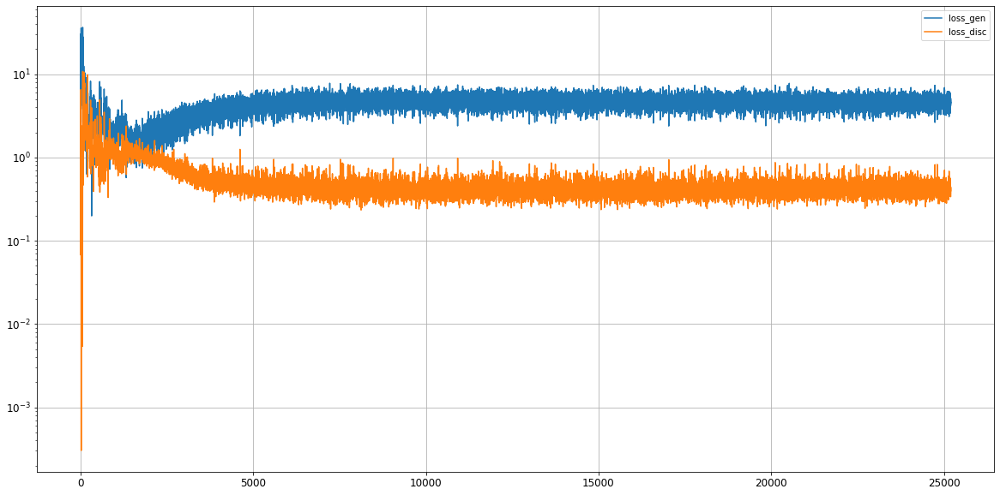

Epoch 25202/50000
0s
Epoch 25203/50000
0s
Epoch 25204/50000
0s
Epoch 25205/50000
0s
Epoch 25206/50000
0s
Epoch 25207/50000
0s
Epoch 25208/50000
0s
Epoch 25209/50000
0s
Epoch 25210/50000
0s
Epoch 25211/50000
0s
Epoch 25212/50000
0s
Epoch 25213/50000
0s
Epoch 25214/50000
0s
Epoch 25215/50000
0s
Epoch 25216/50000
0s
Epoch 25217/50000
0s
Epoch 25218/50000
0s
Epoch 25219/50000
0s
Epoch 25220/50000
0s
Epoch 25221/50000
0s
Epoch 25222/50000
0s
Epoch 25223/50000
0s
Epoch 25224/50000
0s
Epoch 25225/50000
0s
Epoch 25226/50000
0s
Epoch 25227/50000
0s
Epoch 25228/50000
0s
Epoch 25229/50000
0s
Epoch 25230/50000
0s
Epoch 25231/50000
0s
Epoch 25232/50000
0s
Epoch 25233/50000
0s
Epoch 25234/50000
0s
Epoch 25235/50000
0s
Epoch 25236/50000
0s
Epoch 25237/50000
0s
Epoch 25238/50000
0s
Epoch 25239/50000
0s
Epoch 25240/50000
0s
Epoch 25241/50000
0s
Epoch 25242/50000
0s
Epoch 25243/50000
0s
Epoch 25244/50000
0s
Epoch 25245/50000
0s
Epoch 25246/50000
0s
Epoch 25247/50000
0s
Epoch 25248/50000
0s
Epoch 25249/5

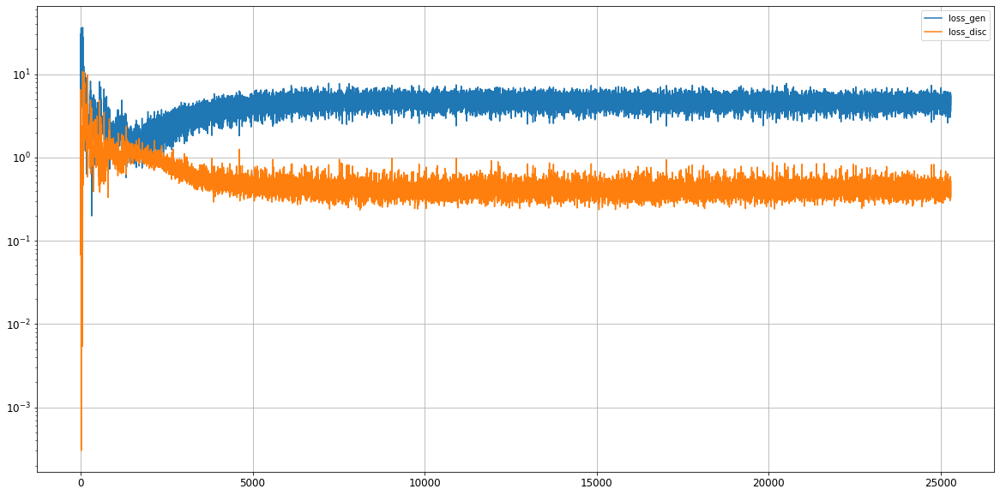

Epoch 25302/50000
0s
Epoch 25303/50000
0s
Epoch 25304/50000
0s
Epoch 25305/50000
0s
Epoch 25306/50000
0s
Epoch 25307/50000
0s
Epoch 25308/50000
0s
Epoch 25309/50000
0s
Epoch 25310/50000
0s
Epoch 25311/50000
0s
Epoch 25312/50000
0s
Epoch 25313/50000
0s
Epoch 25314/50000
0s
Epoch 25315/50000
0s
Epoch 25316/50000
0s
Epoch 25317/50000
0s
Epoch 25318/50000
0s
Epoch 25319/50000
0s
Epoch 25320/50000
0s
Epoch 25321/50000
0s
Epoch 25322/50000
0s
Epoch 25323/50000
0s
Epoch 25324/50000
0s
Epoch 25325/50000
0s
Epoch 25326/50000
0s
Epoch 25327/50000
0s
Epoch 25328/50000
0s
Epoch 25329/50000
0s
Epoch 25330/50000
0s
Epoch 25331/50000
0s
Epoch 25332/50000
0s
Epoch 25333/50000
0s
Epoch 25334/50000
0s
Epoch 25335/50000
0s
Epoch 25336/50000
0s
Epoch 25337/50000
0s
Epoch 25338/50000
0s
Epoch 25339/50000
0s
Epoch 25340/50000
0s
Epoch 25341/50000
0s
Epoch 25342/50000
0s
Epoch 25343/50000
0s
Epoch 25344/50000
0s
Epoch 25345/50000
0s
Epoch 25346/50000
0s
Epoch 25347/50000
0s
Epoch 25348/50000
0s
Epoch 25349/5

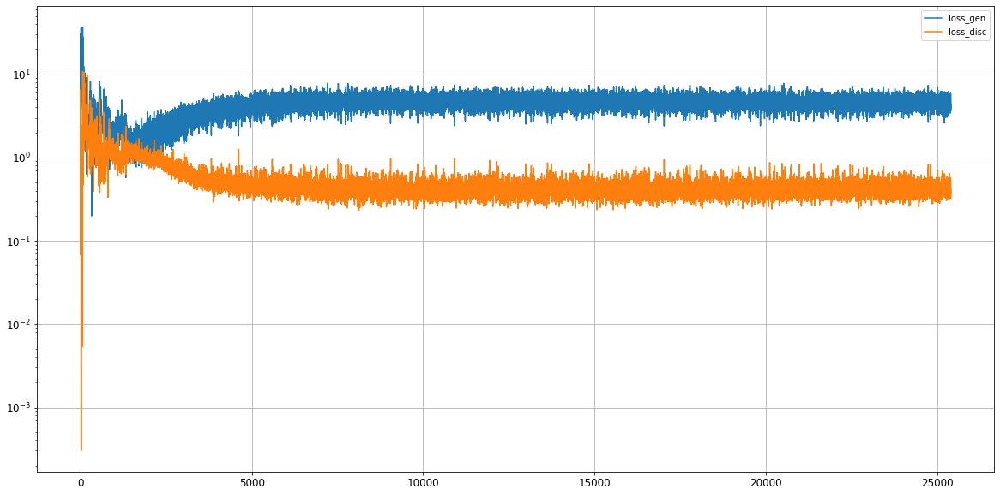

Epoch 25402/50000
0s
Epoch 25403/50000
0s
Epoch 25404/50000
0s
Epoch 25405/50000
0s
Epoch 25406/50000
0s
Epoch 25407/50000
0s
Epoch 25408/50000
0s
Epoch 25409/50000
0s
Epoch 25410/50000
0s
Epoch 25411/50000
0s
Epoch 25412/50000
0s
Epoch 25413/50000
0s
Epoch 25414/50000
0s
Epoch 25415/50000
0s
Epoch 25416/50000
0s
Epoch 25417/50000
0s
Epoch 25418/50000
0s
Epoch 25419/50000
0s
Epoch 25420/50000
0s
Epoch 25421/50000
0s
Epoch 25422/50000
0s
Epoch 25423/50000
0s
Epoch 25424/50000
0s
Epoch 25425/50000
0s
Epoch 25426/50000
0s
Epoch 25427/50000
0s
Epoch 25428/50000
0s
Epoch 25429/50000
0s
Epoch 25430/50000
0s
Epoch 25431/50000
0s
Epoch 25432/50000
0s
Epoch 25433/50000
0s
Epoch 25434/50000
0s
Epoch 25435/50000
0s
Epoch 25436/50000
0s
Epoch 25437/50000
0s
Epoch 25438/50000
0s
Epoch 25439/50000
0s
Epoch 25440/50000
0s
Epoch 25441/50000
0s
Epoch 25442/50000
0s
Epoch 25443/50000
0s
Epoch 25444/50000
0s
Epoch 25445/50000
0s
Epoch 25446/50000
0s
Epoch 25447/50000
0s
Epoch 25448/50000
0s
Epoch 25449/5

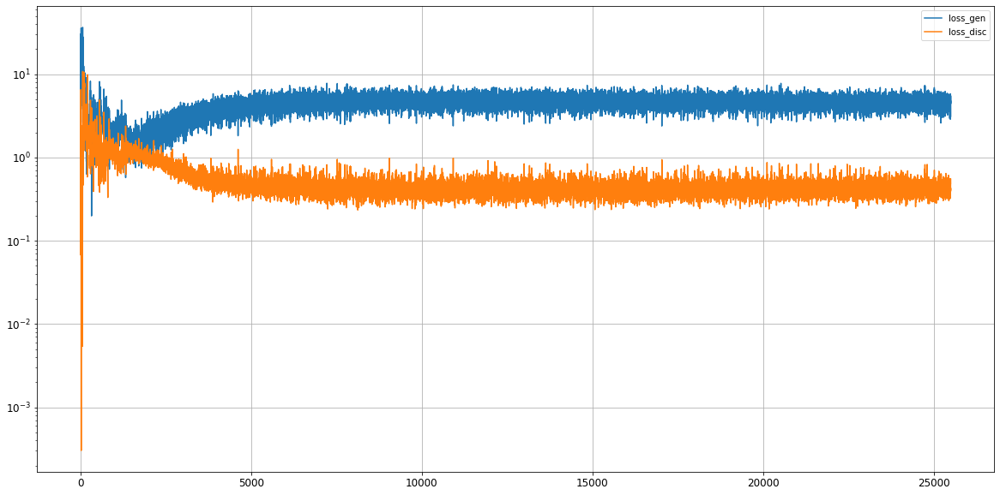

Epoch 25502/50000
0s
Epoch 25503/50000
0s
Epoch 25504/50000
0s
Epoch 25505/50000
0s
Epoch 25506/50000
0s
Epoch 25507/50000
0s
Epoch 25508/50000
0s
Epoch 25509/50000
0s
Epoch 25510/50000
0s
Epoch 25511/50000
0s
Epoch 25512/50000
0s
Epoch 25513/50000
0s
Epoch 25514/50000
0s
Epoch 25515/50000
0s
Epoch 25516/50000
0s
Epoch 25517/50000
0s
Epoch 25518/50000
0s
Epoch 25519/50000
0s
Epoch 25520/50000
0s
Epoch 25521/50000
0s
Epoch 25522/50000
0s
Epoch 25523/50000
0s
Epoch 25524/50000
0s
Epoch 25525/50000
0s
Epoch 25526/50000
0s
Epoch 25527/50000
0s
Epoch 25528/50000
0s
Epoch 25529/50000
0s
Epoch 25530/50000
0s
Epoch 25531/50000
0s
Epoch 25532/50000
0s
Epoch 25533/50000
0s
Epoch 25534/50000
0s
Epoch 25535/50000
0s
Epoch 25536/50000
0s
Epoch 25537/50000
0s
Epoch 25538/50000
0s
Epoch 25539/50000
0s
Epoch 25540/50000
0s
Epoch 25541/50000
0s
Epoch 25542/50000
0s
Epoch 25543/50000
0s
Epoch 25544/50000
0s
Epoch 25545/50000
0s
Epoch 25546/50000
0s
Epoch 25547/50000
0s
Epoch 25548/50000
0s
Epoch 25549/5

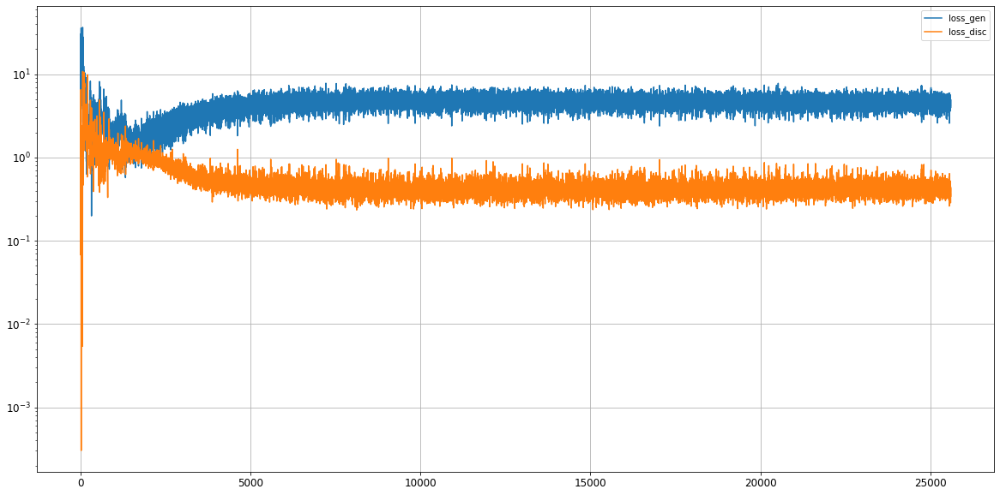

Epoch 25602/50000
0s
Epoch 25603/50000
0s
Epoch 25604/50000
0s
Epoch 25605/50000
0s
Epoch 25606/50000
0s
Epoch 25607/50000
0s
Epoch 25608/50000
0s
Epoch 25609/50000
0s
Epoch 25610/50000
0s
Epoch 25611/50000
0s
Epoch 25612/50000
0s
Epoch 25613/50000
0s
Epoch 25614/50000
0s
Epoch 25615/50000
0s
Epoch 25616/50000
0s
Epoch 25617/50000
0s
Epoch 25618/50000
0s
Epoch 25619/50000
0s
Epoch 25620/50000
0s
Epoch 25621/50000
0s
Epoch 25622/50000
0s
Epoch 25623/50000
0s
Epoch 25624/50000
0s
Epoch 25625/50000
0s
Epoch 25626/50000
0s
Epoch 25627/50000
0s
Epoch 25628/50000
0s
Epoch 25629/50000
0s
Epoch 25630/50000
0s
Epoch 25631/50000
0s
Epoch 25632/50000
0s
Epoch 25633/50000
0s
Epoch 25634/50000
0s
Epoch 25635/50000
0s
Epoch 25636/50000
0s
Epoch 25637/50000
0s
Epoch 25638/50000
0s
Epoch 25639/50000
0s
Epoch 25640/50000
0s
Epoch 25641/50000
0s
Epoch 25642/50000
0s
Epoch 25643/50000
0s
Epoch 25644/50000
0s
Epoch 25645/50000
0s
Epoch 25646/50000
0s
Epoch 25647/50000
0s
Epoch 25648/50000
0s
Epoch 25649/5

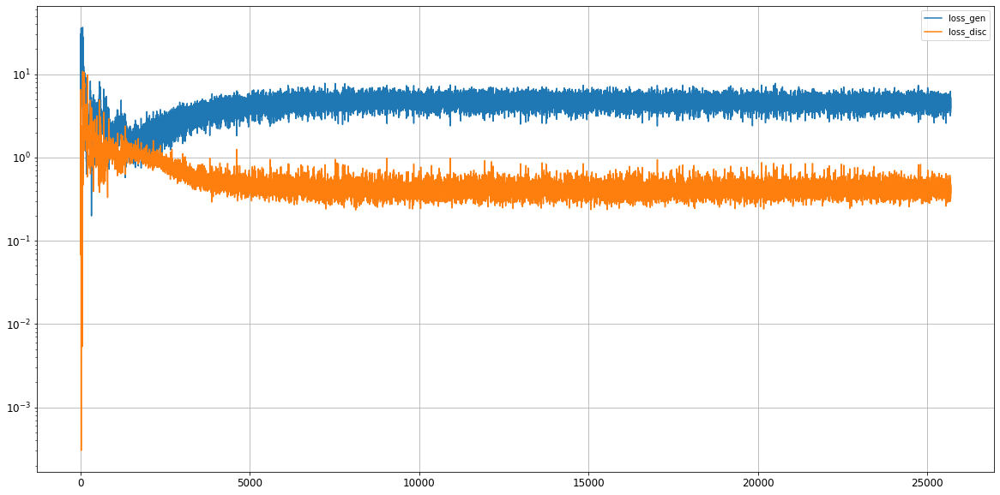

Epoch 25702/50000
0s
Epoch 25703/50000
0s
Epoch 25704/50000
0s
Epoch 25705/50000
0s
Epoch 25706/50000
0s
Epoch 25707/50000
0s
Epoch 25708/50000
0s
Epoch 25709/50000
0s
Epoch 25710/50000
0s
Epoch 25711/50000
0s
Epoch 25712/50000
0s
Epoch 25713/50000
0s
Epoch 25714/50000
0s
Epoch 25715/50000
0s
Epoch 25716/50000
0s
Epoch 25717/50000
0s
Epoch 25718/50000
0s
Epoch 25719/50000
0s
Epoch 25720/50000
0s
Epoch 25721/50000
0s
Epoch 25722/50000
0s
Epoch 25723/50000
0s
Epoch 25724/50000
0s
Epoch 25725/50000
0s
Epoch 25726/50000
0s
Epoch 25727/50000
0s
Epoch 25728/50000
0s
Epoch 25729/50000
0s
Epoch 25730/50000
0s
Epoch 25731/50000
0s
Epoch 25732/50000
0s
Epoch 25733/50000
0s
Epoch 25734/50000
0s
Epoch 25735/50000
0s
Epoch 25736/50000
0s
Epoch 25737/50000
0s
Epoch 25738/50000
0s
Epoch 25739/50000
0s
Epoch 25740/50000
0s
Epoch 25741/50000
0s
Epoch 25742/50000
0s
Epoch 25743/50000
0s
Epoch 25744/50000
0s
Epoch 25745/50000
0s
Epoch 25746/50000
0s
Epoch 25747/50000
0s
Epoch 25748/50000
0s
Epoch 25749/5

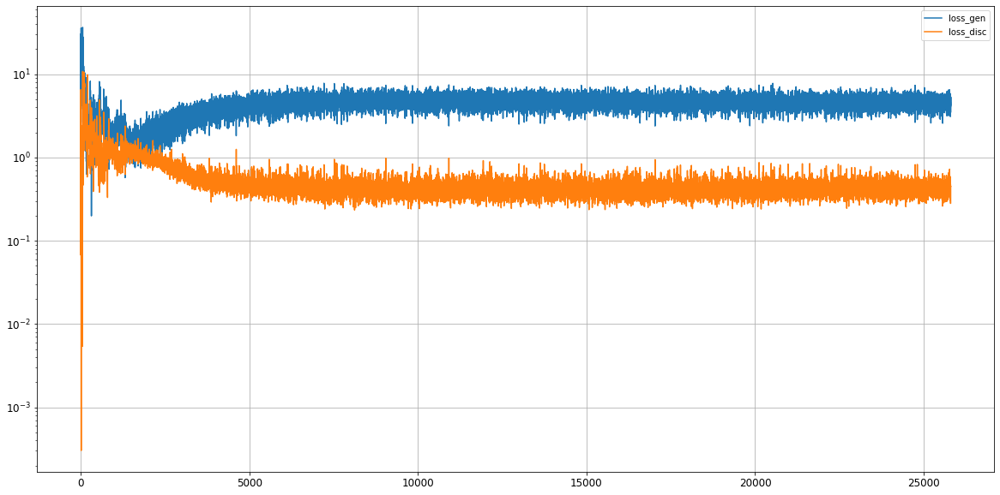

Epoch 25802/50000
0s
Epoch 25803/50000
0s
Epoch 25804/50000
0s
Epoch 25805/50000
0s
Epoch 25806/50000
0s
Epoch 25807/50000
0s
Epoch 25808/50000
0s
Epoch 25809/50000
0s
Epoch 25810/50000
0s
Epoch 25811/50000
0s
Epoch 25812/50000
0s
Epoch 25813/50000
0s
Epoch 25814/50000
0s
Epoch 25815/50000
0s
Epoch 25816/50000
0s
Epoch 25817/50000
0s
Epoch 25818/50000
0s
Epoch 25819/50000
0s
Epoch 25820/50000
0s
Epoch 25821/50000
0s
Epoch 25822/50000
0s
Epoch 25823/50000
0s
Epoch 25824/50000
0s
Epoch 25825/50000
0s
Epoch 25826/50000
0s
Epoch 25827/50000
0s
Epoch 25828/50000
0s
Epoch 25829/50000
0s
Epoch 25830/50000
0s
Epoch 25831/50000
0s
Epoch 25832/50000
0s
Epoch 25833/50000
0s
Epoch 25834/50000
0s
Epoch 25835/50000
0s
Epoch 25836/50000
0s
Epoch 25837/50000
0s
Epoch 25838/50000
0s
Epoch 25839/50000
0s
Epoch 25840/50000
0s
Epoch 25841/50000
0s
Epoch 25842/50000
0s
Epoch 25843/50000
0s
Epoch 25844/50000
0s
Epoch 25845/50000
0s
Epoch 25846/50000
0s
Epoch 25847/50000
0s
Epoch 25848/50000
0s
Epoch 25849/5

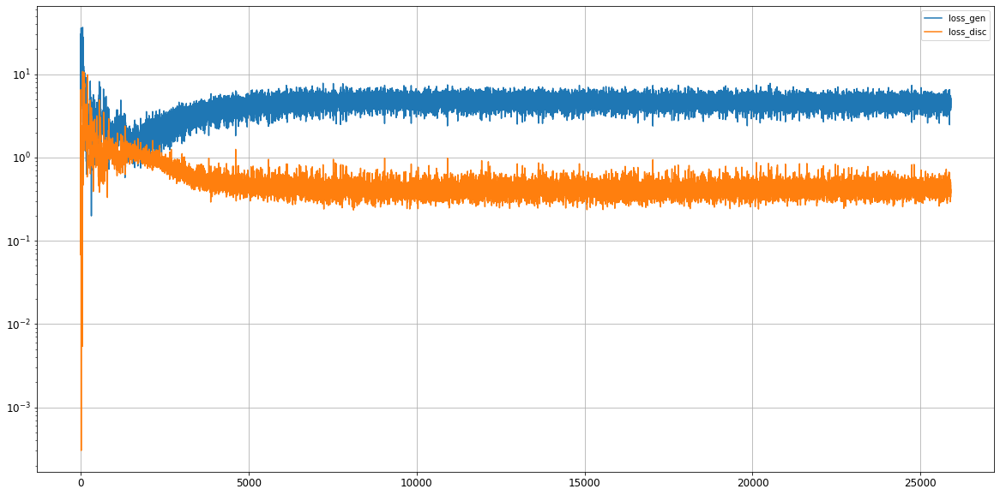

Epoch 25902/50000
0s
Epoch 25903/50000
0s
Epoch 25904/50000
0s
Epoch 25905/50000
0s
Epoch 25906/50000
0s
Epoch 25907/50000
0s
Epoch 25908/50000
0s
Epoch 25909/50000
0s
Epoch 25910/50000
0s
Epoch 25911/50000
0s
Epoch 25912/50000
0s
Epoch 25913/50000
0s
Epoch 25914/50000
0s
Epoch 25915/50000
0s
Epoch 25916/50000
0s
Epoch 25917/50000
0s
Epoch 25918/50000
0s
Epoch 25919/50000
0s
Epoch 25920/50000
0s
Epoch 25921/50000
0s
Epoch 25922/50000
0s
Epoch 25923/50000
0s
Epoch 25924/50000
0s
Epoch 25925/50000
0s
Epoch 25926/50000
0s
Epoch 25927/50000
0s
Epoch 25928/50000
0s
Epoch 25929/50000
0s
Epoch 25930/50000
0s
Epoch 25931/50000
0s
Epoch 25932/50000
0s
Epoch 25933/50000
0s
Epoch 25934/50000
0s
Epoch 25935/50000
0s
Epoch 25936/50000
0s
Epoch 25937/50000
0s
Epoch 25938/50000
0s
Epoch 25939/50000
0s
Epoch 25940/50000
0s
Epoch 25941/50000
0s
Epoch 25942/50000
0s
Epoch 25943/50000
0s
Epoch 25944/50000
0s
Epoch 25945/50000
0s
Epoch 25946/50000
0s
Epoch 25947/50000
0s
Epoch 25948/50000
0s
Epoch 25949/5

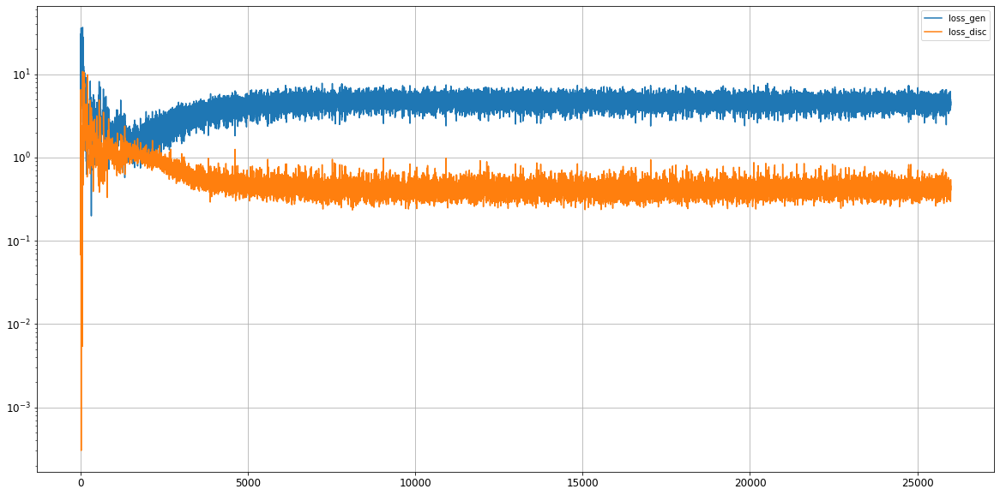

Epoch 26002/50000
0s
Epoch 26003/50000
0s
Epoch 26004/50000
0s
Epoch 26005/50000
0s
Epoch 26006/50000
0s
Epoch 26007/50000
0s
Epoch 26008/50000
0s
Epoch 26009/50000
0s
Epoch 26010/50000
0s
Epoch 26011/50000
0s
Epoch 26012/50000
0s
Epoch 26013/50000
0s
Epoch 26014/50000
0s
Epoch 26015/50000
0s
Epoch 26016/50000
0s
Epoch 26017/50000
0s
Epoch 26018/50000
0s
Epoch 26019/50000
0s
Epoch 26020/50000
0s
Epoch 26021/50000
0s
Epoch 26022/50000
0s
Epoch 26023/50000
0s
Epoch 26024/50000
0s
Epoch 26025/50000
0s
Epoch 26026/50000
0s
Epoch 26027/50000
0s
Epoch 26028/50000
0s
Epoch 26029/50000
0s
Epoch 26030/50000
0s
Epoch 26031/50000
0s
Epoch 26032/50000
0s
Epoch 26033/50000
0s
Epoch 26034/50000
0s
Epoch 26035/50000
0s
Epoch 26036/50000
0s
Epoch 26037/50000
0s
Epoch 26038/50000
0s
Epoch 26039/50000
0s
Epoch 26040/50000
0s
Epoch 26041/50000
0s
Epoch 26042/50000
0s
Epoch 26043/50000
0s
Epoch 26044/50000
0s
Epoch 26045/50000
0s
Epoch 26046/50000
0s
Epoch 26047/50000
0s
Epoch 26048/50000
0s
Epoch 26049/5

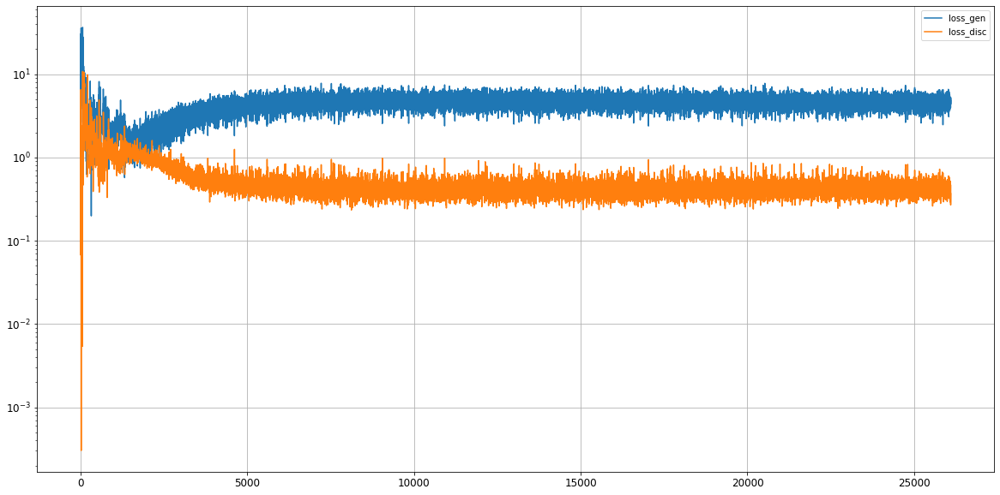

Epoch 26102/50000
0s
Epoch 26103/50000
0s
Epoch 26104/50000
0s
Epoch 26105/50000
0s
Epoch 26106/50000
0s
Epoch 26107/50000
0s
Epoch 26108/50000
0s
Epoch 26109/50000
0s
Epoch 26110/50000
0s
Epoch 26111/50000
0s
Epoch 26112/50000
0s
Epoch 26113/50000
0s
Epoch 26114/50000
0s
Epoch 26115/50000
0s
Epoch 26116/50000
0s
Epoch 26117/50000
0s
Epoch 26118/50000
0s
Epoch 26119/50000
0s
Epoch 26120/50000
0s
Epoch 26121/50000
0s
Epoch 26122/50000
0s
Epoch 26123/50000
0s
Epoch 26124/50000
0s
Epoch 26125/50000
0s
Epoch 26126/50000
0s
Epoch 26127/50000
0s
Epoch 26128/50000
0s
Epoch 26129/50000
0s
Epoch 26130/50000
0s
Epoch 26131/50000
0s
Epoch 26132/50000
0s
Epoch 26133/50000
0s
Epoch 26134/50000
0s
Epoch 26135/50000
0s
Epoch 26136/50000
0s
Epoch 26137/50000
0s
Epoch 26138/50000
0s
Epoch 26139/50000
0s
Epoch 26140/50000
0s
Epoch 26141/50000
0s
Epoch 26142/50000
0s
Epoch 26143/50000
0s
Epoch 26144/50000
0s
Epoch 26145/50000
0s
Epoch 26146/50000
0s
Epoch 26147/50000
0s
Epoch 26148/50000
0s
Epoch 26149/5

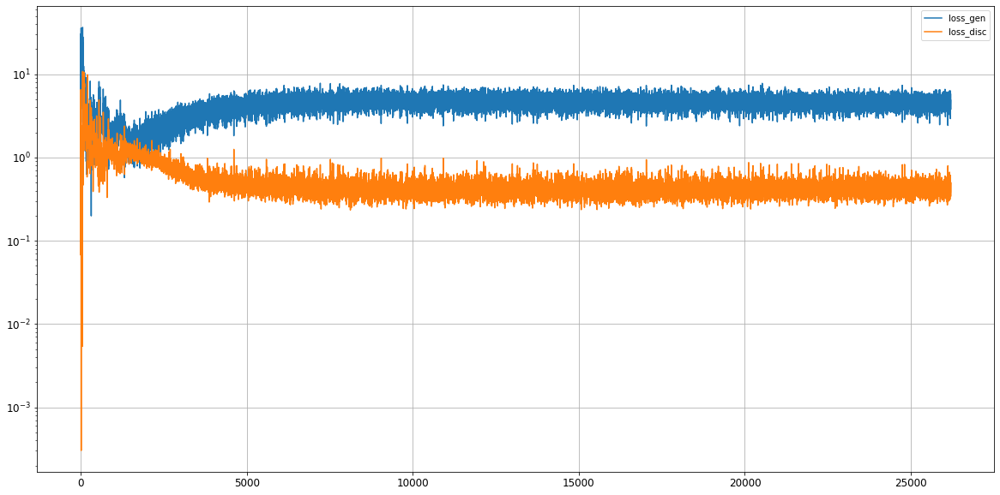

Epoch 26202/50000
0s
Epoch 26203/50000
0s
Epoch 26204/50000
0s
Epoch 26205/50000
0s
Epoch 26206/50000
0s
Epoch 26207/50000
0s
Epoch 26208/50000
0s
Epoch 26209/50000
0s
Epoch 26210/50000
0s
Epoch 26211/50000
0s
Epoch 26212/50000
0s
Epoch 26213/50000
0s
Epoch 26214/50000
0s
Epoch 26215/50000
0s
Epoch 26216/50000
0s
Epoch 26217/50000
0s
Epoch 26218/50000
0s
Epoch 26219/50000
0s
Epoch 26220/50000
0s
Epoch 26221/50000
0s
Epoch 26222/50000
0s
Epoch 26223/50000
0s
Epoch 26224/50000
0s
Epoch 26225/50000
0s
Epoch 26226/50000
0s
Epoch 26227/50000
0s
Epoch 26228/50000
0s
Epoch 26229/50000
0s
Epoch 26230/50000
0s
Epoch 26231/50000
0s
Epoch 26232/50000
0s
Epoch 26233/50000
0s
Epoch 26234/50000
0s
Epoch 26235/50000
0s
Epoch 26236/50000
0s
Epoch 26237/50000
0s
Epoch 26238/50000
0s
Epoch 26239/50000
0s
Epoch 26240/50000
0s
Epoch 26241/50000
0s
Epoch 26242/50000
0s
Epoch 26243/50000
0s
Epoch 26244/50000
0s
Epoch 26245/50000
0s
Epoch 26246/50000
0s
Epoch 26247/50000
0s
Epoch 26248/50000
0s
Epoch 26249/5

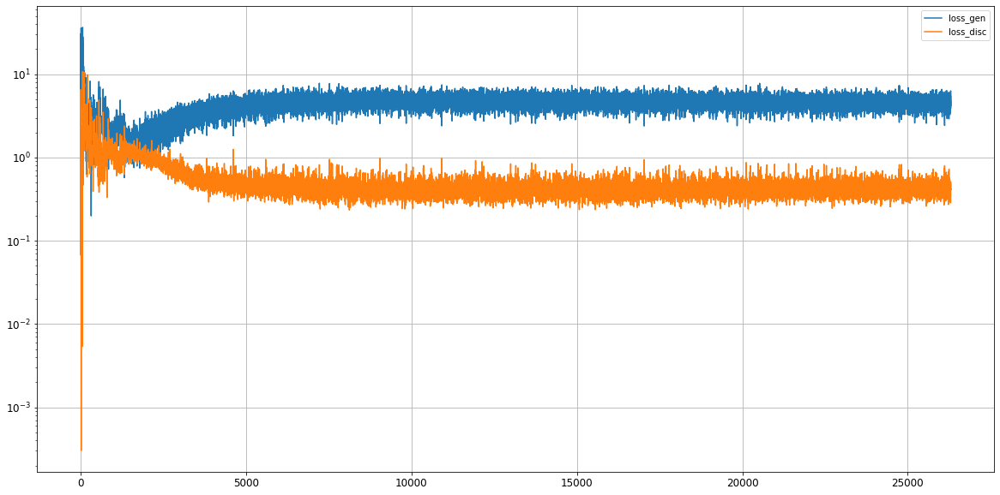

Epoch 26302/50000
0s
Epoch 26303/50000
0s
Epoch 26304/50000
0s
Epoch 26305/50000
0s
Epoch 26306/50000
0s
Epoch 26307/50000
0s
Epoch 26308/50000
0s
Epoch 26309/50000
0s
Epoch 26310/50000
0s
Epoch 26311/50000
0s
Epoch 26312/50000
0s
Epoch 26313/50000
0s
Epoch 26314/50000
0s
Epoch 26315/50000
0s
Epoch 26316/50000
0s
Epoch 26317/50000
0s
Epoch 26318/50000
0s
Epoch 26319/50000
0s
Epoch 26320/50000
0s
Epoch 26321/50000
0s
Epoch 26322/50000
0s
Epoch 26323/50000
0s
Epoch 26324/50000
0s
Epoch 26325/50000
0s
Epoch 26326/50000
0s
Epoch 26327/50000
0s
Epoch 26328/50000
0s
Epoch 26329/50000
0s
Epoch 26330/50000
0s
Epoch 26331/50000
0s
Epoch 26332/50000
0s
Epoch 26333/50000
0s
Epoch 26334/50000
0s
Epoch 26335/50000
0s
Epoch 26336/50000
0s
Epoch 26337/50000
0s
Epoch 26338/50000
0s
Epoch 26339/50000
0s
Epoch 26340/50000
0s
Epoch 26341/50000
0s
Epoch 26342/50000
0s
Epoch 26343/50000
0s
Epoch 26344/50000
0s
Epoch 26345/50000
0s
Epoch 26346/50000
0s
Epoch 26347/50000
0s
Epoch 26348/50000
0s
Epoch 26349/5

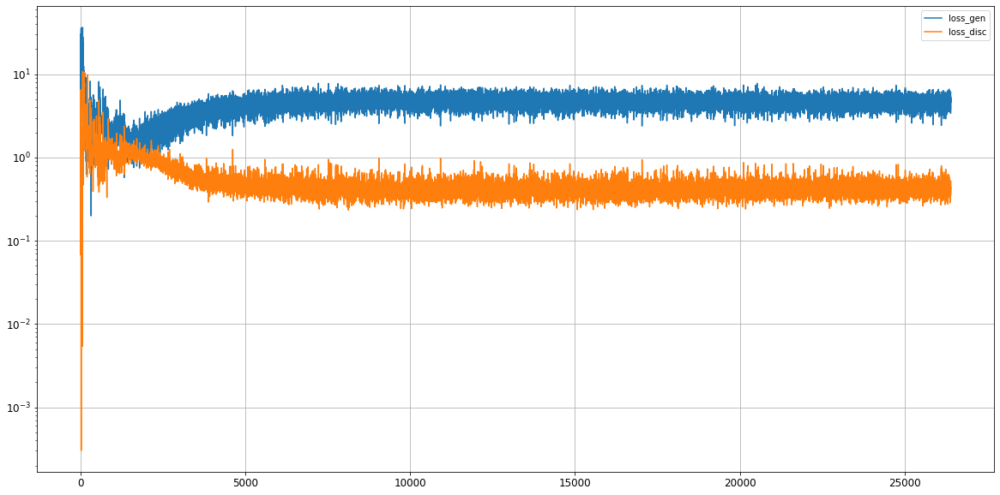

Epoch 26402/50000
0s
Epoch 26403/50000
0s
Epoch 26404/50000
0s
Epoch 26405/50000
0s
Epoch 26406/50000
0s
Epoch 26407/50000
0s
Epoch 26408/50000
0s
Epoch 26409/50000
0s
Epoch 26410/50000
0s
Epoch 26411/50000
0s
Epoch 26412/50000
0s
Epoch 26413/50000
0s
Epoch 26414/50000
0s
Epoch 26415/50000
0s
Epoch 26416/50000
0s
Epoch 26417/50000
0s
Epoch 26418/50000
0s
Epoch 26419/50000
0s
Epoch 26420/50000
0s
Epoch 26421/50000
0s
Epoch 26422/50000
0s
Epoch 26423/50000
0s
Epoch 26424/50000
0s
Epoch 26425/50000
0s
Epoch 26426/50000
0s
Epoch 26427/50000
0s
Epoch 26428/50000
0s
Epoch 26429/50000
0s
Epoch 26430/50000
0s
Epoch 26431/50000
0s
Epoch 26432/50000
0s
Epoch 26433/50000
0s
Epoch 26434/50000
0s
Epoch 26435/50000
0s
Epoch 26436/50000
0s
Epoch 26437/50000
0s
Epoch 26438/50000
0s
Epoch 26439/50000
0s
Epoch 26440/50000
0s
Epoch 26441/50000
0s
Epoch 26442/50000
0s
Epoch 26443/50000
0s
Epoch 26444/50000
0s
Epoch 26445/50000
0s
Epoch 26446/50000
0s
Epoch 26447/50000
0s
Epoch 26448/50000
0s
Epoch 26449/5

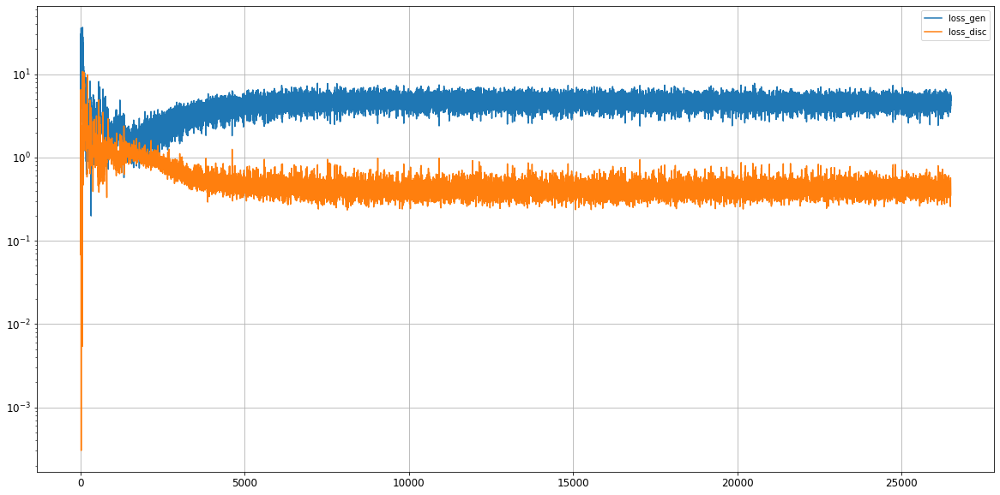

Epoch 26502/50000
0s
Epoch 26503/50000
0s
Epoch 26504/50000
0s
Epoch 26505/50000
0s
Epoch 26506/50000
0s
Epoch 26507/50000
0s
Epoch 26508/50000
0s
Epoch 26509/50000
0s
Epoch 26510/50000
0s
Epoch 26511/50000
0s
Epoch 26512/50000
0s
Epoch 26513/50000
0s
Epoch 26514/50000
0s
Epoch 26515/50000
0s
Epoch 26516/50000
0s
Epoch 26517/50000
0s
Epoch 26518/50000
0s
Epoch 26519/50000
0s
Epoch 26520/50000
0s
Epoch 26521/50000
0s
Epoch 26522/50000
0s
Epoch 26523/50000
0s
Epoch 26524/50000
0s
Epoch 26525/50000
0s
Epoch 26526/50000
0s
Epoch 26527/50000
0s
Epoch 26528/50000
0s
Epoch 26529/50000
0s
Epoch 26530/50000
0s
Epoch 26531/50000
0s
Epoch 26532/50000
0s
Epoch 26533/50000
0s
Epoch 26534/50000
0s
Epoch 26535/50000
0s
Epoch 26536/50000
0s
Epoch 26537/50000
0s
Epoch 26538/50000
0s
Epoch 26539/50000
0s
Epoch 26540/50000
0s
Epoch 26541/50000
0s
Epoch 26542/50000
0s
Epoch 26543/50000
0s
Epoch 26544/50000
0s
Epoch 26545/50000
0s
Epoch 26546/50000
0s
Epoch 26547/50000
0s
Epoch 26548/50000
0s
Epoch 26549/5

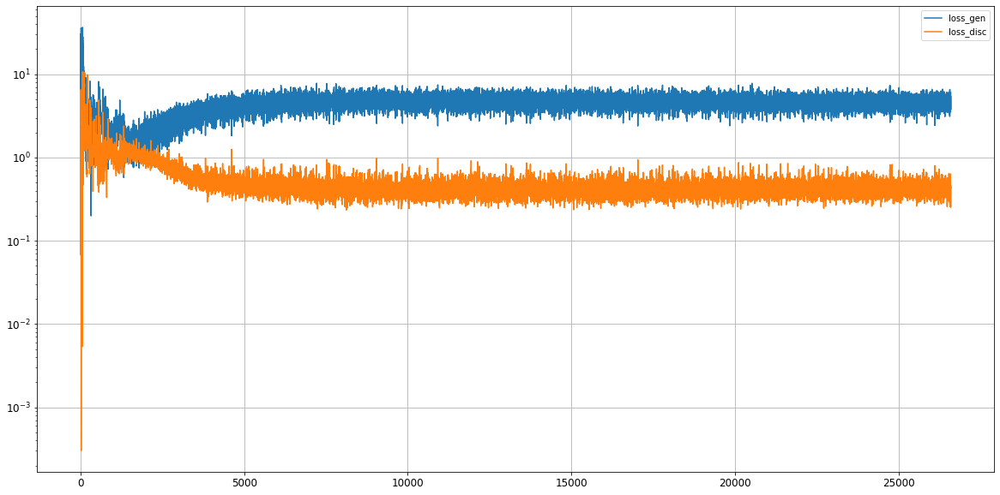

Epoch 26602/50000
0s
Epoch 26603/50000
0s
Epoch 26604/50000
0s
Epoch 26605/50000
0s
Epoch 26606/50000
0s
Epoch 26607/50000
0s
Epoch 26608/50000
0s
Epoch 26609/50000
0s
Epoch 26610/50000
0s
Epoch 26611/50000
0s
Epoch 26612/50000
0s
Epoch 26613/50000
0s
Epoch 26614/50000
0s
Epoch 26615/50000
0s
Epoch 26616/50000
0s
Epoch 26617/50000
0s
Epoch 26618/50000
0s
Epoch 26619/50000
0s
Epoch 26620/50000
0s
Epoch 26621/50000
0s
Epoch 26622/50000
0s
Epoch 26623/50000
0s
Epoch 26624/50000
0s
Epoch 26625/50000
0s
Epoch 26626/50000
0s
Epoch 26627/50000
0s
Epoch 26628/50000
0s
Epoch 26629/50000
0s
Epoch 26630/50000
0s
Epoch 26631/50000
0s
Epoch 26632/50000
0s
Epoch 26633/50000
0s
Epoch 26634/50000
0s
Epoch 26635/50000
0s
Epoch 26636/50000
0s
Epoch 26637/50000
0s
Epoch 26638/50000
0s
Epoch 26639/50000
0s
Epoch 26640/50000
0s
Epoch 26641/50000
0s
Epoch 26642/50000
0s
Epoch 26643/50000
0s
Epoch 26644/50000
0s
Epoch 26645/50000
0s
Epoch 26646/50000
0s
Epoch 26647/50000
0s
Epoch 26648/50000
0s
Epoch 26649/5

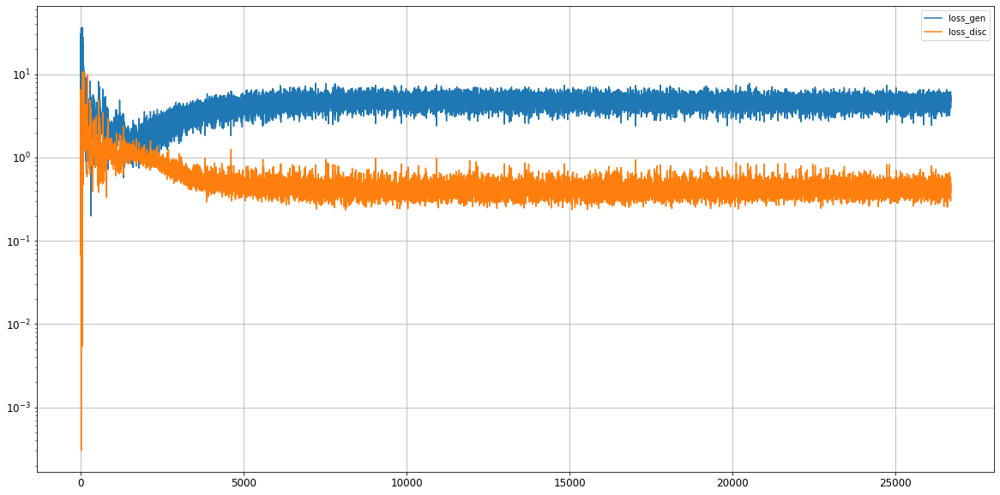

Epoch 26702/50000
0s
Epoch 26703/50000
0s
Epoch 26704/50000
0s
Epoch 26705/50000
0s
Epoch 26706/50000
0s
Epoch 26707/50000
0s
Epoch 26708/50000
0s
Epoch 26709/50000
0s
Epoch 26710/50000
0s
Epoch 26711/50000
0s
Epoch 26712/50000
0s
Epoch 26713/50000
0s
Epoch 26714/50000
0s
Epoch 26715/50000
0s
Epoch 26716/50000
0s
Epoch 26717/50000
0s
Epoch 26718/50000
0s
Epoch 26719/50000
0s
Epoch 26720/50000
0s
Epoch 26721/50000
0s
Epoch 26722/50000
0s
Epoch 26723/50000
0s
Epoch 26724/50000
0s
Epoch 26725/50000
0s
Epoch 26726/50000
0s
Epoch 26727/50000
0s
Epoch 26728/50000
0s
Epoch 26729/50000
0s
Epoch 26730/50000
0s
Epoch 26731/50000
0s
Epoch 26732/50000
0s
Epoch 26733/50000
0s
Epoch 26734/50000
0s
Epoch 26735/50000
0s
Epoch 26736/50000
0s
Epoch 26737/50000
0s
Epoch 26738/50000
0s
Epoch 26739/50000
0s
Epoch 26740/50000
0s
Epoch 26741/50000
0s
Epoch 26742/50000
0s
Epoch 26743/50000
0s
Epoch 26744/50000
0s
Epoch 26745/50000
0s
Epoch 26746/50000
0s
Epoch 26747/50000
0s
Epoch 26748/50000
0s
Epoch 26749/5

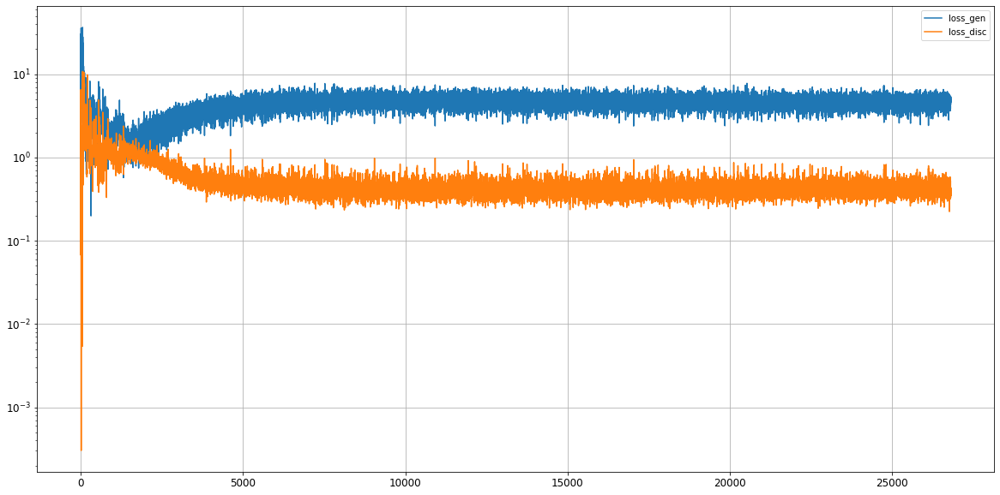

Epoch 26802/50000
0s
Epoch 26803/50000
0s
Epoch 26804/50000
0s
Epoch 26805/50000
0s
Epoch 26806/50000
0s
Epoch 26807/50000
0s
Epoch 26808/50000
0s
Epoch 26809/50000
0s
Epoch 26810/50000
0s
Epoch 26811/50000
0s
Epoch 26812/50000
0s
Epoch 26813/50000
0s
Epoch 26814/50000
0s
Epoch 26815/50000
0s
Epoch 26816/50000
0s
Epoch 26817/50000
0s
Epoch 26818/50000
0s
Epoch 26819/50000
0s
Epoch 26820/50000
0s
Epoch 26821/50000
0s
Epoch 26822/50000
0s
Epoch 26823/50000
0s
Epoch 26824/50000
0s
Epoch 26825/50000
0s
Epoch 26826/50000
0s
Epoch 26827/50000
0s
Epoch 26828/50000
0s
Epoch 26829/50000
0s
Epoch 26830/50000
0s
Epoch 26831/50000
0s
Epoch 26832/50000
0s
Epoch 26833/50000
0s
Epoch 26834/50000
0s
Epoch 26835/50000
0s
Epoch 26836/50000
0s
Epoch 26837/50000
0s
Epoch 26838/50000
0s
Epoch 26839/50000
0s
Epoch 26840/50000
0s
Epoch 26841/50000
0s
Epoch 26842/50000
0s
Epoch 26843/50000
0s
Epoch 26844/50000
0s
Epoch 26845/50000
0s
Epoch 26846/50000
0s
Epoch 26847/50000
0s
Epoch 26848/50000
0s
Epoch 26849/5

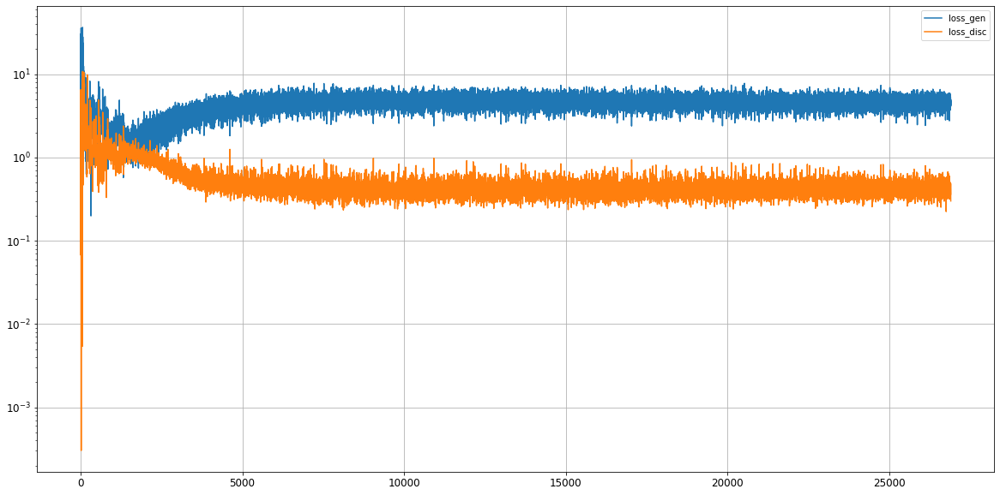

Epoch 26902/50000
0s
Epoch 26903/50000
0s
Epoch 26904/50000
0s
Epoch 26905/50000
0s
Epoch 26906/50000
0s
Epoch 26907/50000
0s
Epoch 26908/50000
0s
Epoch 26909/50000
0s
Epoch 26910/50000
0s
Epoch 26911/50000
0s
Epoch 26912/50000
0s
Epoch 26913/50000
0s
Epoch 26914/50000
0s
Epoch 26915/50000
0s
Epoch 26916/50000
0s
Epoch 26917/50000
0s
Epoch 26918/50000
0s
Epoch 26919/50000
0s
Epoch 26920/50000
0s
Epoch 26921/50000
0s
Epoch 26922/50000
0s
Epoch 26923/50000
0s
Epoch 26924/50000
0s
Epoch 26925/50000
0s
Epoch 26926/50000
0s
Epoch 26927/50000
0s
Epoch 26928/50000
0s
Epoch 26929/50000
0s
Epoch 26930/50000
0s
Epoch 26931/50000
0s
Epoch 26932/50000
0s
Epoch 26933/50000
0s
Epoch 26934/50000
0s
Epoch 26935/50000
0s
Epoch 26936/50000
0s
Epoch 26937/50000
0s
Epoch 26938/50000
0s
Epoch 26939/50000
0s
Epoch 26940/50000
0s
Epoch 26941/50000
0s
Epoch 26942/50000
0s
Epoch 26943/50000
0s
Epoch 26944/50000
0s
Epoch 26945/50000
0s
Epoch 26946/50000
0s
Epoch 26947/50000
0s
Epoch 26948/50000
0s
Epoch 26949/5

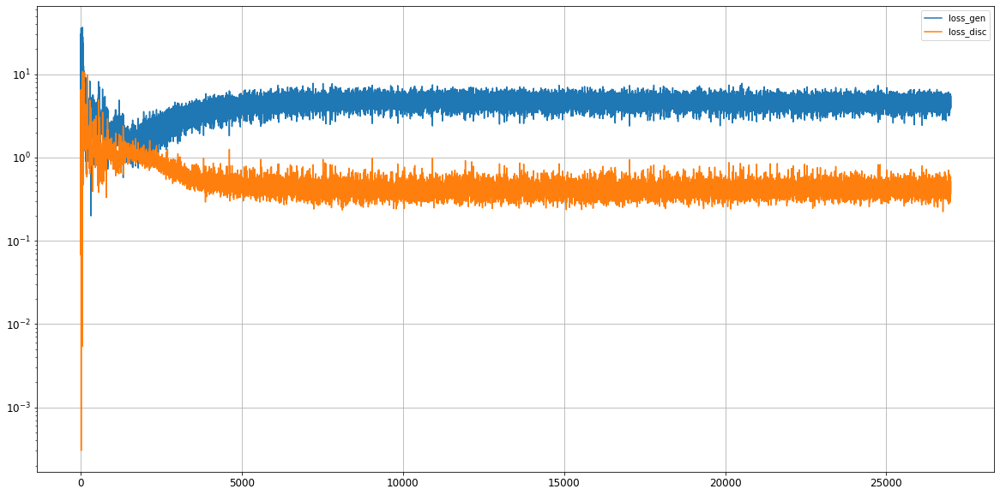

Epoch 27002/50000
0s
Epoch 27003/50000
0s
Epoch 27004/50000
0s
Epoch 27005/50000
0s
Epoch 27006/50000
0s
Epoch 27007/50000
0s
Epoch 27008/50000
0s
Epoch 27009/50000
0s
Epoch 27010/50000
0s
Epoch 27011/50000
0s
Epoch 27012/50000
0s
Epoch 27013/50000
0s
Epoch 27014/50000
0s
Epoch 27015/50000
0s
Epoch 27016/50000
0s
Epoch 27017/50000
0s
Epoch 27018/50000
0s
Epoch 27019/50000
0s
Epoch 27020/50000
0s
Epoch 27021/50000
0s
Epoch 27022/50000
0s
Epoch 27023/50000
0s
Epoch 27024/50000
0s
Epoch 27025/50000
0s
Epoch 27026/50000
0s
Epoch 27027/50000
0s
Epoch 27028/50000
0s
Epoch 27029/50000
0s
Epoch 27030/50000
0s
Epoch 27031/50000
0s
Epoch 27032/50000
0s
Epoch 27033/50000
0s
Epoch 27034/50000
0s
Epoch 27035/50000
0s
Epoch 27036/50000
0s
Epoch 27037/50000
0s
Epoch 27038/50000
0s
Epoch 27039/50000
0s
Epoch 27040/50000
0s
Epoch 27041/50000
0s
Epoch 27042/50000
0s
Epoch 27043/50000
0s
Epoch 27044/50000
0s
Epoch 27045/50000
0s
Epoch 27046/50000
0s
Epoch 27047/50000
0s
Epoch 27048/50000
0s
Epoch 27049/5

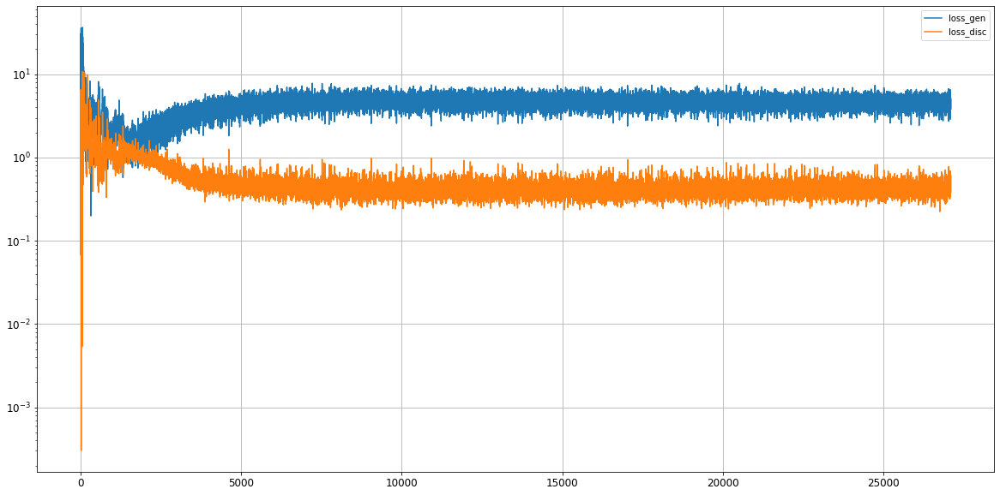

Epoch 27102/50000
0s
Epoch 27103/50000
0s
Epoch 27104/50000
0s
Epoch 27105/50000
0s
Epoch 27106/50000
0s
Epoch 27107/50000
0s
Epoch 27108/50000
0s
Epoch 27109/50000
0s
Epoch 27110/50000
0s
Epoch 27111/50000
0s
Epoch 27112/50000
0s
Epoch 27113/50000
0s
Epoch 27114/50000
0s
Epoch 27115/50000
0s
Epoch 27116/50000
0s
Epoch 27117/50000
0s
Epoch 27118/50000
0s
Epoch 27119/50000
0s
Epoch 27120/50000
0s
Epoch 27121/50000
0s
Epoch 27122/50000
0s
Epoch 27123/50000
0s
Epoch 27124/50000
0s
Epoch 27125/50000
0s
Epoch 27126/50000
0s
Epoch 27127/50000
0s
Epoch 27128/50000
0s
Epoch 27129/50000
0s
Epoch 27130/50000
0s
Epoch 27131/50000
0s
Epoch 27132/50000
0s
Epoch 27133/50000
0s
Epoch 27134/50000
0s
Epoch 27135/50000
0s
Epoch 27136/50000
0s
Epoch 27137/50000
0s
Epoch 27138/50000
0s
Epoch 27139/50000
0s
Epoch 27140/50000
0s
Epoch 27141/50000
0s
Epoch 27142/50000
0s
Epoch 27143/50000
0s
Epoch 27144/50000
0s
Epoch 27145/50000
0s
Epoch 27146/50000
0s
Epoch 27147/50000
0s
Epoch 27148/50000
0s
Epoch 27149/5

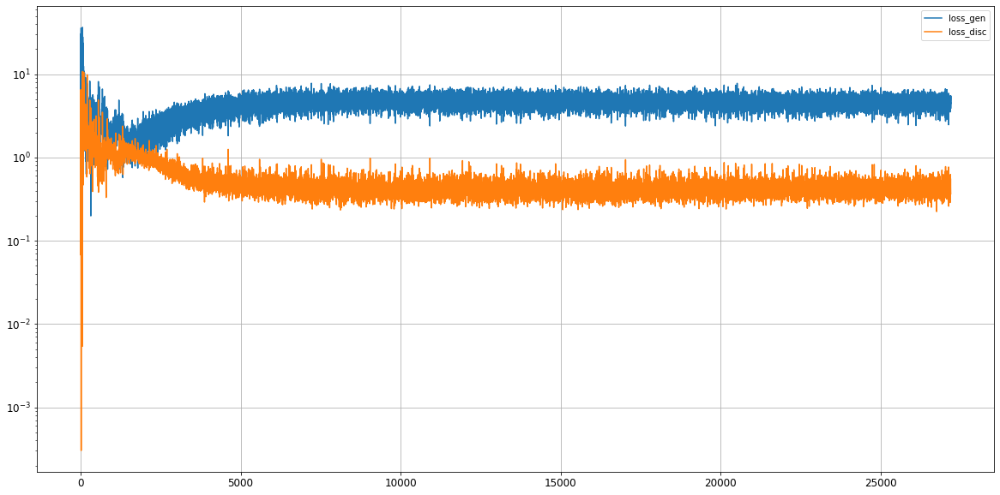

Epoch 27202/50000
0s
Epoch 27203/50000
0s
Epoch 27204/50000
0s
Epoch 27205/50000
0s
Epoch 27206/50000
0s
Epoch 27207/50000
0s
Epoch 27208/50000
0s
Epoch 27209/50000
0s
Epoch 27210/50000
0s
Epoch 27211/50000
0s
Epoch 27212/50000
0s
Epoch 27213/50000
0s
Epoch 27214/50000
0s
Epoch 27215/50000
0s
Epoch 27216/50000
0s
Epoch 27217/50000
0s
Epoch 27218/50000
0s
Epoch 27219/50000
0s
Epoch 27220/50000
0s
Epoch 27221/50000
0s
Epoch 27222/50000
0s
Epoch 27223/50000
0s
Epoch 27224/50000
0s
Epoch 27225/50000
0s
Epoch 27226/50000
0s
Epoch 27227/50000
0s
Epoch 27228/50000
0s
Epoch 27229/50000
0s
Epoch 27230/50000
0s
Epoch 27231/50000
0s
Epoch 27232/50000
0s
Epoch 27233/50000
0s
Epoch 27234/50000
0s
Epoch 27235/50000
0s
Epoch 27236/50000
0s
Epoch 27237/50000
0s
Epoch 27238/50000
0s
Epoch 27239/50000
0s
Epoch 27240/50000
0s
Epoch 27241/50000
0s
Epoch 27242/50000
0s
Epoch 27243/50000
0s
Epoch 27244/50000
0s
Epoch 27245/50000
0s
Epoch 27246/50000
0s
Epoch 27247/50000
0s
Epoch 27248/50000
0s
Epoch 27249/5

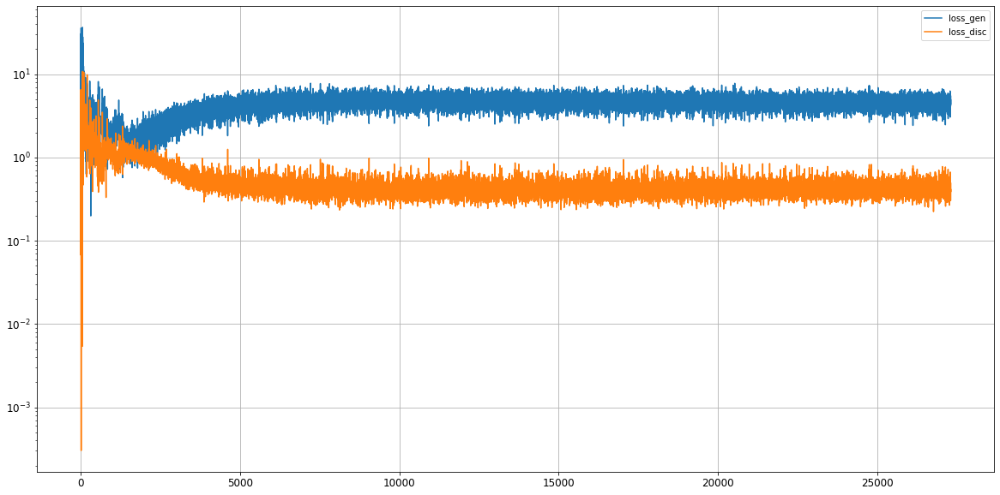

Epoch 27302/50000
0s
Epoch 27303/50000
0s
Epoch 27304/50000
0s
Epoch 27305/50000
0s
Epoch 27306/50000
0s
Epoch 27307/50000
0s
Epoch 27308/50000
0s
Epoch 27309/50000
0s
Epoch 27310/50000
0s
Epoch 27311/50000
0s
Epoch 27312/50000
0s
Epoch 27313/50000
0s
Epoch 27314/50000
0s
Epoch 27315/50000
0s
Epoch 27316/50000
0s
Epoch 27317/50000
0s
Epoch 27318/50000
0s
Epoch 27319/50000
0s
Epoch 27320/50000
0s
Epoch 27321/50000
0s
Epoch 27322/50000
0s
Epoch 27323/50000
0s
Epoch 27324/50000
0s
Epoch 27325/50000
0s
Epoch 27326/50000
0s
Epoch 27327/50000
0s
Epoch 27328/50000
0s
Epoch 27329/50000
0s
Epoch 27330/50000
0s
Epoch 27331/50000
0s
Epoch 27332/50000
0s
Epoch 27333/50000
0s
Epoch 27334/50000
0s
Epoch 27335/50000
0s
Epoch 27336/50000
0s
Epoch 27337/50000
0s
Epoch 27338/50000
0s
Epoch 27339/50000
0s
Epoch 27340/50000
0s
Epoch 27341/50000
0s
Epoch 27342/50000
0s
Epoch 27343/50000
0s
Epoch 27344/50000
0s
Epoch 27345/50000
0s
Epoch 27346/50000
0s
Epoch 27347/50000
0s
Epoch 27348/50000
0s
Epoch 27349/5

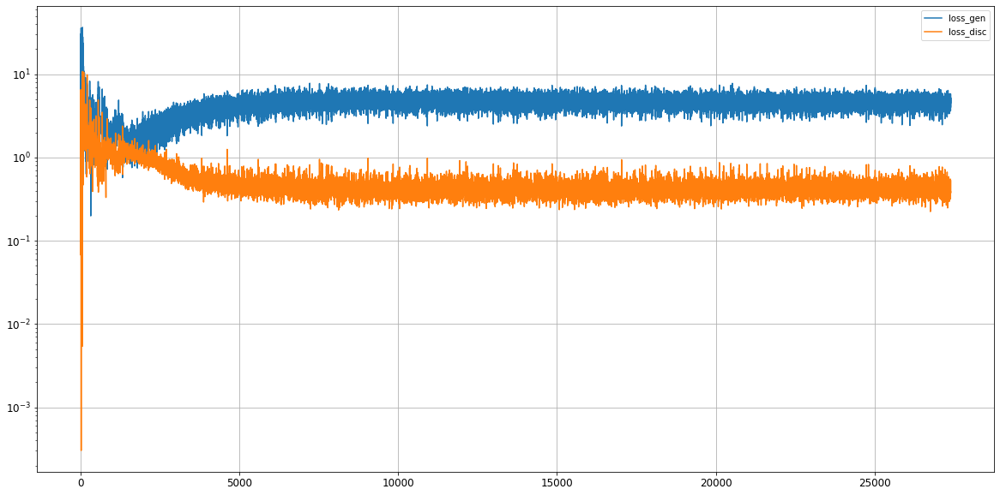

Epoch 27402/50000
0s
Epoch 27403/50000
0s
Epoch 27404/50000
0s
Epoch 27405/50000
0s
Epoch 27406/50000
0s
Epoch 27407/50000
0s
Epoch 27408/50000
0s
Epoch 27409/50000
0s
Epoch 27410/50000
0s
Epoch 27411/50000
0s
Epoch 27412/50000
0s
Epoch 27413/50000
0s
Epoch 27414/50000
0s
Epoch 27415/50000
0s
Epoch 27416/50000
0s
Epoch 27417/50000
0s
Epoch 27418/50000
0s
Epoch 27419/50000
0s
Epoch 27420/50000
0s
Epoch 27421/50000
0s
Epoch 27422/50000
0s
Epoch 27423/50000
0s
Epoch 27424/50000
0s
Epoch 27425/50000
0s
Epoch 27426/50000
0s
Epoch 27427/50000
0s
Epoch 27428/50000
0s
Epoch 27429/50000
0s
Epoch 27430/50000
0s
Epoch 27431/50000
0s
Epoch 27432/50000
0s
Epoch 27433/50000
0s
Epoch 27434/50000
0s
Epoch 27435/50000
0s
Epoch 27436/50000
0s
Epoch 27437/50000
0s
Epoch 27438/50000
0s
Epoch 27439/50000
0s
Epoch 27440/50000
0s
Epoch 27441/50000
0s
Epoch 27442/50000
0s
Epoch 27443/50000
0s
Epoch 27444/50000
0s
Epoch 27445/50000
0s
Epoch 27446/50000
0s
Epoch 27447/50000
0s
Epoch 27448/50000
0s
Epoch 27449/5

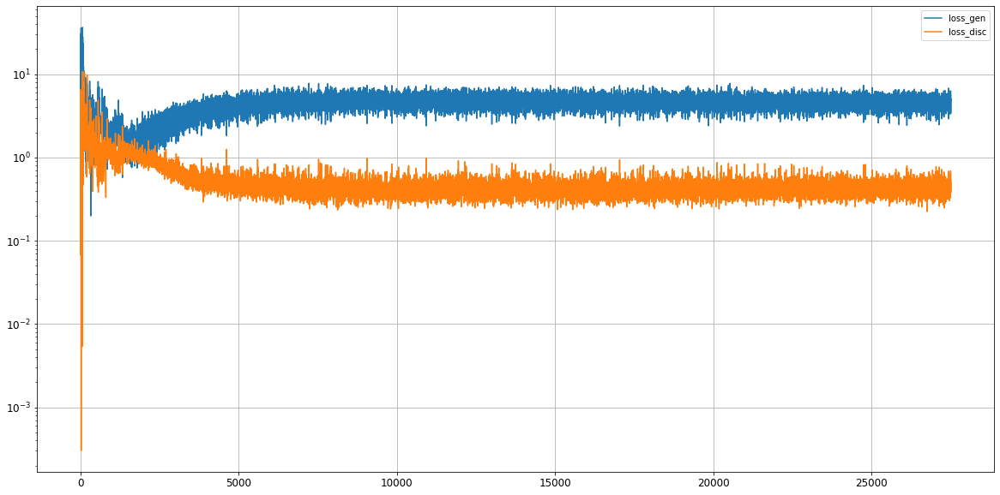

Epoch 27502/50000
0s
Epoch 27503/50000
0s
Epoch 27504/50000
0s
Epoch 27505/50000
0s
Epoch 27506/50000
0s
Epoch 27507/50000
0s
Epoch 27508/50000
0s
Epoch 27509/50000
0s
Epoch 27510/50000
0s
Epoch 27511/50000
0s
Epoch 27512/50000
0s
Epoch 27513/50000
0s
Epoch 27514/50000
0s
Epoch 27515/50000
0s
Epoch 27516/50000
0s
Epoch 27517/50000
0s
Epoch 27518/50000
0s
Epoch 27519/50000
0s
Epoch 27520/50000
0s
Epoch 27521/50000
0s
Epoch 27522/50000
0s
Epoch 27523/50000
0s
Epoch 27524/50000
0s
Epoch 27525/50000
0s
Epoch 27526/50000
0s
Epoch 27527/50000
0s
Epoch 27528/50000
0s
Epoch 27529/50000
0s
Epoch 27530/50000
0s
Epoch 27531/50000
0s
Epoch 27532/50000
0s
Epoch 27533/50000
0s
Epoch 27534/50000
0s
Epoch 27535/50000
0s
Epoch 27536/50000
0s
Epoch 27537/50000
0s
Epoch 27538/50000
0s
Epoch 27539/50000
0s
Epoch 27540/50000
0s
Epoch 27541/50000
0s
Epoch 27542/50000
0s
Epoch 27543/50000
0s
Epoch 27544/50000
0s
Epoch 27545/50000
0s
Epoch 27546/50000
0s
Epoch 27547/50000
0s
Epoch 27548/50000
0s
Epoch 27549/5

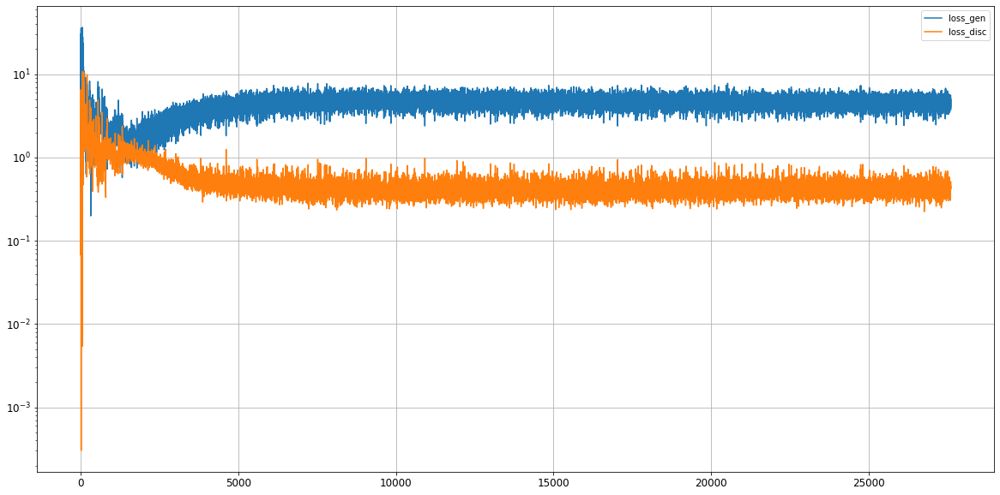

Epoch 27602/50000
0s
Epoch 27603/50000
0s
Epoch 27604/50000
0s
Epoch 27605/50000
0s
Epoch 27606/50000
0s
Epoch 27607/50000
0s
Epoch 27608/50000
0s
Epoch 27609/50000
0s
Epoch 27610/50000
0s
Epoch 27611/50000
0s
Epoch 27612/50000
0s
Epoch 27613/50000
0s
Epoch 27614/50000
0s
Epoch 27615/50000
0s
Epoch 27616/50000
0s
Epoch 27617/50000
0s
Epoch 27618/50000
0s
Epoch 27619/50000
0s
Epoch 27620/50000
0s
Epoch 27621/50000
0s
Epoch 27622/50000
0s
Epoch 27623/50000
0s
Epoch 27624/50000
0s
Epoch 27625/50000
0s
Epoch 27626/50000
0s
Epoch 27627/50000
0s
Epoch 27628/50000
0s
Epoch 27629/50000
0s
Epoch 27630/50000
0s
Epoch 27631/50000
0s
Epoch 27632/50000
0s
Epoch 27633/50000
0s
Epoch 27634/50000
0s
Epoch 27635/50000
0s
Epoch 27636/50000
0s
Epoch 27637/50000
0s
Epoch 27638/50000
0s
Epoch 27639/50000
0s
Epoch 27640/50000
0s
Epoch 27641/50000
0s
Epoch 27642/50000
0s
Epoch 27643/50000
0s
Epoch 27644/50000
0s
Epoch 27645/50000
0s
Epoch 27646/50000
0s
Epoch 27647/50000
0s
Epoch 27648/50000
0s
Epoch 27649/5

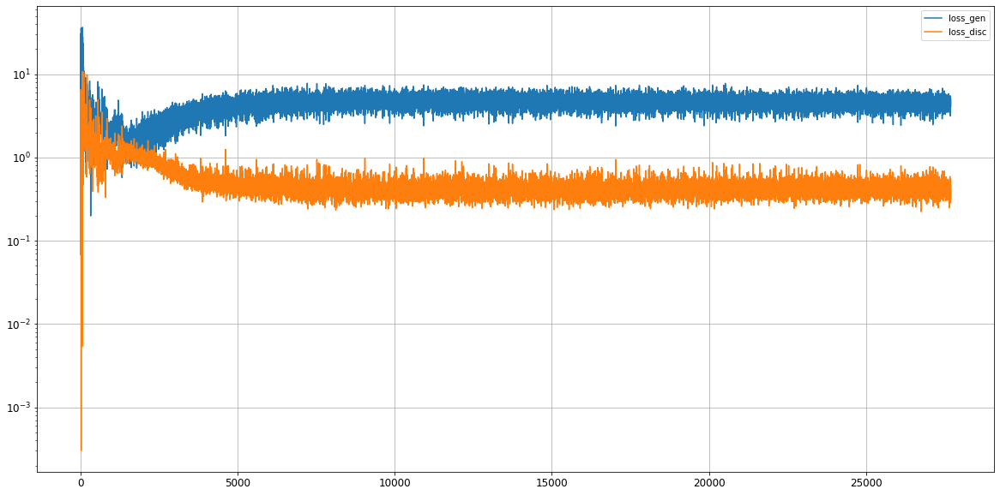

Epoch 27702/50000
0s
Epoch 27703/50000
0s
Epoch 27704/50000
0s
Epoch 27705/50000
0s
Epoch 27706/50000
0s
Epoch 27707/50000
0s
Epoch 27708/50000
0s
Epoch 27709/50000
0s
Epoch 27710/50000
0s
Epoch 27711/50000
0s
Epoch 27712/50000
0s
Epoch 27713/50000
0s
Epoch 27714/50000
0s
Epoch 27715/50000
0s
Epoch 27716/50000
0s
Epoch 27717/50000
0s
Epoch 27718/50000
0s
Epoch 27719/50000
0s
Epoch 27720/50000
0s
Epoch 27721/50000
0s
Epoch 27722/50000
0s
Epoch 27723/50000
0s
Epoch 27724/50000
0s
Epoch 27725/50000
0s
Epoch 27726/50000
0s
Epoch 27727/50000
0s
Epoch 27728/50000
0s
Epoch 27729/50000
0s
Epoch 27730/50000
0s
Epoch 27731/50000
0s
Epoch 27732/50000
0s
Epoch 27733/50000
0s
Epoch 27734/50000
0s
Epoch 27735/50000
0s
Epoch 27736/50000
0s
Epoch 27737/50000
0s
Epoch 27738/50000
0s
Epoch 27739/50000
0s
Epoch 27740/50000
0s
Epoch 27741/50000
0s
Epoch 27742/50000
0s
Epoch 27743/50000
0s
Epoch 27744/50000
0s
Epoch 27745/50000
0s
Epoch 27746/50000
0s
Epoch 27747/50000
0s
Epoch 27748/50000
0s
Epoch 27749/5

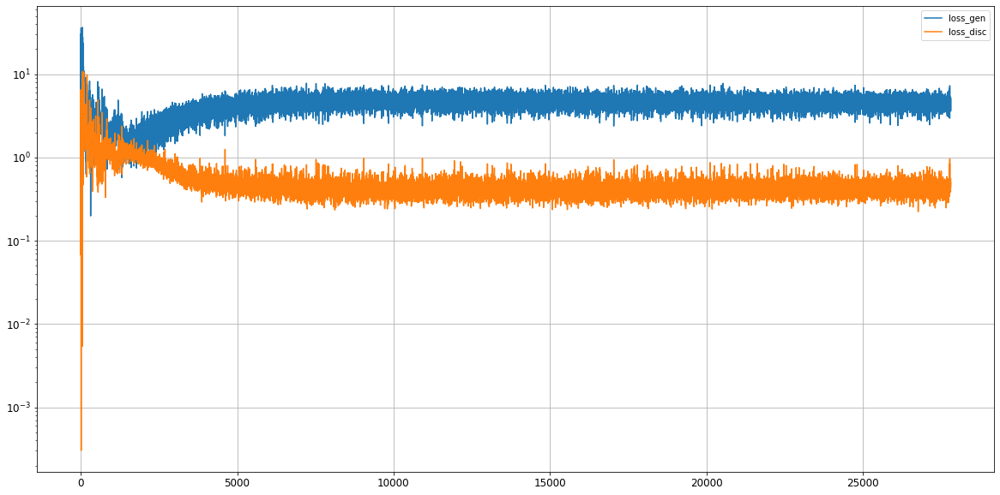

Epoch 27802/50000
0s
Epoch 27803/50000
0s
Epoch 27804/50000
0s
Epoch 27805/50000
0s
Epoch 27806/50000
0s
Epoch 27807/50000
0s
Epoch 27808/50000
0s
Epoch 27809/50000
0s
Epoch 27810/50000
0s
Epoch 27811/50000
0s
Epoch 27812/50000
0s
Epoch 27813/50000
0s
Epoch 27814/50000
0s
Epoch 27815/50000
0s
Epoch 27816/50000
0s
Epoch 27817/50000
0s
Epoch 27818/50000
0s
Epoch 27819/50000
0s
Epoch 27820/50000
0s
Epoch 27821/50000
0s
Epoch 27822/50000
0s
Epoch 27823/50000
0s
Epoch 27824/50000
0s
Epoch 27825/50000
0s
Epoch 27826/50000
0s
Epoch 27827/50000
0s
Epoch 27828/50000
0s
Epoch 27829/50000
0s
Epoch 27830/50000
0s
Epoch 27831/50000
0s
Epoch 27832/50000
0s
Epoch 27833/50000
0s
Epoch 27834/50000
0s
Epoch 27835/50000
0s
Epoch 27836/50000
0s
Epoch 27837/50000
0s
Epoch 27838/50000
0s
Epoch 27839/50000
0s
Epoch 27840/50000
0s
Epoch 27841/50000
0s
Epoch 27842/50000
0s
Epoch 27843/50000
0s
Epoch 27844/50000
0s
Epoch 27845/50000
0s
Epoch 27846/50000
0s
Epoch 27847/50000
0s
Epoch 27848/50000
0s
Epoch 27849/5

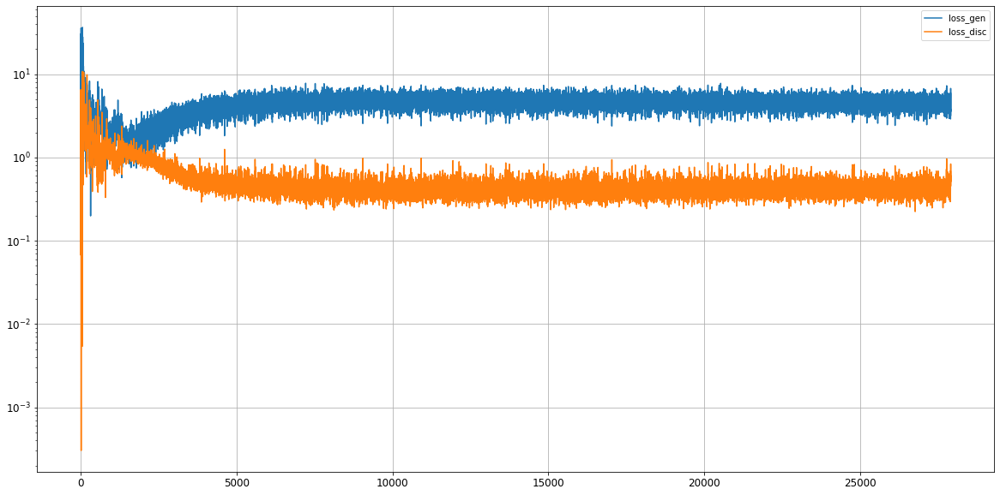

Epoch 27902/50000
0s
Epoch 27903/50000
0s
Epoch 27904/50000
0s
Epoch 27905/50000
0s
Epoch 27906/50000
0s
Epoch 27907/50000
0s
Epoch 27908/50000
0s
Epoch 27909/50000
0s
Epoch 27910/50000
0s
Epoch 27911/50000
0s
Epoch 27912/50000
0s
Epoch 27913/50000
0s
Epoch 27914/50000
0s
Epoch 27915/50000
0s
Epoch 27916/50000
0s
Epoch 27917/50000
0s
Epoch 27918/50000
0s
Epoch 27919/50000
0s
Epoch 27920/50000
0s
Epoch 27921/50000
0s
Epoch 27922/50000
0s
Epoch 27923/50000
0s
Epoch 27924/50000
0s
Epoch 27925/50000
0s
Epoch 27926/50000
0s
Epoch 27927/50000
0s
Epoch 27928/50000
0s
Epoch 27929/50000
0s
Epoch 27930/50000
0s
Epoch 27931/50000
0s
Epoch 27932/50000
0s
Epoch 27933/50000
0s
Epoch 27934/50000
0s
Epoch 27935/50000
0s
Epoch 27936/50000
0s
Epoch 27937/50000
0s
Epoch 27938/50000
0s
Epoch 27939/50000
0s
Epoch 27940/50000
0s
Epoch 27941/50000
0s
Epoch 27942/50000
0s
Epoch 27943/50000
0s
Epoch 27944/50000
0s
Epoch 27945/50000
0s
Epoch 27946/50000
0s
Epoch 27947/50000
0s
Epoch 27948/50000
0s
Epoch 27949/5

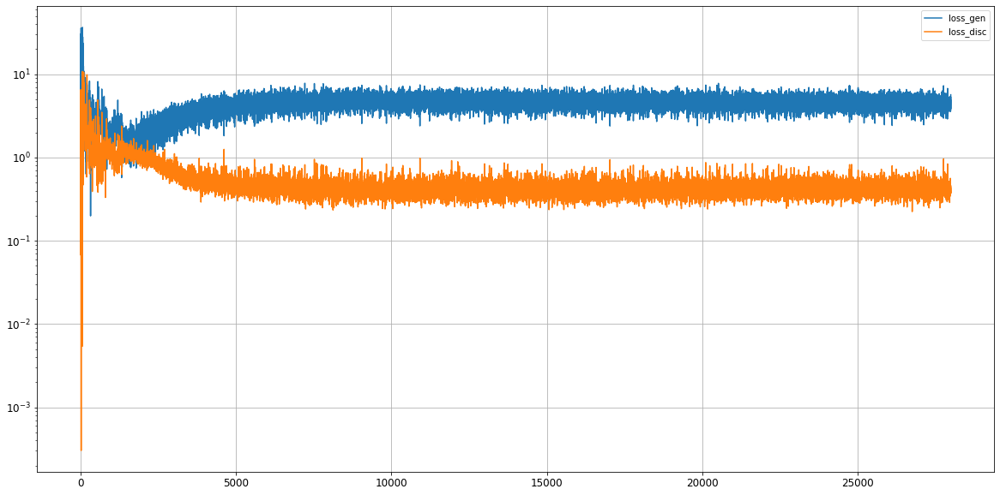

Epoch 28002/50000
0s
Epoch 28003/50000
0s
Epoch 28004/50000
0s
Epoch 28005/50000
0s
Epoch 28006/50000
0s
Epoch 28007/50000
0s
Epoch 28008/50000
0s
Epoch 28009/50000
0s
Epoch 28010/50000
0s
Epoch 28011/50000
0s
Epoch 28012/50000
0s
Epoch 28013/50000
0s
Epoch 28014/50000
0s
Epoch 28015/50000
0s
Epoch 28016/50000
0s
Epoch 28017/50000
0s
Epoch 28018/50000
0s
Epoch 28019/50000
0s
Epoch 28020/50000
0s
Epoch 28021/50000
0s
Epoch 28022/50000
0s
Epoch 28023/50000
0s
Epoch 28024/50000
0s
Epoch 28025/50000
0s
Epoch 28026/50000
0s
Epoch 28027/50000
0s
Epoch 28028/50000
0s
Epoch 28029/50000
0s
Epoch 28030/50000
0s
Epoch 28031/50000
0s
Epoch 28032/50000
0s
Epoch 28033/50000
0s
Epoch 28034/50000
0s
Epoch 28035/50000
0s
Epoch 28036/50000
0s
Epoch 28037/50000
0s
Epoch 28038/50000
0s
Epoch 28039/50000
0s
Epoch 28040/50000
0s
Epoch 28041/50000
0s
Epoch 28042/50000
0s
Epoch 28043/50000
0s
Epoch 28044/50000
0s
Epoch 28045/50000
0s
Epoch 28046/50000
0s
Epoch 28047/50000
0s
Epoch 28048/50000
0s
Epoch 28049/5

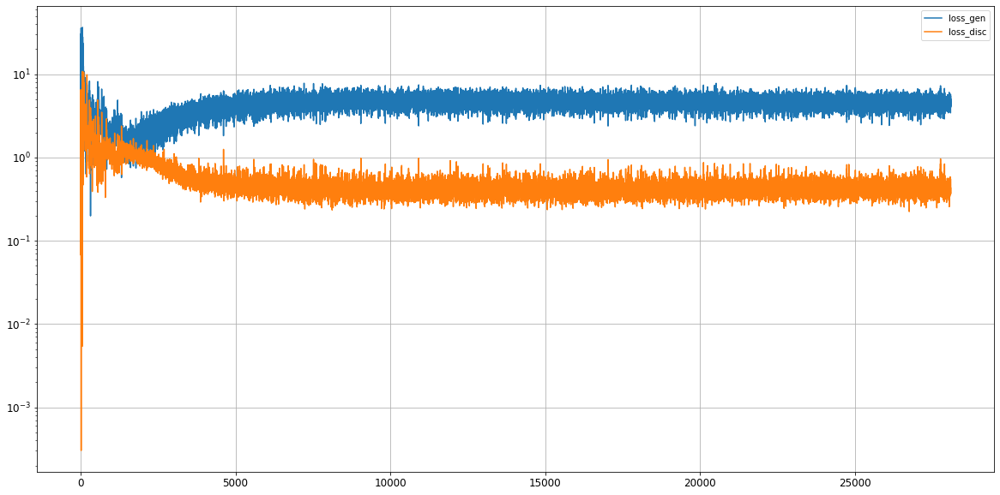

Epoch 28102/50000
0s
Epoch 28103/50000
0s
Epoch 28104/50000
0s
Epoch 28105/50000
0s
Epoch 28106/50000
0s
Epoch 28107/50000
0s
Epoch 28108/50000
0s
Epoch 28109/50000
0s
Epoch 28110/50000
0s
Epoch 28111/50000
0s
Epoch 28112/50000
0s
Epoch 28113/50000
0s
Epoch 28114/50000
0s
Epoch 28115/50000
0s
Epoch 28116/50000
0s
Epoch 28117/50000
0s
Epoch 28118/50000
0s
Epoch 28119/50000
0s
Epoch 28120/50000
0s
Epoch 28121/50000
0s
Epoch 28122/50000
0s
Epoch 28123/50000
0s
Epoch 28124/50000
0s
Epoch 28125/50000
0s
Epoch 28126/50000
0s
Epoch 28127/50000
0s
Epoch 28128/50000
0s
Epoch 28129/50000
0s
Epoch 28130/50000
0s
Epoch 28131/50000
0s
Epoch 28132/50000
0s
Epoch 28133/50000
0s
Epoch 28134/50000
0s
Epoch 28135/50000
0s
Epoch 28136/50000
0s
Epoch 28137/50000
0s
Epoch 28138/50000
0s
Epoch 28139/50000
0s
Epoch 28140/50000
0s
Epoch 28141/50000
0s
Epoch 28142/50000
0s
Epoch 28143/50000
0s
Epoch 28144/50000
0s
Epoch 28145/50000
0s
Epoch 28146/50000
0s
Epoch 28147/50000
0s
Epoch 28148/50000
0s
Epoch 28149/5

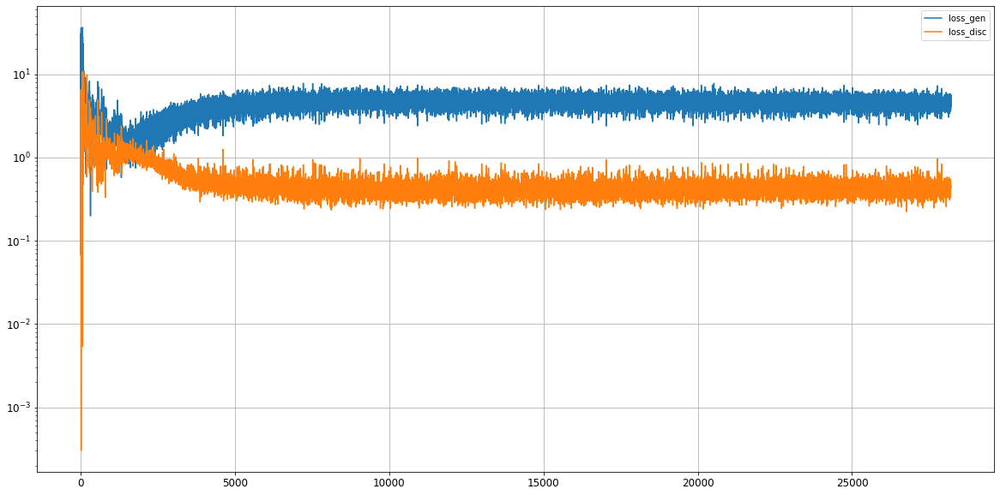

Epoch 28202/50000
0s
Epoch 28203/50000
0s
Epoch 28204/50000
0s
Epoch 28205/50000
0s
Epoch 28206/50000
0s
Epoch 28207/50000
0s
Epoch 28208/50000
0s
Epoch 28209/50000
0s
Epoch 28210/50000
0s
Epoch 28211/50000
0s
Epoch 28212/50000
0s
Epoch 28213/50000
0s
Epoch 28214/50000
0s
Epoch 28215/50000
0s
Epoch 28216/50000
0s
Epoch 28217/50000
0s
Epoch 28218/50000
0s
Epoch 28219/50000
0s
Epoch 28220/50000
0s
Epoch 28221/50000
0s
Epoch 28222/50000
0s
Epoch 28223/50000
0s
Epoch 28224/50000
0s
Epoch 28225/50000
0s
Epoch 28226/50000
0s
Epoch 28227/50000
0s
Epoch 28228/50000
0s
Epoch 28229/50000
0s
Epoch 28230/50000
0s
Epoch 28231/50000
0s
Epoch 28232/50000
0s
Epoch 28233/50000
0s
Epoch 28234/50000
0s
Epoch 28235/50000
0s
Epoch 28236/50000
0s
Epoch 28237/50000
0s
Epoch 28238/50000
0s
Epoch 28239/50000
0s
Epoch 28240/50000
0s
Epoch 28241/50000
0s
Epoch 28242/50000
0s
Epoch 28243/50000
0s
Epoch 28244/50000
0s
Epoch 28245/50000
0s
Epoch 28246/50000
0s
Epoch 28247/50000
0s
Epoch 28248/50000
0s
Epoch 28249/5

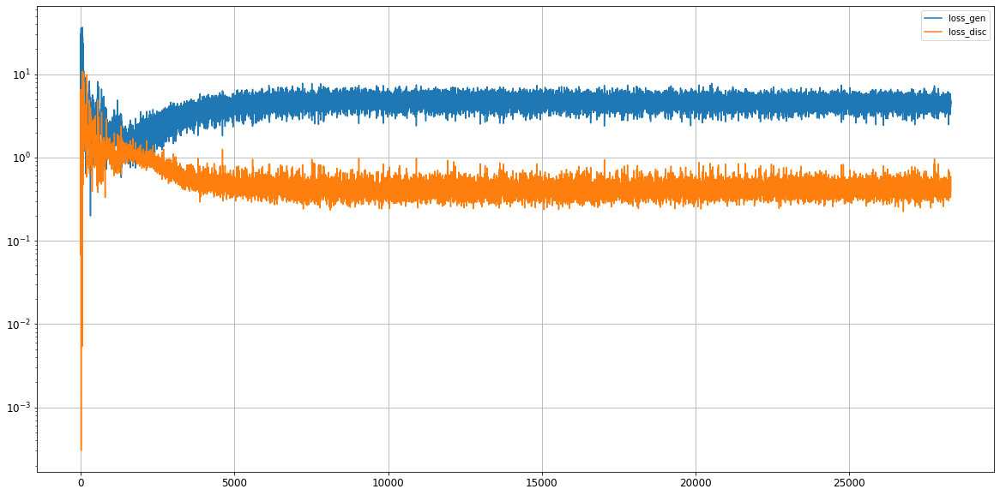

Epoch 28302/50000
0s
Epoch 28303/50000
0s
Epoch 28304/50000
0s
Epoch 28305/50000
0s
Epoch 28306/50000
0s
Epoch 28307/50000
0s
Epoch 28308/50000
0s
Epoch 28309/50000
0s
Epoch 28310/50000
0s
Epoch 28311/50000
0s
Epoch 28312/50000
0s
Epoch 28313/50000
0s
Epoch 28314/50000
0s
Epoch 28315/50000
0s
Epoch 28316/50000
0s
Epoch 28317/50000
0s
Epoch 28318/50000
0s
Epoch 28319/50000
0s
Epoch 28320/50000
0s
Epoch 28321/50000
0s
Epoch 28322/50000
0s
Epoch 28323/50000
0s
Epoch 28324/50000
0s
Epoch 28325/50000
0s
Epoch 28326/50000
0s
Epoch 28327/50000
0s
Epoch 28328/50000
0s
Epoch 28329/50000
0s
Epoch 28330/50000
0s
Epoch 28331/50000
0s
Epoch 28332/50000
0s
Epoch 28333/50000
0s
Epoch 28334/50000
0s
Epoch 28335/50000
0s
Epoch 28336/50000
0s
Epoch 28337/50000
0s
Epoch 28338/50000
0s
Epoch 28339/50000
0s
Epoch 28340/50000
0s
Epoch 28341/50000
0s
Epoch 28342/50000
0s
Epoch 28343/50000
0s
Epoch 28344/50000
0s
Epoch 28345/50000
0s
Epoch 28346/50000
0s
Epoch 28347/50000
0s
Epoch 28348/50000
0s
Epoch 28349/5

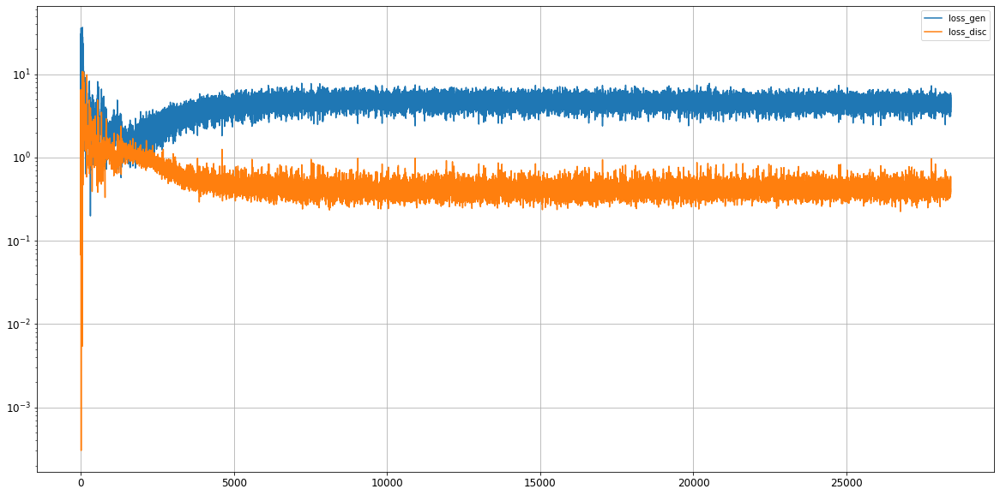

Epoch 28402/50000
0s
Epoch 28403/50000
0s
Epoch 28404/50000
0s
Epoch 28405/50000
0s
Epoch 28406/50000
0s
Epoch 28407/50000
0s
Epoch 28408/50000
0s
Epoch 28409/50000
0s
Epoch 28410/50000
0s
Epoch 28411/50000
0s
Epoch 28412/50000
0s
Epoch 28413/50000
0s
Epoch 28414/50000
0s
Epoch 28415/50000
0s
Epoch 28416/50000
0s
Epoch 28417/50000
0s
Epoch 28418/50000
0s
Epoch 28419/50000
0s
Epoch 28420/50000
0s
Epoch 28421/50000
0s
Epoch 28422/50000
0s
Epoch 28423/50000
0s
Epoch 28424/50000
0s
Epoch 28425/50000
0s
Epoch 28426/50000
0s
Epoch 28427/50000
0s
Epoch 28428/50000
0s
Epoch 28429/50000
0s
Epoch 28430/50000
0s
Epoch 28431/50000
0s
Epoch 28432/50000
0s
Epoch 28433/50000
0s
Epoch 28434/50000
0s
Epoch 28435/50000
0s
Epoch 28436/50000
0s
Epoch 28437/50000
0s
Epoch 28438/50000
0s
Epoch 28439/50000
0s
Epoch 28440/50000
0s
Epoch 28441/50000
0s
Epoch 28442/50000
0s
Epoch 28443/50000
0s
Epoch 28444/50000
0s
Epoch 28445/50000
0s
Epoch 28446/50000
0s
Epoch 28447/50000
0s
Epoch 28448/50000
0s
Epoch 28449/5

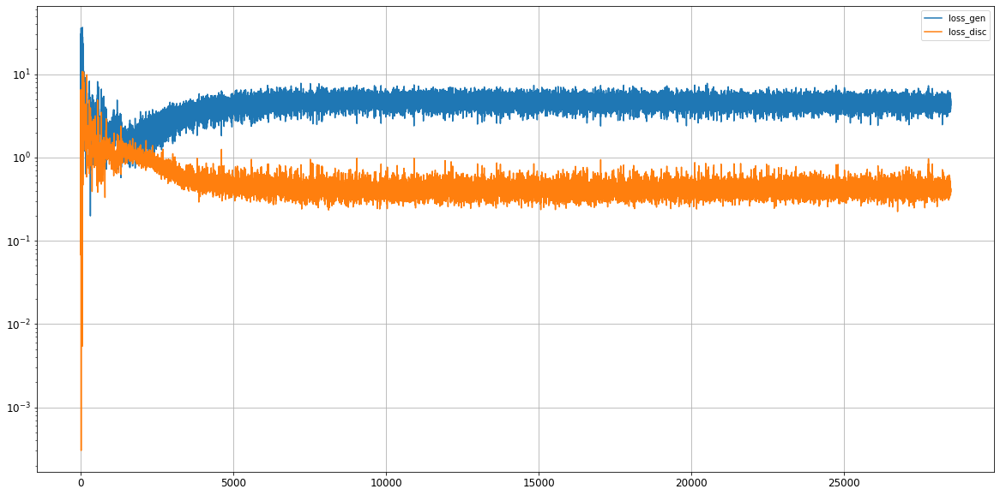

Epoch 28502/50000
0s
Epoch 28503/50000
0s
Epoch 28504/50000
0s
Epoch 28505/50000
0s
Epoch 28506/50000
0s
Epoch 28507/50000
0s
Epoch 28508/50000
0s
Epoch 28509/50000
0s
Epoch 28510/50000
0s
Epoch 28511/50000
0s
Epoch 28512/50000
0s
Epoch 28513/50000
0s
Epoch 28514/50000
0s
Epoch 28515/50000
0s
Epoch 28516/50000
0s
Epoch 28517/50000
0s
Epoch 28518/50000
0s
Epoch 28519/50000
0s
Epoch 28520/50000
0s
Epoch 28521/50000
0s
Epoch 28522/50000
0s
Epoch 28523/50000
0s
Epoch 28524/50000
0s
Epoch 28525/50000
0s
Epoch 28526/50000
0s
Epoch 28527/50000
0s
Epoch 28528/50000
0s
Epoch 28529/50000
0s
Epoch 28530/50000
0s
Epoch 28531/50000
0s
Epoch 28532/50000
0s
Epoch 28533/50000
0s
Epoch 28534/50000
0s
Epoch 28535/50000
0s
Epoch 28536/50000
0s
Epoch 28537/50000
0s
Epoch 28538/50000
0s
Epoch 28539/50000
0s
Epoch 28540/50000
0s
Epoch 28541/50000
0s
Epoch 28542/50000
0s
Epoch 28543/50000
0s
Epoch 28544/50000
0s
Epoch 28545/50000
0s
Epoch 28546/50000
0s
Epoch 28547/50000
0s
Epoch 28548/50000
0s
Epoch 28549/5

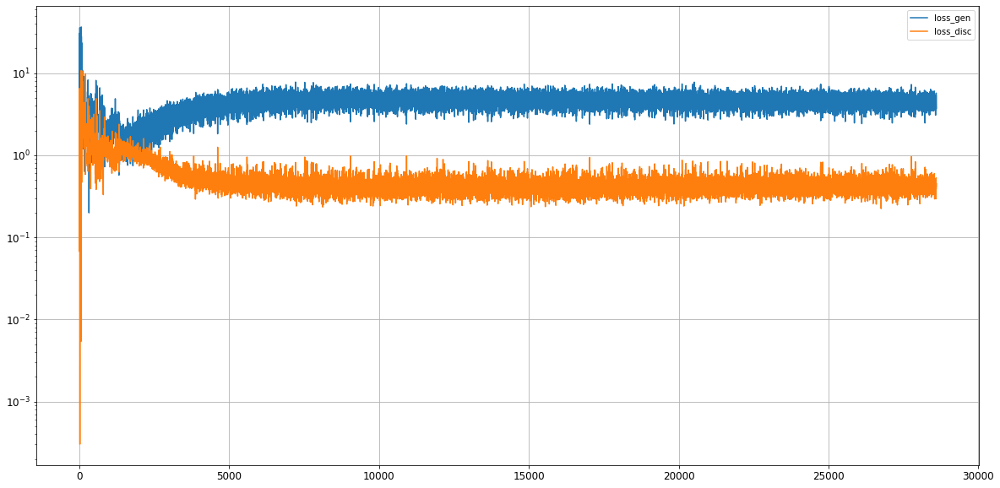

Epoch 28602/50000
0s
Epoch 28603/50000
0s
Epoch 28604/50000
0s
Epoch 28605/50000
0s
Epoch 28606/50000
0s
Epoch 28607/50000
0s
Epoch 28608/50000
0s
Epoch 28609/50000
0s
Epoch 28610/50000
0s
Epoch 28611/50000
0s
Epoch 28612/50000
0s
Epoch 28613/50000
0s
Epoch 28614/50000
0s
Epoch 28615/50000
0s
Epoch 28616/50000
0s
Epoch 28617/50000
0s
Epoch 28618/50000
0s
Epoch 28619/50000
0s
Epoch 28620/50000
0s
Epoch 28621/50000
0s
Epoch 28622/50000
0s
Epoch 28623/50000
0s
Epoch 28624/50000
0s
Epoch 28625/50000
0s
Epoch 28626/50000
0s
Epoch 28627/50000
0s
Epoch 28628/50000
0s
Epoch 28629/50000
0s
Epoch 28630/50000
0s
Epoch 28631/50000
0s
Epoch 28632/50000
0s
Epoch 28633/50000
0s
Epoch 28634/50000
0s
Epoch 28635/50000
0s
Epoch 28636/50000
0s
Epoch 28637/50000
0s
Epoch 28638/50000
0s
Epoch 28639/50000
0s
Epoch 28640/50000
0s
Epoch 28641/50000
0s
Epoch 28642/50000
0s
Epoch 28643/50000
0s
Epoch 28644/50000
0s
Epoch 28645/50000
0s
Epoch 28646/50000
0s
Epoch 28647/50000
0s
Epoch 28648/50000
0s
Epoch 28649/5

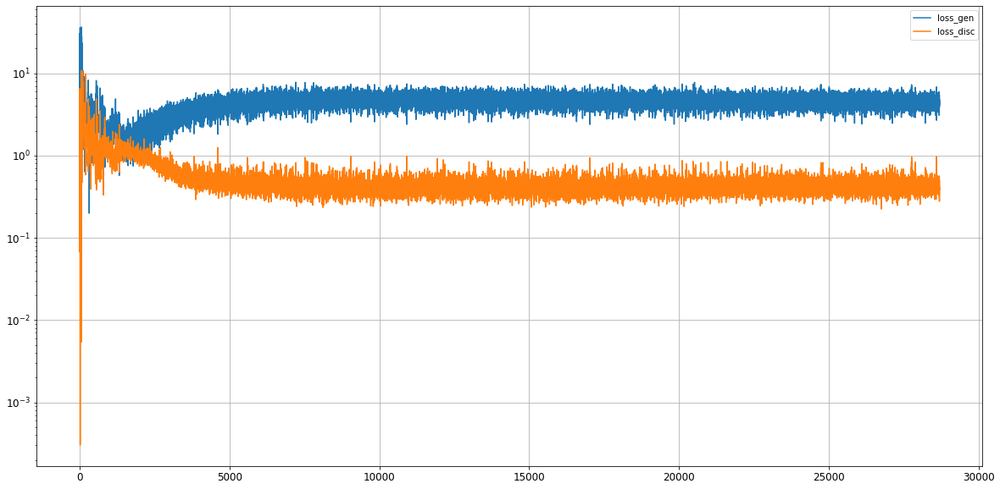

Epoch 28702/50000
0s
Epoch 28703/50000
0s
Epoch 28704/50000
0s
Epoch 28705/50000
0s
Epoch 28706/50000
0s
Epoch 28707/50000
0s
Epoch 28708/50000
0s
Epoch 28709/50000
0s
Epoch 28710/50000
0s
Epoch 28711/50000
0s
Epoch 28712/50000
0s
Epoch 28713/50000
0s
Epoch 28714/50000
0s
Epoch 28715/50000
0s
Epoch 28716/50000
0s
Epoch 28717/50000
0s
Epoch 28718/50000
0s
Epoch 28719/50000
0s
Epoch 28720/50000
0s
Epoch 28721/50000
0s
Epoch 28722/50000
0s
Epoch 28723/50000
0s
Epoch 28724/50000
0s
Epoch 28725/50000
0s
Epoch 28726/50000
0s
Epoch 28727/50000
0s
Epoch 28728/50000
0s
Epoch 28729/50000
0s
Epoch 28730/50000
0s
Epoch 28731/50000
0s
Epoch 28732/50000
0s
Epoch 28733/50000
0s
Epoch 28734/50000
0s
Epoch 28735/50000
0s
Epoch 28736/50000
0s
Epoch 28737/50000
0s
Epoch 28738/50000
0s
Epoch 28739/50000
0s
Epoch 28740/50000
0s
Epoch 28741/50000
0s
Epoch 28742/50000
0s
Epoch 28743/50000
0s
Epoch 28744/50000
0s
Epoch 28745/50000
0s
Epoch 28746/50000
0s
Epoch 28747/50000
0s
Epoch 28748/50000
0s
Epoch 28749/5

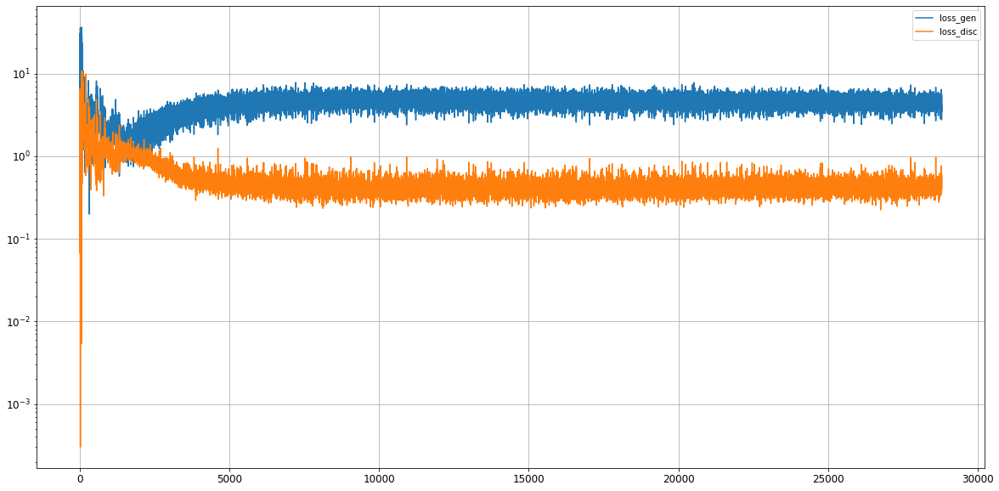

Epoch 28802/50000
0s
Epoch 28803/50000
0s
Epoch 28804/50000
0s
Epoch 28805/50000
0s
Epoch 28806/50000
0s
Epoch 28807/50000
0s
Epoch 28808/50000
0s
Epoch 28809/50000
0s
Epoch 28810/50000
0s
Epoch 28811/50000
0s
Epoch 28812/50000
0s
Epoch 28813/50000
0s
Epoch 28814/50000
0s
Epoch 28815/50000
0s
Epoch 28816/50000
0s
Epoch 28817/50000
0s
Epoch 28818/50000
0s
Epoch 28819/50000
0s
Epoch 28820/50000
0s
Epoch 28821/50000
0s
Epoch 28822/50000
0s
Epoch 28823/50000
0s
Epoch 28824/50000
0s
Epoch 28825/50000
0s
Epoch 28826/50000
0s
Epoch 28827/50000
0s
Epoch 28828/50000
0s
Epoch 28829/50000
0s
Epoch 28830/50000
0s
Epoch 28831/50000
0s
Epoch 28832/50000
0s
Epoch 28833/50000
0s
Epoch 28834/50000
0s
Epoch 28835/50000
0s
Epoch 28836/50000
0s
Epoch 28837/50000
0s
Epoch 28838/50000
0s
Epoch 28839/50000
0s
Epoch 28840/50000
0s
Epoch 28841/50000
0s
Epoch 28842/50000
0s
Epoch 28843/50000
0s
Epoch 28844/50000
0s
Epoch 28845/50000
0s
Epoch 28846/50000
0s
Epoch 28847/50000
0s
Epoch 28848/50000
0s
Epoch 28849/5

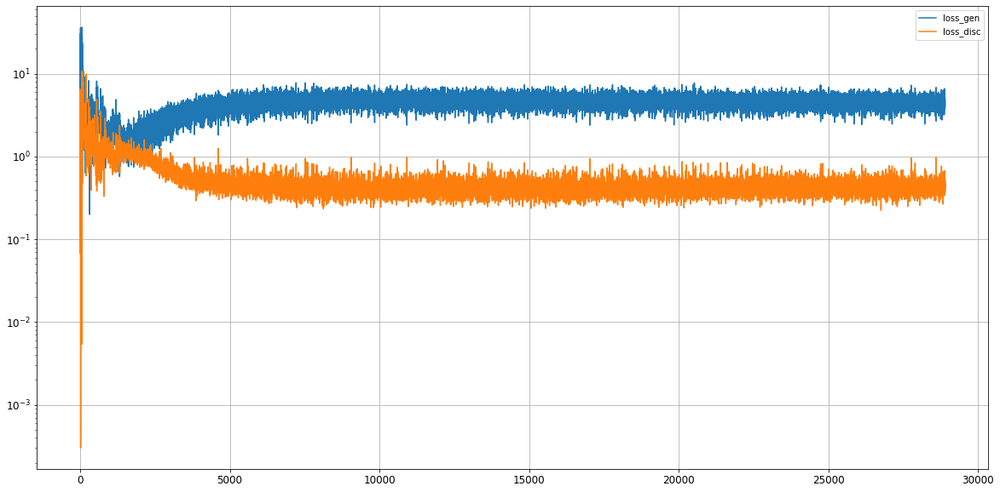

Epoch 28902/50000
0s
Epoch 28903/50000
0s
Epoch 28904/50000
0s
Epoch 28905/50000
0s
Epoch 28906/50000
0s
Epoch 28907/50000
0s
Epoch 28908/50000
0s
Epoch 28909/50000
0s
Epoch 28910/50000
0s
Epoch 28911/50000
0s
Epoch 28912/50000
0s
Epoch 28913/50000
0s
Epoch 28914/50000
0s
Epoch 28915/50000
0s
Epoch 28916/50000
0s
Epoch 28917/50000
0s
Epoch 28918/50000
0s
Epoch 28919/50000
0s
Epoch 28920/50000
0s
Epoch 28921/50000
0s
Epoch 28922/50000
0s
Epoch 28923/50000
0s
Epoch 28924/50000
0s
Epoch 28925/50000
0s
Epoch 28926/50000
0s
Epoch 28927/50000
0s
Epoch 28928/50000
0s
Epoch 28929/50000
0s
Epoch 28930/50000
0s
Epoch 28931/50000
0s
Epoch 28932/50000
0s
Epoch 28933/50000
0s
Epoch 28934/50000
0s
Epoch 28935/50000
0s
Epoch 28936/50000
0s
Epoch 28937/50000
0s
Epoch 28938/50000
0s
Epoch 28939/50000
0s
Epoch 28940/50000
0s
Epoch 28941/50000
0s
Epoch 28942/50000
0s
Epoch 28943/50000
0s
Epoch 28944/50000
0s
Epoch 28945/50000
0s
Epoch 28946/50000
0s
Epoch 28947/50000
0s
Epoch 28948/50000
0s
Epoch 28949/5

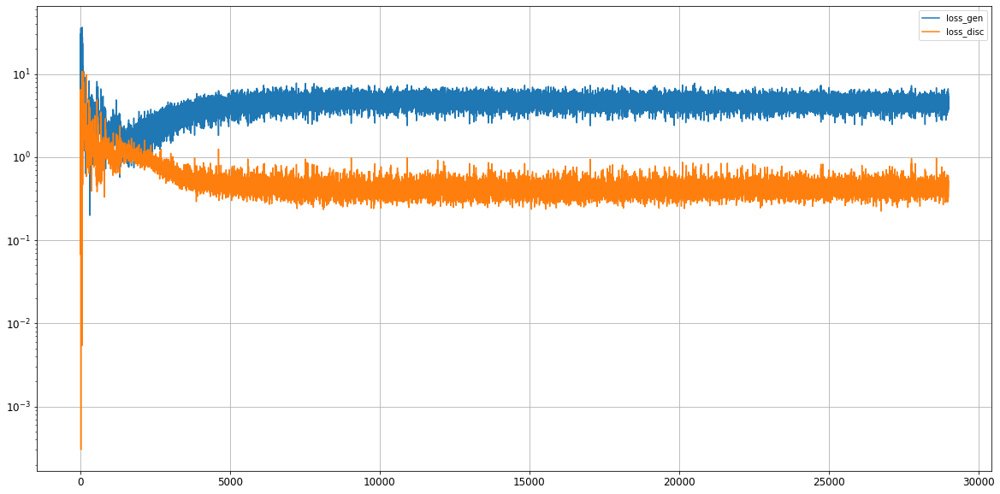

Epoch 29002/50000
0s
Epoch 29003/50000
0s
Epoch 29004/50000
0s
Epoch 29005/50000
0s
Epoch 29006/50000
0s
Epoch 29007/50000
0s
Epoch 29008/50000
0s
Epoch 29009/50000
0s
Epoch 29010/50000
0s
Epoch 29011/50000
0s
Epoch 29012/50000
0s
Epoch 29013/50000
0s
Epoch 29014/50000
0s
Epoch 29015/50000
0s
Epoch 29016/50000
0s
Epoch 29017/50000
0s
Epoch 29018/50000
0s
Epoch 29019/50000
0s
Epoch 29020/50000
0s
Epoch 29021/50000
0s
Epoch 29022/50000
0s
Epoch 29023/50000
0s
Epoch 29024/50000
0s
Epoch 29025/50000
0s
Epoch 29026/50000
0s
Epoch 29027/50000
0s
Epoch 29028/50000
0s
Epoch 29029/50000
0s
Epoch 29030/50000
0s
Epoch 29031/50000
0s
Epoch 29032/50000
0s
Epoch 29033/50000
0s
Epoch 29034/50000
0s
Epoch 29035/50000
0s
Epoch 29036/50000
0s
Epoch 29037/50000
0s
Epoch 29038/50000
0s
Epoch 29039/50000
0s
Epoch 29040/50000
0s
Epoch 29041/50000
0s
Epoch 29042/50000
0s
Epoch 29043/50000
0s
Epoch 29044/50000
0s
Epoch 29045/50000
0s
Epoch 29046/50000
0s
Epoch 29047/50000
0s
Epoch 29048/50000
0s
Epoch 29049/5

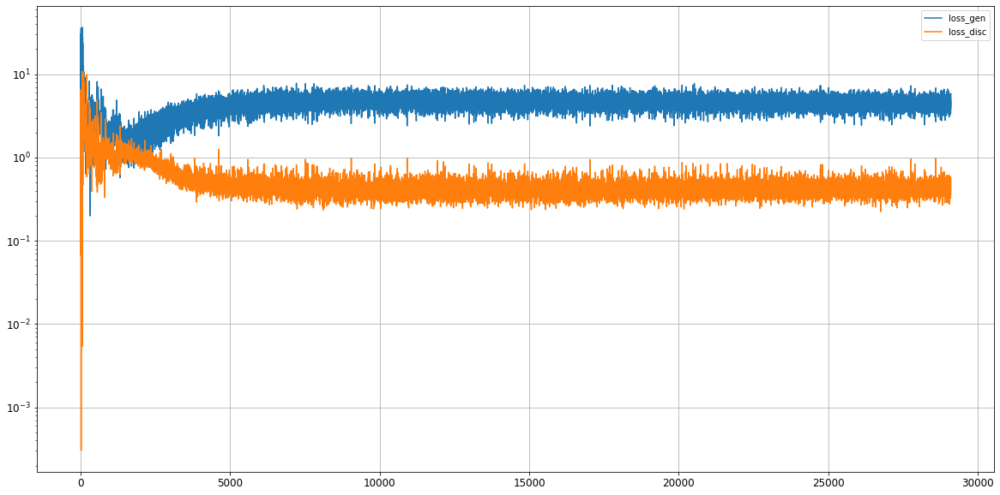

Epoch 29102/50000
0s
Epoch 29103/50000
0s
Epoch 29104/50000
0s
Epoch 29105/50000
0s
Epoch 29106/50000
0s
Epoch 29107/50000
0s
Epoch 29108/50000
0s
Epoch 29109/50000
0s
Epoch 29110/50000
0s
Epoch 29111/50000
0s
Epoch 29112/50000
0s
Epoch 29113/50000
0s
Epoch 29114/50000
0s
Epoch 29115/50000
0s
Epoch 29116/50000
0s
Epoch 29117/50000
0s
Epoch 29118/50000
0s
Epoch 29119/50000
0s
Epoch 29120/50000
0s
Epoch 29121/50000
0s
Epoch 29122/50000
0s
Epoch 29123/50000
0s
Epoch 29124/50000
0s
Epoch 29125/50000
0s
Epoch 29126/50000
0s
Epoch 29127/50000
0s
Epoch 29128/50000
0s
Epoch 29129/50000
0s
Epoch 29130/50000
0s
Epoch 29131/50000
0s
Epoch 29132/50000
0s
Epoch 29133/50000
0s
Epoch 29134/50000
0s
Epoch 29135/50000
0s
Epoch 29136/50000
0s
Epoch 29137/50000
0s
Epoch 29138/50000
0s
Epoch 29139/50000
0s
Epoch 29140/50000
0s
Epoch 29141/50000
0s
Epoch 29142/50000
0s
Epoch 29143/50000
0s
Epoch 29144/50000
0s
Epoch 29145/50000
0s
Epoch 29146/50000
0s
Epoch 29147/50000
0s
Epoch 29148/50000
0s
Epoch 29149/5

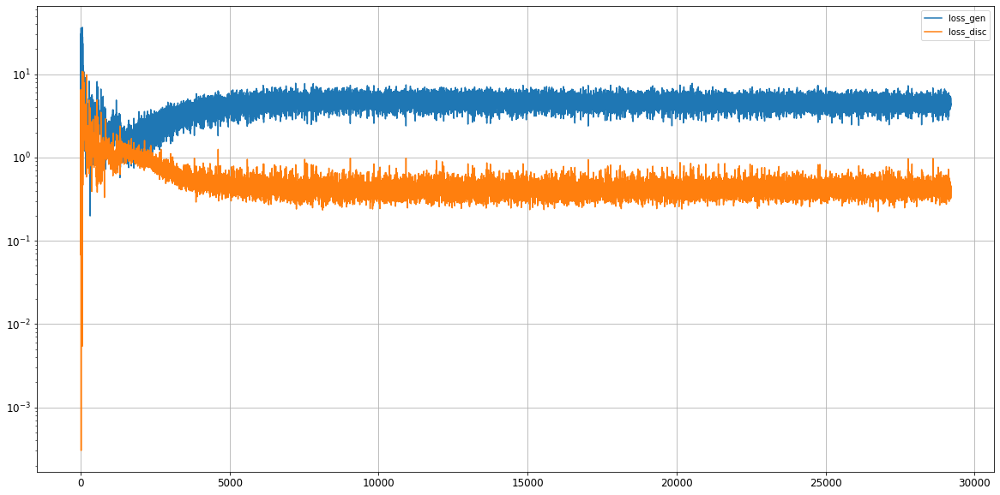

Epoch 29202/50000
0s
Epoch 29203/50000
0s
Epoch 29204/50000
0s
Epoch 29205/50000
0s
Epoch 29206/50000
0s
Epoch 29207/50000
0s
Epoch 29208/50000
0s
Epoch 29209/50000
0s
Epoch 29210/50000
0s
Epoch 29211/50000
0s
Epoch 29212/50000
0s
Epoch 29213/50000
0s
Epoch 29214/50000
0s
Epoch 29215/50000
0s
Epoch 29216/50000
0s
Epoch 29217/50000
0s
Epoch 29218/50000
0s
Epoch 29219/50000
0s
Epoch 29220/50000
0s
Epoch 29221/50000
0s
Epoch 29222/50000
0s
Epoch 29223/50000
0s
Epoch 29224/50000
0s
Epoch 29225/50000
0s
Epoch 29226/50000
0s
Epoch 29227/50000
0s
Epoch 29228/50000
0s
Epoch 29229/50000
0s
Epoch 29230/50000
0s
Epoch 29231/50000
0s
Epoch 29232/50000
0s
Epoch 29233/50000
0s
Epoch 29234/50000
0s
Epoch 29235/50000
0s
Epoch 29236/50000
0s
Epoch 29237/50000
0s
Epoch 29238/50000
0s
Epoch 29239/50000
0s
Epoch 29240/50000
0s
Epoch 29241/50000
0s
Epoch 29242/50000
0s
Epoch 29243/50000
0s
Epoch 29244/50000
0s
Epoch 29245/50000
0s
Epoch 29246/50000
0s
Epoch 29247/50000
0s
Epoch 29248/50000
0s
Epoch 29249/5

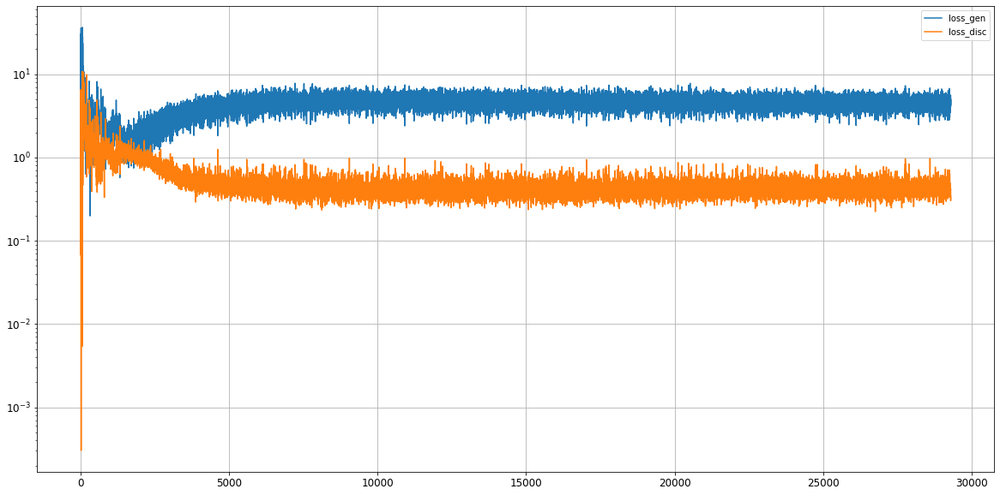

Epoch 29302/50000
0s
Epoch 29303/50000
0s
Epoch 29304/50000
0s
Epoch 29305/50000
0s
Epoch 29306/50000
0s
Epoch 29307/50000
0s
Epoch 29308/50000
0s
Epoch 29309/50000
0s
Epoch 29310/50000
0s
Epoch 29311/50000
0s
Epoch 29312/50000
0s
Epoch 29313/50000
0s
Epoch 29314/50000
0s
Epoch 29315/50000
0s
Epoch 29316/50000
0s
Epoch 29317/50000
0s
Epoch 29318/50000
0s
Epoch 29319/50000
0s
Epoch 29320/50000
0s
Epoch 29321/50000
0s
Epoch 29322/50000
0s
Epoch 29323/50000
0s
Epoch 29324/50000
0s
Epoch 29325/50000
0s
Epoch 29326/50000
0s
Epoch 29327/50000
0s
Epoch 29328/50000
0s
Epoch 29329/50000
0s
Epoch 29330/50000
0s
Epoch 29331/50000
0s
Epoch 29332/50000
0s
Epoch 29333/50000
0s
Epoch 29334/50000
0s
Epoch 29335/50000
0s
Epoch 29336/50000
0s
Epoch 29337/50000
0s
Epoch 29338/50000
0s
Epoch 29339/50000
0s
Epoch 29340/50000
0s
Epoch 29341/50000
0s
Epoch 29342/50000
0s
Epoch 29343/50000
0s
Epoch 29344/50000
0s
Epoch 29345/50000
0s
Epoch 29346/50000
0s
Epoch 29347/50000
0s
Epoch 29348/50000
0s
Epoch 29349/5

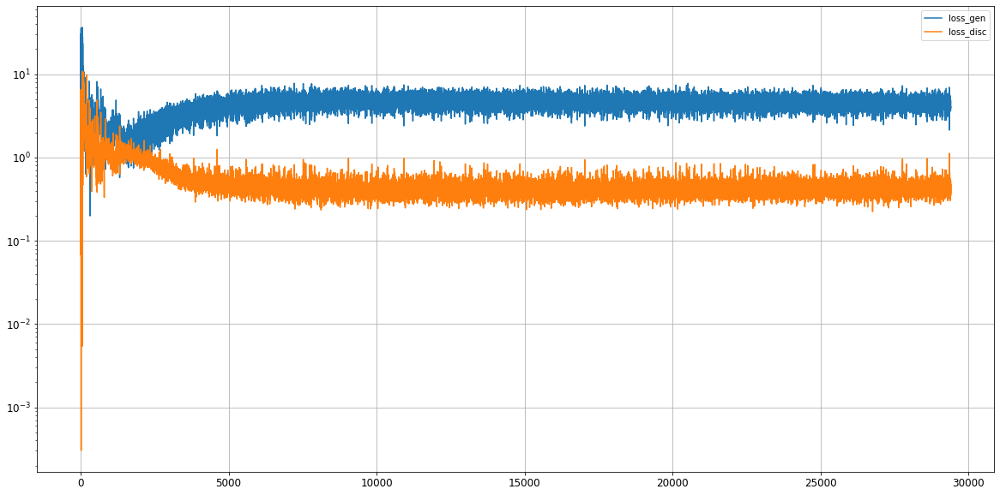

Epoch 29402/50000
0s
Epoch 29403/50000
0s
Epoch 29404/50000
0s
Epoch 29405/50000
0s
Epoch 29406/50000
0s
Epoch 29407/50000
0s
Epoch 29408/50000
0s
Epoch 29409/50000
0s
Epoch 29410/50000
0s
Epoch 29411/50000
0s
Epoch 29412/50000
0s
Epoch 29413/50000
0s
Epoch 29414/50000
0s
Epoch 29415/50000
0s
Epoch 29416/50000
0s
Epoch 29417/50000
0s
Epoch 29418/50000
0s
Epoch 29419/50000
0s
Epoch 29420/50000
0s
Epoch 29421/50000
0s
Epoch 29422/50000
0s
Epoch 29423/50000
0s
Epoch 29424/50000
0s
Epoch 29425/50000
0s
Epoch 29426/50000
0s
Epoch 29427/50000
0s
Epoch 29428/50000
0s
Epoch 29429/50000
0s
Epoch 29430/50000
0s
Epoch 29431/50000
0s
Epoch 29432/50000
0s
Epoch 29433/50000
0s
Epoch 29434/50000
0s
Epoch 29435/50000
0s
Epoch 29436/50000
0s
Epoch 29437/50000
0s
Epoch 29438/50000
0s
Epoch 29439/50000
0s
Epoch 29440/50000
0s
Epoch 29441/50000
0s
Epoch 29442/50000
0s
Epoch 29443/50000
0s
Epoch 29444/50000
0s
Epoch 29445/50000
0s
Epoch 29446/50000
0s
Epoch 29447/50000
0s
Epoch 29448/50000
0s
Epoch 29449/5

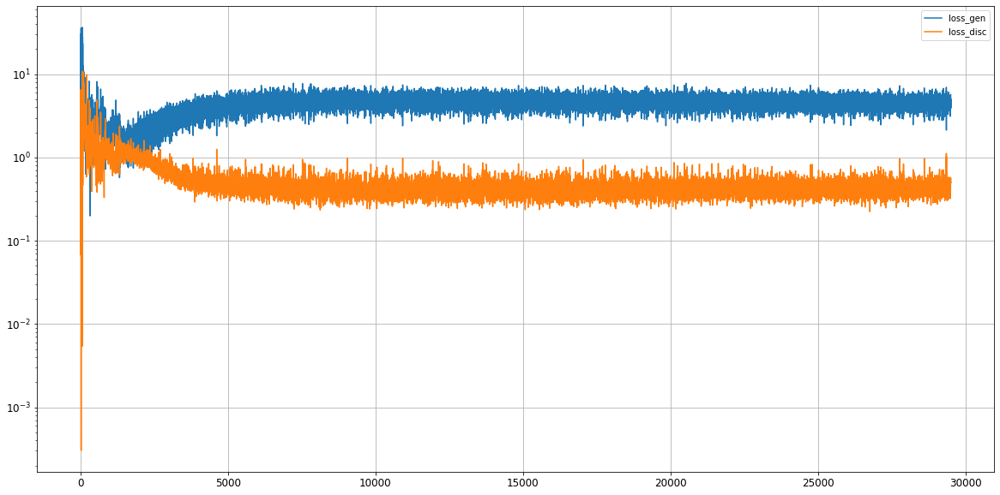

Epoch 29502/50000
0s
Epoch 29503/50000
0s
Epoch 29504/50000
0s
Epoch 29505/50000
0s
Epoch 29506/50000
0s
Epoch 29507/50000
0s
Epoch 29508/50000
0s
Epoch 29509/50000
0s
Epoch 29510/50000
0s
Epoch 29511/50000
0s
Epoch 29512/50000
0s
Epoch 29513/50000
0s
Epoch 29514/50000
0s
Epoch 29515/50000
0s
Epoch 29516/50000
0s
Epoch 29517/50000
0s
Epoch 29518/50000
0s
Epoch 29519/50000
0s
Epoch 29520/50000
0s
Epoch 29521/50000
0s
Epoch 29522/50000
0s
Epoch 29523/50000
0s
Epoch 29524/50000
0s
Epoch 29525/50000
0s
Epoch 29526/50000
0s
Epoch 29527/50000
0s
Epoch 29528/50000
0s
Epoch 29529/50000
0s
Epoch 29530/50000
0s
Epoch 29531/50000
0s
Epoch 29532/50000
0s
Epoch 29533/50000
0s
Epoch 29534/50000
0s
Epoch 29535/50000
0s
Epoch 29536/50000
0s
Epoch 29537/50000
0s
Epoch 29538/50000
0s
Epoch 29539/50000
0s
Epoch 29540/50000
0s
Epoch 29541/50000
0s
Epoch 29542/50000
0s
Epoch 29543/50000
0s
Epoch 29544/50000
0s
Epoch 29545/50000
0s
Epoch 29546/50000
0s
Epoch 29547/50000
0s
Epoch 29548/50000
0s
Epoch 29549/5

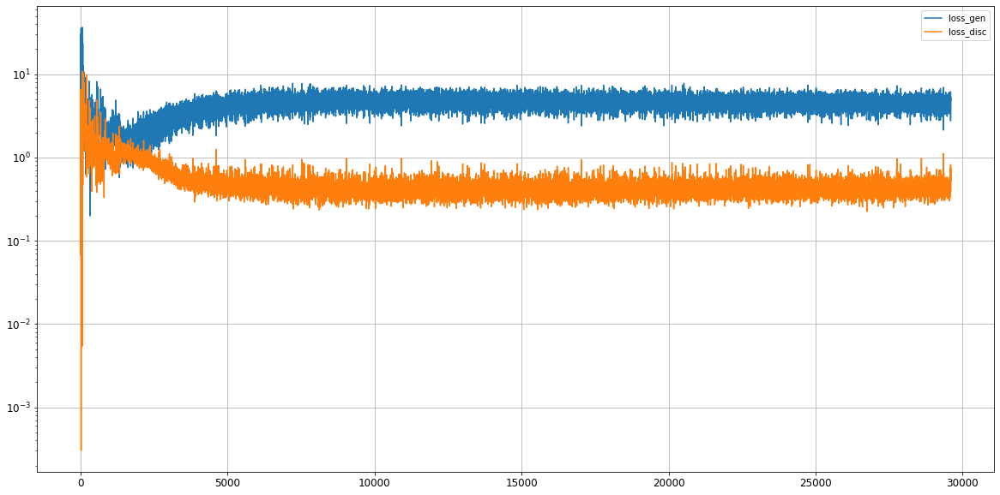

Epoch 29602/50000
0s
Epoch 29603/50000
0s
Epoch 29604/50000
0s
Epoch 29605/50000
0s
Epoch 29606/50000
0s
Epoch 29607/50000
0s
Epoch 29608/50000
0s
Epoch 29609/50000
0s
Epoch 29610/50000
0s
Epoch 29611/50000
0s
Epoch 29612/50000
0s
Epoch 29613/50000
0s
Epoch 29614/50000
0s
Epoch 29615/50000
0s
Epoch 29616/50000
0s
Epoch 29617/50000
0s
Epoch 29618/50000
0s
Epoch 29619/50000
0s
Epoch 29620/50000
0s
Epoch 29621/50000
0s
Epoch 29622/50000
0s
Epoch 29623/50000
0s
Epoch 29624/50000
0s
Epoch 29625/50000
0s
Epoch 29626/50000
0s
Epoch 29627/50000
0s
Epoch 29628/50000
0s
Epoch 29629/50000
0s
Epoch 29630/50000
0s
Epoch 29631/50000
0s
Epoch 29632/50000
0s
Epoch 29633/50000
0s
Epoch 29634/50000
0s
Epoch 29635/50000
0s
Epoch 29636/50000
0s
Epoch 29637/50000
0s
Epoch 29638/50000
0s
Epoch 29639/50000
0s
Epoch 29640/50000
0s
Epoch 29641/50000
0s
Epoch 29642/50000
0s
Epoch 29643/50000
0s
Epoch 29644/50000
0s
Epoch 29645/50000
0s
Epoch 29646/50000
0s
Epoch 29647/50000
0s
Epoch 29648/50000
0s
Epoch 29649/5

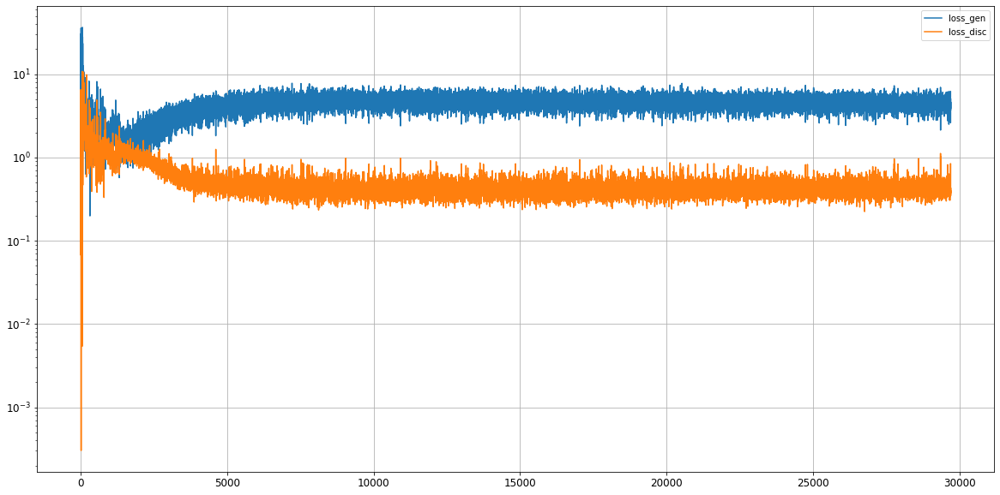

Epoch 29702/50000
0s
Epoch 29703/50000
0s
Epoch 29704/50000
0s
Epoch 29705/50000
0s
Epoch 29706/50000
0s
Epoch 29707/50000
0s
Epoch 29708/50000
0s
Epoch 29709/50000
0s
Epoch 29710/50000
0s
Epoch 29711/50000
0s
Epoch 29712/50000
0s
Epoch 29713/50000
0s
Epoch 29714/50000
0s
Epoch 29715/50000
0s
Epoch 29716/50000
0s
Epoch 29717/50000
0s
Epoch 29718/50000
0s
Epoch 29719/50000
0s
Epoch 29720/50000
0s
Epoch 29721/50000
0s
Epoch 29722/50000
0s
Epoch 29723/50000
0s
Epoch 29724/50000
0s
Epoch 29725/50000
0s
Epoch 29726/50000
0s
Epoch 29727/50000
0s
Epoch 29728/50000
0s
Epoch 29729/50000
0s
Epoch 29730/50000
0s
Epoch 29731/50000
0s
Epoch 29732/50000
0s
Epoch 29733/50000
0s
Epoch 29734/50000
0s
Epoch 29735/50000
0s
Epoch 29736/50000
0s
Epoch 29737/50000
0s
Epoch 29738/50000
0s
Epoch 29739/50000
0s
Epoch 29740/50000
0s
Epoch 29741/50000
0s
Epoch 29742/50000
0s
Epoch 29743/50000
0s
Epoch 29744/50000
0s
Epoch 29745/50000
0s
Epoch 29746/50000
0s
Epoch 29747/50000
0s
Epoch 29748/50000
0s
Epoch 29749/5

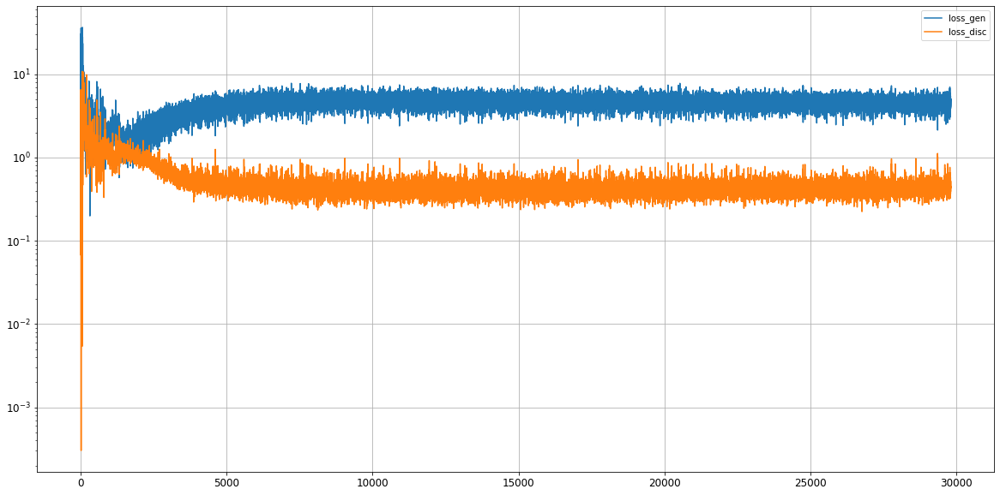

Epoch 29802/50000
0s
Epoch 29803/50000
0s
Epoch 29804/50000
0s
Epoch 29805/50000
0s
Epoch 29806/50000
0s
Epoch 29807/50000
0s
Epoch 29808/50000
0s
Epoch 29809/50000
0s
Epoch 29810/50000
0s
Epoch 29811/50000
0s
Epoch 29812/50000
0s
Epoch 29813/50000
0s
Epoch 29814/50000
0s
Epoch 29815/50000
0s
Epoch 29816/50000
0s
Epoch 29817/50000
0s
Epoch 29818/50000
0s
Epoch 29819/50000
0s
Epoch 29820/50000
0s
Epoch 29821/50000
0s
Epoch 29822/50000
0s
Epoch 29823/50000
0s
Epoch 29824/50000
0s
Epoch 29825/50000
0s
Epoch 29826/50000
0s
Epoch 29827/50000
0s
Epoch 29828/50000
0s
Epoch 29829/50000
0s
Epoch 29830/50000
0s
Epoch 29831/50000
0s
Epoch 29832/50000
0s
Epoch 29833/50000
0s
Epoch 29834/50000
0s
Epoch 29835/50000
0s
Epoch 29836/50000
0s
Epoch 29837/50000
0s
Epoch 29838/50000
0s
Epoch 29839/50000
0s
Epoch 29840/50000
0s
Epoch 29841/50000
0s
Epoch 29842/50000
0s
Epoch 29843/50000
0s
Epoch 29844/50000
0s
Epoch 29845/50000
0s
Epoch 29846/50000
0s
Epoch 29847/50000
0s
Epoch 29848/50000
0s
Epoch 29849/5

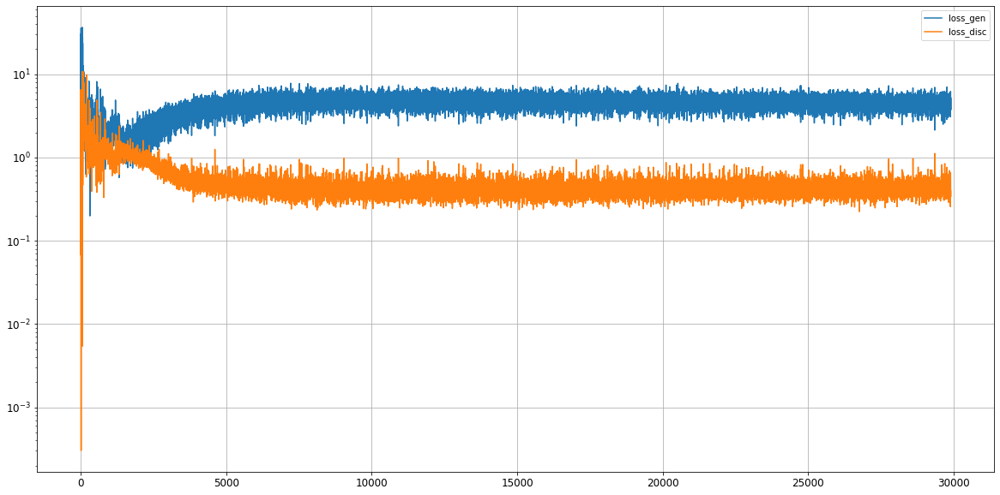

Epoch 29902/50000
0s
Epoch 29903/50000
0s
Epoch 29904/50000
0s
Epoch 29905/50000
0s
Epoch 29906/50000
0s
Epoch 29907/50000
0s
Epoch 29908/50000
0s
Epoch 29909/50000
0s
Epoch 29910/50000
0s
Epoch 29911/50000
0s
Epoch 29912/50000
0s
Epoch 29913/50000
0s
Epoch 29914/50000
0s
Epoch 29915/50000
0s
Epoch 29916/50000
0s
Epoch 29917/50000
0s
Epoch 29918/50000
0s
Epoch 29919/50000
0s
Epoch 29920/50000
0s
Epoch 29921/50000
0s
Epoch 29922/50000
0s
Epoch 29923/50000
0s
Epoch 29924/50000
0s
Epoch 29925/50000
0s
Epoch 29926/50000
0s
Epoch 29927/50000
0s
Epoch 29928/50000
0s
Epoch 29929/50000
0s
Epoch 29930/50000
0s
Epoch 29931/50000
0s
Epoch 29932/50000
0s
Epoch 29933/50000
0s
Epoch 29934/50000
0s
Epoch 29935/50000
0s
Epoch 29936/50000
0s
Epoch 29937/50000
0s
Epoch 29938/50000
0s
Epoch 29939/50000
0s
Epoch 29940/50000
0s
Epoch 29941/50000
0s
Epoch 29942/50000
0s
Epoch 29943/50000
0s
Epoch 29944/50000
0s
Epoch 29945/50000
0s
Epoch 29946/50000
0s
Epoch 29947/50000
0s
Epoch 29948/50000
0s
Epoch 29949/5

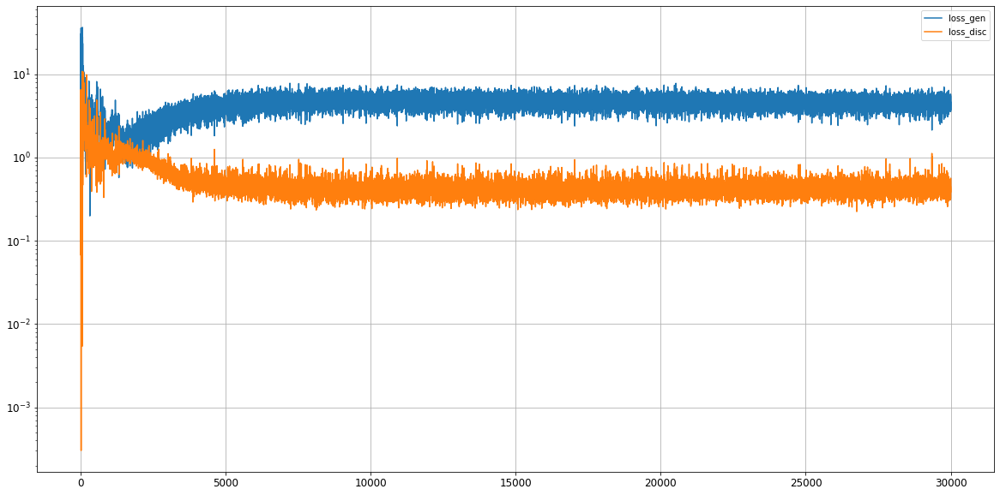

Epoch 30002/50000
0s
Epoch 30003/50000
0s
Epoch 30004/50000
0s
Epoch 30005/50000
0s
Epoch 30006/50000
0s
Epoch 30007/50000
0s
Epoch 30008/50000
0s
Epoch 30009/50000
0s
Epoch 30010/50000
0s
Epoch 30011/50000
0s
Epoch 30012/50000
0s
Epoch 30013/50000
0s
Epoch 30014/50000
0s
Epoch 30015/50000
0s
Epoch 30016/50000
0s
Epoch 30017/50000
0s
Epoch 30018/50000
0s
Epoch 30019/50000
0s
Epoch 30020/50000
0s
Epoch 30021/50000
0s
Epoch 30022/50000
0s
Epoch 30023/50000
0s
Epoch 30024/50000
0s
Epoch 30025/50000
0s
Epoch 30026/50000
0s
Epoch 30027/50000
0s
Epoch 30028/50000
0s
Epoch 30029/50000
0s
Epoch 30030/50000
0s
Epoch 30031/50000
0s
Epoch 30032/50000
0s
Epoch 30033/50000
0s
Epoch 30034/50000
0s
Epoch 30035/50000
0s
Epoch 30036/50000
0s
Epoch 30037/50000
0s
Epoch 30038/50000
0s
Epoch 30039/50000
0s
Epoch 30040/50000
0s
Epoch 30041/50000
0s
Epoch 30042/50000
0s
Epoch 30043/50000
0s
Epoch 30044/50000
0s
Epoch 30045/50000
0s
Epoch 30046/50000
0s
Epoch 30047/50000
0s
Epoch 30048/50000
0s
Epoch 30049/5

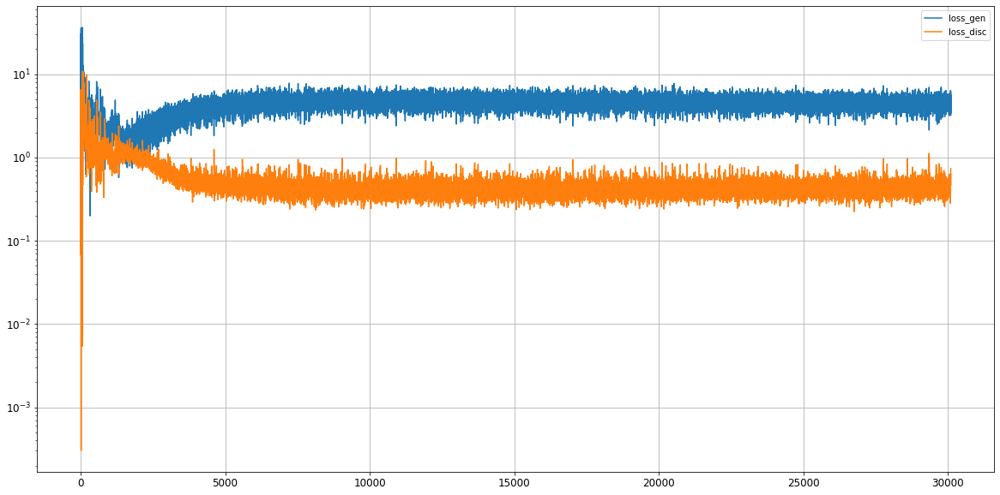

Epoch 30102/50000
0s
Epoch 30103/50000
0s
Epoch 30104/50000
0s
Epoch 30105/50000
0s
Epoch 30106/50000
0s
Epoch 30107/50000
0s
Epoch 30108/50000
0s
Epoch 30109/50000
0s
Epoch 30110/50000
0s
Epoch 30111/50000
0s
Epoch 30112/50000
0s
Epoch 30113/50000
0s
Epoch 30114/50000
0s
Epoch 30115/50000
0s
Epoch 30116/50000
0s
Epoch 30117/50000
0s
Epoch 30118/50000
0s
Epoch 30119/50000
0s
Epoch 30120/50000
0s
Epoch 30121/50000
0s
Epoch 30122/50000
0s
Epoch 30123/50000
0s
Epoch 30124/50000
0s
Epoch 30125/50000
0s
Epoch 30126/50000
0s
Epoch 30127/50000
0s
Epoch 30128/50000
0s
Epoch 30129/50000
0s
Epoch 30130/50000
0s
Epoch 30131/50000
0s
Epoch 30132/50000
0s
Epoch 30133/50000
0s
Epoch 30134/50000
0s
Epoch 30135/50000
0s
Epoch 30136/50000
0s
Epoch 30137/50000
0s
Epoch 30138/50000
0s
Epoch 30139/50000
0s
Epoch 30140/50000
0s
Epoch 30141/50000
0s
Epoch 30142/50000
0s
Epoch 30143/50000
0s
Epoch 30144/50000
0s
Epoch 30145/50000
0s
Epoch 30146/50000
0s
Epoch 30147/50000
0s
Epoch 30148/50000
0s
Epoch 30149/5

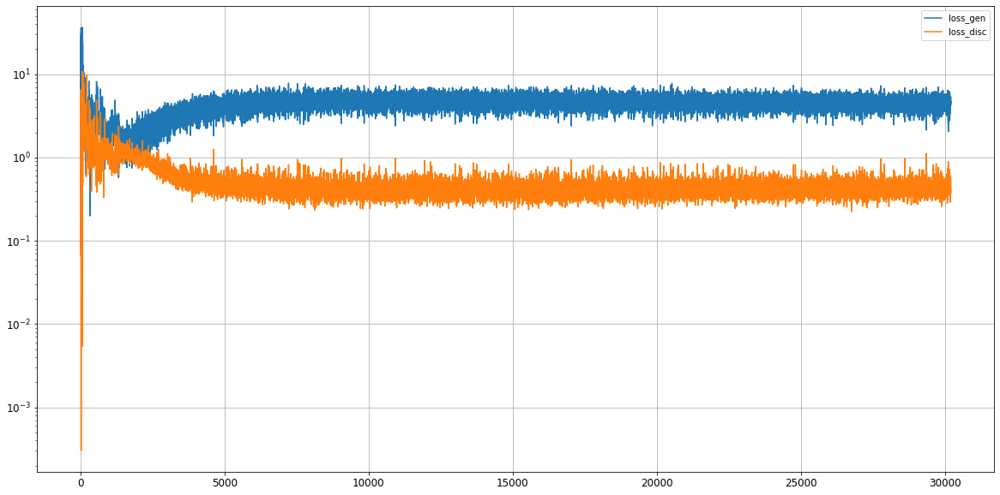

Epoch 30202/50000
0s
Epoch 30203/50000
0s
Epoch 30204/50000
0s
Epoch 30205/50000
0s
Epoch 30206/50000
0s
Epoch 30207/50000
0s
Epoch 30208/50000
0s
Epoch 30209/50000
0s
Epoch 30210/50000
0s
Epoch 30211/50000
0s
Epoch 30212/50000
0s
Epoch 30213/50000
0s
Epoch 30214/50000
0s
Epoch 30215/50000
0s
Epoch 30216/50000
0s
Epoch 30217/50000
0s
Epoch 30218/50000
0s
Epoch 30219/50000
0s
Epoch 30220/50000
0s
Epoch 30221/50000
0s
Epoch 30222/50000
0s
Epoch 30223/50000
0s
Epoch 30224/50000
0s
Epoch 30225/50000
0s
Epoch 30226/50000
0s
Epoch 30227/50000
0s
Epoch 30228/50000
0s
Epoch 30229/50000
0s
Epoch 30230/50000
0s
Epoch 30231/50000
0s
Epoch 30232/50000
0s
Epoch 30233/50000
0s
Epoch 30234/50000
0s
Epoch 30235/50000
0s
Epoch 30236/50000
0s
Epoch 30237/50000
0s
Epoch 30238/50000
0s
Epoch 30239/50000
0s
Epoch 30240/50000
0s
Epoch 30241/50000
0s
Epoch 30242/50000
0s
Epoch 30243/50000
0s
Epoch 30244/50000
0s
Epoch 30245/50000
0s
Epoch 30246/50000
0s
Epoch 30247/50000
0s
Epoch 30248/50000
0s
Epoch 30249/5

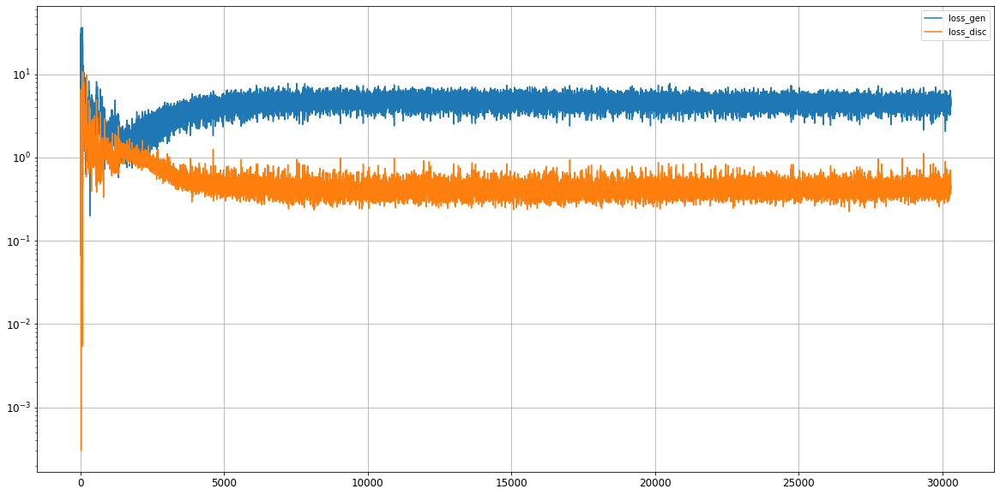

Epoch 30302/50000
0s
Epoch 30303/50000
0s
Epoch 30304/50000
0s
Epoch 30305/50000
0s
Epoch 30306/50000
0s
Epoch 30307/50000
0s
Epoch 30308/50000
0s
Epoch 30309/50000
0s
Epoch 30310/50000
0s
Epoch 30311/50000
0s
Epoch 30312/50000
0s
Epoch 30313/50000
0s
Epoch 30314/50000
0s
Epoch 30315/50000
0s
Epoch 30316/50000
0s
Epoch 30317/50000
0s
Epoch 30318/50000
0s
Epoch 30319/50000
0s
Epoch 30320/50000
0s
Epoch 30321/50000
0s
Epoch 30322/50000
0s
Epoch 30323/50000
0s
Epoch 30324/50000
0s
Epoch 30325/50000
0s
Epoch 30326/50000
0s
Epoch 30327/50000
0s
Epoch 30328/50000
0s
Epoch 30329/50000
0s
Epoch 30330/50000
0s
Epoch 30331/50000
0s
Epoch 30332/50000
0s
Epoch 30333/50000
0s
Epoch 30334/50000
0s
Epoch 30335/50000
0s
Epoch 30336/50000
0s
Epoch 30337/50000
0s
Epoch 30338/50000
0s
Epoch 30339/50000
0s
Epoch 30340/50000
0s
Epoch 30341/50000
0s
Epoch 30342/50000
0s
Epoch 30343/50000
0s
Epoch 30344/50000
0s
Epoch 30345/50000
0s
Epoch 30346/50000
0s
Epoch 30347/50000
0s
Epoch 30348/50000
0s
Epoch 30349/5

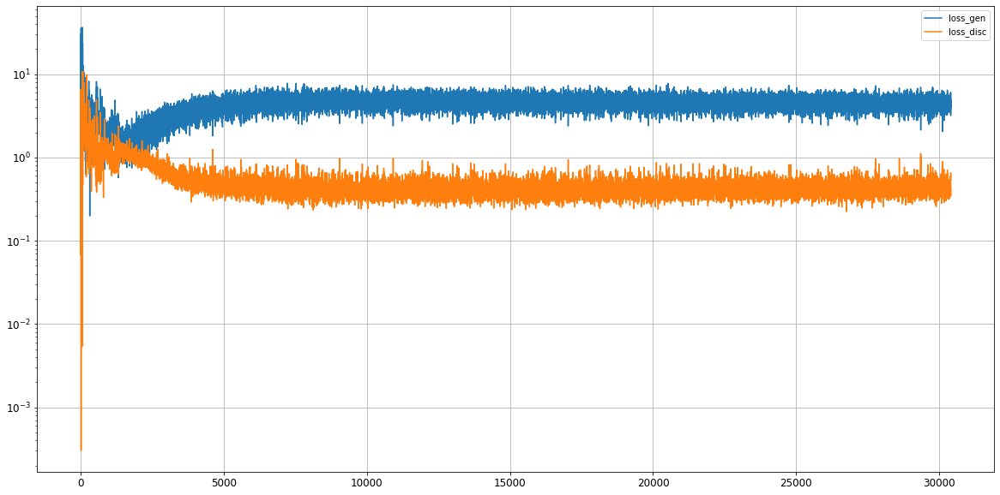

Epoch 30402/50000
0s
Epoch 30403/50000
0s
Epoch 30404/50000
0s
Epoch 30405/50000
0s
Epoch 30406/50000
0s
Epoch 30407/50000
0s
Epoch 30408/50000
0s
Epoch 30409/50000
0s
Epoch 30410/50000
0s
Epoch 30411/50000
0s
Epoch 30412/50000
0s
Epoch 30413/50000
0s
Epoch 30414/50000
0s
Epoch 30415/50000
0s
Epoch 30416/50000
0s
Epoch 30417/50000
0s
Epoch 30418/50000
0s
Epoch 30419/50000
0s
Epoch 30420/50000
0s
Epoch 30421/50000
0s
Epoch 30422/50000
0s
Epoch 30423/50000
0s
Epoch 30424/50000
0s
Epoch 30425/50000
0s
Epoch 30426/50000
0s
Epoch 30427/50000
0s
Epoch 30428/50000
0s
Epoch 30429/50000
0s
Epoch 30430/50000
0s
Epoch 30431/50000
0s
Epoch 30432/50000
0s
Epoch 30433/50000
0s
Epoch 30434/50000
0s
Epoch 30435/50000
0s
Epoch 30436/50000
0s
Epoch 30437/50000
0s
Epoch 30438/50000
0s
Epoch 30439/50000
0s
Epoch 30440/50000
0s
Epoch 30441/50000
0s
Epoch 30442/50000
0s
Epoch 30443/50000
0s
Epoch 30444/50000
0s
Epoch 30445/50000
0s
Epoch 30446/50000
0s
Epoch 30447/50000
0s
Epoch 30448/50000
0s
Epoch 30449/5

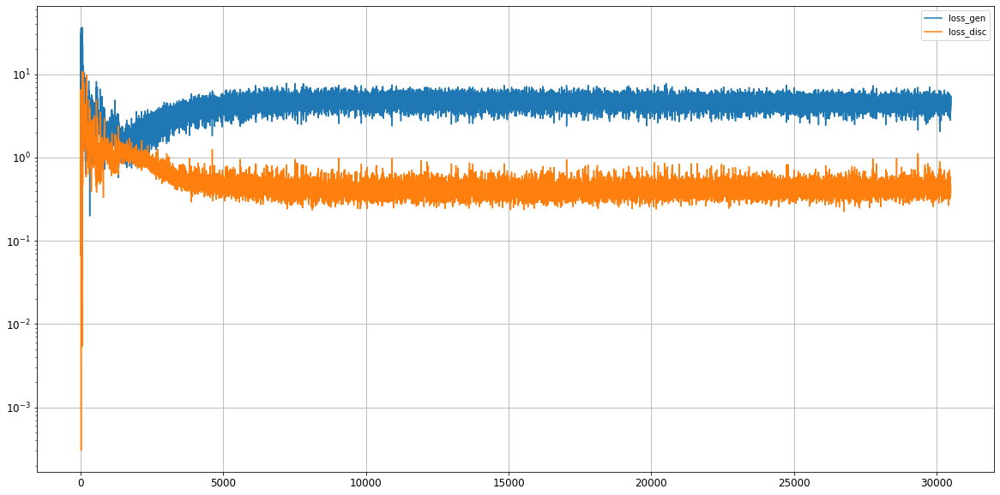

Epoch 30502/50000
0s
Epoch 30503/50000
0s
Epoch 30504/50000
0s
Epoch 30505/50000
0s
Epoch 30506/50000
0s
Epoch 30507/50000
0s
Epoch 30508/50000
0s
Epoch 30509/50000
0s
Epoch 30510/50000
0s
Epoch 30511/50000
0s
Epoch 30512/50000
0s
Epoch 30513/50000
0s
Epoch 30514/50000
0s
Epoch 30515/50000
0s
Epoch 30516/50000
0s
Epoch 30517/50000
0s
Epoch 30518/50000
0s
Epoch 30519/50000
0s
Epoch 30520/50000
0s
Epoch 30521/50000
0s
Epoch 30522/50000
0s
Epoch 30523/50000
0s
Epoch 30524/50000
0s
Epoch 30525/50000
0s
Epoch 30526/50000
0s
Epoch 30527/50000
0s
Epoch 30528/50000
0s
Epoch 30529/50000
0s
Epoch 30530/50000
0s
Epoch 30531/50000
0s
Epoch 30532/50000
0s
Epoch 30533/50000
0s
Epoch 30534/50000
0s
Epoch 30535/50000
0s
Epoch 30536/50000
0s
Epoch 30537/50000
0s
Epoch 30538/50000
0s
Epoch 30539/50000
0s
Epoch 30540/50000
0s
Epoch 30541/50000
0s
Epoch 30542/50000
0s
Epoch 30543/50000
0s
Epoch 30544/50000
0s
Epoch 30545/50000
0s
Epoch 30546/50000
0s
Epoch 30547/50000
0s
Epoch 30548/50000
0s
Epoch 30549/5

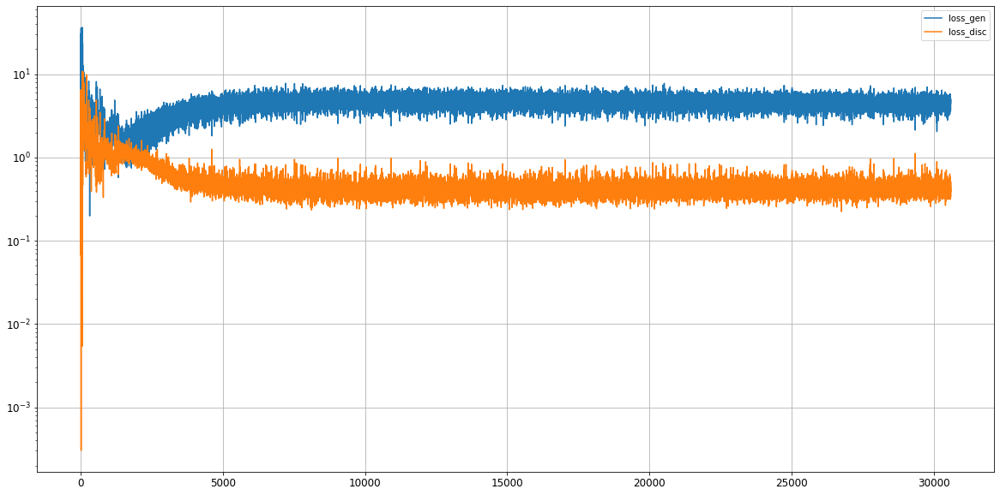

Epoch 30602/50000
0s
Epoch 30603/50000
0s
Epoch 30604/50000
0s
Epoch 30605/50000
0s
Epoch 30606/50000
0s
Epoch 30607/50000
0s
Epoch 30608/50000
0s
Epoch 30609/50000
0s
Epoch 30610/50000
0s
Epoch 30611/50000
0s
Epoch 30612/50000
0s
Epoch 30613/50000
0s
Epoch 30614/50000
0s
Epoch 30615/50000
0s
Epoch 30616/50000
0s
Epoch 30617/50000
0s
Epoch 30618/50000
0s
Epoch 30619/50000
0s
Epoch 30620/50000
0s
Epoch 30621/50000
0s
Epoch 30622/50000
0s
Epoch 30623/50000
0s
Epoch 30624/50000
0s
Epoch 30625/50000
0s
Epoch 30626/50000
0s
Epoch 30627/50000
0s
Epoch 30628/50000
0s
Epoch 30629/50000
0s
Epoch 30630/50000
0s
Epoch 30631/50000
0s
Epoch 30632/50000
0s
Epoch 30633/50000
0s
Epoch 30634/50000
0s
Epoch 30635/50000
0s
Epoch 30636/50000
0s
Epoch 30637/50000
0s
Epoch 30638/50000
0s
Epoch 30639/50000
0s
Epoch 30640/50000
0s
Epoch 30641/50000
0s
Epoch 30642/50000
0s
Epoch 30643/50000
0s
Epoch 30644/50000
0s
Epoch 30645/50000
0s
Epoch 30646/50000
0s
Epoch 30647/50000
0s
Epoch 30648/50000
0s
Epoch 30649/5

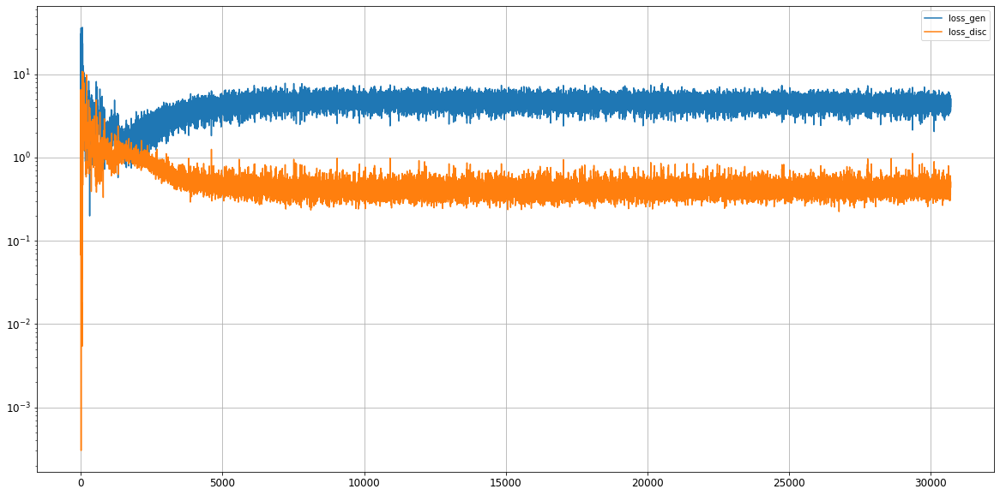

Epoch 30702/50000
0s
Epoch 30703/50000
0s
Epoch 30704/50000
0s
Epoch 30705/50000
0s
Epoch 30706/50000
0s
Epoch 30707/50000
0s
Epoch 30708/50000
0s
Epoch 30709/50000
0s
Epoch 30710/50000
0s
Epoch 30711/50000
0s
Epoch 30712/50000
0s
Epoch 30713/50000
0s
Epoch 30714/50000
0s
Epoch 30715/50000
0s
Epoch 30716/50000
0s
Epoch 30717/50000
0s
Epoch 30718/50000
0s
Epoch 30719/50000
0s
Epoch 30720/50000
0s
Epoch 30721/50000
0s
Epoch 30722/50000
0s
Epoch 30723/50000
0s
Epoch 30724/50000
0s
Epoch 30725/50000
0s
Epoch 30726/50000
0s
Epoch 30727/50000
0s
Epoch 30728/50000
0s
Epoch 30729/50000
0s
Epoch 30730/50000
0s
Epoch 30731/50000
0s
Epoch 30732/50000
0s
Epoch 30733/50000
0s
Epoch 30734/50000
0s
Epoch 30735/50000
0s
Epoch 30736/50000
0s
Epoch 30737/50000
0s
Epoch 30738/50000
0s
Epoch 30739/50000
0s
Epoch 30740/50000
0s
Epoch 30741/50000
0s
Epoch 30742/50000
0s
Epoch 30743/50000
0s
Epoch 30744/50000
0s
Epoch 30745/50000
0s
Epoch 30746/50000
0s
Epoch 30747/50000
0s
Epoch 30748/50000
0s
Epoch 30749/5

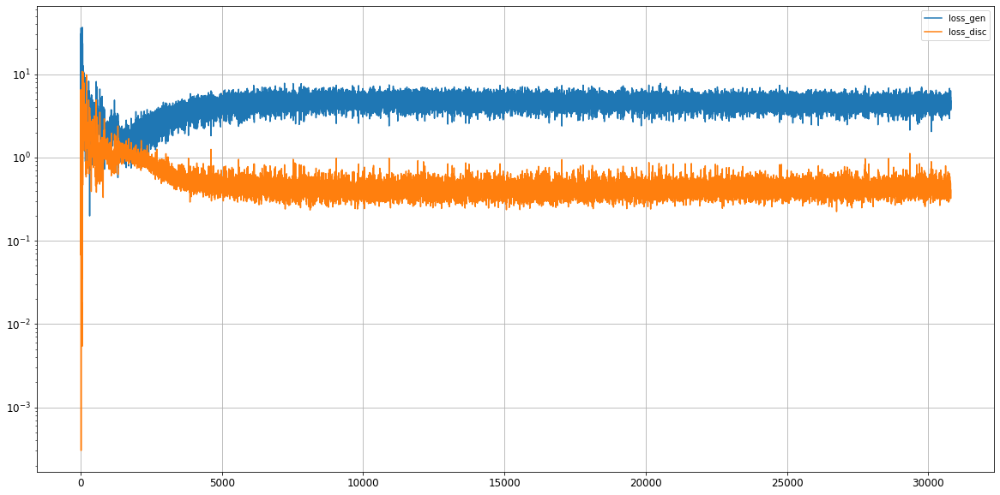

Epoch 30802/50000
0s
Epoch 30803/50000
0s
Epoch 30804/50000
0s
Epoch 30805/50000
0s
Epoch 30806/50000
0s
Epoch 30807/50000
0s
Epoch 30808/50000
0s
Epoch 30809/50000
0s
Epoch 30810/50000
0s
Epoch 30811/50000
0s
Epoch 30812/50000
0s
Epoch 30813/50000
0s
Epoch 30814/50000
0s
Epoch 30815/50000
0s
Epoch 30816/50000
0s
Epoch 30817/50000
0s
Epoch 30818/50000
0s
Epoch 30819/50000
0s
Epoch 30820/50000
0s
Epoch 30821/50000
0s
Epoch 30822/50000
0s
Epoch 30823/50000
0s
Epoch 30824/50000
0s
Epoch 30825/50000
0s
Epoch 30826/50000
0s
Epoch 30827/50000
0s
Epoch 30828/50000
0s
Epoch 30829/50000
0s
Epoch 30830/50000
0s
Epoch 30831/50000
0s
Epoch 30832/50000
0s
Epoch 30833/50000
0s
Epoch 30834/50000
0s
Epoch 30835/50000
0s
Epoch 30836/50000
0s
Epoch 30837/50000
0s
Epoch 30838/50000
0s
Epoch 30839/50000
0s
Epoch 30840/50000
0s
Epoch 30841/50000
0s
Epoch 30842/50000
0s
Epoch 30843/50000
0s
Epoch 30844/50000
0s
Epoch 30845/50000
0s
Epoch 30846/50000
0s
Epoch 30847/50000
0s
Epoch 30848/50000
0s
Epoch 30849/5

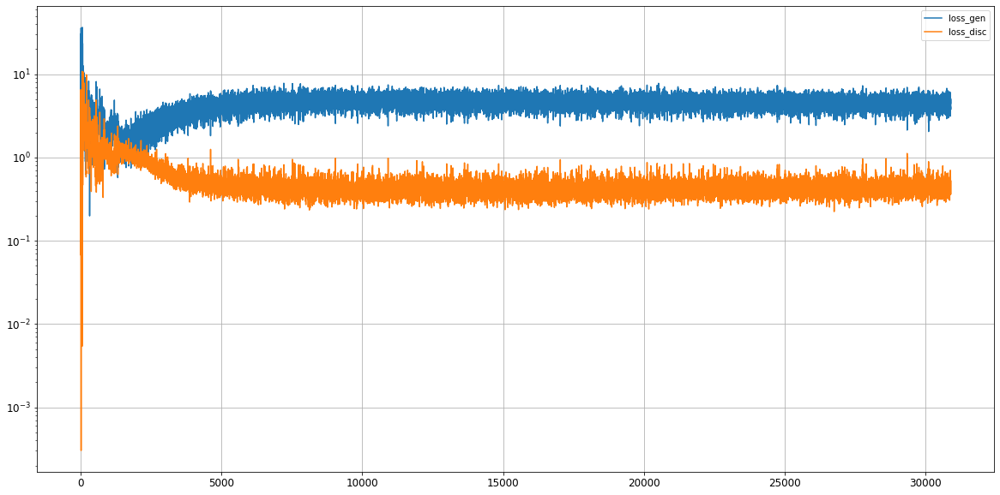

Epoch 30902/50000
0s
Epoch 30903/50000
0s
Epoch 30904/50000
0s
Epoch 30905/50000
0s
Epoch 30906/50000
0s
Epoch 30907/50000
0s
Epoch 30908/50000
0s
Epoch 30909/50000
0s
Epoch 30910/50000
0s
Epoch 30911/50000
0s
Epoch 30912/50000
0s
Epoch 30913/50000
0s
Epoch 30914/50000
0s
Epoch 30915/50000
0s
Epoch 30916/50000
0s
Epoch 30917/50000
0s
Epoch 30918/50000
0s
Epoch 30919/50000
0s
Epoch 30920/50000
0s
Epoch 30921/50000
0s
Epoch 30922/50000
0s
Epoch 30923/50000
0s
Epoch 30924/50000
0s
Epoch 30925/50000
0s
Epoch 30926/50000
0s
Epoch 30927/50000
0s
Epoch 30928/50000
0s
Epoch 30929/50000
0s
Epoch 30930/50000
0s
Epoch 30931/50000
0s
Epoch 30932/50000
0s
Epoch 30933/50000
0s
Epoch 30934/50000
0s
Epoch 30935/50000
0s
Epoch 30936/50000
0s
Epoch 30937/50000
0s
Epoch 30938/50000
0s
Epoch 30939/50000
0s
Epoch 30940/50000
0s
Epoch 30941/50000
0s
Epoch 30942/50000
0s
Epoch 30943/50000
0s
Epoch 30944/50000
0s
Epoch 30945/50000
0s
Epoch 30946/50000
0s
Epoch 30947/50000
0s
Epoch 30948/50000
0s
Epoch 30949/5

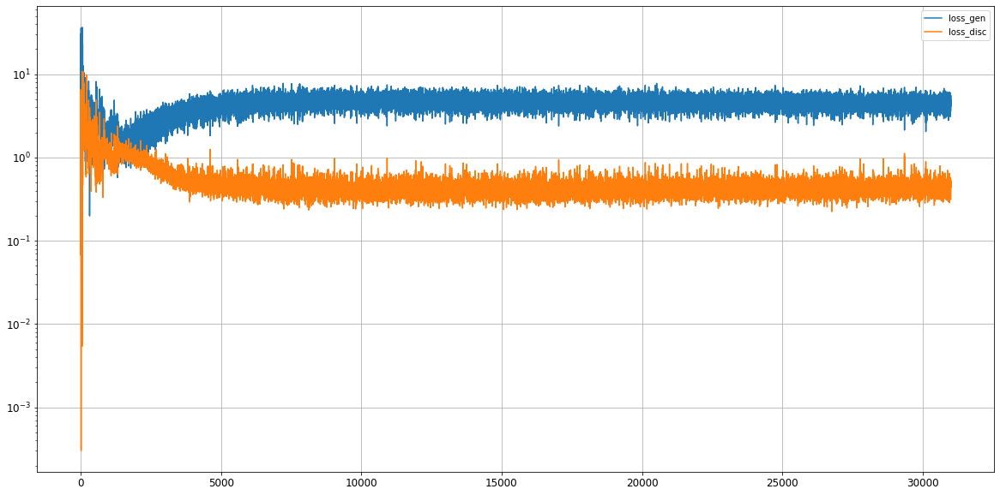

Epoch 31002/50000
0s
Epoch 31003/50000
0s
Epoch 31004/50000
0s
Epoch 31005/50000
0s
Epoch 31006/50000
0s
Epoch 31007/50000
0s
Epoch 31008/50000
0s
Epoch 31009/50000
0s
Epoch 31010/50000
0s
Epoch 31011/50000
0s
Epoch 31012/50000
0s
Epoch 31013/50000
0s
Epoch 31014/50000
0s
Epoch 31015/50000
0s
Epoch 31016/50000
0s
Epoch 31017/50000
0s
Epoch 31018/50000
0s
Epoch 31019/50000
0s
Epoch 31020/50000
0s
Epoch 31021/50000
0s
Epoch 31022/50000
0s
Epoch 31023/50000
0s
Epoch 31024/50000
0s
Epoch 31025/50000
0s
Epoch 31026/50000
0s
Epoch 31027/50000
0s
Epoch 31028/50000
0s
Epoch 31029/50000
0s
Epoch 31030/50000
0s
Epoch 31031/50000
0s
Epoch 31032/50000
0s
Epoch 31033/50000
0s
Epoch 31034/50000
0s
Epoch 31035/50000
0s
Epoch 31036/50000
0s
Epoch 31037/50000
0s
Epoch 31038/50000
0s
Epoch 31039/50000
0s
Epoch 31040/50000
0s
Epoch 31041/50000
0s
Epoch 31042/50000
0s
Epoch 31043/50000
0s
Epoch 31044/50000
0s
Epoch 31045/50000
0s
Epoch 31046/50000
0s
Epoch 31047/50000
0s
Epoch 31048/50000
0s
Epoch 31049/5

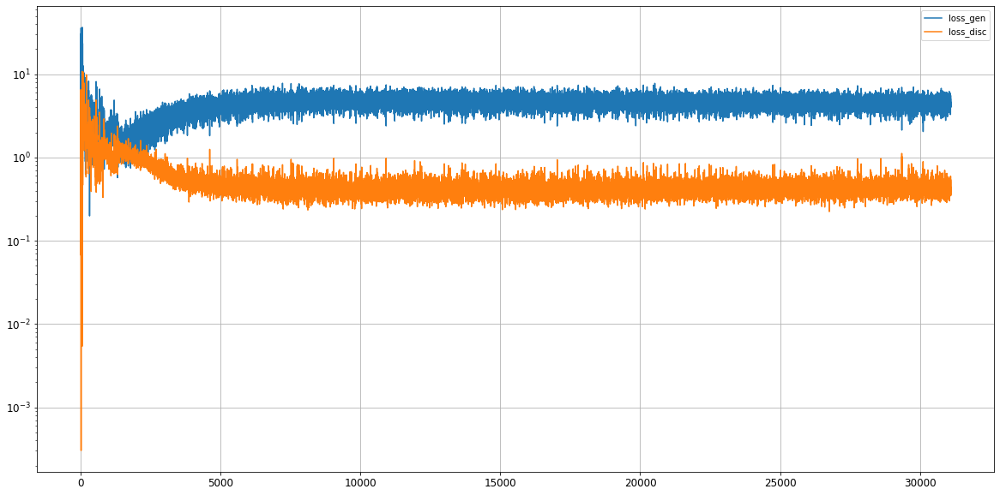

Epoch 31102/50000
0s
Epoch 31103/50000
0s
Epoch 31104/50000
0s
Epoch 31105/50000
0s
Epoch 31106/50000
0s
Epoch 31107/50000
0s
Epoch 31108/50000
0s
Epoch 31109/50000
0s
Epoch 31110/50000
0s
Epoch 31111/50000
0s
Epoch 31112/50000
0s
Epoch 31113/50000
0s
Epoch 31114/50000
0s
Epoch 31115/50000
0s
Epoch 31116/50000
0s
Epoch 31117/50000
0s
Epoch 31118/50000
0s
Epoch 31119/50000
0s
Epoch 31120/50000
0s
Epoch 31121/50000
0s
Epoch 31122/50000
0s
Epoch 31123/50000
0s
Epoch 31124/50000
0s
Epoch 31125/50000
0s
Epoch 31126/50000
0s
Epoch 31127/50000
0s
Epoch 31128/50000
0s
Epoch 31129/50000
0s
Epoch 31130/50000
0s
Epoch 31131/50000
0s
Epoch 31132/50000
0s
Epoch 31133/50000
0s
Epoch 31134/50000
0s
Epoch 31135/50000
0s
Epoch 31136/50000
0s
Epoch 31137/50000
0s
Epoch 31138/50000
0s
Epoch 31139/50000
0s
Epoch 31140/50000
0s
Epoch 31141/50000
0s
Epoch 31142/50000
0s
Epoch 31143/50000
0s
Epoch 31144/50000
0s
Epoch 31145/50000
0s
Epoch 31146/50000
0s
Epoch 31147/50000
0s
Epoch 31148/50000
0s
Epoch 31149/5

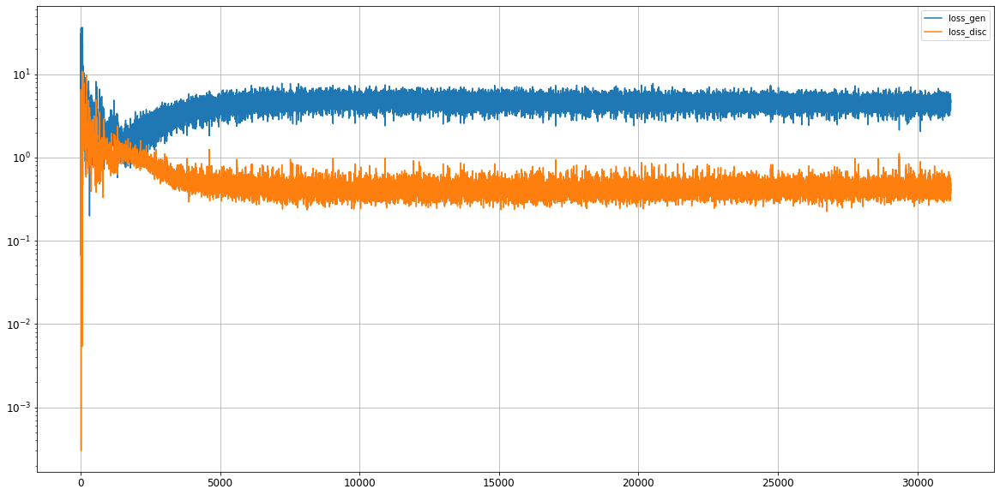

Epoch 31202/50000
0s
Epoch 31203/50000
0s
Epoch 31204/50000
0s
Epoch 31205/50000
0s
Epoch 31206/50000
0s
Epoch 31207/50000
0s
Epoch 31208/50000
0s
Epoch 31209/50000
0s
Epoch 31210/50000
0s
Epoch 31211/50000
0s
Epoch 31212/50000
0s
Epoch 31213/50000
0s
Epoch 31214/50000
0s
Epoch 31215/50000
0s
Epoch 31216/50000
0s
Epoch 31217/50000
0s
Epoch 31218/50000
0s
Epoch 31219/50000
0s
Epoch 31220/50000
0s
Epoch 31221/50000
0s
Epoch 31222/50000
0s
Epoch 31223/50000
0s
Epoch 31224/50000
0s
Epoch 31225/50000
0s
Epoch 31226/50000
0s
Epoch 31227/50000
0s
Epoch 31228/50000
0s
Epoch 31229/50000
0s
Epoch 31230/50000
0s
Epoch 31231/50000
0s
Epoch 31232/50000
0s
Epoch 31233/50000
0s
Epoch 31234/50000
0s
Epoch 31235/50000
0s
Epoch 31236/50000
0s
Epoch 31237/50000
0s
Epoch 31238/50000
0s
Epoch 31239/50000
0s
Epoch 31240/50000
0s
Epoch 31241/50000
0s
Epoch 31242/50000
0s
Epoch 31243/50000
0s
Epoch 31244/50000
0s
Epoch 31245/50000
0s
Epoch 31246/50000
0s
Epoch 31247/50000
0s
Epoch 31248/50000
0s
Epoch 31249/5

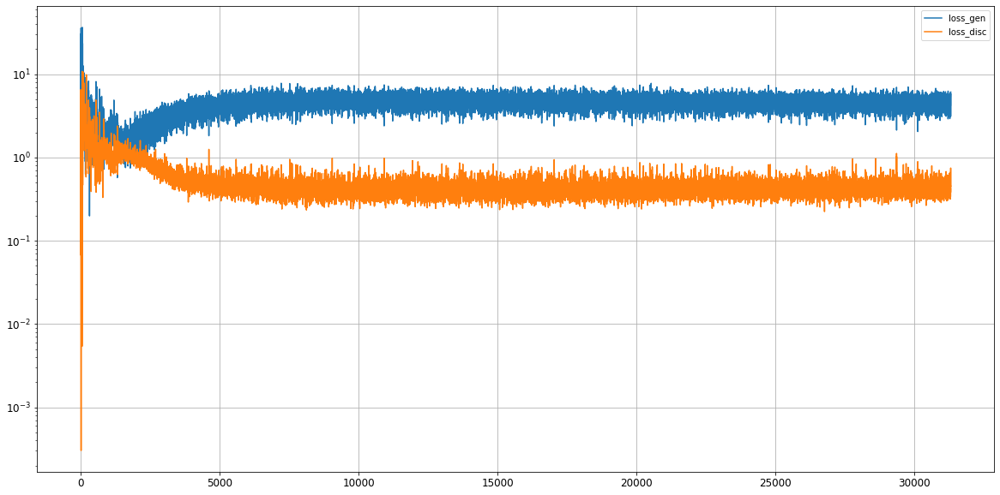

Epoch 31302/50000
0s
Epoch 31303/50000
0s
Epoch 31304/50000
0s
Epoch 31305/50000
0s
Epoch 31306/50000
0s
Epoch 31307/50000
0s
Epoch 31308/50000
0s
Epoch 31309/50000
0s
Epoch 31310/50000
0s
Epoch 31311/50000
0s
Epoch 31312/50000
0s
Epoch 31313/50000
0s
Epoch 31314/50000
0s
Epoch 31315/50000
0s
Epoch 31316/50000
0s
Epoch 31317/50000
0s
Epoch 31318/50000
0s
Epoch 31319/50000
0s
Epoch 31320/50000
0s
Epoch 31321/50000
0s
Epoch 31322/50000
0s
Epoch 31323/50000
0s
Epoch 31324/50000
0s
Epoch 31325/50000
0s
Epoch 31326/50000
0s
Epoch 31327/50000
0s
Epoch 31328/50000
0s
Epoch 31329/50000
0s
Epoch 31330/50000
0s
Epoch 31331/50000
0s
Epoch 31332/50000
0s
Epoch 31333/50000
0s
Epoch 31334/50000
0s
Epoch 31335/50000
0s
Epoch 31336/50000
0s
Epoch 31337/50000
0s
Epoch 31338/50000
0s
Epoch 31339/50000
0s
Epoch 31340/50000
0s
Epoch 31341/50000
0s
Epoch 31342/50000
0s
Epoch 31343/50000
0s
Epoch 31344/50000
0s
Epoch 31345/50000
0s
Epoch 31346/50000
0s
Epoch 31347/50000
0s
Epoch 31348/50000
0s
Epoch 31349/5

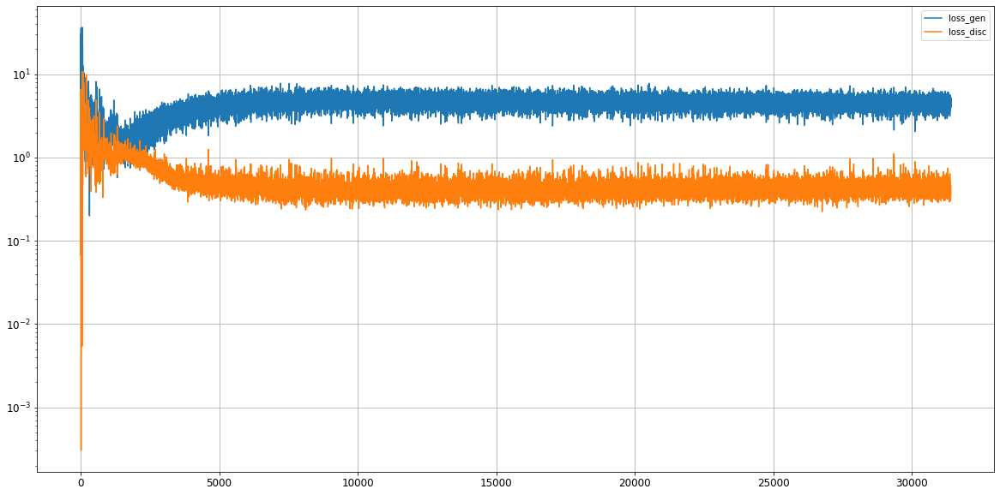

Epoch 31402/50000
0s
Epoch 31403/50000
0s
Epoch 31404/50000
0s
Epoch 31405/50000
0s
Epoch 31406/50000
0s
Epoch 31407/50000
0s
Epoch 31408/50000
0s
Epoch 31409/50000
0s
Epoch 31410/50000
0s
Epoch 31411/50000
0s
Epoch 31412/50000
0s
Epoch 31413/50000
0s
Epoch 31414/50000
0s
Epoch 31415/50000
0s
Epoch 31416/50000
0s
Epoch 31417/50000
0s
Epoch 31418/50000
0s
Epoch 31419/50000
0s
Epoch 31420/50000
0s
Epoch 31421/50000
0s
Epoch 31422/50000
0s
Epoch 31423/50000
0s
Epoch 31424/50000
0s
Epoch 31425/50000
0s
Epoch 31426/50000
0s
Epoch 31427/50000
0s
Epoch 31428/50000
0s
Epoch 31429/50000
0s
Epoch 31430/50000
0s
Epoch 31431/50000
0s
Epoch 31432/50000
0s
Epoch 31433/50000
0s
Epoch 31434/50000
0s
Epoch 31435/50000
0s
Epoch 31436/50000
0s
Epoch 31437/50000
0s
Epoch 31438/50000
0s
Epoch 31439/50000
0s
Epoch 31440/50000
0s
Epoch 31441/50000
0s
Epoch 31442/50000
0s
Epoch 31443/50000
0s
Epoch 31444/50000
0s
Epoch 31445/50000
0s
Epoch 31446/50000
0s
Epoch 31447/50000
0s
Epoch 31448/50000
0s
Epoch 31449/5

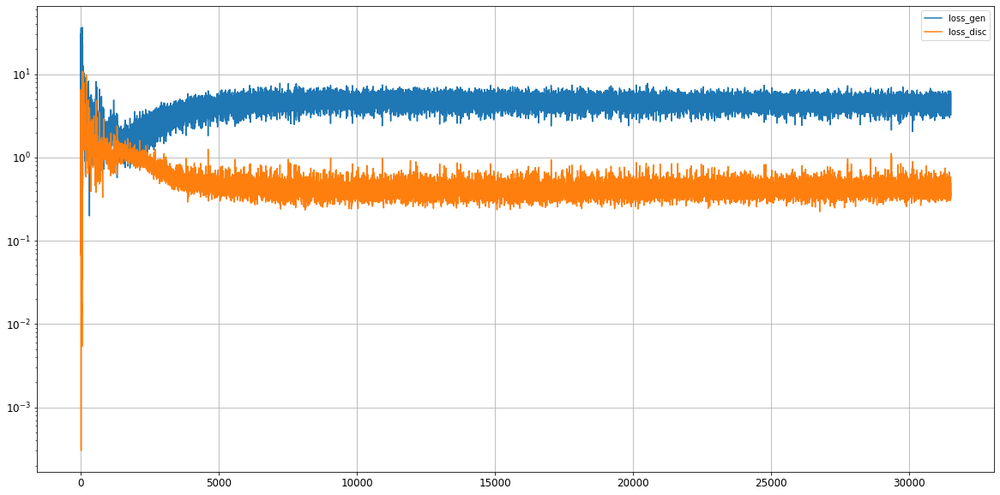

Epoch 31502/50000
0s
Epoch 31503/50000
0s
Epoch 31504/50000
0s
Epoch 31505/50000
0s
Epoch 31506/50000
0s
Epoch 31507/50000
0s
Epoch 31508/50000
0s
Epoch 31509/50000
0s
Epoch 31510/50000
0s
Epoch 31511/50000
0s
Epoch 31512/50000
0s
Epoch 31513/50000
0s
Epoch 31514/50000
0s
Epoch 31515/50000
0s
Epoch 31516/50000
0s
Epoch 31517/50000
0s
Epoch 31518/50000
0s
Epoch 31519/50000
0s
Epoch 31520/50000
0s
Epoch 31521/50000
0s
Epoch 31522/50000
0s
Epoch 31523/50000
0s
Epoch 31524/50000
0s
Epoch 31525/50000
0s
Epoch 31526/50000
0s
Epoch 31527/50000
0s
Epoch 31528/50000
0s
Epoch 31529/50000
0s
Epoch 31530/50000
0s
Epoch 31531/50000
0s
Epoch 31532/50000
0s
Epoch 31533/50000
0s
Epoch 31534/50000
0s
Epoch 31535/50000
0s
Epoch 31536/50000
0s
Epoch 31537/50000
0s
Epoch 31538/50000
0s
Epoch 31539/50000
0s
Epoch 31540/50000
0s
Epoch 31541/50000
0s
Epoch 31542/50000
0s
Epoch 31543/50000
0s
Epoch 31544/50000
0s
Epoch 31545/50000
0s
Epoch 31546/50000
0s
Epoch 31547/50000
0s
Epoch 31548/50000
0s
Epoch 31549/5

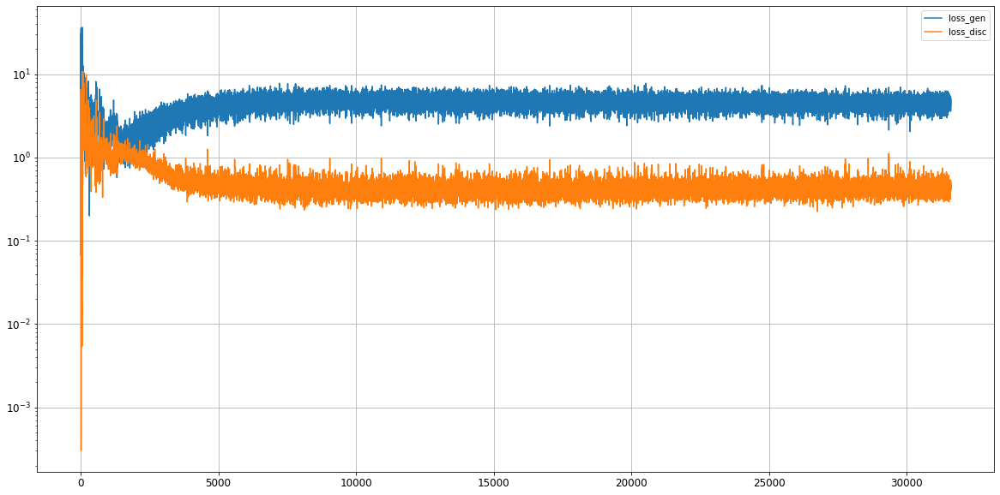

Epoch 31602/50000
0s
Epoch 31603/50000
0s
Epoch 31604/50000
0s
Epoch 31605/50000
0s
Epoch 31606/50000
0s
Epoch 31607/50000
0s
Epoch 31608/50000
0s
Epoch 31609/50000
0s
Epoch 31610/50000
0s
Epoch 31611/50000
0s
Epoch 31612/50000
0s
Epoch 31613/50000
0s
Epoch 31614/50000
0s
Epoch 31615/50000
0s
Epoch 31616/50000
0s
Epoch 31617/50000
0s
Epoch 31618/50000
0s
Epoch 31619/50000
0s
Epoch 31620/50000
0s
Epoch 31621/50000
0s
Epoch 31622/50000
0s
Epoch 31623/50000
0s
Epoch 31624/50000
0s
Epoch 31625/50000
0s
Epoch 31626/50000
0s
Epoch 31627/50000
0s
Epoch 31628/50000
0s
Epoch 31629/50000
0s
Epoch 31630/50000
0s
Epoch 31631/50000
0s
Epoch 31632/50000
0s
Epoch 31633/50000
0s
Epoch 31634/50000
0s
Epoch 31635/50000
0s
Epoch 31636/50000
0s
Epoch 31637/50000
0s
Epoch 31638/50000
0s
Epoch 31639/50000
0s
Epoch 31640/50000
0s
Epoch 31641/50000
0s
Epoch 31642/50000
0s
Epoch 31643/50000
0s
Epoch 31644/50000
0s
Epoch 31645/50000
0s
Epoch 31646/50000
0s
Epoch 31647/50000
0s
Epoch 31648/50000
0s
Epoch 31649/5

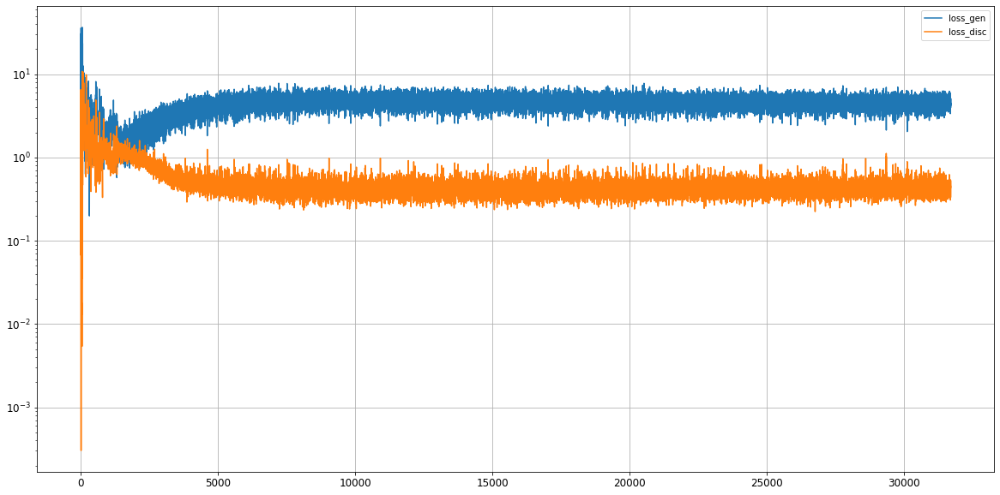

Epoch 31702/50000
0s
Epoch 31703/50000
0s
Epoch 31704/50000
0s
Epoch 31705/50000
0s
Epoch 31706/50000
0s
Epoch 31707/50000
0s
Epoch 31708/50000
0s
Epoch 31709/50000
0s
Epoch 31710/50000
0s
Epoch 31711/50000
0s
Epoch 31712/50000
0s
Epoch 31713/50000
0s
Epoch 31714/50000
0s
Epoch 31715/50000
0s
Epoch 31716/50000
0s
Epoch 31717/50000
0s
Epoch 31718/50000
0s
Epoch 31719/50000
0s
Epoch 31720/50000
0s
Epoch 31721/50000
0s
Epoch 31722/50000
0s
Epoch 31723/50000
0s
Epoch 31724/50000
0s
Epoch 31725/50000
0s
Epoch 31726/50000
0s
Epoch 31727/50000
0s
Epoch 31728/50000
0s
Epoch 31729/50000
0s
Epoch 31730/50000
0s
Epoch 31731/50000
0s
Epoch 31732/50000
0s
Epoch 31733/50000
0s
Epoch 31734/50000
0s
Epoch 31735/50000
0s
Epoch 31736/50000
0s
Epoch 31737/50000
0s
Epoch 31738/50000
0s
Epoch 31739/50000
0s
Epoch 31740/50000
0s
Epoch 31741/50000
0s
Epoch 31742/50000
0s
Epoch 31743/50000
0s
Epoch 31744/50000
0s
Epoch 31745/50000
0s
Epoch 31746/50000
0s
Epoch 31747/50000
0s
Epoch 31748/50000
0s
Epoch 31749/5

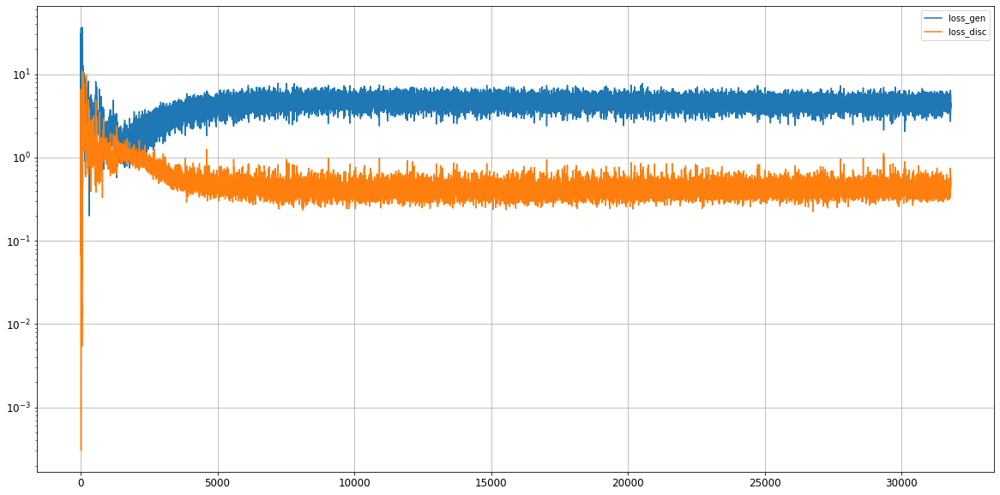

Epoch 31802/50000
0s
Epoch 31803/50000
0s
Epoch 31804/50000
0s
Epoch 31805/50000
0s
Epoch 31806/50000
0s
Epoch 31807/50000
0s
Epoch 31808/50000
0s
Epoch 31809/50000
0s
Epoch 31810/50000
0s
Epoch 31811/50000
0s
Epoch 31812/50000
0s
Epoch 31813/50000
0s
Epoch 31814/50000
0s
Epoch 31815/50000
0s
Epoch 31816/50000
0s
Epoch 31817/50000
0s
Epoch 31818/50000
0s
Epoch 31819/50000
0s
Epoch 31820/50000
0s
Epoch 31821/50000
0s
Epoch 31822/50000
0s
Epoch 31823/50000
0s
Epoch 31824/50000
0s
Epoch 31825/50000
0s
Epoch 31826/50000
0s
Epoch 31827/50000
0s
Epoch 31828/50000
0s
Epoch 31829/50000
0s
Epoch 31830/50000
0s
Epoch 31831/50000
0s
Epoch 31832/50000
0s
Epoch 31833/50000
0s
Epoch 31834/50000
0s
Epoch 31835/50000
0s
Epoch 31836/50000
0s
Epoch 31837/50000
0s
Epoch 31838/50000
0s
Epoch 31839/50000
0s
Epoch 31840/50000
0s
Epoch 31841/50000
0s
Epoch 31842/50000
0s
Epoch 31843/50000
0s
Epoch 31844/50000
0s
Epoch 31845/50000
0s
Epoch 31846/50000
0s
Epoch 31847/50000
0s
Epoch 31848/50000
0s
Epoch 31849/5

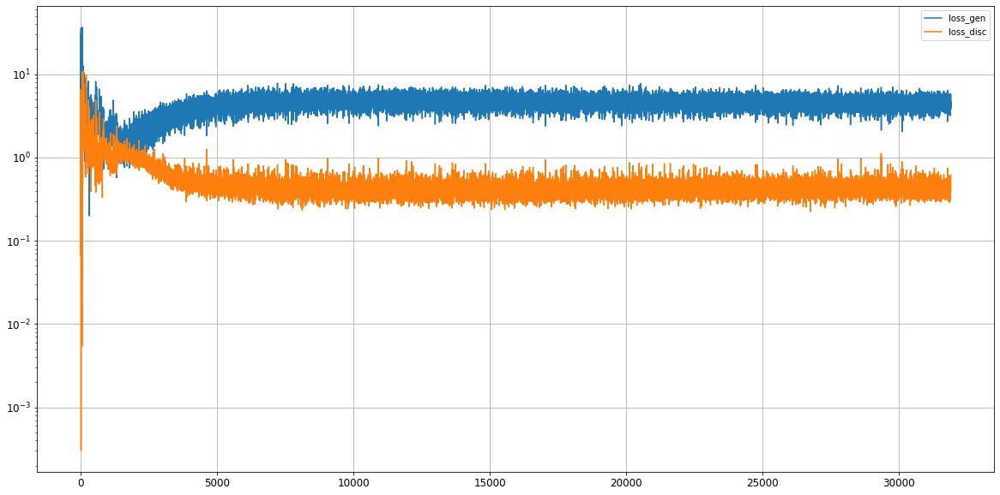

Epoch 31902/50000
0s
Epoch 31903/50000
0s
Epoch 31904/50000
0s
Epoch 31905/50000
0s
Epoch 31906/50000
0s
Epoch 31907/50000
0s
Epoch 31908/50000
0s
Epoch 31909/50000
0s
Epoch 31910/50000
0s
Epoch 31911/50000
0s
Epoch 31912/50000
0s
Epoch 31913/50000
0s
Epoch 31914/50000
0s
Epoch 31915/50000
0s
Epoch 31916/50000
0s
Epoch 31917/50000
0s
Epoch 31918/50000
0s
Epoch 31919/50000
0s
Epoch 31920/50000
0s
Epoch 31921/50000
0s
Epoch 31922/50000
0s
Epoch 31923/50000
0s
Epoch 31924/50000
0s
Epoch 31925/50000
0s
Epoch 31926/50000
0s
Epoch 31927/50000
0s
Epoch 31928/50000
0s
Epoch 31929/50000
0s
Epoch 31930/50000
0s
Epoch 31931/50000
0s
Epoch 31932/50000
0s
Epoch 31933/50000
0s
Epoch 31934/50000
0s
Epoch 31935/50000
0s
Epoch 31936/50000
0s
Epoch 31937/50000
0s
Epoch 31938/50000
0s
Epoch 31939/50000
0s
Epoch 31940/50000
0s
Epoch 31941/50000
0s
Epoch 31942/50000
0s
Epoch 31943/50000
0s
Epoch 31944/50000
0s
Epoch 31945/50000
0s
Epoch 31946/50000
0s
Epoch 31947/50000
0s
Epoch 31948/50000
0s
Epoch 31949/5

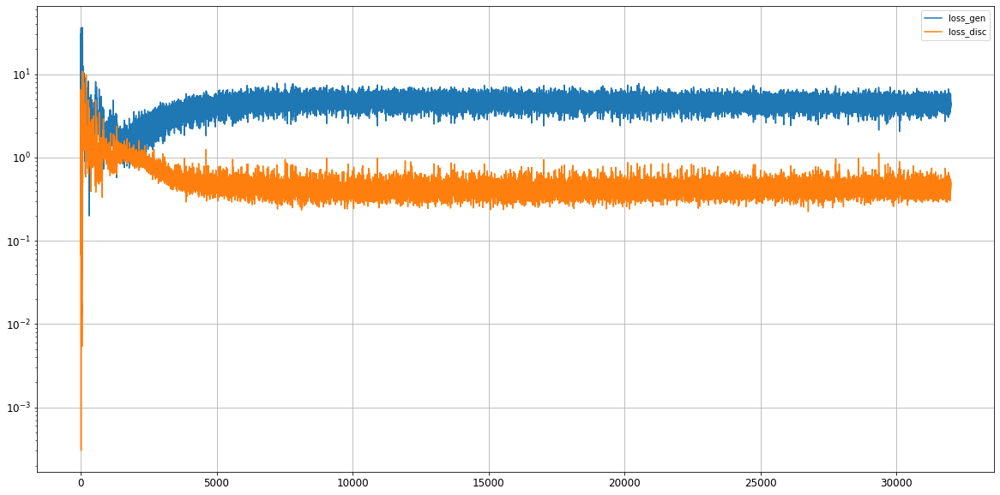

Epoch 32002/50000
0s
Epoch 32003/50000
0s
Epoch 32004/50000
0s
Epoch 32005/50000
0s
Epoch 32006/50000
0s
Epoch 32007/50000
0s
Epoch 32008/50000
0s
Epoch 32009/50000
0s
Epoch 32010/50000
0s
Epoch 32011/50000
0s
Epoch 32012/50000
0s
Epoch 32013/50000
0s
Epoch 32014/50000
0s
Epoch 32015/50000
0s
Epoch 32016/50000
0s
Epoch 32017/50000
0s
Epoch 32018/50000
0s
Epoch 32019/50000
0s
Epoch 32020/50000
0s
Epoch 32021/50000
0s
Epoch 32022/50000
0s
Epoch 32023/50000
0s
Epoch 32024/50000
0s
Epoch 32025/50000
0s
Epoch 32026/50000
0s
Epoch 32027/50000
0s
Epoch 32028/50000
0s
Epoch 32029/50000
0s
Epoch 32030/50000
0s
Epoch 32031/50000
0s
Epoch 32032/50000
0s
Epoch 32033/50000
0s
Epoch 32034/50000
0s
Epoch 32035/50000
0s
Epoch 32036/50000
0s
Epoch 32037/50000
0s
Epoch 32038/50000
0s
Epoch 32039/50000
0s
Epoch 32040/50000
0s
Epoch 32041/50000
0s
Epoch 32042/50000
0s
Epoch 32043/50000
0s
Epoch 32044/50000
0s
Epoch 32045/50000
0s
Epoch 32046/50000
0s
Epoch 32047/50000
0s
Epoch 32048/50000
0s
Epoch 32049/5

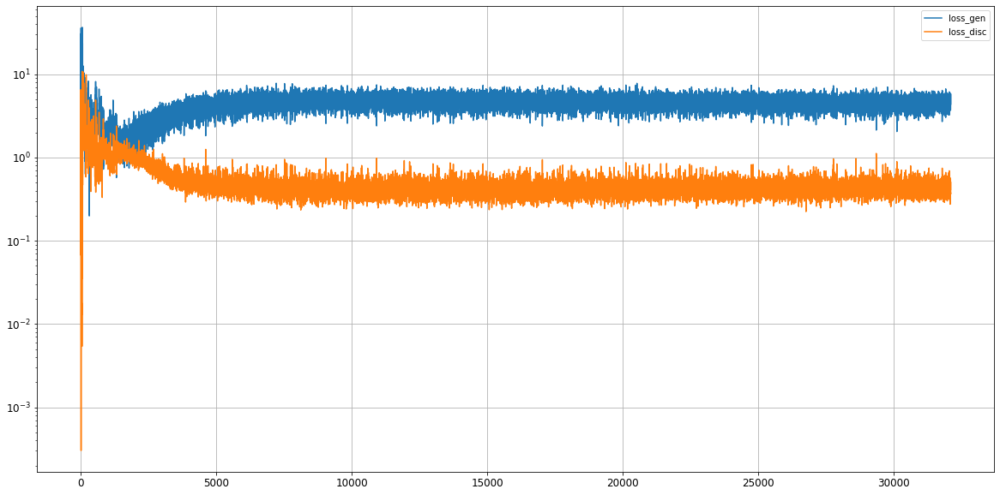

Epoch 32102/50000
0s
Epoch 32103/50000
0s
Epoch 32104/50000
0s
Epoch 32105/50000
0s
Epoch 32106/50000
0s
Epoch 32107/50000
0s
Epoch 32108/50000
0s
Epoch 32109/50000
0s
Epoch 32110/50000
0s
Epoch 32111/50000
0s
Epoch 32112/50000
0s
Epoch 32113/50000
0s
Epoch 32114/50000
0s
Epoch 32115/50000
0s
Epoch 32116/50000
0s
Epoch 32117/50000
0s
Epoch 32118/50000
0s
Epoch 32119/50000
0s
Epoch 32120/50000
0s
Epoch 32121/50000
0s
Epoch 32122/50000
0s
Epoch 32123/50000
0s
Epoch 32124/50000
0s
Epoch 32125/50000
0s
Epoch 32126/50000
0s
Epoch 32127/50000
0s
Epoch 32128/50000
0s
Epoch 32129/50000
0s
Epoch 32130/50000
0s
Epoch 32131/50000
0s
Epoch 32132/50000
0s
Epoch 32133/50000
0s
Epoch 32134/50000
0s
Epoch 32135/50000
0s
Epoch 32136/50000
0s
Epoch 32137/50000
0s
Epoch 32138/50000
0s
Epoch 32139/50000
0s
Epoch 32140/50000
0s
Epoch 32141/50000
0s
Epoch 32142/50000
0s
Epoch 32143/50000
0s
Epoch 32144/50000
0s
Epoch 32145/50000
0s
Epoch 32146/50000
0s
Epoch 32147/50000
0s
Epoch 32148/50000
0s
Epoch 32149/5

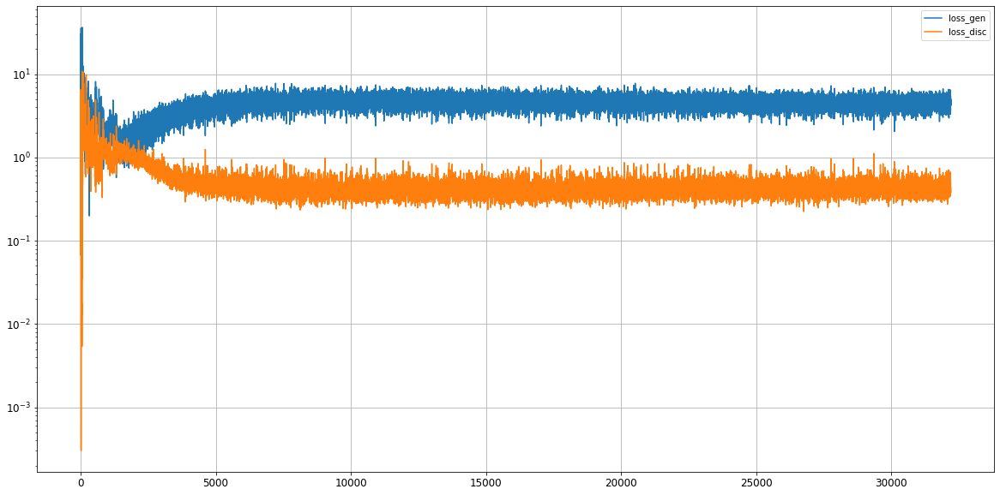

Epoch 32202/50000
0s
Epoch 32203/50000
0s
Epoch 32204/50000
0s
Epoch 32205/50000
0s
Epoch 32206/50000
0s
Epoch 32207/50000
0s
Epoch 32208/50000
0s
Epoch 32209/50000
0s
Epoch 32210/50000
0s
Epoch 32211/50000
0s
Epoch 32212/50000
0s
Epoch 32213/50000
0s
Epoch 32214/50000
0s
Epoch 32215/50000
0s
Epoch 32216/50000
0s
Epoch 32217/50000
0s
Epoch 32218/50000
0s
Epoch 32219/50000
0s
Epoch 32220/50000
0s
Epoch 32221/50000
0s
Epoch 32222/50000
0s
Epoch 32223/50000
0s
Epoch 32224/50000
0s
Epoch 32225/50000
0s
Epoch 32226/50000
0s
Epoch 32227/50000
0s
Epoch 32228/50000
0s
Epoch 32229/50000
0s
Epoch 32230/50000
0s
Epoch 32231/50000
0s
Epoch 32232/50000
0s
Epoch 32233/50000
0s
Epoch 32234/50000
0s
Epoch 32235/50000
0s
Epoch 32236/50000
0s
Epoch 32237/50000
0s
Epoch 32238/50000
0s
Epoch 32239/50000
0s
Epoch 32240/50000
0s
Epoch 32241/50000
0s
Epoch 32242/50000
0s
Epoch 32243/50000
0s
Epoch 32244/50000
0s
Epoch 32245/50000
0s
Epoch 32246/50000
0s
Epoch 32247/50000
0s
Epoch 32248/50000
0s
Epoch 32249/5

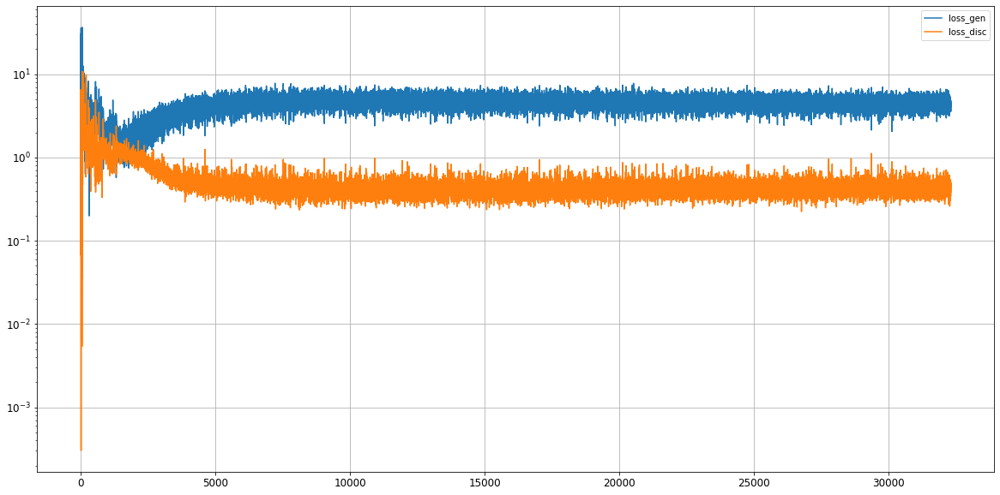

Epoch 32302/50000
0s
Epoch 32303/50000
0s
Epoch 32304/50000
0s
Epoch 32305/50000
0s
Epoch 32306/50000
0s
Epoch 32307/50000
0s
Epoch 32308/50000
0s
Epoch 32309/50000
0s
Epoch 32310/50000
0s
Epoch 32311/50000
0s
Epoch 32312/50000
0s
Epoch 32313/50000
0s
Epoch 32314/50000
0s
Epoch 32315/50000
0s
Epoch 32316/50000
0s
Epoch 32317/50000
0s
Epoch 32318/50000
0s
Epoch 32319/50000
0s
Epoch 32320/50000
0s
Epoch 32321/50000
0s
Epoch 32322/50000
0s
Epoch 32323/50000
0s
Epoch 32324/50000
0s
Epoch 32325/50000
0s
Epoch 32326/50000
0s
Epoch 32327/50000
0s
Epoch 32328/50000
0s
Epoch 32329/50000
0s
Epoch 32330/50000
0s
Epoch 32331/50000
0s
Epoch 32332/50000
0s
Epoch 32333/50000
0s
Epoch 32334/50000
0s
Epoch 32335/50000
0s
Epoch 32336/50000
0s
Epoch 32337/50000
0s
Epoch 32338/50000
0s
Epoch 32339/50000
0s
Epoch 32340/50000
0s
Epoch 32341/50000
0s
Epoch 32342/50000
0s
Epoch 32343/50000
0s
Epoch 32344/50000
0s
Epoch 32345/50000
0s
Epoch 32346/50000
0s
Epoch 32347/50000
0s
Epoch 32348/50000
0s
Epoch 32349/5

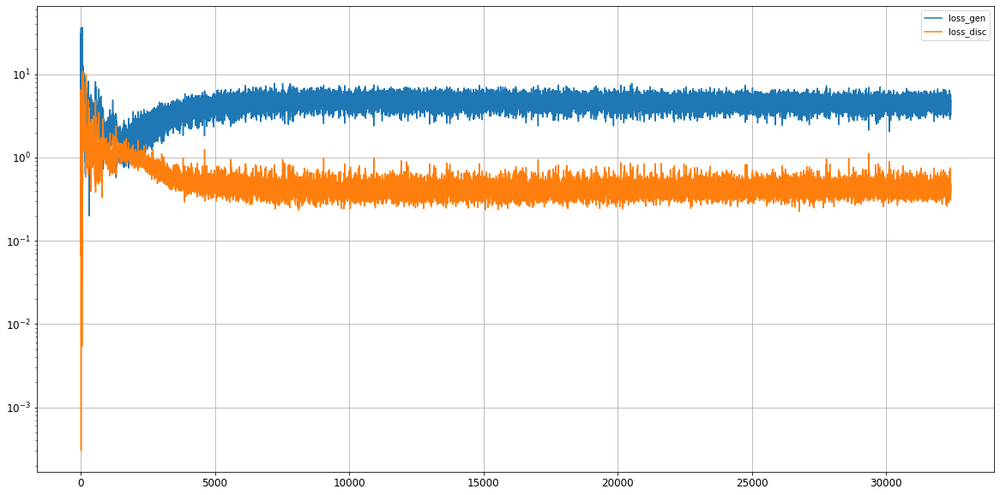

Epoch 32402/50000
0s
Epoch 32403/50000
0s
Epoch 32404/50000
0s
Epoch 32405/50000
0s
Epoch 32406/50000
0s
Epoch 32407/50000
0s
Epoch 32408/50000
0s
Epoch 32409/50000
0s
Epoch 32410/50000
0s
Epoch 32411/50000
0s
Epoch 32412/50000
0s
Epoch 32413/50000
0s
Epoch 32414/50000
0s
Epoch 32415/50000
0s
Epoch 32416/50000
0s
Epoch 32417/50000
0s
Epoch 32418/50000
0s
Epoch 32419/50000
0s
Epoch 32420/50000
0s
Epoch 32421/50000
0s
Epoch 32422/50000
0s
Epoch 32423/50000
0s
Epoch 32424/50000
0s
Epoch 32425/50000
0s
Epoch 32426/50000
0s
Epoch 32427/50000
0s
Epoch 32428/50000
0s
Epoch 32429/50000
0s
Epoch 32430/50000
0s
Epoch 32431/50000
0s
Epoch 32432/50000
0s
Epoch 32433/50000
0s
Epoch 32434/50000
0s
Epoch 32435/50000
0s
Epoch 32436/50000
0s
Epoch 32437/50000
0s
Epoch 32438/50000
0s
Epoch 32439/50000
0s
Epoch 32440/50000
0s
Epoch 32441/50000
0s
Epoch 32442/50000
0s
Epoch 32443/50000
0s
Epoch 32444/50000
0s
Epoch 32445/50000
0s
Epoch 32446/50000
0s
Epoch 32447/50000
0s
Epoch 32448/50000
0s
Epoch 32449/5

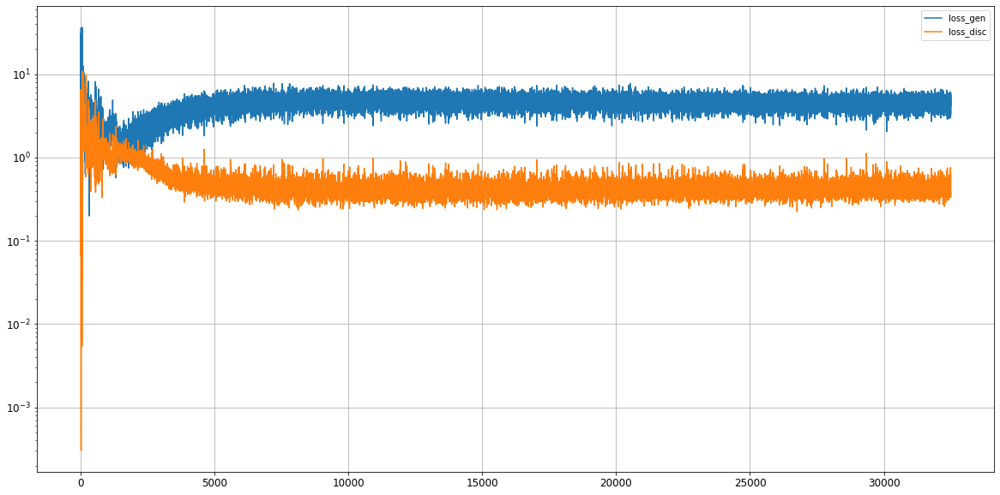

Epoch 32502/50000
0s
Epoch 32503/50000
0s
Epoch 32504/50000
0s
Epoch 32505/50000
0s
Epoch 32506/50000
0s
Epoch 32507/50000
0s
Epoch 32508/50000
0s
Epoch 32509/50000
0s
Epoch 32510/50000
0s
Epoch 32511/50000
0s
Epoch 32512/50000
0s
Epoch 32513/50000
0s
Epoch 32514/50000
0s
Epoch 32515/50000
0s
Epoch 32516/50000
0s
Epoch 32517/50000
0s
Epoch 32518/50000
0s
Epoch 32519/50000
0s
Epoch 32520/50000
0s
Epoch 32521/50000
0s
Epoch 32522/50000
0s
Epoch 32523/50000
0s
Epoch 32524/50000
0s
Epoch 32525/50000
0s
Epoch 32526/50000
0s
Epoch 32527/50000
0s
Epoch 32528/50000
0s
Epoch 32529/50000
0s
Epoch 32530/50000
0s
Epoch 32531/50000
0s
Epoch 32532/50000
0s
Epoch 32533/50000
0s
Epoch 32534/50000
0s
Epoch 32535/50000
0s
Epoch 32536/50000
0s
Epoch 32537/50000
0s
Epoch 32538/50000
0s
Epoch 32539/50000
0s
Epoch 32540/50000
0s
Epoch 32541/50000
0s
Epoch 32542/50000
0s
Epoch 32543/50000
0s
Epoch 32544/50000
0s
Epoch 32545/50000
0s
Epoch 32546/50000
0s
Epoch 32547/50000
0s
Epoch 32548/50000
0s
Epoch 32549/5

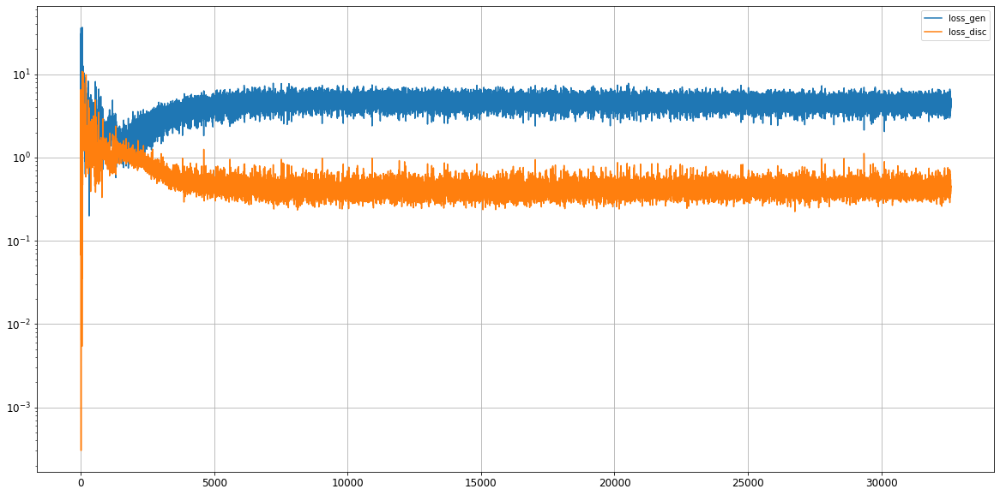

Epoch 32602/50000
0s
Epoch 32603/50000
0s
Epoch 32604/50000
0s
Epoch 32605/50000
0s
Epoch 32606/50000
0s
Epoch 32607/50000
0s
Epoch 32608/50000
0s
Epoch 32609/50000
0s
Epoch 32610/50000
0s
Epoch 32611/50000
0s
Epoch 32612/50000
0s
Epoch 32613/50000
0s
Epoch 32614/50000
0s
Epoch 32615/50000
0s
Epoch 32616/50000
0s
Epoch 32617/50000
0s
Epoch 32618/50000
0s
Epoch 32619/50000
0s
Epoch 32620/50000
0s
Epoch 32621/50000
0s
Epoch 32622/50000
0s
Epoch 32623/50000
0s
Epoch 32624/50000
0s
Epoch 32625/50000
0s
Epoch 32626/50000
0s
Epoch 32627/50000
0s
Epoch 32628/50000
0s
Epoch 32629/50000
0s
Epoch 32630/50000
0s
Epoch 32631/50000
0s
Epoch 32632/50000
0s
Epoch 32633/50000
0s
Epoch 32634/50000
0s
Epoch 32635/50000
0s
Epoch 32636/50000
0s
Epoch 32637/50000
0s
Epoch 32638/50000
0s
Epoch 32639/50000
0s
Epoch 32640/50000
0s
Epoch 32641/50000
0s
Epoch 32642/50000
0s
Epoch 32643/50000
0s
Epoch 32644/50000
0s
Epoch 32645/50000
0s
Epoch 32646/50000
0s
Epoch 32647/50000
0s
Epoch 32648/50000
0s
Epoch 32649/5

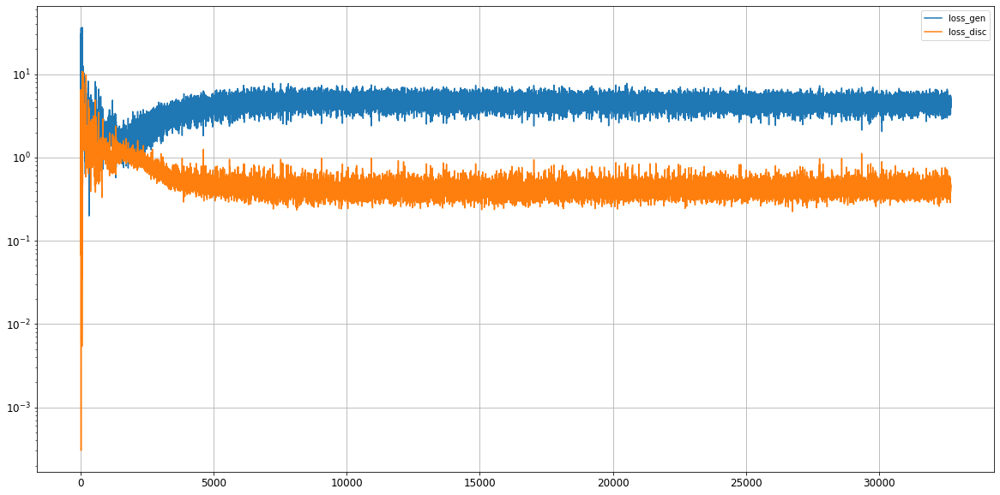

Epoch 32702/50000
0s
Epoch 32703/50000
0s
Epoch 32704/50000
0s
Epoch 32705/50000
0s
Epoch 32706/50000
0s
Epoch 32707/50000
0s
Epoch 32708/50000
0s
Epoch 32709/50000
0s
Epoch 32710/50000
0s
Epoch 32711/50000
0s
Epoch 32712/50000
0s
Epoch 32713/50000
0s
Epoch 32714/50000
0s
Epoch 32715/50000
0s
Epoch 32716/50000
0s
Epoch 32717/50000
0s
Epoch 32718/50000
0s
Epoch 32719/50000
0s
Epoch 32720/50000
0s
Epoch 32721/50000
0s
Epoch 32722/50000
0s
Epoch 32723/50000
0s
Epoch 32724/50000
0s
Epoch 32725/50000
0s
Epoch 32726/50000
0s
Epoch 32727/50000
0s
Epoch 32728/50000
0s
Epoch 32729/50000
0s
Epoch 32730/50000
0s
Epoch 32731/50000
0s
Epoch 32732/50000
0s
Epoch 32733/50000
0s
Epoch 32734/50000
0s
Epoch 32735/50000
0s
Epoch 32736/50000
0s
Epoch 32737/50000
0s
Epoch 32738/50000
0s
Epoch 32739/50000
0s
Epoch 32740/50000
0s
Epoch 32741/50000
0s
Epoch 32742/50000
0s
Epoch 32743/50000
0s
Epoch 32744/50000
0s
Epoch 32745/50000
0s
Epoch 32746/50000
0s
Epoch 32747/50000
0s
Epoch 32748/50000
0s
Epoch 32749/5

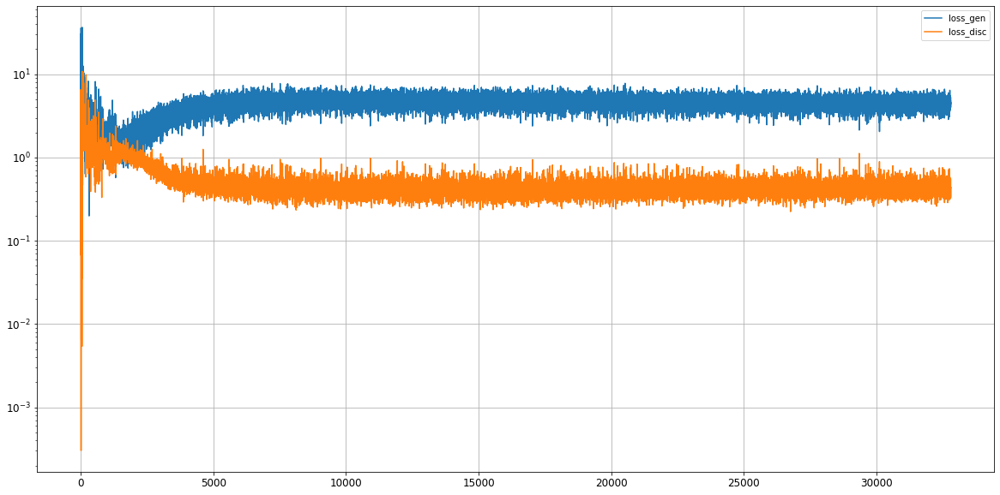

Epoch 32802/50000
0s
Epoch 32803/50000
0s
Epoch 32804/50000
0s
Epoch 32805/50000
0s
Epoch 32806/50000
0s
Epoch 32807/50000
0s
Epoch 32808/50000
0s
Epoch 32809/50000
0s
Epoch 32810/50000
0s
Epoch 32811/50000
0s
Epoch 32812/50000
0s
Epoch 32813/50000
0s
Epoch 32814/50000
0s
Epoch 32815/50000
0s
Epoch 32816/50000
0s
Epoch 32817/50000
0s
Epoch 32818/50000
0s
Epoch 32819/50000
0s
Epoch 32820/50000
0s
Epoch 32821/50000
0s
Epoch 32822/50000
0s
Epoch 32823/50000
0s
Epoch 32824/50000
0s
Epoch 32825/50000
0s
Epoch 32826/50000
0s
Epoch 32827/50000
0s
Epoch 32828/50000
0s
Epoch 32829/50000
0s
Epoch 32830/50000
0s
Epoch 32831/50000
0s
Epoch 32832/50000
0s
Epoch 32833/50000
0s
Epoch 32834/50000
0s
Epoch 32835/50000
0s
Epoch 32836/50000
0s
Epoch 32837/50000
0s
Epoch 32838/50000
0s
Epoch 32839/50000
0s
Epoch 32840/50000
0s
Epoch 32841/50000
0s
Epoch 32842/50000
0s
Epoch 32843/50000
0s
Epoch 32844/50000
0s
Epoch 32845/50000
0s
Epoch 32846/50000
0s
Epoch 32847/50000
0s
Epoch 32848/50000
0s
Epoch 32849/5

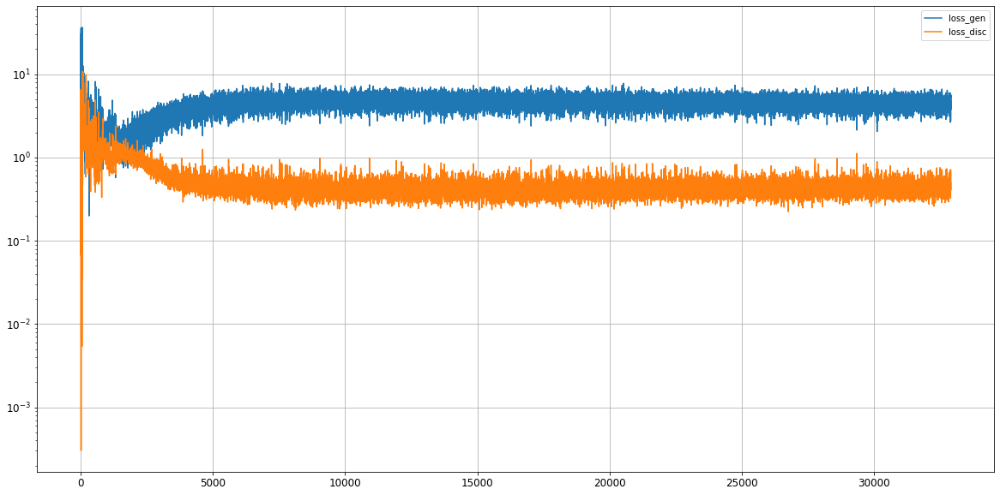

Epoch 32902/50000
0s
Epoch 32903/50000
0s
Epoch 32904/50000
0s
Epoch 32905/50000
0s
Epoch 32906/50000
0s
Epoch 32907/50000
0s
Epoch 32908/50000
0s
Epoch 32909/50000
0s
Epoch 32910/50000
0s
Epoch 32911/50000
0s
Epoch 32912/50000
0s
Epoch 32913/50000
0s
Epoch 32914/50000
0s
Epoch 32915/50000
0s
Epoch 32916/50000
0s
Epoch 32917/50000
0s
Epoch 32918/50000
0s
Epoch 32919/50000
0s
Epoch 32920/50000
0s
Epoch 32921/50000
0s
Epoch 32922/50000
0s
Epoch 32923/50000
0s
Epoch 32924/50000
0s
Epoch 32925/50000
0s
Epoch 32926/50000
0s
Epoch 32927/50000
0s
Epoch 32928/50000
0s
Epoch 32929/50000
0s
Epoch 32930/50000
0s
Epoch 32931/50000
0s
Epoch 32932/50000
0s
Epoch 32933/50000
0s
Epoch 32934/50000
0s
Epoch 32935/50000
0s
Epoch 32936/50000
0s
Epoch 32937/50000
0s
Epoch 32938/50000
0s
Epoch 32939/50000
0s
Epoch 32940/50000
0s
Epoch 32941/50000
0s
Epoch 32942/50000
0s
Epoch 32943/50000
0s
Epoch 32944/50000
0s
Epoch 32945/50000
0s
Epoch 32946/50000
0s
Epoch 32947/50000
0s
Epoch 32948/50000
0s
Epoch 32949/5

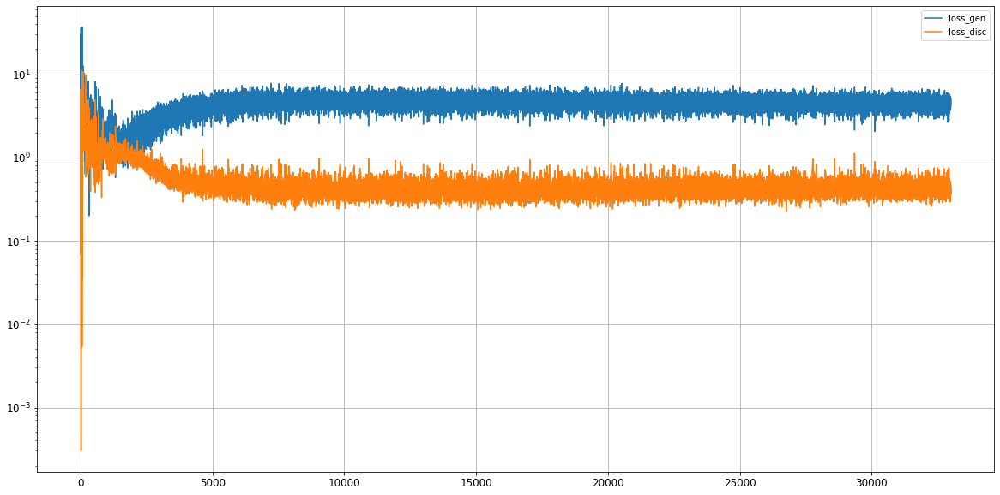

Epoch 33002/50000
0s
Epoch 33003/50000
0s
Epoch 33004/50000
0s
Epoch 33005/50000
0s
Epoch 33006/50000
0s
Epoch 33007/50000
0s
Epoch 33008/50000
0s
Epoch 33009/50000
0s
Epoch 33010/50000
0s
Epoch 33011/50000
0s
Epoch 33012/50000
0s
Epoch 33013/50000
0s
Epoch 33014/50000
0s
Epoch 33015/50000
0s
Epoch 33016/50000
0s
Epoch 33017/50000
0s
Epoch 33018/50000
0s
Epoch 33019/50000
0s
Epoch 33020/50000
0s
Epoch 33021/50000
0s
Epoch 33022/50000
0s
Epoch 33023/50000
0s
Epoch 33024/50000
0s
Epoch 33025/50000
0s
Epoch 33026/50000
0s
Epoch 33027/50000
0s
Epoch 33028/50000
0s
Epoch 33029/50000
0s
Epoch 33030/50000
0s
Epoch 33031/50000
0s
Epoch 33032/50000
0s
Epoch 33033/50000
0s
Epoch 33034/50000
0s
Epoch 33035/50000
0s
Epoch 33036/50000
0s
Epoch 33037/50000
0s
Epoch 33038/50000
0s
Epoch 33039/50000
0s
Epoch 33040/50000
0s
Epoch 33041/50000
0s
Epoch 33042/50000
0s
Epoch 33043/50000
0s
Epoch 33044/50000
0s
Epoch 33045/50000
0s
Epoch 33046/50000
0s
Epoch 33047/50000
0s
Epoch 33048/50000
0s
Epoch 33049/5

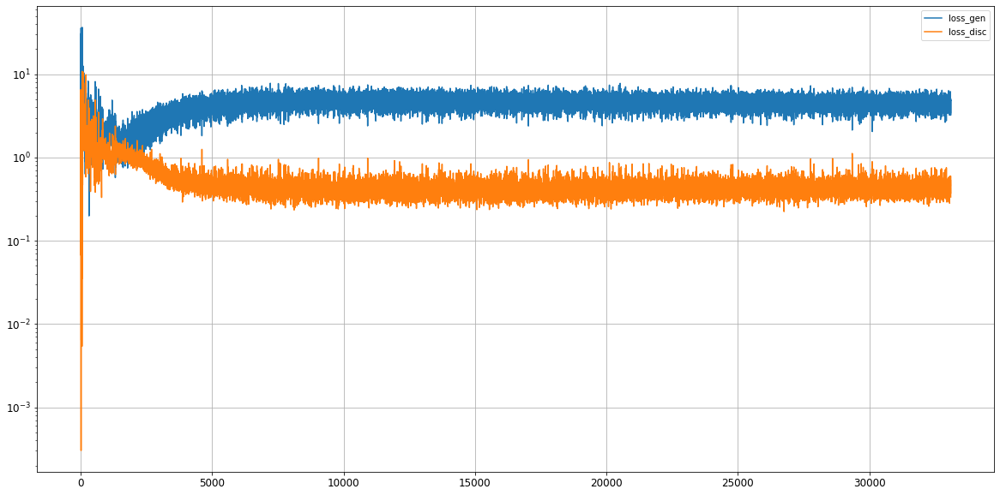

Epoch 33102/50000
0s
Epoch 33103/50000
0s
Epoch 33104/50000
0s
Epoch 33105/50000
0s
Epoch 33106/50000
0s
Epoch 33107/50000
0s
Epoch 33108/50000
0s
Epoch 33109/50000
0s
Epoch 33110/50000
0s
Epoch 33111/50000
0s
Epoch 33112/50000
0s
Epoch 33113/50000
0s
Epoch 33114/50000
0s
Epoch 33115/50000
0s
Epoch 33116/50000
0s
Epoch 33117/50000
0s
Epoch 33118/50000
0s
Epoch 33119/50000
0s
Epoch 33120/50000
0s
Epoch 33121/50000
0s
Epoch 33122/50000
0s
Epoch 33123/50000
0s
Epoch 33124/50000
0s
Epoch 33125/50000
0s
Epoch 33126/50000
0s
Epoch 33127/50000
0s
Epoch 33128/50000
0s
Epoch 33129/50000
0s
Epoch 33130/50000
0s
Epoch 33131/50000
0s
Epoch 33132/50000
0s
Epoch 33133/50000
0s
Epoch 33134/50000
0s
Epoch 33135/50000
0s
Epoch 33136/50000
0s
Epoch 33137/50000
0s
Epoch 33138/50000
0s
Epoch 33139/50000
0s
Epoch 33140/50000
0s
Epoch 33141/50000
0s
Epoch 33142/50000
0s
Epoch 33143/50000
0s
Epoch 33144/50000
0s
Epoch 33145/50000
0s
Epoch 33146/50000
0s
Epoch 33147/50000
0s
Epoch 33148/50000
0s
Epoch 33149/5

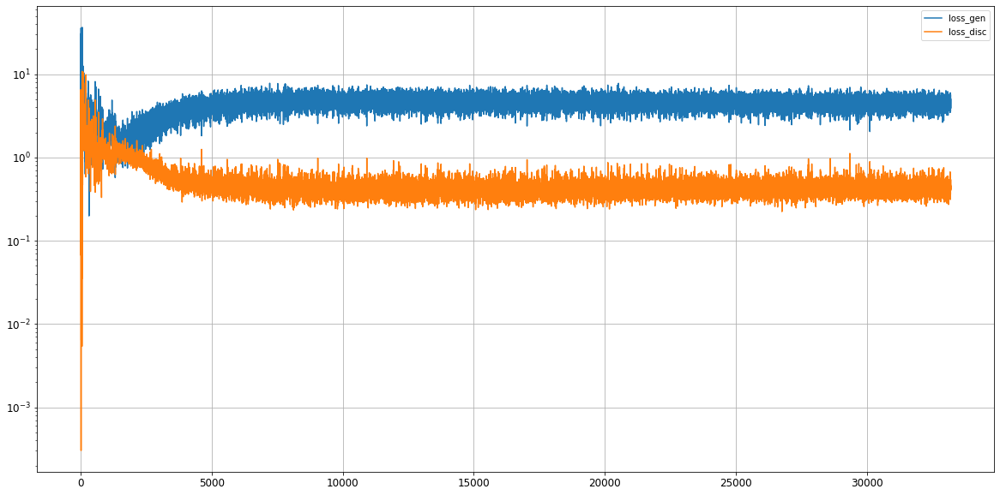

Epoch 33202/50000
0s
Epoch 33203/50000
0s
Epoch 33204/50000
0s
Epoch 33205/50000
0s
Epoch 33206/50000
0s
Epoch 33207/50000
0s
Epoch 33208/50000
0s
Epoch 33209/50000
0s
Epoch 33210/50000
0s
Epoch 33211/50000
0s
Epoch 33212/50000
0s
Epoch 33213/50000
0s
Epoch 33214/50000
0s
Epoch 33215/50000
0s
Epoch 33216/50000
0s
Epoch 33217/50000
0s
Epoch 33218/50000
0s
Epoch 33219/50000
0s
Epoch 33220/50000
0s
Epoch 33221/50000
0s
Epoch 33222/50000
0s
Epoch 33223/50000
0s
Epoch 33224/50000
0s
Epoch 33225/50000
0s
Epoch 33226/50000
0s
Epoch 33227/50000
0s
Epoch 33228/50000
0s
Epoch 33229/50000
0s
Epoch 33230/50000
0s
Epoch 33231/50000
0s
Epoch 33232/50000
0s
Epoch 33233/50000
0s
Epoch 33234/50000
0s
Epoch 33235/50000
0s
Epoch 33236/50000
0s
Epoch 33237/50000
0s
Epoch 33238/50000
0s
Epoch 33239/50000
0s
Epoch 33240/50000
0s
Epoch 33241/50000
0s
Epoch 33242/50000
0s
Epoch 33243/50000
0s
Epoch 33244/50000
0s
Epoch 33245/50000
0s
Epoch 33246/50000
0s
Epoch 33247/50000
0s
Epoch 33248/50000
0s
Epoch 33249/5

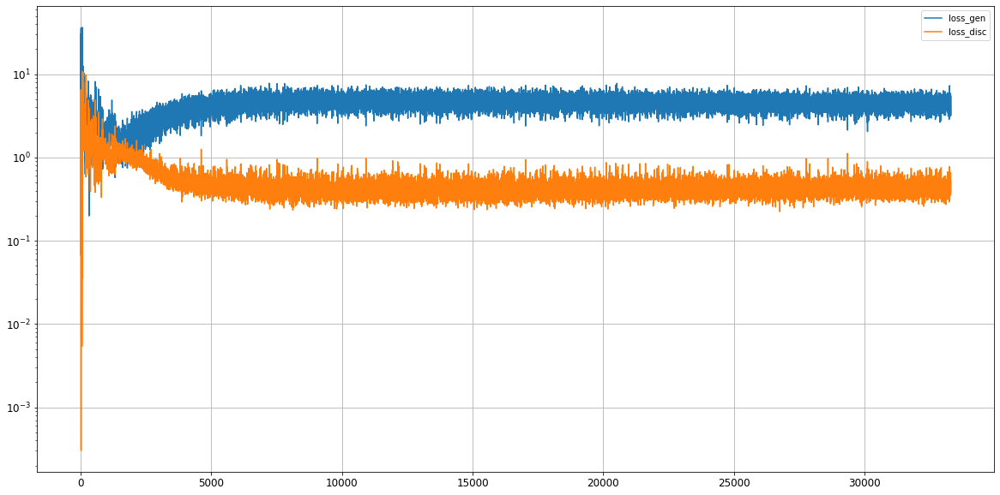

Epoch 33302/50000
0s
Epoch 33303/50000
0s
Epoch 33304/50000
0s
Epoch 33305/50000
0s
Epoch 33306/50000
0s
Epoch 33307/50000
0s
Epoch 33308/50000
0s
Epoch 33309/50000
0s
Epoch 33310/50000
0s
Epoch 33311/50000
0s
Epoch 33312/50000
0s
Epoch 33313/50000
0s
Epoch 33314/50000
0s
Epoch 33315/50000
0s
Epoch 33316/50000
0s
Epoch 33317/50000
0s
Epoch 33318/50000
0s
Epoch 33319/50000
0s
Epoch 33320/50000
0s
Epoch 33321/50000
0s
Epoch 33322/50000
0s
Epoch 33323/50000
0s
Epoch 33324/50000
0s
Epoch 33325/50000
0s
Epoch 33326/50000
0s
Epoch 33327/50000
0s
Epoch 33328/50000
0s
Epoch 33329/50000
0s
Epoch 33330/50000
0s
Epoch 33331/50000
0s
Epoch 33332/50000
0s
Epoch 33333/50000
0s
Epoch 33334/50000
0s
Epoch 33335/50000
0s
Epoch 33336/50000
0s
Epoch 33337/50000
0s
Epoch 33338/50000
0s
Epoch 33339/50000
0s
Epoch 33340/50000
0s
Epoch 33341/50000
0s
Epoch 33342/50000
0s
Epoch 33343/50000
0s
Epoch 33344/50000
0s
Epoch 33345/50000
0s
Epoch 33346/50000
0s
Epoch 33347/50000
0s
Epoch 33348/50000
0s
Epoch 33349/5

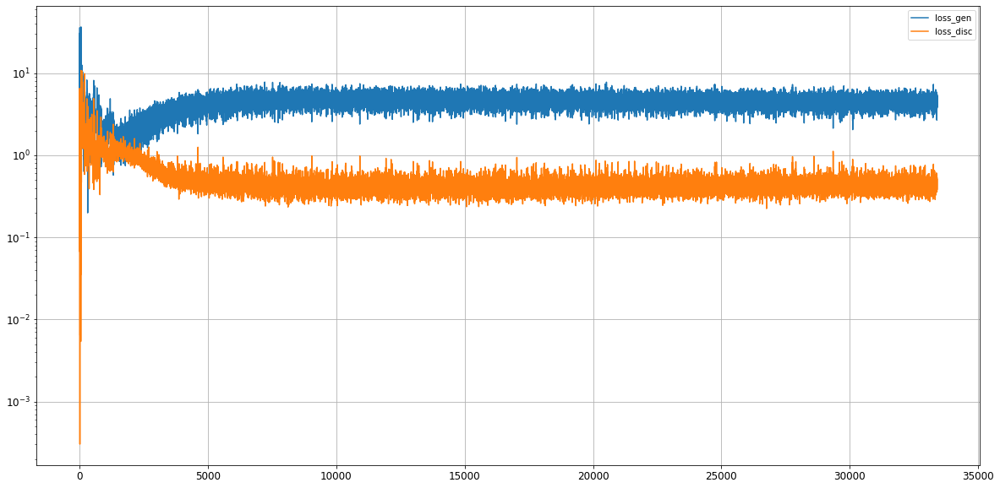

Epoch 33402/50000
0s
Epoch 33403/50000
0s
Epoch 33404/50000
0s
Epoch 33405/50000
0s
Epoch 33406/50000
0s
Epoch 33407/50000
0s
Epoch 33408/50000
0s
Epoch 33409/50000
0s
Epoch 33410/50000
0s
Epoch 33411/50000
0s
Epoch 33412/50000
0s
Epoch 33413/50000
0s
Epoch 33414/50000
0s
Epoch 33415/50000
0s
Epoch 33416/50000
0s
Epoch 33417/50000
0s
Epoch 33418/50000
0s
Epoch 33419/50000
0s
Epoch 33420/50000
0s
Epoch 33421/50000
0s
Epoch 33422/50000
0s
Epoch 33423/50000
0s
Epoch 33424/50000
0s
Epoch 33425/50000
0s
Epoch 33426/50000
0s
Epoch 33427/50000
0s
Epoch 33428/50000
0s
Epoch 33429/50000
0s
Epoch 33430/50000
0s
Epoch 33431/50000
0s
Epoch 33432/50000
0s
Epoch 33433/50000
0s
Epoch 33434/50000
0s
Epoch 33435/50000
0s
Epoch 33436/50000
0s
Epoch 33437/50000
0s
Epoch 33438/50000
0s
Epoch 33439/50000
0s
Epoch 33440/50000
0s
Epoch 33441/50000
0s
Epoch 33442/50000
0s
Epoch 33443/50000
0s
Epoch 33444/50000
0s
Epoch 33445/50000
0s
Epoch 33446/50000
0s
Epoch 33447/50000
0s
Epoch 33448/50000
0s
Epoch 33449/5

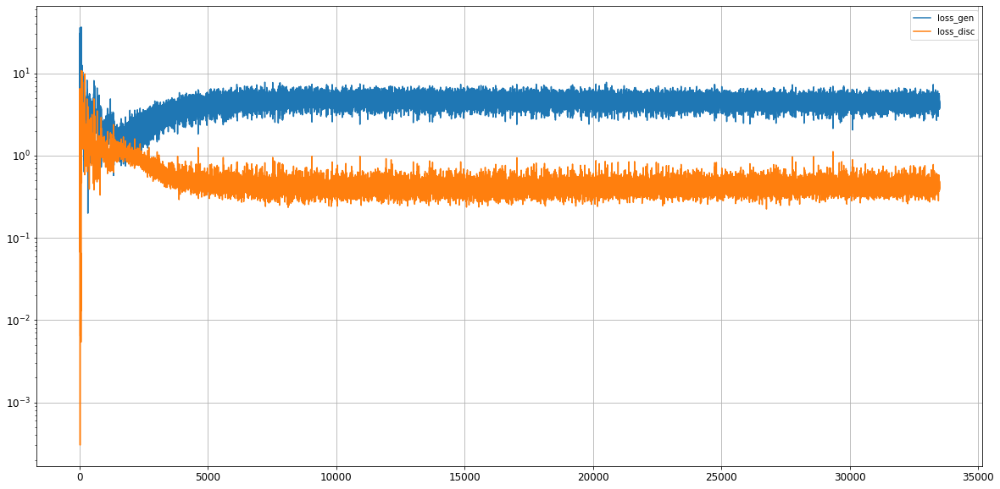

Epoch 33502/50000
0s
Epoch 33503/50000
0s
Epoch 33504/50000
0s
Epoch 33505/50000
0s
Epoch 33506/50000
0s
Epoch 33507/50000
0s
Epoch 33508/50000
0s
Epoch 33509/50000
0s
Epoch 33510/50000
0s
Epoch 33511/50000
0s
Epoch 33512/50000
0s
Epoch 33513/50000
0s
Epoch 33514/50000
0s
Epoch 33515/50000
0s
Epoch 33516/50000
0s
Epoch 33517/50000
0s
Epoch 33518/50000
0s
Epoch 33519/50000
0s
Epoch 33520/50000
0s
Epoch 33521/50000
0s
Epoch 33522/50000
0s
Epoch 33523/50000
0s
Epoch 33524/50000
0s
Epoch 33525/50000
0s
Epoch 33526/50000
0s
Epoch 33527/50000
0s
Epoch 33528/50000
0s
Epoch 33529/50000
0s
Epoch 33530/50000
0s
Epoch 33531/50000
0s
Epoch 33532/50000
0s
Epoch 33533/50000
0s
Epoch 33534/50000
0s
Epoch 33535/50000
0s
Epoch 33536/50000
0s
Epoch 33537/50000
0s
Epoch 33538/50000
0s
Epoch 33539/50000
0s
Epoch 33540/50000
0s
Epoch 33541/50000
0s
Epoch 33542/50000
0s
Epoch 33543/50000
0s
Epoch 33544/50000
0s
Epoch 33545/50000
0s
Epoch 33546/50000
0s
Epoch 33547/50000
0s
Epoch 33548/50000
0s
Epoch 33549/5

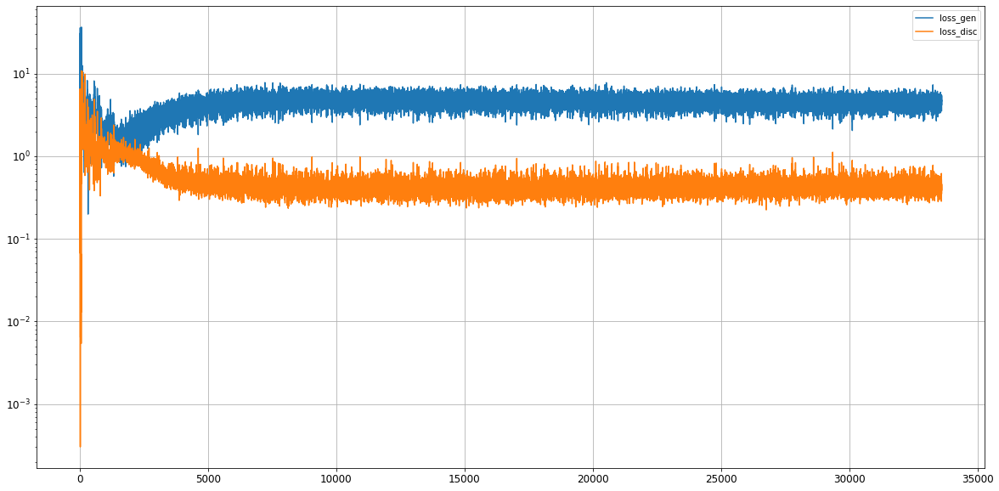

Epoch 33602/50000
0s
Epoch 33603/50000
0s
Epoch 33604/50000
0s
Epoch 33605/50000
0s
Epoch 33606/50000
0s
Epoch 33607/50000
0s
Epoch 33608/50000
0s
Epoch 33609/50000
0s
Epoch 33610/50000
0s
Epoch 33611/50000
0s
Epoch 33612/50000
0s
Epoch 33613/50000
0s
Epoch 33614/50000
0s
Epoch 33615/50000
0s
Epoch 33616/50000
0s
Epoch 33617/50000
0s
Epoch 33618/50000
0s
Epoch 33619/50000
0s
Epoch 33620/50000
0s
Epoch 33621/50000
0s
Epoch 33622/50000
0s
Epoch 33623/50000
0s
Epoch 33624/50000
0s
Epoch 33625/50000
0s
Epoch 33626/50000
0s
Epoch 33627/50000
0s
Epoch 33628/50000
0s
Epoch 33629/50000
0s
Epoch 33630/50000
0s
Epoch 33631/50000
0s
Epoch 33632/50000
0s
Epoch 33633/50000
0s
Epoch 33634/50000
0s
Epoch 33635/50000
0s
Epoch 33636/50000
0s
Epoch 33637/50000
0s
Epoch 33638/50000
0s
Epoch 33639/50000
0s
Epoch 33640/50000
0s
Epoch 33641/50000
0s
Epoch 33642/50000
0s
Epoch 33643/50000
0s
Epoch 33644/50000
0s
Epoch 33645/50000
0s
Epoch 33646/50000
0s
Epoch 33647/50000
0s
Epoch 33648/50000
0s
Epoch 33649/5

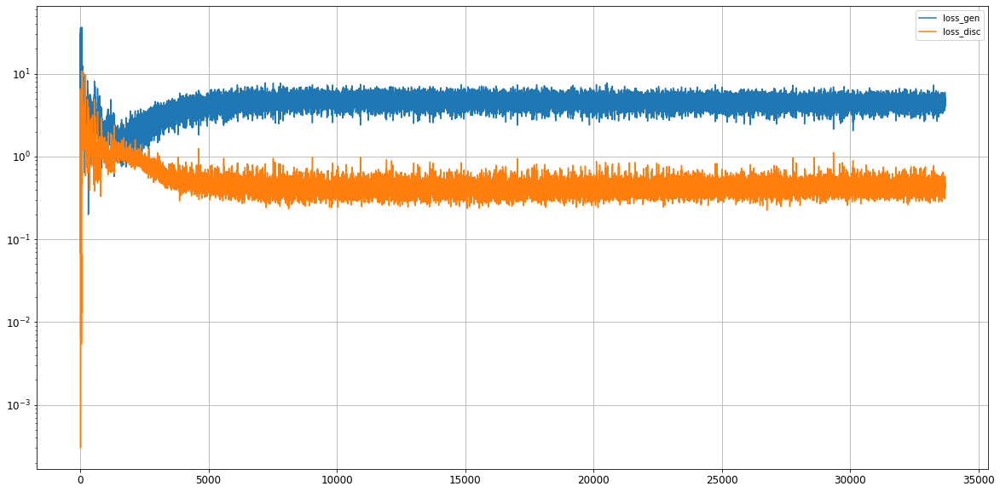

Epoch 33702/50000
0s
Epoch 33703/50000
0s
Epoch 33704/50000
0s
Epoch 33705/50000
0s
Epoch 33706/50000
0s
Epoch 33707/50000
0s
Epoch 33708/50000
0s
Epoch 33709/50000
0s
Epoch 33710/50000
0s
Epoch 33711/50000
0s
Epoch 33712/50000
0s
Epoch 33713/50000
0s
Epoch 33714/50000
0s
Epoch 33715/50000
0s
Epoch 33716/50000
0s
Epoch 33717/50000
0s
Epoch 33718/50000
0s
Epoch 33719/50000
0s
Epoch 33720/50000
0s
Epoch 33721/50000
0s
Epoch 33722/50000
0s
Epoch 33723/50000
0s
Epoch 33724/50000
0s
Epoch 33725/50000
0s
Epoch 33726/50000
0s
Epoch 33727/50000
0s
Epoch 33728/50000
0s
Epoch 33729/50000
0s
Epoch 33730/50000
0s
Epoch 33731/50000
0s
Epoch 33732/50000
0s
Epoch 33733/50000
0s
Epoch 33734/50000
0s
Epoch 33735/50000
0s
Epoch 33736/50000
0s
Epoch 33737/50000
0s
Epoch 33738/50000
0s
Epoch 33739/50000
0s
Epoch 33740/50000
0s
Epoch 33741/50000
0s
Epoch 33742/50000
0s
Epoch 33743/50000
0s
Epoch 33744/50000
0s
Epoch 33745/50000
0s
Epoch 33746/50000
0s
Epoch 33747/50000
0s
Epoch 33748/50000
0s
Epoch 33749/5

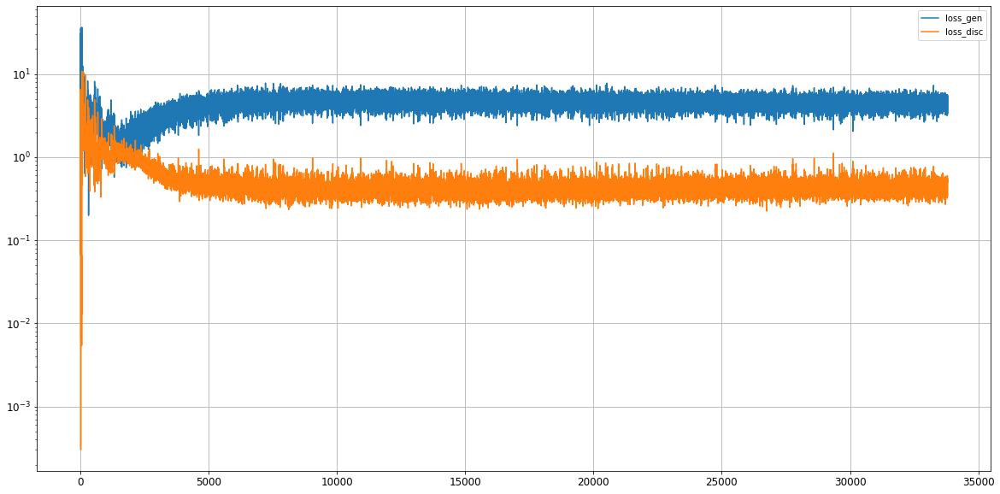

Epoch 33802/50000
0s
Epoch 33803/50000
0s
Epoch 33804/50000
0s
Epoch 33805/50000
0s
Epoch 33806/50000
0s
Epoch 33807/50000
0s
Epoch 33808/50000
0s
Epoch 33809/50000
0s
Epoch 33810/50000
0s
Epoch 33811/50000
0s
Epoch 33812/50000
0s
Epoch 33813/50000
0s
Epoch 33814/50000
0s
Epoch 33815/50000
0s
Epoch 33816/50000
0s
Epoch 33817/50000
0s
Epoch 33818/50000
0s
Epoch 33819/50000
0s
Epoch 33820/50000
0s
Epoch 33821/50000
0s
Epoch 33822/50000
0s
Epoch 33823/50000
0s
Epoch 33824/50000
0s
Epoch 33825/50000
0s
Epoch 33826/50000
0s
Epoch 33827/50000
0s
Epoch 33828/50000
0s
Epoch 33829/50000
0s
Epoch 33830/50000
0s
Epoch 33831/50000
0s
Epoch 33832/50000
0s
Epoch 33833/50000
0s
Epoch 33834/50000
0s
Epoch 33835/50000
0s
Epoch 33836/50000
0s
Epoch 33837/50000
0s
Epoch 33838/50000
0s
Epoch 33839/50000
0s
Epoch 33840/50000
0s
Epoch 33841/50000
0s
Epoch 33842/50000
0s
Epoch 33843/50000
0s
Epoch 33844/50000
0s
Epoch 33845/50000
0s
Epoch 33846/50000
0s
Epoch 33847/50000
0s
Epoch 33848/50000
0s
Epoch 33849/5

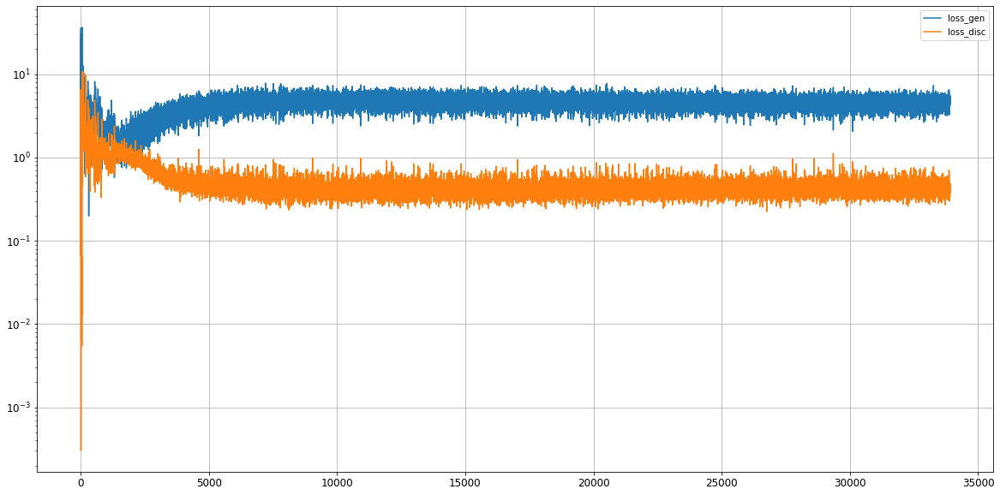

Epoch 33902/50000
0s
Epoch 33903/50000
0s
Epoch 33904/50000
0s
Epoch 33905/50000
0s
Epoch 33906/50000
0s
Epoch 33907/50000
0s
Epoch 33908/50000
0s
Epoch 33909/50000
0s
Epoch 33910/50000
0s
Epoch 33911/50000
0s
Epoch 33912/50000
0s
Epoch 33913/50000
0s
Epoch 33914/50000
0s
Epoch 33915/50000
0s
Epoch 33916/50000
0s
Epoch 33917/50000
0s
Epoch 33918/50000
0s
Epoch 33919/50000
0s
Epoch 33920/50000
0s
Epoch 33921/50000
0s
Epoch 33922/50000
0s
Epoch 33923/50000
0s
Epoch 33924/50000
0s
Epoch 33925/50000
0s
Epoch 33926/50000
0s
Epoch 33927/50000
0s
Epoch 33928/50000
0s
Epoch 33929/50000
0s
Epoch 33930/50000
0s
Epoch 33931/50000
0s
Epoch 33932/50000
0s
Epoch 33933/50000
0s
Epoch 33934/50000
0s
Epoch 33935/50000
0s
Epoch 33936/50000
0s
Epoch 33937/50000
0s
Epoch 33938/50000
0s
Epoch 33939/50000
0s
Epoch 33940/50000
0s
Epoch 33941/50000
0s
Epoch 33942/50000
0s
Epoch 33943/50000
0s
Epoch 33944/50000
0s
Epoch 33945/50000
0s
Epoch 33946/50000
0s
Epoch 33947/50000
0s
Epoch 33948/50000
0s
Epoch 33949/5

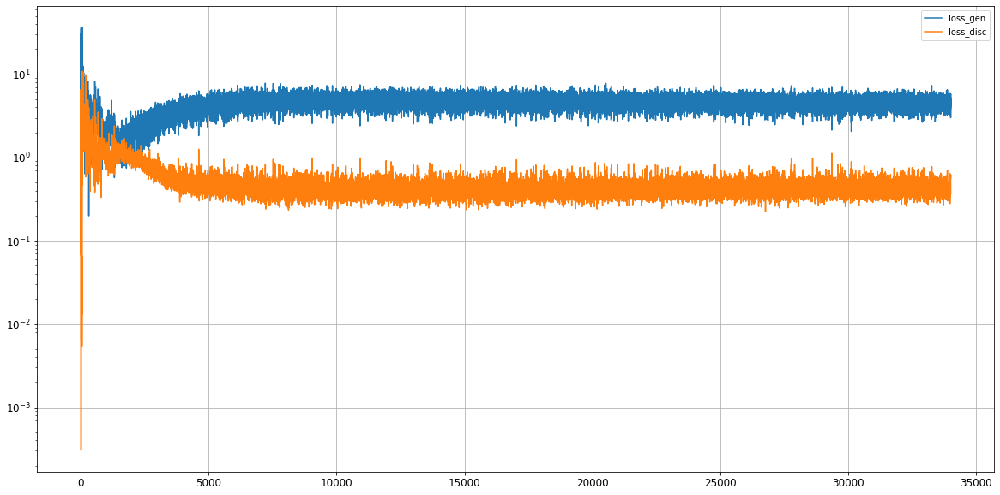

Epoch 34002/50000
0s
Epoch 34003/50000
0s
Epoch 34004/50000
0s
Epoch 34005/50000
0s
Epoch 34006/50000
0s
Epoch 34007/50000
0s
Epoch 34008/50000
0s
Epoch 34009/50000
0s
Epoch 34010/50000
0s
Epoch 34011/50000
0s
Epoch 34012/50000
0s
Epoch 34013/50000
0s
Epoch 34014/50000
0s
Epoch 34015/50000
0s
Epoch 34016/50000
0s
Epoch 34017/50000
0s
Epoch 34018/50000
0s
Epoch 34019/50000
0s
Epoch 34020/50000
0s
Epoch 34021/50000
0s
Epoch 34022/50000
0s
Epoch 34023/50000
0s
Epoch 34024/50000
0s
Epoch 34025/50000
0s
Epoch 34026/50000
0s
Epoch 34027/50000
0s
Epoch 34028/50000
0s
Epoch 34029/50000
0s
Epoch 34030/50000
0s
Epoch 34031/50000
0s
Epoch 34032/50000
0s
Epoch 34033/50000
0s
Epoch 34034/50000
0s
Epoch 34035/50000
0s
Epoch 34036/50000
0s
Epoch 34037/50000
0s
Epoch 34038/50000
0s
Epoch 34039/50000
0s
Epoch 34040/50000
0s
Epoch 34041/50000
0s
Epoch 34042/50000
0s
Epoch 34043/50000
0s
Epoch 34044/50000
0s
Epoch 34045/50000
0s
Epoch 34046/50000
0s
Epoch 34047/50000
0s
Epoch 34048/50000
0s
Epoch 34049/5

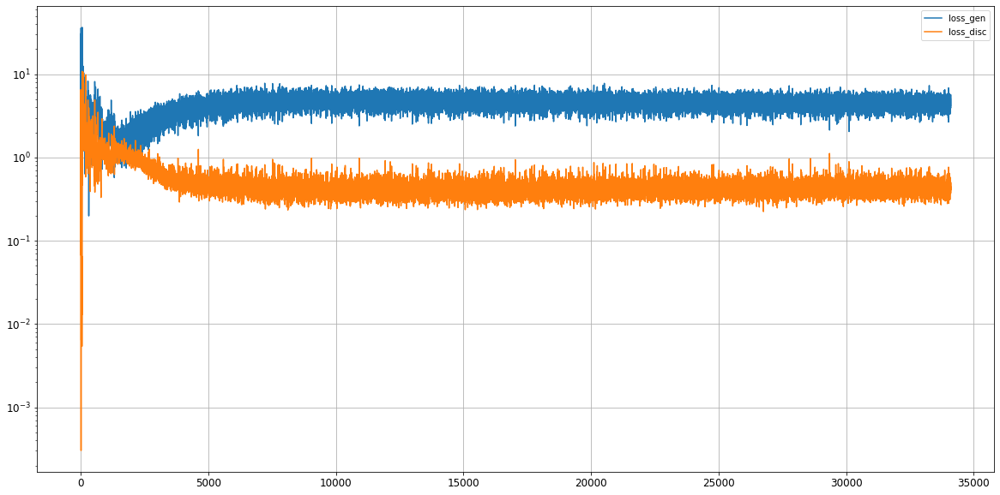

Epoch 34102/50000
0s
Epoch 34103/50000
0s
Epoch 34104/50000
0s
Epoch 34105/50000
0s
Epoch 34106/50000
0s
Epoch 34107/50000
0s
Epoch 34108/50000
0s
Epoch 34109/50000
0s
Epoch 34110/50000
0s
Epoch 34111/50000
0s
Epoch 34112/50000
0s
Epoch 34113/50000
0s
Epoch 34114/50000
0s
Epoch 34115/50000
0s
Epoch 34116/50000
0s
Epoch 34117/50000
0s
Epoch 34118/50000
0s
Epoch 34119/50000
0s
Epoch 34120/50000
0s
Epoch 34121/50000
0s
Epoch 34122/50000
0s
Epoch 34123/50000
0s
Epoch 34124/50000
0s
Epoch 34125/50000
0s
Epoch 34126/50000
0s
Epoch 34127/50000
0s
Epoch 34128/50000
0s
Epoch 34129/50000
0s
Epoch 34130/50000
0s
Epoch 34131/50000
0s
Epoch 34132/50000
0s
Epoch 34133/50000
0s
Epoch 34134/50000
0s
Epoch 34135/50000
0s
Epoch 34136/50000
0s
Epoch 34137/50000
0s
Epoch 34138/50000
0s
Epoch 34139/50000
0s
Epoch 34140/50000
0s
Epoch 34141/50000
0s
Epoch 34142/50000
0s
Epoch 34143/50000
0s
Epoch 34144/50000
0s
Epoch 34145/50000
0s
Epoch 34146/50000
0s
Epoch 34147/50000
0s
Epoch 34148/50000
0s
Epoch 34149/5

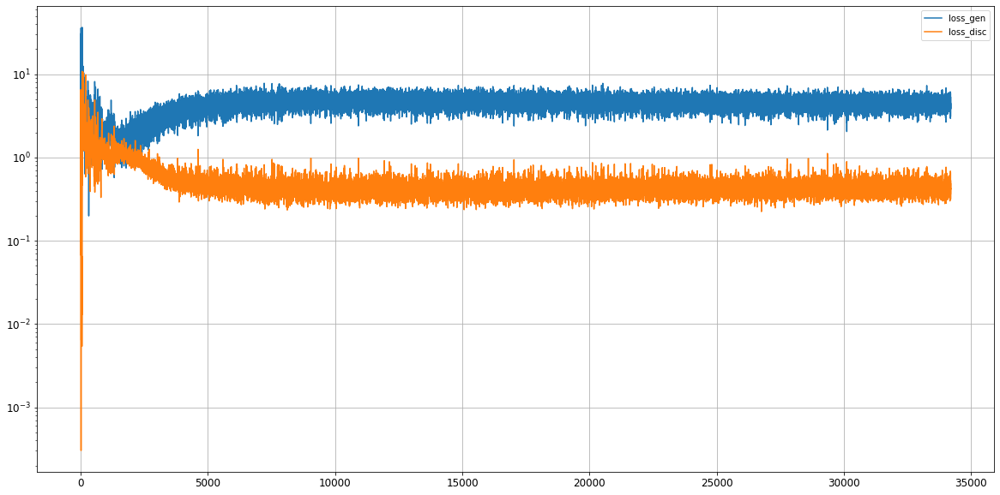

Epoch 34202/50000
0s
Epoch 34203/50000
0s
Epoch 34204/50000
0s
Epoch 34205/50000
0s
Epoch 34206/50000
0s
Epoch 34207/50000
0s
Epoch 34208/50000
0s
Epoch 34209/50000
0s
Epoch 34210/50000
0s
Epoch 34211/50000
0s
Epoch 34212/50000
0s
Epoch 34213/50000
0s
Epoch 34214/50000
0s
Epoch 34215/50000
0s
Epoch 34216/50000
0s
Epoch 34217/50000
0s
Epoch 34218/50000
0s
Epoch 34219/50000
0s
Epoch 34220/50000
0s
Epoch 34221/50000
0s
Epoch 34222/50000
0s
Epoch 34223/50000
0s
Epoch 34224/50000
0s
Epoch 34225/50000
0s
Epoch 34226/50000
0s
Epoch 34227/50000
0s
Epoch 34228/50000
0s
Epoch 34229/50000
0s
Epoch 34230/50000
0s
Epoch 34231/50000
0s
Epoch 34232/50000
0s
Epoch 34233/50000
0s
Epoch 34234/50000
0s
Epoch 34235/50000
0s
Epoch 34236/50000
0s
Epoch 34237/50000
0s
Epoch 34238/50000
0s
Epoch 34239/50000
0s
Epoch 34240/50000
0s
Epoch 34241/50000
0s
Epoch 34242/50000
0s
Epoch 34243/50000
0s
Epoch 34244/50000
0s
Epoch 34245/50000
0s
Epoch 34246/50000
0s
Epoch 34247/50000
0s
Epoch 34248/50000
0s
Epoch 34249/5

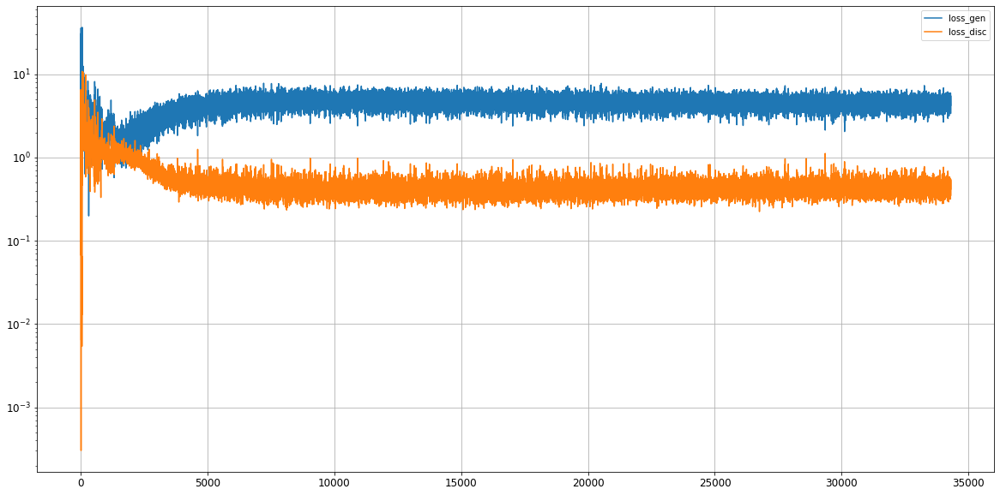

Epoch 34302/50000
0s
Epoch 34303/50000
0s
Epoch 34304/50000
0s
Epoch 34305/50000
0s
Epoch 34306/50000
0s
Epoch 34307/50000
0s
Epoch 34308/50000
0s
Epoch 34309/50000
0s
Epoch 34310/50000
0s
Epoch 34311/50000
0s
Epoch 34312/50000
0s
Epoch 34313/50000
0s
Epoch 34314/50000
0s
Epoch 34315/50000
0s
Epoch 34316/50000
0s
Epoch 34317/50000
0s
Epoch 34318/50000
0s
Epoch 34319/50000
0s
Epoch 34320/50000
0s
Epoch 34321/50000
0s
Epoch 34322/50000
0s
Epoch 34323/50000
0s
Epoch 34324/50000
0s
Epoch 34325/50000
0s
Epoch 34326/50000
0s
Epoch 34327/50000
0s
Epoch 34328/50000
0s
Epoch 34329/50000
0s
Epoch 34330/50000
0s
Epoch 34331/50000
0s
Epoch 34332/50000
0s
Epoch 34333/50000
0s
Epoch 34334/50000
0s
Epoch 34335/50000
0s
Epoch 34336/50000
0s
Epoch 34337/50000
0s
Epoch 34338/50000
0s
Epoch 34339/50000
0s
Epoch 34340/50000
0s
Epoch 34341/50000
0s
Epoch 34342/50000
0s
Epoch 34343/50000
0s
Epoch 34344/50000
0s
Epoch 34345/50000
0s
Epoch 34346/50000
0s
Epoch 34347/50000
0s
Epoch 34348/50000
0s
Epoch 34349/5

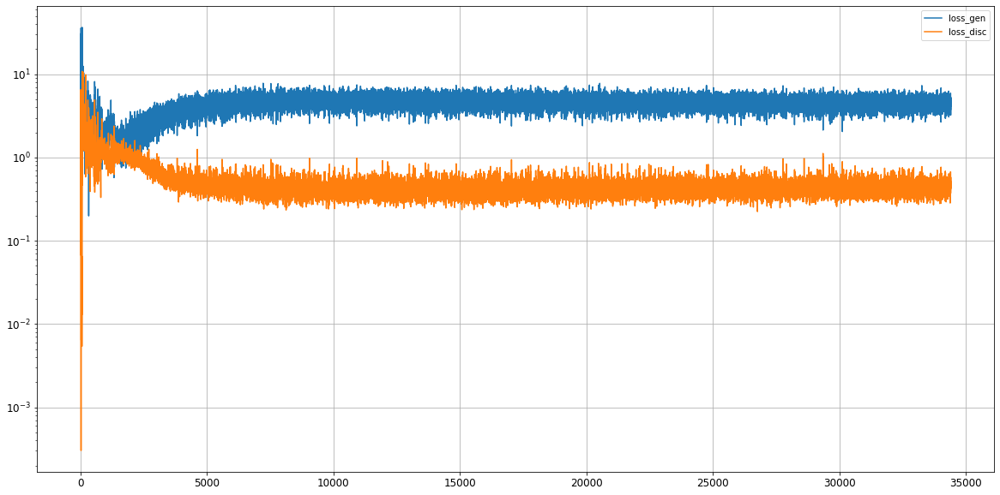

Epoch 34402/50000
0s
Epoch 34403/50000
0s
Epoch 34404/50000
0s
Epoch 34405/50000
0s
Epoch 34406/50000
0s
Epoch 34407/50000
0s
Epoch 34408/50000
0s
Epoch 34409/50000
0s
Epoch 34410/50000
0s
Epoch 34411/50000
0s
Epoch 34412/50000
0s
Epoch 34413/50000
0s
Epoch 34414/50000
0s
Epoch 34415/50000
0s
Epoch 34416/50000
0s
Epoch 34417/50000
0s
Epoch 34418/50000
0s
Epoch 34419/50000
0s
Epoch 34420/50000
0s
Epoch 34421/50000
0s
Epoch 34422/50000
0s
Epoch 34423/50000
0s
Epoch 34424/50000
0s
Epoch 34425/50000
0s
Epoch 34426/50000
0s
Epoch 34427/50000
0s
Epoch 34428/50000
0s
Epoch 34429/50000
0s
Epoch 34430/50000
0s
Epoch 34431/50000
0s
Epoch 34432/50000
0s
Epoch 34433/50000
0s
Epoch 34434/50000
0s
Epoch 34435/50000
0s
Epoch 34436/50000
0s
Epoch 34437/50000
0s
Epoch 34438/50000
0s
Epoch 34439/50000
0s
Epoch 34440/50000
0s
Epoch 34441/50000
0s
Epoch 34442/50000
0s
Epoch 34443/50000
0s
Epoch 34444/50000
0s
Epoch 34445/50000
0s
Epoch 34446/50000
0s
Epoch 34447/50000
0s
Epoch 34448/50000
0s
Epoch 34449/5

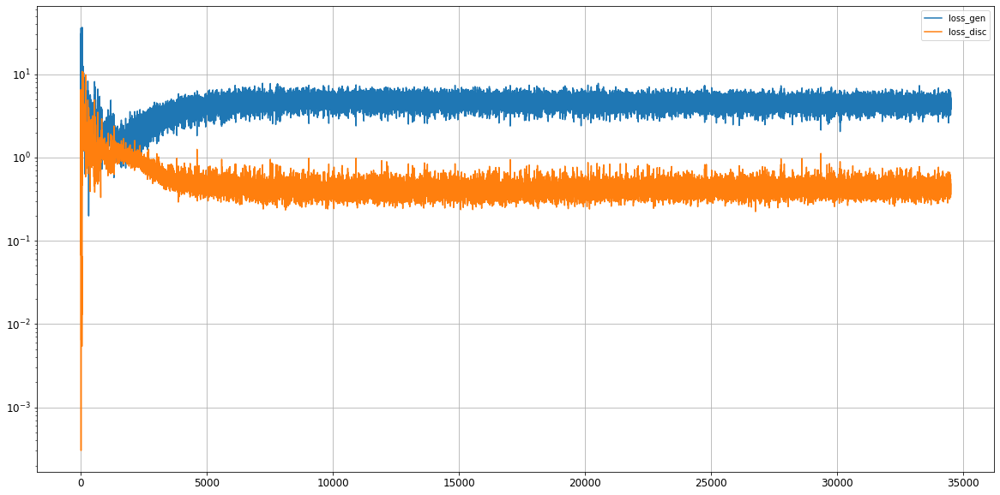

Epoch 34502/50000
0s
Epoch 34503/50000
0s
Epoch 34504/50000
0s
Epoch 34505/50000
0s
Epoch 34506/50000
0s
Epoch 34507/50000
0s
Epoch 34508/50000
0s
Epoch 34509/50000
0s
Epoch 34510/50000
0s
Epoch 34511/50000
0s
Epoch 34512/50000
0s
Epoch 34513/50000
0s
Epoch 34514/50000
0s
Epoch 34515/50000
0s
Epoch 34516/50000
0s
Epoch 34517/50000
0s
Epoch 34518/50000
0s
Epoch 34519/50000
0s
Epoch 34520/50000
0s
Epoch 34521/50000
0s
Epoch 34522/50000
0s
Epoch 34523/50000
0s
Epoch 34524/50000
0s
Epoch 34525/50000
0s
Epoch 34526/50000
0s
Epoch 34527/50000
0s
Epoch 34528/50000
0s
Epoch 34529/50000
0s
Epoch 34530/50000
0s
Epoch 34531/50000
0s
Epoch 34532/50000
0s
Epoch 34533/50000
0s
Epoch 34534/50000
0s
Epoch 34535/50000
0s
Epoch 34536/50000
0s
Epoch 34537/50000
0s
Epoch 34538/50000
0s
Epoch 34539/50000
0s
Epoch 34540/50000
0s
Epoch 34541/50000
0s
Epoch 34542/50000
0s
Epoch 34543/50000
0s
Epoch 34544/50000
0s
Epoch 34545/50000
0s
Epoch 34546/50000
0s
Epoch 34547/50000
0s
Epoch 34548/50000
0s
Epoch 34549/5

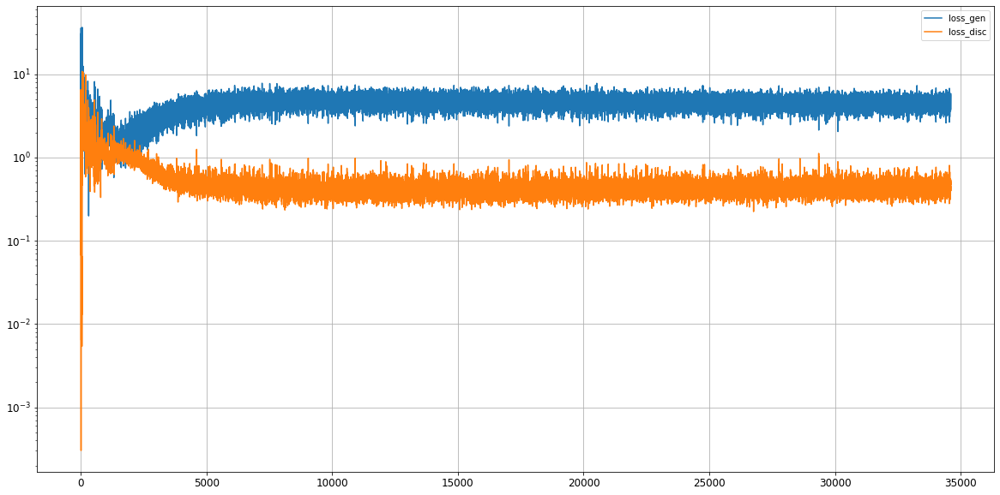

Epoch 34602/50000
0s
Epoch 34603/50000
0s
Epoch 34604/50000
0s
Epoch 34605/50000
0s
Epoch 34606/50000
0s
Epoch 34607/50000
0s
Epoch 34608/50000
0s
Epoch 34609/50000
0s
Epoch 34610/50000
0s
Epoch 34611/50000
0s
Epoch 34612/50000
0s
Epoch 34613/50000
0s
Epoch 34614/50000
0s
Epoch 34615/50000
0s
Epoch 34616/50000
0s
Epoch 34617/50000
0s
Epoch 34618/50000
0s
Epoch 34619/50000
0s
Epoch 34620/50000
0s
Epoch 34621/50000
0s
Epoch 34622/50000
0s
Epoch 34623/50000
0s
Epoch 34624/50000
0s
Epoch 34625/50000
0s
Epoch 34626/50000
0s
Epoch 34627/50000
0s
Epoch 34628/50000
0s
Epoch 34629/50000
0s
Epoch 34630/50000
0s
Epoch 34631/50000
0s
Epoch 34632/50000
0s
Epoch 34633/50000
0s
Epoch 34634/50000
0s
Epoch 34635/50000
0s
Epoch 34636/50000
0s
Epoch 34637/50000
0s
Epoch 34638/50000
0s
Epoch 34639/50000
0s
Epoch 34640/50000
0s
Epoch 34641/50000
0s
Epoch 34642/50000
0s
Epoch 34643/50000
0s
Epoch 34644/50000
0s
Epoch 34645/50000
0s
Epoch 34646/50000
0s
Epoch 34647/50000
0s
Epoch 34648/50000
0s
Epoch 34649/5

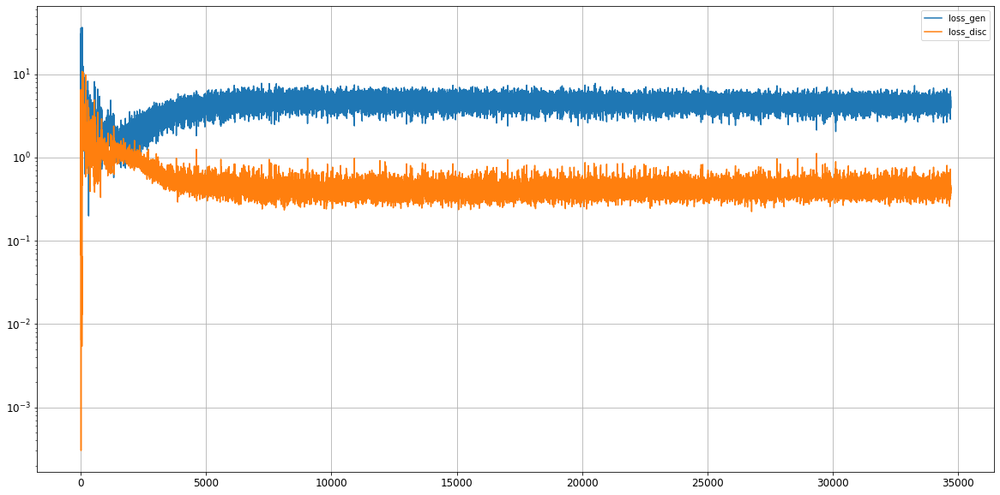

Epoch 34702/50000
0s
Epoch 34703/50000
0s
Epoch 34704/50000
0s
Epoch 34705/50000
0s
Epoch 34706/50000
0s
Epoch 34707/50000
0s
Epoch 34708/50000
0s
Epoch 34709/50000
0s
Epoch 34710/50000
0s
Epoch 34711/50000
0s
Epoch 34712/50000
0s
Epoch 34713/50000
0s
Epoch 34714/50000
0s
Epoch 34715/50000
0s
Epoch 34716/50000
0s
Epoch 34717/50000
0s
Epoch 34718/50000
0s
Epoch 34719/50000
0s
Epoch 34720/50000
0s
Epoch 34721/50000
0s
Epoch 34722/50000
0s
Epoch 34723/50000
0s
Epoch 34724/50000
0s
Epoch 34725/50000
0s
Epoch 34726/50000
0s
Epoch 34727/50000
0s
Epoch 34728/50000
0s
Epoch 34729/50000
0s
Epoch 34730/50000
0s
Epoch 34731/50000
0s
Epoch 34732/50000
0s
Epoch 34733/50000
0s
Epoch 34734/50000
0s
Epoch 34735/50000
0s
Epoch 34736/50000
0s
Epoch 34737/50000
0s
Epoch 34738/50000
0s
Epoch 34739/50000
0s
Epoch 34740/50000
0s
Epoch 34741/50000
0s
Epoch 34742/50000
0s
Epoch 34743/50000
0s
Epoch 34744/50000
0s
Epoch 34745/50000
0s
Epoch 34746/50000
0s
Epoch 34747/50000
0s
Epoch 34748/50000
0s
Epoch 34749/5

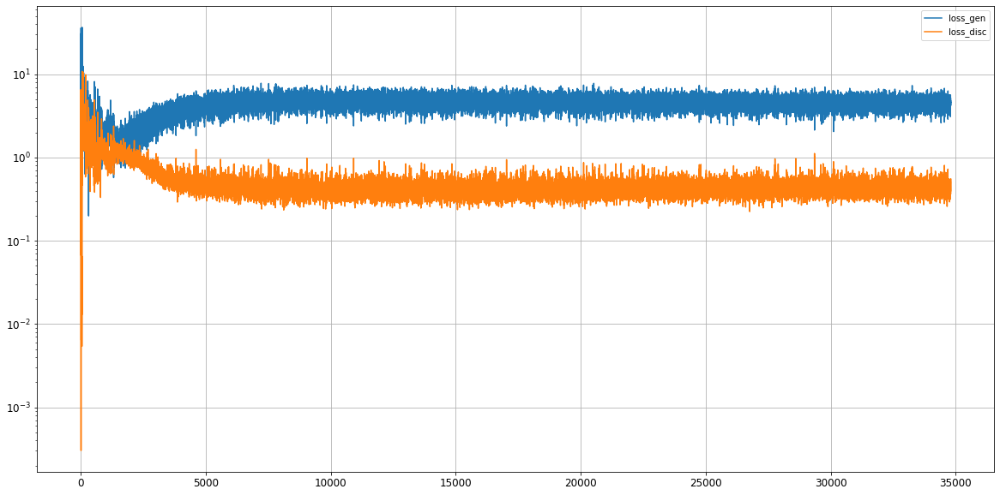

Epoch 34802/50000
0s
Epoch 34803/50000
0s
Epoch 34804/50000
0s
Epoch 34805/50000
0s
Epoch 34806/50000
0s
Epoch 34807/50000
0s
Epoch 34808/50000
0s
Epoch 34809/50000
0s
Epoch 34810/50000
0s
Epoch 34811/50000
0s
Epoch 34812/50000
0s
Epoch 34813/50000
0s
Epoch 34814/50000
0s
Epoch 34815/50000
0s
Epoch 34816/50000
0s
Epoch 34817/50000
0s
Epoch 34818/50000
0s
Epoch 34819/50000
0s
Epoch 34820/50000
0s
Epoch 34821/50000
0s
Epoch 34822/50000
0s
Epoch 34823/50000
0s
Epoch 34824/50000
0s
Epoch 34825/50000
0s
Epoch 34826/50000
0s
Epoch 34827/50000
0s
Epoch 34828/50000
0s
Epoch 34829/50000
0s
Epoch 34830/50000
0s
Epoch 34831/50000
0s
Epoch 34832/50000
0s
Epoch 34833/50000
0s
Epoch 34834/50000
0s
Epoch 34835/50000
0s
Epoch 34836/50000
0s
Epoch 34837/50000
0s
Epoch 34838/50000
0s
Epoch 34839/50000
0s
Epoch 34840/50000
0s
Epoch 34841/50000
0s
Epoch 34842/50000
0s
Epoch 34843/50000
0s
Epoch 34844/50000
0s
Epoch 34845/50000
0s
Epoch 34846/50000
0s
Epoch 34847/50000
0s
Epoch 34848/50000
0s
Epoch 34849/5

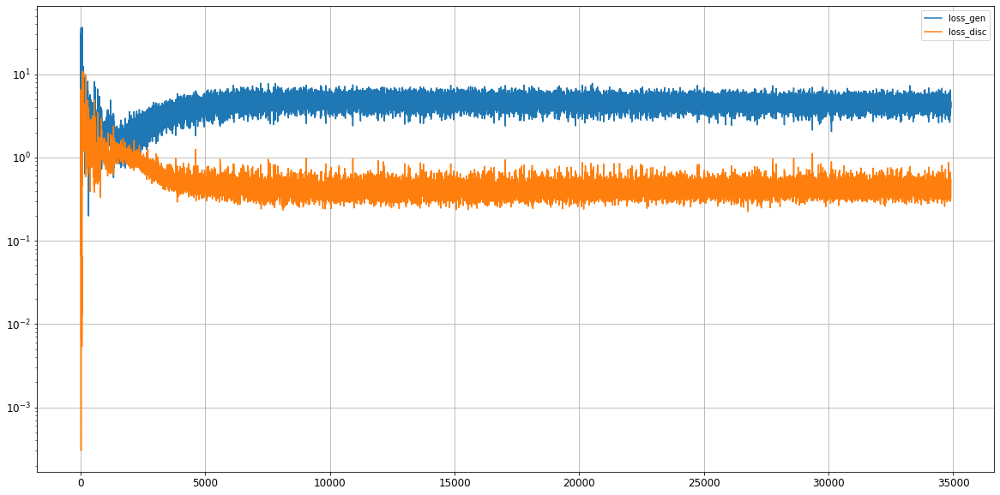

Epoch 34902/50000
0s
Epoch 34903/50000
0s
Epoch 34904/50000
0s
Epoch 34905/50000
0s
Epoch 34906/50000
0s
Epoch 34907/50000
0s
Epoch 34908/50000
0s
Epoch 34909/50000
0s
Epoch 34910/50000
0s
Epoch 34911/50000
0s
Epoch 34912/50000
0s
Epoch 34913/50000
0s
Epoch 34914/50000
0s
Epoch 34915/50000
0s
Epoch 34916/50000
0s
Epoch 34917/50000
0s
Epoch 34918/50000
0s
Epoch 34919/50000
0s
Epoch 34920/50000
0s
Epoch 34921/50000
0s
Epoch 34922/50000
0s
Epoch 34923/50000
0s
Epoch 34924/50000
0s
Epoch 34925/50000
0s
Epoch 34926/50000
0s
Epoch 34927/50000
0s
Epoch 34928/50000
0s
Epoch 34929/50000
0s
Epoch 34930/50000
0s
Epoch 34931/50000
0s
Epoch 34932/50000
0s
Epoch 34933/50000
0s
Epoch 34934/50000
0s
Epoch 34935/50000
0s
Epoch 34936/50000
0s
Epoch 34937/50000
0s
Epoch 34938/50000
0s
Epoch 34939/50000
0s
Epoch 34940/50000
0s
Epoch 34941/50000
0s
Epoch 34942/50000
0s
Epoch 34943/50000
0s
Epoch 34944/50000
0s
Epoch 34945/50000
0s
Epoch 34946/50000
0s
Epoch 34947/50000
0s
Epoch 34948/50000
0s
Epoch 34949/5

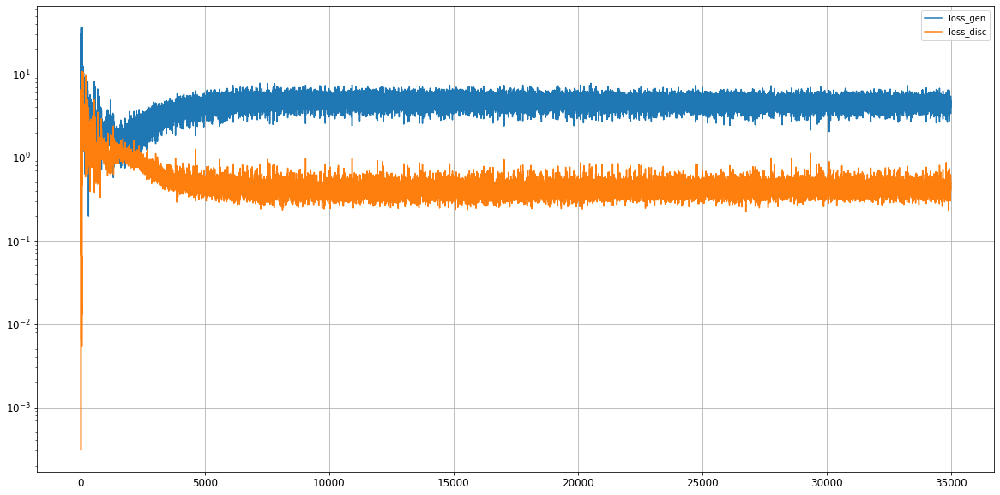

Epoch 35002/50000
0s
Epoch 35003/50000
0s
Epoch 35004/50000
0s
Epoch 35005/50000
0s
Epoch 35006/50000
0s
Epoch 35007/50000
0s
Epoch 35008/50000
0s
Epoch 35009/50000
0s
Epoch 35010/50000
0s
Epoch 35011/50000
0s
Epoch 35012/50000
0s
Epoch 35013/50000
0s
Epoch 35014/50000
0s
Epoch 35015/50000
0s
Epoch 35016/50000
0s
Epoch 35017/50000
0s
Epoch 35018/50000
0s
Epoch 35019/50000
0s
Epoch 35020/50000
0s
Epoch 35021/50000
0s
Epoch 35022/50000
0s
Epoch 35023/50000
0s
Epoch 35024/50000
0s
Epoch 35025/50000
0s
Epoch 35026/50000
0s
Epoch 35027/50000
0s
Epoch 35028/50000
0s
Epoch 35029/50000
0s
Epoch 35030/50000
0s
Epoch 35031/50000
0s
Epoch 35032/50000
0s
Epoch 35033/50000
0s
Epoch 35034/50000
0s
Epoch 35035/50000
0s
Epoch 35036/50000
0s
Epoch 35037/50000
0s
Epoch 35038/50000
0s
Epoch 35039/50000
0s
Epoch 35040/50000
0s
Epoch 35041/50000
0s
Epoch 35042/50000
0s
Epoch 35043/50000
0s
Epoch 35044/50000
0s
Epoch 35045/50000
0s
Epoch 35046/50000
0s
Epoch 35047/50000
0s
Epoch 35048/50000
0s
Epoch 35049/5

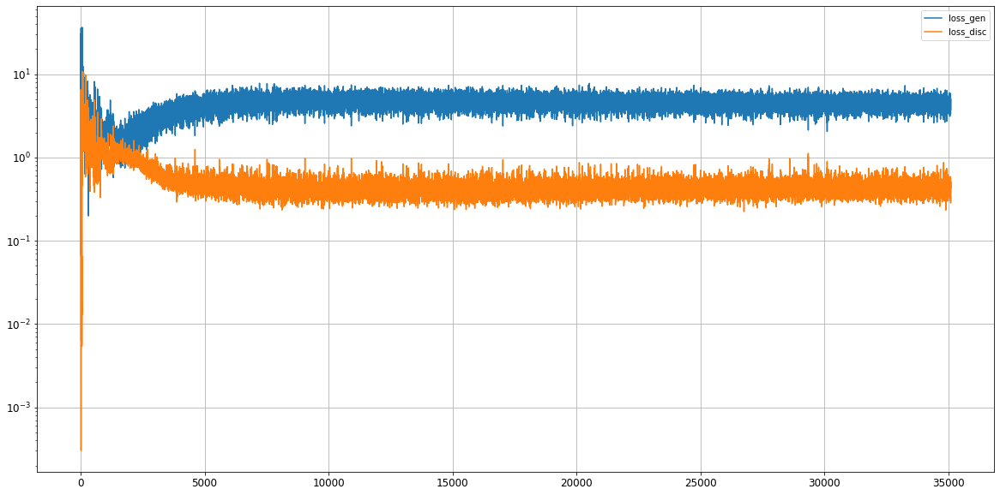

Epoch 35102/50000
0s
Epoch 35103/50000
0s
Epoch 35104/50000
0s
Epoch 35105/50000
0s
Epoch 35106/50000
0s
Epoch 35107/50000
0s
Epoch 35108/50000
0s
Epoch 35109/50000
0s
Epoch 35110/50000
0s
Epoch 35111/50000
0s
Epoch 35112/50000
0s
Epoch 35113/50000
0s
Epoch 35114/50000
0s
Epoch 35115/50000
0s
Epoch 35116/50000
0s
Epoch 35117/50000
0s
Epoch 35118/50000
0s
Epoch 35119/50000
0s
Epoch 35120/50000
0s
Epoch 35121/50000
0s
Epoch 35122/50000
0s
Epoch 35123/50000
0s
Epoch 35124/50000
0s
Epoch 35125/50000
0s
Epoch 35126/50000
0s
Epoch 35127/50000
0s
Epoch 35128/50000
0s
Epoch 35129/50000
0s
Epoch 35130/50000
0s
Epoch 35131/50000
0s
Epoch 35132/50000
0s
Epoch 35133/50000
0s
Epoch 35134/50000
0s
Epoch 35135/50000
0s
Epoch 35136/50000
0s
Epoch 35137/50000
0s
Epoch 35138/50000
0s
Epoch 35139/50000
0s
Epoch 35140/50000
0s
Epoch 35141/50000
0s
Epoch 35142/50000
0s
Epoch 35143/50000
0s
Epoch 35144/50000
0s
Epoch 35145/50000
0s
Epoch 35146/50000
0s
Epoch 35147/50000
0s
Epoch 35148/50000
0s
Epoch 35149/5

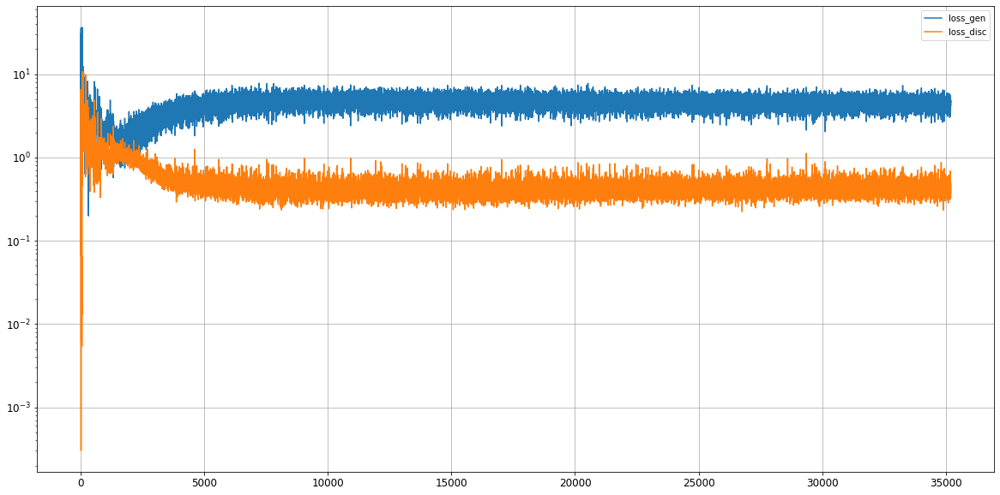

Epoch 35202/50000
0s
Epoch 35203/50000
0s
Epoch 35204/50000
0s
Epoch 35205/50000
0s
Epoch 35206/50000
0s
Epoch 35207/50000
0s
Epoch 35208/50000
0s
Epoch 35209/50000
0s
Epoch 35210/50000
0s
Epoch 35211/50000
0s
Epoch 35212/50000
0s
Epoch 35213/50000
0s
Epoch 35214/50000
0s
Epoch 35215/50000
0s
Epoch 35216/50000
0s
Epoch 35217/50000
0s
Epoch 35218/50000
0s
Epoch 35219/50000
0s
Epoch 35220/50000
0s
Epoch 35221/50000
0s
Epoch 35222/50000
0s
Epoch 35223/50000
0s
Epoch 35224/50000
0s
Epoch 35225/50000
0s
Epoch 35226/50000
0s
Epoch 35227/50000
0s
Epoch 35228/50000
0s
Epoch 35229/50000
0s
Epoch 35230/50000
0s
Epoch 35231/50000
0s
Epoch 35232/50000
0s
Epoch 35233/50000
0s
Epoch 35234/50000
0s
Epoch 35235/50000
0s
Epoch 35236/50000
0s
Epoch 35237/50000
0s
Epoch 35238/50000
0s
Epoch 35239/50000
0s
Epoch 35240/50000
0s
Epoch 35241/50000
0s
Epoch 35242/50000
0s
Epoch 35243/50000
0s
Epoch 35244/50000
0s
Epoch 35245/50000
0s
Epoch 35246/50000
0s
Epoch 35247/50000
0s
Epoch 35248/50000
0s
Epoch 35249/5

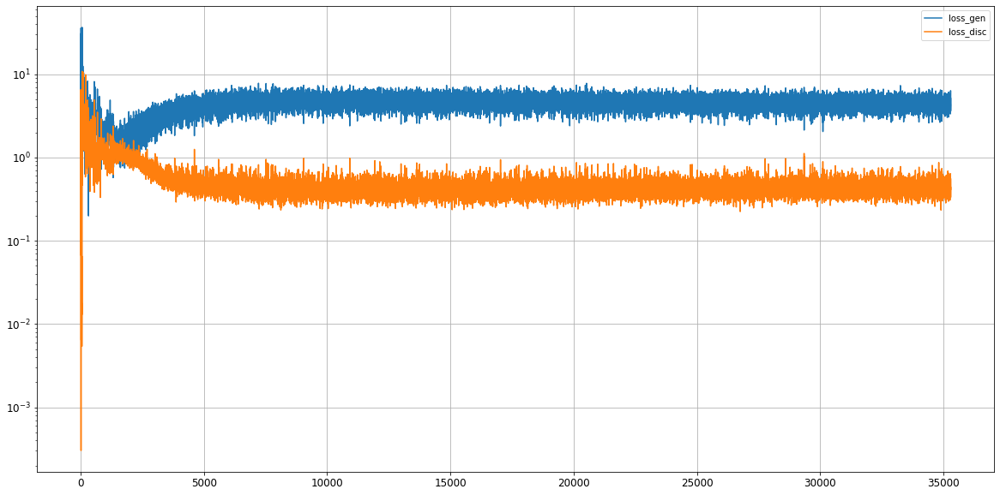

Epoch 35302/50000
0s
Epoch 35303/50000
0s
Epoch 35304/50000
0s
Epoch 35305/50000
0s
Epoch 35306/50000
0s
Epoch 35307/50000
0s
Epoch 35308/50000
0s
Epoch 35309/50000
0s
Epoch 35310/50000
0s
Epoch 35311/50000
0s
Epoch 35312/50000
0s
Epoch 35313/50000
0s
Epoch 35314/50000
0s
Epoch 35315/50000
0s
Epoch 35316/50000
0s
Epoch 35317/50000
0s
Epoch 35318/50000
0s
Epoch 35319/50000
0s
Epoch 35320/50000
0s
Epoch 35321/50000
0s
Epoch 35322/50000
0s
Epoch 35323/50000
0s
Epoch 35324/50000
0s
Epoch 35325/50000
0s
Epoch 35326/50000
0s
Epoch 35327/50000
0s
Epoch 35328/50000
0s
Epoch 35329/50000
0s
Epoch 35330/50000
0s
Epoch 35331/50000
0s
Epoch 35332/50000
0s
Epoch 35333/50000
0s
Epoch 35334/50000
0s
Epoch 35335/50000
0s
Epoch 35336/50000
0s
Epoch 35337/50000
0s
Epoch 35338/50000
0s
Epoch 35339/50000
0s
Epoch 35340/50000
0s
Epoch 35341/50000
0s
Epoch 35342/50000
0s
Epoch 35343/50000
0s
Epoch 35344/50000
0s
Epoch 35345/50000
0s
Epoch 35346/50000
0s
Epoch 35347/50000
0s
Epoch 35348/50000
0s
Epoch 35349/5

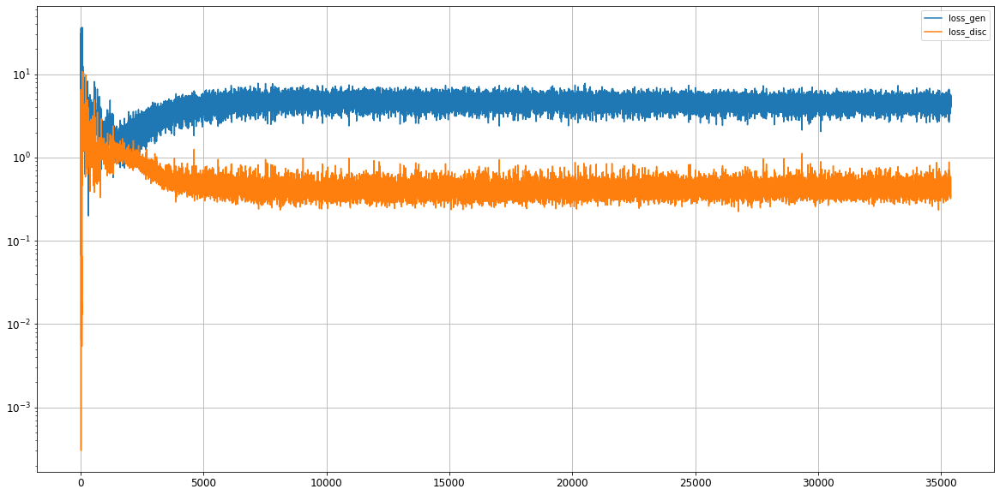

Epoch 35402/50000
0s
Epoch 35403/50000
0s
Epoch 35404/50000
0s
Epoch 35405/50000
0s
Epoch 35406/50000
0s
Epoch 35407/50000
0s
Epoch 35408/50000
0s
Epoch 35409/50000
0s
Epoch 35410/50000
0s
Epoch 35411/50000
0s
Epoch 35412/50000
0s
Epoch 35413/50000
0s
Epoch 35414/50000
0s
Epoch 35415/50000
0s
Epoch 35416/50000
0s
Epoch 35417/50000
0s
Epoch 35418/50000
0s
Epoch 35419/50000
0s
Epoch 35420/50000
0s
Epoch 35421/50000
0s
Epoch 35422/50000
0s
Epoch 35423/50000
0s
Epoch 35424/50000
0s
Epoch 35425/50000
0s
Epoch 35426/50000
0s
Epoch 35427/50000
0s
Epoch 35428/50000
0s
Epoch 35429/50000
0s
Epoch 35430/50000
0s
Epoch 35431/50000
0s
Epoch 35432/50000
0s
Epoch 35433/50000
0s
Epoch 35434/50000
0s
Epoch 35435/50000
0s
Epoch 35436/50000
0s
Epoch 35437/50000
0s
Epoch 35438/50000
0s
Epoch 35439/50000
0s
Epoch 35440/50000
0s
Epoch 35441/50000
0s
Epoch 35442/50000
0s
Epoch 35443/50000
0s
Epoch 35444/50000
0s
Epoch 35445/50000
0s
Epoch 35446/50000
0s
Epoch 35447/50000
0s
Epoch 35448/50000
0s
Epoch 35449/5

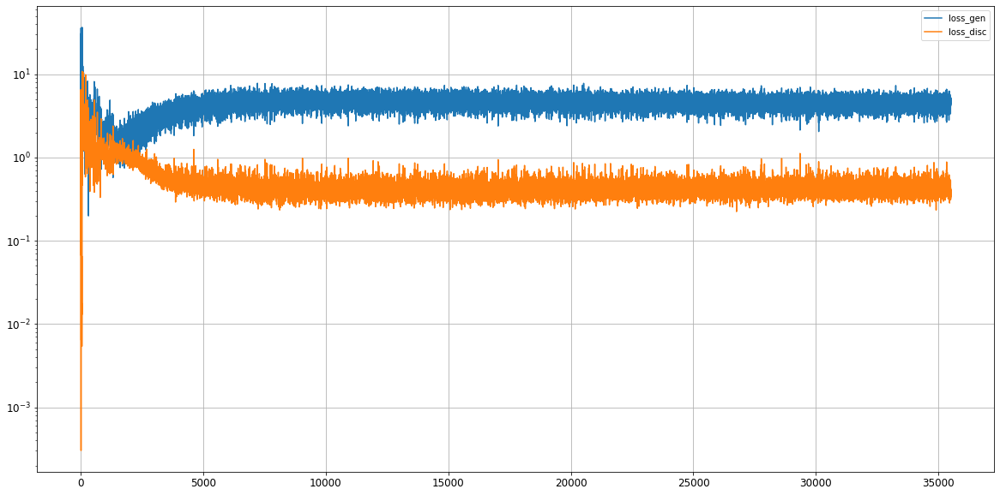

Epoch 35502/50000
0s
Epoch 35503/50000
0s
Epoch 35504/50000
0s
Epoch 35505/50000
0s
Epoch 35506/50000
0s
Epoch 35507/50000
0s
Epoch 35508/50000
0s
Epoch 35509/50000
0s
Epoch 35510/50000
0s
Epoch 35511/50000
0s
Epoch 35512/50000
0s
Epoch 35513/50000
0s
Epoch 35514/50000
0s
Epoch 35515/50000
0s
Epoch 35516/50000
0s
Epoch 35517/50000
0s
Epoch 35518/50000
0s
Epoch 35519/50000
0s
Epoch 35520/50000
0s
Epoch 35521/50000
0s
Epoch 35522/50000
0s
Epoch 35523/50000
0s
Epoch 35524/50000
0s
Epoch 35525/50000
0s
Epoch 35526/50000
0s
Epoch 35527/50000
0s
Epoch 35528/50000
0s
Epoch 35529/50000
0s
Epoch 35530/50000
0s
Epoch 35531/50000
0s
Epoch 35532/50000
0s
Epoch 35533/50000
0s
Epoch 35534/50000
0s
Epoch 35535/50000
0s
Epoch 35536/50000
0s
Epoch 35537/50000
0s
Epoch 35538/50000
0s
Epoch 35539/50000
0s
Epoch 35540/50000
0s
Epoch 35541/50000
0s
Epoch 35542/50000
0s
Epoch 35543/50000
0s
Epoch 35544/50000
0s
Epoch 35545/50000
0s
Epoch 35546/50000
0s
Epoch 35547/50000
0s
Epoch 35548/50000
0s
Epoch 35549/5

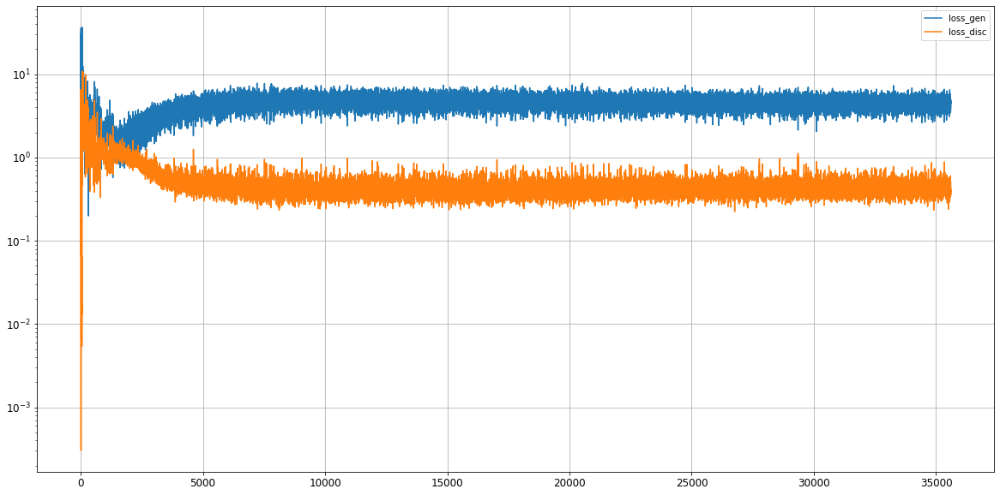

Epoch 35602/50000
0s
Epoch 35603/50000
0s
Epoch 35604/50000
0s
Epoch 35605/50000
0s
Epoch 35606/50000
0s
Epoch 35607/50000
0s
Epoch 35608/50000
0s
Epoch 35609/50000
0s
Epoch 35610/50000
0s
Epoch 35611/50000
0s
Epoch 35612/50000
0s
Epoch 35613/50000
0s
Epoch 35614/50000
0s
Epoch 35615/50000
0s
Epoch 35616/50000
0s
Epoch 35617/50000
0s
Epoch 35618/50000
0s
Epoch 35619/50000
0s
Epoch 35620/50000
0s
Epoch 35621/50000
0s
Epoch 35622/50000
0s
Epoch 35623/50000
0s
Epoch 35624/50000
0s
Epoch 35625/50000
0s
Epoch 35626/50000
0s
Epoch 35627/50000
0s
Epoch 35628/50000
0s
Epoch 35629/50000
0s
Epoch 35630/50000
0s
Epoch 35631/50000
0s
Epoch 35632/50000
0s
Epoch 35633/50000
0s
Epoch 35634/50000
0s
Epoch 35635/50000
0s
Epoch 35636/50000
0s
Epoch 35637/50000
0s
Epoch 35638/50000
0s
Epoch 35639/50000
0s
Epoch 35640/50000
0s
Epoch 35641/50000
0s
Epoch 35642/50000
0s
Epoch 35643/50000
0s
Epoch 35644/50000
0s
Epoch 35645/50000
0s
Epoch 35646/50000
0s
Epoch 35647/50000
0s
Epoch 35648/50000
0s
Epoch 35649/5

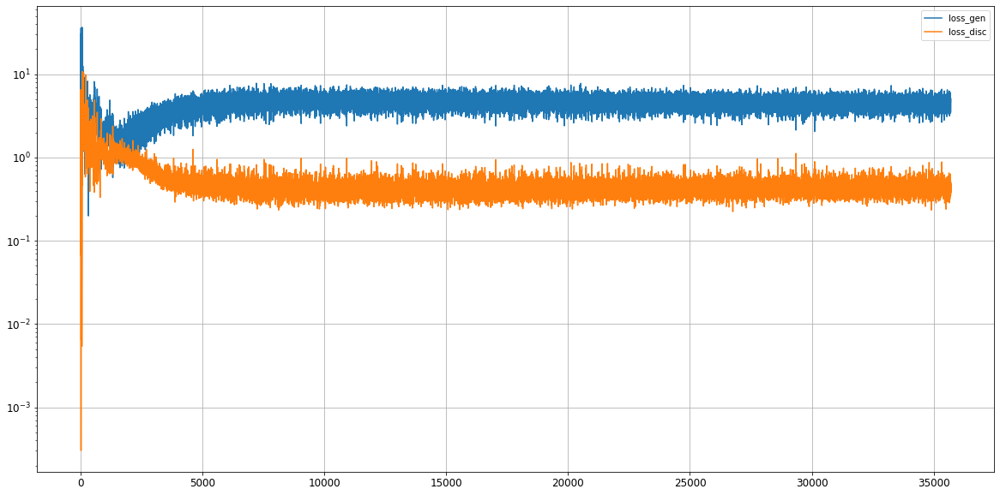

Epoch 35702/50000
0s
Epoch 35703/50000
0s
Epoch 35704/50000
0s
Epoch 35705/50000
0s
Epoch 35706/50000
0s
Epoch 35707/50000
0s
Epoch 35708/50000
0s
Epoch 35709/50000
0s
Epoch 35710/50000
0s
Epoch 35711/50000
0s
Epoch 35712/50000
0s
Epoch 35713/50000
0s
Epoch 35714/50000
0s
Epoch 35715/50000
0s
Epoch 35716/50000
0s
Epoch 35717/50000
0s
Epoch 35718/50000
0s
Epoch 35719/50000
0s
Epoch 35720/50000
0s
Epoch 35721/50000
0s
Epoch 35722/50000
0s
Epoch 35723/50000
0s
Epoch 35724/50000
0s
Epoch 35725/50000
0s
Epoch 35726/50000
0s
Epoch 35727/50000
0s
Epoch 35728/50000
0s
Epoch 35729/50000
0s
Epoch 35730/50000
0s
Epoch 35731/50000
0s
Epoch 35732/50000
0s
Epoch 35733/50000
0s
Epoch 35734/50000
0s
Epoch 35735/50000
0s
Epoch 35736/50000
0s
Epoch 35737/50000
0s
Epoch 35738/50000
0s
Epoch 35739/50000
0s
Epoch 35740/50000
0s
Epoch 35741/50000
0s
Epoch 35742/50000
0s
Epoch 35743/50000
0s
Epoch 35744/50000
0s
Epoch 35745/50000
0s
Epoch 35746/50000
0s
Epoch 35747/50000
0s
Epoch 35748/50000
0s
Epoch 35749/5

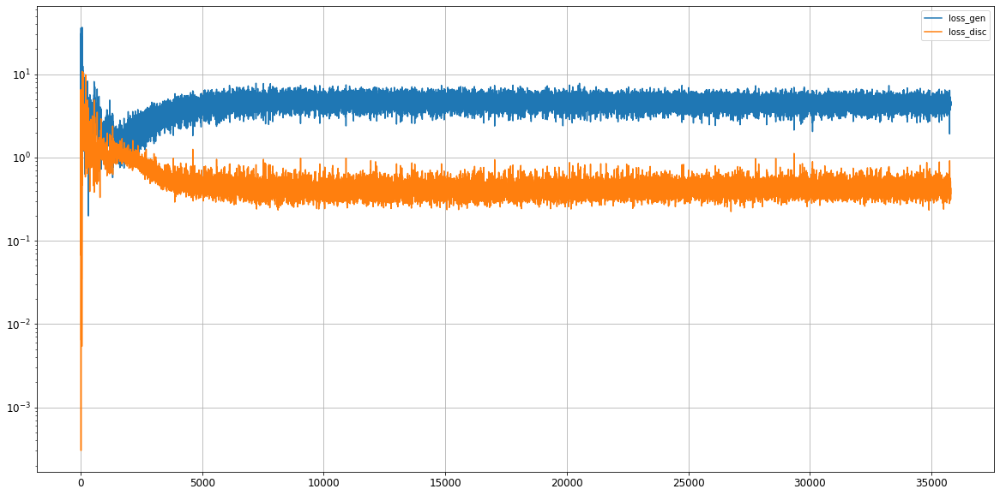

Epoch 35802/50000
0s
Epoch 35803/50000
0s
Epoch 35804/50000
0s
Epoch 35805/50000
0s
Epoch 35806/50000
0s
Epoch 35807/50000
0s
Epoch 35808/50000
0s
Epoch 35809/50000
0s
Epoch 35810/50000
0s
Epoch 35811/50000
0s
Epoch 35812/50000
0s
Epoch 35813/50000
0s
Epoch 35814/50000
0s
Epoch 35815/50000
0s
Epoch 35816/50000
0s
Epoch 35817/50000
0s
Epoch 35818/50000
0s
Epoch 35819/50000
0s
Epoch 35820/50000
0s
Epoch 35821/50000
0s
Epoch 35822/50000
0s
Epoch 35823/50000
0s
Epoch 35824/50000
0s
Epoch 35825/50000
0s
Epoch 35826/50000
0s
Epoch 35827/50000
0s
Epoch 35828/50000
0s
Epoch 35829/50000
0s
Epoch 35830/50000
0s
Epoch 35831/50000
0s
Epoch 35832/50000
0s
Epoch 35833/50000
0s
Epoch 35834/50000
0s
Epoch 35835/50000
0s
Epoch 35836/50000
0s
Epoch 35837/50000
0s
Epoch 35838/50000
0s
Epoch 35839/50000
0s
Epoch 35840/50000
0s
Epoch 35841/50000
0s
Epoch 35842/50000
0s
Epoch 35843/50000
0s
Epoch 35844/50000
0s
Epoch 35845/50000
0s
Epoch 35846/50000
0s
Epoch 35847/50000
0s
Epoch 35848/50000
0s
Epoch 35849/5

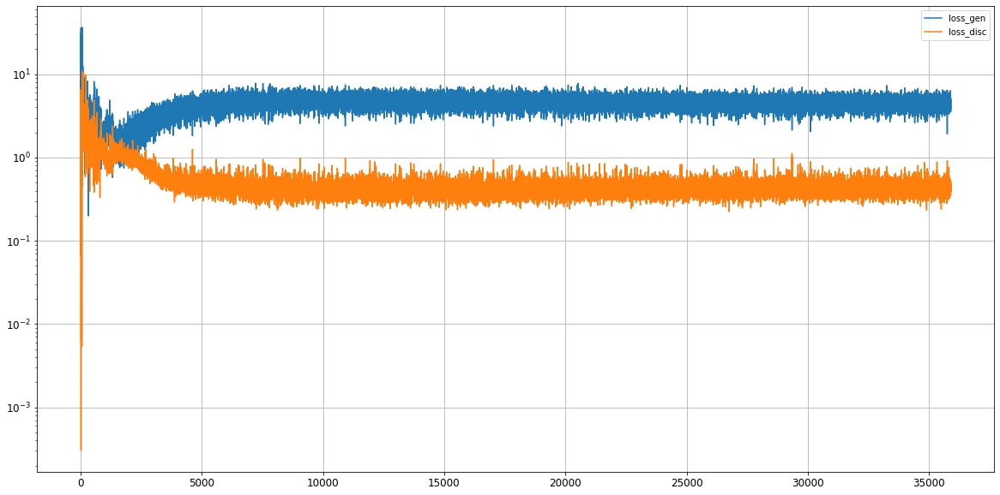

Epoch 35902/50000
0s
Epoch 35903/50000
0s
Epoch 35904/50000
0s
Epoch 35905/50000
0s
Epoch 35906/50000
0s
Epoch 35907/50000
0s
Epoch 35908/50000
0s
Epoch 35909/50000
0s
Epoch 35910/50000
0s
Epoch 35911/50000
0s
Epoch 35912/50000
0s
Epoch 35913/50000
0s
Epoch 35914/50000
0s
Epoch 35915/50000
0s
Epoch 35916/50000
0s
Epoch 35917/50000
0s
Epoch 35918/50000
0s
Epoch 35919/50000
0s
Epoch 35920/50000
0s
Epoch 35921/50000
0s
Epoch 35922/50000
0s
Epoch 35923/50000
0s
Epoch 35924/50000
0s
Epoch 35925/50000
0s
Epoch 35926/50000
0s
Epoch 35927/50000
0s
Epoch 35928/50000
0s
Epoch 35929/50000
0s
Epoch 35930/50000
0s
Epoch 35931/50000
0s
Epoch 35932/50000
0s
Epoch 35933/50000
0s
Epoch 35934/50000
0s
Epoch 35935/50000
0s
Epoch 35936/50000
0s
Epoch 35937/50000
0s
Epoch 35938/50000
0s
Epoch 35939/50000
0s
Epoch 35940/50000
0s
Epoch 35941/50000
0s
Epoch 35942/50000
0s
Epoch 35943/50000
0s
Epoch 35944/50000
0s
Epoch 35945/50000
0s
Epoch 35946/50000
0s
Epoch 35947/50000
0s
Epoch 35948/50000
0s
Epoch 35949/5

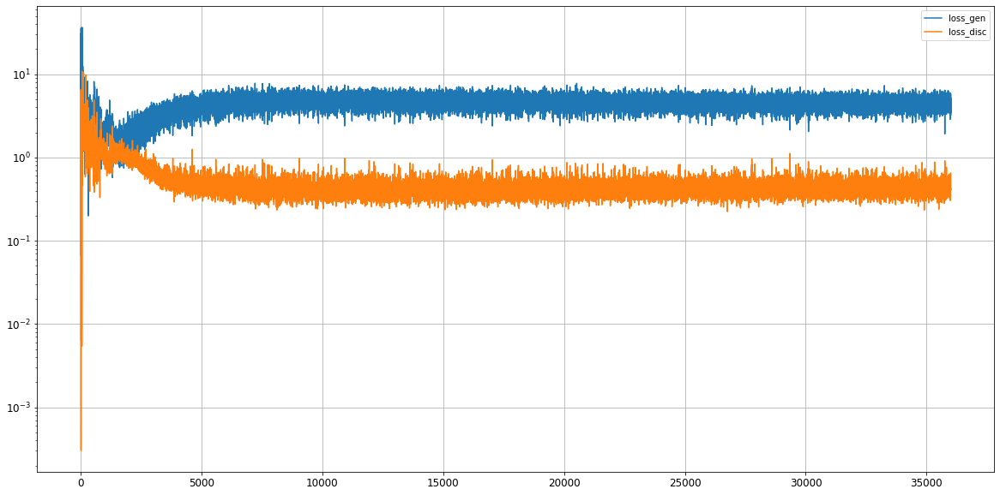

Epoch 36002/50000
0s
Epoch 36003/50000
0s
Epoch 36004/50000
0s
Epoch 36005/50000
0s
Epoch 36006/50000
0s
Epoch 36007/50000
0s
Epoch 36008/50000
0s
Epoch 36009/50000
0s
Epoch 36010/50000
0s
Epoch 36011/50000
0s
Epoch 36012/50000
0s
Epoch 36013/50000
0s
Epoch 36014/50000
0s
Epoch 36015/50000
0s
Epoch 36016/50000
0s
Epoch 36017/50000
0s
Epoch 36018/50000
0s
Epoch 36019/50000
0s
Epoch 36020/50000
0s
Epoch 36021/50000
0s
Epoch 36022/50000
0s
Epoch 36023/50000
0s
Epoch 36024/50000
0s
Epoch 36025/50000
0s
Epoch 36026/50000
0s
Epoch 36027/50000
0s
Epoch 36028/50000
0s
Epoch 36029/50000
0s
Epoch 36030/50000
0s
Epoch 36031/50000
0s
Epoch 36032/50000
0s
Epoch 36033/50000
0s
Epoch 36034/50000
0s
Epoch 36035/50000
0s
Epoch 36036/50000
0s
Epoch 36037/50000
0s
Epoch 36038/50000
0s
Epoch 36039/50000
0s
Epoch 36040/50000
0s
Epoch 36041/50000
0s
Epoch 36042/50000
0s
Epoch 36043/50000
0s
Epoch 36044/50000
0s
Epoch 36045/50000
0s
Epoch 36046/50000
0s
Epoch 36047/50000
0s
Epoch 36048/50000
0s
Epoch 36049/5

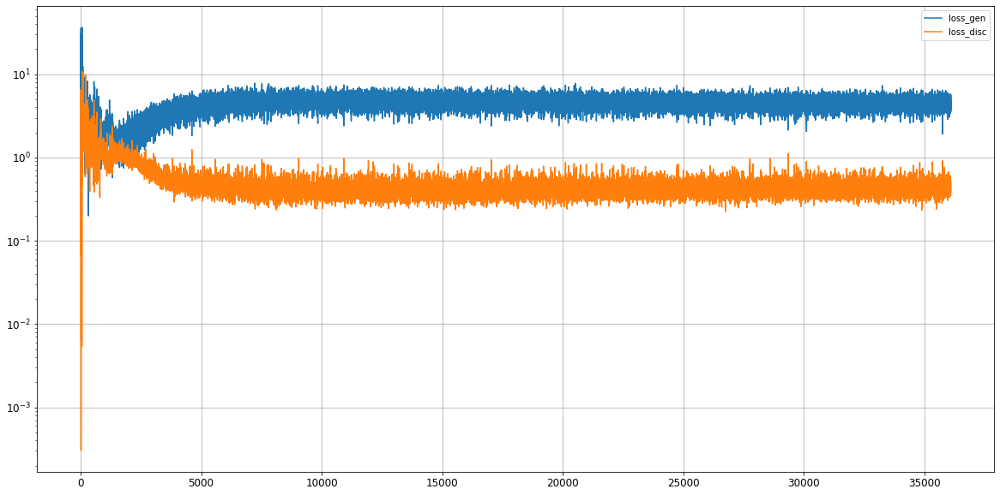

Epoch 36102/50000
0s
Epoch 36103/50000
0s
Epoch 36104/50000
0s
Epoch 36105/50000
0s
Epoch 36106/50000
0s
Epoch 36107/50000
0s
Epoch 36108/50000
0s
Epoch 36109/50000
0s
Epoch 36110/50000
0s
Epoch 36111/50000
0s
Epoch 36112/50000
0s
Epoch 36113/50000
0s
Epoch 36114/50000
0s
Epoch 36115/50000
0s
Epoch 36116/50000
0s
Epoch 36117/50000
0s
Epoch 36118/50000
0s
Epoch 36119/50000
0s
Epoch 36120/50000
0s
Epoch 36121/50000
0s
Epoch 36122/50000
0s
Epoch 36123/50000
0s
Epoch 36124/50000
0s
Epoch 36125/50000
0s
Epoch 36126/50000
0s
Epoch 36127/50000
0s
Epoch 36128/50000
0s
Epoch 36129/50000
0s
Epoch 36130/50000
0s
Epoch 36131/50000
0s
Epoch 36132/50000
0s
Epoch 36133/50000
0s
Epoch 36134/50000
0s
Epoch 36135/50000
0s
Epoch 36136/50000
0s
Epoch 36137/50000
0s
Epoch 36138/50000
0s
Epoch 36139/50000
0s
Epoch 36140/50000
0s
Epoch 36141/50000
0s
Epoch 36142/50000
0s
Epoch 36143/50000
0s
Epoch 36144/50000
0s
Epoch 36145/50000
0s
Epoch 36146/50000
0s
Epoch 36147/50000
0s
Epoch 36148/50000
0s
Epoch 36149/5

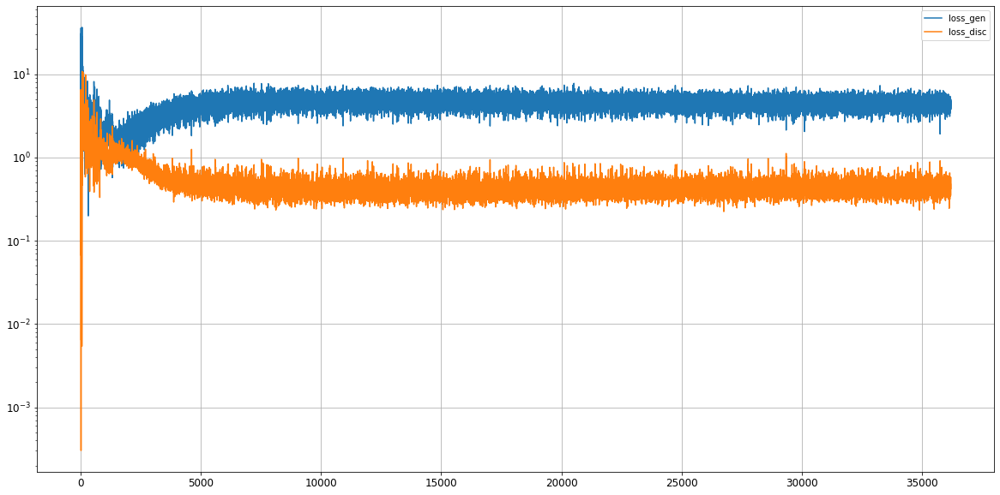

Epoch 36202/50000
0s
Epoch 36203/50000
0s
Epoch 36204/50000
0s
Epoch 36205/50000
0s
Epoch 36206/50000
0s
Epoch 36207/50000
0s
Epoch 36208/50000
0s
Epoch 36209/50000
0s
Epoch 36210/50000
0s
Epoch 36211/50000
0s
Epoch 36212/50000
0s
Epoch 36213/50000
0s
Epoch 36214/50000
0s
Epoch 36215/50000
0s
Epoch 36216/50000
0s
Epoch 36217/50000
0s
Epoch 36218/50000
0s
Epoch 36219/50000
0s
Epoch 36220/50000
0s
Epoch 36221/50000
0s
Epoch 36222/50000
0s
Epoch 36223/50000
0s
Epoch 36224/50000
0s
Epoch 36225/50000
0s
Epoch 36226/50000
0s
Epoch 36227/50000
0s
Epoch 36228/50000
0s
Epoch 36229/50000
0s
Epoch 36230/50000
0s
Epoch 36231/50000
0s
Epoch 36232/50000
0s
Epoch 36233/50000
0s
Epoch 36234/50000
0s
Epoch 36235/50000
0s
Epoch 36236/50000
0s
Epoch 36237/50000
0s
Epoch 36238/50000
0s
Epoch 36239/50000
0s
Epoch 36240/50000
0s
Epoch 36241/50000
0s
Epoch 36242/50000
0s
Epoch 36243/50000
0s
Epoch 36244/50000
0s
Epoch 36245/50000
0s
Epoch 36246/50000
0s
Epoch 36247/50000
0s
Epoch 36248/50000
0s
Epoch 36249/5

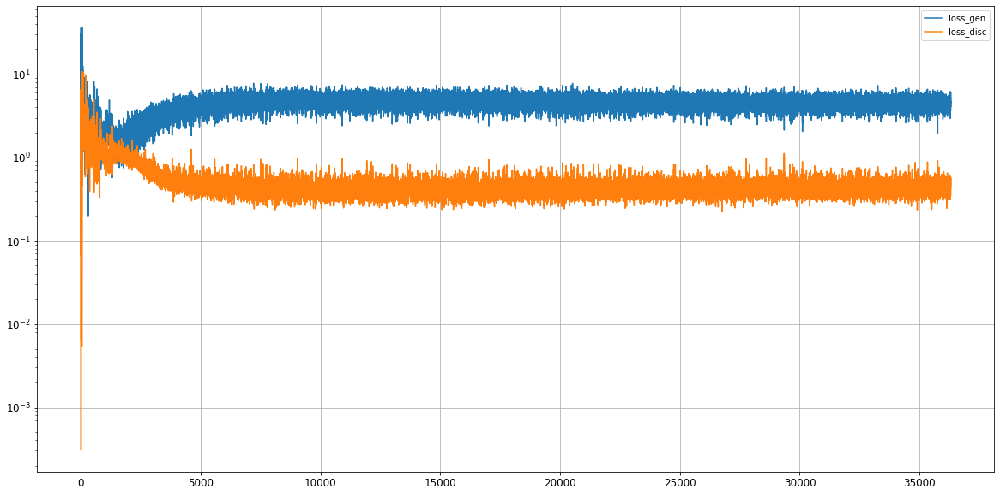

Epoch 36302/50000
0s
Epoch 36303/50000
0s
Epoch 36304/50000
0s
Epoch 36305/50000
0s
Epoch 36306/50000
0s
Epoch 36307/50000
0s
Epoch 36308/50000
0s
Epoch 36309/50000
0s
Epoch 36310/50000
0s
Epoch 36311/50000
0s
Epoch 36312/50000
0s
Epoch 36313/50000
0s
Epoch 36314/50000
0s
Epoch 36315/50000
0s
Epoch 36316/50000
0s
Epoch 36317/50000
0s
Epoch 36318/50000
0s
Epoch 36319/50000
0s
Epoch 36320/50000
0s
Epoch 36321/50000
0s
Epoch 36322/50000
0s
Epoch 36323/50000
0s
Epoch 36324/50000
0s
Epoch 36325/50000
0s
Epoch 36326/50000
0s
Epoch 36327/50000
0s
Epoch 36328/50000
0s
Epoch 36329/50000
0s
Epoch 36330/50000
0s
Epoch 36331/50000
0s
Epoch 36332/50000
0s
Epoch 36333/50000
0s
Epoch 36334/50000
0s
Epoch 36335/50000
0s
Epoch 36336/50000
0s
Epoch 36337/50000
0s
Epoch 36338/50000
0s
Epoch 36339/50000
0s
Epoch 36340/50000
0s
Epoch 36341/50000
0s
Epoch 36342/50000
0s
Epoch 36343/50000
0s
Epoch 36344/50000
0s
Epoch 36345/50000
0s
Epoch 36346/50000
0s
Epoch 36347/50000
0s
Epoch 36348/50000
0s
Epoch 36349/5

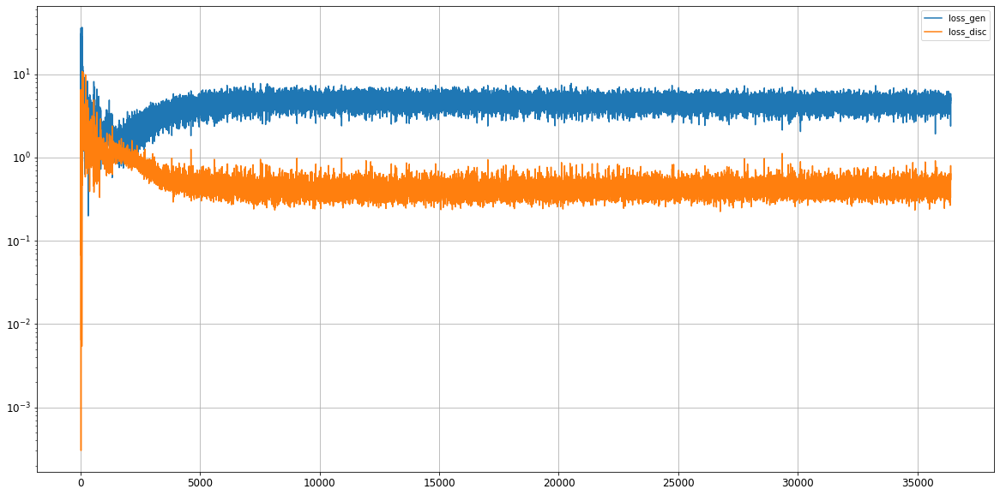

Epoch 36402/50000
0s
Epoch 36403/50000
0s
Epoch 36404/50000
0s
Epoch 36405/50000
0s
Epoch 36406/50000
0s
Epoch 36407/50000
0s
Epoch 36408/50000
0s
Epoch 36409/50000
0s
Epoch 36410/50000
0s
Epoch 36411/50000
0s
Epoch 36412/50000
0s
Epoch 36413/50000
0s
Epoch 36414/50000
0s
Epoch 36415/50000
0s
Epoch 36416/50000
0s
Epoch 36417/50000
0s
Epoch 36418/50000
0s
Epoch 36419/50000
0s
Epoch 36420/50000
0s
Epoch 36421/50000
0s
Epoch 36422/50000
0s
Epoch 36423/50000
0s
Epoch 36424/50000
0s
Epoch 36425/50000
0s
Epoch 36426/50000
0s
Epoch 36427/50000
0s
Epoch 36428/50000
0s
Epoch 36429/50000
0s
Epoch 36430/50000
0s
Epoch 36431/50000
0s
Epoch 36432/50000
0s
Epoch 36433/50000
0s
Epoch 36434/50000
0s
Epoch 36435/50000
0s
Epoch 36436/50000
0s
Epoch 36437/50000
0s
Epoch 36438/50000
0s
Epoch 36439/50000
0s
Epoch 36440/50000
0s
Epoch 36441/50000
0s
Epoch 36442/50000
0s
Epoch 36443/50000
0s
Epoch 36444/50000
0s
Epoch 36445/50000
0s
Epoch 36446/50000
0s
Epoch 36447/50000
0s
Epoch 36448/50000
0s
Epoch 36449/5

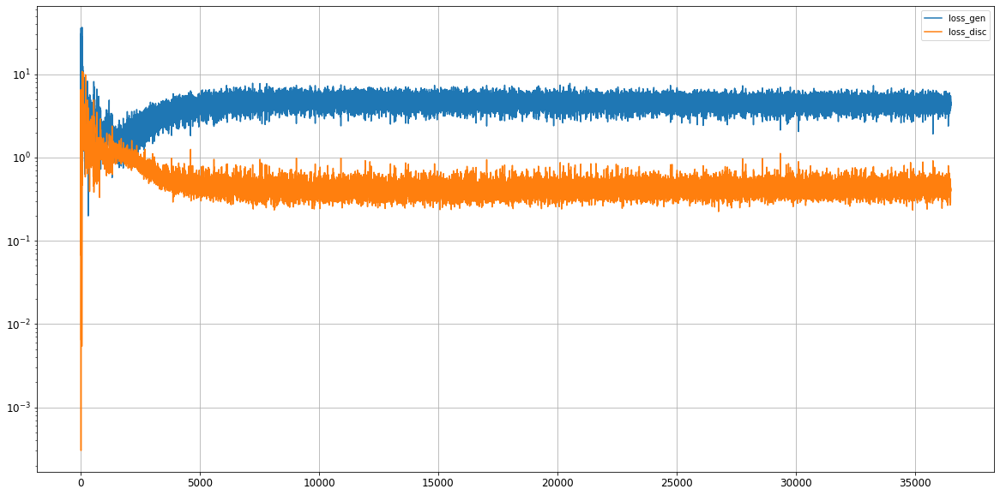

Epoch 36502/50000
0s
Epoch 36503/50000
0s
Epoch 36504/50000
0s
Epoch 36505/50000
0s
Epoch 36506/50000
0s
Epoch 36507/50000
0s
Epoch 36508/50000
0s
Epoch 36509/50000
0s
Epoch 36510/50000
0s
Epoch 36511/50000
0s
Epoch 36512/50000
0s
Epoch 36513/50000
0s
Epoch 36514/50000
0s
Epoch 36515/50000
0s
Epoch 36516/50000
0s
Epoch 36517/50000
0s
Epoch 36518/50000
0s
Epoch 36519/50000
0s
Epoch 36520/50000
0s
Epoch 36521/50000
0s
Epoch 36522/50000
0s
Epoch 36523/50000
0s
Epoch 36524/50000
0s
Epoch 36525/50000
0s
Epoch 36526/50000
0s
Epoch 36527/50000
0s
Epoch 36528/50000
0s
Epoch 36529/50000
0s
Epoch 36530/50000
0s
Epoch 36531/50000
0s
Epoch 36532/50000
0s
Epoch 36533/50000
0s
Epoch 36534/50000
0s
Epoch 36535/50000
0s
Epoch 36536/50000
0s
Epoch 36537/50000
0s
Epoch 36538/50000
0s
Epoch 36539/50000
0s
Epoch 36540/50000
0s
Epoch 36541/50000
0s
Epoch 36542/50000
0s
Epoch 36543/50000
0s
Epoch 36544/50000
0s
Epoch 36545/50000
0s
Epoch 36546/50000
0s
Epoch 36547/50000
0s
Epoch 36548/50000
0s
Epoch 36549/5

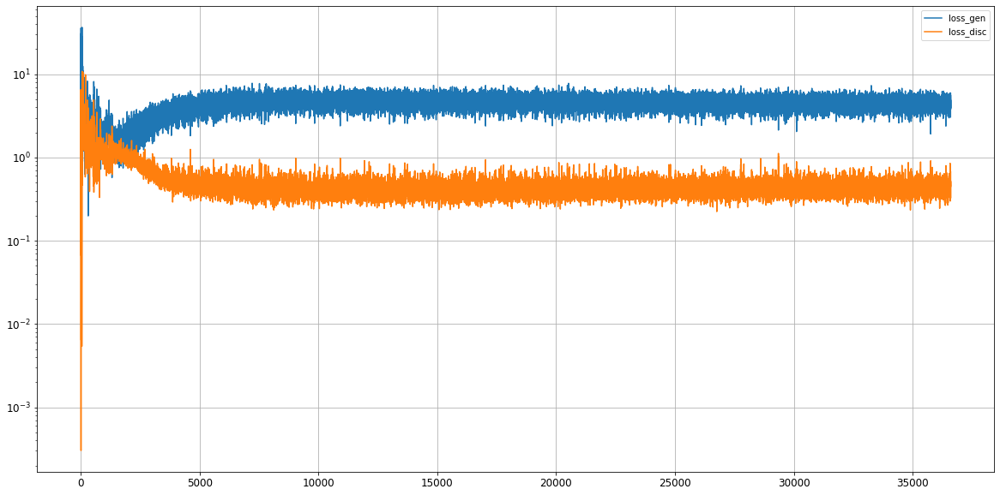

Epoch 36602/50000
0s
Epoch 36603/50000
0s
Epoch 36604/50000
0s
Epoch 36605/50000
0s
Epoch 36606/50000
0s
Epoch 36607/50000
0s
Epoch 36608/50000
0s
Epoch 36609/50000
0s
Epoch 36610/50000
0s
Epoch 36611/50000
0s
Epoch 36612/50000
0s
Epoch 36613/50000
0s
Epoch 36614/50000
0s
Epoch 36615/50000
0s
Epoch 36616/50000
0s
Epoch 36617/50000
0s
Epoch 36618/50000
0s
Epoch 36619/50000
0s
Epoch 36620/50000
0s
Epoch 36621/50000
0s
Epoch 36622/50000
0s
Epoch 36623/50000
0s
Epoch 36624/50000
0s
Epoch 36625/50000
0s
Epoch 36626/50000
0s
Epoch 36627/50000
0s
Epoch 36628/50000
0s
Epoch 36629/50000
0s
Epoch 36630/50000
0s
Epoch 36631/50000
0s
Epoch 36632/50000
0s
Epoch 36633/50000
0s
Epoch 36634/50000
0s
Epoch 36635/50000
0s
Epoch 36636/50000
0s
Epoch 36637/50000
0s
Epoch 36638/50000
0s
Epoch 36639/50000
0s
Epoch 36640/50000
0s
Epoch 36641/50000
0s
Epoch 36642/50000
0s
Epoch 36643/50000
0s
Epoch 36644/50000
0s
Epoch 36645/50000
0s
Epoch 36646/50000
0s
Epoch 36647/50000
0s
Epoch 36648/50000
0s
Epoch 36649/5

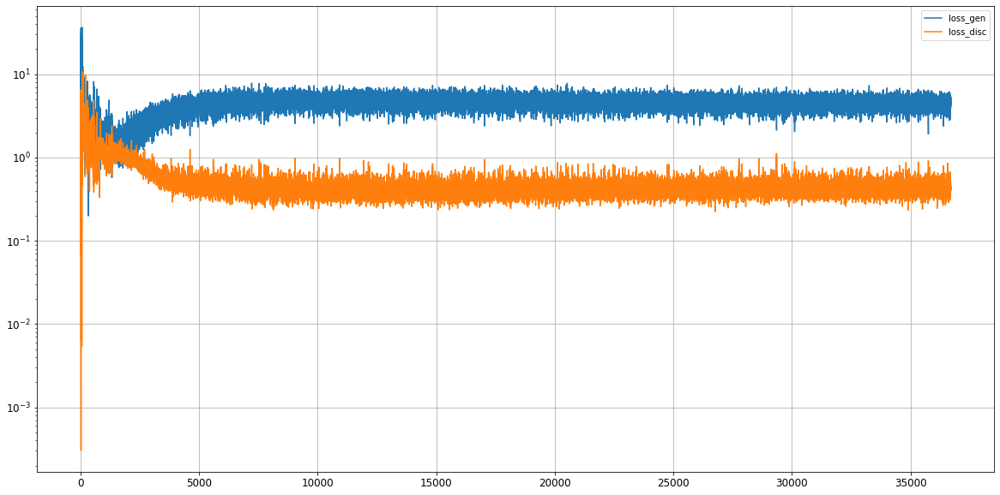

Epoch 36702/50000
0s
Epoch 36703/50000
0s
Epoch 36704/50000
0s
Epoch 36705/50000
0s
Epoch 36706/50000
0s
Epoch 36707/50000
0s
Epoch 36708/50000
0s
Epoch 36709/50000
0s
Epoch 36710/50000
0s
Epoch 36711/50000
0s
Epoch 36712/50000
0s
Epoch 36713/50000
0s
Epoch 36714/50000
0s
Epoch 36715/50000
0s
Epoch 36716/50000
0s
Epoch 36717/50000
0s
Epoch 36718/50000
0s
Epoch 36719/50000
0s
Epoch 36720/50000
0s
Epoch 36721/50000
0s
Epoch 36722/50000
0s
Epoch 36723/50000
0s
Epoch 36724/50000
0s
Epoch 36725/50000
0s
Epoch 36726/50000
0s
Epoch 36727/50000
0s
Epoch 36728/50000
0s
Epoch 36729/50000
0s
Epoch 36730/50000
0s
Epoch 36731/50000
0s
Epoch 36732/50000
0s
Epoch 36733/50000
0s
Epoch 36734/50000
0s
Epoch 36735/50000
0s
Epoch 36736/50000
0s
Epoch 36737/50000
0s
Epoch 36738/50000
0s
Epoch 36739/50000
0s
Epoch 36740/50000
0s
Epoch 36741/50000
0s
Epoch 36742/50000
0s
Epoch 36743/50000
0s
Epoch 36744/50000
0s
Epoch 36745/50000
0s
Epoch 36746/50000
0s
Epoch 36747/50000
0s
Epoch 36748/50000
0s
Epoch 36749/5

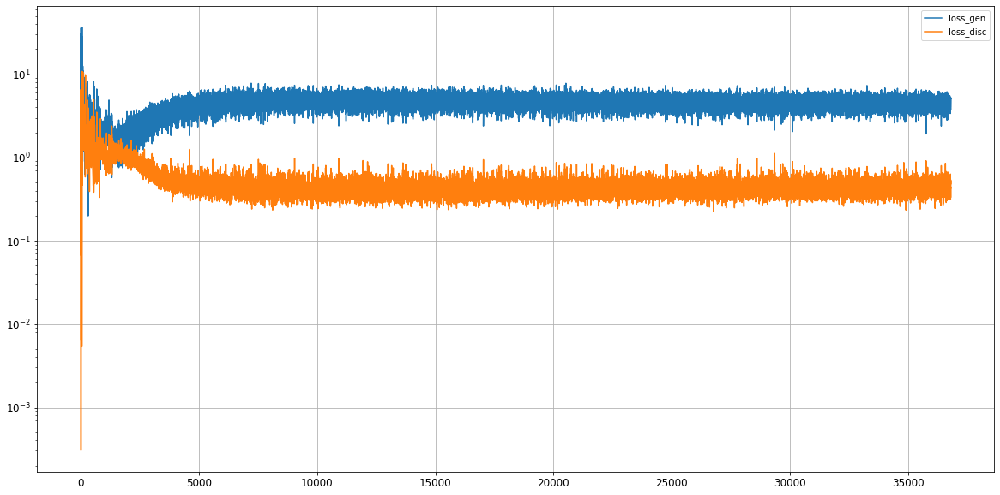

Epoch 36802/50000
0s
Epoch 36803/50000
0s
Epoch 36804/50000
0s
Epoch 36805/50000
0s
Epoch 36806/50000
0s
Epoch 36807/50000
0s
Epoch 36808/50000
0s
Epoch 36809/50000
0s
Epoch 36810/50000
0s
Epoch 36811/50000
0s
Epoch 36812/50000
0s
Epoch 36813/50000
0s
Epoch 36814/50000
0s
Epoch 36815/50000
0s
Epoch 36816/50000
0s
Epoch 36817/50000
0s
Epoch 36818/50000
0s
Epoch 36819/50000
0s
Epoch 36820/50000
0s
Epoch 36821/50000
0s
Epoch 36822/50000
0s
Epoch 36823/50000
0s
Epoch 36824/50000
0s
Epoch 36825/50000
0s
Epoch 36826/50000
0s
Epoch 36827/50000
0s
Epoch 36828/50000
0s
Epoch 36829/50000
0s
Epoch 36830/50000
0s
Epoch 36831/50000
0s
Epoch 36832/50000
0s
Epoch 36833/50000
0s
Epoch 36834/50000
0s
Epoch 36835/50000
0s
Epoch 36836/50000
0s
Epoch 36837/50000
0s
Epoch 36838/50000
0s
Epoch 36839/50000
0s
Epoch 36840/50000
0s
Epoch 36841/50000
0s
Epoch 36842/50000
0s
Epoch 36843/50000
0s
Epoch 36844/50000
0s
Epoch 36845/50000
0s
Epoch 36846/50000
0s
Epoch 36847/50000
0s
Epoch 36848/50000
0s
Epoch 36849/5

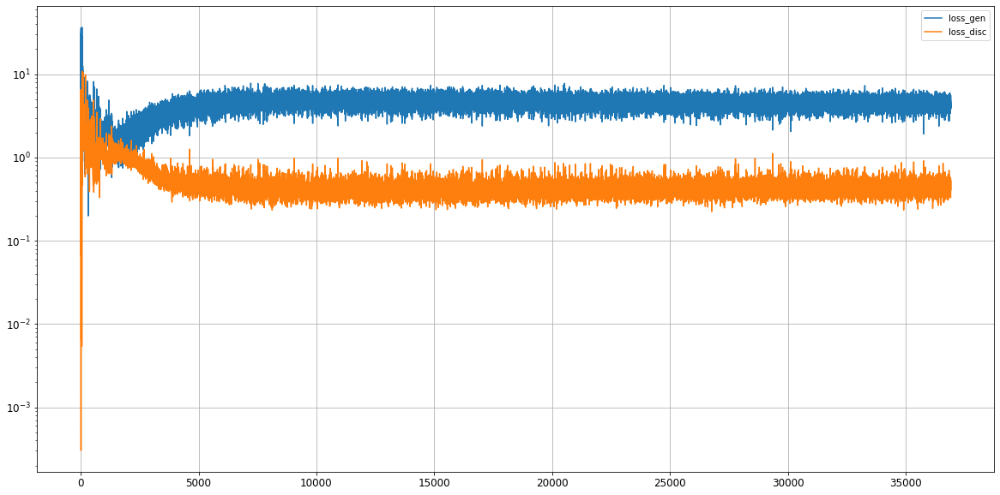

Epoch 36902/50000
0s
Epoch 36903/50000
0s
Epoch 36904/50000
0s
Epoch 36905/50000
0s
Epoch 36906/50000
0s
Epoch 36907/50000
0s
Epoch 36908/50000
0s
Epoch 36909/50000
0s
Epoch 36910/50000
0s
Epoch 36911/50000
0s
Epoch 36912/50000
0s
Epoch 36913/50000
0s
Epoch 36914/50000
0s
Epoch 36915/50000
0s
Epoch 36916/50000
0s
Epoch 36917/50000
0s
Epoch 36918/50000
0s
Epoch 36919/50000
0s
Epoch 36920/50000
0s
Epoch 36921/50000
0s
Epoch 36922/50000
0s
Epoch 36923/50000
0s
Epoch 36924/50000
0s
Epoch 36925/50000
0s
Epoch 36926/50000
0s
Epoch 36927/50000
0s
Epoch 36928/50000
0s
Epoch 36929/50000
0s
Epoch 36930/50000
0s
Epoch 36931/50000
0s
Epoch 36932/50000
0s
Epoch 36933/50000
0s
Epoch 36934/50000
0s
Epoch 36935/50000
0s
Epoch 36936/50000
0s
Epoch 36937/50000
0s
Epoch 36938/50000
0s
Epoch 36939/50000
0s
Epoch 36940/50000
0s
Epoch 36941/50000
0s
Epoch 36942/50000
0s
Epoch 36943/50000
0s
Epoch 36944/50000
0s
Epoch 36945/50000
0s
Epoch 36946/50000
0s
Epoch 36947/50000
0s
Epoch 36948/50000
0s
Epoch 36949/5

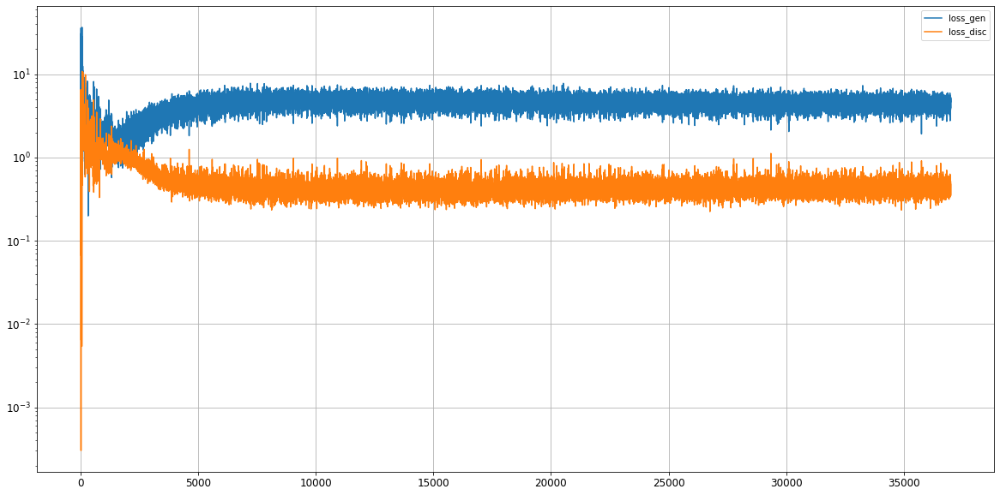

Epoch 37002/50000
0s
Epoch 37003/50000
0s
Epoch 37004/50000
0s
Epoch 37005/50000
0s
Epoch 37006/50000
0s
Epoch 37007/50000
0s
Epoch 37008/50000
0s
Epoch 37009/50000
0s
Epoch 37010/50000
0s
Epoch 37011/50000
0s
Epoch 37012/50000
0s
Epoch 37013/50000
0s
Epoch 37014/50000
0s
Epoch 37015/50000
0s
Epoch 37016/50000
0s
Epoch 37017/50000
0s
Epoch 37018/50000
0s
Epoch 37019/50000
0s
Epoch 37020/50000
0s
Epoch 37021/50000
0s
Epoch 37022/50000
0s
Epoch 37023/50000
0s
Epoch 37024/50000
0s
Epoch 37025/50000
0s
Epoch 37026/50000
0s
Epoch 37027/50000
0s
Epoch 37028/50000
0s
Epoch 37029/50000
0s
Epoch 37030/50000
0s
Epoch 37031/50000
0s
Epoch 37032/50000
0s
Epoch 37033/50000
0s
Epoch 37034/50000
0s
Epoch 37035/50000
0s
Epoch 37036/50000
0s
Epoch 37037/50000
0s
Epoch 37038/50000
0s
Epoch 37039/50000
0s
Epoch 37040/50000
0s
Epoch 37041/50000
0s
Epoch 37042/50000
0s
Epoch 37043/50000
0s
Epoch 37044/50000
0s
Epoch 37045/50000
0s
Epoch 37046/50000
0s
Epoch 37047/50000
0s
Epoch 37048/50000
0s
Epoch 37049/5

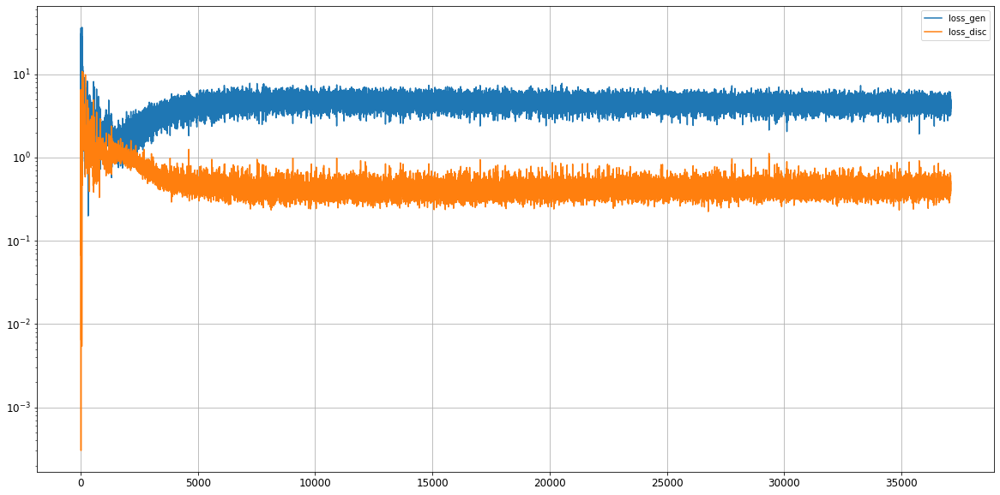

Epoch 37102/50000
0s
Epoch 37103/50000
0s
Epoch 37104/50000
0s
Epoch 37105/50000
0s
Epoch 37106/50000
0s
Epoch 37107/50000
0s
Epoch 37108/50000
0s
Epoch 37109/50000
0s
Epoch 37110/50000
0s
Epoch 37111/50000
0s
Epoch 37112/50000
0s
Epoch 37113/50000
0s
Epoch 37114/50000
0s
Epoch 37115/50000
0s
Epoch 37116/50000
0s
Epoch 37117/50000
0s
Epoch 37118/50000
0s
Epoch 37119/50000
0s
Epoch 37120/50000
0s
Epoch 37121/50000
0s
Epoch 37122/50000
0s
Epoch 37123/50000
0s
Epoch 37124/50000
0s
Epoch 37125/50000
0s
Epoch 37126/50000
0s
Epoch 37127/50000
0s
Epoch 37128/50000
0s
Epoch 37129/50000
0s
Epoch 37130/50000
0s
Epoch 37131/50000
0s
Epoch 37132/50000
0s
Epoch 37133/50000
0s
Epoch 37134/50000
0s
Epoch 37135/50000
0s
Epoch 37136/50000
0s
Epoch 37137/50000
0s
Epoch 37138/50000
0s
Epoch 37139/50000
0s
Epoch 37140/50000
0s
Epoch 37141/50000
0s
Epoch 37142/50000
0s
Epoch 37143/50000
0s
Epoch 37144/50000
0s
Epoch 37145/50000
0s
Epoch 37146/50000
0s
Epoch 37147/50000
0s
Epoch 37148/50000
0s
Epoch 37149/5

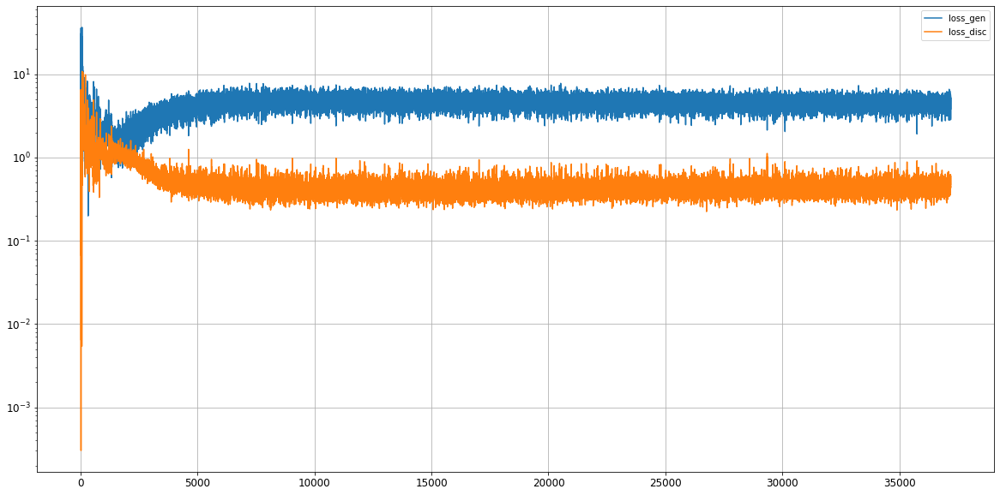

Epoch 37202/50000
0s
Epoch 37203/50000
0s
Epoch 37204/50000
0s
Epoch 37205/50000
0s
Epoch 37206/50000
0s
Epoch 37207/50000
0s
Epoch 37208/50000
0s
Epoch 37209/50000
0s
Epoch 37210/50000
0s
Epoch 37211/50000
0s
Epoch 37212/50000
0s
Epoch 37213/50000
0s
Epoch 37214/50000
0s
Epoch 37215/50000
0s
Epoch 37216/50000
0s
Epoch 37217/50000
0s
Epoch 37218/50000
0s
Epoch 37219/50000
0s
Epoch 37220/50000
0s
Epoch 37221/50000
0s
Epoch 37222/50000
0s
Epoch 37223/50000
0s
Epoch 37224/50000
0s
Epoch 37225/50000
0s
Epoch 37226/50000
0s
Epoch 37227/50000
0s
Epoch 37228/50000
0s
Epoch 37229/50000
0s
Epoch 37230/50000
0s
Epoch 37231/50000
0s
Epoch 37232/50000
0s
Epoch 37233/50000
0s
Epoch 37234/50000
0s
Epoch 37235/50000
0s
Epoch 37236/50000
0s
Epoch 37237/50000
0s
Epoch 37238/50000
0s
Epoch 37239/50000
0s
Epoch 37240/50000
0s
Epoch 37241/50000
0s
Epoch 37242/50000
0s
Epoch 37243/50000
0s
Epoch 37244/50000
0s
Epoch 37245/50000
0s
Epoch 37246/50000
0s
Epoch 37247/50000
0s
Epoch 37248/50000
0s
Epoch 37249/5

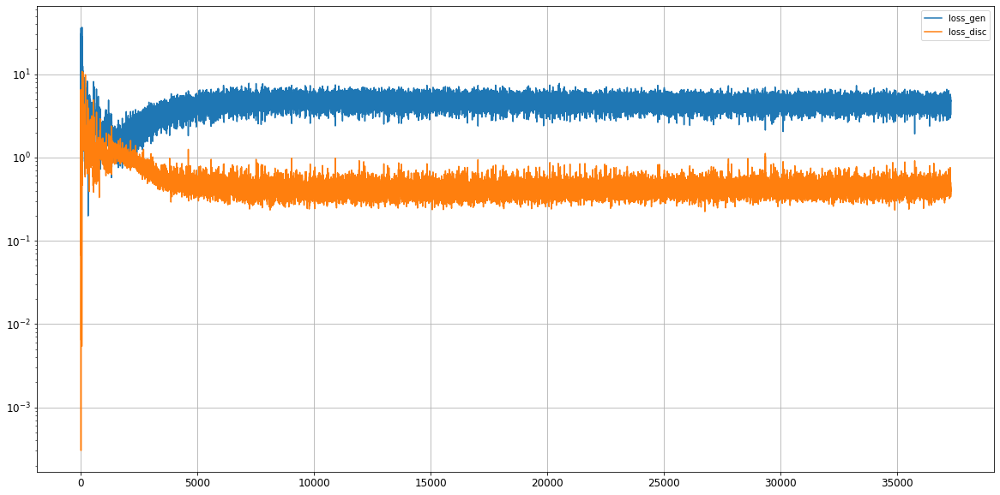

Epoch 37302/50000
0s
Epoch 37303/50000
0s
Epoch 37304/50000
0s
Epoch 37305/50000
0s
Epoch 37306/50000
0s
Epoch 37307/50000
0s
Epoch 37308/50000
0s
Epoch 37309/50000
0s
Epoch 37310/50000
0s
Epoch 37311/50000
0s
Epoch 37312/50000
0s
Epoch 37313/50000
0s
Epoch 37314/50000
0s
Epoch 37315/50000
0s
Epoch 37316/50000
0s
Epoch 37317/50000
0s
Epoch 37318/50000
0s
Epoch 37319/50000
0s
Epoch 37320/50000
0s
Epoch 37321/50000
0s
Epoch 37322/50000
0s
Epoch 37323/50000
0s
Epoch 37324/50000
0s
Epoch 37325/50000
0s
Epoch 37326/50000
0s
Epoch 37327/50000
0s
Epoch 37328/50000
0s
Epoch 37329/50000
0s
Epoch 37330/50000
0s
Epoch 37331/50000
0s
Epoch 37332/50000
0s
Epoch 37333/50000
0s
Epoch 37334/50000
0s
Epoch 37335/50000
0s
Epoch 37336/50000
0s
Epoch 37337/50000
0s
Epoch 37338/50000
0s
Epoch 37339/50000
0s
Epoch 37340/50000
0s
Epoch 37341/50000
0s
Epoch 37342/50000
0s
Epoch 37343/50000
0s
Epoch 37344/50000
0s
Epoch 37345/50000
0s
Epoch 37346/50000
0s
Epoch 37347/50000
0s
Epoch 37348/50000
0s
Epoch 37349/5

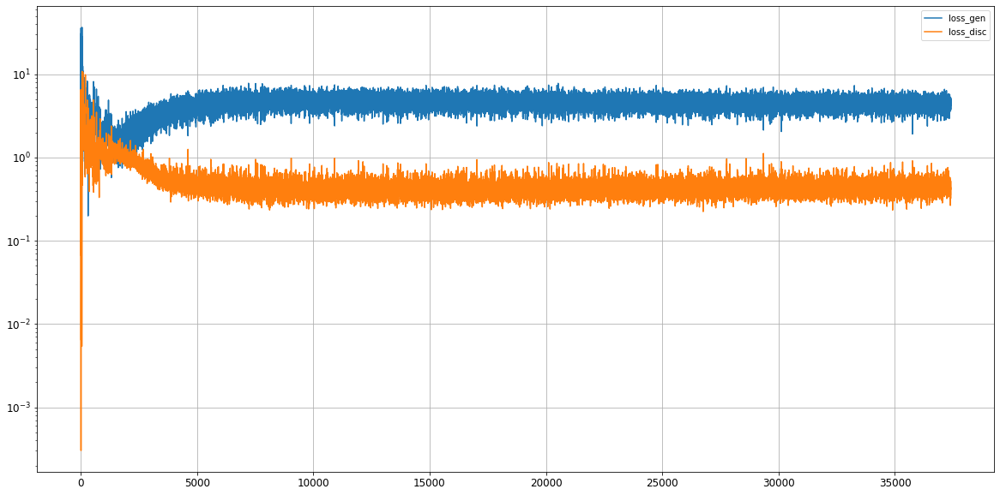

Epoch 37402/50000
0s
Epoch 37403/50000
0s
Epoch 37404/50000
0s
Epoch 37405/50000
0s
Epoch 37406/50000
0s
Epoch 37407/50000
0s
Epoch 37408/50000
0s
Epoch 37409/50000
0s
Epoch 37410/50000
0s
Epoch 37411/50000
0s
Epoch 37412/50000
0s
Epoch 37413/50000
0s
Epoch 37414/50000
0s
Epoch 37415/50000
0s
Epoch 37416/50000
0s
Epoch 37417/50000
0s
Epoch 37418/50000
0s
Epoch 37419/50000
0s
Epoch 37420/50000
0s
Epoch 37421/50000
0s
Epoch 37422/50000
0s
Epoch 37423/50000
0s
Epoch 37424/50000
0s
Epoch 37425/50000
0s
Epoch 37426/50000
0s
Epoch 37427/50000
0s
Epoch 37428/50000
0s
Epoch 37429/50000
0s
Epoch 37430/50000
0s
Epoch 37431/50000
0s
Epoch 37432/50000
0s
Epoch 37433/50000
0s
Epoch 37434/50000
0s
Epoch 37435/50000
0s
Epoch 37436/50000
0s
Epoch 37437/50000
0s
Epoch 37438/50000
0s
Epoch 37439/50000
0s
Epoch 37440/50000
0s
Epoch 37441/50000
0s
Epoch 37442/50000
0s
Epoch 37443/50000
0s
Epoch 37444/50000
0s
Epoch 37445/50000
0s
Epoch 37446/50000
0s
Epoch 37447/50000
0s
Epoch 37448/50000
0s
Epoch 37449/5

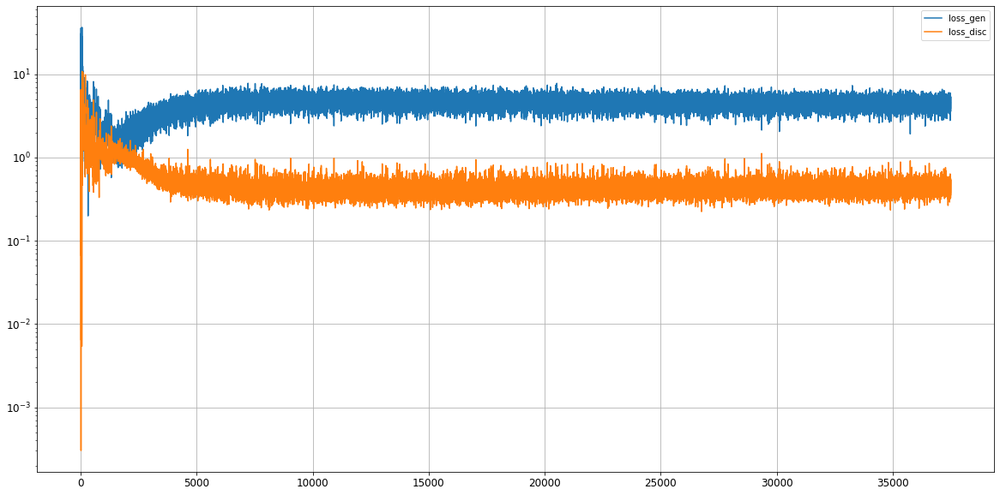

Epoch 37502/50000
0s
Epoch 37503/50000
0s
Epoch 37504/50000
0s
Epoch 37505/50000
0s
Epoch 37506/50000
0s
Epoch 37507/50000
0s
Epoch 37508/50000
0s
Epoch 37509/50000
0s
Epoch 37510/50000
0s
Epoch 37511/50000
0s
Epoch 37512/50000
0s
Epoch 37513/50000
0s
Epoch 37514/50000
0s
Epoch 37515/50000
0s
Epoch 37516/50000
0s
Epoch 37517/50000
0s
Epoch 37518/50000
0s
Epoch 37519/50000
0s
Epoch 37520/50000
0s
Epoch 37521/50000
0s
Epoch 37522/50000
0s
Epoch 37523/50000
0s
Epoch 37524/50000
0s
Epoch 37525/50000
0s
Epoch 37526/50000
0s
Epoch 37527/50000
0s
Epoch 37528/50000
0s
Epoch 37529/50000
0s
Epoch 37530/50000
0s
Epoch 37531/50000
0s
Epoch 37532/50000
0s
Epoch 37533/50000
0s
Epoch 37534/50000
0s
Epoch 37535/50000
0s
Epoch 37536/50000
0s
Epoch 37537/50000
0s
Epoch 37538/50000
0s
Epoch 37539/50000
0s
Epoch 37540/50000
0s
Epoch 37541/50000
0s
Epoch 37542/50000
0s
Epoch 37543/50000
0s
Epoch 37544/50000
0s
Epoch 37545/50000
0s
Epoch 37546/50000
0s
Epoch 37547/50000
0s
Epoch 37548/50000
0s
Epoch 37549/5

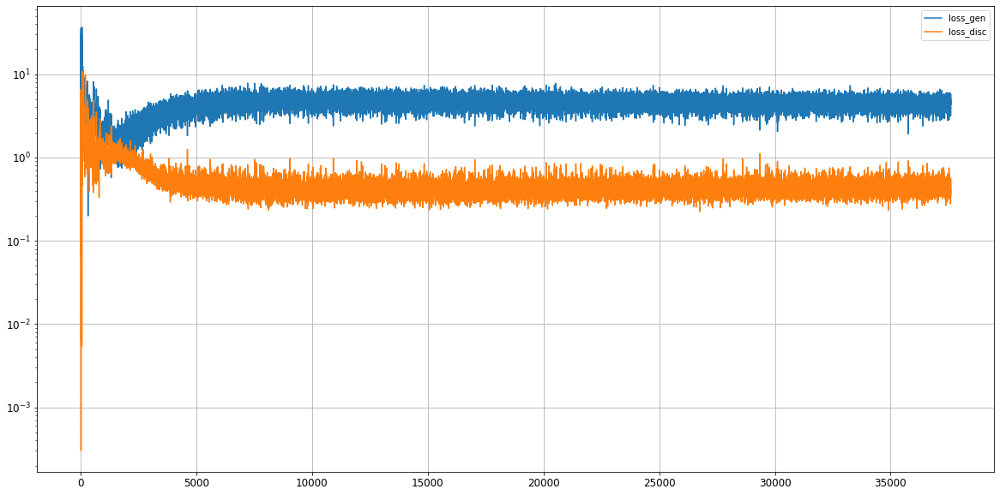

Epoch 37602/50000
0s
Epoch 37603/50000
0s
Epoch 37604/50000
0s
Epoch 37605/50000
0s
Epoch 37606/50000
0s
Epoch 37607/50000
0s
Epoch 37608/50000
0s
Epoch 37609/50000
0s
Epoch 37610/50000
0s
Epoch 37611/50000
0s
Epoch 37612/50000
0s
Epoch 37613/50000
0s
Epoch 37614/50000
0s
Epoch 37615/50000
0s
Epoch 37616/50000
0s
Epoch 37617/50000
0s
Epoch 37618/50000
0s
Epoch 37619/50000
0s
Epoch 37620/50000
0s
Epoch 37621/50000
0s
Epoch 37622/50000
0s
Epoch 37623/50000
0s
Epoch 37624/50000
0s
Epoch 37625/50000
0s
Epoch 37626/50000
0s
Epoch 37627/50000
0s
Epoch 37628/50000
0s
Epoch 37629/50000
0s
Epoch 37630/50000
0s
Epoch 37631/50000
0s
Epoch 37632/50000
0s
Epoch 37633/50000
0s
Epoch 37634/50000
0s
Epoch 37635/50000
0s
Epoch 37636/50000
0s
Epoch 37637/50000
0s
Epoch 37638/50000
0s
Epoch 37639/50000
0s
Epoch 37640/50000
0s
Epoch 37641/50000
0s
Epoch 37642/50000
0s
Epoch 37643/50000
0s
Epoch 37644/50000
0s
Epoch 37645/50000
0s
Epoch 37646/50000
0s
Epoch 37647/50000
0s
Epoch 37648/50000
0s
Epoch 37649/5

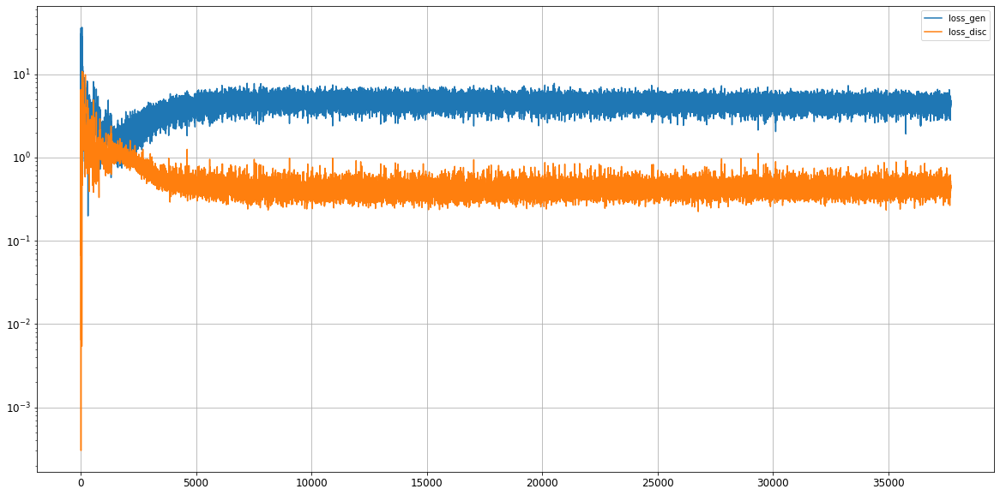

Epoch 37702/50000
0s
Epoch 37703/50000
0s
Epoch 37704/50000
0s
Epoch 37705/50000
0s
Epoch 37706/50000
0s
Epoch 37707/50000
0s
Epoch 37708/50000
0s
Epoch 37709/50000
0s
Epoch 37710/50000
0s
Epoch 37711/50000
0s
Epoch 37712/50000
0s
Epoch 37713/50000
0s
Epoch 37714/50000
0s
Epoch 37715/50000
0s
Epoch 37716/50000
0s
Epoch 37717/50000
0s
Epoch 37718/50000
0s
Epoch 37719/50000
0s
Epoch 37720/50000
0s
Epoch 37721/50000
0s
Epoch 37722/50000
0s
Epoch 37723/50000
0s
Epoch 37724/50000
0s
Epoch 37725/50000
0s
Epoch 37726/50000
0s
Epoch 37727/50000
0s
Epoch 37728/50000
0s
Epoch 37729/50000
0s
Epoch 37730/50000
0s
Epoch 37731/50000
0s
Epoch 37732/50000
0s
Epoch 37733/50000
0s
Epoch 37734/50000
0s
Epoch 37735/50000
0s
Epoch 37736/50000
0s
Epoch 37737/50000
0s
Epoch 37738/50000
0s
Epoch 37739/50000
0s
Epoch 37740/50000
0s
Epoch 37741/50000
0s
Epoch 37742/50000
0s
Epoch 37743/50000
0s
Epoch 37744/50000
0s
Epoch 37745/50000
0s
Epoch 37746/50000
0s
Epoch 37747/50000
0s
Epoch 37748/50000
0s
Epoch 37749/5

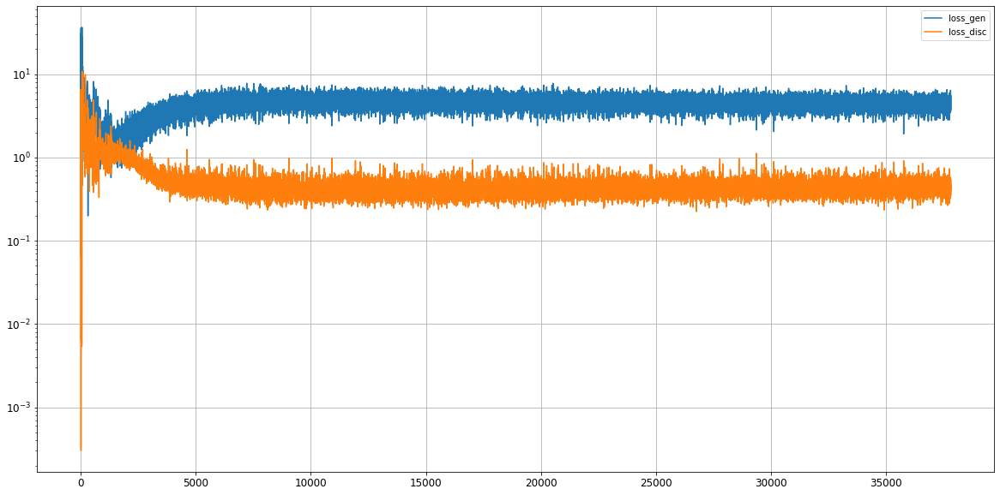

Epoch 37802/50000
0s
Epoch 37803/50000
0s
Epoch 37804/50000
0s
Epoch 37805/50000
0s
Epoch 37806/50000
0s
Epoch 37807/50000
0s
Epoch 37808/50000
0s
Epoch 37809/50000
0s
Epoch 37810/50000
0s
Epoch 37811/50000
0s
Epoch 37812/50000
0s
Epoch 37813/50000
0s
Epoch 37814/50000
0s
Epoch 37815/50000
0s
Epoch 37816/50000
0s
Epoch 37817/50000
0s
Epoch 37818/50000
0s
Epoch 37819/50000
0s
Epoch 37820/50000
0s
Epoch 37821/50000
0s
Epoch 37822/50000
0s
Epoch 37823/50000
0s
Epoch 37824/50000
0s
Epoch 37825/50000
0s
Epoch 37826/50000
0s
Epoch 37827/50000
0s
Epoch 37828/50000
0s
Epoch 37829/50000
0s
Epoch 37830/50000
0s
Epoch 37831/50000
0s
Epoch 37832/50000
0s
Epoch 37833/50000
0s
Epoch 37834/50000
0s
Epoch 37835/50000
0s
Epoch 37836/50000
0s
Epoch 37837/50000
0s
Epoch 37838/50000
0s
Epoch 37839/50000
0s
Epoch 37840/50000
0s
Epoch 37841/50000
0s
Epoch 37842/50000
0s
Epoch 37843/50000
0s
Epoch 37844/50000
0s
Epoch 37845/50000
0s
Epoch 37846/50000
0s
Epoch 37847/50000
0s
Epoch 37848/50000
0s
Epoch 37849/5

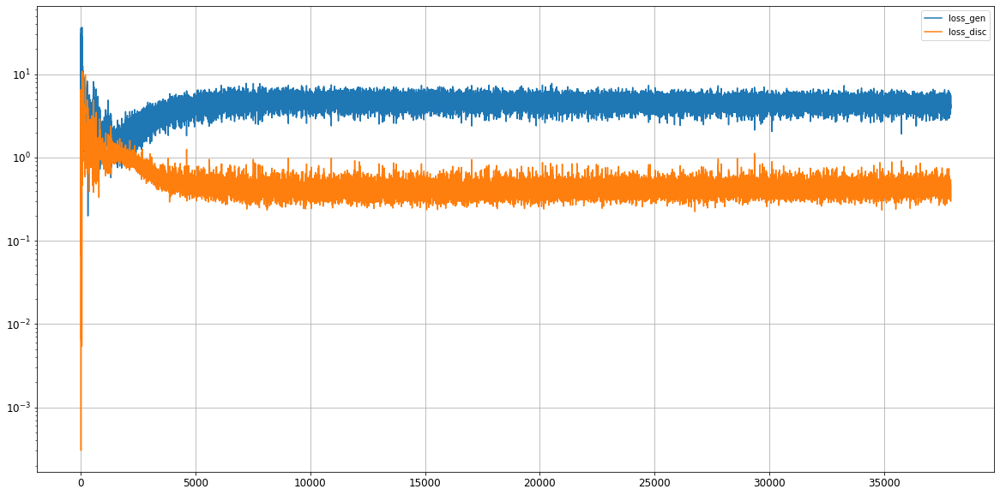

Epoch 37902/50000
0s
Epoch 37903/50000
0s
Epoch 37904/50000
0s
Epoch 37905/50000
0s
Epoch 37906/50000
0s
Epoch 37907/50000
0s
Epoch 37908/50000
0s
Epoch 37909/50000
0s
Epoch 37910/50000
0s
Epoch 37911/50000
0s
Epoch 37912/50000
0s
Epoch 37913/50000
0s
Epoch 37914/50000
0s
Epoch 37915/50000
0s
Epoch 37916/50000
0s
Epoch 37917/50000
0s
Epoch 37918/50000
0s
Epoch 37919/50000
0s
Epoch 37920/50000
0s
Epoch 37921/50000
0s
Epoch 37922/50000
0s
Epoch 37923/50000
0s
Epoch 37924/50000
0s
Epoch 37925/50000
0s
Epoch 37926/50000
0s
Epoch 37927/50000
0s
Epoch 37928/50000
0s
Epoch 37929/50000
0s
Epoch 37930/50000
0s
Epoch 37931/50000
0s
Epoch 37932/50000
0s
Epoch 37933/50000
0s
Epoch 37934/50000
0s
Epoch 37935/50000
0s
Epoch 37936/50000
0s
Epoch 37937/50000
0s
Epoch 37938/50000
0s
Epoch 37939/50000
0s
Epoch 37940/50000
0s
Epoch 37941/50000
0s
Epoch 37942/50000
0s
Epoch 37943/50000
0s
Epoch 37944/50000
0s
Epoch 37945/50000
0s
Epoch 37946/50000
0s
Epoch 37947/50000
0s
Epoch 37948/50000
0s
Epoch 37949/5

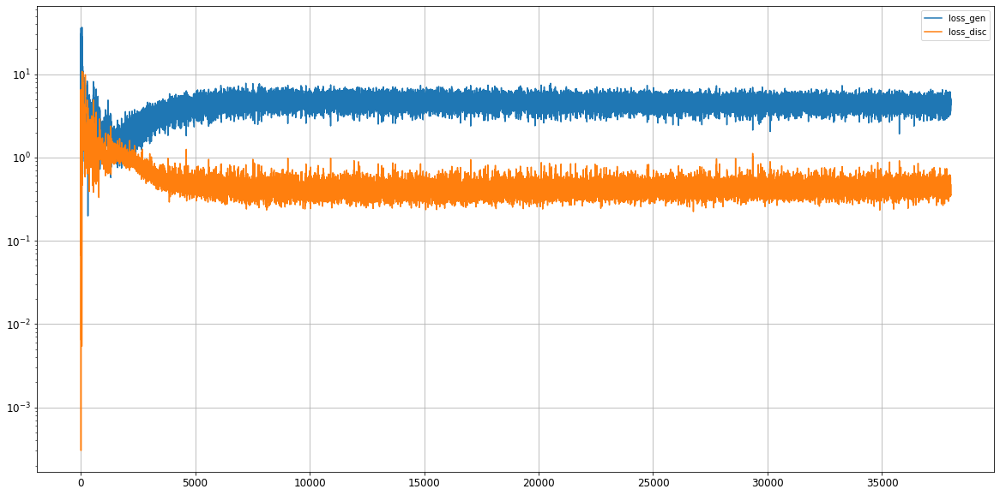

Epoch 38002/50000
0s
Epoch 38003/50000
0s
Epoch 38004/50000
0s
Epoch 38005/50000
0s
Epoch 38006/50000
0s
Epoch 38007/50000
0s
Epoch 38008/50000
0s
Epoch 38009/50000
0s
Epoch 38010/50000
0s
Epoch 38011/50000
0s
Epoch 38012/50000
0s
Epoch 38013/50000
0s
Epoch 38014/50000
0s
Epoch 38015/50000
0s
Epoch 38016/50000
0s
Epoch 38017/50000
0s
Epoch 38018/50000
0s
Epoch 38019/50000
0s
Epoch 38020/50000
0s
Epoch 38021/50000
0s
Epoch 38022/50000
0s
Epoch 38023/50000
0s
Epoch 38024/50000
0s
Epoch 38025/50000
0s
Epoch 38026/50000
0s
Epoch 38027/50000
0s
Epoch 38028/50000
0s
Epoch 38029/50000
0s
Epoch 38030/50000
0s
Epoch 38031/50000
0s
Epoch 38032/50000
0s
Epoch 38033/50000
0s
Epoch 38034/50000
0s
Epoch 38035/50000
0s
Epoch 38036/50000
0s
Epoch 38037/50000
0s
Epoch 38038/50000
0s
Epoch 38039/50000
0s
Epoch 38040/50000
0s
Epoch 38041/50000
0s
Epoch 38042/50000
0s
Epoch 38043/50000
0s
Epoch 38044/50000
0s
Epoch 38045/50000
0s
Epoch 38046/50000
0s
Epoch 38047/50000
0s
Epoch 38048/50000
0s
Epoch 38049/5

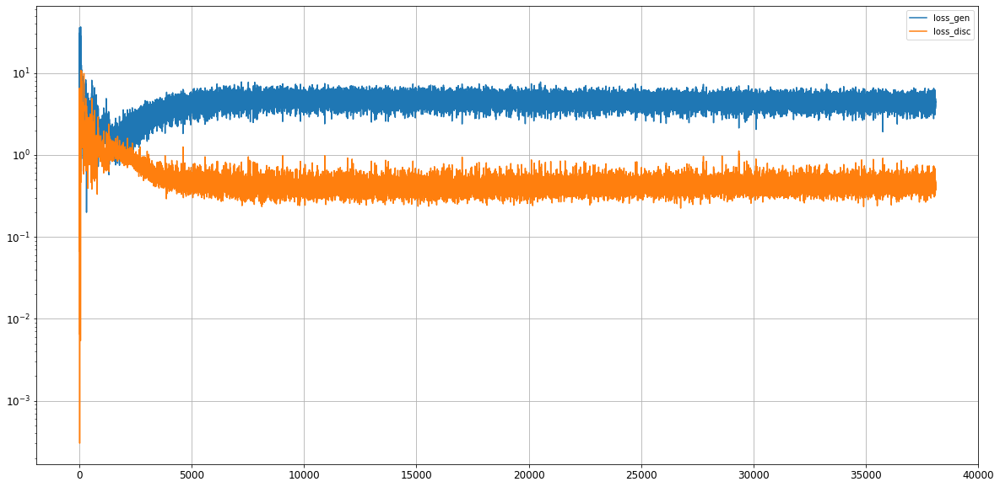

Epoch 38102/50000
0s
Epoch 38103/50000
0s
Epoch 38104/50000
0s
Epoch 38105/50000
0s
Epoch 38106/50000
0s
Epoch 38107/50000
0s
Epoch 38108/50000
0s
Epoch 38109/50000
0s
Epoch 38110/50000
0s
Epoch 38111/50000
0s
Epoch 38112/50000
0s
Epoch 38113/50000
0s
Epoch 38114/50000
0s
Epoch 38115/50000
0s
Epoch 38116/50000
0s
Epoch 38117/50000
0s
Epoch 38118/50000
0s
Epoch 38119/50000
0s
Epoch 38120/50000
0s
Epoch 38121/50000
0s
Epoch 38122/50000
0s
Epoch 38123/50000
0s
Epoch 38124/50000
0s
Epoch 38125/50000
0s
Epoch 38126/50000
0s
Epoch 38127/50000
0s
Epoch 38128/50000
0s
Epoch 38129/50000
0s
Epoch 38130/50000
0s
Epoch 38131/50000
0s
Epoch 38132/50000
0s
Epoch 38133/50000
0s
Epoch 38134/50000
0s
Epoch 38135/50000
0s
Epoch 38136/50000
0s
Epoch 38137/50000
0s
Epoch 38138/50000
0s
Epoch 38139/50000
0s
Epoch 38140/50000
0s
Epoch 38141/50000
0s
Epoch 38142/50000
0s
Epoch 38143/50000
0s
Epoch 38144/50000
0s
Epoch 38145/50000
0s
Epoch 38146/50000
0s
Epoch 38147/50000
0s
Epoch 38148/50000
0s
Epoch 38149/5

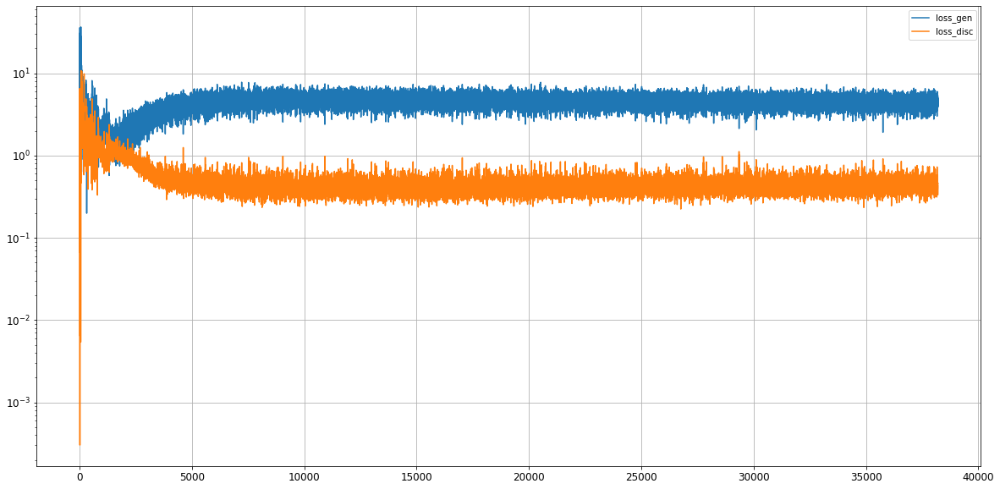

Epoch 38202/50000
0s
Epoch 38203/50000
0s
Epoch 38204/50000
0s
Epoch 38205/50000
0s
Epoch 38206/50000
0s
Epoch 38207/50000
0s
Epoch 38208/50000
0s
Epoch 38209/50000
0s
Epoch 38210/50000
0s
Epoch 38211/50000
0s
Epoch 38212/50000
0s
Epoch 38213/50000
0s
Epoch 38214/50000
0s
Epoch 38215/50000
0s
Epoch 38216/50000
0s
Epoch 38217/50000
0s
Epoch 38218/50000
0s
Epoch 38219/50000
0s
Epoch 38220/50000
0s
Epoch 38221/50000
0s
Epoch 38222/50000
0s
Epoch 38223/50000
0s
Epoch 38224/50000
0s
Epoch 38225/50000
0s
Epoch 38226/50000
0s
Epoch 38227/50000
0s
Epoch 38228/50000
0s
Epoch 38229/50000
0s
Epoch 38230/50000
0s
Epoch 38231/50000
0s
Epoch 38232/50000
0s
Epoch 38233/50000
0s
Epoch 38234/50000
0s
Epoch 38235/50000
0s
Epoch 38236/50000
0s
Epoch 38237/50000
0s
Epoch 38238/50000
0s
Epoch 38239/50000
0s
Epoch 38240/50000
0s
Epoch 38241/50000
0s
Epoch 38242/50000
0s
Epoch 38243/50000
0s
Epoch 38244/50000
0s
Epoch 38245/50000
0s
Epoch 38246/50000
0s
Epoch 38247/50000
0s
Epoch 38248/50000
0s
Epoch 38249/5

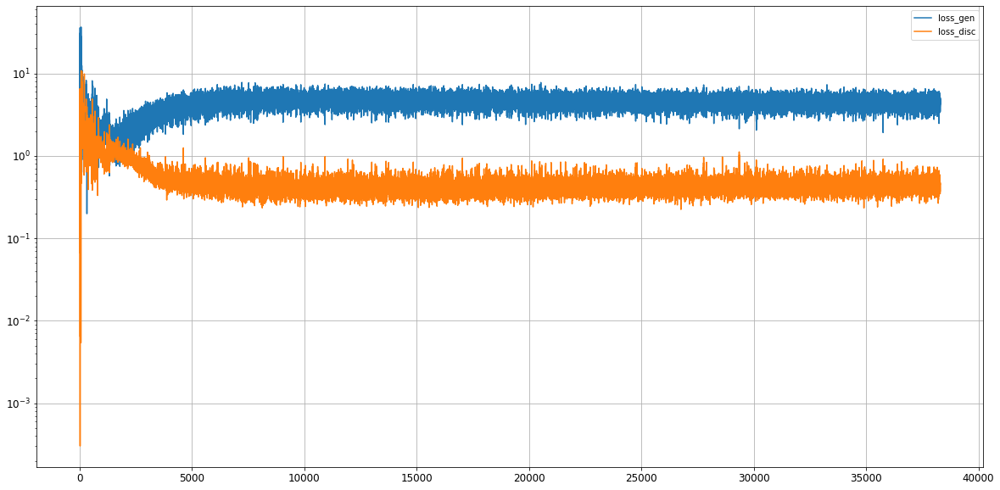

Epoch 38302/50000
0s
Epoch 38303/50000
0s
Epoch 38304/50000
0s
Epoch 38305/50000
0s
Epoch 38306/50000
0s
Epoch 38307/50000
0s
Epoch 38308/50000
0s
Epoch 38309/50000
0s
Epoch 38310/50000
0s
Epoch 38311/50000
0s
Epoch 38312/50000
0s
Epoch 38313/50000
0s
Epoch 38314/50000
0s
Epoch 38315/50000
0s
Epoch 38316/50000
0s
Epoch 38317/50000
0s
Epoch 38318/50000
0s
Epoch 38319/50000
0s
Epoch 38320/50000
0s
Epoch 38321/50000
0s
Epoch 38322/50000
0s
Epoch 38323/50000
0s
Epoch 38324/50000
0s
Epoch 38325/50000
0s
Epoch 38326/50000
0s
Epoch 38327/50000
0s
Epoch 38328/50000
0s
Epoch 38329/50000
0s
Epoch 38330/50000
0s
Epoch 38331/50000
0s
Epoch 38332/50000
0s
Epoch 38333/50000
0s
Epoch 38334/50000
0s
Epoch 38335/50000
0s
Epoch 38336/50000
0s
Epoch 38337/50000
0s
Epoch 38338/50000
0s
Epoch 38339/50000
0s
Epoch 38340/50000
0s
Epoch 38341/50000
0s
Epoch 38342/50000
0s
Epoch 38343/50000
0s
Epoch 38344/50000
0s
Epoch 38345/50000
0s
Epoch 38346/50000
0s
Epoch 38347/50000
0s
Epoch 38348/50000
0s
Epoch 38349/5

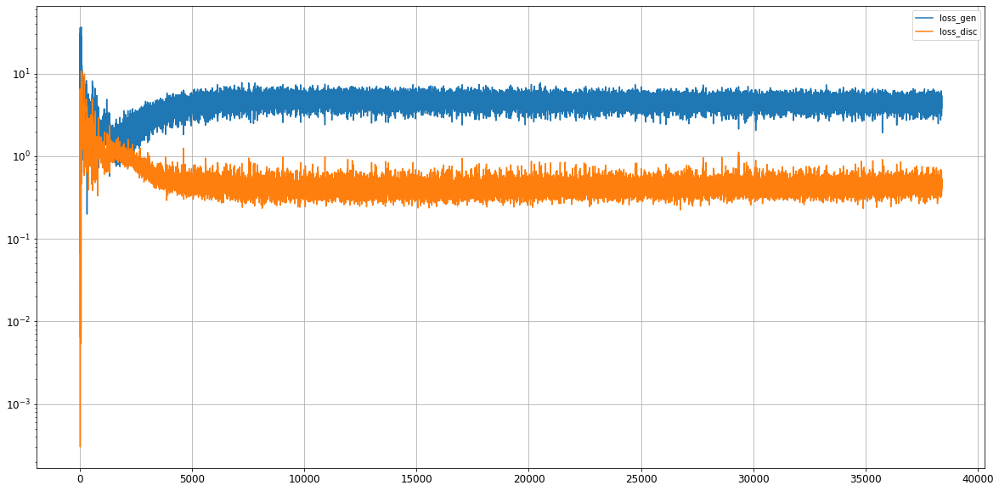

Epoch 38402/50000
0s
Epoch 38403/50000
0s
Epoch 38404/50000
0s
Epoch 38405/50000
0s
Epoch 38406/50000
0s
Epoch 38407/50000
0s
Epoch 38408/50000
0s
Epoch 38409/50000
0s
Epoch 38410/50000
0s
Epoch 38411/50000
0s
Epoch 38412/50000
0s
Epoch 38413/50000
0s
Epoch 38414/50000
0s
Epoch 38415/50000
0s
Epoch 38416/50000
0s
Epoch 38417/50000
0s
Epoch 38418/50000
0s
Epoch 38419/50000
0s
Epoch 38420/50000
0s
Epoch 38421/50000
0s
Epoch 38422/50000
0s
Epoch 38423/50000
0s
Epoch 38424/50000
0s
Epoch 38425/50000
0s
Epoch 38426/50000
0s
Epoch 38427/50000
0s
Epoch 38428/50000
0s
Epoch 38429/50000
0s
Epoch 38430/50000
0s
Epoch 38431/50000
0s
Epoch 38432/50000
0s
Epoch 38433/50000
0s
Epoch 38434/50000
0s
Epoch 38435/50000
0s
Epoch 38436/50000
0s
Epoch 38437/50000
0s
Epoch 38438/50000
0s
Epoch 38439/50000
0s
Epoch 38440/50000
0s
Epoch 38441/50000
0s
Epoch 38442/50000
0s
Epoch 38443/50000
0s
Epoch 38444/50000
0s
Epoch 38445/50000
0s
Epoch 38446/50000
0s
Epoch 38447/50000
0s
Epoch 38448/50000
0s
Epoch 38449/5

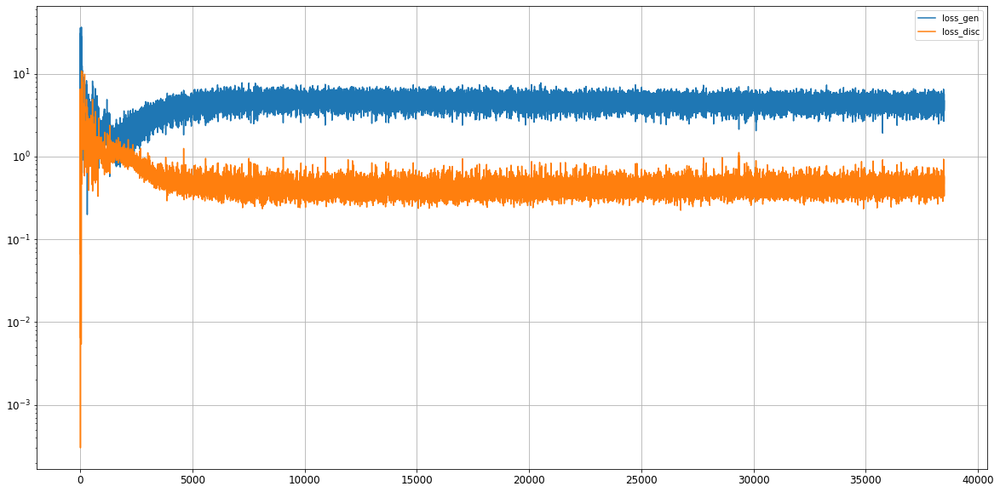

Epoch 38502/50000
0s
Epoch 38503/50000
0s
Epoch 38504/50000
0s
Epoch 38505/50000
0s
Epoch 38506/50000
0s
Epoch 38507/50000
0s
Epoch 38508/50000
0s
Epoch 38509/50000
0s
Epoch 38510/50000
0s
Epoch 38511/50000
0s
Epoch 38512/50000
0s
Epoch 38513/50000
0s
Epoch 38514/50000
0s
Epoch 38515/50000
0s
Epoch 38516/50000
0s
Epoch 38517/50000
0s
Epoch 38518/50000
0s
Epoch 38519/50000
0s
Epoch 38520/50000
0s
Epoch 38521/50000
0s
Epoch 38522/50000
0s
Epoch 38523/50000
0s
Epoch 38524/50000
0s
Epoch 38525/50000
0s
Epoch 38526/50000
0s
Epoch 38527/50000
0s
Epoch 38528/50000
0s
Epoch 38529/50000
0s
Epoch 38530/50000
0s
Epoch 38531/50000
0s
Epoch 38532/50000
0s
Epoch 38533/50000
0s
Epoch 38534/50000
0s
Epoch 38535/50000
0s
Epoch 38536/50000
0s
Epoch 38537/50000
0s
Epoch 38538/50000
0s
Epoch 38539/50000
0s
Epoch 38540/50000
0s
Epoch 38541/50000
0s
Epoch 38542/50000
0s
Epoch 38543/50000
0s
Epoch 38544/50000
0s
Epoch 38545/50000
0s
Epoch 38546/50000
0s
Epoch 38547/50000
0s
Epoch 38548/50000
0s
Epoch 38549/5

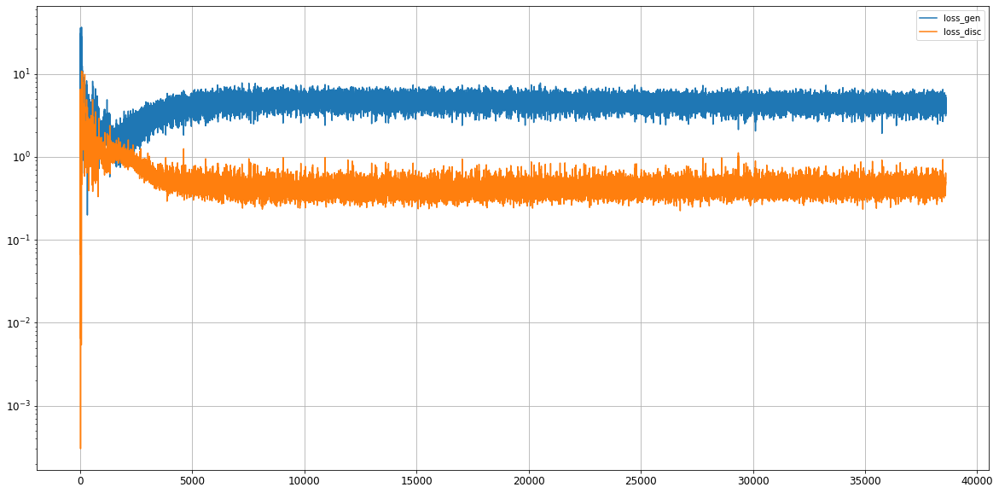

Epoch 38602/50000
0s
Epoch 38603/50000
0s
Epoch 38604/50000
0s
Epoch 38605/50000
0s
Epoch 38606/50000
0s
Epoch 38607/50000
0s
Epoch 38608/50000
0s
Epoch 38609/50000
0s
Epoch 38610/50000
0s
Epoch 38611/50000
0s
Epoch 38612/50000
0s
Epoch 38613/50000
0s
Epoch 38614/50000
0s
Epoch 38615/50000
0s
Epoch 38616/50000
0s
Epoch 38617/50000
0s
Epoch 38618/50000
0s
Epoch 38619/50000
0s
Epoch 38620/50000
0s
Epoch 38621/50000
0s
Epoch 38622/50000
0s
Epoch 38623/50000
0s
Epoch 38624/50000
0s
Epoch 38625/50000
0s
Epoch 38626/50000
0s
Epoch 38627/50000
0s
Epoch 38628/50000
0s
Epoch 38629/50000
0s
Epoch 38630/50000
0s
Epoch 38631/50000
0s
Epoch 38632/50000
0s
Epoch 38633/50000
0s
Epoch 38634/50000
0s
Epoch 38635/50000
0s
Epoch 38636/50000
0s
Epoch 38637/50000
0s
Epoch 38638/50000
0s
Epoch 38639/50000
0s
Epoch 38640/50000
0s
Epoch 38641/50000
0s
Epoch 38642/50000
0s
Epoch 38643/50000
0s
Epoch 38644/50000
0s
Epoch 38645/50000
0s
Epoch 38646/50000
0s
Epoch 38647/50000
0s
Epoch 38648/50000
0s
Epoch 38649/5

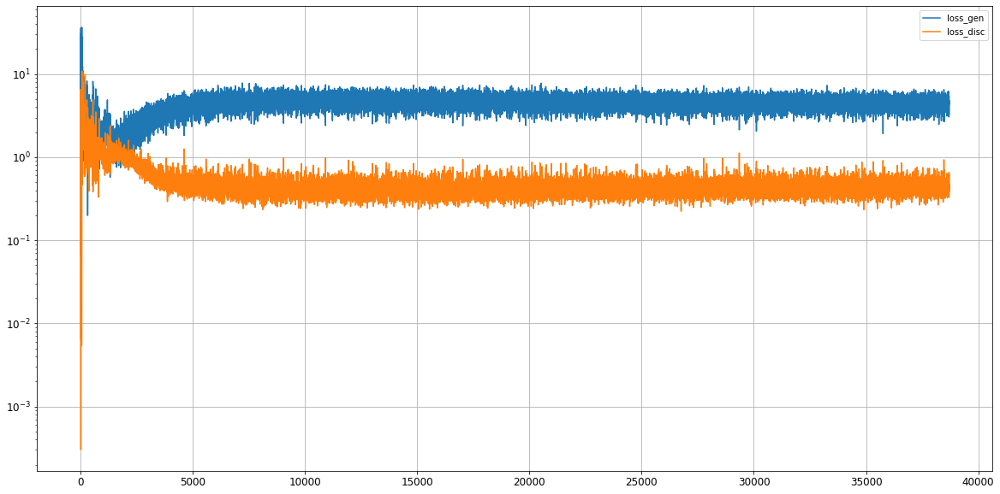

Epoch 38702/50000
0s
Epoch 38703/50000
0s
Epoch 38704/50000
0s
Epoch 38705/50000
0s
Epoch 38706/50000
0s
Epoch 38707/50000
0s
Epoch 38708/50000
0s
Epoch 38709/50000
0s
Epoch 38710/50000
0s
Epoch 38711/50000
0s
Epoch 38712/50000
0s
Epoch 38713/50000
0s
Epoch 38714/50000
0s
Epoch 38715/50000
0s
Epoch 38716/50000
0s
Epoch 38717/50000
0s
Epoch 38718/50000
0s
Epoch 38719/50000
0s
Epoch 38720/50000
0s
Epoch 38721/50000
0s
Epoch 38722/50000
0s
Epoch 38723/50000
0s
Epoch 38724/50000
0s
Epoch 38725/50000
0s
Epoch 38726/50000
0s
Epoch 38727/50000
0s
Epoch 38728/50000
0s
Epoch 38729/50000
0s
Epoch 38730/50000
0s
Epoch 38731/50000
0s
Epoch 38732/50000
0s
Epoch 38733/50000
0s
Epoch 38734/50000
0s
Epoch 38735/50000
0s
Epoch 38736/50000
0s
Epoch 38737/50000
0s
Epoch 38738/50000
0s
Epoch 38739/50000
0s
Epoch 38740/50000
0s
Epoch 38741/50000
0s
Epoch 38742/50000
0s
Epoch 38743/50000
0s
Epoch 38744/50000
0s
Epoch 38745/50000
0s
Epoch 38746/50000
0s
Epoch 38747/50000
0s
Epoch 38748/50000
0s
Epoch 38749/5

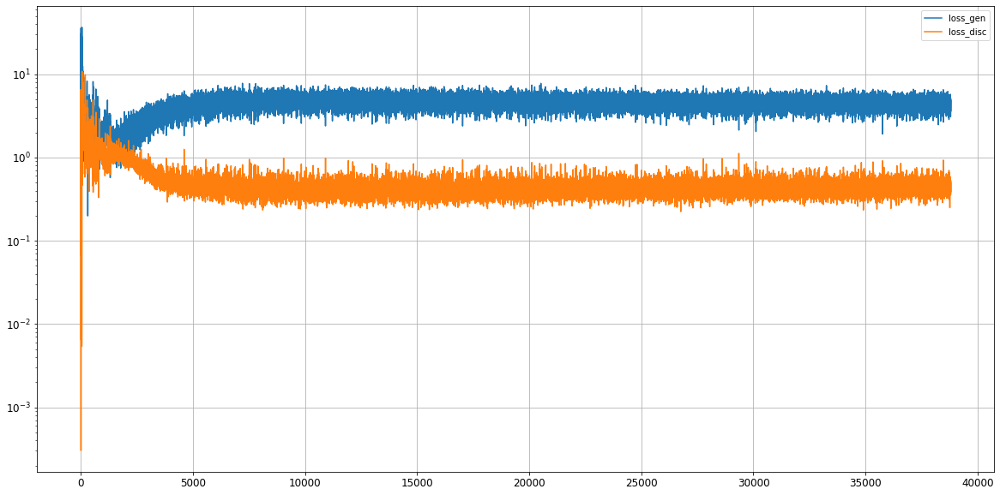

Epoch 38802/50000
0s
Epoch 38803/50000
0s
Epoch 38804/50000
0s
Epoch 38805/50000
0s
Epoch 38806/50000
0s
Epoch 38807/50000
0s
Epoch 38808/50000
0s
Epoch 38809/50000
0s
Epoch 38810/50000
0s
Epoch 38811/50000
0s
Epoch 38812/50000
0s
Epoch 38813/50000
0s
Epoch 38814/50000
0s
Epoch 38815/50000
0s
Epoch 38816/50000
0s
Epoch 38817/50000
0s
Epoch 38818/50000
0s
Epoch 38819/50000
0s
Epoch 38820/50000
0s
Epoch 38821/50000
0s
Epoch 38822/50000
0s
Epoch 38823/50000
0s
Epoch 38824/50000
0s
Epoch 38825/50000
0s
Epoch 38826/50000
0s
Epoch 38827/50000
0s
Epoch 38828/50000
0s
Epoch 38829/50000
0s
Epoch 38830/50000
0s
Epoch 38831/50000
0s
Epoch 38832/50000
0s
Epoch 38833/50000
0s
Epoch 38834/50000
0s
Epoch 38835/50000
0s
Epoch 38836/50000
0s
Epoch 38837/50000
0s
Epoch 38838/50000
0s
Epoch 38839/50000
0s
Epoch 38840/50000
0s
Epoch 38841/50000
0s
Epoch 38842/50000
0s
Epoch 38843/50000
0s
Epoch 38844/50000
0s
Epoch 38845/50000
0s
Epoch 38846/50000
0s
Epoch 38847/50000
0s
Epoch 38848/50000
0s
Epoch 38849/5

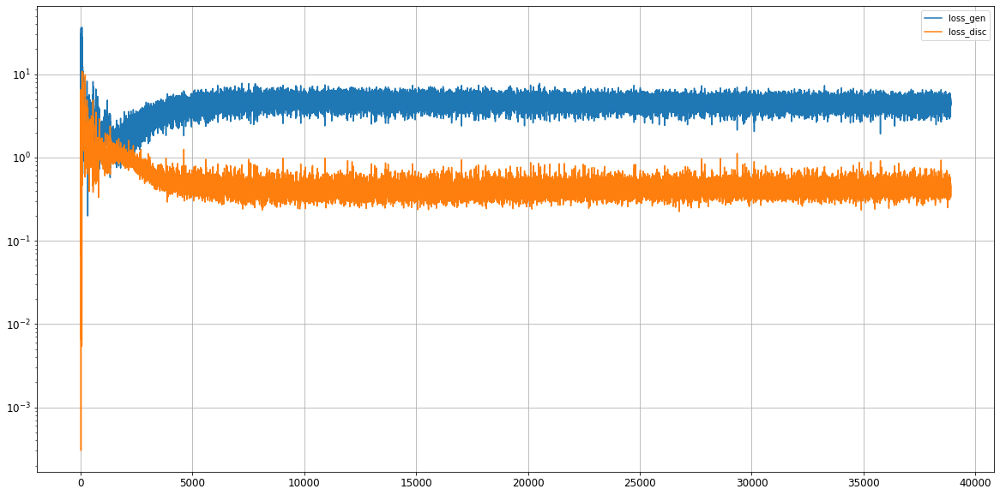

Epoch 38902/50000
0s
Epoch 38903/50000
0s
Epoch 38904/50000
0s
Epoch 38905/50000
0s
Epoch 38906/50000
0s
Epoch 38907/50000
0s
Epoch 38908/50000
0s
Epoch 38909/50000
0s
Epoch 38910/50000
0s
Epoch 38911/50000
0s
Epoch 38912/50000
0s
Epoch 38913/50000
0s
Epoch 38914/50000
0s
Epoch 38915/50000
0s
Epoch 38916/50000
0s
Epoch 38917/50000
0s
Epoch 38918/50000
0s
Epoch 38919/50000
0s
Epoch 38920/50000
0s
Epoch 38921/50000
0s
Epoch 38922/50000
0s
Epoch 38923/50000
0s
Epoch 38924/50000
0s
Epoch 38925/50000
0s
Epoch 38926/50000
0s
Epoch 38927/50000
0s
Epoch 38928/50000
0s
Epoch 38929/50000
0s
Epoch 38930/50000
0s
Epoch 38931/50000
0s
Epoch 38932/50000
0s
Epoch 38933/50000
0s
Epoch 38934/50000
0s
Epoch 38935/50000
0s
Epoch 38936/50000
0s
Epoch 38937/50000
0s
Epoch 38938/50000
0s
Epoch 38939/50000
0s
Epoch 38940/50000
0s
Epoch 38941/50000
0s
Epoch 38942/50000
0s
Epoch 38943/50000
0s
Epoch 38944/50000
0s
Epoch 38945/50000
0s
Epoch 38946/50000
0s
Epoch 38947/50000
0s
Epoch 38948/50000
0s
Epoch 38949/5

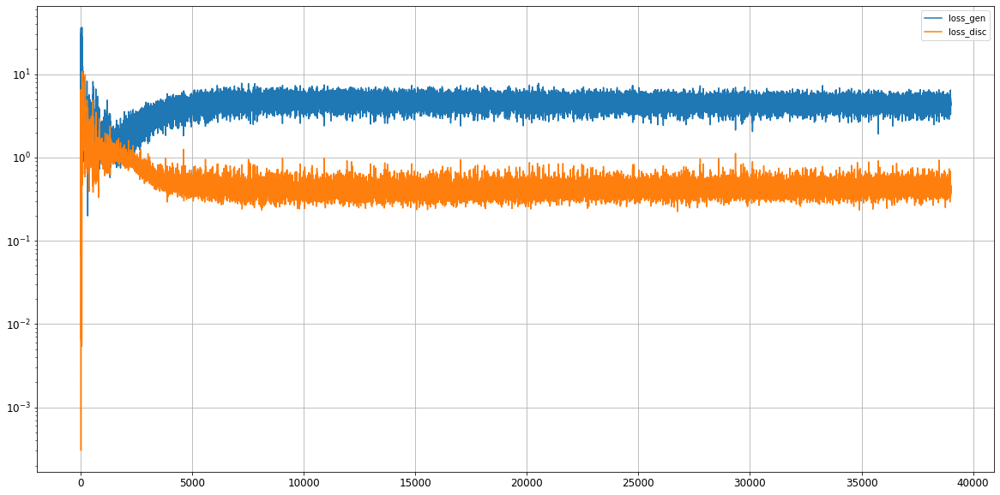

Epoch 39002/50000
0s
Epoch 39003/50000
0s
Epoch 39004/50000
0s
Epoch 39005/50000
0s
Epoch 39006/50000
0s
Epoch 39007/50000
0s
Epoch 39008/50000
0s
Epoch 39009/50000
0s
Epoch 39010/50000
0s
Epoch 39011/50000
0s
Epoch 39012/50000
0s
Epoch 39013/50000
0s
Epoch 39014/50000
0s
Epoch 39015/50000
0s
Epoch 39016/50000
0s
Epoch 39017/50000
0s
Epoch 39018/50000
0s
Epoch 39019/50000
0s
Epoch 39020/50000
0s
Epoch 39021/50000
0s
Epoch 39022/50000
0s
Epoch 39023/50000
0s
Epoch 39024/50000
0s
Epoch 39025/50000
0s
Epoch 39026/50000
0s
Epoch 39027/50000
0s
Epoch 39028/50000
0s
Epoch 39029/50000
0s
Epoch 39030/50000
0s
Epoch 39031/50000
0s
Epoch 39032/50000
0s
Epoch 39033/50000
0s
Epoch 39034/50000
0s
Epoch 39035/50000
0s
Epoch 39036/50000
0s
Epoch 39037/50000
0s
Epoch 39038/50000
0s
Epoch 39039/50000
0s
Epoch 39040/50000
0s
Epoch 39041/50000
0s
Epoch 39042/50000
0s
Epoch 39043/50000
0s
Epoch 39044/50000
0s
Epoch 39045/50000
0s
Epoch 39046/50000
0s
Epoch 39047/50000
0s
Epoch 39048/50000
0s
Epoch 39049/5

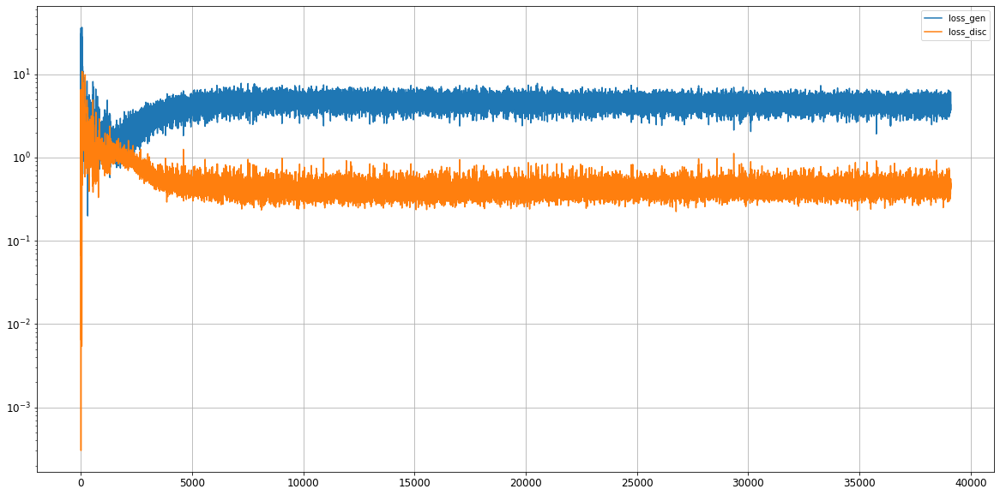

Epoch 39102/50000
0s
Epoch 39103/50000
0s
Epoch 39104/50000
0s
Epoch 39105/50000
0s
Epoch 39106/50000
0s
Epoch 39107/50000
0s
Epoch 39108/50000
0s
Epoch 39109/50000
0s
Epoch 39110/50000
0s
Epoch 39111/50000
0s
Epoch 39112/50000
0s
Epoch 39113/50000
0s
Epoch 39114/50000
0s
Epoch 39115/50000
0s
Epoch 39116/50000
0s
Epoch 39117/50000
0s
Epoch 39118/50000
0s
Epoch 39119/50000
0s
Epoch 39120/50000
0s
Epoch 39121/50000
0s
Epoch 39122/50000
0s
Epoch 39123/50000
0s
Epoch 39124/50000
0s
Epoch 39125/50000
0s
Epoch 39126/50000
0s
Epoch 39127/50000
0s
Epoch 39128/50000
0s
Epoch 39129/50000
0s
Epoch 39130/50000
0s
Epoch 39131/50000
0s
Epoch 39132/50000
0s
Epoch 39133/50000
0s
Epoch 39134/50000
0s
Epoch 39135/50000
0s
Epoch 39136/50000
0s
Epoch 39137/50000
0s
Epoch 39138/50000
0s
Epoch 39139/50000
0s
Epoch 39140/50000
0s
Epoch 39141/50000
0s
Epoch 39142/50000
0s
Epoch 39143/50000
0s
Epoch 39144/50000
0s
Epoch 39145/50000
0s
Epoch 39146/50000
0s
Epoch 39147/50000
0s
Epoch 39148/50000
0s
Epoch 39149/5

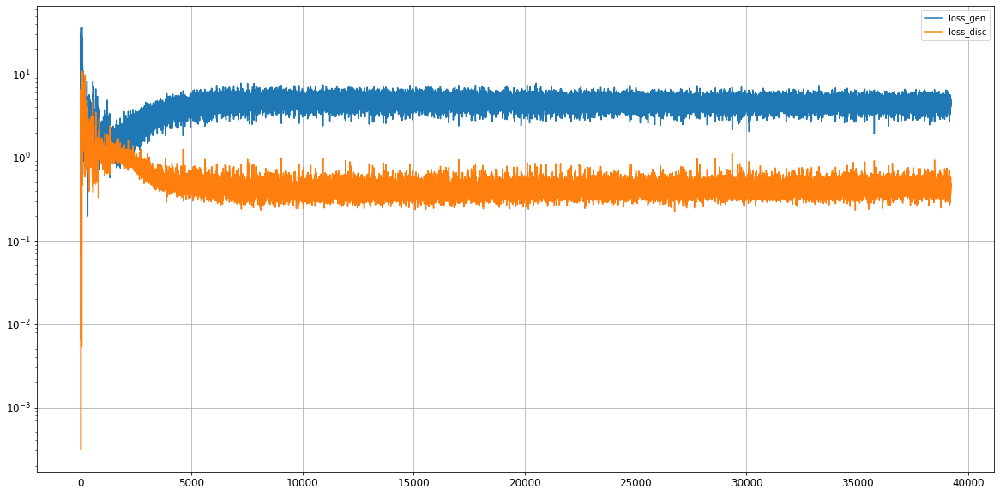

Epoch 39202/50000
0s
Epoch 39203/50000
0s
Epoch 39204/50000
0s
Epoch 39205/50000
0s
Epoch 39206/50000
0s
Epoch 39207/50000
0s
Epoch 39208/50000
0s
Epoch 39209/50000
0s
Epoch 39210/50000
0s
Epoch 39211/50000
0s
Epoch 39212/50000
0s
Epoch 39213/50000
0s
Epoch 39214/50000
0s
Epoch 39215/50000
0s
Epoch 39216/50000
0s
Epoch 39217/50000
0s
Epoch 39218/50000
0s
Epoch 39219/50000
0s
Epoch 39220/50000
0s
Epoch 39221/50000
0s
Epoch 39222/50000
0s
Epoch 39223/50000
0s
Epoch 39224/50000
0s
Epoch 39225/50000
0s
Epoch 39226/50000
0s
Epoch 39227/50000
0s
Epoch 39228/50000
0s
Epoch 39229/50000
0s
Epoch 39230/50000
0s
Epoch 39231/50000
0s
Epoch 39232/50000
0s
Epoch 39233/50000
0s
Epoch 39234/50000
0s
Epoch 39235/50000
0s
Epoch 39236/50000
0s
Epoch 39237/50000
0s
Epoch 39238/50000
0s
Epoch 39239/50000
0s
Epoch 39240/50000
0s
Epoch 39241/50000
0s
Epoch 39242/50000
0s
Epoch 39243/50000
0s
Epoch 39244/50000
0s
Epoch 39245/50000
0s
Epoch 39246/50000
0s
Epoch 39247/50000
0s
Epoch 39248/50000
0s
Epoch 39249/5

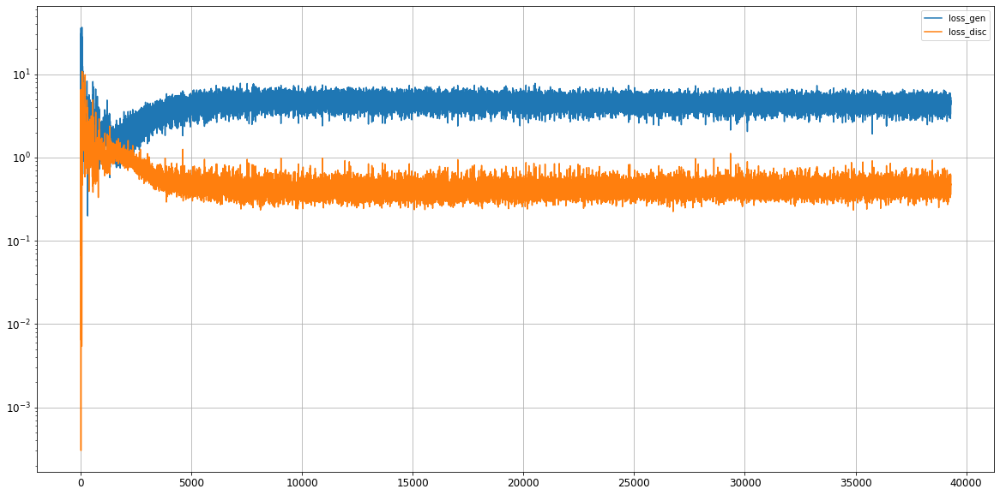

Epoch 39302/50000
0s
Epoch 39303/50000
0s
Epoch 39304/50000
0s
Epoch 39305/50000
0s
Epoch 39306/50000
0s
Epoch 39307/50000
0s
Epoch 39308/50000
0s
Epoch 39309/50000
0s
Epoch 39310/50000
0s
Epoch 39311/50000
0s
Epoch 39312/50000
0s
Epoch 39313/50000
0s
Epoch 39314/50000
0s
Epoch 39315/50000
0s
Epoch 39316/50000
0s
Epoch 39317/50000
0s
Epoch 39318/50000
0s
Epoch 39319/50000
0s
Epoch 39320/50000
0s
Epoch 39321/50000
0s
Epoch 39322/50000
0s
Epoch 39323/50000
0s
Epoch 39324/50000
0s
Epoch 39325/50000
0s
Epoch 39326/50000
0s
Epoch 39327/50000
0s
Epoch 39328/50000
0s
Epoch 39329/50000
0s
Epoch 39330/50000
0s
Epoch 39331/50000
0s
Epoch 39332/50000
0s
Epoch 39333/50000
0s
Epoch 39334/50000
0s
Epoch 39335/50000
0s
Epoch 39336/50000
0s
Epoch 39337/50000
0s
Epoch 39338/50000
0s
Epoch 39339/50000
0s
Epoch 39340/50000
0s
Epoch 39341/50000
0s
Epoch 39342/50000
0s
Epoch 39343/50000
0s
Epoch 39344/50000
0s
Epoch 39345/50000
0s
Epoch 39346/50000
0s
Epoch 39347/50000
0s
Epoch 39348/50000
0s
Epoch 39349/5

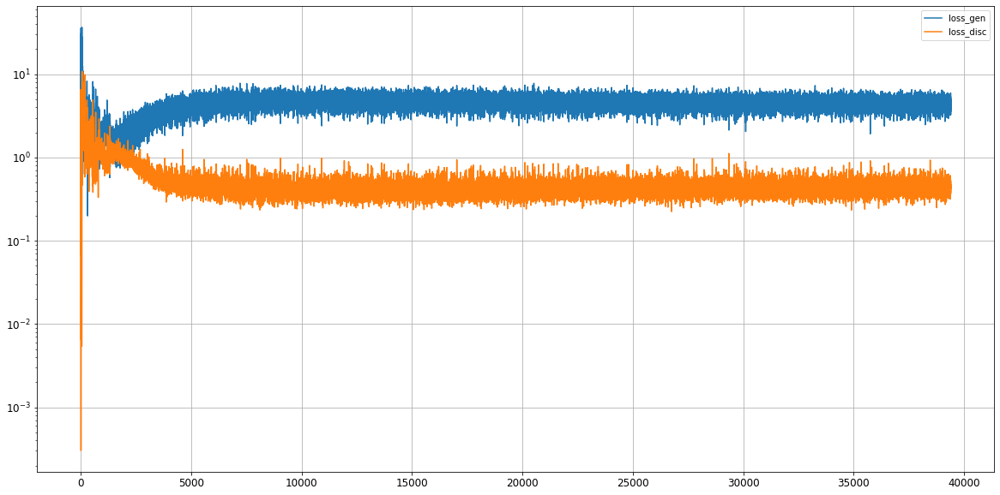

Epoch 39402/50000
0s
Epoch 39403/50000
0s
Epoch 39404/50000
0s
Epoch 39405/50000
0s
Epoch 39406/50000
0s
Epoch 39407/50000
0s
Epoch 39408/50000
0s
Epoch 39409/50000
0s
Epoch 39410/50000
0s
Epoch 39411/50000
0s
Epoch 39412/50000
0s
Epoch 39413/50000
0s
Epoch 39414/50000
0s
Epoch 39415/50000
0s
Epoch 39416/50000
0s
Epoch 39417/50000
0s
Epoch 39418/50000
0s
Epoch 39419/50000
0s
Epoch 39420/50000
0s
Epoch 39421/50000
0s
Epoch 39422/50000
0s
Epoch 39423/50000
0s
Epoch 39424/50000
0s
Epoch 39425/50000
0s
Epoch 39426/50000
0s
Epoch 39427/50000
0s
Epoch 39428/50000
0s
Epoch 39429/50000
0s
Epoch 39430/50000
0s
Epoch 39431/50000
0s
Epoch 39432/50000
0s
Epoch 39433/50000
0s
Epoch 39434/50000
0s
Epoch 39435/50000
0s
Epoch 39436/50000
0s
Epoch 39437/50000
0s
Epoch 39438/50000
0s
Epoch 39439/50000
0s
Epoch 39440/50000
0s
Epoch 39441/50000
0s
Epoch 39442/50000
0s
Epoch 39443/50000
0s
Epoch 39444/50000
0s
Epoch 39445/50000
0s
Epoch 39446/50000
0s
Epoch 39447/50000
0s
Epoch 39448/50000
0s
Epoch 39449/5

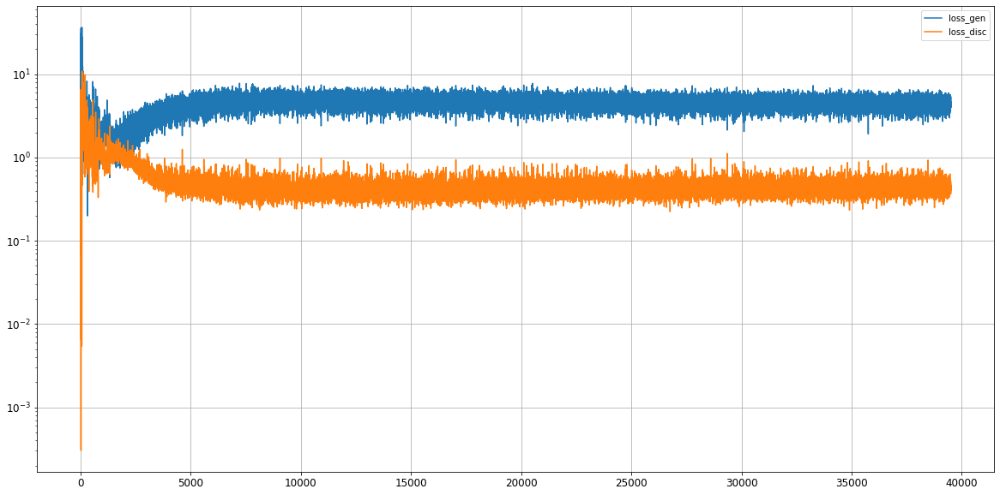

Epoch 39502/50000
0s
Epoch 39503/50000
0s
Epoch 39504/50000
0s
Epoch 39505/50000
0s
Epoch 39506/50000
0s
Epoch 39507/50000
0s
Epoch 39508/50000
0s
Epoch 39509/50000
0s
Epoch 39510/50000
0s
Epoch 39511/50000
0s
Epoch 39512/50000
0s
Epoch 39513/50000
0s
Epoch 39514/50000
0s
Epoch 39515/50000
0s
Epoch 39516/50000
0s
Epoch 39517/50000
0s
Epoch 39518/50000
0s
Epoch 39519/50000
0s
Epoch 39520/50000
0s
Epoch 39521/50000
0s
Epoch 39522/50000
0s
Epoch 39523/50000
0s
Epoch 39524/50000
0s
Epoch 39525/50000
0s
Epoch 39526/50000
0s
Epoch 39527/50000
0s
Epoch 39528/50000
0s
Epoch 39529/50000
0s
Epoch 39530/50000
0s
Epoch 39531/50000
0s
Epoch 39532/50000
0s
Epoch 39533/50000
0s
Epoch 39534/50000
0s
Epoch 39535/50000
0s
Epoch 39536/50000
0s
Epoch 39537/50000
0s
Epoch 39538/50000
0s
Epoch 39539/50000
0s
Epoch 39540/50000
0s
Epoch 39541/50000
0s
Epoch 39542/50000
0s
Epoch 39543/50000
0s
Epoch 39544/50000
0s
Epoch 39545/50000
0s
Epoch 39546/50000
0s
Epoch 39547/50000
0s
Epoch 39548/50000
0s
Epoch 39549/5

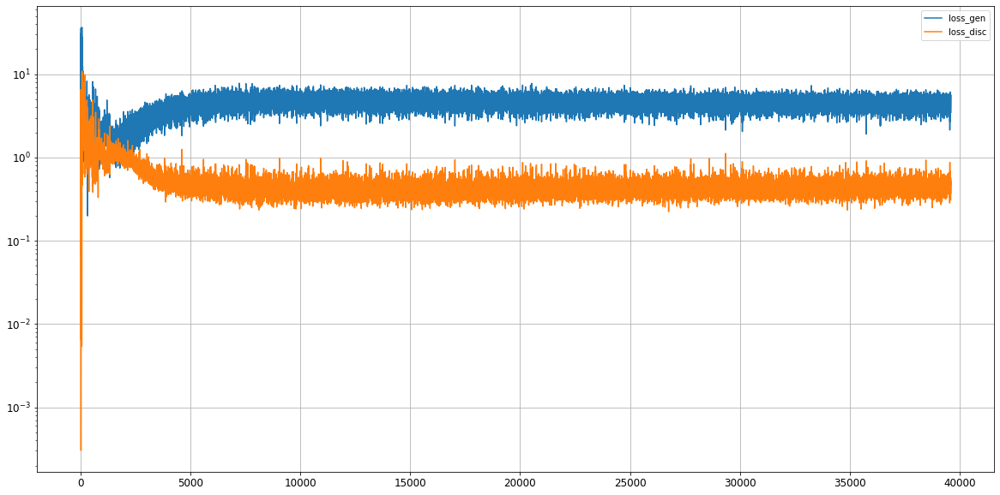

Epoch 39602/50000
0s
Epoch 39603/50000
0s
Epoch 39604/50000
0s
Epoch 39605/50000
0s
Epoch 39606/50000
0s
Epoch 39607/50000
0s
Epoch 39608/50000
0s
Epoch 39609/50000
0s
Epoch 39610/50000
0s
Epoch 39611/50000
0s
Epoch 39612/50000
0s
Epoch 39613/50000
0s
Epoch 39614/50000
0s
Epoch 39615/50000
0s
Epoch 39616/50000
0s
Epoch 39617/50000
0s
Epoch 39618/50000
0s
Epoch 39619/50000
0s
Epoch 39620/50000
0s
Epoch 39621/50000
0s
Epoch 39622/50000
0s
Epoch 39623/50000
0s
Epoch 39624/50000
0s
Epoch 39625/50000
0s
Epoch 39626/50000
0s
Epoch 39627/50000
0s
Epoch 39628/50000
0s
Epoch 39629/50000
0s
Epoch 39630/50000
0s
Epoch 39631/50000
0s
Epoch 39632/50000
0s
Epoch 39633/50000
0s
Epoch 39634/50000
0s
Epoch 39635/50000
0s
Epoch 39636/50000
0s
Epoch 39637/50000
0s
Epoch 39638/50000
0s
Epoch 39639/50000
0s
Epoch 39640/50000
0s
Epoch 39641/50000
0s
Epoch 39642/50000
0s
Epoch 39643/50000
0s
Epoch 39644/50000
0s
Epoch 39645/50000
0s
Epoch 39646/50000
0s
Epoch 39647/50000
0s
Epoch 39648/50000
0s
Epoch 39649/5

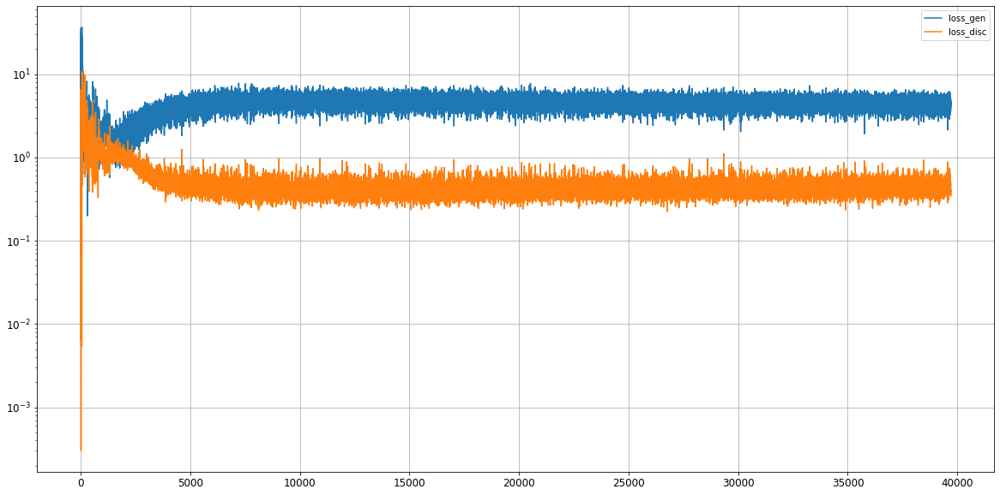

Epoch 39702/50000
0s
Epoch 39703/50000
0s
Epoch 39704/50000
0s
Epoch 39705/50000
0s
Epoch 39706/50000
0s
Epoch 39707/50000
0s
Epoch 39708/50000
0s
Epoch 39709/50000
0s
Epoch 39710/50000
0s
Epoch 39711/50000
0s
Epoch 39712/50000
0s
Epoch 39713/50000
0s
Epoch 39714/50000
0s
Epoch 39715/50000
0s
Epoch 39716/50000
0s
Epoch 39717/50000
0s
Epoch 39718/50000
0s
Epoch 39719/50000
0s
Epoch 39720/50000
0s
Epoch 39721/50000
0s
Epoch 39722/50000
0s
Epoch 39723/50000
0s
Epoch 39724/50000
0s
Epoch 39725/50000
0s
Epoch 39726/50000
0s
Epoch 39727/50000
0s
Epoch 39728/50000
0s
Epoch 39729/50000
0s
Epoch 39730/50000
0s
Epoch 39731/50000
0s
Epoch 39732/50000
0s
Epoch 39733/50000
0s
Epoch 39734/50000
0s
Epoch 39735/50000
0s
Epoch 39736/50000
0s
Epoch 39737/50000
0s
Epoch 39738/50000
0s
Epoch 39739/50000
0s
Epoch 39740/50000
0s
Epoch 39741/50000
0s
Epoch 39742/50000
0s
Epoch 39743/50000
0s
Epoch 39744/50000
0s
Epoch 39745/50000
0s
Epoch 39746/50000
0s
Epoch 39747/50000
0s
Epoch 39748/50000
0s
Epoch 39749/5

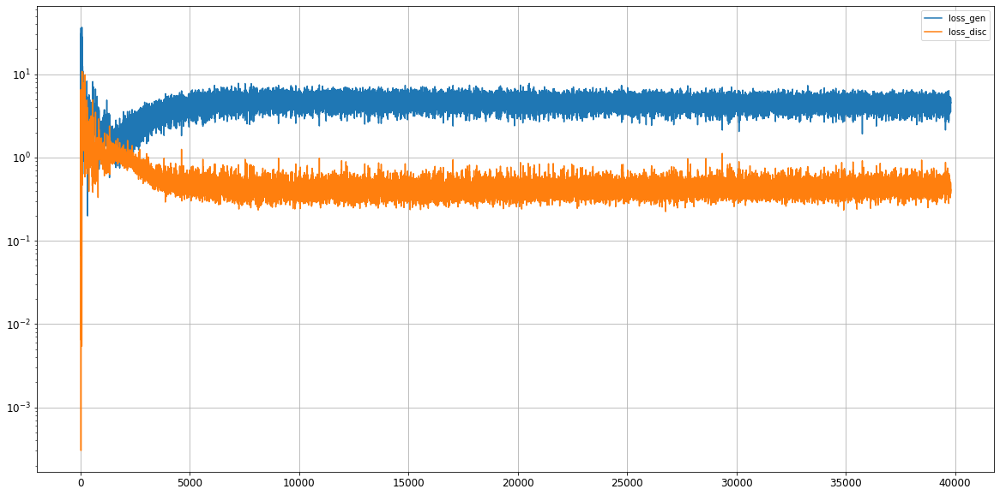

Epoch 39802/50000
0s
Epoch 39803/50000
0s
Epoch 39804/50000
0s
Epoch 39805/50000
0s
Epoch 39806/50000
0s
Epoch 39807/50000
0s
Epoch 39808/50000
0s
Epoch 39809/50000
0s
Epoch 39810/50000
0s
Epoch 39811/50000
0s
Epoch 39812/50000
0s
Epoch 39813/50000
0s
Epoch 39814/50000
0s
Epoch 39815/50000
0s
Epoch 39816/50000
0s
Epoch 39817/50000
0s
Epoch 39818/50000
0s
Epoch 39819/50000
0s
Epoch 39820/50000
0s
Epoch 39821/50000
0s
Epoch 39822/50000
0s
Epoch 39823/50000
0s
Epoch 39824/50000
0s
Epoch 39825/50000
0s
Epoch 39826/50000
0s
Epoch 39827/50000
0s
Epoch 39828/50000
0s
Epoch 39829/50000
0s
Epoch 39830/50000
0s
Epoch 39831/50000
0s
Epoch 39832/50000
0s
Epoch 39833/50000
0s
Epoch 39834/50000
0s
Epoch 39835/50000
0s
Epoch 39836/50000
0s
Epoch 39837/50000
0s
Epoch 39838/50000
0s
Epoch 39839/50000
0s
Epoch 39840/50000
0s
Epoch 39841/50000
0s
Epoch 39842/50000
0s
Epoch 39843/50000
0s
Epoch 39844/50000
0s
Epoch 39845/50000
0s
Epoch 39846/50000
0s
Epoch 39847/50000
0s
Epoch 39848/50000
0s
Epoch 39849/5

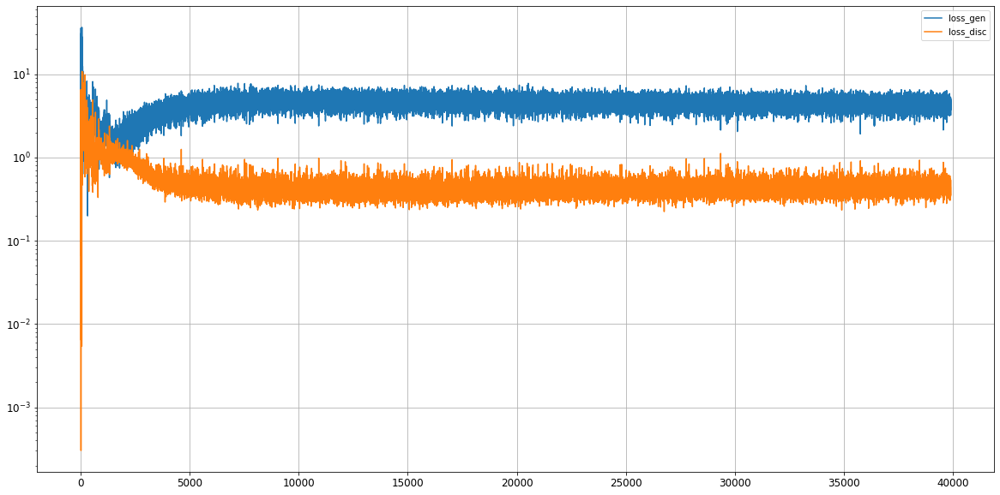

Epoch 39902/50000
0s
Epoch 39903/50000
0s
Epoch 39904/50000
0s
Epoch 39905/50000
0s
Epoch 39906/50000
0s
Epoch 39907/50000
0s
Epoch 39908/50000
0s
Epoch 39909/50000
0s
Epoch 39910/50000
0s
Epoch 39911/50000
0s
Epoch 39912/50000
0s
Epoch 39913/50000
0s
Epoch 39914/50000
0s
Epoch 39915/50000
0s
Epoch 39916/50000
0s
Epoch 39917/50000
0s
Epoch 39918/50000
0s
Epoch 39919/50000
0s
Epoch 39920/50000
0s
Epoch 39921/50000
0s
Epoch 39922/50000
0s
Epoch 39923/50000
0s
Epoch 39924/50000
0s
Epoch 39925/50000
0s
Epoch 39926/50000
0s
Epoch 39927/50000
0s
Epoch 39928/50000
0s
Epoch 39929/50000
0s
Epoch 39930/50000
0s
Epoch 39931/50000
0s
Epoch 39932/50000
0s
Epoch 39933/50000
0s
Epoch 39934/50000
0s
Epoch 39935/50000
0s
Epoch 39936/50000
0s
Epoch 39937/50000
0s
Epoch 39938/50000
0s
Epoch 39939/50000
0s
Epoch 39940/50000
0s
Epoch 39941/50000
0s
Epoch 39942/50000
0s
Epoch 39943/50000
0s
Epoch 39944/50000
0s
Epoch 39945/50000
0s
Epoch 39946/50000
0s
Epoch 39947/50000
0s
Epoch 39948/50000
0s
Epoch 39949/5

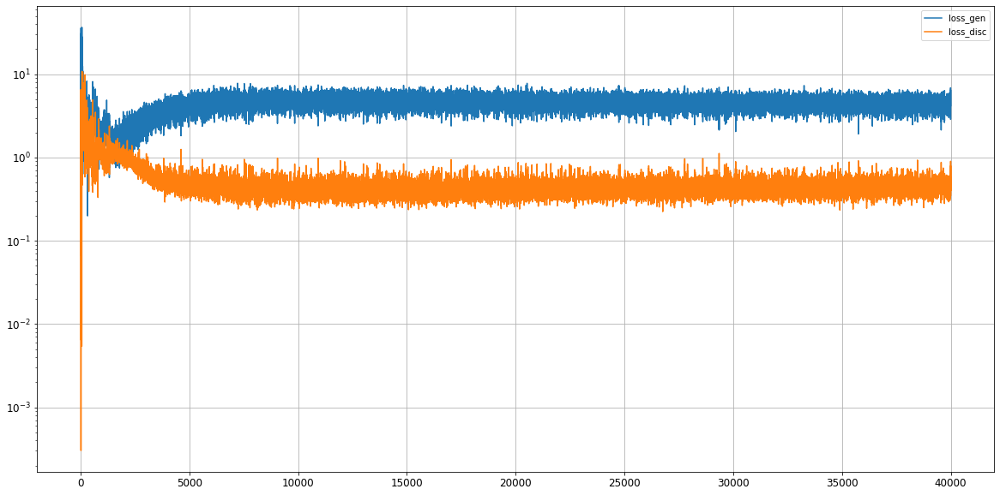

Epoch 40002/50000
0s
Epoch 40003/50000
0s
Epoch 40004/50000
0s
Epoch 40005/50000
0s
Epoch 40006/50000
0s
Epoch 40007/50000
0s
Epoch 40008/50000
0s
Epoch 40009/50000
0s
Epoch 40010/50000
0s
Epoch 40011/50000
0s
Epoch 40012/50000
0s
Epoch 40013/50000
0s
Epoch 40014/50000
0s
Epoch 40015/50000
0s
Epoch 40016/50000
0s
Epoch 40017/50000
0s
Epoch 40018/50000
0s
Epoch 40019/50000
0s
Epoch 40020/50000
0s
Epoch 40021/50000
0s
Epoch 40022/50000
0s
Epoch 40023/50000
0s
Epoch 40024/50000
0s
Epoch 40025/50000
0s
Epoch 40026/50000
0s
Epoch 40027/50000
0s
Epoch 40028/50000
0s
Epoch 40029/50000
0s
Epoch 40030/50000
0s
Epoch 40031/50000
0s
Epoch 40032/50000
0s
Epoch 40033/50000
0s
Epoch 40034/50000
0s
Epoch 40035/50000
0s
Epoch 40036/50000
0s
Epoch 40037/50000
0s
Epoch 40038/50000
0s
Epoch 40039/50000
0s
Epoch 40040/50000
0s
Epoch 40041/50000
0s
Epoch 40042/50000
0s
Epoch 40043/50000
0s
Epoch 40044/50000
0s
Epoch 40045/50000
0s
Epoch 40046/50000
0s
Epoch 40047/50000
0s
Epoch 40048/50000
0s
Epoch 40049/5

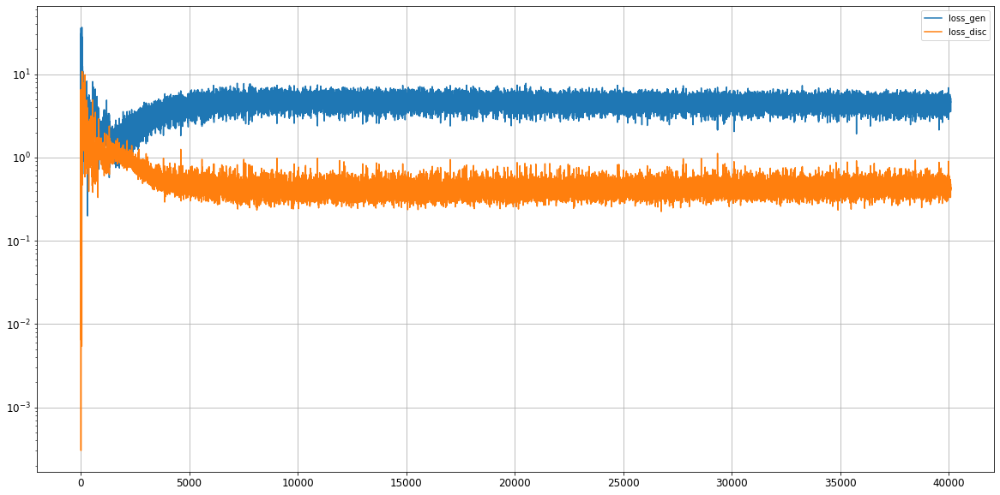

Epoch 40102/50000
0s
Epoch 40103/50000
0s
Epoch 40104/50000
0s
Epoch 40105/50000
0s
Epoch 40106/50000
0s
Epoch 40107/50000
0s
Epoch 40108/50000
0s
Epoch 40109/50000
0s
Epoch 40110/50000
0s
Epoch 40111/50000
0s
Epoch 40112/50000
0s
Epoch 40113/50000
0s
Epoch 40114/50000
0s
Epoch 40115/50000
0s
Epoch 40116/50000
0s
Epoch 40117/50000
0s
Epoch 40118/50000
0s
Epoch 40119/50000
0s
Epoch 40120/50000
0s
Epoch 40121/50000
0s
Epoch 40122/50000
0s
Epoch 40123/50000
0s
Epoch 40124/50000
0s
Epoch 40125/50000
0s
Epoch 40126/50000
0s
Epoch 40127/50000
0s
Epoch 40128/50000
0s
Epoch 40129/50000
0s
Epoch 40130/50000
0s
Epoch 40131/50000
0s
Epoch 40132/50000
0s
Epoch 40133/50000
0s
Epoch 40134/50000
0s
Epoch 40135/50000
0s
Epoch 40136/50000
0s
Epoch 40137/50000
0s
Epoch 40138/50000
0s
Epoch 40139/50000
0s
Epoch 40140/50000
0s
Epoch 40141/50000
0s
Epoch 40142/50000
0s
Epoch 40143/50000
0s
Epoch 40144/50000
0s
Epoch 40145/50000
0s
Epoch 40146/50000
0s
Epoch 40147/50000
0s
Epoch 40148/50000
0s
Epoch 40149/5

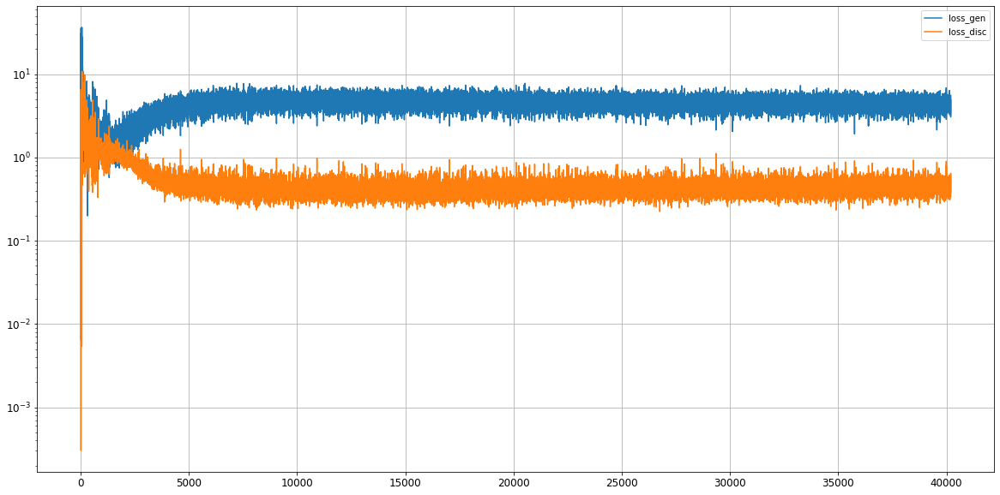

Epoch 40202/50000
0s
Epoch 40203/50000
0s
Epoch 40204/50000
0s
Epoch 40205/50000
0s
Epoch 40206/50000
0s
Epoch 40207/50000
0s
Epoch 40208/50000
0s
Epoch 40209/50000
0s
Epoch 40210/50000
0s
Epoch 40211/50000
0s
Epoch 40212/50000
0s
Epoch 40213/50000
0s
Epoch 40214/50000
0s
Epoch 40215/50000
0s
Epoch 40216/50000
0s
Epoch 40217/50000
0s
Epoch 40218/50000
0s
Epoch 40219/50000
0s
Epoch 40220/50000
0s
Epoch 40221/50000
0s
Epoch 40222/50000
0s
Epoch 40223/50000
0s
Epoch 40224/50000
0s
Epoch 40225/50000
0s
Epoch 40226/50000
0s
Epoch 40227/50000
0s
Epoch 40228/50000
0s
Epoch 40229/50000
0s
Epoch 40230/50000
0s
Epoch 40231/50000
0s
Epoch 40232/50000
0s
Epoch 40233/50000
0s
Epoch 40234/50000
0s
Epoch 40235/50000
0s
Epoch 40236/50000
0s
Epoch 40237/50000
0s
Epoch 40238/50000
0s
Epoch 40239/50000
0s
Epoch 40240/50000
0s
Epoch 40241/50000
0s
Epoch 40242/50000
0s
Epoch 40243/50000
0s
Epoch 40244/50000
0s
Epoch 40245/50000
0s
Epoch 40246/50000
0s
Epoch 40247/50000
0s
Epoch 40248/50000
0s
Epoch 40249/5

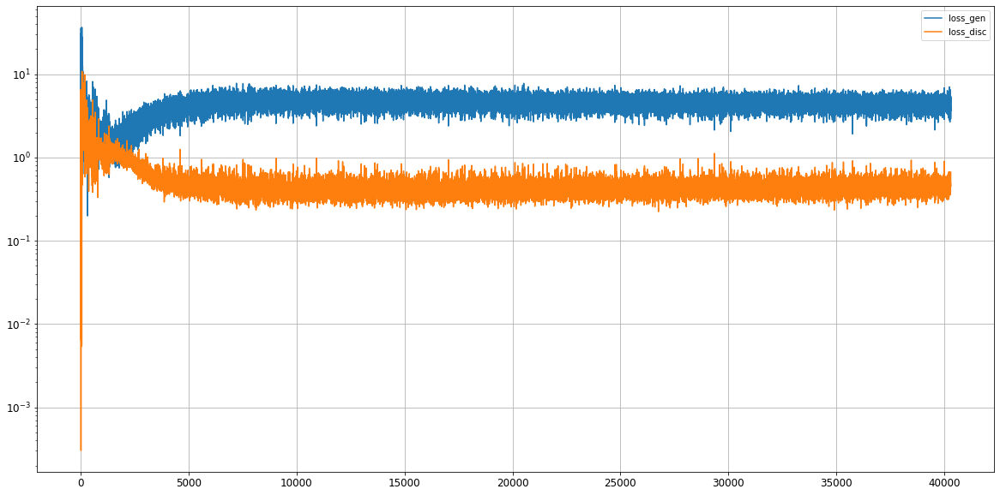

Epoch 40302/50000
0s
Epoch 40303/50000
0s
Epoch 40304/50000
0s
Epoch 40305/50000
0s
Epoch 40306/50000
0s
Epoch 40307/50000
0s
Epoch 40308/50000
0s
Epoch 40309/50000
0s
Epoch 40310/50000
0s
Epoch 40311/50000
0s
Epoch 40312/50000
0s
Epoch 40313/50000
0s
Epoch 40314/50000
0s
Epoch 40315/50000
0s
Epoch 40316/50000
0s
Epoch 40317/50000
0s
Epoch 40318/50000
0s
Epoch 40319/50000
0s
Epoch 40320/50000
0s
Epoch 40321/50000
0s
Epoch 40322/50000
0s
Epoch 40323/50000
0s
Epoch 40324/50000
0s
Epoch 40325/50000
0s
Epoch 40326/50000
0s
Epoch 40327/50000
0s
Epoch 40328/50000
0s
Epoch 40329/50000
0s
Epoch 40330/50000
0s
Epoch 40331/50000
0s
Epoch 40332/50000
0s
Epoch 40333/50000
0s
Epoch 40334/50000
0s
Epoch 40335/50000
0s
Epoch 40336/50000
0s
Epoch 40337/50000
0s
Epoch 40338/50000
0s
Epoch 40339/50000
0s
Epoch 40340/50000
0s
Epoch 40341/50000
0s
Epoch 40342/50000
0s
Epoch 40343/50000
0s
Epoch 40344/50000
0s
Epoch 40345/50000
0s
Epoch 40346/50000
0s
Epoch 40347/50000
0s
Epoch 40348/50000
0s
Epoch 40349/5

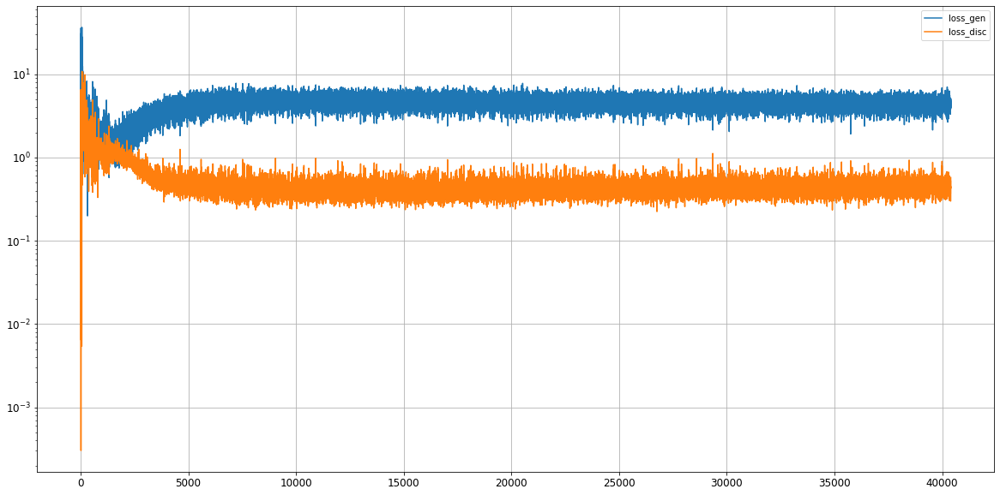

Epoch 40402/50000
0s
Epoch 40403/50000
0s
Epoch 40404/50000
0s
Epoch 40405/50000
0s
Epoch 40406/50000
0s
Epoch 40407/50000
0s
Epoch 40408/50000
0s
Epoch 40409/50000
0s
Epoch 40410/50000
0s
Epoch 40411/50000
0s
Epoch 40412/50000
0s
Epoch 40413/50000
0s
Epoch 40414/50000
0s
Epoch 40415/50000
0s
Epoch 40416/50000
0s
Epoch 40417/50000
0s
Epoch 40418/50000
0s
Epoch 40419/50000
0s
Epoch 40420/50000
0s
Epoch 40421/50000
0s
Epoch 40422/50000
0s
Epoch 40423/50000
0s
Epoch 40424/50000
0s
Epoch 40425/50000
0s
Epoch 40426/50000
0s
Epoch 40427/50000
0s
Epoch 40428/50000
0s
Epoch 40429/50000
0s
Epoch 40430/50000
0s
Epoch 40431/50000
0s
Epoch 40432/50000
0s
Epoch 40433/50000
0s
Epoch 40434/50000
0s
Epoch 40435/50000
0s
Epoch 40436/50000
0s
Epoch 40437/50000
0s
Epoch 40438/50000
0s
Epoch 40439/50000
0s
Epoch 40440/50000
0s
Epoch 40441/50000
0s
Epoch 40442/50000
0s
Epoch 40443/50000
0s
Epoch 40444/50000
0s
Epoch 40445/50000
0s
Epoch 40446/50000
0s
Epoch 40447/50000
0s
Epoch 40448/50000
0s
Epoch 40449/5

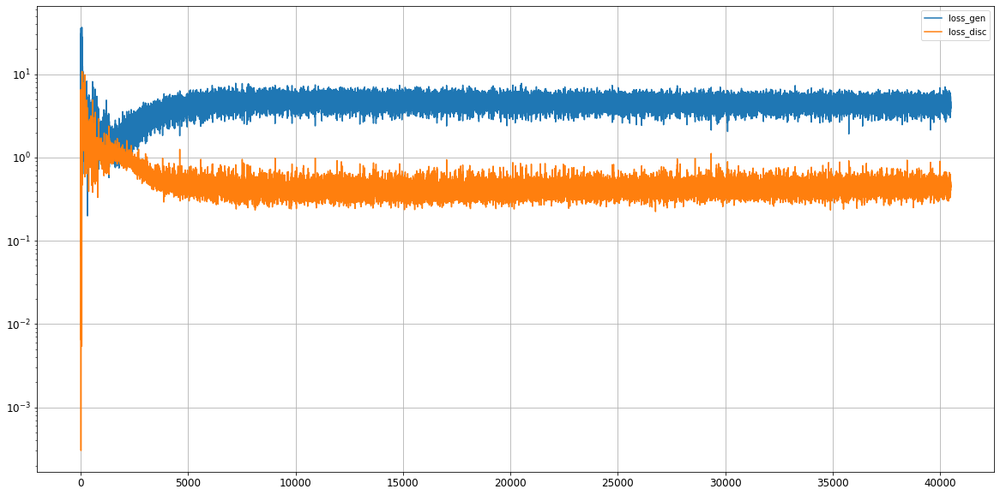

Epoch 40502/50000
0s
Epoch 40503/50000
0s
Epoch 40504/50000
0s
Epoch 40505/50000
0s
Epoch 40506/50000
0s
Epoch 40507/50000
0s
Epoch 40508/50000
0s
Epoch 40509/50000
0s
Epoch 40510/50000
0s
Epoch 40511/50000
0s
Epoch 40512/50000
0s
Epoch 40513/50000
0s
Epoch 40514/50000
0s
Epoch 40515/50000
0s
Epoch 40516/50000
0s
Epoch 40517/50000
0s
Epoch 40518/50000
0s
Epoch 40519/50000
0s
Epoch 40520/50000
0s
Epoch 40521/50000
0s
Epoch 40522/50000
0s
Epoch 40523/50000
0s
Epoch 40524/50000
0s
Epoch 40525/50000
0s
Epoch 40526/50000
0s
Epoch 40527/50000
0s
Epoch 40528/50000
0s
Epoch 40529/50000
0s
Epoch 40530/50000
0s
Epoch 40531/50000
0s
Epoch 40532/50000
0s
Epoch 40533/50000
0s
Epoch 40534/50000
0s
Epoch 40535/50000
0s
Epoch 40536/50000
0s
Epoch 40537/50000
0s
Epoch 40538/50000
0s
Epoch 40539/50000
0s
Epoch 40540/50000
0s
Epoch 40541/50000
0s
Epoch 40542/50000
0s
Epoch 40543/50000
0s
Epoch 40544/50000
0s
Epoch 40545/50000
0s
Epoch 40546/50000
0s
Epoch 40547/50000
0s
Epoch 40548/50000
0s
Epoch 40549/5

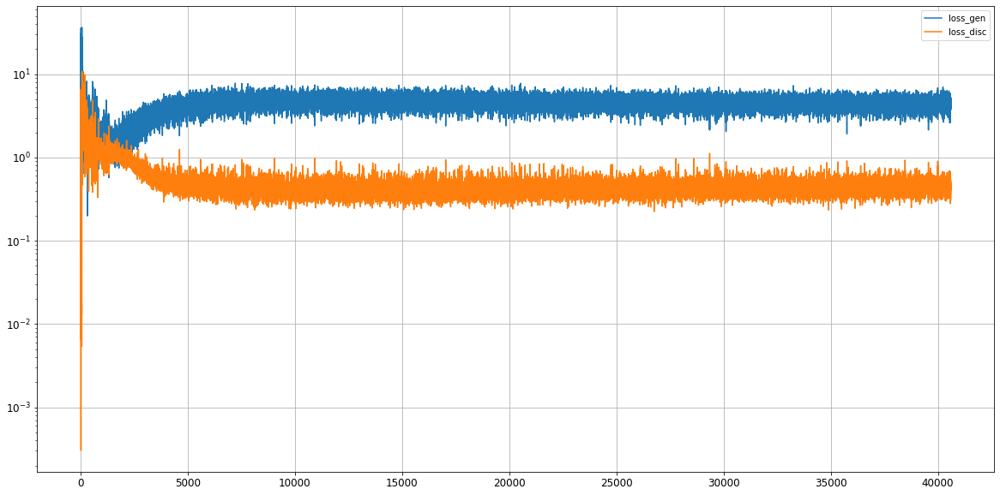

Epoch 40602/50000
0s
Epoch 40603/50000
0s
Epoch 40604/50000
0s
Epoch 40605/50000
0s
Epoch 40606/50000
0s
Epoch 40607/50000
0s
Epoch 40608/50000
0s
Epoch 40609/50000
0s
Epoch 40610/50000
0s
Epoch 40611/50000
0s
Epoch 40612/50000
0s
Epoch 40613/50000
0s
Epoch 40614/50000
0s
Epoch 40615/50000
0s
Epoch 40616/50000
0s
Epoch 40617/50000
0s
Epoch 40618/50000
0s
Epoch 40619/50000
0s
Epoch 40620/50000
0s
Epoch 40621/50000
0s
Epoch 40622/50000
0s
Epoch 40623/50000
0s
Epoch 40624/50000
0s
Epoch 40625/50000
0s
Epoch 40626/50000
0s
Epoch 40627/50000
0s
Epoch 40628/50000
0s
Epoch 40629/50000
0s
Epoch 40630/50000
0s
Epoch 40631/50000
0s
Epoch 40632/50000
0s
Epoch 40633/50000
0s
Epoch 40634/50000
0s
Epoch 40635/50000
0s
Epoch 40636/50000
0s
Epoch 40637/50000
0s
Epoch 40638/50000
0s
Epoch 40639/50000
0s
Epoch 40640/50000
0s
Epoch 40641/50000
0s
Epoch 40642/50000
0s
Epoch 40643/50000
0s
Epoch 40644/50000
0s
Epoch 40645/50000
0s
Epoch 40646/50000
0s
Epoch 40647/50000
0s
Epoch 40648/50000
0s
Epoch 40649/5

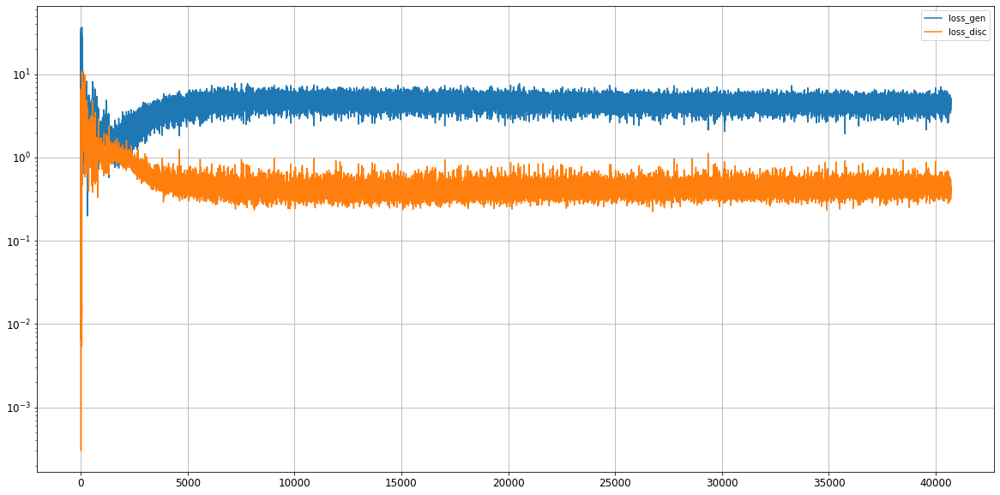

Epoch 40702/50000
0s
Epoch 40703/50000
0s
Epoch 40704/50000
0s
Epoch 40705/50000
0s
Epoch 40706/50000
0s
Epoch 40707/50000
0s
Epoch 40708/50000
0s
Epoch 40709/50000
0s
Epoch 40710/50000
0s
Epoch 40711/50000
0s
Epoch 40712/50000
0s
Epoch 40713/50000
0s
Epoch 40714/50000
0s
Epoch 40715/50000
0s
Epoch 40716/50000
0s
Epoch 40717/50000
0s
Epoch 40718/50000
0s
Epoch 40719/50000
0s
Epoch 40720/50000
0s
Epoch 40721/50000
0s
Epoch 40722/50000
0s
Epoch 40723/50000
0s
Epoch 40724/50000
0s
Epoch 40725/50000
0s
Epoch 40726/50000
0s
Epoch 40727/50000
0s
Epoch 40728/50000
0s
Epoch 40729/50000
0s
Epoch 40730/50000
0s
Epoch 40731/50000
0s
Epoch 40732/50000
0s
Epoch 40733/50000
0s
Epoch 40734/50000
0s
Epoch 40735/50000
0s
Epoch 40736/50000
0s
Epoch 40737/50000
0s
Epoch 40738/50000
0s
Epoch 40739/50000
0s
Epoch 40740/50000
0s
Epoch 40741/50000
0s
Epoch 40742/50000
0s
Epoch 40743/50000
0s
Epoch 40744/50000
0s
Epoch 40745/50000
0s
Epoch 40746/50000
0s
Epoch 40747/50000
0s
Epoch 40748/50000
0s
Epoch 40749/5

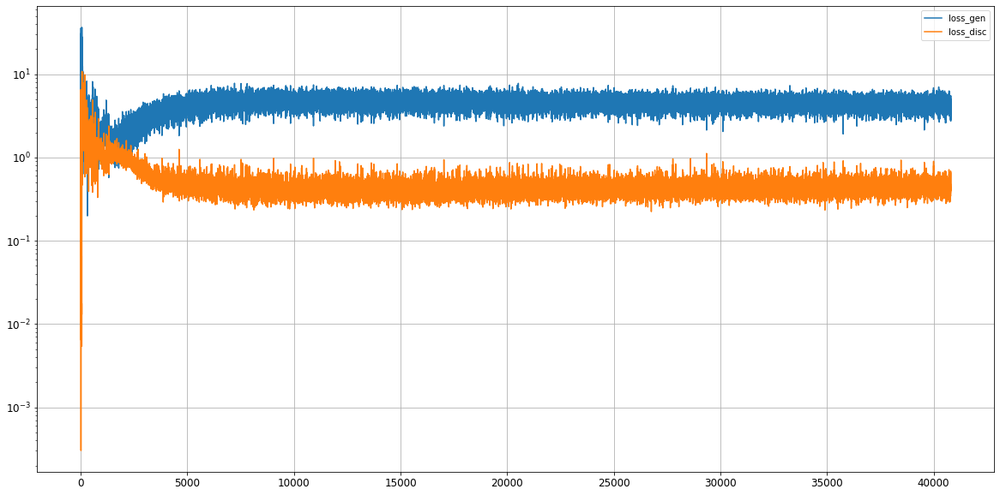

Epoch 40802/50000
0s
Epoch 40803/50000
0s
Epoch 40804/50000
0s
Epoch 40805/50000
0s
Epoch 40806/50000
0s
Epoch 40807/50000
0s
Epoch 40808/50000
0s
Epoch 40809/50000
0s
Epoch 40810/50000
0s
Epoch 40811/50000
0s
Epoch 40812/50000
0s
Epoch 40813/50000
0s
Epoch 40814/50000
0s
Epoch 40815/50000
0s
Epoch 40816/50000
0s
Epoch 40817/50000
0s
Epoch 40818/50000
0s
Epoch 40819/50000
0s
Epoch 40820/50000
0s
Epoch 40821/50000
0s
Epoch 40822/50000
0s
Epoch 40823/50000
0s
Epoch 40824/50000
0s
Epoch 40825/50000
0s
Epoch 40826/50000
0s
Epoch 40827/50000
0s
Epoch 40828/50000
0s
Epoch 40829/50000
0s
Epoch 40830/50000
0s
Epoch 40831/50000
0s
Epoch 40832/50000
0s
Epoch 40833/50000
0s
Epoch 40834/50000
0s
Epoch 40835/50000
0s
Epoch 40836/50000
0s
Epoch 40837/50000
0s
Epoch 40838/50000
0s
Epoch 40839/50000
0s
Epoch 40840/50000
0s
Epoch 40841/50000
0s
Epoch 40842/50000
0s
Epoch 40843/50000
0s
Epoch 40844/50000
0s
Epoch 40845/50000
0s
Epoch 40846/50000
0s
Epoch 40847/50000
0s
Epoch 40848/50000
0s
Epoch 40849/5

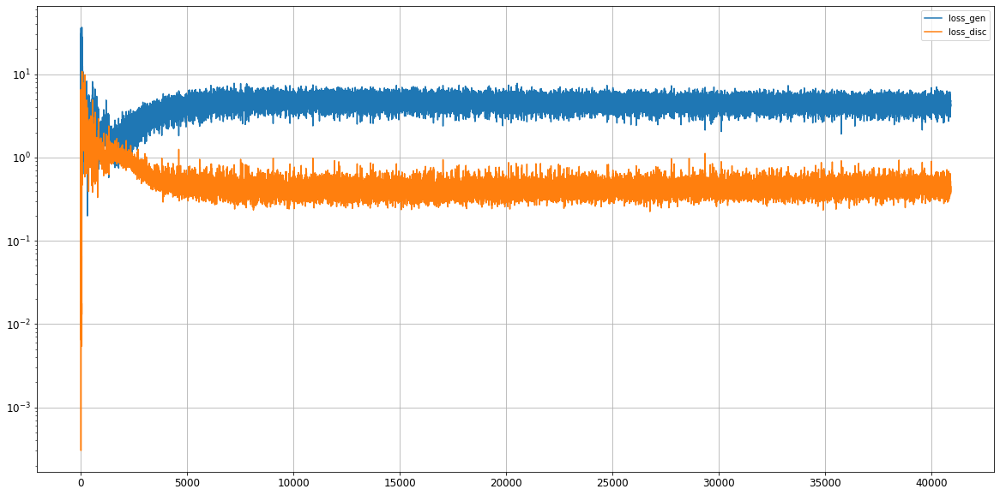

Epoch 40902/50000
0s
Epoch 40903/50000
0s
Epoch 40904/50000
0s
Epoch 40905/50000
0s
Epoch 40906/50000
0s
Epoch 40907/50000
0s
Epoch 40908/50000
0s
Epoch 40909/50000
0s
Epoch 40910/50000
0s
Epoch 40911/50000
0s
Epoch 40912/50000
0s
Epoch 40913/50000
0s
Epoch 40914/50000
0s
Epoch 40915/50000
0s
Epoch 40916/50000
0s
Epoch 40917/50000
0s
Epoch 40918/50000
0s
Epoch 40919/50000
0s
Epoch 40920/50000
0s
Epoch 40921/50000
0s
Epoch 40922/50000
0s
Epoch 40923/50000
0s
Epoch 40924/50000
0s
Epoch 40925/50000
0s
Epoch 40926/50000
0s
Epoch 40927/50000
0s
Epoch 40928/50000
0s
Epoch 40929/50000
0s
Epoch 40930/50000
0s
Epoch 40931/50000
0s
Epoch 40932/50000
0s
Epoch 40933/50000
0s
Epoch 40934/50000
0s
Epoch 40935/50000
0s
Epoch 40936/50000
0s
Epoch 40937/50000
0s
Epoch 40938/50000
0s
Epoch 40939/50000
0s
Epoch 40940/50000
0s
Epoch 40941/50000
0s
Epoch 40942/50000
0s
Epoch 40943/50000
0s
Epoch 40944/50000
0s
Epoch 40945/50000
0s
Epoch 40946/50000
0s
Epoch 40947/50000
0s
Epoch 40948/50000
0s
Epoch 40949/5

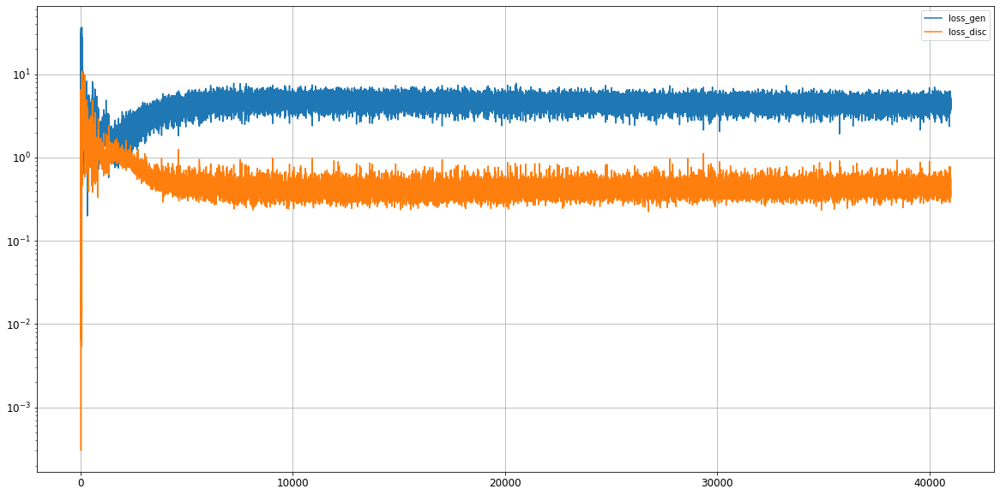

Epoch 41002/50000
0s
Epoch 41003/50000
0s
Epoch 41004/50000
0s
Epoch 41005/50000
0s
Epoch 41006/50000
0s
Epoch 41007/50000
0s
Epoch 41008/50000
0s
Epoch 41009/50000
0s
Epoch 41010/50000
0s
Epoch 41011/50000
0s
Epoch 41012/50000
0s
Epoch 41013/50000
0s
Epoch 41014/50000
0s
Epoch 41015/50000
0s
Epoch 41016/50000
0s
Epoch 41017/50000
0s
Epoch 41018/50000
0s
Epoch 41019/50000
0s
Epoch 41020/50000
0s
Epoch 41021/50000
0s
Epoch 41022/50000
0s
Epoch 41023/50000
0s
Epoch 41024/50000
0s
Epoch 41025/50000
0s
Epoch 41026/50000
0s
Epoch 41027/50000
0s
Epoch 41028/50000
0s
Epoch 41029/50000
0s
Epoch 41030/50000
0s
Epoch 41031/50000
0s
Epoch 41032/50000
0s
Epoch 41033/50000
0s
Epoch 41034/50000
0s
Epoch 41035/50000
0s
Epoch 41036/50000
0s
Epoch 41037/50000
0s
Epoch 41038/50000
0s
Epoch 41039/50000
0s
Epoch 41040/50000
0s
Epoch 41041/50000
0s
Epoch 41042/50000
0s
Epoch 41043/50000
0s
Epoch 41044/50000
0s
Epoch 41045/50000
0s
Epoch 41046/50000
0s
Epoch 41047/50000
0s
Epoch 41048/50000
0s
Epoch 41049/5

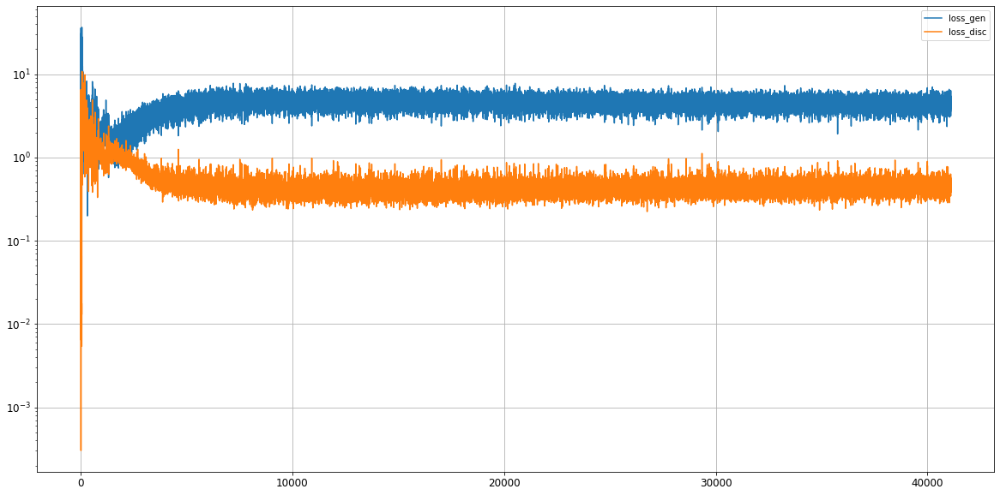

Epoch 41102/50000
0s
Epoch 41103/50000
0s
Epoch 41104/50000
0s
Epoch 41105/50000
0s
Epoch 41106/50000
0s
Epoch 41107/50000
0s
Epoch 41108/50000
0s
Epoch 41109/50000
0s
Epoch 41110/50000
0s
Epoch 41111/50000
0s
Epoch 41112/50000
0s
Epoch 41113/50000
0s
Epoch 41114/50000
0s
Epoch 41115/50000
0s
Epoch 41116/50000
0s
Epoch 41117/50000
0s
Epoch 41118/50000
0s
Epoch 41119/50000
0s
Epoch 41120/50000
0s
Epoch 41121/50000
0s
Epoch 41122/50000
0s
Epoch 41123/50000
0s
Epoch 41124/50000
0s
Epoch 41125/50000
0s
Epoch 41126/50000
0s
Epoch 41127/50000
0s
Epoch 41128/50000
0s
Epoch 41129/50000
0s
Epoch 41130/50000
0s
Epoch 41131/50000
0s
Epoch 41132/50000
0s
Epoch 41133/50000
0s
Epoch 41134/50000
0s
Epoch 41135/50000
0s
Epoch 41136/50000
0s
Epoch 41137/50000
0s
Epoch 41138/50000
0s
Epoch 41139/50000
0s
Epoch 41140/50000
0s
Epoch 41141/50000
0s
Epoch 41142/50000
0s
Epoch 41143/50000
0s
Epoch 41144/50000
0s
Epoch 41145/50000
0s
Epoch 41146/50000
0s
Epoch 41147/50000
0s
Epoch 41148/50000
0s
Epoch 41149/5

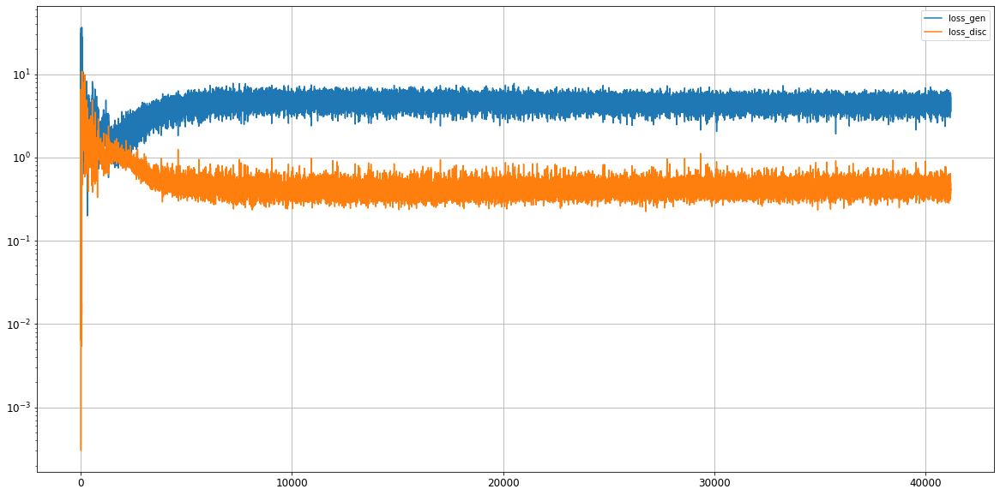

Epoch 41202/50000
0s
Epoch 41203/50000
0s
Epoch 41204/50000
0s
Epoch 41205/50000
0s
Epoch 41206/50000
0s
Epoch 41207/50000
0s
Epoch 41208/50000
0s
Epoch 41209/50000
0s
Epoch 41210/50000
0s
Epoch 41211/50000
0s
Epoch 41212/50000
0s
Epoch 41213/50000
0s
Epoch 41214/50000
0s
Epoch 41215/50000
0s
Epoch 41216/50000
0s
Epoch 41217/50000
0s
Epoch 41218/50000
0s
Epoch 41219/50000
0s
Epoch 41220/50000
0s
Epoch 41221/50000
0s
Epoch 41222/50000
0s
Epoch 41223/50000
0s
Epoch 41224/50000
0s
Epoch 41225/50000
0s
Epoch 41226/50000
0s
Epoch 41227/50000
0s
Epoch 41228/50000
0s
Epoch 41229/50000
0s
Epoch 41230/50000
0s
Epoch 41231/50000
0s
Epoch 41232/50000
0s
Epoch 41233/50000
0s
Epoch 41234/50000
0s
Epoch 41235/50000
0s
Epoch 41236/50000
0s
Epoch 41237/50000
0s
Epoch 41238/50000
0s
Epoch 41239/50000
0s
Epoch 41240/50000
0s
Epoch 41241/50000
0s
Epoch 41242/50000
0s
Epoch 41243/50000
0s
Epoch 41244/50000
0s
Epoch 41245/50000
0s
Epoch 41246/50000
0s
Epoch 41247/50000
0s
Epoch 41248/50000
0s
Epoch 41249/5

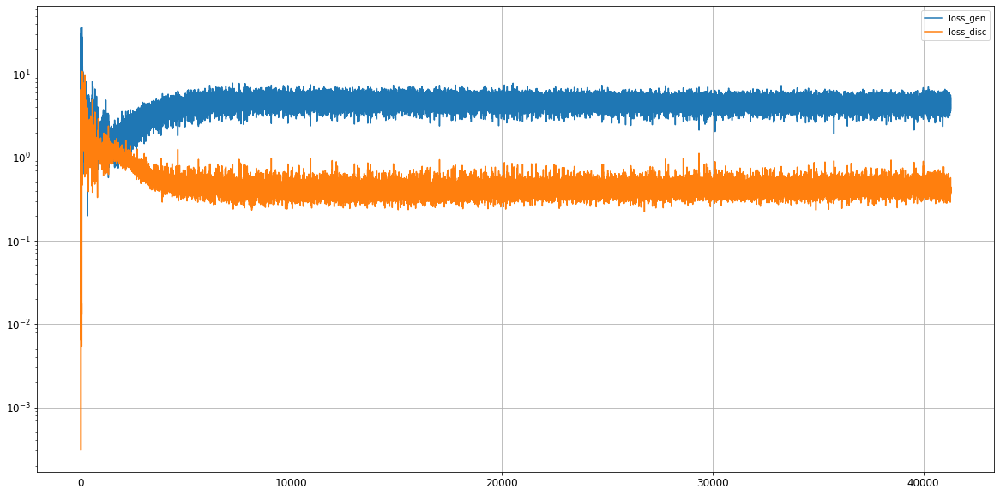

Epoch 41302/50000
0s
Epoch 41303/50000
0s
Epoch 41304/50000
0s
Epoch 41305/50000
0s
Epoch 41306/50000
0s
Epoch 41307/50000
0s
Epoch 41308/50000
0s
Epoch 41309/50000
0s
Epoch 41310/50000
0s
Epoch 41311/50000
0s
Epoch 41312/50000
0s
Epoch 41313/50000
0s
Epoch 41314/50000
0s
Epoch 41315/50000
0s
Epoch 41316/50000
0s
Epoch 41317/50000
0s
Epoch 41318/50000
0s
Epoch 41319/50000
0s
Epoch 41320/50000
0s
Epoch 41321/50000
0s
Epoch 41322/50000
0s
Epoch 41323/50000
0s
Epoch 41324/50000
0s
Epoch 41325/50000
0s
Epoch 41326/50000
0s
Epoch 41327/50000
0s
Epoch 41328/50000
0s
Epoch 41329/50000
0s
Epoch 41330/50000
0s
Epoch 41331/50000
0s
Epoch 41332/50000
0s
Epoch 41333/50000
0s
Epoch 41334/50000
0s
Epoch 41335/50000
0s
Epoch 41336/50000
0s
Epoch 41337/50000
0s
Epoch 41338/50000
0s
Epoch 41339/50000
0s
Epoch 41340/50000
0s
Epoch 41341/50000
0s
Epoch 41342/50000
0s
Epoch 41343/50000
0s
Epoch 41344/50000
0s
Epoch 41345/50000
0s
Epoch 41346/50000
0s
Epoch 41347/50000
0s
Epoch 41348/50000
0s
Epoch 41349/5

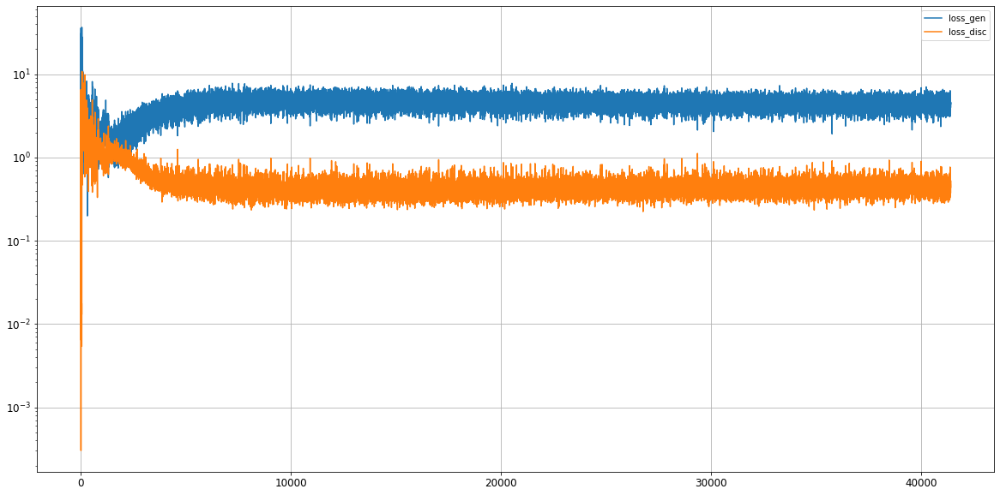

Epoch 41402/50000
0s
Epoch 41403/50000
0s
Epoch 41404/50000
0s
Epoch 41405/50000
0s
Epoch 41406/50000
0s
Epoch 41407/50000
0s
Epoch 41408/50000
0s
Epoch 41409/50000
0s
Epoch 41410/50000
0s
Epoch 41411/50000
0s
Epoch 41412/50000
0s
Epoch 41413/50000
0s
Epoch 41414/50000
0s
Epoch 41415/50000
0s
Epoch 41416/50000
0s
Epoch 41417/50000
0s
Epoch 41418/50000
0s
Epoch 41419/50000
0s
Epoch 41420/50000
0s
Epoch 41421/50000
0s
Epoch 41422/50000
0s
Epoch 41423/50000
0s
Epoch 41424/50000
0s
Epoch 41425/50000
0s
Epoch 41426/50000
0s
Epoch 41427/50000
0s
Epoch 41428/50000
0s
Epoch 41429/50000
0s
Epoch 41430/50000
0s
Epoch 41431/50000
0s
Epoch 41432/50000
0s
Epoch 41433/50000
0s
Epoch 41434/50000
0s
Epoch 41435/50000
0s
Epoch 41436/50000
0s
Epoch 41437/50000
0s
Epoch 41438/50000
0s
Epoch 41439/50000
0s
Epoch 41440/50000
0s
Epoch 41441/50000
0s
Epoch 41442/50000
0s
Epoch 41443/50000
0s
Epoch 41444/50000
0s
Epoch 41445/50000
0s
Epoch 41446/50000
0s
Epoch 41447/50000
0s
Epoch 41448/50000
0s
Epoch 41449/5

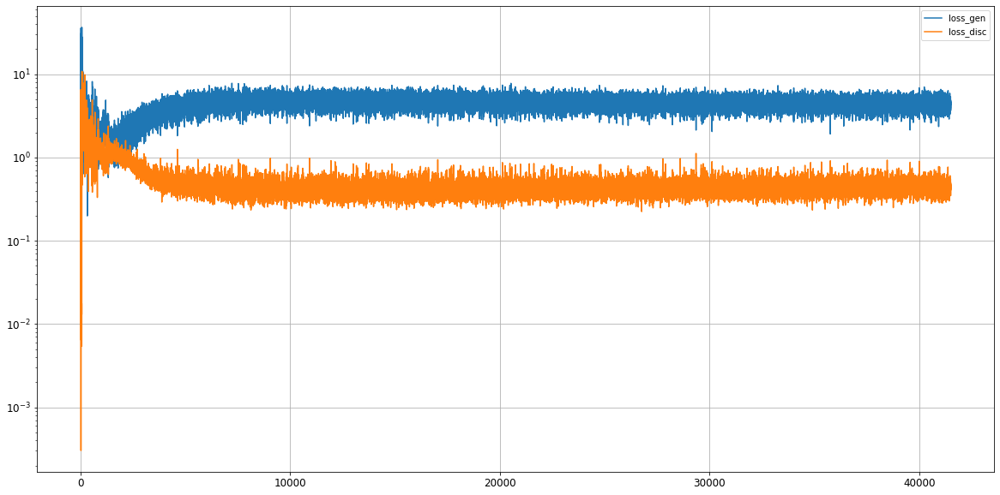

Epoch 41502/50000
0s
Epoch 41503/50000
0s
Epoch 41504/50000
0s
Epoch 41505/50000
0s
Epoch 41506/50000
0s
Epoch 41507/50000
0s
Epoch 41508/50000
0s
Epoch 41509/50000
0s
Epoch 41510/50000
0s
Epoch 41511/50000
0s
Epoch 41512/50000
0s
Epoch 41513/50000
0s
Epoch 41514/50000
0s
Epoch 41515/50000
0s
Epoch 41516/50000
0s
Epoch 41517/50000
0s
Epoch 41518/50000
0s
Epoch 41519/50000
0s
Epoch 41520/50000
0s
Epoch 41521/50000
0s
Epoch 41522/50000
0s
Epoch 41523/50000
0s
Epoch 41524/50000
0s
Epoch 41525/50000
0s
Epoch 41526/50000
0s
Epoch 41527/50000
0s
Epoch 41528/50000
0s
Epoch 41529/50000
0s
Epoch 41530/50000
0s
Epoch 41531/50000
0s
Epoch 41532/50000
0s
Epoch 41533/50000
0s
Epoch 41534/50000
0s
Epoch 41535/50000
0s
Epoch 41536/50000
0s
Epoch 41537/50000
0s
Epoch 41538/50000
0s
Epoch 41539/50000
0s
Epoch 41540/50000
0s
Epoch 41541/50000
0s
Epoch 41542/50000
0s
Epoch 41543/50000
0s
Epoch 41544/50000
0s
Epoch 41545/50000
0s
Epoch 41546/50000
0s
Epoch 41547/50000
0s
Epoch 41548/50000
0s
Epoch 41549/5

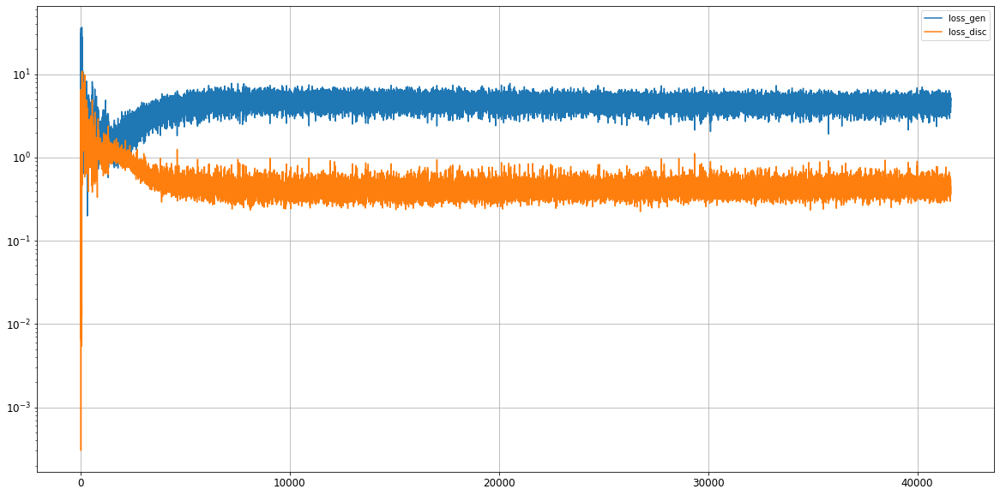

Epoch 41602/50000
0s
Epoch 41603/50000
0s
Epoch 41604/50000
0s
Epoch 41605/50000
0s
Epoch 41606/50000
0s
Epoch 41607/50000
0s
Epoch 41608/50000
0s
Epoch 41609/50000
0s
Epoch 41610/50000
0s
Epoch 41611/50000
0s
Epoch 41612/50000
0s
Epoch 41613/50000
0s
Epoch 41614/50000
0s
Epoch 41615/50000
0s
Epoch 41616/50000
0s
Epoch 41617/50000
0s
Epoch 41618/50000
0s
Epoch 41619/50000
0s
Epoch 41620/50000
0s
Epoch 41621/50000
0s
Epoch 41622/50000
0s
Epoch 41623/50000
0s
Epoch 41624/50000
0s
Epoch 41625/50000
0s
Epoch 41626/50000
0s
Epoch 41627/50000
0s
Epoch 41628/50000
0s
Epoch 41629/50000
0s
Epoch 41630/50000
0s
Epoch 41631/50000
0s
Epoch 41632/50000
0s
Epoch 41633/50000
0s
Epoch 41634/50000
0s
Epoch 41635/50000
0s
Epoch 41636/50000
0s
Epoch 41637/50000
0s
Epoch 41638/50000
0s
Epoch 41639/50000
0s
Epoch 41640/50000
0s
Epoch 41641/50000
0s
Epoch 41642/50000
0s
Epoch 41643/50000
0s
Epoch 41644/50000
0s
Epoch 41645/50000
0s
Epoch 41646/50000
0s
Epoch 41647/50000
0s
Epoch 41648/50000
0s
Epoch 41649/5

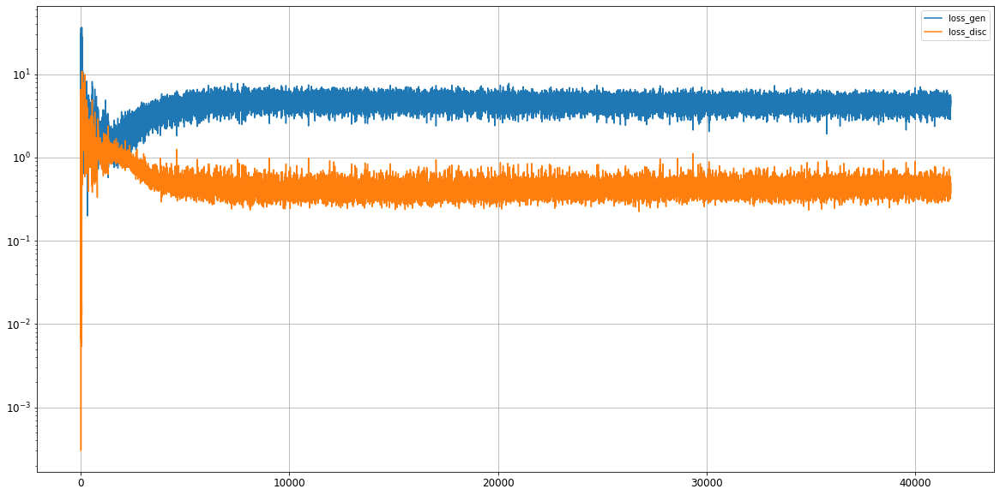

Epoch 41702/50000
0s
Epoch 41703/50000
0s
Epoch 41704/50000
0s
Epoch 41705/50000
0s
Epoch 41706/50000
0s
Epoch 41707/50000
0s
Epoch 41708/50000
0s
Epoch 41709/50000
0s
Epoch 41710/50000
0s
Epoch 41711/50000
0s
Epoch 41712/50000
0s
Epoch 41713/50000
0s
Epoch 41714/50000
0s
Epoch 41715/50000
0s
Epoch 41716/50000
0s
Epoch 41717/50000
0s
Epoch 41718/50000
0s
Epoch 41719/50000
0s
Epoch 41720/50000
0s
Epoch 41721/50000
0s
Epoch 41722/50000
0s
Epoch 41723/50000
0s
Epoch 41724/50000
0s
Epoch 41725/50000
0s
Epoch 41726/50000
0s
Epoch 41727/50000
0s
Epoch 41728/50000
0s
Epoch 41729/50000
0s
Epoch 41730/50000
0s
Epoch 41731/50000
0s
Epoch 41732/50000
0s
Epoch 41733/50000
0s
Epoch 41734/50000
0s
Epoch 41735/50000
0s
Epoch 41736/50000
0s
Epoch 41737/50000
0s
Epoch 41738/50000
0s
Epoch 41739/50000
0s
Epoch 41740/50000
0s
Epoch 41741/50000
0s
Epoch 41742/50000
0s
Epoch 41743/50000
0s
Epoch 41744/50000
0s
Epoch 41745/50000
0s
Epoch 41746/50000
0s
Epoch 41747/50000
0s
Epoch 41748/50000
0s
Epoch 41749/5

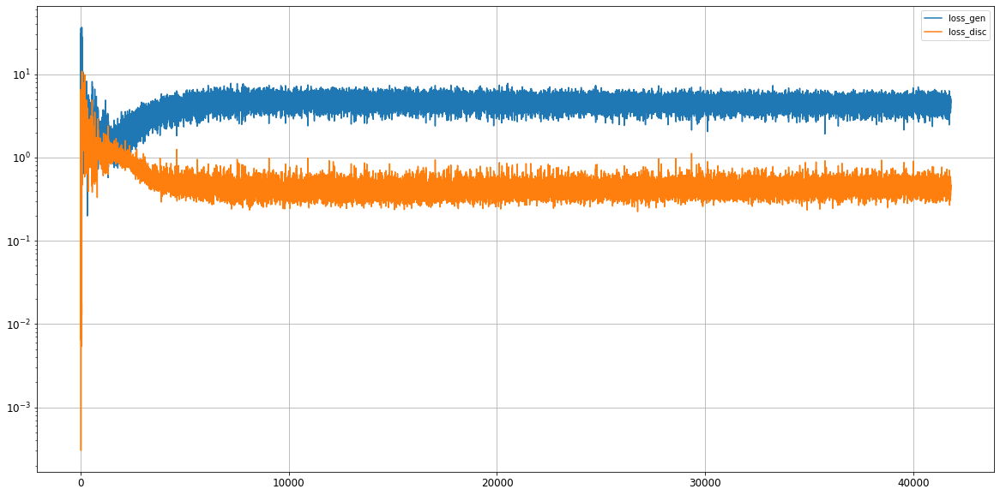

Epoch 41802/50000
0s
Epoch 41803/50000
0s
Epoch 41804/50000
0s
Epoch 41805/50000
0s
Epoch 41806/50000
0s
Epoch 41807/50000
0s
Epoch 41808/50000
0s
Epoch 41809/50000
0s
Epoch 41810/50000
0s
Epoch 41811/50000
0s
Epoch 41812/50000
0s
Epoch 41813/50000
0s
Epoch 41814/50000
0s
Epoch 41815/50000
0s
Epoch 41816/50000
0s
Epoch 41817/50000
0s
Epoch 41818/50000
0s
Epoch 41819/50000
0s
Epoch 41820/50000
0s
Epoch 41821/50000
0s
Epoch 41822/50000
0s
Epoch 41823/50000
0s
Epoch 41824/50000
0s
Epoch 41825/50000
0s
Epoch 41826/50000
0s
Epoch 41827/50000
0s
Epoch 41828/50000
0s
Epoch 41829/50000
0s
Epoch 41830/50000
0s
Epoch 41831/50000
0s
Epoch 41832/50000
0s
Epoch 41833/50000
0s
Epoch 41834/50000
0s
Epoch 41835/50000
0s
Epoch 41836/50000
0s
Epoch 41837/50000
0s
Epoch 41838/50000
0s
Epoch 41839/50000
0s
Epoch 41840/50000
0s
Epoch 41841/50000
0s
Epoch 41842/50000
0s
Epoch 41843/50000
0s
Epoch 41844/50000
0s
Epoch 41845/50000
0s
Epoch 41846/50000
0s
Epoch 41847/50000
0s
Epoch 41848/50000
0s
Epoch 41849/5

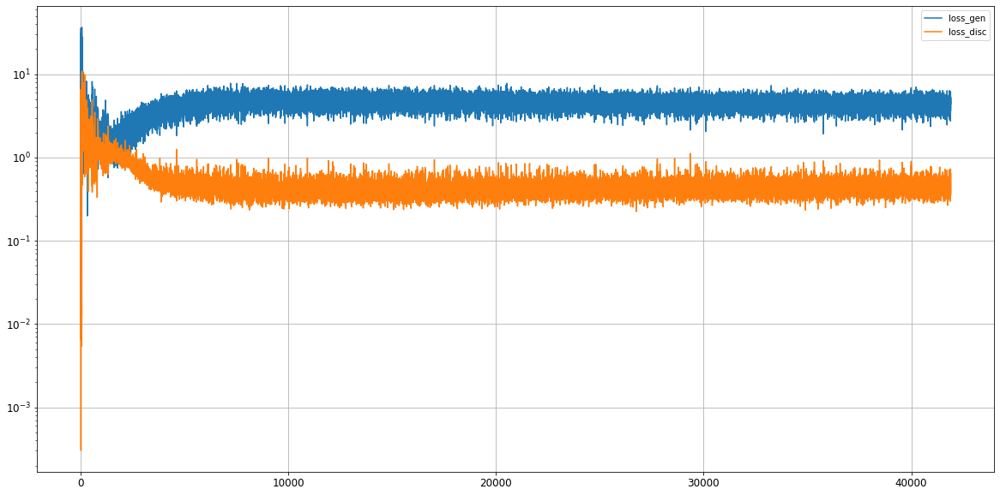

Epoch 41902/50000
0s
Epoch 41903/50000
0s
Epoch 41904/50000
0s
Epoch 41905/50000
0s
Epoch 41906/50000
0s
Epoch 41907/50000
0s
Epoch 41908/50000
0s
Epoch 41909/50000
0s
Epoch 41910/50000
0s
Epoch 41911/50000
0s
Epoch 41912/50000
0s
Epoch 41913/50000
0s
Epoch 41914/50000
0s
Epoch 41915/50000
0s
Epoch 41916/50000
0s
Epoch 41917/50000
0s
Epoch 41918/50000
0s
Epoch 41919/50000
0s
Epoch 41920/50000
0s
Epoch 41921/50000
0s
Epoch 41922/50000
0s
Epoch 41923/50000
0s
Epoch 41924/50000
0s
Epoch 41925/50000
0s
Epoch 41926/50000
0s
Epoch 41927/50000
0s
Epoch 41928/50000
0s
Epoch 41929/50000
0s
Epoch 41930/50000
0s
Epoch 41931/50000
0s
Epoch 41932/50000
0s
Epoch 41933/50000
0s
Epoch 41934/50000
0s
Epoch 41935/50000
0s
Epoch 41936/50000
0s
Epoch 41937/50000
0s
Epoch 41938/50000
0s
Epoch 41939/50000
0s
Epoch 41940/50000
0s
Epoch 41941/50000
0s
Epoch 41942/50000
0s
Epoch 41943/50000
0s
Epoch 41944/50000
0s
Epoch 41945/50000
0s
Epoch 41946/50000
0s
Epoch 41947/50000
0s
Epoch 41948/50000
0s
Epoch 41949/5

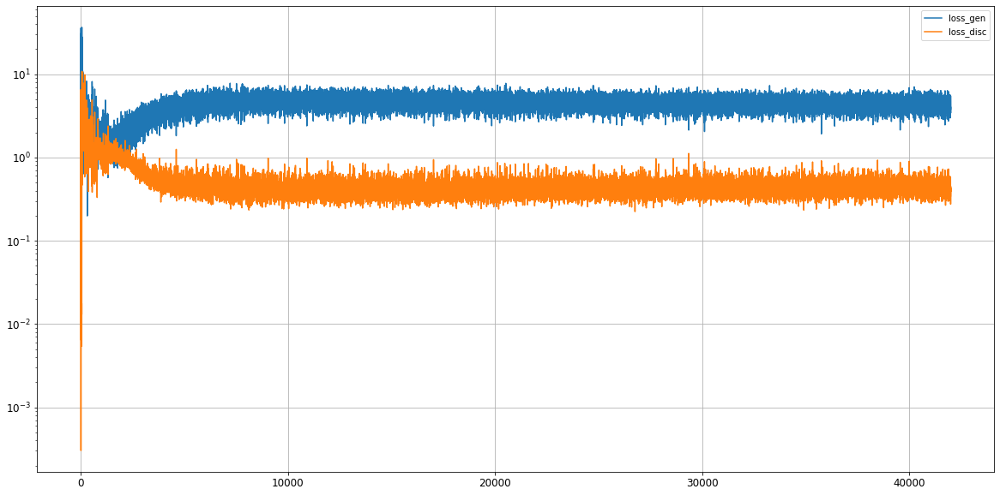

Epoch 42002/50000
0s
Epoch 42003/50000
0s
Epoch 42004/50000
0s
Epoch 42005/50000
0s
Epoch 42006/50000
0s
Epoch 42007/50000
0s
Epoch 42008/50000
0s
Epoch 42009/50000
0s
Epoch 42010/50000
0s
Epoch 42011/50000
0s
Epoch 42012/50000
0s
Epoch 42013/50000
0s
Epoch 42014/50000
0s
Epoch 42015/50000
0s
Epoch 42016/50000
0s
Epoch 42017/50000
0s
Epoch 42018/50000
0s
Epoch 42019/50000
0s
Epoch 42020/50000
0s
Epoch 42021/50000
0s
Epoch 42022/50000
0s
Epoch 42023/50000
0s
Epoch 42024/50000
0s
Epoch 42025/50000
0s
Epoch 42026/50000
0s
Epoch 42027/50000
0s
Epoch 42028/50000
0s
Epoch 42029/50000
0s
Epoch 42030/50000
0s
Epoch 42031/50000
0s
Epoch 42032/50000
0s
Epoch 42033/50000
0s
Epoch 42034/50000
0s
Epoch 42035/50000
0s
Epoch 42036/50000
0s
Epoch 42037/50000
0s
Epoch 42038/50000
0s
Epoch 42039/50000
0s
Epoch 42040/50000
0s
Epoch 42041/50000
0s
Epoch 42042/50000
0s
Epoch 42043/50000
0s
Epoch 42044/50000
0s
Epoch 42045/50000
0s
Epoch 42046/50000
0s
Epoch 42047/50000
0s
Epoch 42048/50000
0s
Epoch 42049/5

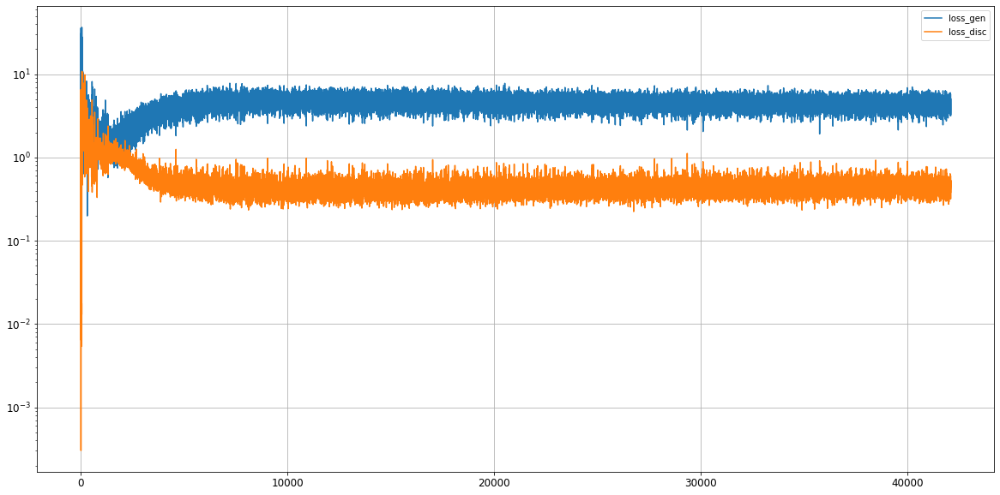

Epoch 42102/50000
0s
Epoch 42103/50000
0s
Epoch 42104/50000
0s
Epoch 42105/50000
0s
Epoch 42106/50000
0s
Epoch 42107/50000
0s
Epoch 42108/50000
0s
Epoch 42109/50000
0s
Epoch 42110/50000
0s
Epoch 42111/50000
0s
Epoch 42112/50000
0s
Epoch 42113/50000
0s
Epoch 42114/50000
0s
Epoch 42115/50000
0s
Epoch 42116/50000
0s
Epoch 42117/50000
0s
Epoch 42118/50000
0s
Epoch 42119/50000
0s
Epoch 42120/50000
0s
Epoch 42121/50000
0s
Epoch 42122/50000
0s
Epoch 42123/50000
0s
Epoch 42124/50000
0s
Epoch 42125/50000
0s
Epoch 42126/50000
0s
Epoch 42127/50000
0s
Epoch 42128/50000
0s
Epoch 42129/50000
0s
Epoch 42130/50000
0s
Epoch 42131/50000
0s
Epoch 42132/50000
0s
Epoch 42133/50000
0s
Epoch 42134/50000
0s
Epoch 42135/50000
0s
Epoch 42136/50000
0s
Epoch 42137/50000
0s
Epoch 42138/50000
0s
Epoch 42139/50000
0s
Epoch 42140/50000
0s
Epoch 42141/50000
0s
Epoch 42142/50000
0s
Epoch 42143/50000
0s
Epoch 42144/50000
0s
Epoch 42145/50000
0s
Epoch 42146/50000
0s
Epoch 42147/50000
0s
Epoch 42148/50000
0s
Epoch 42149/5

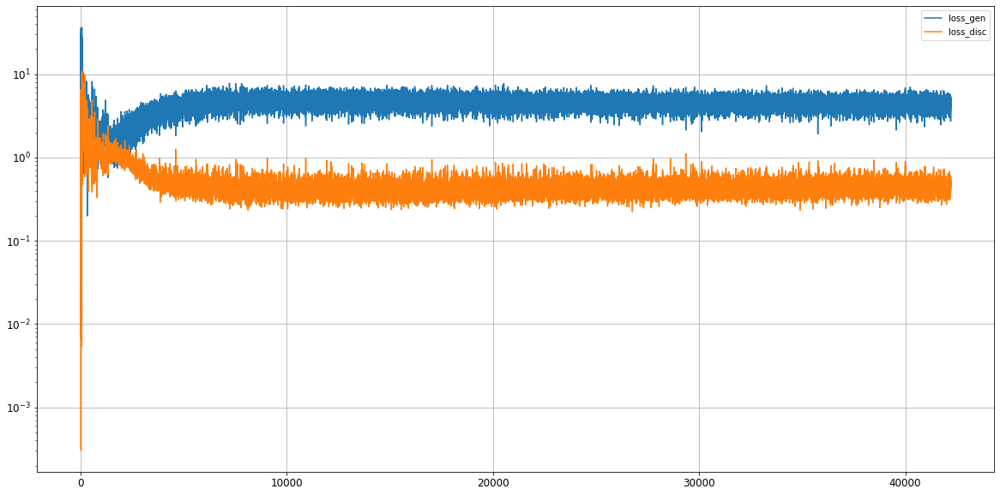

Epoch 42202/50000
0s
Epoch 42203/50000
0s
Epoch 42204/50000
0s
Epoch 42205/50000
0s
Epoch 42206/50000
0s
Epoch 42207/50000
0s
Epoch 42208/50000
0s
Epoch 42209/50000
0s
Epoch 42210/50000
0s
Epoch 42211/50000
0s
Epoch 42212/50000
0s
Epoch 42213/50000
0s
Epoch 42214/50000
0s
Epoch 42215/50000
0s
Epoch 42216/50000
0s
Epoch 42217/50000
0s
Epoch 42218/50000
0s
Epoch 42219/50000
0s
Epoch 42220/50000
0s
Epoch 42221/50000
0s
Epoch 42222/50000
0s
Epoch 42223/50000
0s
Epoch 42224/50000
0s
Epoch 42225/50000
0s
Epoch 42226/50000
0s
Epoch 42227/50000
0s
Epoch 42228/50000
0s
Epoch 42229/50000
0s
Epoch 42230/50000
0s
Epoch 42231/50000
0s
Epoch 42232/50000
0s
Epoch 42233/50000
0s
Epoch 42234/50000
0s
Epoch 42235/50000
0s
Epoch 42236/50000
0s
Epoch 42237/50000
0s
Epoch 42238/50000
0s
Epoch 42239/50000
0s
Epoch 42240/50000
0s
Epoch 42241/50000
0s
Epoch 42242/50000
0s
Epoch 42243/50000
0s
Epoch 42244/50000
0s
Epoch 42245/50000
0s
Epoch 42246/50000
0s
Epoch 42247/50000
0s
Epoch 42248/50000
0s
Epoch 42249/5

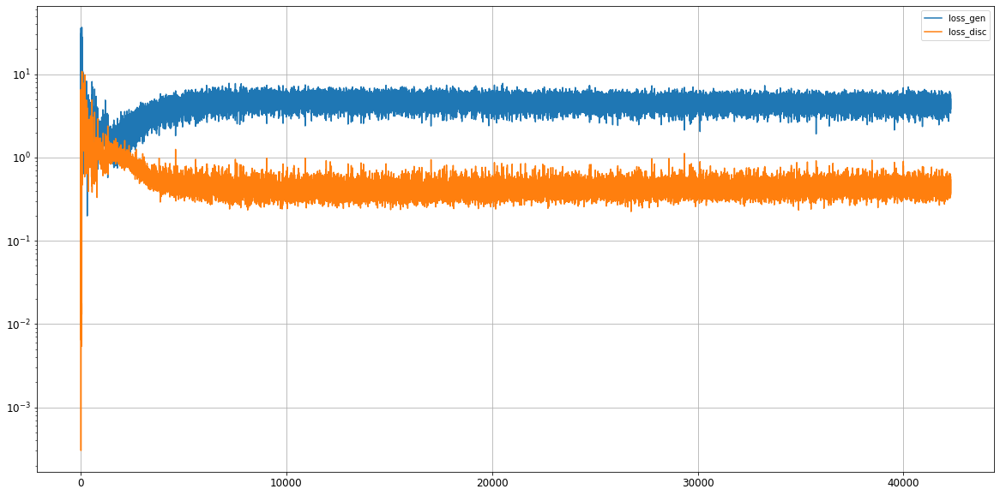

Epoch 42302/50000
0s
Epoch 42303/50000
0s
Epoch 42304/50000
0s
Epoch 42305/50000
0s
Epoch 42306/50000
0s
Epoch 42307/50000
0s
Epoch 42308/50000
0s
Epoch 42309/50000
0s
Epoch 42310/50000
0s
Epoch 42311/50000
0s
Epoch 42312/50000
0s
Epoch 42313/50000
0s
Epoch 42314/50000
0s
Epoch 42315/50000
0s
Epoch 42316/50000
0s
Epoch 42317/50000
0s
Epoch 42318/50000
0s
Epoch 42319/50000
0s
Epoch 42320/50000
0s
Epoch 42321/50000
0s
Epoch 42322/50000
0s
Epoch 42323/50000
0s
Epoch 42324/50000
0s
Epoch 42325/50000
0s
Epoch 42326/50000
0s
Epoch 42327/50000
0s
Epoch 42328/50000
0s
Epoch 42329/50000
0s
Epoch 42330/50000
0s
Epoch 42331/50000
0s
Epoch 42332/50000
0s
Epoch 42333/50000
0s
Epoch 42334/50000
0s
Epoch 42335/50000
0s
Epoch 42336/50000
0s
Epoch 42337/50000
0s
Epoch 42338/50000
0s
Epoch 42339/50000
0s
Epoch 42340/50000
0s
Epoch 42341/50000
0s
Epoch 42342/50000
0s
Epoch 42343/50000
0s
Epoch 42344/50000
0s
Epoch 42345/50000
0s
Epoch 42346/50000
0s
Epoch 42347/50000
0s
Epoch 42348/50000
0s
Epoch 42349/5

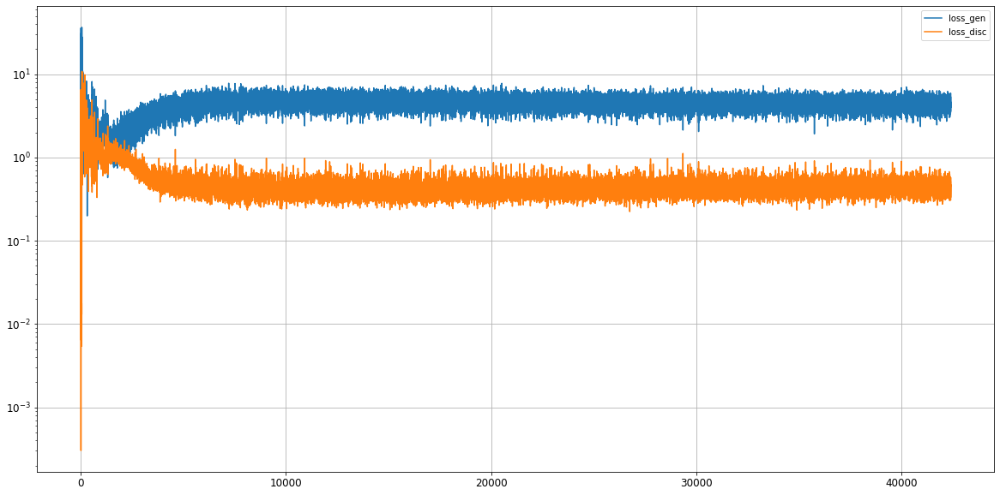

Epoch 42402/50000
0s
Epoch 42403/50000
0s
Epoch 42404/50000
0s
Epoch 42405/50000
0s
Epoch 42406/50000
0s
Epoch 42407/50000
0s
Epoch 42408/50000
0s
Epoch 42409/50000
0s
Epoch 42410/50000
0s
Epoch 42411/50000
0s
Epoch 42412/50000
0s
Epoch 42413/50000
0s
Epoch 42414/50000
0s
Epoch 42415/50000
0s
Epoch 42416/50000
0s
Epoch 42417/50000
0s
Epoch 42418/50000
0s
Epoch 42419/50000
0s
Epoch 42420/50000
0s
Epoch 42421/50000
0s
Epoch 42422/50000
0s
Epoch 42423/50000
0s
Epoch 42424/50000
0s
Epoch 42425/50000
0s
Epoch 42426/50000
0s
Epoch 42427/50000
0s
Epoch 42428/50000
0s
Epoch 42429/50000
0s
Epoch 42430/50000
0s
Epoch 42431/50000
0s
Epoch 42432/50000
0s
Epoch 42433/50000
0s
Epoch 42434/50000
0s
Epoch 42435/50000
0s
Epoch 42436/50000
0s
Epoch 42437/50000
0s
Epoch 42438/50000
0s
Epoch 42439/50000
0s
Epoch 42440/50000
0s
Epoch 42441/50000
0s
Epoch 42442/50000
0s
Epoch 42443/50000
0s
Epoch 42444/50000
0s
Epoch 42445/50000
0s
Epoch 42446/50000
0s
Epoch 42447/50000
0s
Epoch 42448/50000
0s
Epoch 42449/5

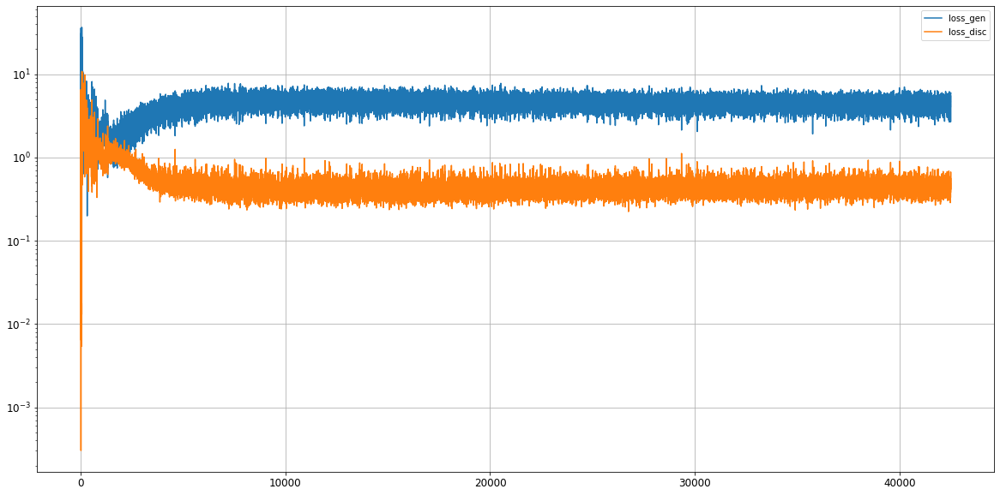

Epoch 42502/50000
0s
Epoch 42503/50000
0s
Epoch 42504/50000
0s
Epoch 42505/50000
0s
Epoch 42506/50000
0s
Epoch 42507/50000
0s
Epoch 42508/50000
0s
Epoch 42509/50000
0s
Epoch 42510/50000
0s
Epoch 42511/50000
0s
Epoch 42512/50000
0s
Epoch 42513/50000
0s
Epoch 42514/50000
0s
Epoch 42515/50000
0s
Epoch 42516/50000
0s
Epoch 42517/50000
0s
Epoch 42518/50000
0s
Epoch 42519/50000
0s
Epoch 42520/50000
0s
Epoch 42521/50000
0s
Epoch 42522/50000
0s
Epoch 42523/50000
0s
Epoch 42524/50000
0s
Epoch 42525/50000
0s
Epoch 42526/50000
0s
Epoch 42527/50000
0s
Epoch 42528/50000
0s
Epoch 42529/50000
0s
Epoch 42530/50000
0s
Epoch 42531/50000
0s
Epoch 42532/50000
0s
Epoch 42533/50000
0s
Epoch 42534/50000
0s
Epoch 42535/50000
0s
Epoch 42536/50000
0s
Epoch 42537/50000
0s
Epoch 42538/50000
0s
Epoch 42539/50000
0s
Epoch 42540/50000
0s
Epoch 42541/50000
0s
Epoch 42542/50000
0s
Epoch 42543/50000
0s
Epoch 42544/50000
0s
Epoch 42545/50000
0s
Epoch 42546/50000
0s
Epoch 42547/50000
0s
Epoch 42548/50000
0s
Epoch 42549/5

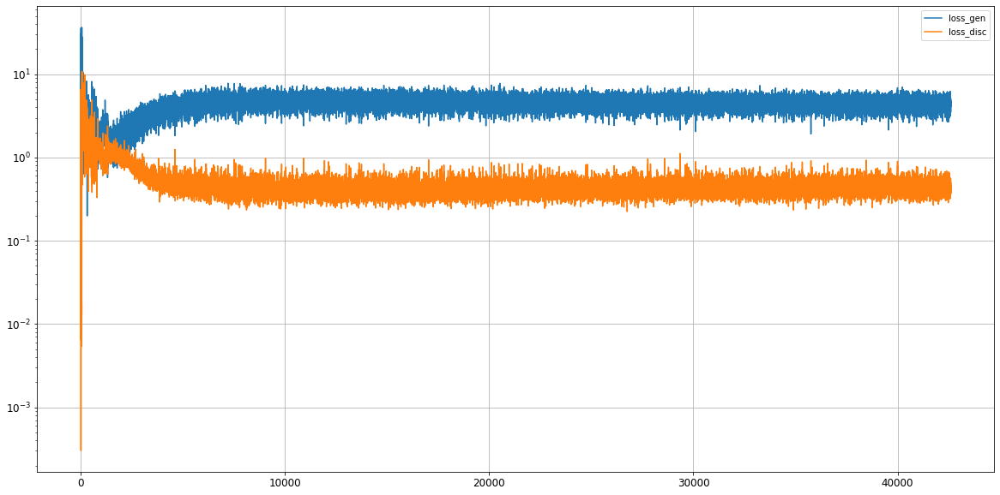

Epoch 42602/50000
0s
Epoch 42603/50000
0s
Epoch 42604/50000
0s
Epoch 42605/50000
0s
Epoch 42606/50000
0s
Epoch 42607/50000
0s
Epoch 42608/50000
0s
Epoch 42609/50000
0s
Epoch 42610/50000
0s
Epoch 42611/50000
0s
Epoch 42612/50000
0s
Epoch 42613/50000
0s
Epoch 42614/50000
0s
Epoch 42615/50000
0s
Epoch 42616/50000
0s
Epoch 42617/50000
0s
Epoch 42618/50000
0s
Epoch 42619/50000
0s
Epoch 42620/50000
0s
Epoch 42621/50000
0s
Epoch 42622/50000
0s
Epoch 42623/50000
0s
Epoch 42624/50000
0s
Epoch 42625/50000
0s
Epoch 42626/50000
0s
Epoch 42627/50000
0s
Epoch 42628/50000
0s
Epoch 42629/50000
0s
Epoch 42630/50000
0s
Epoch 42631/50000
0s
Epoch 42632/50000
0s
Epoch 42633/50000
0s
Epoch 42634/50000
0s
Epoch 42635/50000
0s
Epoch 42636/50000
0s
Epoch 42637/50000
0s
Epoch 42638/50000
0s
Epoch 42639/50000
0s
Epoch 42640/50000
0s
Epoch 42641/50000
0s
Epoch 42642/50000
0s
Epoch 42643/50000
0s
Epoch 42644/50000
0s
Epoch 42645/50000
0s
Epoch 42646/50000
0s
Epoch 42647/50000
0s
Epoch 42648/50000
0s
Epoch 42649/5

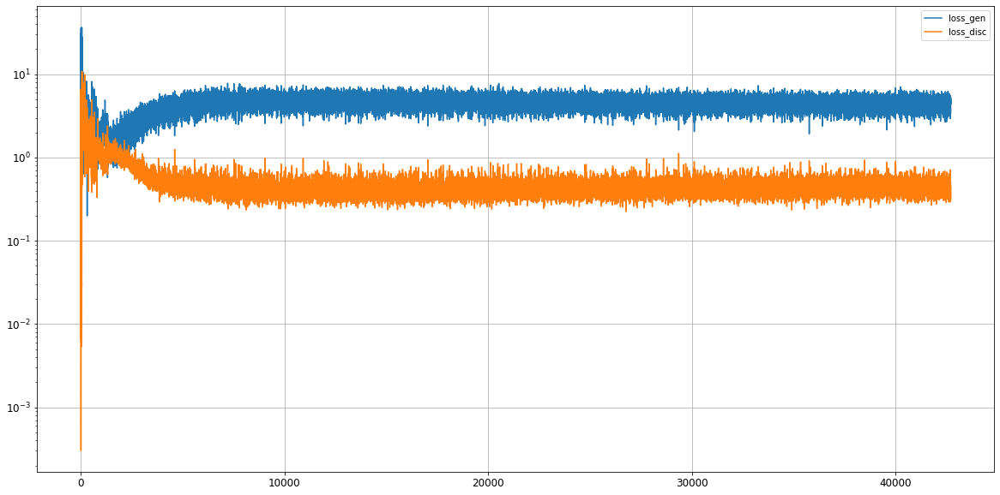

Epoch 42702/50000
0s
Epoch 42703/50000
0s
Epoch 42704/50000
0s
Epoch 42705/50000
0s
Epoch 42706/50000
0s
Epoch 42707/50000
0s
Epoch 42708/50000
0s
Epoch 42709/50000
0s
Epoch 42710/50000
0s
Epoch 42711/50000
0s
Epoch 42712/50000
0s
Epoch 42713/50000
0s
Epoch 42714/50000
0s
Epoch 42715/50000
0s
Epoch 42716/50000
0s
Epoch 42717/50000
0s
Epoch 42718/50000
0s
Epoch 42719/50000
0s
Epoch 42720/50000
0s
Epoch 42721/50000
0s
Epoch 42722/50000
0s
Epoch 42723/50000
0s
Epoch 42724/50000
0s
Epoch 42725/50000
0s
Epoch 42726/50000
0s
Epoch 42727/50000
0s
Epoch 42728/50000
0s
Epoch 42729/50000
0s
Epoch 42730/50000
0s
Epoch 42731/50000
0s
Epoch 42732/50000
0s
Epoch 42733/50000
0s
Epoch 42734/50000
0s
Epoch 42735/50000
0s
Epoch 42736/50000
0s
Epoch 42737/50000
0s
Epoch 42738/50000
0s
Epoch 42739/50000
0s
Epoch 42740/50000
0s
Epoch 42741/50000
0s
Epoch 42742/50000
0s
Epoch 42743/50000
0s
Epoch 42744/50000
0s
Epoch 42745/50000
0s
Epoch 42746/50000
0s
Epoch 42747/50000
0s
Epoch 42748/50000
0s
Epoch 42749/5

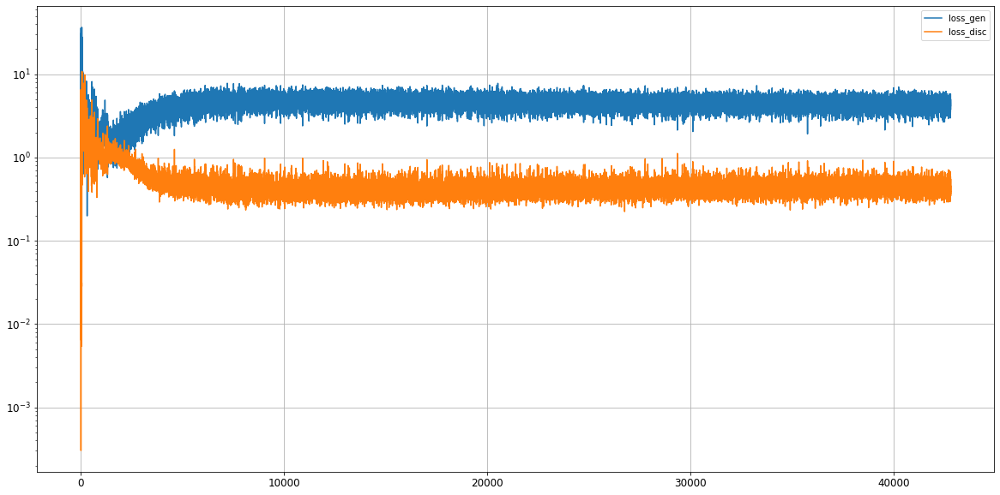

Epoch 42802/50000
0s
Epoch 42803/50000
0s
Epoch 42804/50000
0s
Epoch 42805/50000
0s
Epoch 42806/50000
0s
Epoch 42807/50000
0s
Epoch 42808/50000
0s
Epoch 42809/50000
0s
Epoch 42810/50000
0s
Epoch 42811/50000
0s
Epoch 42812/50000
0s
Epoch 42813/50000
0s
Epoch 42814/50000
0s
Epoch 42815/50000
0s
Epoch 42816/50000
0s
Epoch 42817/50000
0s
Epoch 42818/50000
0s
Epoch 42819/50000
0s
Epoch 42820/50000
0s
Epoch 42821/50000
0s
Epoch 42822/50000
0s
Epoch 42823/50000
0s
Epoch 42824/50000
0s
Epoch 42825/50000
0s
Epoch 42826/50000
0s
Epoch 42827/50000
0s
Epoch 42828/50000
0s
Epoch 42829/50000
0s
Epoch 42830/50000
0s
Epoch 42831/50000
0s
Epoch 42832/50000
0s
Epoch 42833/50000
0s
Epoch 42834/50000
0s
Epoch 42835/50000
0s
Epoch 42836/50000
0s
Epoch 42837/50000
0s
Epoch 42838/50000
0s
Epoch 42839/50000
0s
Epoch 42840/50000
0s
Epoch 42841/50000
0s
Epoch 42842/50000
0s
Epoch 42843/50000
0s
Epoch 42844/50000
0s
Epoch 42845/50000
0s
Epoch 42846/50000
0s
Epoch 42847/50000
0s
Epoch 42848/50000
0s
Epoch 42849/5

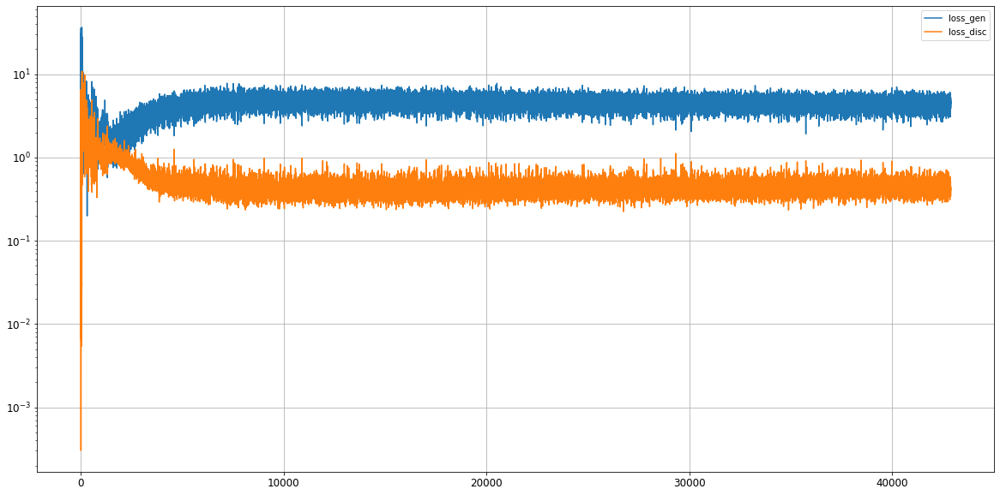

Epoch 42902/50000
0s
Epoch 42903/50000
0s
Epoch 42904/50000
0s
Epoch 42905/50000
0s
Epoch 42906/50000
0s
Epoch 42907/50000
0s
Epoch 42908/50000
0s
Epoch 42909/50000
0s
Epoch 42910/50000
0s
Epoch 42911/50000
0s
Epoch 42912/50000
0s
Epoch 42913/50000
0s
Epoch 42914/50000
0s
Epoch 42915/50000
0s
Epoch 42916/50000
0s
Epoch 42917/50000
0s
Epoch 42918/50000
0s
Epoch 42919/50000
0s
Epoch 42920/50000
0s
Epoch 42921/50000
0s
Epoch 42922/50000
0s
Epoch 42923/50000
0s
Epoch 42924/50000
0s
Epoch 42925/50000
0s
Epoch 42926/50000
0s
Epoch 42927/50000
0s
Epoch 42928/50000
0s
Epoch 42929/50000
0s
Epoch 42930/50000
0s
Epoch 42931/50000
0s
Epoch 42932/50000
0s
Epoch 42933/50000
0s
Epoch 42934/50000
0s
Epoch 42935/50000
0s
Epoch 42936/50000
0s
Epoch 42937/50000
0s
Epoch 42938/50000
0s
Epoch 42939/50000
0s
Epoch 42940/50000
0s
Epoch 42941/50000
0s
Epoch 42942/50000
0s
Epoch 42943/50000
0s
Epoch 42944/50000
0s
Epoch 42945/50000
0s
Epoch 42946/50000
0s
Epoch 42947/50000
0s
Epoch 42948/50000
0s
Epoch 42949/5

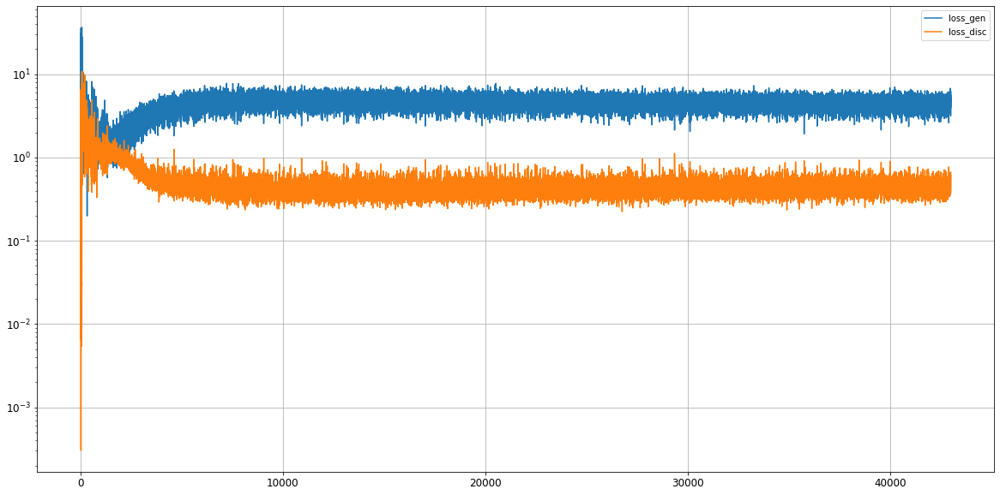

Epoch 43002/50000
0s
Epoch 43003/50000
0s
Epoch 43004/50000
0s
Epoch 43005/50000
0s
Epoch 43006/50000
0s
Epoch 43007/50000
0s
Epoch 43008/50000
0s
Epoch 43009/50000
0s
Epoch 43010/50000
0s
Epoch 43011/50000
0s
Epoch 43012/50000
0s
Epoch 43013/50000
0s
Epoch 43014/50000
0s
Epoch 43015/50000
0s
Epoch 43016/50000
0s
Epoch 43017/50000
0s
Epoch 43018/50000
0s
Epoch 43019/50000
0s
Epoch 43020/50000
0s
Epoch 43021/50000
0s
Epoch 43022/50000
0s
Epoch 43023/50000
0s
Epoch 43024/50000
0s
Epoch 43025/50000
0s
Epoch 43026/50000
0s
Epoch 43027/50000
0s
Epoch 43028/50000
0s
Epoch 43029/50000
0s
Epoch 43030/50000
0s
Epoch 43031/50000
0s
Epoch 43032/50000
0s
Epoch 43033/50000
0s
Epoch 43034/50000
0s
Epoch 43035/50000
0s
Epoch 43036/50000
0s
Epoch 43037/50000
0s
Epoch 43038/50000
0s
Epoch 43039/50000
0s
Epoch 43040/50000
0s
Epoch 43041/50000
0s
Epoch 43042/50000
0s
Epoch 43043/50000
0s
Epoch 43044/50000
0s
Epoch 43045/50000
0s
Epoch 43046/50000
0s
Epoch 43047/50000
0s
Epoch 43048/50000
0s
Epoch 43049/5

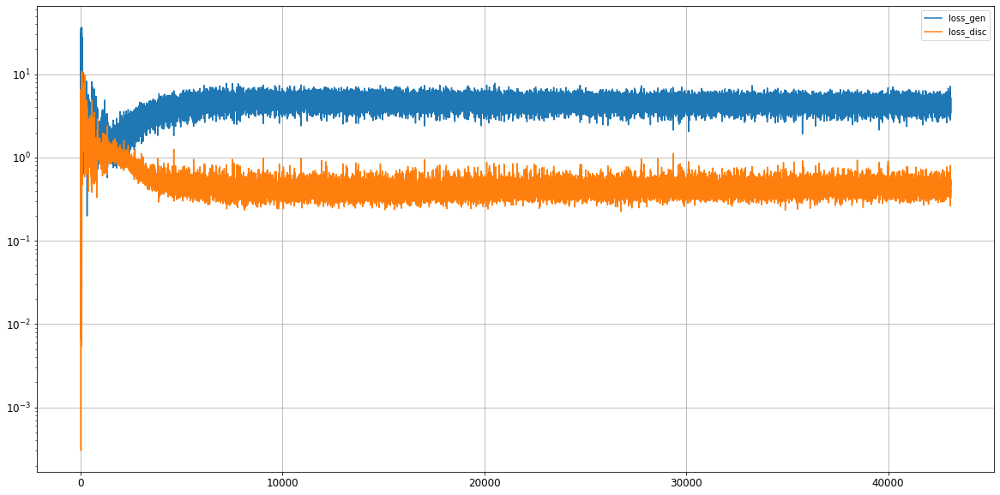

Epoch 43102/50000
0s
Epoch 43103/50000
0s
Epoch 43104/50000
0s
Epoch 43105/50000
0s
Epoch 43106/50000
0s
Epoch 43107/50000
0s
Epoch 43108/50000
0s
Epoch 43109/50000
0s
Epoch 43110/50000
0s
Epoch 43111/50000
0s
Epoch 43112/50000
0s
Epoch 43113/50000
0s
Epoch 43114/50000
0s
Epoch 43115/50000
0s
Epoch 43116/50000
0s
Epoch 43117/50000
0s
Epoch 43118/50000
0s
Epoch 43119/50000
0s
Epoch 43120/50000
0s
Epoch 43121/50000
0s
Epoch 43122/50000
0s
Epoch 43123/50000
0s
Epoch 43124/50000
0s
Epoch 43125/50000
0s
Epoch 43126/50000
0s
Epoch 43127/50000
0s
Epoch 43128/50000
0s
Epoch 43129/50000
0s
Epoch 43130/50000
0s
Epoch 43131/50000
0s
Epoch 43132/50000
0s
Epoch 43133/50000
0s
Epoch 43134/50000
0s
Epoch 43135/50000
0s
Epoch 43136/50000
0s
Epoch 43137/50000
0s
Epoch 43138/50000
0s
Epoch 43139/50000
0s
Epoch 43140/50000
0s
Epoch 43141/50000
0s
Epoch 43142/50000
0s
Epoch 43143/50000
0s
Epoch 43144/50000
0s
Epoch 43145/50000
0s
Epoch 43146/50000
0s
Epoch 43147/50000
0s
Epoch 43148/50000
0s
Epoch 43149/5

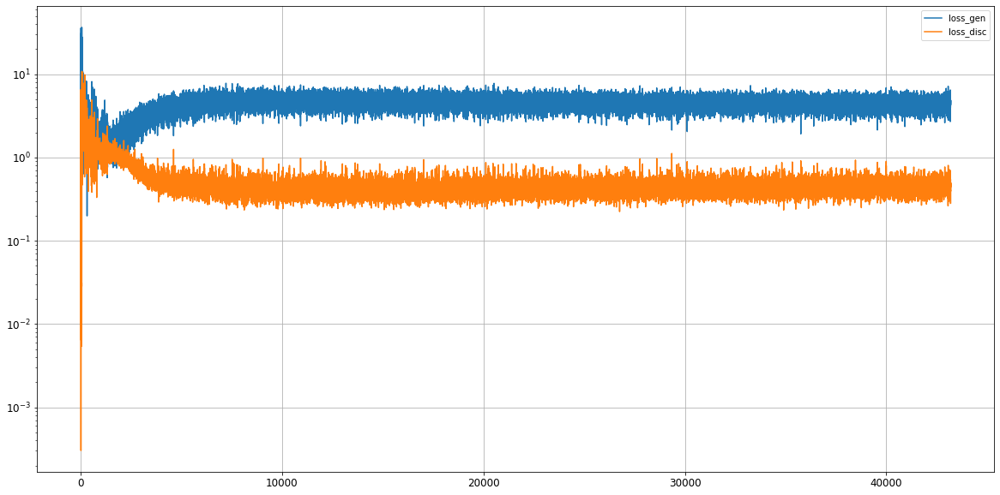

Epoch 43202/50000
0s
Epoch 43203/50000
0s
Epoch 43204/50000
0s
Epoch 43205/50000
0s
Epoch 43206/50000
0s
Epoch 43207/50000
0s
Epoch 43208/50000
0s
Epoch 43209/50000
0s
Epoch 43210/50000
0s
Epoch 43211/50000
0s
Epoch 43212/50000
0s
Epoch 43213/50000
0s
Epoch 43214/50000
0s
Epoch 43215/50000
0s
Epoch 43216/50000
0s
Epoch 43217/50000
0s
Epoch 43218/50000
0s
Epoch 43219/50000
0s
Epoch 43220/50000
0s
Epoch 43221/50000
0s
Epoch 43222/50000
0s
Epoch 43223/50000
0s
Epoch 43224/50000
0s
Epoch 43225/50000
0s
Epoch 43226/50000
0s
Epoch 43227/50000
0s
Epoch 43228/50000
0s
Epoch 43229/50000
0s
Epoch 43230/50000
0s
Epoch 43231/50000
0s
Epoch 43232/50000
0s
Epoch 43233/50000
0s
Epoch 43234/50000
0s
Epoch 43235/50000
0s
Epoch 43236/50000
0s
Epoch 43237/50000
0s
Epoch 43238/50000
0s
Epoch 43239/50000
0s
Epoch 43240/50000
0s
Epoch 43241/50000
0s
Epoch 43242/50000
0s
Epoch 43243/50000
0s
Epoch 43244/50000
0s
Epoch 43245/50000
0s
Epoch 43246/50000
0s
Epoch 43247/50000
0s
Epoch 43248/50000
0s
Epoch 43249/5

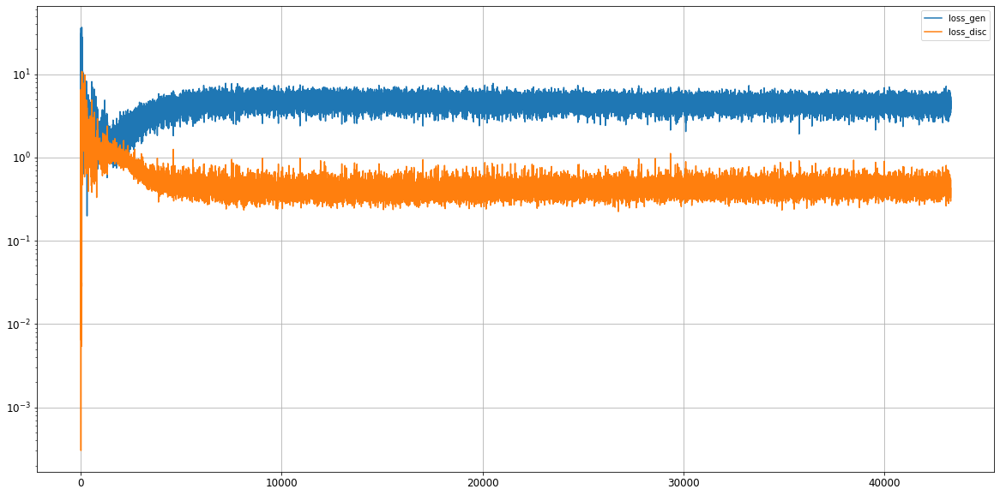

Epoch 43302/50000
0s
Epoch 43303/50000
0s
Epoch 43304/50000
0s
Epoch 43305/50000
0s
Epoch 43306/50000
0s
Epoch 43307/50000
0s
Epoch 43308/50000
0s
Epoch 43309/50000
0s
Epoch 43310/50000
0s
Epoch 43311/50000
0s
Epoch 43312/50000
0s
Epoch 43313/50000
0s
Epoch 43314/50000
0s
Epoch 43315/50000
0s
Epoch 43316/50000
0s
Epoch 43317/50000
0s
Epoch 43318/50000
0s
Epoch 43319/50000
0s
Epoch 43320/50000
0s
Epoch 43321/50000
0s
Epoch 43322/50000
0s
Epoch 43323/50000
0s
Epoch 43324/50000
0s
Epoch 43325/50000
0s
Epoch 43326/50000
0s
Epoch 43327/50000
0s
Epoch 43328/50000
0s
Epoch 43329/50000
0s
Epoch 43330/50000
0s
Epoch 43331/50000
0s
Epoch 43332/50000
0s
Epoch 43333/50000
0s
Epoch 43334/50000
0s
Epoch 43335/50000
0s
Epoch 43336/50000
0s
Epoch 43337/50000
0s
Epoch 43338/50000
0s
Epoch 43339/50000
0s
Epoch 43340/50000
0s
Epoch 43341/50000
0s
Epoch 43342/50000
0s
Epoch 43343/50000
0s
Epoch 43344/50000
0s
Epoch 43345/50000
0s
Epoch 43346/50000
0s
Epoch 43347/50000
0s
Epoch 43348/50000
0s
Epoch 43349/5

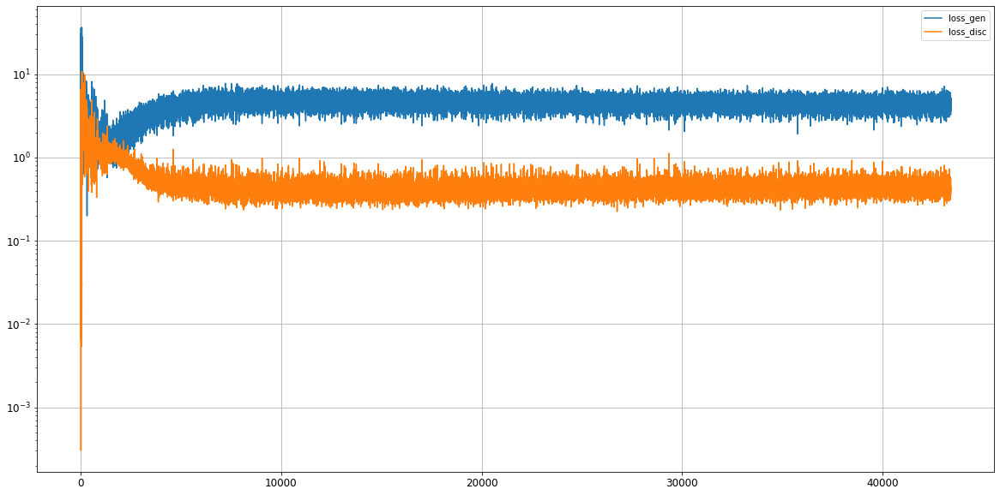

Epoch 43402/50000
0s
Epoch 43403/50000
0s
Epoch 43404/50000
0s
Epoch 43405/50000
0s
Epoch 43406/50000
0s
Epoch 43407/50000
0s
Epoch 43408/50000
0s
Epoch 43409/50000
0s
Epoch 43410/50000
0s
Epoch 43411/50000
0s
Epoch 43412/50000
0s
Epoch 43413/50000
0s
Epoch 43414/50000
0s
Epoch 43415/50000
0s
Epoch 43416/50000
0s
Epoch 43417/50000
0s
Epoch 43418/50000
0s
Epoch 43419/50000
0s
Epoch 43420/50000
0s
Epoch 43421/50000
0s
Epoch 43422/50000
0s
Epoch 43423/50000
0s
Epoch 43424/50000
0s
Epoch 43425/50000
0s
Epoch 43426/50000
0s
Epoch 43427/50000
0s
Epoch 43428/50000
0s
Epoch 43429/50000
0s
Epoch 43430/50000
0s
Epoch 43431/50000
0s
Epoch 43432/50000
0s
Epoch 43433/50000
0s
Epoch 43434/50000
0s
Epoch 43435/50000
0s
Epoch 43436/50000
0s
Epoch 43437/50000
0s
Epoch 43438/50000
0s
Epoch 43439/50000
0s
Epoch 43440/50000
0s
Epoch 43441/50000
0s
Epoch 43442/50000
0s
Epoch 43443/50000
0s
Epoch 43444/50000
0s
Epoch 43445/50000
0s
Epoch 43446/50000
0s
Epoch 43447/50000
0s
Epoch 43448/50000
0s
Epoch 43449/5

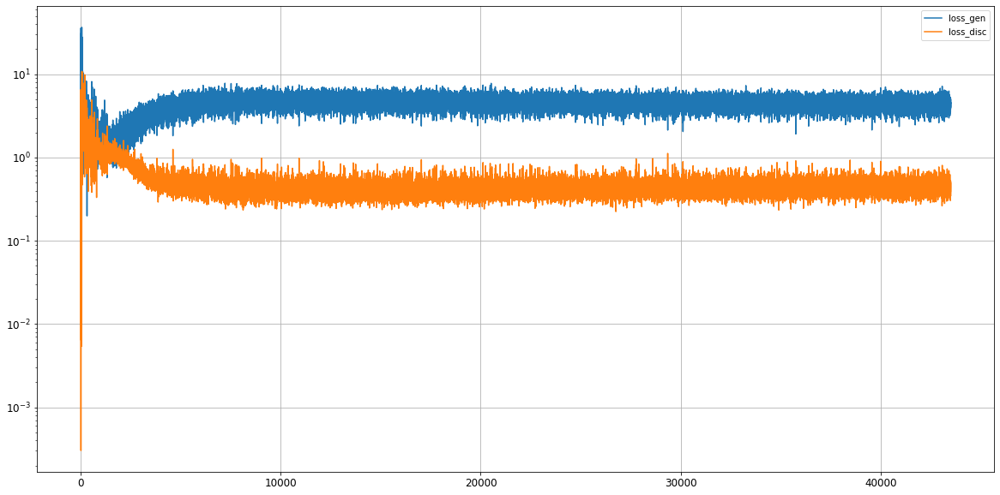

Epoch 43502/50000
0s
Epoch 43503/50000
0s
Epoch 43504/50000
0s
Epoch 43505/50000
0s
Epoch 43506/50000
0s
Epoch 43507/50000
0s
Epoch 43508/50000
0s
Epoch 43509/50000
0s
Epoch 43510/50000
0s
Epoch 43511/50000
0s
Epoch 43512/50000
0s
Epoch 43513/50000
0s
Epoch 43514/50000
0s
Epoch 43515/50000
0s
Epoch 43516/50000
0s
Epoch 43517/50000
0s
Epoch 43518/50000
0s
Epoch 43519/50000
0s
Epoch 43520/50000
0s
Epoch 43521/50000
0s
Epoch 43522/50000
0s
Epoch 43523/50000
0s
Epoch 43524/50000
0s
Epoch 43525/50000
0s
Epoch 43526/50000
0s
Epoch 43527/50000
0s
Epoch 43528/50000
0s
Epoch 43529/50000
0s
Epoch 43530/50000
0s
Epoch 43531/50000
0s
Epoch 43532/50000
0s
Epoch 43533/50000
0s
Epoch 43534/50000
0s
Epoch 43535/50000
0s
Epoch 43536/50000
0s
Epoch 43537/50000
0s
Epoch 43538/50000
0s
Epoch 43539/50000
0s
Epoch 43540/50000
0s
Epoch 43541/50000
0s
Epoch 43542/50000
0s
Epoch 43543/50000
0s
Epoch 43544/50000
0s
Epoch 43545/50000
0s
Epoch 43546/50000
0s
Epoch 43547/50000
0s
Epoch 43548/50000
0s
Epoch 43549/5

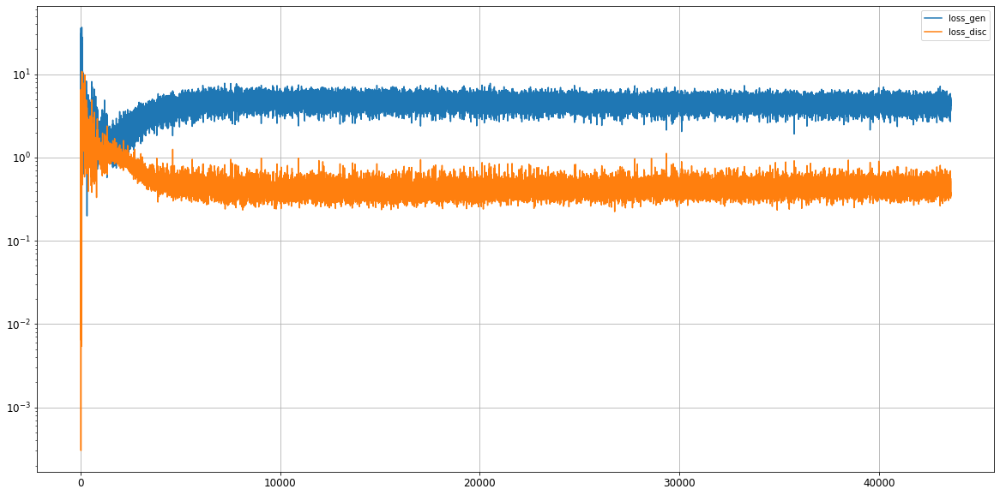

Epoch 43602/50000
0s
Epoch 43603/50000
0s
Epoch 43604/50000
0s
Epoch 43605/50000
0s
Epoch 43606/50000
0s
Epoch 43607/50000
0s
Epoch 43608/50000
0s
Epoch 43609/50000
0s
Epoch 43610/50000
0s
Epoch 43611/50000
0s
Epoch 43612/50000
0s
Epoch 43613/50000
0s
Epoch 43614/50000
0s
Epoch 43615/50000
0s
Epoch 43616/50000
0s
Epoch 43617/50000
0s
Epoch 43618/50000
0s
Epoch 43619/50000
0s
Epoch 43620/50000
0s
Epoch 43621/50000
0s
Epoch 43622/50000
0s
Epoch 43623/50000
0s
Epoch 43624/50000
0s
Epoch 43625/50000
0s
Epoch 43626/50000
0s
Epoch 43627/50000
0s
Epoch 43628/50000
0s
Epoch 43629/50000
0s
Epoch 43630/50000
0s
Epoch 43631/50000
0s
Epoch 43632/50000
0s
Epoch 43633/50000
0s
Epoch 43634/50000
0s
Epoch 43635/50000
0s
Epoch 43636/50000
0s
Epoch 43637/50000
0s
Epoch 43638/50000
0s
Epoch 43639/50000
0s
Epoch 43640/50000
0s
Epoch 43641/50000
0s
Epoch 43642/50000
0s
Epoch 43643/50000
0s
Epoch 43644/50000
0s
Epoch 43645/50000
0s
Epoch 43646/50000
0s
Epoch 43647/50000
0s
Epoch 43648/50000
0s
Epoch 43649/5

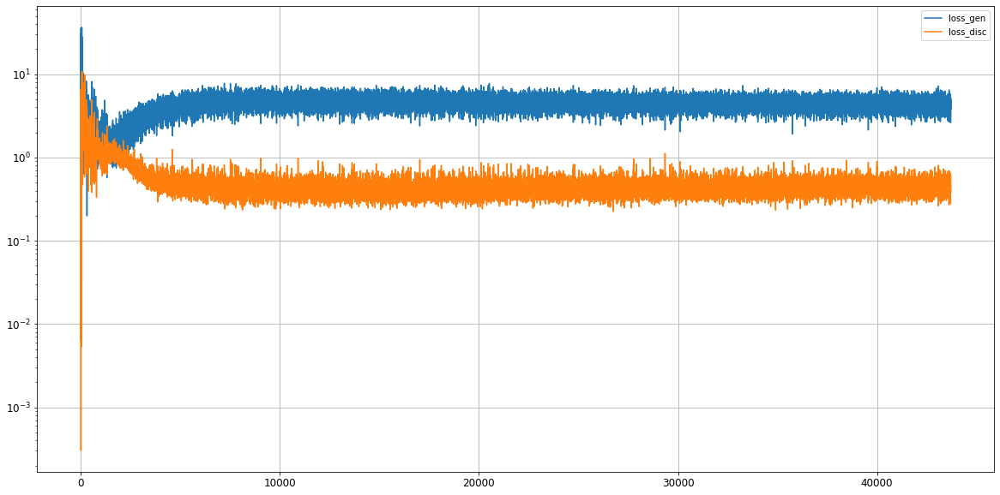

Epoch 43702/50000
0s
Epoch 43703/50000
0s
Epoch 43704/50000
0s
Epoch 43705/50000
0s
Epoch 43706/50000
0s
Epoch 43707/50000
0s
Epoch 43708/50000
0s
Epoch 43709/50000
0s
Epoch 43710/50000
0s
Epoch 43711/50000
0s
Epoch 43712/50000
0s
Epoch 43713/50000
0s
Epoch 43714/50000
0s
Epoch 43715/50000
0s
Epoch 43716/50000
0s
Epoch 43717/50000
0s
Epoch 43718/50000
0s
Epoch 43719/50000
0s
Epoch 43720/50000
0s
Epoch 43721/50000
0s
Epoch 43722/50000
0s
Epoch 43723/50000
0s
Epoch 43724/50000
0s
Epoch 43725/50000
0s
Epoch 43726/50000
0s
Epoch 43727/50000
0s
Epoch 43728/50000
0s
Epoch 43729/50000
0s
Epoch 43730/50000
0s
Epoch 43731/50000
0s
Epoch 43732/50000
0s
Epoch 43733/50000
0s
Epoch 43734/50000
0s
Epoch 43735/50000
0s
Epoch 43736/50000
0s
Epoch 43737/50000
0s
Epoch 43738/50000
0s
Epoch 43739/50000
0s
Epoch 43740/50000
0s
Epoch 43741/50000
0s
Epoch 43742/50000
0s
Epoch 43743/50000
0s
Epoch 43744/50000
0s
Epoch 43745/50000
0s
Epoch 43746/50000
0s
Epoch 43747/50000
0s
Epoch 43748/50000
0s
Epoch 43749/5

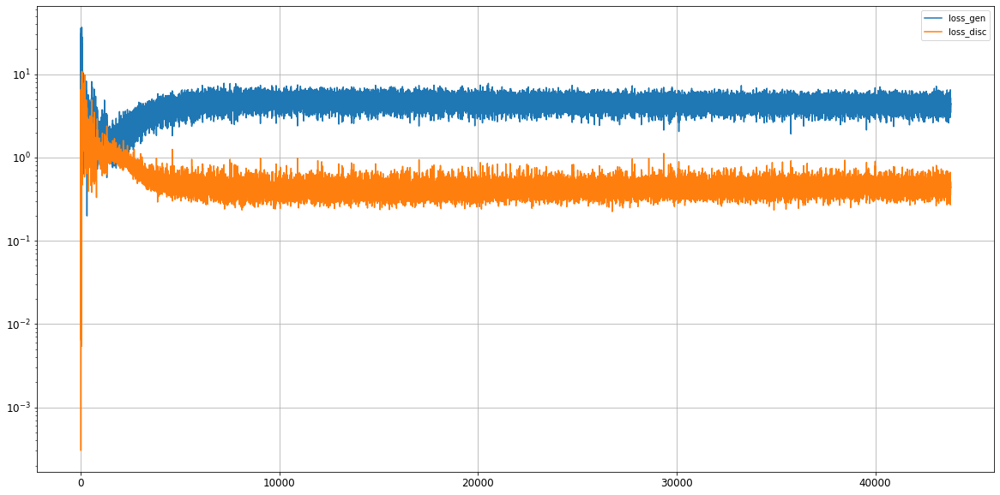

Epoch 43802/50000
0s
Epoch 43803/50000
0s
Epoch 43804/50000
0s
Epoch 43805/50000
0s
Epoch 43806/50000
0s
Epoch 43807/50000
0s
Epoch 43808/50000
0s
Epoch 43809/50000
0s
Epoch 43810/50000
0s
Epoch 43811/50000
0s
Epoch 43812/50000
0s
Epoch 43813/50000
0s
Epoch 43814/50000
0s
Epoch 43815/50000
0s
Epoch 43816/50000
0s
Epoch 43817/50000
0s
Epoch 43818/50000
0s
Epoch 43819/50000
0s
Epoch 43820/50000
0s
Epoch 43821/50000
0s
Epoch 43822/50000
0s
Epoch 43823/50000
0s
Epoch 43824/50000
0s
Epoch 43825/50000
0s
Epoch 43826/50000
0s
Epoch 43827/50000
0s
Epoch 43828/50000
0s
Epoch 43829/50000
0s
Epoch 43830/50000
0s
Epoch 43831/50000
0s
Epoch 43832/50000
0s
Epoch 43833/50000
0s
Epoch 43834/50000
0s
Epoch 43835/50000
0s
Epoch 43836/50000
0s
Epoch 43837/50000
0s
Epoch 43838/50000
0s
Epoch 43839/50000
0s
Epoch 43840/50000
0s
Epoch 43841/50000
0s
Epoch 43842/50000
0s
Epoch 43843/50000
0s
Epoch 43844/50000
0s
Epoch 43845/50000
0s
Epoch 43846/50000
0s
Epoch 43847/50000
0s
Epoch 43848/50000
0s
Epoch 43849/5

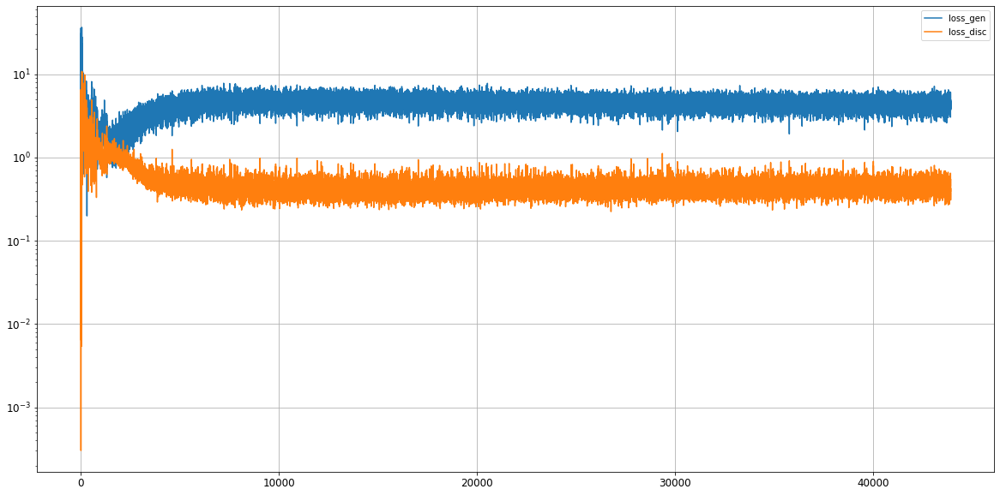

Epoch 43902/50000
0s
Epoch 43903/50000
0s
Epoch 43904/50000
0s
Epoch 43905/50000
0s
Epoch 43906/50000
0s
Epoch 43907/50000
0s
Epoch 43908/50000
0s
Epoch 43909/50000
0s
Epoch 43910/50000
0s
Epoch 43911/50000
0s
Epoch 43912/50000
0s
Epoch 43913/50000
0s
Epoch 43914/50000
0s
Epoch 43915/50000
0s
Epoch 43916/50000
0s
Epoch 43917/50000
0s
Epoch 43918/50000
0s
Epoch 43919/50000
0s
Epoch 43920/50000
0s
Epoch 43921/50000
0s
Epoch 43922/50000
0s
Epoch 43923/50000
0s
Epoch 43924/50000
0s
Epoch 43925/50000
0s
Epoch 43926/50000
0s
Epoch 43927/50000
0s
Epoch 43928/50000
0s
Epoch 43929/50000
0s
Epoch 43930/50000
0s
Epoch 43931/50000
0s
Epoch 43932/50000
0s
Epoch 43933/50000
0s
Epoch 43934/50000
0s
Epoch 43935/50000
0s
Epoch 43936/50000
0s
Epoch 43937/50000
0s
Epoch 43938/50000
0s
Epoch 43939/50000
0s
Epoch 43940/50000
0s
Epoch 43941/50000
0s
Epoch 43942/50000
0s
Epoch 43943/50000
0s
Epoch 43944/50000
0s
Epoch 43945/50000
0s
Epoch 43946/50000
0s
Epoch 43947/50000
0s
Epoch 43948/50000
0s
Epoch 43949/5

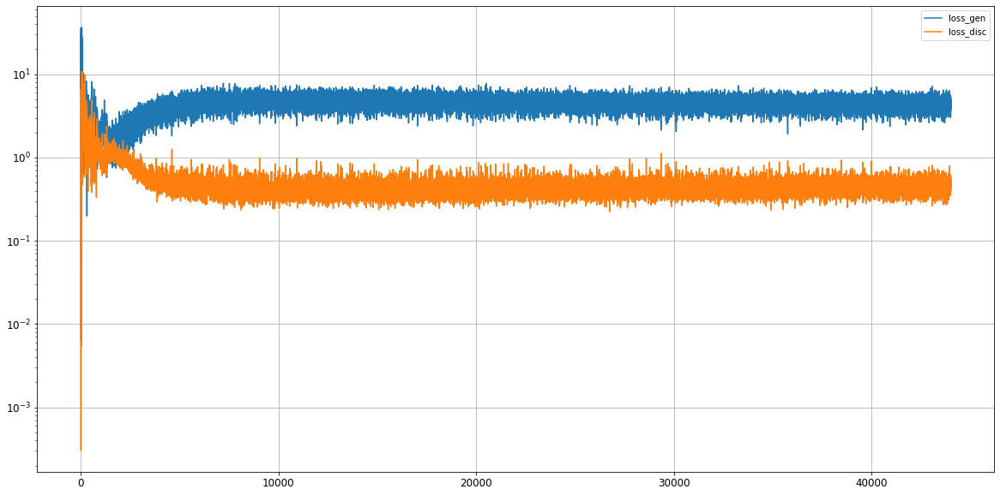

Epoch 44002/50000
0s
Epoch 44003/50000
0s
Epoch 44004/50000
0s
Epoch 44005/50000
0s
Epoch 44006/50000
0s
Epoch 44007/50000
0s
Epoch 44008/50000
0s
Epoch 44009/50000
0s
Epoch 44010/50000
0s
Epoch 44011/50000
0s
Epoch 44012/50000
0s
Epoch 44013/50000
0s
Epoch 44014/50000
0s
Epoch 44015/50000
0s
Epoch 44016/50000
0s
Epoch 44017/50000
0s
Epoch 44018/50000
0s
Epoch 44019/50000
0s
Epoch 44020/50000
0s
Epoch 44021/50000
0s
Epoch 44022/50000
0s
Epoch 44023/50000
0s
Epoch 44024/50000
0s
Epoch 44025/50000
0s
Epoch 44026/50000
0s
Epoch 44027/50000
0s
Epoch 44028/50000
0s
Epoch 44029/50000
0s
Epoch 44030/50000
0s
Epoch 44031/50000
0s
Epoch 44032/50000
0s
Epoch 44033/50000
0s
Epoch 44034/50000
0s
Epoch 44035/50000
0s
Epoch 44036/50000
0s
Epoch 44037/50000
0s
Epoch 44038/50000
0s
Epoch 44039/50000
0s
Epoch 44040/50000
0s
Epoch 44041/50000
0s
Epoch 44042/50000
0s
Epoch 44043/50000
0s
Epoch 44044/50000
0s
Epoch 44045/50000
0s
Epoch 44046/50000
0s
Epoch 44047/50000
0s
Epoch 44048/50000
0s
Epoch 44049/5

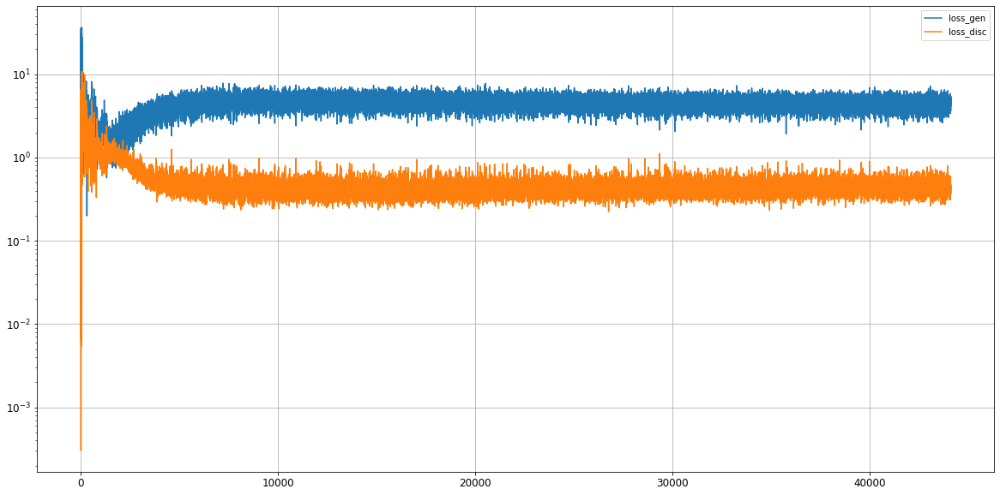

Epoch 44102/50000
0s
Epoch 44103/50000
0s
Epoch 44104/50000
0s
Epoch 44105/50000
0s
Epoch 44106/50000
0s
Epoch 44107/50000
0s
Epoch 44108/50000
0s
Epoch 44109/50000
0s
Epoch 44110/50000
0s
Epoch 44111/50000
0s
Epoch 44112/50000
0s
Epoch 44113/50000
0s
Epoch 44114/50000
0s
Epoch 44115/50000
0s
Epoch 44116/50000
0s
Epoch 44117/50000
0s
Epoch 44118/50000
0s
Epoch 44119/50000
0s
Epoch 44120/50000
0s
Epoch 44121/50000
0s
Epoch 44122/50000
0s
Epoch 44123/50000
0s
Epoch 44124/50000
0s
Epoch 44125/50000
0s
Epoch 44126/50000
0s
Epoch 44127/50000
0s
Epoch 44128/50000
0s
Epoch 44129/50000
0s
Epoch 44130/50000
0s
Epoch 44131/50000
0s
Epoch 44132/50000
0s
Epoch 44133/50000
0s
Epoch 44134/50000
0s
Epoch 44135/50000
0s
Epoch 44136/50000
0s
Epoch 44137/50000
0s
Epoch 44138/50000
0s
Epoch 44139/50000
0s
Epoch 44140/50000
0s
Epoch 44141/50000
0s
Epoch 44142/50000
0s
Epoch 44143/50000
0s
Epoch 44144/50000
0s
Epoch 44145/50000
0s
Epoch 44146/50000
0s
Epoch 44147/50000
0s
Epoch 44148/50000
0s
Epoch 44149/5

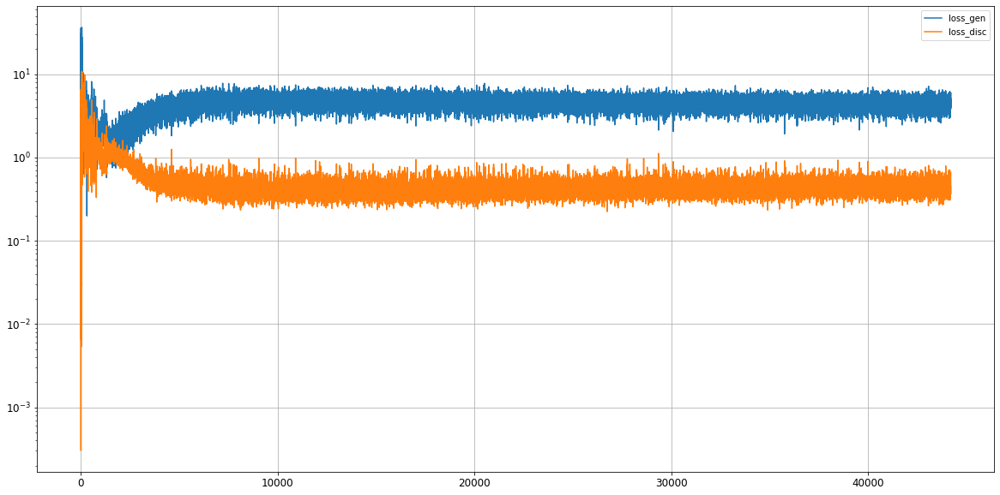

Epoch 44202/50000
0s
Epoch 44203/50000
0s
Epoch 44204/50000
0s
Epoch 44205/50000
0s
Epoch 44206/50000
0s
Epoch 44207/50000
0s
Epoch 44208/50000
0s
Epoch 44209/50000
0s
Epoch 44210/50000
0s
Epoch 44211/50000
0s
Epoch 44212/50000
0s
Epoch 44213/50000
0s
Epoch 44214/50000
0s
Epoch 44215/50000
0s
Epoch 44216/50000
0s
Epoch 44217/50000
0s
Epoch 44218/50000
0s
Epoch 44219/50000
0s
Epoch 44220/50000
0s
Epoch 44221/50000
0s
Epoch 44222/50000
0s
Epoch 44223/50000
0s
Epoch 44224/50000
0s
Epoch 44225/50000
0s
Epoch 44226/50000
0s
Epoch 44227/50000
0s
Epoch 44228/50000
0s
Epoch 44229/50000
0s
Epoch 44230/50000
0s
Epoch 44231/50000
0s
Epoch 44232/50000
0s
Epoch 44233/50000
0s
Epoch 44234/50000
0s
Epoch 44235/50000
0s
Epoch 44236/50000
0s
Epoch 44237/50000
0s
Epoch 44238/50000
0s
Epoch 44239/50000
0s
Epoch 44240/50000
0s
Epoch 44241/50000
0s
Epoch 44242/50000
0s
Epoch 44243/50000
0s
Epoch 44244/50000
0s
Epoch 44245/50000
0s
Epoch 44246/50000
0s
Epoch 44247/50000
0s
Epoch 44248/50000
0s
Epoch 44249/5

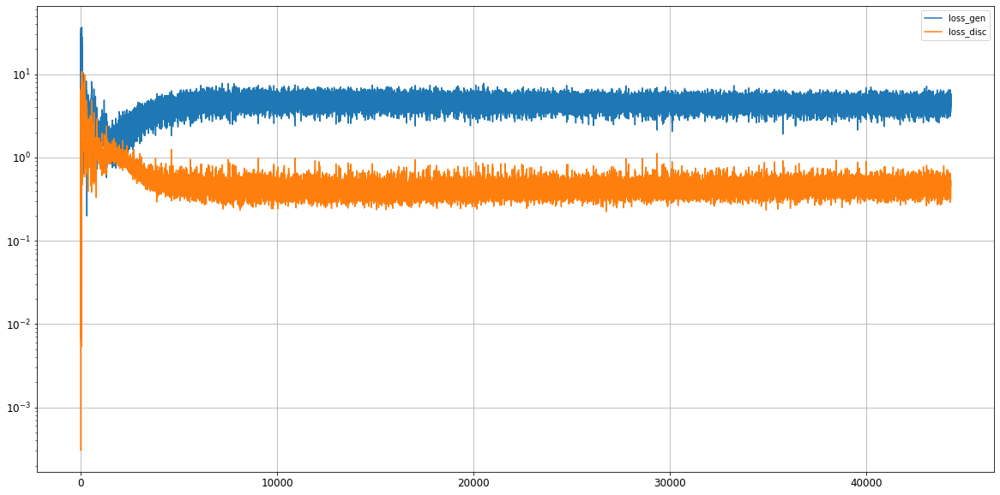

Epoch 44302/50000
0s
Epoch 44303/50000
0s
Epoch 44304/50000
0s
Epoch 44305/50000
0s
Epoch 44306/50000
0s
Epoch 44307/50000
0s
Epoch 44308/50000
0s
Epoch 44309/50000
0s
Epoch 44310/50000
0s
Epoch 44311/50000
0s
Epoch 44312/50000
0s
Epoch 44313/50000
0s
Epoch 44314/50000
0s
Epoch 44315/50000
0s
Epoch 44316/50000
0s
Epoch 44317/50000
0s
Epoch 44318/50000
0s
Epoch 44319/50000
0s
Epoch 44320/50000
0s
Epoch 44321/50000
0s
Epoch 44322/50000
0s
Epoch 44323/50000
0s
Epoch 44324/50000
0s
Epoch 44325/50000
0s
Epoch 44326/50000
0s
Epoch 44327/50000
0s
Epoch 44328/50000
0s
Epoch 44329/50000
0s
Epoch 44330/50000
0s
Epoch 44331/50000
0s
Epoch 44332/50000
0s
Epoch 44333/50000
0s
Epoch 44334/50000
0s
Epoch 44335/50000
0s
Epoch 44336/50000
0s
Epoch 44337/50000
0s
Epoch 44338/50000
0s
Epoch 44339/50000
0s
Epoch 44340/50000
0s
Epoch 44341/50000
0s
Epoch 44342/50000
0s
Epoch 44343/50000
0s
Epoch 44344/50000
0s
Epoch 44345/50000
0s
Epoch 44346/50000
0s
Epoch 44347/50000
0s
Epoch 44348/50000
0s
Epoch 44349/5

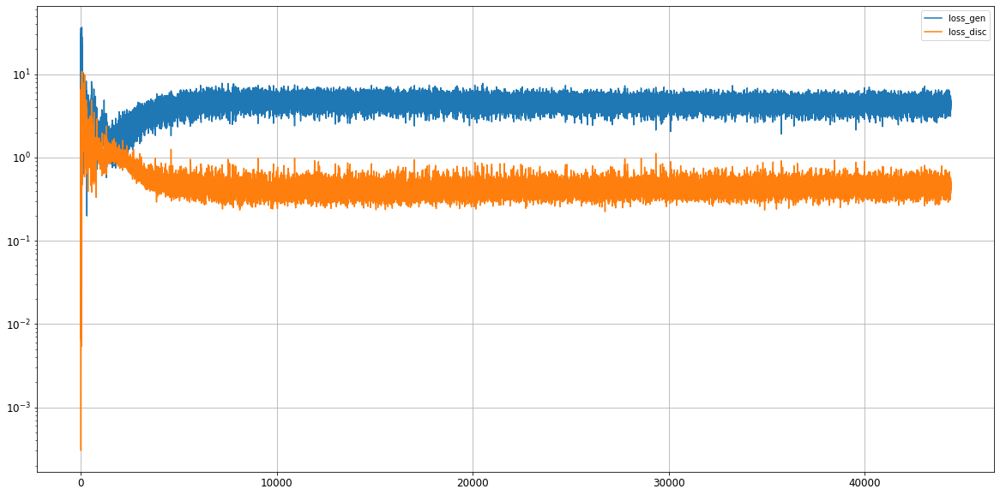

Epoch 44402/50000
0s
Epoch 44403/50000
0s
Epoch 44404/50000
0s
Epoch 44405/50000
0s
Epoch 44406/50000
0s
Epoch 44407/50000
0s
Epoch 44408/50000
0s
Epoch 44409/50000
0s
Epoch 44410/50000
0s
Epoch 44411/50000
0s
Epoch 44412/50000
0s
Epoch 44413/50000
0s
Epoch 44414/50000
0s
Epoch 44415/50000
0s
Epoch 44416/50000
0s
Epoch 44417/50000
0s
Epoch 44418/50000
0s
Epoch 44419/50000
0s
Epoch 44420/50000
0s
Epoch 44421/50000
0s
Epoch 44422/50000
0s
Epoch 44423/50000
0s
Epoch 44424/50000
0s
Epoch 44425/50000
0s
Epoch 44426/50000
0s
Epoch 44427/50000
0s
Epoch 44428/50000
0s
Epoch 44429/50000
0s
Epoch 44430/50000
0s
Epoch 44431/50000
0s
Epoch 44432/50000
0s
Epoch 44433/50000
0s
Epoch 44434/50000
0s
Epoch 44435/50000
0s
Epoch 44436/50000
0s
Epoch 44437/50000
0s
Epoch 44438/50000
0s
Epoch 44439/50000
0s
Epoch 44440/50000
0s
Epoch 44441/50000
0s
Epoch 44442/50000
0s
Epoch 44443/50000
0s
Epoch 44444/50000
0s
Epoch 44445/50000
0s
Epoch 44446/50000
0s
Epoch 44447/50000
0s
Epoch 44448/50000
0s
Epoch 44449/5

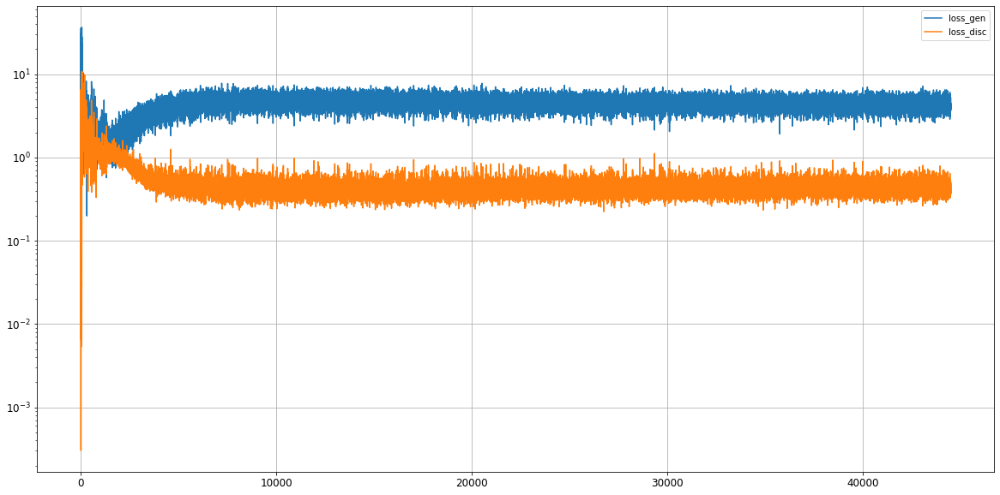

Epoch 44502/50000
0s
Epoch 44503/50000
0s
Epoch 44504/50000
0s
Epoch 44505/50000
0s
Epoch 44506/50000
0s
Epoch 44507/50000
0s
Epoch 44508/50000
0s
Epoch 44509/50000
0s
Epoch 44510/50000
0s
Epoch 44511/50000
0s
Epoch 44512/50000
0s
Epoch 44513/50000
0s
Epoch 44514/50000
0s
Epoch 44515/50000
0s
Epoch 44516/50000
0s
Epoch 44517/50000
0s
Epoch 44518/50000
0s
Epoch 44519/50000
0s
Epoch 44520/50000
0s
Epoch 44521/50000
0s
Epoch 44522/50000
0s
Epoch 44523/50000
0s
Epoch 44524/50000
0s
Epoch 44525/50000
0s
Epoch 44526/50000
0s
Epoch 44527/50000
0s
Epoch 44528/50000
0s
Epoch 44529/50000
0s
Epoch 44530/50000
0s
Epoch 44531/50000
0s
Epoch 44532/50000
0s
Epoch 44533/50000
0s
Epoch 44534/50000
0s
Epoch 44535/50000
0s
Epoch 44536/50000
0s
Epoch 44537/50000
0s
Epoch 44538/50000
0s
Epoch 44539/50000
0s
Epoch 44540/50000
0s
Epoch 44541/50000
0s
Epoch 44542/50000
0s
Epoch 44543/50000
0s
Epoch 44544/50000
0s
Epoch 44545/50000
0s
Epoch 44546/50000
0s
Epoch 44547/50000
0s
Epoch 44548/50000
0s
Epoch 44549/5

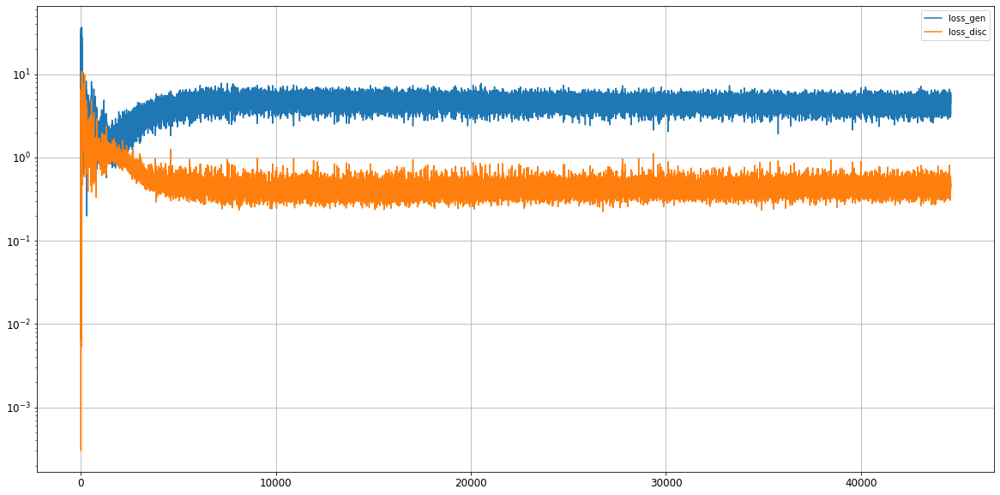

Epoch 44602/50000
0s
Epoch 44603/50000
0s
Epoch 44604/50000
0s
Epoch 44605/50000
0s
Epoch 44606/50000
0s
Epoch 44607/50000
0s
Epoch 44608/50000
0s
Epoch 44609/50000
0s
Epoch 44610/50000
0s
Epoch 44611/50000
0s
Epoch 44612/50000
0s
Epoch 44613/50000
0s
Epoch 44614/50000
0s
Epoch 44615/50000
0s
Epoch 44616/50000
0s
Epoch 44617/50000
0s
Epoch 44618/50000
0s
Epoch 44619/50000
0s
Epoch 44620/50000
0s
Epoch 44621/50000
0s
Epoch 44622/50000
0s
Epoch 44623/50000
0s
Epoch 44624/50000
0s
Epoch 44625/50000
0s
Epoch 44626/50000
0s
Epoch 44627/50000
0s
Epoch 44628/50000
0s
Epoch 44629/50000
0s
Epoch 44630/50000
0s
Epoch 44631/50000
0s
Epoch 44632/50000
0s
Epoch 44633/50000
0s
Epoch 44634/50000
0s
Epoch 44635/50000
0s
Epoch 44636/50000
0s
Epoch 44637/50000
0s
Epoch 44638/50000
0s
Epoch 44639/50000
0s
Epoch 44640/50000
0s
Epoch 44641/50000
0s
Epoch 44642/50000
0s
Epoch 44643/50000
0s
Epoch 44644/50000
0s
Epoch 44645/50000
0s
Epoch 44646/50000
0s
Epoch 44647/50000
0s
Epoch 44648/50000
0s
Epoch 44649/5

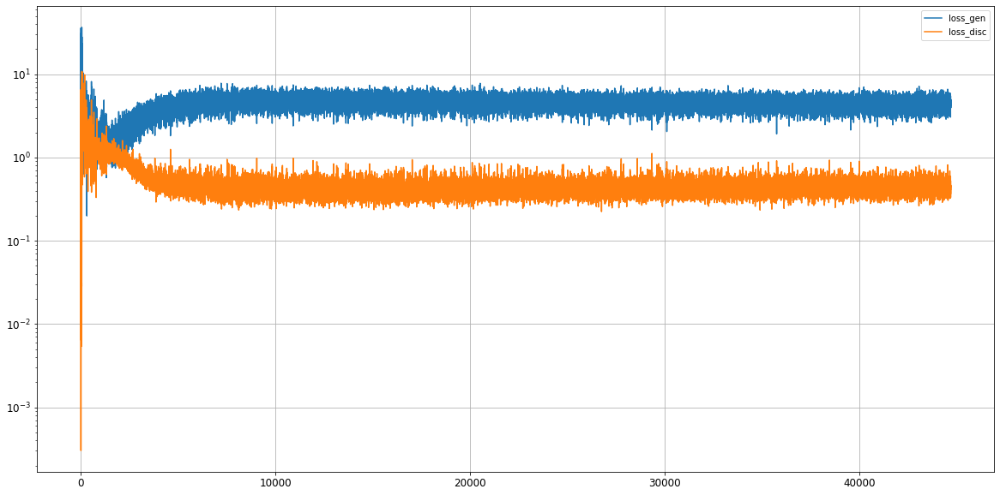

Epoch 44702/50000
0s
Epoch 44703/50000
0s
Epoch 44704/50000
0s
Epoch 44705/50000
0s
Epoch 44706/50000
0s
Epoch 44707/50000
0s
Epoch 44708/50000
0s
Epoch 44709/50000
0s
Epoch 44710/50000
0s
Epoch 44711/50000
0s
Epoch 44712/50000
0s
Epoch 44713/50000
0s
Epoch 44714/50000
0s
Epoch 44715/50000
0s
Epoch 44716/50000
0s
Epoch 44717/50000
0s
Epoch 44718/50000
0s
Epoch 44719/50000
0s
Epoch 44720/50000
0s
Epoch 44721/50000
0s
Epoch 44722/50000
0s
Epoch 44723/50000
0s
Epoch 44724/50000
0s
Epoch 44725/50000
0s
Epoch 44726/50000
0s
Epoch 44727/50000
0s
Epoch 44728/50000
0s
Epoch 44729/50000
0s
Epoch 44730/50000
0s
Epoch 44731/50000
0s
Epoch 44732/50000
0s
Epoch 44733/50000
0s
Epoch 44734/50000
0s
Epoch 44735/50000
0s
Epoch 44736/50000
0s
Epoch 44737/50000
0s
Epoch 44738/50000
0s
Epoch 44739/50000
0s
Epoch 44740/50000
0s
Epoch 44741/50000
0s
Epoch 44742/50000
0s
Epoch 44743/50000
0s
Epoch 44744/50000
0s
Epoch 44745/50000
0s
Epoch 44746/50000
0s
Epoch 44747/50000
0s
Epoch 44748/50000
0s
Epoch 44749/5

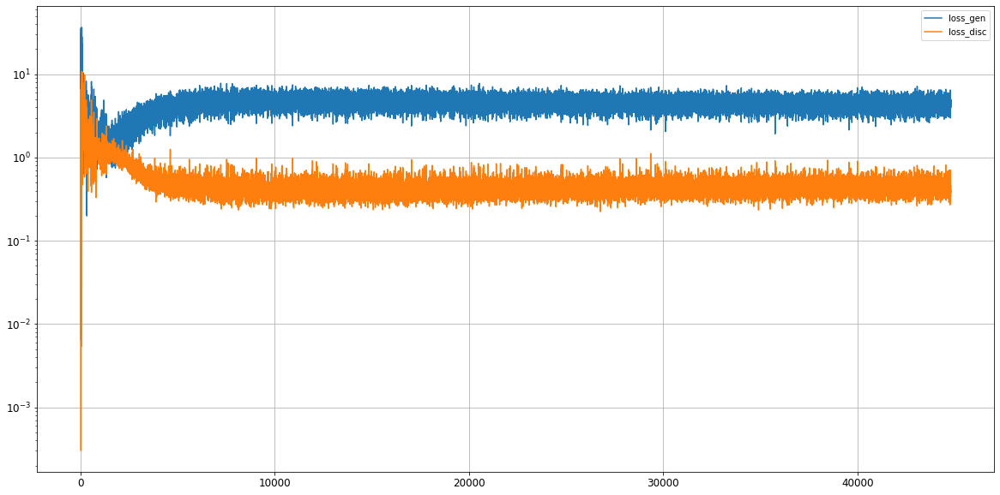

Epoch 44802/50000
0s
Epoch 44803/50000
0s
Epoch 44804/50000
0s
Epoch 44805/50000
0s
Epoch 44806/50000
0s
Epoch 44807/50000
0s
Epoch 44808/50000
0s
Epoch 44809/50000
0s
Epoch 44810/50000
0s
Epoch 44811/50000
0s
Epoch 44812/50000
0s
Epoch 44813/50000
0s
Epoch 44814/50000
0s
Epoch 44815/50000
0s
Epoch 44816/50000
0s
Epoch 44817/50000
0s
Epoch 44818/50000
0s
Epoch 44819/50000
0s
Epoch 44820/50000
0s
Epoch 44821/50000
0s
Epoch 44822/50000
0s
Epoch 44823/50000
0s
Epoch 44824/50000
0s
Epoch 44825/50000
0s
Epoch 44826/50000
0s
Epoch 44827/50000
0s
Epoch 44828/50000
0s
Epoch 44829/50000
0s
Epoch 44830/50000
0s
Epoch 44831/50000
0s
Epoch 44832/50000
0s
Epoch 44833/50000
0s
Epoch 44834/50000
0s
Epoch 44835/50000
0s
Epoch 44836/50000
0s
Epoch 44837/50000
0s
Epoch 44838/50000
0s
Epoch 44839/50000
0s
Epoch 44840/50000
0s
Epoch 44841/50000
0s
Epoch 44842/50000
0s
Epoch 44843/50000
0s
Epoch 44844/50000
0s
Epoch 44845/50000
0s
Epoch 44846/50000
0s
Epoch 44847/50000
0s
Epoch 44848/50000
0s
Epoch 44849/5

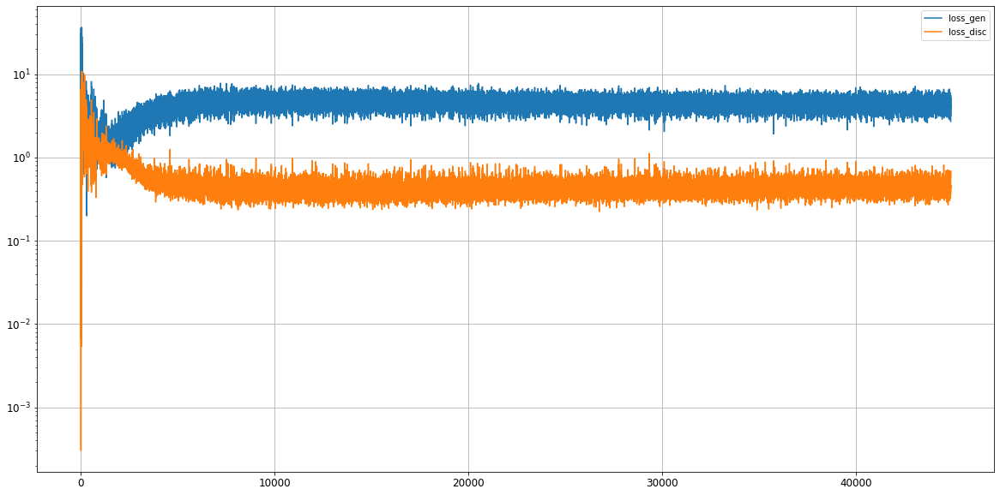

Epoch 44902/50000
0s
Epoch 44903/50000
0s
Epoch 44904/50000
0s
Epoch 44905/50000
0s
Epoch 44906/50000
0s
Epoch 44907/50000
0s
Epoch 44908/50000
0s
Epoch 44909/50000
0s
Epoch 44910/50000
0s
Epoch 44911/50000
0s
Epoch 44912/50000
0s
Epoch 44913/50000
0s
Epoch 44914/50000
0s
Epoch 44915/50000
0s
Epoch 44916/50000
0s
Epoch 44917/50000
0s
Epoch 44918/50000
0s
Epoch 44919/50000
0s
Epoch 44920/50000
0s
Epoch 44921/50000
0s
Epoch 44922/50000
0s
Epoch 44923/50000
0s
Epoch 44924/50000
0s
Epoch 44925/50000
0s
Epoch 44926/50000
0s
Epoch 44927/50000
0s
Epoch 44928/50000
0s
Epoch 44929/50000
0s
Epoch 44930/50000
0s
Epoch 44931/50000
0s
Epoch 44932/50000
0s
Epoch 44933/50000
0s
Epoch 44934/50000
0s
Epoch 44935/50000
0s
Epoch 44936/50000
0s
Epoch 44937/50000
0s
Epoch 44938/50000
0s
Epoch 44939/50000
0s
Epoch 44940/50000
0s
Epoch 44941/50000
0s
Epoch 44942/50000
0s
Epoch 44943/50000
0s
Epoch 44944/50000
0s
Epoch 44945/50000
0s
Epoch 44946/50000
0s
Epoch 44947/50000
0s
Epoch 44948/50000
0s
Epoch 44949/5

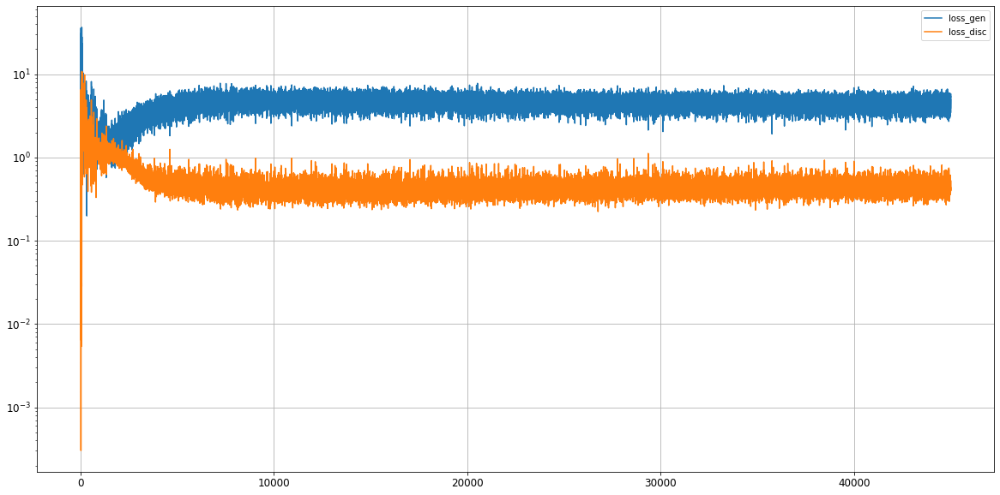

Epoch 45002/50000
0s
Epoch 45003/50000
0s
Epoch 45004/50000
0s
Epoch 45005/50000
0s
Epoch 45006/50000
0s
Epoch 45007/50000
0s
Epoch 45008/50000
0s
Epoch 45009/50000
0s
Epoch 45010/50000
0s
Epoch 45011/50000
0s
Epoch 45012/50000
0s
Epoch 45013/50000
0s
Epoch 45014/50000
0s
Epoch 45015/50000
0s
Epoch 45016/50000
0s
Epoch 45017/50000
0s
Epoch 45018/50000
0s
Epoch 45019/50000
0s
Epoch 45020/50000
0s
Epoch 45021/50000
0s
Epoch 45022/50000
0s
Epoch 45023/50000
0s
Epoch 45024/50000
0s
Epoch 45025/50000
0s
Epoch 45026/50000
0s
Epoch 45027/50000
0s
Epoch 45028/50000
0s
Epoch 45029/50000
0s
Epoch 45030/50000
0s
Epoch 45031/50000
0s
Epoch 45032/50000
0s
Epoch 45033/50000
0s
Epoch 45034/50000
0s
Epoch 45035/50000
0s
Epoch 45036/50000
0s
Epoch 45037/50000
0s
Epoch 45038/50000
0s
Epoch 45039/50000
0s
Epoch 45040/50000
0s
Epoch 45041/50000
0s
Epoch 45042/50000
0s
Epoch 45043/50000
0s
Epoch 45044/50000
0s
Epoch 45045/50000
0s
Epoch 45046/50000
0s
Epoch 45047/50000
0s
Epoch 45048/50000
0s
Epoch 45049/5

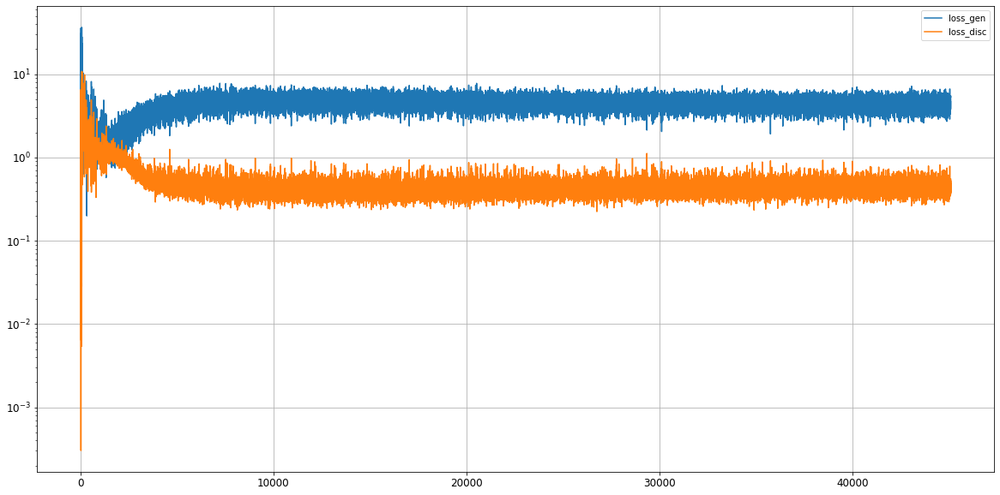

Epoch 45102/50000
0s
Epoch 45103/50000
0s
Epoch 45104/50000
0s
Epoch 45105/50000
0s
Epoch 45106/50000
0s
Epoch 45107/50000
0s
Epoch 45108/50000
0s
Epoch 45109/50000
0s
Epoch 45110/50000
0s
Epoch 45111/50000
0s
Epoch 45112/50000
0s
Epoch 45113/50000
0s
Epoch 45114/50000
0s
Epoch 45115/50000
0s
Epoch 45116/50000
0s
Epoch 45117/50000
0s
Epoch 45118/50000
0s
Epoch 45119/50000
0s
Epoch 45120/50000
0s
Epoch 45121/50000
0s
Epoch 45122/50000
0s
Epoch 45123/50000
0s
Epoch 45124/50000
0s
Epoch 45125/50000
0s
Epoch 45126/50000
0s
Epoch 45127/50000
0s
Epoch 45128/50000
0s
Epoch 45129/50000
0s
Epoch 45130/50000
0s
Epoch 45131/50000
0s
Epoch 45132/50000
0s
Epoch 45133/50000
0s
Epoch 45134/50000
0s
Epoch 45135/50000
0s
Epoch 45136/50000
0s
Epoch 45137/50000
0s
Epoch 45138/50000
0s
Epoch 45139/50000
0s
Epoch 45140/50000
0s
Epoch 45141/50000
0s
Epoch 45142/50000
0s
Epoch 45143/50000
0s
Epoch 45144/50000
0s
Epoch 45145/50000
0s
Epoch 45146/50000
0s
Epoch 45147/50000
0s
Epoch 45148/50000
0s
Epoch 45149/5

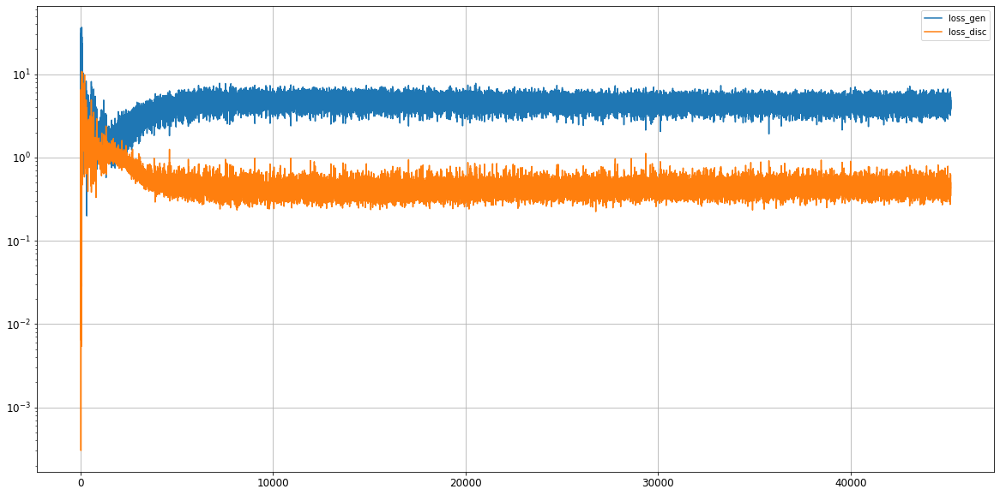

Epoch 45202/50000
0s
Epoch 45203/50000
0s
Epoch 45204/50000
0s
Epoch 45205/50000
0s
Epoch 45206/50000
0s
Epoch 45207/50000
0s
Epoch 45208/50000
0s
Epoch 45209/50000
0s
Epoch 45210/50000
0s
Epoch 45211/50000
0s
Epoch 45212/50000
0s
Epoch 45213/50000
0s
Epoch 45214/50000
0s
Epoch 45215/50000
0s
Epoch 45216/50000
0s
Epoch 45217/50000
0s
Epoch 45218/50000
0s
Epoch 45219/50000
0s
Epoch 45220/50000
0s
Epoch 45221/50000
0s
Epoch 45222/50000
0s
Epoch 45223/50000
0s
Epoch 45224/50000
0s
Epoch 45225/50000
0s
Epoch 45226/50000
0s
Epoch 45227/50000
0s
Epoch 45228/50000
0s
Epoch 45229/50000
0s
Epoch 45230/50000
0s
Epoch 45231/50000
0s
Epoch 45232/50000
0s
Epoch 45233/50000
0s
Epoch 45234/50000
0s
Epoch 45235/50000
0s
Epoch 45236/50000
0s
Epoch 45237/50000
0s
Epoch 45238/50000
0s
Epoch 45239/50000
0s
Epoch 45240/50000
0s
Epoch 45241/50000
0s
Epoch 45242/50000
0s
Epoch 45243/50000
0s
Epoch 45244/50000
0s
Epoch 45245/50000
0s
Epoch 45246/50000
0s
Epoch 45247/50000
0s
Epoch 45248/50000
0s
Epoch 45249/5

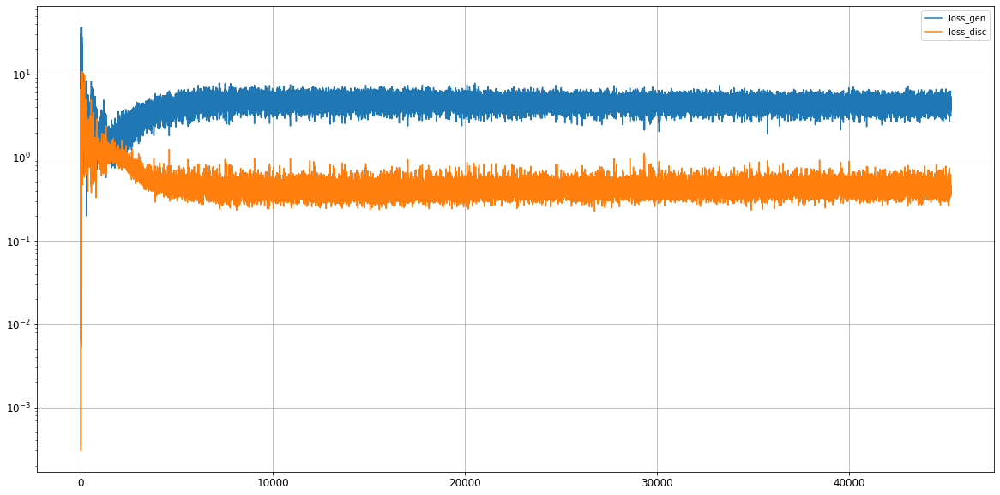

Epoch 45302/50000
0s
Epoch 45303/50000
0s
Epoch 45304/50000
0s
Epoch 45305/50000
0s
Epoch 45306/50000
0s
Epoch 45307/50000
0s
Epoch 45308/50000
0s
Epoch 45309/50000
0s
Epoch 45310/50000
0s
Epoch 45311/50000
0s
Epoch 45312/50000
0s
Epoch 45313/50000
0s
Epoch 45314/50000
0s
Epoch 45315/50000
0s
Epoch 45316/50000
0s
Epoch 45317/50000
0s
Epoch 45318/50000
0s
Epoch 45319/50000
0s
Epoch 45320/50000
0s
Epoch 45321/50000
0s
Epoch 45322/50000
0s
Epoch 45323/50000
0s
Epoch 45324/50000
0s
Epoch 45325/50000
0s
Epoch 45326/50000
0s
Epoch 45327/50000
0s
Epoch 45328/50000
0s
Epoch 45329/50000
0s
Epoch 45330/50000
0s
Epoch 45331/50000
0s
Epoch 45332/50000
0s
Epoch 45333/50000
0s
Epoch 45334/50000
0s
Epoch 45335/50000
0s
Epoch 45336/50000
0s
Epoch 45337/50000
0s
Epoch 45338/50000
0s
Epoch 45339/50000
0s
Epoch 45340/50000
0s
Epoch 45341/50000
0s
Epoch 45342/50000
0s
Epoch 45343/50000
0s
Epoch 45344/50000
0s
Epoch 45345/50000
0s
Epoch 45346/50000
0s
Epoch 45347/50000
0s
Epoch 45348/50000
0s
Epoch 45349/5

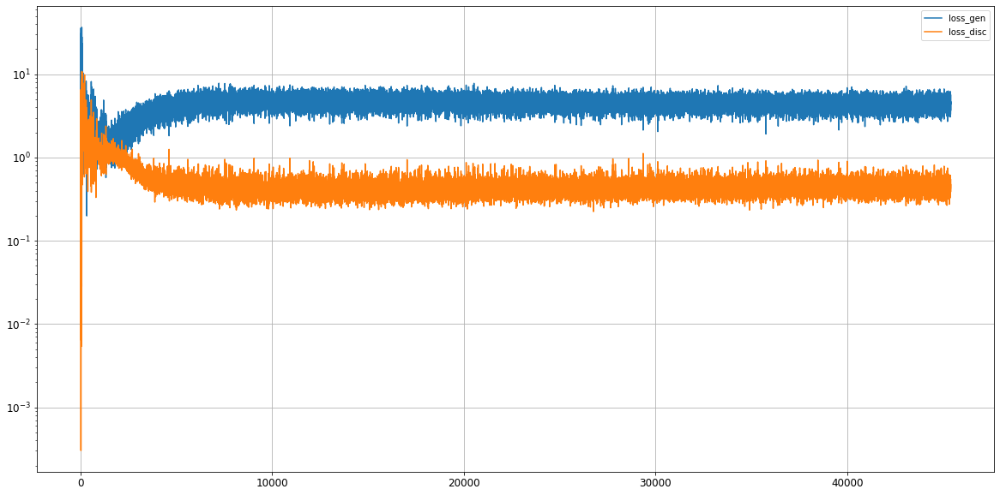

Epoch 45402/50000
0s
Epoch 45403/50000
0s
Epoch 45404/50000
0s
Epoch 45405/50000
0s
Epoch 45406/50000
0s
Epoch 45407/50000
0s
Epoch 45408/50000
0s
Epoch 45409/50000
0s
Epoch 45410/50000
0s
Epoch 45411/50000
0s
Epoch 45412/50000
0s
Epoch 45413/50000
0s
Epoch 45414/50000
0s
Epoch 45415/50000
0s
Epoch 45416/50000
0s
Epoch 45417/50000
0s
Epoch 45418/50000
0s
Epoch 45419/50000
0s
Epoch 45420/50000
0s
Epoch 45421/50000
0s
Epoch 45422/50000
0s
Epoch 45423/50000
0s
Epoch 45424/50000
0s
Epoch 45425/50000
0s
Epoch 45426/50000
0s
Epoch 45427/50000
0s
Epoch 45428/50000
0s
Epoch 45429/50000
0s
Epoch 45430/50000
0s
Epoch 45431/50000
0s
Epoch 45432/50000
0s
Epoch 45433/50000
0s
Epoch 45434/50000
0s
Epoch 45435/50000
0s
Epoch 45436/50000
0s
Epoch 45437/50000
0s
Epoch 45438/50000
0s
Epoch 45439/50000
0s
Epoch 45440/50000
0s
Epoch 45441/50000
0s
Epoch 45442/50000
0s
Epoch 45443/50000
0s
Epoch 45444/50000
0s
Epoch 45445/50000
0s
Epoch 45446/50000
0s
Epoch 45447/50000
0s
Epoch 45448/50000
0s
Epoch 45449/5

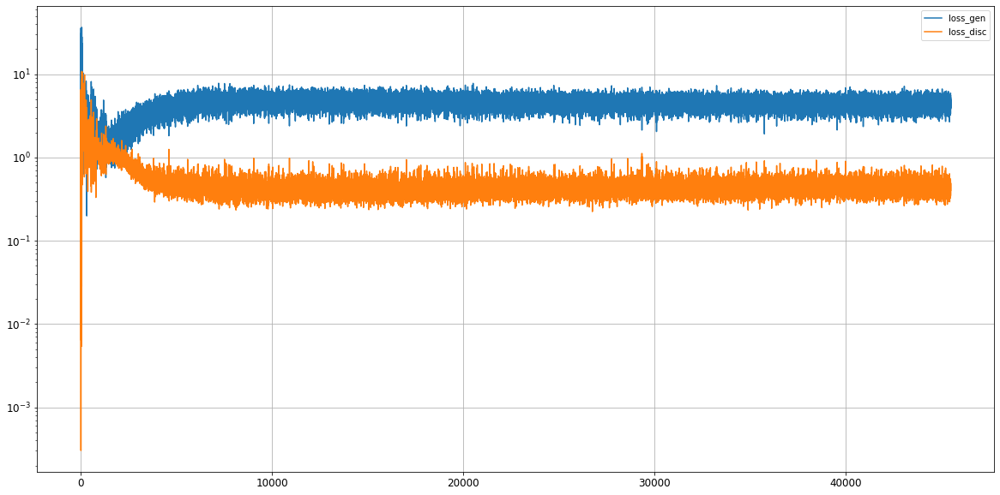

Epoch 45502/50000
0s
Epoch 45503/50000
0s
Epoch 45504/50000
0s
Epoch 45505/50000
0s
Epoch 45506/50000
0s
Epoch 45507/50000
0s
Epoch 45508/50000
0s
Epoch 45509/50000
0s
Epoch 45510/50000
0s
Epoch 45511/50000
0s
Epoch 45512/50000
0s
Epoch 45513/50000
0s
Epoch 45514/50000
0s
Epoch 45515/50000
0s
Epoch 45516/50000
0s
Epoch 45517/50000
0s
Epoch 45518/50000
0s
Epoch 45519/50000
0s
Epoch 45520/50000
0s
Epoch 45521/50000
0s
Epoch 45522/50000
0s
Epoch 45523/50000
0s
Epoch 45524/50000
0s
Epoch 45525/50000
0s
Epoch 45526/50000
0s
Epoch 45527/50000
0s
Epoch 45528/50000
0s
Epoch 45529/50000
0s
Epoch 45530/50000
0s
Epoch 45531/50000
0s
Epoch 45532/50000
0s
Epoch 45533/50000
0s
Epoch 45534/50000
0s
Epoch 45535/50000
0s
Epoch 45536/50000
0s
Epoch 45537/50000
0s
Epoch 45538/50000
0s
Epoch 45539/50000
0s
Epoch 45540/50000
0s
Epoch 45541/50000
0s
Epoch 45542/50000
0s
Epoch 45543/50000
0s
Epoch 45544/50000
0s
Epoch 45545/50000
0s
Epoch 45546/50000
0s
Epoch 45547/50000
0s
Epoch 45548/50000
0s
Epoch 45549/5

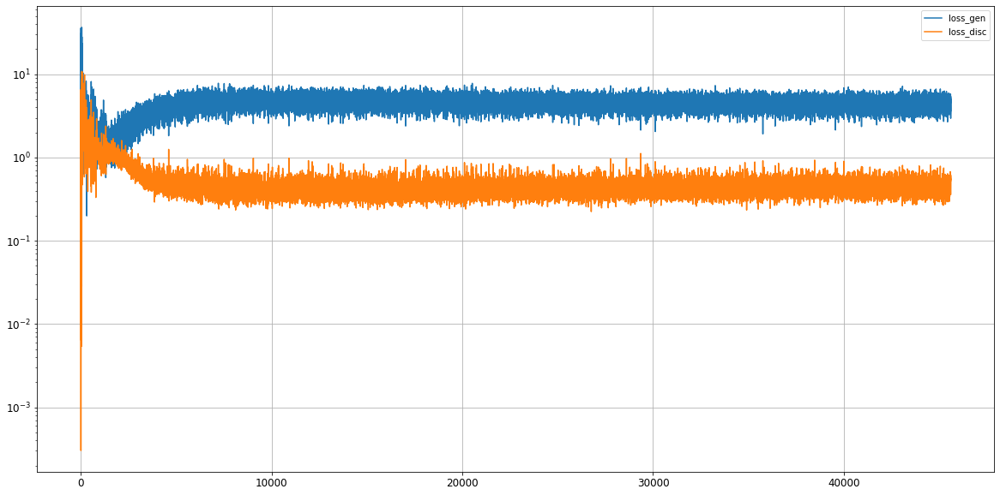

Epoch 45602/50000
0s
Epoch 45603/50000
0s
Epoch 45604/50000
0s
Epoch 45605/50000
0s
Epoch 45606/50000
0s
Epoch 45607/50000
0s
Epoch 45608/50000
0s
Epoch 45609/50000
0s
Epoch 45610/50000
0s
Epoch 45611/50000
0s
Epoch 45612/50000
0s
Epoch 45613/50000
0s
Epoch 45614/50000
0s
Epoch 45615/50000
0s
Epoch 45616/50000
0s
Epoch 45617/50000
0s
Epoch 45618/50000
0s
Epoch 45619/50000
0s
Epoch 45620/50000
0s
Epoch 45621/50000
0s
Epoch 45622/50000
0s
Epoch 45623/50000
0s
Epoch 45624/50000
0s
Epoch 45625/50000
0s
Epoch 45626/50000
0s
Epoch 45627/50000
0s
Epoch 45628/50000
0s
Epoch 45629/50000
0s
Epoch 45630/50000
0s
Epoch 45631/50000
0s
Epoch 45632/50000
0s
Epoch 45633/50000
0s
Epoch 45634/50000
0s
Epoch 45635/50000
0s
Epoch 45636/50000
0s
Epoch 45637/50000
0s
Epoch 45638/50000
0s
Epoch 45639/50000
0s
Epoch 45640/50000
0s
Epoch 45641/50000
0s
Epoch 45642/50000
0s
Epoch 45643/50000
0s
Epoch 45644/50000
0s
Epoch 45645/50000
0s
Epoch 45646/50000
0s
Epoch 45647/50000
0s
Epoch 45648/50000
0s
Epoch 45649/5

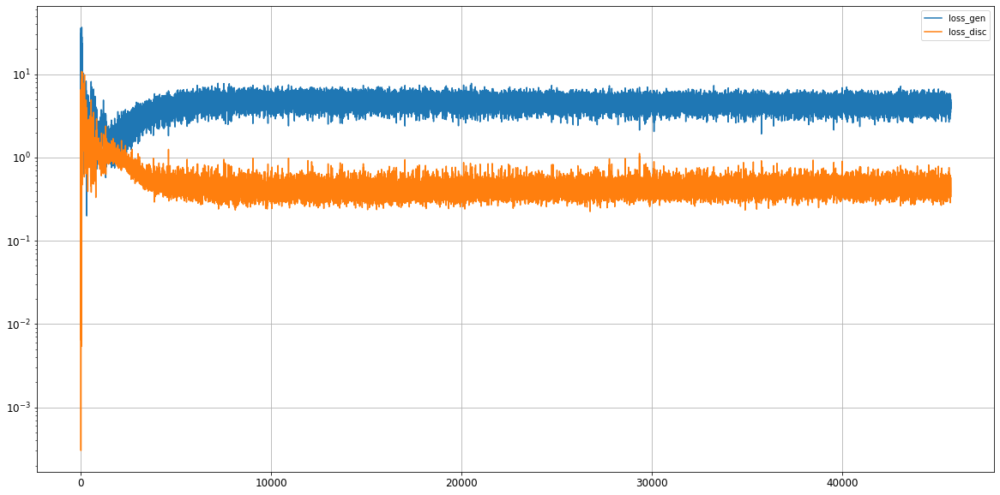

Epoch 45702/50000
0s
Epoch 45703/50000
0s
Epoch 45704/50000
0s
Epoch 45705/50000
0s
Epoch 45706/50000
0s
Epoch 45707/50000
0s
Epoch 45708/50000
0s
Epoch 45709/50000
0s
Epoch 45710/50000
0s
Epoch 45711/50000
0s
Epoch 45712/50000
0s
Epoch 45713/50000
0s
Epoch 45714/50000
0s
Epoch 45715/50000
0s
Epoch 45716/50000
0s
Epoch 45717/50000
0s
Epoch 45718/50000
0s
Epoch 45719/50000
0s
Epoch 45720/50000
0s
Epoch 45721/50000
0s
Epoch 45722/50000
0s
Epoch 45723/50000
0s
Epoch 45724/50000
0s
Epoch 45725/50000
0s
Epoch 45726/50000
0s
Epoch 45727/50000
0s
Epoch 45728/50000
0s
Epoch 45729/50000
0s
Epoch 45730/50000
0s
Epoch 45731/50000
0s
Epoch 45732/50000
0s
Epoch 45733/50000
0s
Epoch 45734/50000
0s
Epoch 45735/50000
0s
Epoch 45736/50000
0s
Epoch 45737/50000
0s
Epoch 45738/50000
0s
Epoch 45739/50000
0s
Epoch 45740/50000
0s
Epoch 45741/50000
0s
Epoch 45742/50000
0s
Epoch 45743/50000
0s
Epoch 45744/50000
0s
Epoch 45745/50000
0s
Epoch 45746/50000
0s
Epoch 45747/50000
0s
Epoch 45748/50000
0s
Epoch 45749/5

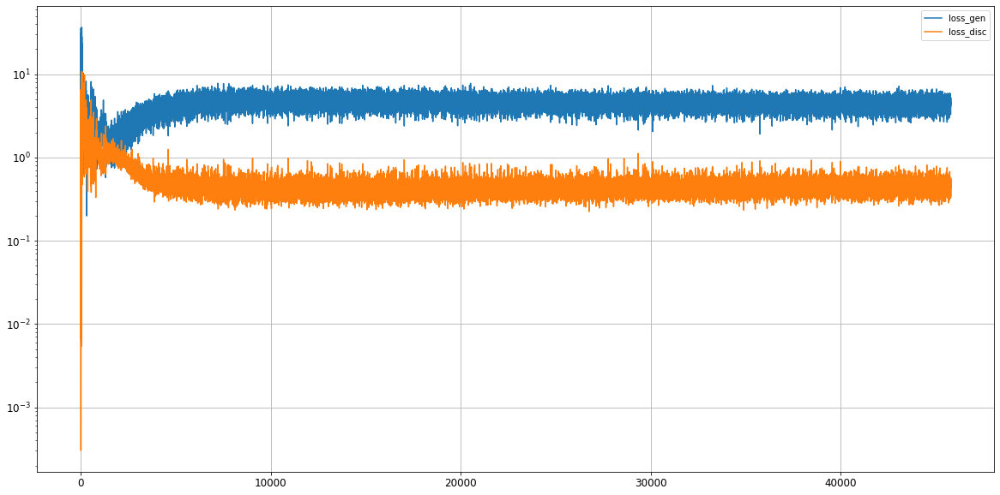

Epoch 45802/50000
0s
Epoch 45803/50000
0s
Epoch 45804/50000
0s
Epoch 45805/50000
0s
Epoch 45806/50000
0s
Epoch 45807/50000
0s
Epoch 45808/50000
0s
Epoch 45809/50000
0s
Epoch 45810/50000
0s
Epoch 45811/50000
0s
Epoch 45812/50000
0s
Epoch 45813/50000
0s
Epoch 45814/50000
0s
Epoch 45815/50000
0s
Epoch 45816/50000
0s
Epoch 45817/50000
0s
Epoch 45818/50000
0s
Epoch 45819/50000
0s
Epoch 45820/50000
0s
Epoch 45821/50000
0s
Epoch 45822/50000
0s
Epoch 45823/50000
0s
Epoch 45824/50000
0s
Epoch 45825/50000
0s
Epoch 45826/50000
0s
Epoch 45827/50000
0s
Epoch 45828/50000
0s
Epoch 45829/50000
0s
Epoch 45830/50000
0s
Epoch 45831/50000
0s
Epoch 45832/50000
0s
Epoch 45833/50000
0s
Epoch 45834/50000
0s
Epoch 45835/50000
0s
Epoch 45836/50000
0s
Epoch 45837/50000
0s
Epoch 45838/50000
0s
Epoch 45839/50000
0s
Epoch 45840/50000
0s
Epoch 45841/50000
0s
Epoch 45842/50000
0s
Epoch 45843/50000
0s
Epoch 45844/50000
0s
Epoch 45845/50000
0s
Epoch 45846/50000
0s
Epoch 45847/50000
0s
Epoch 45848/50000
0s
Epoch 45849/5

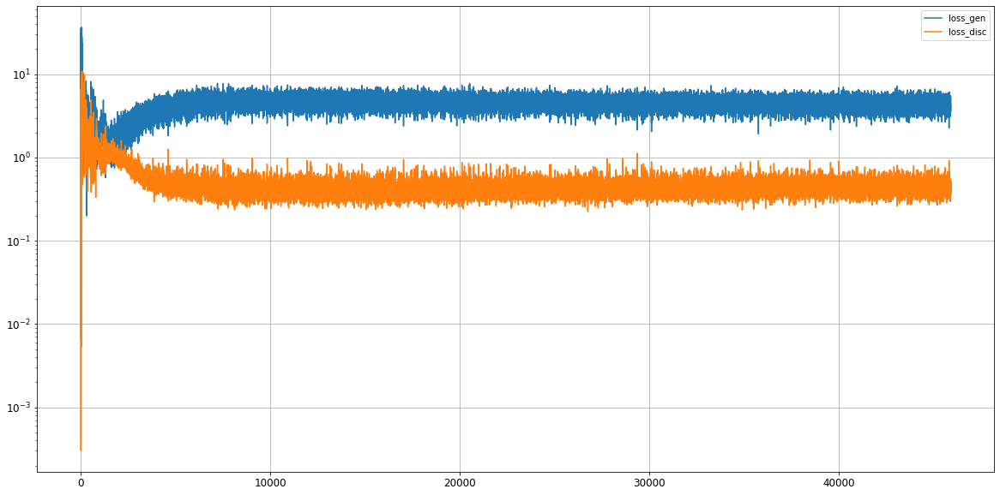

Epoch 45902/50000
0s
Epoch 45903/50000
0s
Epoch 45904/50000
0s
Epoch 45905/50000
0s
Epoch 45906/50000
0s
Epoch 45907/50000
0s
Epoch 45908/50000
0s
Epoch 45909/50000
0s
Epoch 45910/50000
0s
Epoch 45911/50000
0s
Epoch 45912/50000
0s
Epoch 45913/50000
0s
Epoch 45914/50000
0s
Epoch 45915/50000
0s
Epoch 45916/50000
0s
Epoch 45917/50000
0s
Epoch 45918/50000
0s
Epoch 45919/50000
0s
Epoch 45920/50000
0s
Epoch 45921/50000
0s
Epoch 45922/50000
0s
Epoch 45923/50000
0s
Epoch 45924/50000
0s
Epoch 45925/50000
0s
Epoch 45926/50000
0s
Epoch 45927/50000
0s
Epoch 45928/50000
0s
Epoch 45929/50000
0s
Epoch 45930/50000
0s
Epoch 45931/50000
0s
Epoch 45932/50000
0s
Epoch 45933/50000
0s
Epoch 45934/50000
0s
Epoch 45935/50000
0s
Epoch 45936/50000
0s
Epoch 45937/50000
0s
Epoch 45938/50000
0s
Epoch 45939/50000
0s
Epoch 45940/50000
0s
Epoch 45941/50000
0s
Epoch 45942/50000
0s
Epoch 45943/50000
0s
Epoch 45944/50000
0s
Epoch 45945/50000
0s
Epoch 45946/50000
0s
Epoch 45947/50000
0s
Epoch 45948/50000
0s
Epoch 45949/5

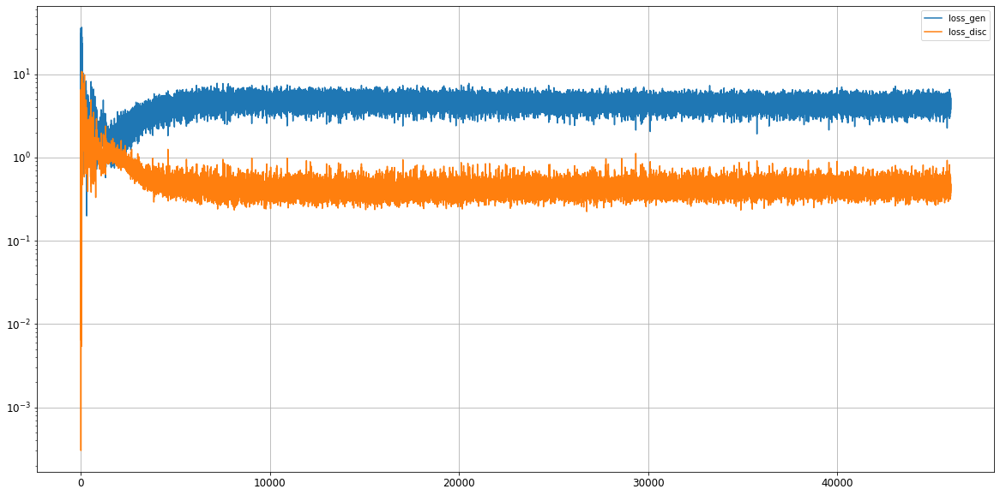

Epoch 46002/50000
0s
Epoch 46003/50000
0s
Epoch 46004/50000
0s
Epoch 46005/50000
0s
Epoch 46006/50000
0s
Epoch 46007/50000
0s
Epoch 46008/50000
0s
Epoch 46009/50000
0s
Epoch 46010/50000
0s
Epoch 46011/50000
0s
Epoch 46012/50000
0s
Epoch 46013/50000
0s
Epoch 46014/50000
0s
Epoch 46015/50000
0s
Epoch 46016/50000
0s
Epoch 46017/50000
0s
Epoch 46018/50000
0s
Epoch 46019/50000
0s
Epoch 46020/50000
0s
Epoch 46021/50000
0s
Epoch 46022/50000
0s
Epoch 46023/50000
0s
Epoch 46024/50000
0s
Epoch 46025/50000
0s
Epoch 46026/50000
0s
Epoch 46027/50000
0s
Epoch 46028/50000
0s
Epoch 46029/50000
0s
Epoch 46030/50000
0s
Epoch 46031/50000
0s
Epoch 46032/50000
0s
Epoch 46033/50000
0s
Epoch 46034/50000
0s
Epoch 46035/50000
0s
Epoch 46036/50000
0s
Epoch 46037/50000
0s
Epoch 46038/50000
0s
Epoch 46039/50000
0s
Epoch 46040/50000
0s
Epoch 46041/50000
0s
Epoch 46042/50000
0s
Epoch 46043/50000
0s
Epoch 46044/50000
0s
Epoch 46045/50000
0s
Epoch 46046/50000
0s
Epoch 46047/50000
0s
Epoch 46048/50000
0s
Epoch 46049/5

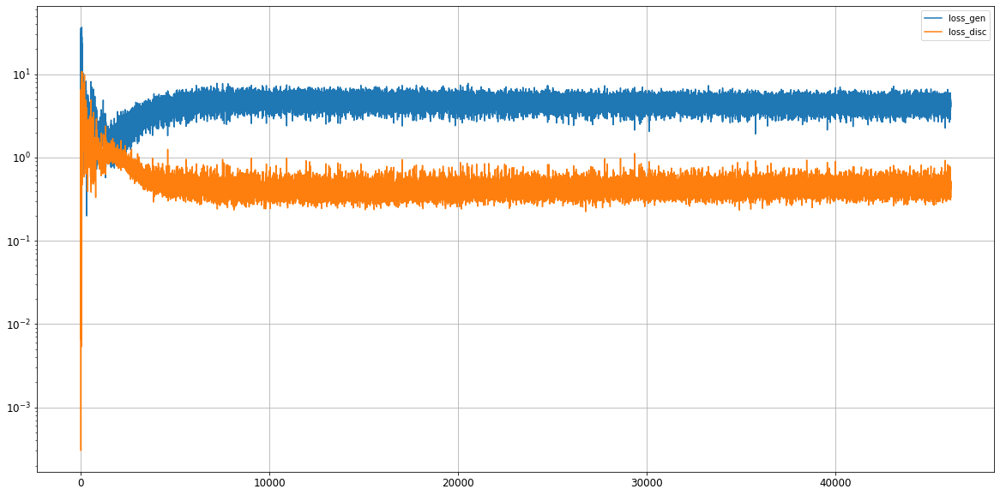

Epoch 46102/50000
0s
Epoch 46103/50000
0s
Epoch 46104/50000
0s
Epoch 46105/50000
0s
Epoch 46106/50000
0s
Epoch 46107/50000
0s
Epoch 46108/50000
0s
Epoch 46109/50000
0s
Epoch 46110/50000
0s
Epoch 46111/50000
0s
Epoch 46112/50000
0s
Epoch 46113/50000
0s
Epoch 46114/50000
0s
Epoch 46115/50000
0s
Epoch 46116/50000
0s
Epoch 46117/50000
0s
Epoch 46118/50000
0s
Epoch 46119/50000
0s
Epoch 46120/50000
0s
Epoch 46121/50000
0s
Epoch 46122/50000
0s
Epoch 46123/50000
0s
Epoch 46124/50000
0s
Epoch 46125/50000
0s
Epoch 46126/50000
0s
Epoch 46127/50000
0s
Epoch 46128/50000
0s
Epoch 46129/50000
0s
Epoch 46130/50000
0s
Epoch 46131/50000
0s
Epoch 46132/50000
0s
Epoch 46133/50000
0s
Epoch 46134/50000
0s
Epoch 46135/50000
0s
Epoch 46136/50000
0s
Epoch 46137/50000
0s
Epoch 46138/50000
0s
Epoch 46139/50000
0s
Epoch 46140/50000
0s
Epoch 46141/50000
0s
Epoch 46142/50000
0s
Epoch 46143/50000
0s
Epoch 46144/50000
0s
Epoch 46145/50000
0s
Epoch 46146/50000
0s
Epoch 46147/50000
0s
Epoch 46148/50000
0s
Epoch 46149/5

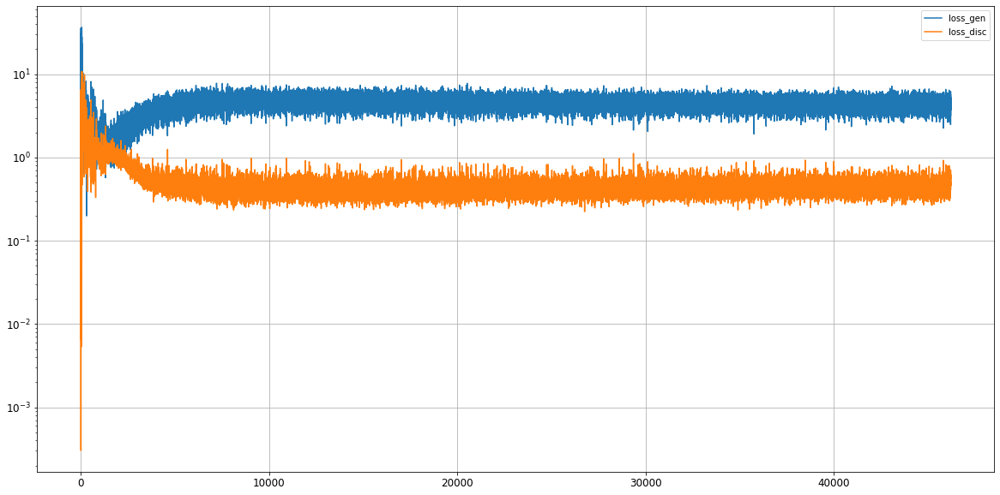

Epoch 46202/50000
0s
Epoch 46203/50000
0s
Epoch 46204/50000
0s
Epoch 46205/50000
0s
Epoch 46206/50000
0s
Epoch 46207/50000
0s
Epoch 46208/50000
0s
Epoch 46209/50000
0s
Epoch 46210/50000
0s
Epoch 46211/50000
0s
Epoch 46212/50000
0s
Epoch 46213/50000
0s
Epoch 46214/50000
0s
Epoch 46215/50000
0s
Epoch 46216/50000
0s
Epoch 46217/50000
0s
Epoch 46218/50000
0s
Epoch 46219/50000
0s
Epoch 46220/50000
0s
Epoch 46221/50000
0s
Epoch 46222/50000
0s
Epoch 46223/50000
0s
Epoch 46224/50000
0s
Epoch 46225/50000
0s
Epoch 46226/50000
0s
Epoch 46227/50000
0s
Epoch 46228/50000
0s
Epoch 46229/50000
0s
Epoch 46230/50000
0s
Epoch 46231/50000
0s
Epoch 46232/50000
0s
Epoch 46233/50000
0s
Epoch 46234/50000
0s
Epoch 46235/50000
0s
Epoch 46236/50000
0s
Epoch 46237/50000
0s
Epoch 46238/50000
0s
Epoch 46239/50000
0s
Epoch 46240/50000
0s
Epoch 46241/50000
0s
Epoch 46242/50000
0s
Epoch 46243/50000
0s
Epoch 46244/50000
0s
Epoch 46245/50000
0s
Epoch 46246/50000
0s
Epoch 46247/50000
0s
Epoch 46248/50000
0s
Epoch 46249/5

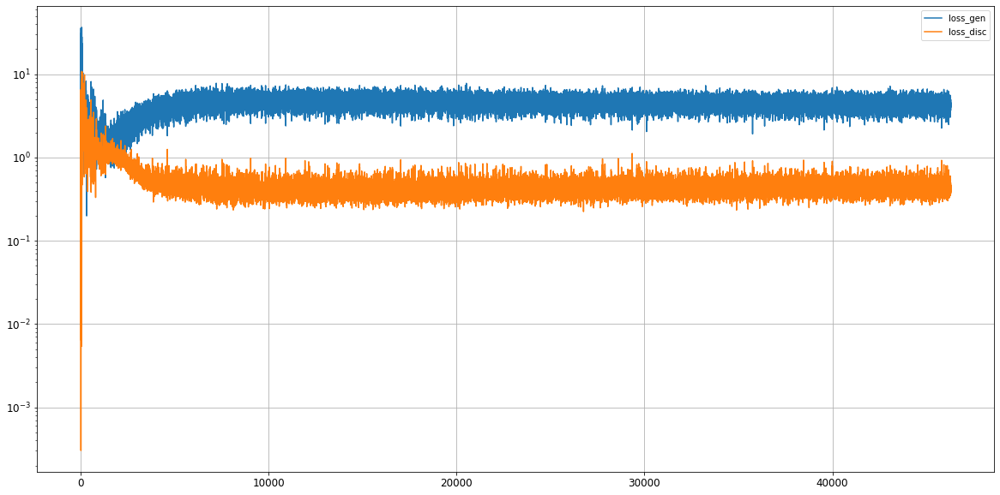

Epoch 46302/50000
0s
Epoch 46303/50000
0s
Epoch 46304/50000
0s
Epoch 46305/50000
0s
Epoch 46306/50000
0s
Epoch 46307/50000
0s
Epoch 46308/50000
0s
Epoch 46309/50000
0s
Epoch 46310/50000
0s
Epoch 46311/50000
0s
Epoch 46312/50000
0s
Epoch 46313/50000
0s
Epoch 46314/50000
0s
Epoch 46315/50000
0s
Epoch 46316/50000
0s
Epoch 46317/50000
0s
Epoch 46318/50000
0s
Epoch 46319/50000
0s
Epoch 46320/50000
0s
Epoch 46321/50000
0s
Epoch 46322/50000
0s
Epoch 46323/50000
0s
Epoch 46324/50000
0s
Epoch 46325/50000
0s
Epoch 46326/50000
0s
Epoch 46327/50000
0s
Epoch 46328/50000
0s
Epoch 46329/50000
0s
Epoch 46330/50000
0s
Epoch 46331/50000
0s
Epoch 46332/50000
0s
Epoch 46333/50000
0s
Epoch 46334/50000
0s
Epoch 46335/50000
0s
Epoch 46336/50000
0s
Epoch 46337/50000
0s
Epoch 46338/50000
0s
Epoch 46339/50000
0s
Epoch 46340/50000
0s
Epoch 46341/50000
0s
Epoch 46342/50000
0s
Epoch 46343/50000
0s
Epoch 46344/50000
0s
Epoch 46345/50000
0s
Epoch 46346/50000
0s
Epoch 46347/50000
0s
Epoch 46348/50000
0s
Epoch 46349/5

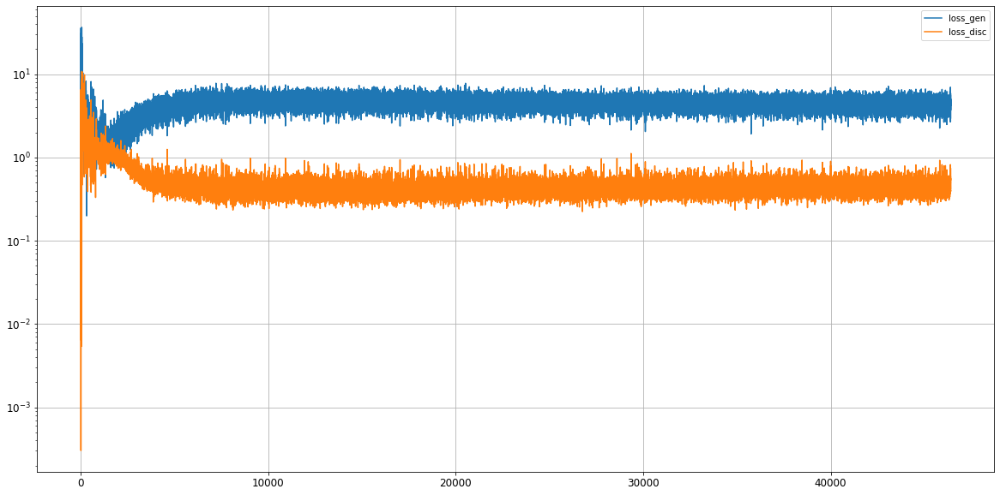

Epoch 46402/50000
0s
Epoch 46403/50000
0s
Epoch 46404/50000
0s
Epoch 46405/50000
0s
Epoch 46406/50000
0s
Epoch 46407/50000
0s
Epoch 46408/50000
0s
Epoch 46409/50000
0s
Epoch 46410/50000
0s
Epoch 46411/50000
0s
Epoch 46412/50000
0s
Epoch 46413/50000
0s
Epoch 46414/50000
0s
Epoch 46415/50000
0s
Epoch 46416/50000
0s
Epoch 46417/50000
0s
Epoch 46418/50000
0s
Epoch 46419/50000
0s
Epoch 46420/50000
0s
Epoch 46421/50000
0s
Epoch 46422/50000
0s
Epoch 46423/50000
0s
Epoch 46424/50000
0s
Epoch 46425/50000
0s
Epoch 46426/50000
0s
Epoch 46427/50000
0s
Epoch 46428/50000
0s
Epoch 46429/50000
0s
Epoch 46430/50000
0s
Epoch 46431/50000
0s
Epoch 46432/50000
0s
Epoch 46433/50000
0s
Epoch 46434/50000
0s
Epoch 46435/50000
0s
Epoch 46436/50000
0s
Epoch 46437/50000
0s
Epoch 46438/50000
0s
Epoch 46439/50000
0s
Epoch 46440/50000
0s
Epoch 46441/50000
0s
Epoch 46442/50000
0s
Epoch 46443/50000
0s
Epoch 46444/50000
0s
Epoch 46445/50000
0s
Epoch 46446/50000
0s
Epoch 46447/50000
0s
Epoch 46448/50000
0s
Epoch 46449/5

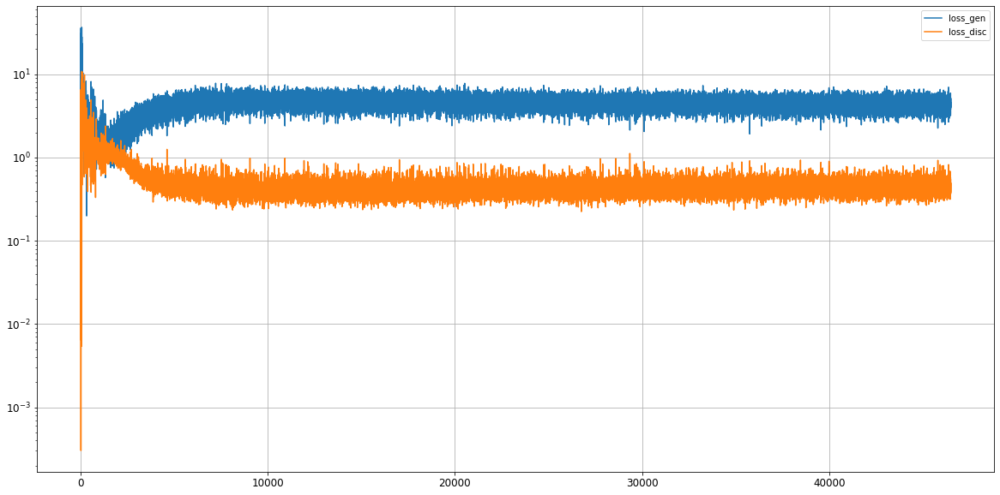

Epoch 46502/50000
0s
Epoch 46503/50000
0s
Epoch 46504/50000
0s
Epoch 46505/50000
0s
Epoch 46506/50000
0s
Epoch 46507/50000
0s
Epoch 46508/50000
0s
Epoch 46509/50000
0s
Epoch 46510/50000
0s
Epoch 46511/50000
0s
Epoch 46512/50000
0s
Epoch 46513/50000
0s
Epoch 46514/50000
0s
Epoch 46515/50000
0s
Epoch 46516/50000
0s
Epoch 46517/50000
0s
Epoch 46518/50000
0s
Epoch 46519/50000
0s
Epoch 46520/50000
0s
Epoch 46521/50000
0s
Epoch 46522/50000
0s
Epoch 46523/50000
0s
Epoch 46524/50000
0s
Epoch 46525/50000
0s
Epoch 46526/50000
0s
Epoch 46527/50000
0s
Epoch 46528/50000
0s
Epoch 46529/50000
0s
Epoch 46530/50000
0s
Epoch 46531/50000
0s
Epoch 46532/50000
0s
Epoch 46533/50000
0s
Epoch 46534/50000
0s
Epoch 46535/50000
0s
Epoch 46536/50000
0s
Epoch 46537/50000
0s
Epoch 46538/50000
0s
Epoch 46539/50000
0s
Epoch 46540/50000
0s
Epoch 46541/50000
0s
Epoch 46542/50000
0s
Epoch 46543/50000
0s
Epoch 46544/50000
0s
Epoch 46545/50000
0s
Epoch 46546/50000
0s
Epoch 46547/50000
0s
Epoch 46548/50000
0s
Epoch 46549/5

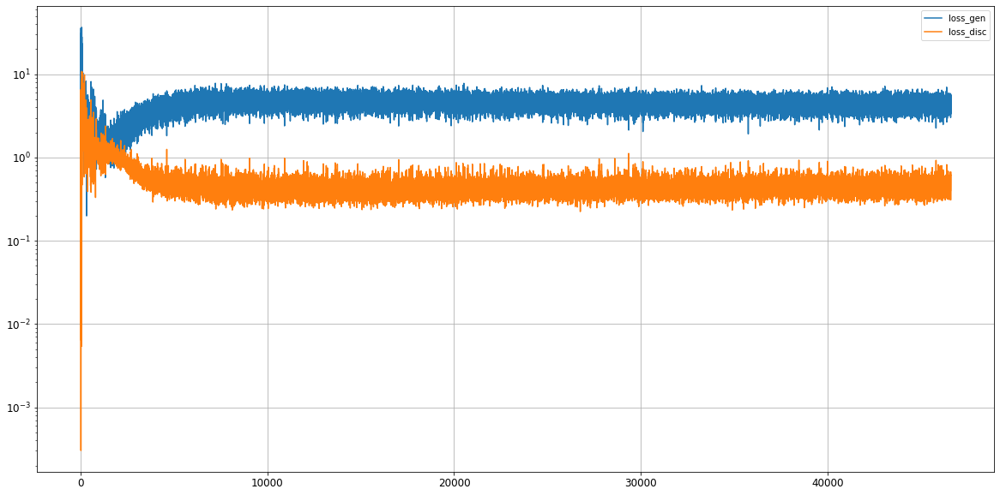

Epoch 46602/50000
0s
Epoch 46603/50000
0s
Epoch 46604/50000
0s
Epoch 46605/50000
0s
Epoch 46606/50000
0s
Epoch 46607/50000
0s
Epoch 46608/50000
0s
Epoch 46609/50000
0s
Epoch 46610/50000
0s
Epoch 46611/50000
0s
Epoch 46612/50000
0s
Epoch 46613/50000
0s
Epoch 46614/50000
0s
Epoch 46615/50000
0s
Epoch 46616/50000
0s
Epoch 46617/50000
0s
Epoch 46618/50000
0s
Epoch 46619/50000
0s
Epoch 46620/50000
0s
Epoch 46621/50000
0s
Epoch 46622/50000
0s
Epoch 46623/50000
0s
Epoch 46624/50000
0s
Epoch 46625/50000
0s
Epoch 46626/50000
0s
Epoch 46627/50000
0s
Epoch 46628/50000
0s
Epoch 46629/50000
0s
Epoch 46630/50000
0s
Epoch 46631/50000
0s
Epoch 46632/50000
0s
Epoch 46633/50000
0s
Epoch 46634/50000
0s
Epoch 46635/50000
0s
Epoch 46636/50000
0s
Epoch 46637/50000
0s
Epoch 46638/50000
0s
Epoch 46639/50000
0s
Epoch 46640/50000
0s
Epoch 46641/50000
0s
Epoch 46642/50000
0s
Epoch 46643/50000
0s
Epoch 46644/50000
0s
Epoch 46645/50000
0s
Epoch 46646/50000
0s
Epoch 46647/50000
0s
Epoch 46648/50000
0s
Epoch 46649/5

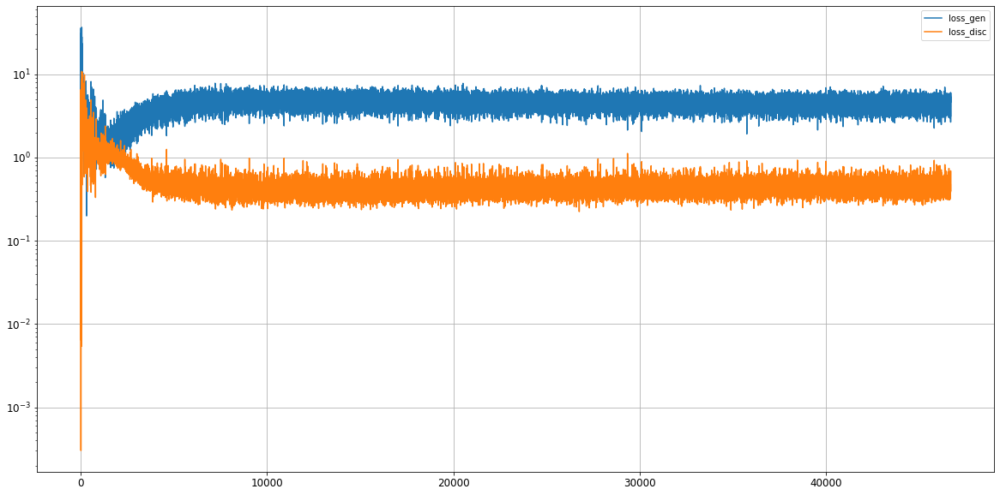

Epoch 46702/50000
0s
Epoch 46703/50000
0s
Epoch 46704/50000
0s
Epoch 46705/50000
0s
Epoch 46706/50000
0s
Epoch 46707/50000
0s
Epoch 46708/50000
0s
Epoch 46709/50000
0s
Epoch 46710/50000
0s
Epoch 46711/50000
0s
Epoch 46712/50000
0s
Epoch 46713/50000
0s
Epoch 46714/50000
0s
Epoch 46715/50000
0s
Epoch 46716/50000
0s
Epoch 46717/50000
0s
Epoch 46718/50000
0s
Epoch 46719/50000
0s
Epoch 46720/50000
0s
Epoch 46721/50000
0s
Epoch 46722/50000
0s
Epoch 46723/50000
0s
Epoch 46724/50000
0s
Epoch 46725/50000
0s
Epoch 46726/50000
0s
Epoch 46727/50000
0s
Epoch 46728/50000
0s
Epoch 46729/50000
0s
Epoch 46730/50000
0s
Epoch 46731/50000
0s
Epoch 46732/50000
0s
Epoch 46733/50000
0s
Epoch 46734/50000
0s
Epoch 46735/50000
0s
Epoch 46736/50000
0s
Epoch 46737/50000
0s
Epoch 46738/50000
0s
Epoch 46739/50000
0s
Epoch 46740/50000
0s
Epoch 46741/50000
0s
Epoch 46742/50000
0s
Epoch 46743/50000
0s
Epoch 46744/50000
0s
Epoch 46745/50000
0s
Epoch 46746/50000
0s
Epoch 46747/50000
0s
Epoch 46748/50000
0s
Epoch 46749/5

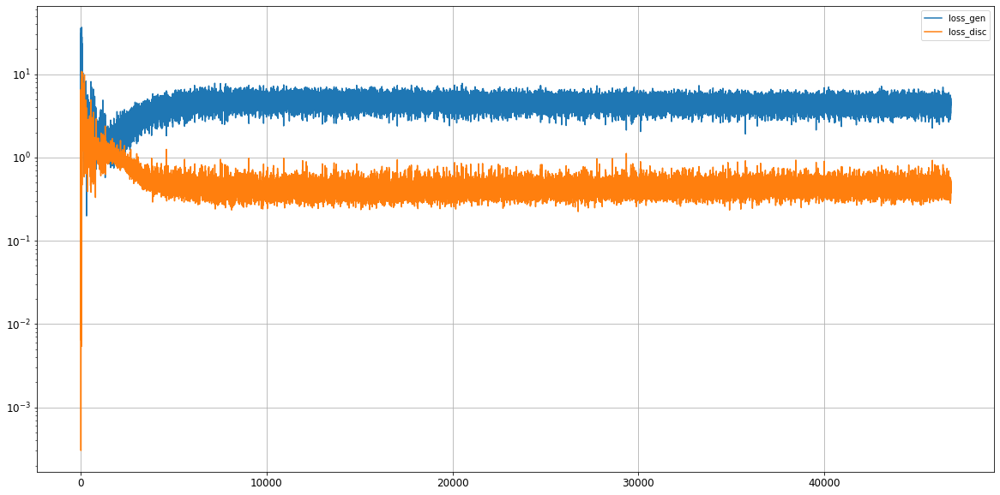

Epoch 46802/50000
0s
Epoch 46803/50000
0s
Epoch 46804/50000
0s
Epoch 46805/50000
0s
Epoch 46806/50000
0s
Epoch 46807/50000
0s
Epoch 46808/50000
0s
Epoch 46809/50000
0s
Epoch 46810/50000
0s
Epoch 46811/50000
0s
Epoch 46812/50000
0s
Epoch 46813/50000
0s
Epoch 46814/50000
0s
Epoch 46815/50000
0s
Epoch 46816/50000
0s
Epoch 46817/50000
0s
Epoch 46818/50000
0s
Epoch 46819/50000
0s
Epoch 46820/50000
0s
Epoch 46821/50000
0s
Epoch 46822/50000
0s
Epoch 46823/50000
0s
Epoch 46824/50000
0s
Epoch 46825/50000
0s
Epoch 46826/50000
0s
Epoch 46827/50000
0s
Epoch 46828/50000
0s
Epoch 46829/50000
0s
Epoch 46830/50000
0s
Epoch 46831/50000
0s
Epoch 46832/50000
0s
Epoch 46833/50000
0s
Epoch 46834/50000
0s
Epoch 46835/50000
0s
Epoch 46836/50000
0s
Epoch 46837/50000
0s
Epoch 46838/50000
0s
Epoch 46839/50000
0s
Epoch 46840/50000
0s
Epoch 46841/50000
0s
Epoch 46842/50000
0s
Epoch 46843/50000
0s
Epoch 46844/50000
0s
Epoch 46845/50000
0s
Epoch 46846/50000
0s
Epoch 46847/50000
0s
Epoch 46848/50000
0s
Epoch 46849/5

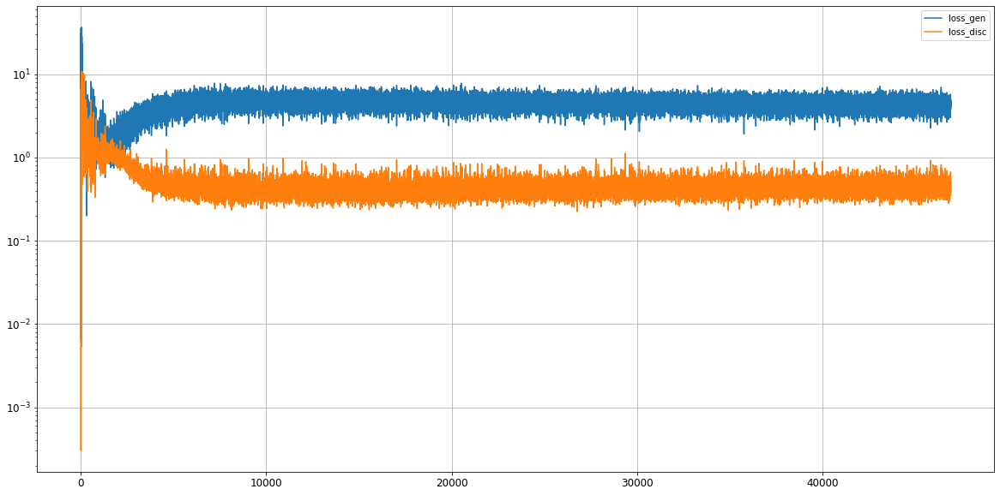

Epoch 46902/50000
0s
Epoch 46903/50000
0s
Epoch 46904/50000
0s
Epoch 46905/50000
0s
Epoch 46906/50000
0s
Epoch 46907/50000
0s
Epoch 46908/50000
0s
Epoch 46909/50000
0s
Epoch 46910/50000
0s
Epoch 46911/50000
0s
Epoch 46912/50000
0s
Epoch 46913/50000
0s
Epoch 46914/50000
0s
Epoch 46915/50000
0s
Epoch 46916/50000
0s
Epoch 46917/50000
0s
Epoch 46918/50000
0s
Epoch 46919/50000
0s
Epoch 46920/50000
0s
Epoch 46921/50000
0s
Epoch 46922/50000
0s
Epoch 46923/50000
0s
Epoch 46924/50000
0s
Epoch 46925/50000
0s
Epoch 46926/50000
0s
Epoch 46927/50000
0s
Epoch 46928/50000
0s
Epoch 46929/50000
0s
Epoch 46930/50000
0s
Epoch 46931/50000
0s
Epoch 46932/50000
0s
Epoch 46933/50000
0s
Epoch 46934/50000
0s
Epoch 46935/50000
0s
Epoch 46936/50000
0s
Epoch 46937/50000
0s
Epoch 46938/50000
0s
Epoch 46939/50000
0s
Epoch 46940/50000
0s
Epoch 46941/50000
0s
Epoch 46942/50000
0s
Epoch 46943/50000
0s
Epoch 46944/50000
0s
Epoch 46945/50000
0s
Epoch 46946/50000
0s
Epoch 46947/50000
0s
Epoch 46948/50000
0s
Epoch 46949/5

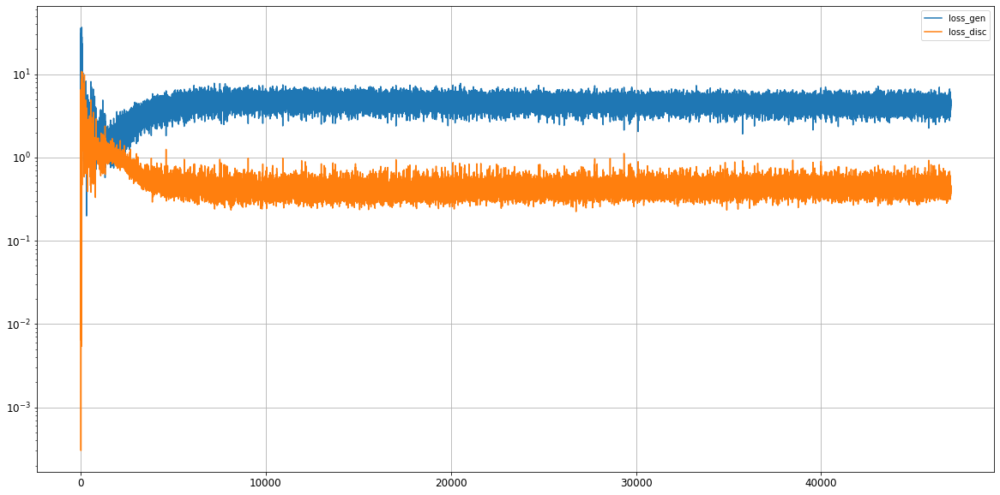

Epoch 47002/50000
0s
Epoch 47003/50000
0s
Epoch 47004/50000
0s
Epoch 47005/50000
0s
Epoch 47006/50000
0s
Epoch 47007/50000
0s
Epoch 47008/50000
0s
Epoch 47009/50000
0s
Epoch 47010/50000
0s
Epoch 47011/50000
0s
Epoch 47012/50000
0s
Epoch 47013/50000
0s
Epoch 47014/50000
0s
Epoch 47015/50000
0s
Epoch 47016/50000
0s
Epoch 47017/50000
0s
Epoch 47018/50000
0s
Epoch 47019/50000
0s
Epoch 47020/50000
0s
Epoch 47021/50000
0s
Epoch 47022/50000
0s
Epoch 47023/50000
0s
Epoch 47024/50000
0s
Epoch 47025/50000
0s
Epoch 47026/50000
0s
Epoch 47027/50000
0s
Epoch 47028/50000
0s
Epoch 47029/50000
0s
Epoch 47030/50000
0s
Epoch 47031/50000
0s
Epoch 47032/50000
0s
Epoch 47033/50000
0s
Epoch 47034/50000
0s
Epoch 47035/50000
0s
Epoch 47036/50000
0s
Epoch 47037/50000
0s
Epoch 47038/50000
0s
Epoch 47039/50000
0s
Epoch 47040/50000
0s
Epoch 47041/50000
0s
Epoch 47042/50000
0s
Epoch 47043/50000
0s
Epoch 47044/50000
0s
Epoch 47045/50000
0s
Epoch 47046/50000
0s
Epoch 47047/50000
0s
Epoch 47048/50000
0s
Epoch 47049/5

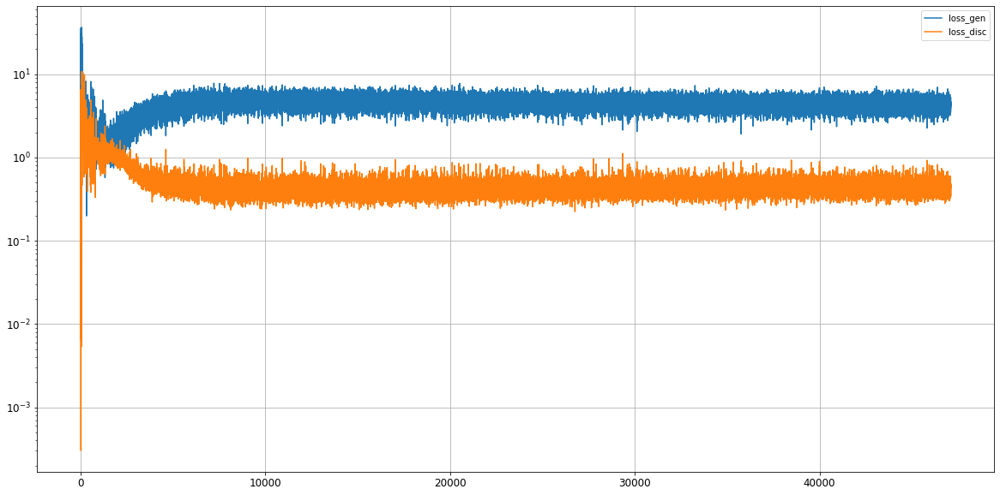

Epoch 47102/50000
0s
Epoch 47103/50000
0s
Epoch 47104/50000
0s
Epoch 47105/50000
0s
Epoch 47106/50000
0s
Epoch 47107/50000
0s
Epoch 47108/50000
0s
Epoch 47109/50000
0s
Epoch 47110/50000
0s
Epoch 47111/50000
0s
Epoch 47112/50000
0s
Epoch 47113/50000
0s
Epoch 47114/50000
0s
Epoch 47115/50000
0s
Epoch 47116/50000
0s
Epoch 47117/50000
0s
Epoch 47118/50000
0s
Epoch 47119/50000
0s
Epoch 47120/50000
0s
Epoch 47121/50000
0s
Epoch 47122/50000
0s
Epoch 47123/50000
0s
Epoch 47124/50000
0s
Epoch 47125/50000
0s
Epoch 47126/50000
0s
Epoch 47127/50000
0s
Epoch 47128/50000
0s
Epoch 47129/50000
0s
Epoch 47130/50000
0s
Epoch 47131/50000
0s
Epoch 47132/50000
0s
Epoch 47133/50000
0s
Epoch 47134/50000
0s
Epoch 47135/50000
0s
Epoch 47136/50000
0s
Epoch 47137/50000
0s
Epoch 47138/50000
0s
Epoch 47139/50000
0s
Epoch 47140/50000
0s
Epoch 47141/50000
0s
Epoch 47142/50000
0s
Epoch 47143/50000
0s
Epoch 47144/50000
0s
Epoch 47145/50000
0s
Epoch 47146/50000
0s
Epoch 47147/50000
0s
Epoch 47148/50000
0s
Epoch 47149/5

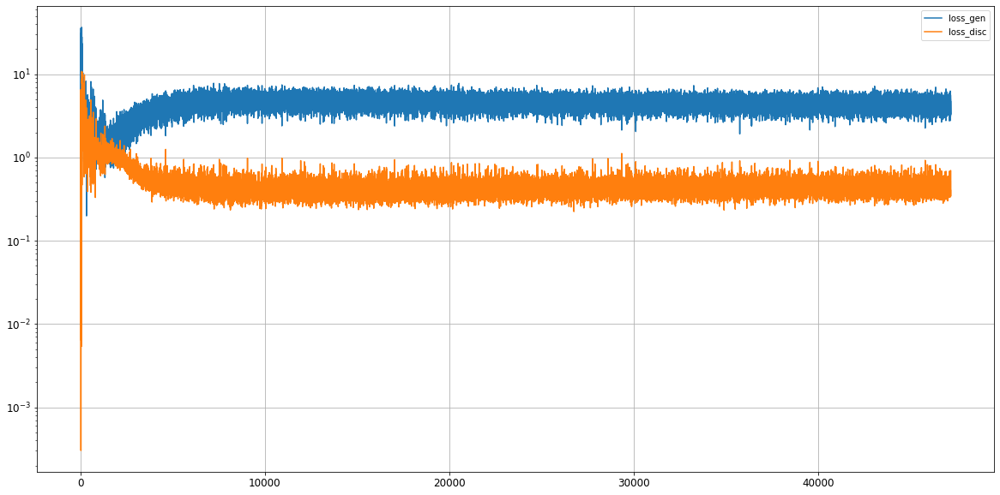

Epoch 47202/50000
0s
Epoch 47203/50000
0s
Epoch 47204/50000
0s
Epoch 47205/50000
0s
Epoch 47206/50000
0s
Epoch 47207/50000
0s
Epoch 47208/50000
0s
Epoch 47209/50000
0s
Epoch 47210/50000
0s
Epoch 47211/50000
0s
Epoch 47212/50000
0s
Epoch 47213/50000
0s
Epoch 47214/50000
0s
Epoch 47215/50000
0s
Epoch 47216/50000
0s
Epoch 47217/50000
0s
Epoch 47218/50000
0s
Epoch 47219/50000
0s
Epoch 47220/50000
0s
Epoch 47221/50000
0s
Epoch 47222/50000
0s
Epoch 47223/50000
0s
Epoch 47224/50000
0s
Epoch 47225/50000
0s
Epoch 47226/50000
0s
Epoch 47227/50000
0s
Epoch 47228/50000
0s
Epoch 47229/50000
0s
Epoch 47230/50000
0s
Epoch 47231/50000
0s
Epoch 47232/50000
0s
Epoch 47233/50000
0s
Epoch 47234/50000
0s
Epoch 47235/50000
0s
Epoch 47236/50000
0s
Epoch 47237/50000
0s
Epoch 47238/50000
0s
Epoch 47239/50000
0s
Epoch 47240/50000
0s
Epoch 47241/50000
0s
Epoch 47242/50000
0s
Epoch 47243/50000
0s
Epoch 47244/50000
0s
Epoch 47245/50000
0s
Epoch 47246/50000
0s
Epoch 47247/50000
0s
Epoch 47248/50000
0s
Epoch 47249/5

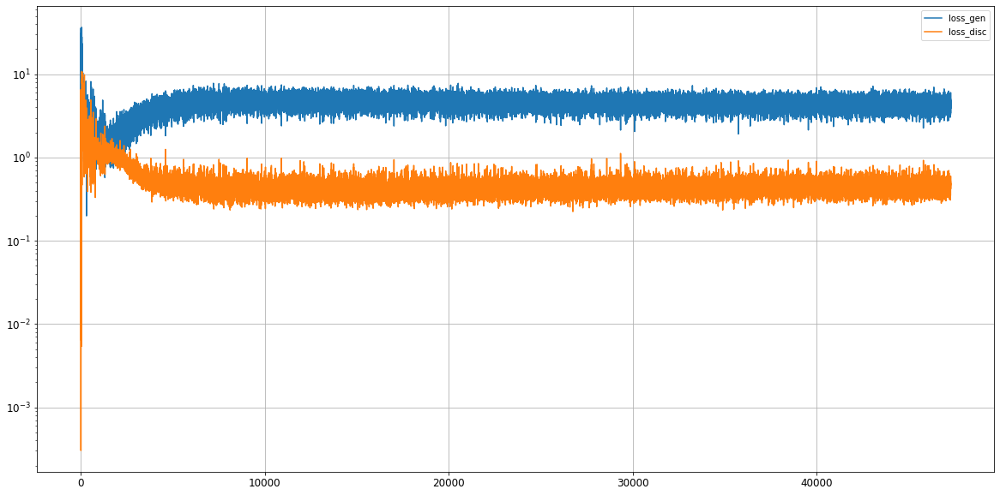

Epoch 47302/50000
0s
Epoch 47303/50000
0s
Epoch 47304/50000
0s
Epoch 47305/50000
0s
Epoch 47306/50000
0s
Epoch 47307/50000
0s
Epoch 47308/50000
0s
Epoch 47309/50000
0s
Epoch 47310/50000
0s
Epoch 47311/50000
0s
Epoch 47312/50000
0s
Epoch 47313/50000
0s
Epoch 47314/50000
0s
Epoch 47315/50000
0s
Epoch 47316/50000
0s
Epoch 47317/50000
0s
Epoch 47318/50000
0s
Epoch 47319/50000
0s
Epoch 47320/50000
0s
Epoch 47321/50000
0s
Epoch 47322/50000
0s
Epoch 47323/50000
0s
Epoch 47324/50000
0s
Epoch 47325/50000
0s
Epoch 47326/50000
0s
Epoch 47327/50000
0s
Epoch 47328/50000
0s
Epoch 47329/50000
0s
Epoch 47330/50000
0s
Epoch 47331/50000
0s
Epoch 47332/50000
0s
Epoch 47333/50000
0s
Epoch 47334/50000
0s
Epoch 47335/50000
0s
Epoch 47336/50000
0s
Epoch 47337/50000
0s
Epoch 47338/50000
0s
Epoch 47339/50000
0s
Epoch 47340/50000
0s
Epoch 47341/50000
0s
Epoch 47342/50000
0s
Epoch 47343/50000
0s
Epoch 47344/50000
0s
Epoch 47345/50000
0s
Epoch 47346/50000
0s
Epoch 47347/50000
0s
Epoch 47348/50000
0s
Epoch 47349/5

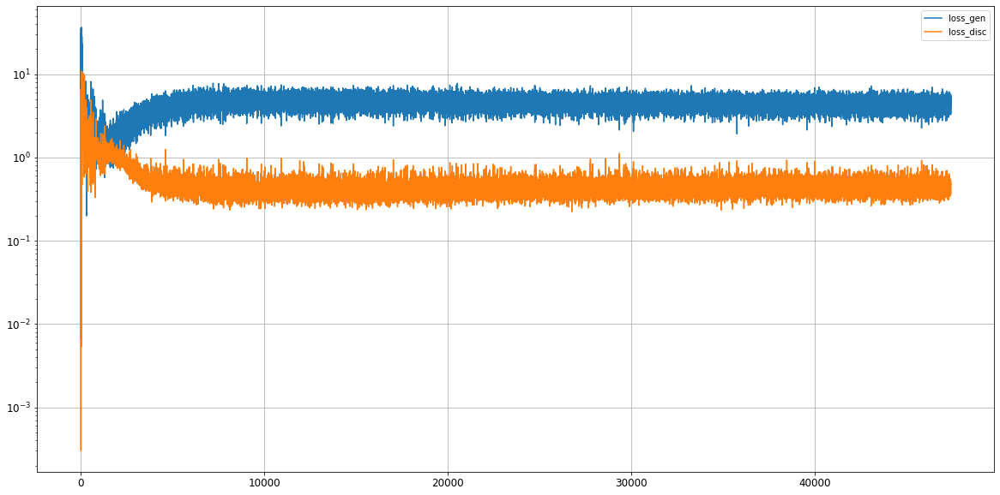

Epoch 47402/50000
0s
Epoch 47403/50000
0s
Epoch 47404/50000
0s
Epoch 47405/50000
0s
Epoch 47406/50000
0s
Epoch 47407/50000
0s
Epoch 47408/50000
0s
Epoch 47409/50000
0s
Epoch 47410/50000
0s
Epoch 47411/50000
0s
Epoch 47412/50000
0s
Epoch 47413/50000
0s
Epoch 47414/50000
0s
Epoch 47415/50000
0s
Epoch 47416/50000
0s
Epoch 47417/50000
0s
Epoch 47418/50000
0s
Epoch 47419/50000
0s
Epoch 47420/50000
0s
Epoch 47421/50000
0s
Epoch 47422/50000
0s
Epoch 47423/50000
0s
Epoch 47424/50000
0s
Epoch 47425/50000
0s
Epoch 47426/50000
0s
Epoch 47427/50000
0s
Epoch 47428/50000
0s
Epoch 47429/50000
0s
Epoch 47430/50000
0s
Epoch 47431/50000
0s
Epoch 47432/50000
0s
Epoch 47433/50000
0s
Epoch 47434/50000
0s
Epoch 47435/50000
0s
Epoch 47436/50000
0s
Epoch 47437/50000
0s
Epoch 47438/50000
0s
Epoch 47439/50000
0s
Epoch 47440/50000
0s
Epoch 47441/50000
0s
Epoch 47442/50000
0s
Epoch 47443/50000
0s
Epoch 47444/50000
0s
Epoch 47445/50000
0s
Epoch 47446/50000
0s
Epoch 47447/50000
0s
Epoch 47448/50000
0s
Epoch 47449/5

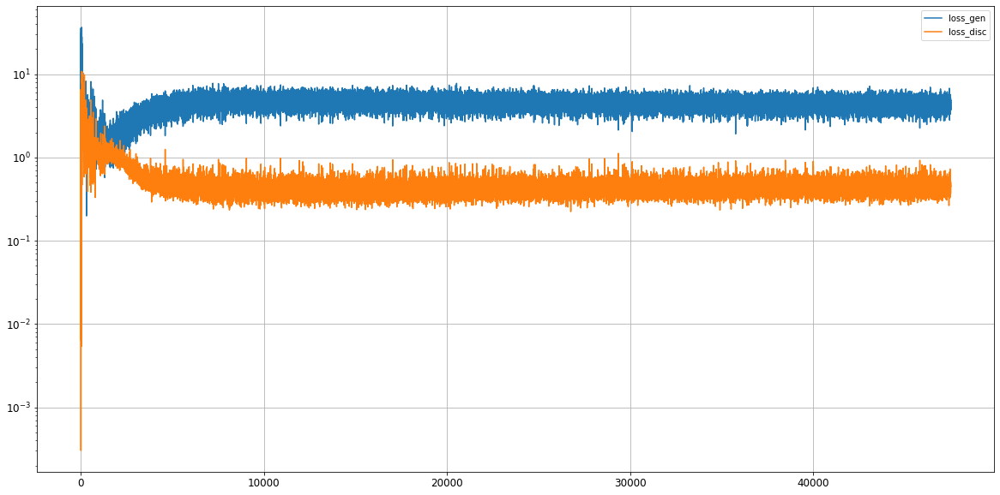

Epoch 47502/50000
0s
Epoch 47503/50000
0s
Epoch 47504/50000
0s
Epoch 47505/50000
0s
Epoch 47506/50000
0s
Epoch 47507/50000
0s
Epoch 47508/50000
0s
Epoch 47509/50000
0s
Epoch 47510/50000
0s
Epoch 47511/50000
0s
Epoch 47512/50000
0s
Epoch 47513/50000
0s
Epoch 47514/50000
0s
Epoch 47515/50000
0s
Epoch 47516/50000
0s
Epoch 47517/50000
0s
Epoch 47518/50000
0s
Epoch 47519/50000
0s
Epoch 47520/50000
0s
Epoch 47521/50000
0s
Epoch 47522/50000
0s
Epoch 47523/50000
0s
Epoch 47524/50000
0s
Epoch 47525/50000
0s
Epoch 47526/50000
0s
Epoch 47527/50000
0s
Epoch 47528/50000
0s
Epoch 47529/50000
0s
Epoch 47530/50000
0s
Epoch 47531/50000
0s
Epoch 47532/50000
0s
Epoch 47533/50000
0s
Epoch 47534/50000
0s
Epoch 47535/50000
0s
Epoch 47536/50000
0s
Epoch 47537/50000
0s
Epoch 47538/50000
0s
Epoch 47539/50000
0s
Epoch 47540/50000
0s
Epoch 47541/50000
0s
Epoch 47542/50000
0s
Epoch 47543/50000
0s
Epoch 47544/50000
0s
Epoch 47545/50000
0s
Epoch 47546/50000
0s
Epoch 47547/50000
0s
Epoch 47548/50000
0s
Epoch 47549/5

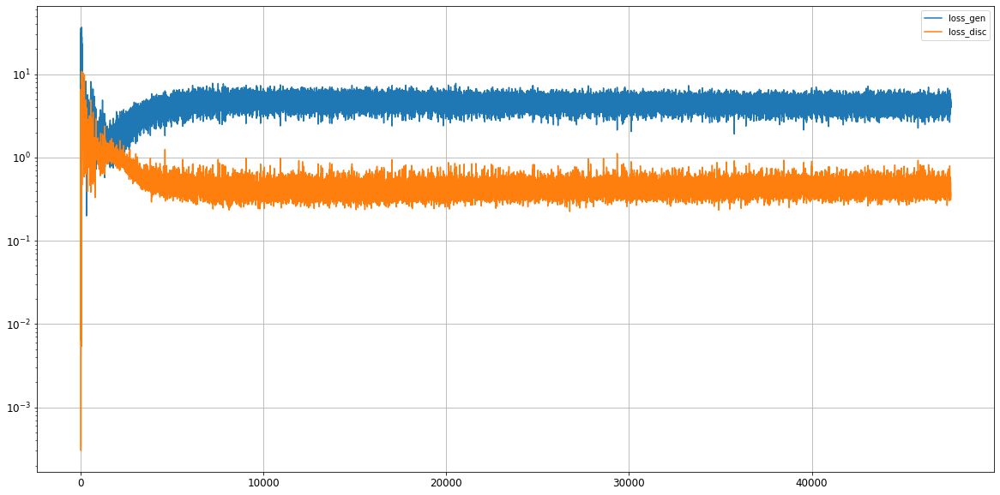

Epoch 47602/50000
0s
Epoch 47603/50000
0s
Epoch 47604/50000
0s
Epoch 47605/50000
0s
Epoch 47606/50000
0s
Epoch 47607/50000
0s
Epoch 47608/50000
0s
Epoch 47609/50000
0s
Epoch 47610/50000
0s
Epoch 47611/50000
0s
Epoch 47612/50000
0s
Epoch 47613/50000
0s
Epoch 47614/50000
0s
Epoch 47615/50000
0s
Epoch 47616/50000
0s
Epoch 47617/50000
0s
Epoch 47618/50000
0s
Epoch 47619/50000
0s
Epoch 47620/50000
0s
Epoch 47621/50000
0s
Epoch 47622/50000
0s
Epoch 47623/50000
0s
Epoch 47624/50000
0s
Epoch 47625/50000
0s
Epoch 47626/50000
0s
Epoch 47627/50000
0s
Epoch 47628/50000
0s
Epoch 47629/50000
0s
Epoch 47630/50000
0s
Epoch 47631/50000
0s
Epoch 47632/50000
0s
Epoch 47633/50000
0s
Epoch 47634/50000
0s
Epoch 47635/50000
0s
Epoch 47636/50000
0s
Epoch 47637/50000
0s
Epoch 47638/50000
0s
Epoch 47639/50000
0s
Epoch 47640/50000
0s
Epoch 47641/50000
0s
Epoch 47642/50000
0s
Epoch 47643/50000
0s
Epoch 47644/50000
0s
Epoch 47645/50000
0s
Epoch 47646/50000
0s
Epoch 47647/50000
0s
Epoch 47648/50000
0s
Epoch 47649/5

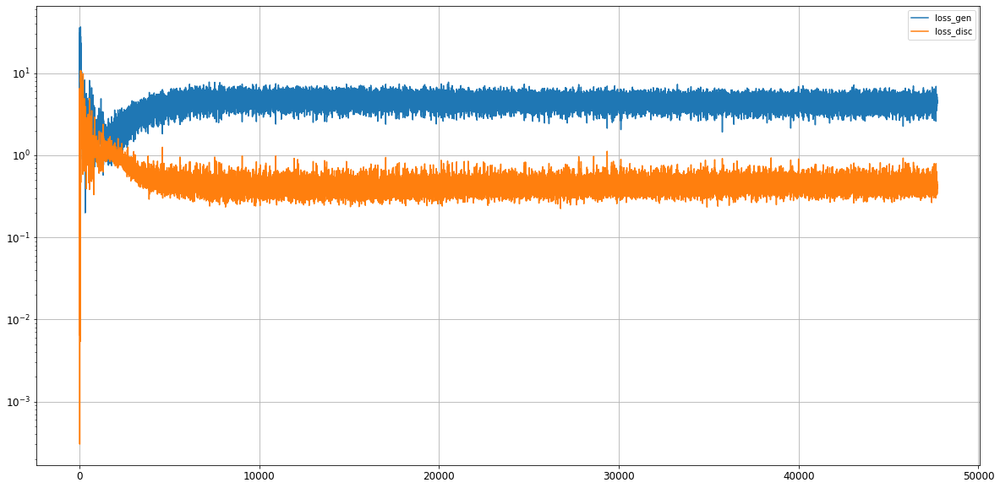

Epoch 47702/50000
0s
Epoch 47703/50000
0s
Epoch 47704/50000
0s
Epoch 47705/50000
0s
Epoch 47706/50000
0s
Epoch 47707/50000
0s
Epoch 47708/50000
0s
Epoch 47709/50000
0s
Epoch 47710/50000
0s
Epoch 47711/50000
0s
Epoch 47712/50000
0s
Epoch 47713/50000
0s
Epoch 47714/50000
0s
Epoch 47715/50000
0s
Epoch 47716/50000
0s
Epoch 47717/50000
0s
Epoch 47718/50000
0s
Epoch 47719/50000
0s
Epoch 47720/50000
0s
Epoch 47721/50000
0s
Epoch 47722/50000
0s
Epoch 47723/50000
0s
Epoch 47724/50000
0s
Epoch 47725/50000
0s
Epoch 47726/50000
0s
Epoch 47727/50000
0s
Epoch 47728/50000
0s
Epoch 47729/50000
0s
Epoch 47730/50000
0s
Epoch 47731/50000
0s
Epoch 47732/50000
0s
Epoch 47733/50000
0s
Epoch 47734/50000
0s
Epoch 47735/50000
0s
Epoch 47736/50000
0s
Epoch 47737/50000
0s
Epoch 47738/50000
0s
Epoch 47739/50000
0s
Epoch 47740/50000
0s
Epoch 47741/50000
0s
Epoch 47742/50000
0s
Epoch 47743/50000
0s
Epoch 47744/50000
0s
Epoch 47745/50000
0s
Epoch 47746/50000
0s
Epoch 47747/50000
0s
Epoch 47748/50000
0s
Epoch 47749/5

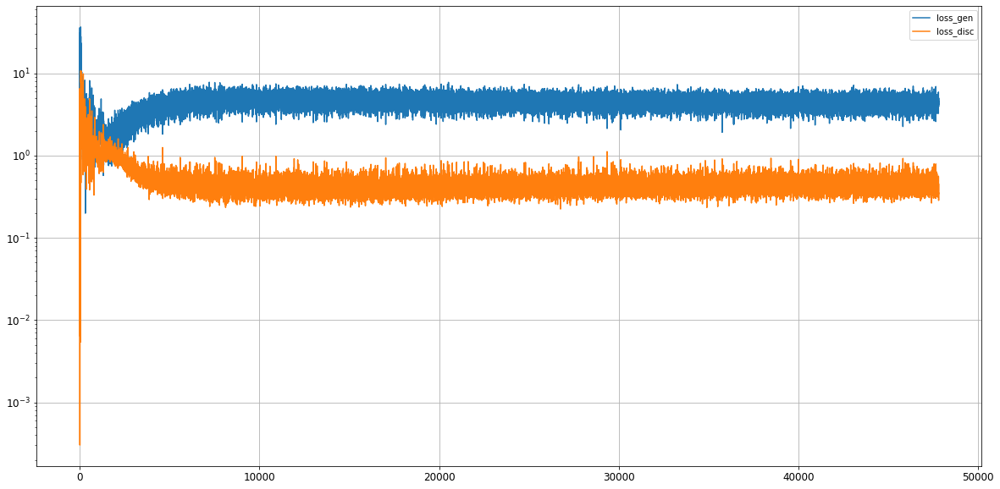

Epoch 47802/50000
0s
Epoch 47803/50000
0s
Epoch 47804/50000
0s
Epoch 47805/50000
0s
Epoch 47806/50000
0s
Epoch 47807/50000
0s
Epoch 47808/50000
0s
Epoch 47809/50000
0s
Epoch 47810/50000
0s
Epoch 47811/50000
0s
Epoch 47812/50000
0s
Epoch 47813/50000
0s
Epoch 47814/50000
0s
Epoch 47815/50000
0s
Epoch 47816/50000
0s
Epoch 47817/50000
0s
Epoch 47818/50000
0s
Epoch 47819/50000
0s
Epoch 47820/50000
0s
Epoch 47821/50000
0s
Epoch 47822/50000
0s
Epoch 47823/50000
0s
Epoch 47824/50000
0s
Epoch 47825/50000
0s
Epoch 47826/50000
0s
Epoch 47827/50000
0s
Epoch 47828/50000
0s
Epoch 47829/50000
0s
Epoch 47830/50000
0s
Epoch 47831/50000
0s
Epoch 47832/50000
0s
Epoch 47833/50000
0s
Epoch 47834/50000
0s
Epoch 47835/50000
0s
Epoch 47836/50000
0s
Epoch 47837/50000
0s
Epoch 47838/50000
0s
Epoch 47839/50000
0s
Epoch 47840/50000
0s
Epoch 47841/50000
0s
Epoch 47842/50000
0s
Epoch 47843/50000
0s
Epoch 47844/50000
0s
Epoch 47845/50000
0s
Epoch 47846/50000
0s
Epoch 47847/50000
0s
Epoch 47848/50000
0s
Epoch 47849/5

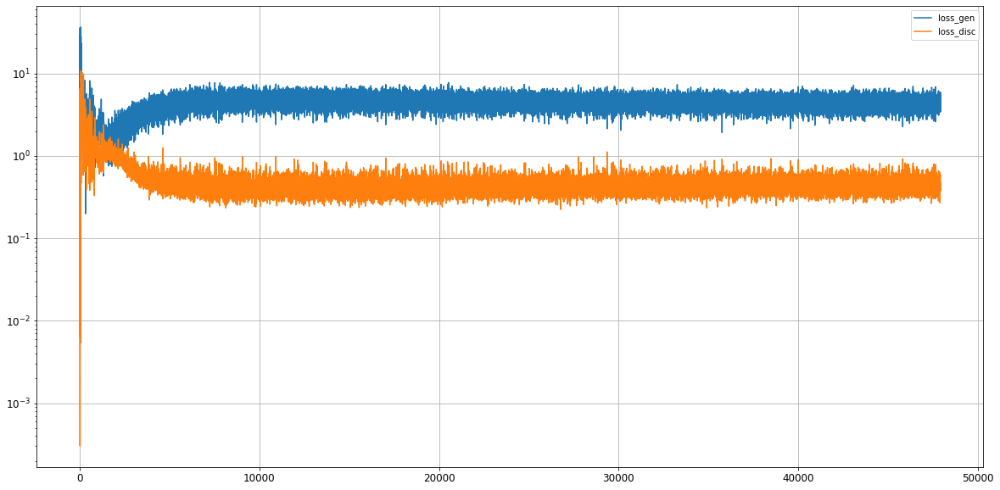

Epoch 47902/50000
0s
Epoch 47903/50000
0s
Epoch 47904/50000
0s
Epoch 47905/50000
0s
Epoch 47906/50000
0s
Epoch 47907/50000
0s
Epoch 47908/50000
0s
Epoch 47909/50000
0s
Epoch 47910/50000
0s
Epoch 47911/50000
0s
Epoch 47912/50000
0s
Epoch 47913/50000
0s
Epoch 47914/50000
0s
Epoch 47915/50000
0s
Epoch 47916/50000
0s
Epoch 47917/50000
0s
Epoch 47918/50000
0s
Epoch 47919/50000
0s
Epoch 47920/50000
0s
Epoch 47921/50000
0s
Epoch 47922/50000
0s
Epoch 47923/50000
0s
Epoch 47924/50000
0s
Epoch 47925/50000
0s
Epoch 47926/50000
0s
Epoch 47927/50000
0s
Epoch 47928/50000
0s
Epoch 47929/50000
0s
Epoch 47930/50000
0s
Epoch 47931/50000
0s
Epoch 47932/50000
0s
Epoch 47933/50000
0s
Epoch 47934/50000
0s
Epoch 47935/50000
0s
Epoch 47936/50000
0s
Epoch 47937/50000
0s
Epoch 47938/50000
0s
Epoch 47939/50000
0s
Epoch 47940/50000
0s
Epoch 47941/50000
0s
Epoch 47942/50000
0s
Epoch 47943/50000
0s
Epoch 47944/50000
0s
Epoch 47945/50000
0s
Epoch 47946/50000
0s
Epoch 47947/50000
0s
Epoch 47948/50000
0s
Epoch 47949/5

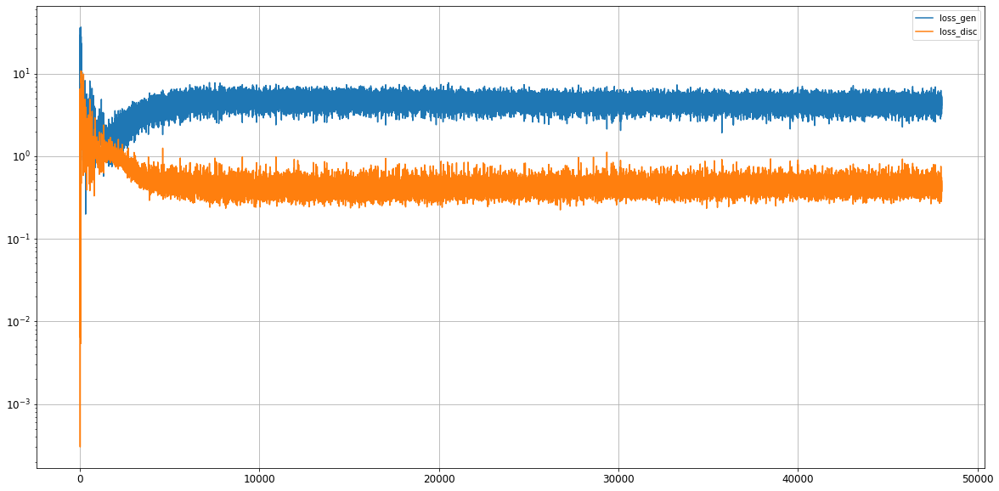

Epoch 48002/50000
0s
Epoch 48003/50000
0s
Epoch 48004/50000
0s
Epoch 48005/50000
0s
Epoch 48006/50000
0s
Epoch 48007/50000
0s
Epoch 48008/50000
0s
Epoch 48009/50000
0s
Epoch 48010/50000
0s
Epoch 48011/50000
0s
Epoch 48012/50000
0s
Epoch 48013/50000
0s
Epoch 48014/50000
0s
Epoch 48015/50000
0s
Epoch 48016/50000
0s
Epoch 48017/50000
0s
Epoch 48018/50000
0s
Epoch 48019/50000
0s
Epoch 48020/50000
0s
Epoch 48021/50000
0s
Epoch 48022/50000
0s
Epoch 48023/50000
0s
Epoch 48024/50000
0s
Epoch 48025/50000
0s
Epoch 48026/50000
0s
Epoch 48027/50000
0s
Epoch 48028/50000
0s
Epoch 48029/50000
0s
Epoch 48030/50000
0s
Epoch 48031/50000
0s
Epoch 48032/50000
0s
Epoch 48033/50000
0s
Epoch 48034/50000
0s
Epoch 48035/50000
0s
Epoch 48036/50000
0s
Epoch 48037/50000
0s
Epoch 48038/50000
0s
Epoch 48039/50000
0s
Epoch 48040/50000
0s
Epoch 48041/50000
0s
Epoch 48042/50000
0s
Epoch 48043/50000
0s
Epoch 48044/50000
0s
Epoch 48045/50000
0s
Epoch 48046/50000
0s
Epoch 48047/50000
0s
Epoch 48048/50000
0s
Epoch 48049/5

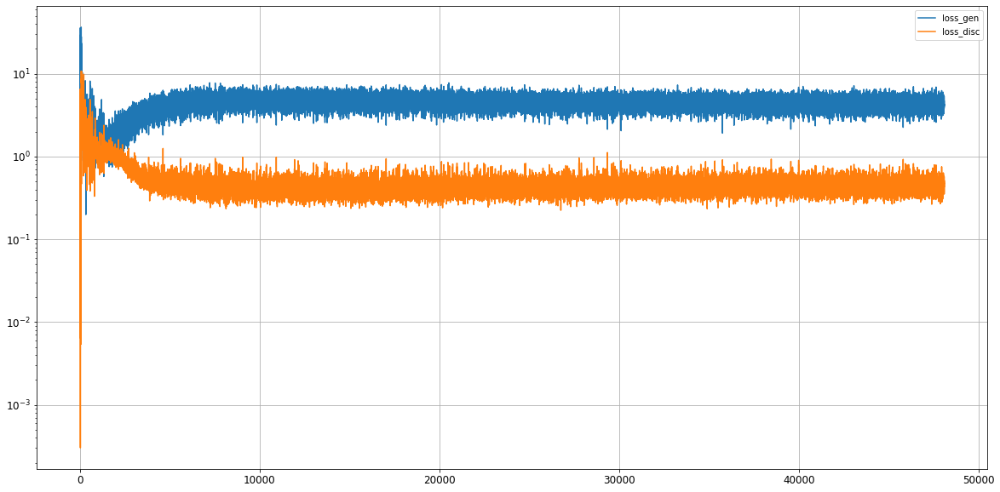

Epoch 48102/50000
0s
Epoch 48103/50000
0s
Epoch 48104/50000
0s
Epoch 48105/50000
0s
Epoch 48106/50000
0s
Epoch 48107/50000
0s
Epoch 48108/50000
0s
Epoch 48109/50000
0s
Epoch 48110/50000
0s
Epoch 48111/50000
0s
Epoch 48112/50000
0s
Epoch 48113/50000
0s
Epoch 48114/50000
0s
Epoch 48115/50000
0s
Epoch 48116/50000
0s
Epoch 48117/50000
0s
Epoch 48118/50000
0s
Epoch 48119/50000
0s
Epoch 48120/50000
0s
Epoch 48121/50000
0s
Epoch 48122/50000
0s
Epoch 48123/50000
0s
Epoch 48124/50000
0s
Epoch 48125/50000
0s
Epoch 48126/50000
0s
Epoch 48127/50000
0s
Epoch 48128/50000
0s
Epoch 48129/50000
0s
Epoch 48130/50000
0s
Epoch 48131/50000
0s
Epoch 48132/50000
0s
Epoch 48133/50000
0s
Epoch 48134/50000
0s
Epoch 48135/50000
0s
Epoch 48136/50000
0s
Epoch 48137/50000
0s
Epoch 48138/50000
0s
Epoch 48139/50000
0s
Epoch 48140/50000
0s
Epoch 48141/50000
0s
Epoch 48142/50000
0s
Epoch 48143/50000
0s
Epoch 48144/50000
0s
Epoch 48145/50000
0s
Epoch 48146/50000
0s
Epoch 48147/50000
0s
Epoch 48148/50000
0s
Epoch 48149/5

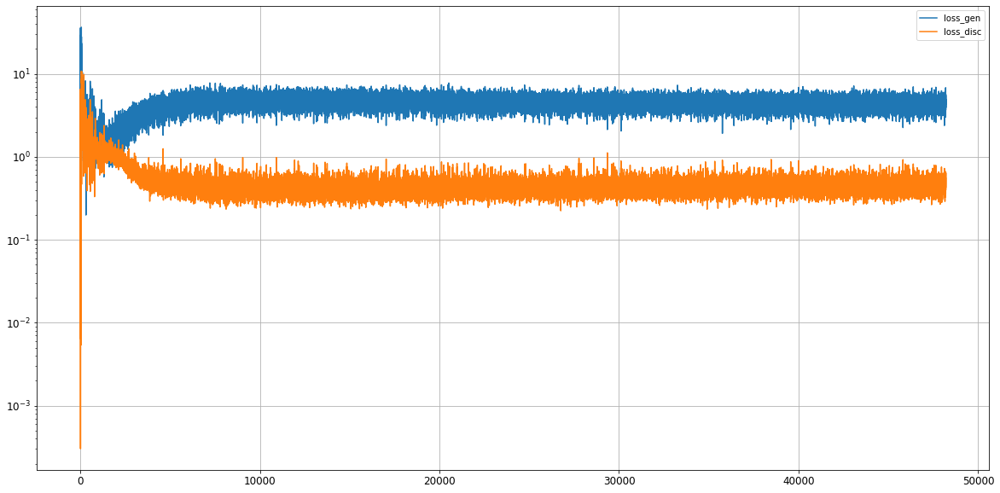

Epoch 48202/50000
0s
Epoch 48203/50000
0s
Epoch 48204/50000
0s
Epoch 48205/50000
0s
Epoch 48206/50000
0s
Epoch 48207/50000
0s
Epoch 48208/50000
0s
Epoch 48209/50000
0s
Epoch 48210/50000
0s
Epoch 48211/50000
0s
Epoch 48212/50000
0s
Epoch 48213/50000
0s
Epoch 48214/50000
0s
Epoch 48215/50000
0s
Epoch 48216/50000
0s
Epoch 48217/50000
0s
Epoch 48218/50000
0s
Epoch 48219/50000
0s
Epoch 48220/50000
0s
Epoch 48221/50000
0s
Epoch 48222/50000
0s
Epoch 48223/50000
0s
Epoch 48224/50000
0s
Epoch 48225/50000
0s
Epoch 48226/50000
0s
Epoch 48227/50000
0s
Epoch 48228/50000
0s
Epoch 48229/50000
0s
Epoch 48230/50000
0s
Epoch 48231/50000
0s
Epoch 48232/50000
0s
Epoch 48233/50000
0s
Epoch 48234/50000
0s
Epoch 48235/50000
0s
Epoch 48236/50000
0s
Epoch 48237/50000
0s
Epoch 48238/50000
0s
Epoch 48239/50000
0s
Epoch 48240/50000
0s
Epoch 48241/50000
0s
Epoch 48242/50000
0s
Epoch 48243/50000
0s
Epoch 48244/50000
0s
Epoch 48245/50000
0s
Epoch 48246/50000
0s
Epoch 48247/50000
0s
Epoch 48248/50000
0s
Epoch 48249/5

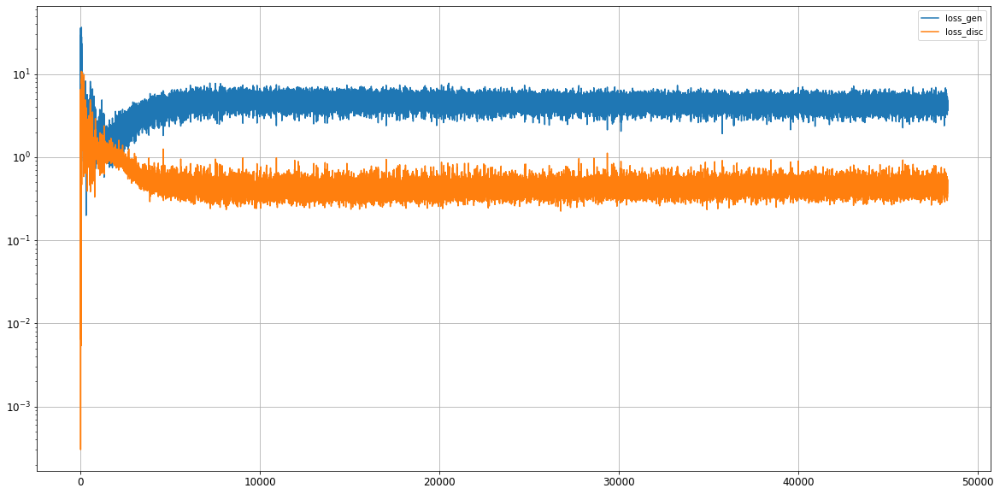

Epoch 48302/50000
0s
Epoch 48303/50000
0s
Epoch 48304/50000
0s
Epoch 48305/50000
0s
Epoch 48306/50000
0s
Epoch 48307/50000
0s
Epoch 48308/50000
0s
Epoch 48309/50000
0s
Epoch 48310/50000
0s
Epoch 48311/50000
0s
Epoch 48312/50000
0s
Epoch 48313/50000
0s
Epoch 48314/50000
0s
Epoch 48315/50000
0s
Epoch 48316/50000
0s
Epoch 48317/50000
0s
Epoch 48318/50000
0s
Epoch 48319/50000
0s
Epoch 48320/50000
0s
Epoch 48321/50000
0s
Epoch 48322/50000
0s
Epoch 48323/50000
0s
Epoch 48324/50000
0s
Epoch 48325/50000
0s
Epoch 48326/50000
0s
Epoch 48327/50000
0s
Epoch 48328/50000
0s
Epoch 48329/50000
0s
Epoch 48330/50000
0s
Epoch 48331/50000
0s
Epoch 48332/50000
0s
Epoch 48333/50000
0s
Epoch 48334/50000
0s
Epoch 48335/50000
0s
Epoch 48336/50000
0s
Epoch 48337/50000
0s
Epoch 48338/50000
0s
Epoch 48339/50000
0s
Epoch 48340/50000
0s
Epoch 48341/50000
0s
Epoch 48342/50000
0s
Epoch 48343/50000
0s
Epoch 48344/50000
0s
Epoch 48345/50000
0s
Epoch 48346/50000
0s
Epoch 48347/50000
0s
Epoch 48348/50000
0s
Epoch 48349/5

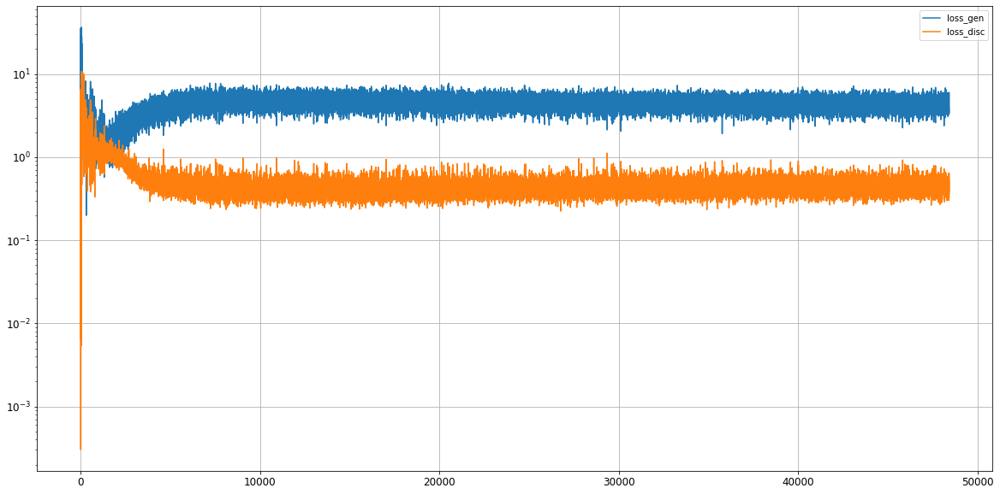

Epoch 48402/50000
0s
Epoch 48403/50000
0s
Epoch 48404/50000
0s
Epoch 48405/50000
0s
Epoch 48406/50000
0s
Epoch 48407/50000
0s
Epoch 48408/50000
0s
Epoch 48409/50000
0s
Epoch 48410/50000
0s
Epoch 48411/50000
0s
Epoch 48412/50000
0s
Epoch 48413/50000
0s
Epoch 48414/50000
0s
Epoch 48415/50000
0s
Epoch 48416/50000
0s
Epoch 48417/50000
0s
Epoch 48418/50000
0s
Epoch 48419/50000
0s
Epoch 48420/50000
0s
Epoch 48421/50000
0s
Epoch 48422/50000
0s
Epoch 48423/50000
0s
Epoch 48424/50000
0s
Epoch 48425/50000
0s
Epoch 48426/50000
0s
Epoch 48427/50000
0s
Epoch 48428/50000
0s
Epoch 48429/50000
0s
Epoch 48430/50000
0s
Epoch 48431/50000
0s
Epoch 48432/50000
0s
Epoch 48433/50000
0s
Epoch 48434/50000
0s
Epoch 48435/50000
0s
Epoch 48436/50000
0s
Epoch 48437/50000
0s
Epoch 48438/50000
0s
Epoch 48439/50000
0s
Epoch 48440/50000
0s
Epoch 48441/50000
0s
Epoch 48442/50000
0s
Epoch 48443/50000
0s
Epoch 48444/50000
0s
Epoch 48445/50000
0s
Epoch 48446/50000
0s
Epoch 48447/50000
0s
Epoch 48448/50000
0s
Epoch 48449/5

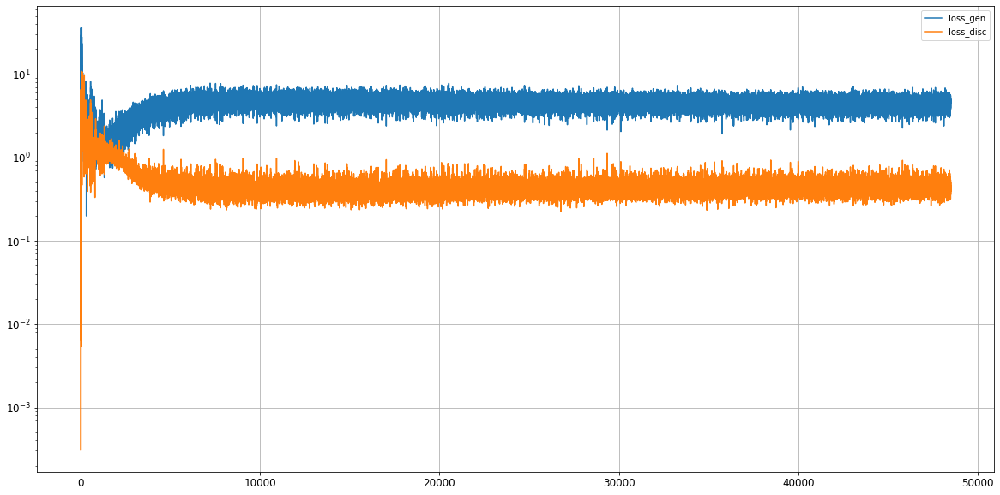

Epoch 48502/50000
0s
Epoch 48503/50000
0s
Epoch 48504/50000
0s
Epoch 48505/50000
0s
Epoch 48506/50000
0s
Epoch 48507/50000
0s
Epoch 48508/50000
0s
Epoch 48509/50000
0s
Epoch 48510/50000
0s
Epoch 48511/50000
0s
Epoch 48512/50000
0s
Epoch 48513/50000
0s
Epoch 48514/50000
0s
Epoch 48515/50000
0s
Epoch 48516/50000
0s
Epoch 48517/50000
0s
Epoch 48518/50000
0s
Epoch 48519/50000
0s
Epoch 48520/50000
0s
Epoch 48521/50000
0s
Epoch 48522/50000
0s
Epoch 48523/50000
0s
Epoch 48524/50000
0s
Epoch 48525/50000
0s
Epoch 48526/50000
0s
Epoch 48527/50000
0s
Epoch 48528/50000
0s
Epoch 48529/50000
0s
Epoch 48530/50000
0s
Epoch 48531/50000
0s
Epoch 48532/50000
0s
Epoch 48533/50000
0s
Epoch 48534/50000
0s
Epoch 48535/50000
0s
Epoch 48536/50000
0s
Epoch 48537/50000
0s
Epoch 48538/50000
0s
Epoch 48539/50000
0s
Epoch 48540/50000
0s
Epoch 48541/50000
0s
Epoch 48542/50000
0s
Epoch 48543/50000
0s
Epoch 48544/50000
0s
Epoch 48545/50000
0s
Epoch 48546/50000
0s
Epoch 48547/50000
0s
Epoch 48548/50000
0s
Epoch 48549/5

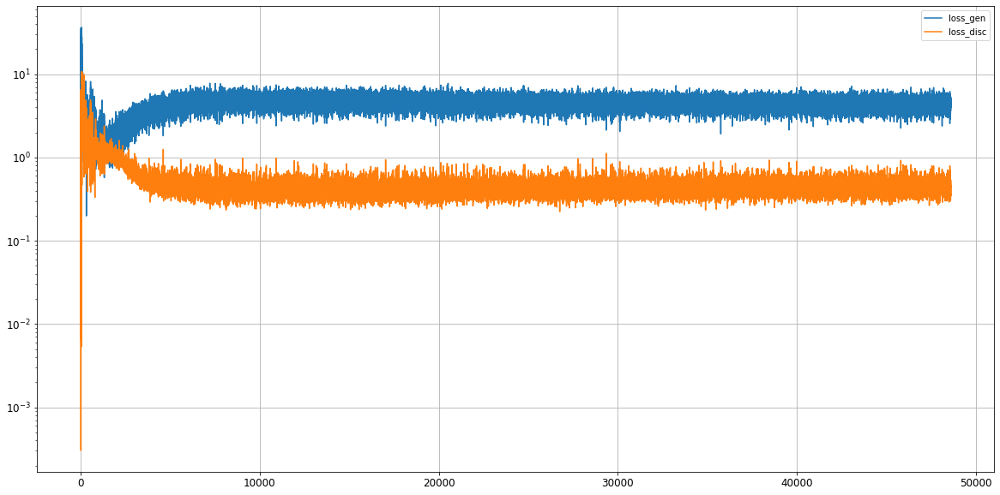

Epoch 48602/50000
0s
Epoch 48603/50000
0s
Epoch 48604/50000
0s
Epoch 48605/50000
0s
Epoch 48606/50000
0s
Epoch 48607/50000
0s
Epoch 48608/50000
0s
Epoch 48609/50000
0s
Epoch 48610/50000
0s
Epoch 48611/50000
0s
Epoch 48612/50000
0s
Epoch 48613/50000
0s
Epoch 48614/50000
0s
Epoch 48615/50000
0s
Epoch 48616/50000
0s
Epoch 48617/50000
0s
Epoch 48618/50000
0s
Epoch 48619/50000
0s
Epoch 48620/50000
0s
Epoch 48621/50000
0s
Epoch 48622/50000
0s
Epoch 48623/50000
0s
Epoch 48624/50000
0s
Epoch 48625/50000
0s
Epoch 48626/50000
0s
Epoch 48627/50000
0s
Epoch 48628/50000
0s
Epoch 48629/50000
0s
Epoch 48630/50000
0s
Epoch 48631/50000
0s
Epoch 48632/50000
0s
Epoch 48633/50000
0s
Epoch 48634/50000
0s
Epoch 48635/50000
0s
Epoch 48636/50000
0s
Epoch 48637/50000
0s
Epoch 48638/50000
0s
Epoch 48639/50000
0s
Epoch 48640/50000
0s
Epoch 48641/50000
0s
Epoch 48642/50000
0s
Epoch 48643/50000
0s
Epoch 48644/50000
0s
Epoch 48645/50000
0s
Epoch 48646/50000
0s
Epoch 48647/50000
0s
Epoch 48648/50000
0s
Epoch 48649/5

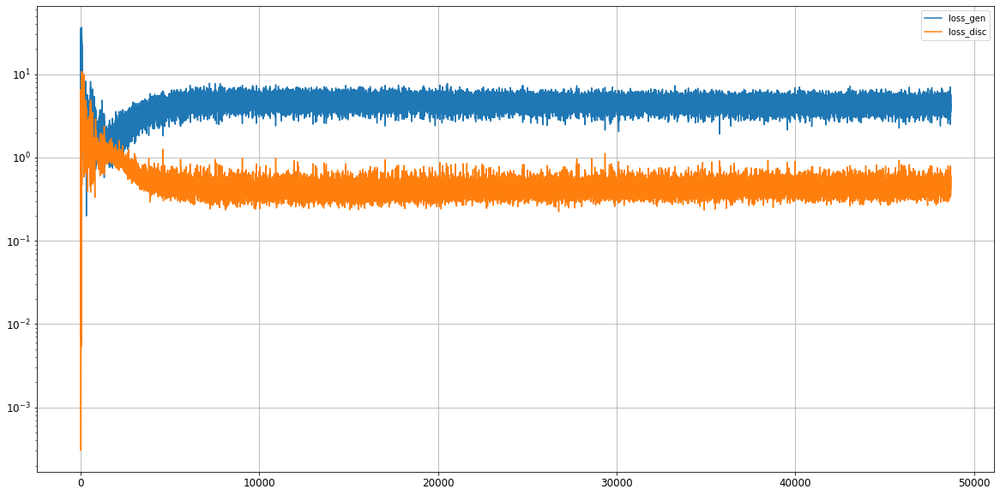

Epoch 48702/50000
0s
Epoch 48703/50000
0s
Epoch 48704/50000
0s
Epoch 48705/50000
0s
Epoch 48706/50000
0s
Epoch 48707/50000
0s
Epoch 48708/50000
0s
Epoch 48709/50000
0s
Epoch 48710/50000
0s
Epoch 48711/50000
0s
Epoch 48712/50000
0s
Epoch 48713/50000
0s
Epoch 48714/50000
0s
Epoch 48715/50000
0s
Epoch 48716/50000
0s
Epoch 48717/50000
0s
Epoch 48718/50000
0s
Epoch 48719/50000
0s
Epoch 48720/50000
0s
Epoch 48721/50000
0s
Epoch 48722/50000
0s
Epoch 48723/50000
0s
Epoch 48724/50000
0s
Epoch 48725/50000
0s
Epoch 48726/50000
0s
Epoch 48727/50000
0s
Epoch 48728/50000
0s
Epoch 48729/50000
0s
Epoch 48730/50000
0s
Epoch 48731/50000
0s
Epoch 48732/50000
0s
Epoch 48733/50000
0s
Epoch 48734/50000
0s
Epoch 48735/50000
0s
Epoch 48736/50000
0s
Epoch 48737/50000
0s
Epoch 48738/50000
0s
Epoch 48739/50000
0s
Epoch 48740/50000
0s
Epoch 48741/50000
0s
Epoch 48742/50000
0s
Epoch 48743/50000
0s
Epoch 48744/50000
0s
Epoch 48745/50000
0s
Epoch 48746/50000
0s
Epoch 48747/50000
0s
Epoch 48748/50000
0s
Epoch 48749/5

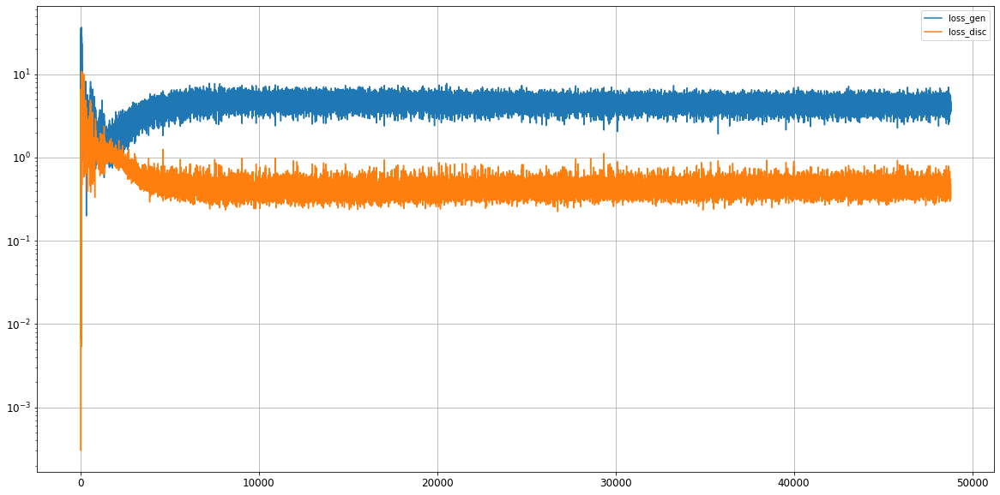

Epoch 48802/50000
0s
Epoch 48803/50000
0s
Epoch 48804/50000
0s
Epoch 48805/50000
0s
Epoch 48806/50000
0s
Epoch 48807/50000
0s
Epoch 48808/50000
0s
Epoch 48809/50000
0s
Epoch 48810/50000
0s
Epoch 48811/50000
0s
Epoch 48812/50000
0s
Epoch 48813/50000
0s
Epoch 48814/50000
0s
Epoch 48815/50000
0s
Epoch 48816/50000
0s
Epoch 48817/50000
0s
Epoch 48818/50000
0s
Epoch 48819/50000
0s
Epoch 48820/50000
0s
Epoch 48821/50000
0s
Epoch 48822/50000
0s
Epoch 48823/50000
0s
Epoch 48824/50000
0s
Epoch 48825/50000
0s
Epoch 48826/50000
0s
Epoch 48827/50000
0s
Epoch 48828/50000
0s
Epoch 48829/50000
0s
Epoch 48830/50000
0s
Epoch 48831/50000
0s
Epoch 48832/50000
0s
Epoch 48833/50000
0s
Epoch 48834/50000
0s
Epoch 48835/50000
0s
Epoch 48836/50000
0s
Epoch 48837/50000
0s
Epoch 48838/50000
0s
Epoch 48839/50000
0s
Epoch 48840/50000
0s
Epoch 48841/50000
0s
Epoch 48842/50000
0s
Epoch 48843/50000
0s
Epoch 48844/50000
0s
Epoch 48845/50000
0s
Epoch 48846/50000
0s
Epoch 48847/50000
0s
Epoch 48848/50000
0s
Epoch 48849/5

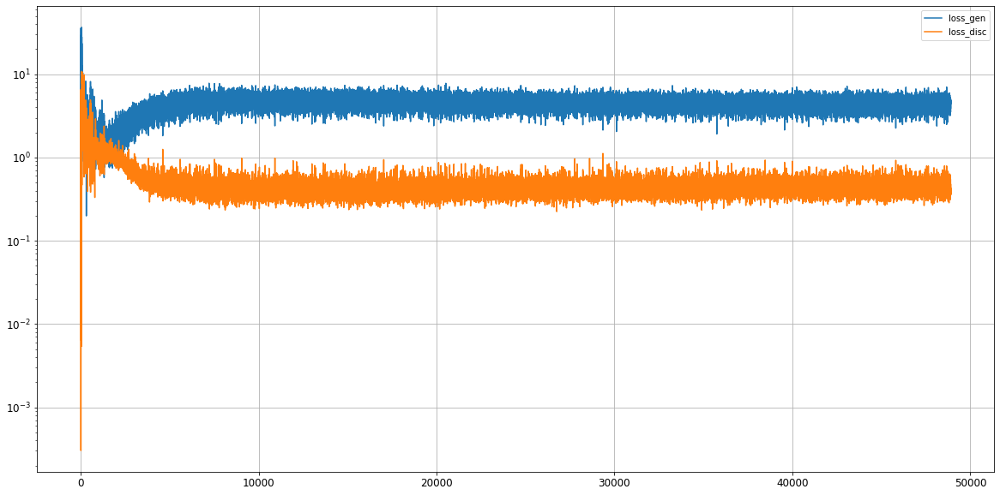

Epoch 48902/50000
0s
Epoch 48903/50000
0s
Epoch 48904/50000
0s
Epoch 48905/50000
0s
Epoch 48906/50000
0s
Epoch 48907/50000
0s
Epoch 48908/50000
0s
Epoch 48909/50000
0s
Epoch 48910/50000
0s
Epoch 48911/50000
0s
Epoch 48912/50000
0s
Epoch 48913/50000
0s
Epoch 48914/50000
0s
Epoch 48915/50000
0s
Epoch 48916/50000
0s
Epoch 48917/50000
0s
Epoch 48918/50000
0s
Epoch 48919/50000
0s
Epoch 48920/50000
0s
Epoch 48921/50000
0s
Epoch 48922/50000
0s
Epoch 48923/50000
0s
Epoch 48924/50000
0s
Epoch 48925/50000
0s
Epoch 48926/50000
0s
Epoch 48927/50000
0s
Epoch 48928/50000
0s
Epoch 48929/50000
0s
Epoch 48930/50000
0s
Epoch 48931/50000
0s
Epoch 48932/50000
0s
Epoch 48933/50000
0s
Epoch 48934/50000
0s
Epoch 48935/50000
0s
Epoch 48936/50000
0s
Epoch 48937/50000
0s
Epoch 48938/50000
0s
Epoch 48939/50000
0s
Epoch 48940/50000
0s
Epoch 48941/50000
0s
Epoch 48942/50000
0s
Epoch 48943/50000
0s
Epoch 48944/50000
0s
Epoch 48945/50000
0s
Epoch 48946/50000
0s
Epoch 48947/50000
0s
Epoch 48948/50000
0s
Epoch 48949/5

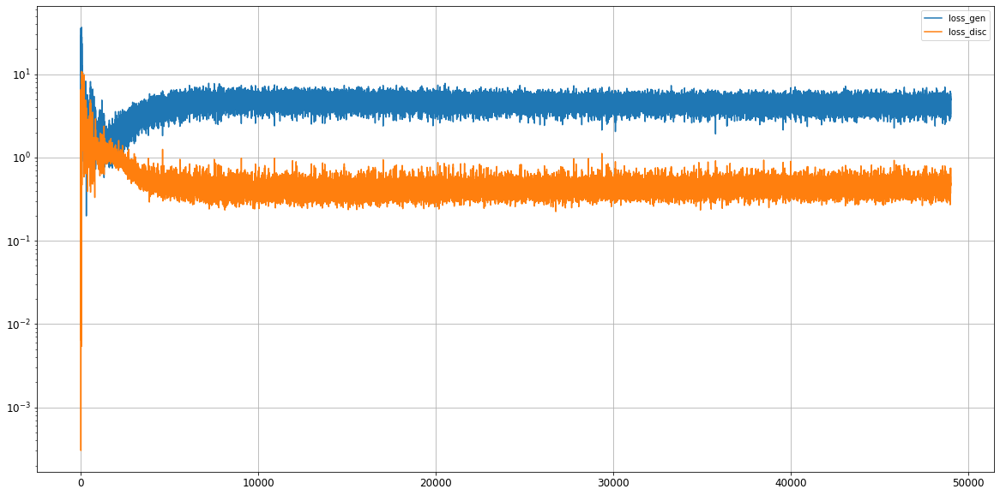

Epoch 49002/50000
0s
Epoch 49003/50000
0s
Epoch 49004/50000
0s
Epoch 49005/50000
0s
Epoch 49006/50000
0s
Epoch 49007/50000
0s
Epoch 49008/50000
0s
Epoch 49009/50000
0s
Epoch 49010/50000
0s
Epoch 49011/50000
0s
Epoch 49012/50000
0s
Epoch 49013/50000
0s
Epoch 49014/50000
0s
Epoch 49015/50000
0s
Epoch 49016/50000
0s
Epoch 49017/50000
0s
Epoch 49018/50000
0s
Epoch 49019/50000
0s
Epoch 49020/50000
0s
Epoch 49021/50000
0s
Epoch 49022/50000
0s
Epoch 49023/50000
0s
Epoch 49024/50000
0s
Epoch 49025/50000
0s
Epoch 49026/50000
0s
Epoch 49027/50000
0s
Epoch 49028/50000
0s
Epoch 49029/50000
0s
Epoch 49030/50000
0s
Epoch 49031/50000
0s
Epoch 49032/50000
0s
Epoch 49033/50000
0s
Epoch 49034/50000
0s
Epoch 49035/50000
0s
Epoch 49036/50000
0s
Epoch 49037/50000
0s
Epoch 49038/50000
0s
Epoch 49039/50000
0s
Epoch 49040/50000
0s
Epoch 49041/50000
0s
Epoch 49042/50000
0s
Epoch 49043/50000
0s
Epoch 49044/50000
0s
Epoch 49045/50000
0s
Epoch 49046/50000
0s
Epoch 49047/50000
0s
Epoch 49048/50000
0s
Epoch 49049/5

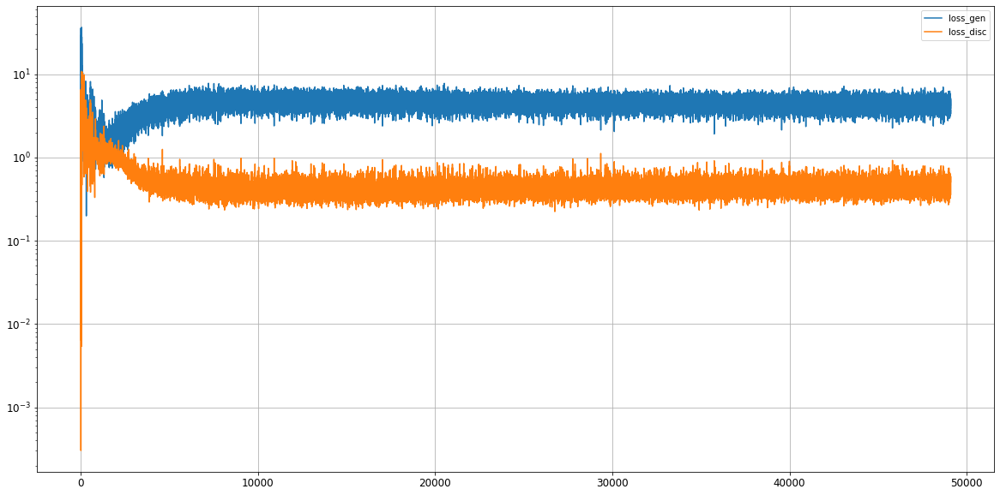

Epoch 49102/50000
0s
Epoch 49103/50000
0s
Epoch 49104/50000
0s
Epoch 49105/50000
0s
Epoch 49106/50000
0s
Epoch 49107/50000
0s
Epoch 49108/50000
0s
Epoch 49109/50000
0s
Epoch 49110/50000
0s
Epoch 49111/50000
0s
Epoch 49112/50000
0s
Epoch 49113/50000
0s
Epoch 49114/50000
0s
Epoch 49115/50000
0s
Epoch 49116/50000
0s
Epoch 49117/50000
0s
Epoch 49118/50000
0s
Epoch 49119/50000
0s
Epoch 49120/50000
0s
Epoch 49121/50000
0s
Epoch 49122/50000
0s
Epoch 49123/50000
0s
Epoch 49124/50000
0s
Epoch 49125/50000
0s
Epoch 49126/50000
0s
Epoch 49127/50000
0s
Epoch 49128/50000
0s
Epoch 49129/50000
0s
Epoch 49130/50000
0s
Epoch 49131/50000
0s
Epoch 49132/50000
0s
Epoch 49133/50000
0s
Epoch 49134/50000
0s
Epoch 49135/50000
0s
Epoch 49136/50000
0s
Epoch 49137/50000
0s
Epoch 49138/50000
0s
Epoch 49139/50000
0s
Epoch 49140/50000
0s
Epoch 49141/50000
0s
Epoch 49142/50000
0s
Epoch 49143/50000
0s
Epoch 49144/50000
0s
Epoch 49145/50000
0s
Epoch 49146/50000
0s
Epoch 49147/50000
0s
Epoch 49148/50000
0s
Epoch 49149/5

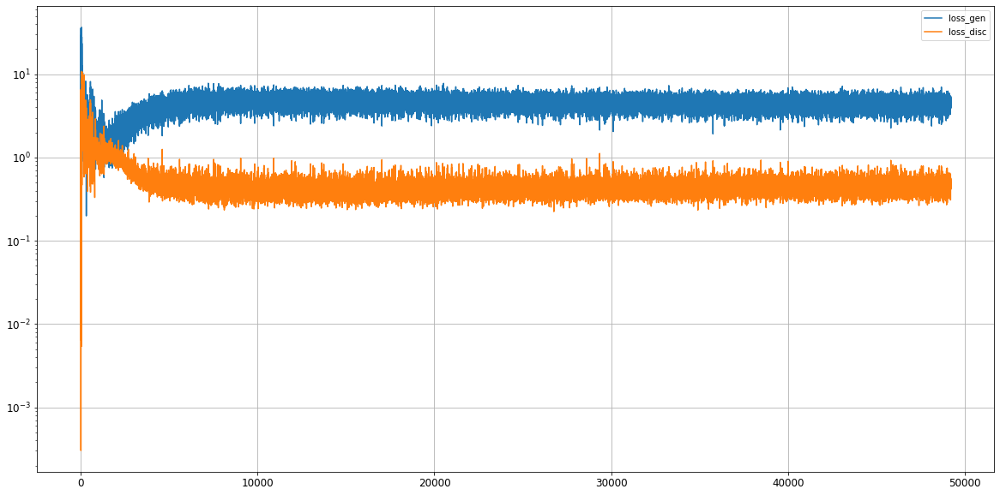

Epoch 49202/50000
0s
Epoch 49203/50000
0s
Epoch 49204/50000
0s
Epoch 49205/50000
0s
Epoch 49206/50000
0s
Epoch 49207/50000
0s
Epoch 49208/50000
0s
Epoch 49209/50000
0s
Epoch 49210/50000
0s
Epoch 49211/50000
0s
Epoch 49212/50000
0s
Epoch 49213/50000
0s
Epoch 49214/50000
0s
Epoch 49215/50000
0s
Epoch 49216/50000
0s
Epoch 49217/50000
0s
Epoch 49218/50000
0s
Epoch 49219/50000
0s
Epoch 49220/50000
0s
Epoch 49221/50000
0s
Epoch 49222/50000
0s
Epoch 49223/50000
0s
Epoch 49224/50000
0s
Epoch 49225/50000
0s
Epoch 49226/50000
0s
Epoch 49227/50000
0s
Epoch 49228/50000
0s
Epoch 49229/50000
0s
Epoch 49230/50000
0s
Epoch 49231/50000
0s
Epoch 49232/50000
0s
Epoch 49233/50000
0s
Epoch 49234/50000
0s
Epoch 49235/50000
0s
Epoch 49236/50000
0s
Epoch 49237/50000
0s
Epoch 49238/50000
0s
Epoch 49239/50000
0s
Epoch 49240/50000
0s
Epoch 49241/50000
0s
Epoch 49242/50000
0s
Epoch 49243/50000
0s
Epoch 49244/50000
0s
Epoch 49245/50000
0s
Epoch 49246/50000
0s
Epoch 49247/50000
0s
Epoch 49248/50000
0s
Epoch 49249/5

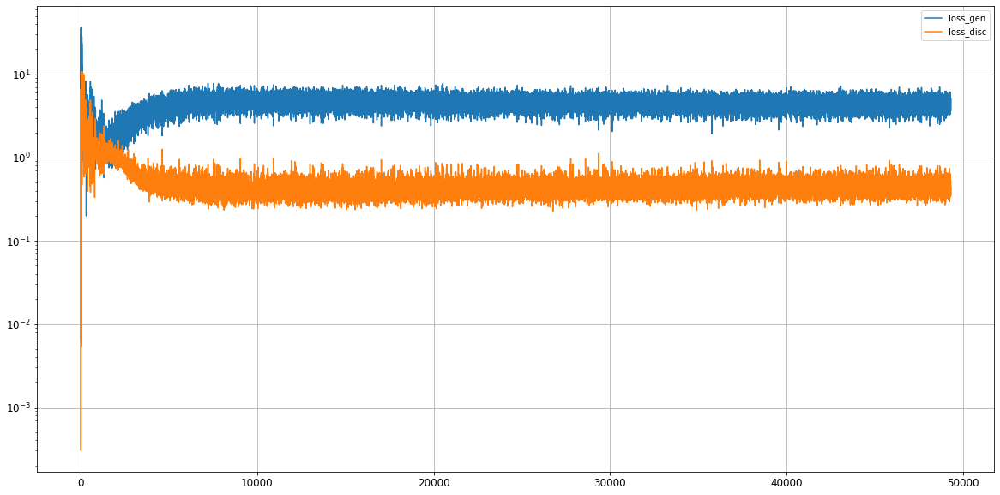

Epoch 49302/50000
0s
Epoch 49303/50000
0s
Epoch 49304/50000
0s
Epoch 49305/50000
0s
Epoch 49306/50000
0s
Epoch 49307/50000
0s
Epoch 49308/50000
0s
Epoch 49309/50000
0s
Epoch 49310/50000
0s
Epoch 49311/50000
0s
Epoch 49312/50000
0s
Epoch 49313/50000
0s
Epoch 49314/50000
0s
Epoch 49315/50000
0s
Epoch 49316/50000
0s
Epoch 49317/50000
0s
Epoch 49318/50000
0s
Epoch 49319/50000
0s
Epoch 49320/50000
0s
Epoch 49321/50000
0s
Epoch 49322/50000
0s
Epoch 49323/50000
0s
Epoch 49324/50000
0s
Epoch 49325/50000
0s
Epoch 49326/50000
0s
Epoch 49327/50000
0s
Epoch 49328/50000
0s
Epoch 49329/50000
0s
Epoch 49330/50000
0s
Epoch 49331/50000
0s
Epoch 49332/50000
0s
Epoch 49333/50000
0s
Epoch 49334/50000
0s
Epoch 49335/50000
0s
Epoch 49336/50000
0s
Epoch 49337/50000
0s
Epoch 49338/50000
0s
Epoch 49339/50000
0s
Epoch 49340/50000
0s
Epoch 49341/50000
0s
Epoch 49342/50000
0s
Epoch 49343/50000
0s
Epoch 49344/50000
0s
Epoch 49345/50000
0s
Epoch 49346/50000
0s
Epoch 49347/50000
0s
Epoch 49348/50000
0s
Epoch 49349/5

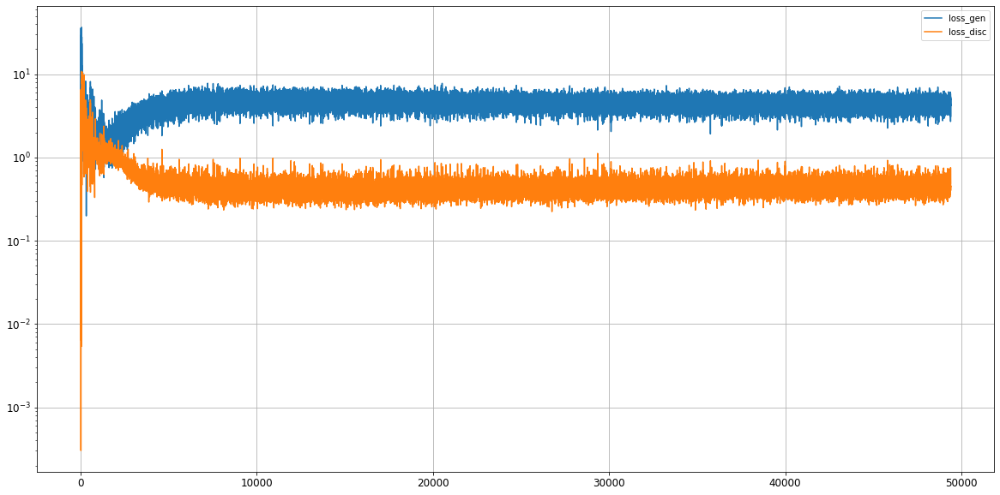

Epoch 49402/50000
0s
Epoch 49403/50000
0s
Epoch 49404/50000
0s
Epoch 49405/50000
0s
Epoch 49406/50000
0s
Epoch 49407/50000
0s
Epoch 49408/50000
0s
Epoch 49409/50000
0s
Epoch 49410/50000
0s
Epoch 49411/50000
0s
Epoch 49412/50000
0s
Epoch 49413/50000
0s
Epoch 49414/50000
0s
Epoch 49415/50000
0s
Epoch 49416/50000
0s
Epoch 49417/50000
0s
Epoch 49418/50000
0s
Epoch 49419/50000
0s
Epoch 49420/50000
0s
Epoch 49421/50000
0s
Epoch 49422/50000
0s
Epoch 49423/50000
0s
Epoch 49424/50000
0s
Epoch 49425/50000
0s
Epoch 49426/50000
0s
Epoch 49427/50000
0s
Epoch 49428/50000
0s
Epoch 49429/50000
0s
Epoch 49430/50000
0s
Epoch 49431/50000
0s
Epoch 49432/50000
0s
Epoch 49433/50000
0s
Epoch 49434/50000
0s
Epoch 49435/50000
0s
Epoch 49436/50000
0s
Epoch 49437/50000
0s
Epoch 49438/50000
0s
Epoch 49439/50000
0s
Epoch 49440/50000
0s
Epoch 49441/50000
0s
Epoch 49442/50000
0s
Epoch 49443/50000
0s
Epoch 49444/50000
0s
Epoch 49445/50000
0s
Epoch 49446/50000
0s
Epoch 49447/50000
0s
Epoch 49448/50000
0s
Epoch 49449/5

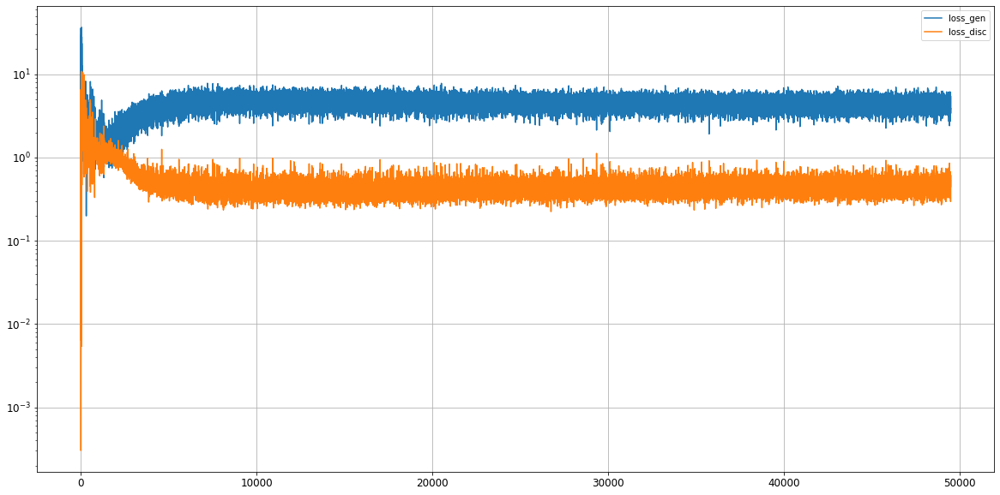

Epoch 49502/50000
0s
Epoch 49503/50000
0s
Epoch 49504/50000
0s
Epoch 49505/50000
0s
Epoch 49506/50000
0s
Epoch 49507/50000
0s
Epoch 49508/50000
0s
Epoch 49509/50000
0s
Epoch 49510/50000
0s
Epoch 49511/50000
0s
Epoch 49512/50000
0s
Epoch 49513/50000
0s
Epoch 49514/50000
0s
Epoch 49515/50000
0s
Epoch 49516/50000
0s
Epoch 49517/50000
0s
Epoch 49518/50000
0s
Epoch 49519/50000
0s
Epoch 49520/50000
0s
Epoch 49521/50000
0s
Epoch 49522/50000
0s
Epoch 49523/50000
0s
Epoch 49524/50000
0s
Epoch 49525/50000
0s
Epoch 49526/50000
0s
Epoch 49527/50000
0s
Epoch 49528/50000
0s
Epoch 49529/50000
0s
Epoch 49530/50000
0s
Epoch 49531/50000
0s
Epoch 49532/50000
0s
Epoch 49533/50000
0s
Epoch 49534/50000
0s
Epoch 49535/50000
0s
Epoch 49536/50000
0s
Epoch 49537/50000
0s
Epoch 49538/50000
0s
Epoch 49539/50000
0s
Epoch 49540/50000
0s
Epoch 49541/50000
0s
Epoch 49542/50000
0s
Epoch 49543/50000
0s
Epoch 49544/50000
0s
Epoch 49545/50000
0s
Epoch 49546/50000
0s
Epoch 49547/50000
0s
Epoch 49548/50000
0s
Epoch 49549/5

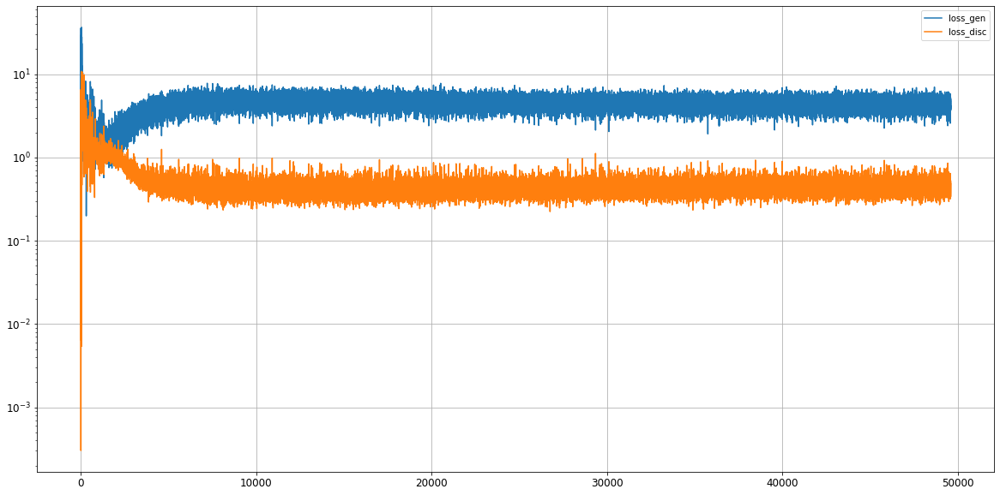

Epoch 49602/50000
0s
Epoch 49603/50000
0s
Epoch 49604/50000
0s
Epoch 49605/50000
0s
Epoch 49606/50000
0s
Epoch 49607/50000
0s
Epoch 49608/50000
0s
Epoch 49609/50000
0s
Epoch 49610/50000
0s
Epoch 49611/50000
0s
Epoch 49612/50000
0s
Epoch 49613/50000
0s
Epoch 49614/50000
0s
Epoch 49615/50000
0s
Epoch 49616/50000
0s
Epoch 49617/50000
0s
Epoch 49618/50000
0s
Epoch 49619/50000
0s
Epoch 49620/50000
0s
Epoch 49621/50000
0s
Epoch 49622/50000
0s
Epoch 49623/50000
0s
Epoch 49624/50000
0s
Epoch 49625/50000
0s
Epoch 49626/50000
0s
Epoch 49627/50000
0s
Epoch 49628/50000
0s
Epoch 49629/50000
0s
Epoch 49630/50000
0s
Epoch 49631/50000
0s
Epoch 49632/50000
0s
Epoch 49633/50000
0s
Epoch 49634/50000
0s
Epoch 49635/50000
0s
Epoch 49636/50000
0s
Epoch 49637/50000
0s
Epoch 49638/50000
0s
Epoch 49639/50000
0s
Epoch 49640/50000
0s
Epoch 49641/50000
0s
Epoch 49642/50000
0s
Epoch 49643/50000
0s
Epoch 49644/50000
0s
Epoch 49645/50000
0s
Epoch 49646/50000
0s
Epoch 49647/50000
0s
Epoch 49648/50000
0s
Epoch 49649/5

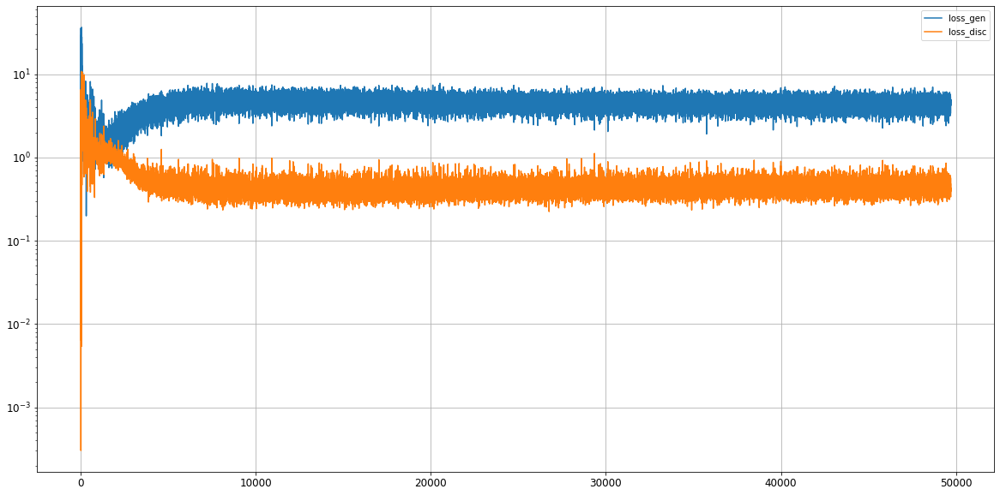

Epoch 49702/50000
0s
Epoch 49703/50000
0s
Epoch 49704/50000
0s
Epoch 49705/50000
0s
Epoch 49706/50000
0s
Epoch 49707/50000
0s
Epoch 49708/50000
0s
Epoch 49709/50000
0s
Epoch 49710/50000
0s
Epoch 49711/50000
0s
Epoch 49712/50000
0s
Epoch 49713/50000
0s
Epoch 49714/50000
0s
Epoch 49715/50000
0s
Epoch 49716/50000
0s
Epoch 49717/50000
0s
Epoch 49718/50000
0s
Epoch 49719/50000
0s
Epoch 49720/50000
0s
Epoch 49721/50000
0s
Epoch 49722/50000
0s
Epoch 49723/50000
0s
Epoch 49724/50000
0s
Epoch 49725/50000
0s
Epoch 49726/50000
0s
Epoch 49727/50000
0s
Epoch 49728/50000
0s
Epoch 49729/50000
0s
Epoch 49730/50000
0s
Epoch 49731/50000
0s
Epoch 49732/50000
0s
Epoch 49733/50000
0s
Epoch 49734/50000
0s
Epoch 49735/50000
0s
Epoch 49736/50000
0s
Epoch 49737/50000
0s
Epoch 49738/50000
0s
Epoch 49739/50000
0s
Epoch 49740/50000
0s
Epoch 49741/50000
0s
Epoch 49742/50000
0s
Epoch 49743/50000
0s
Epoch 49744/50000
0s
Epoch 49745/50000
0s
Epoch 49746/50000
0s
Epoch 49747/50000
0s
Epoch 49748/50000
0s
Epoch 49749/5

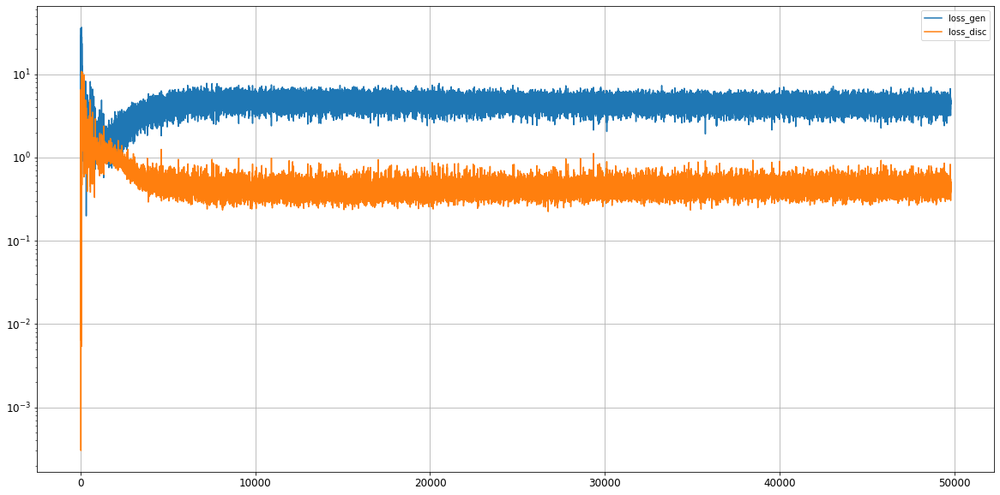

Epoch 49802/50000
0s
Epoch 49803/50000
0s
Epoch 49804/50000
0s
Epoch 49805/50000
0s
Epoch 49806/50000
0s
Epoch 49807/50000
0s
Epoch 49808/50000
0s
Epoch 49809/50000
0s
Epoch 49810/50000
0s
Epoch 49811/50000
0s
Epoch 49812/50000
0s
Epoch 49813/50000
0s
Epoch 49814/50000
0s
Epoch 49815/50000
0s
Epoch 49816/50000
0s
Epoch 49817/50000
0s
Epoch 49818/50000
0s
Epoch 49819/50000
0s
Epoch 49820/50000
0s
Epoch 49821/50000
0s
Epoch 49822/50000
0s
Epoch 49823/50000
0s
Epoch 49824/50000
0s
Epoch 49825/50000
0s
Epoch 49826/50000
0s
Epoch 49827/50000
0s
Epoch 49828/50000
0s
Epoch 49829/50000
0s
Epoch 49830/50000
0s
Epoch 49831/50000
0s
Epoch 49832/50000
0s
Epoch 49833/50000
0s
Epoch 49834/50000
0s
Epoch 49835/50000
0s
Epoch 49836/50000
0s
Epoch 49837/50000
0s
Epoch 49838/50000
0s
Epoch 49839/50000
0s
Epoch 49840/50000
0s
Epoch 49841/50000
0s
Epoch 49842/50000
0s
Epoch 49843/50000
0s
Epoch 49844/50000
0s
Epoch 49845/50000
0s
Epoch 49846/50000
0s
Epoch 49847/50000
0s
Epoch 49848/50000
0s
Epoch 49849/5

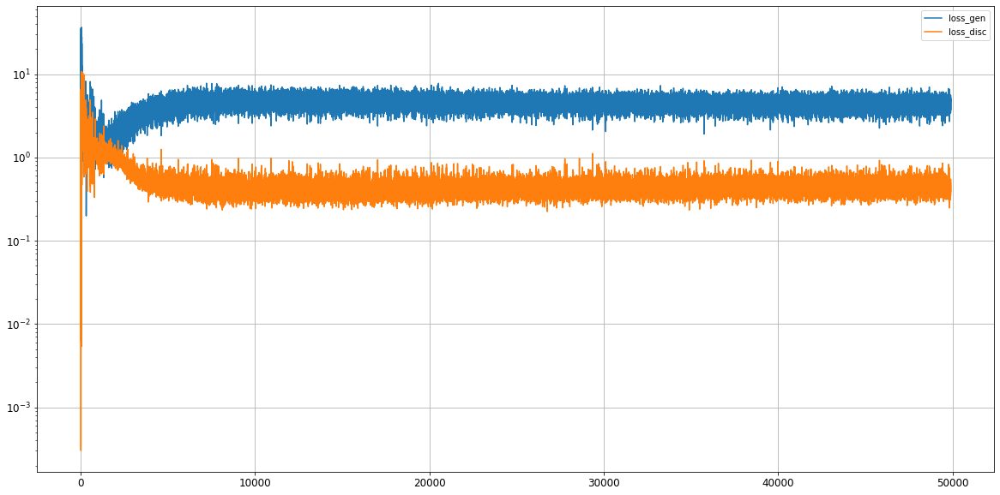

Epoch 49902/50000
0s
Epoch 49903/50000
0s
Epoch 49904/50000
0s
Epoch 49905/50000
0s
Epoch 49906/50000
0s
Epoch 49907/50000
0s
Epoch 49908/50000
0s
Epoch 49909/50000
0s
Epoch 49910/50000
0s
Epoch 49911/50000
0s
Epoch 49912/50000
0s
Epoch 49913/50000
0s
Epoch 49914/50000
0s
Epoch 49915/50000
0s
Epoch 49916/50000
0s
Epoch 49917/50000
0s
Epoch 49918/50000
0s
Epoch 49919/50000
0s
Epoch 49920/50000
0s
Epoch 49921/50000
0s
Epoch 49922/50000
0s
Epoch 49923/50000
0s
Epoch 49924/50000
0s
Epoch 49925/50000
0s
Epoch 49926/50000
0s
Epoch 49927/50000
0s
Epoch 49928/50000
0s
Epoch 49929/50000
0s
Epoch 49930/50000
0s
Epoch 49931/50000
0s
Epoch 49932/50000
0s
Epoch 49933/50000
0s
Epoch 49934/50000
0s
Epoch 49935/50000
0s
Epoch 49936/50000
0s
Epoch 49937/50000
0s
Epoch 49938/50000
0s
Epoch 49939/50000
0s
Epoch 49940/50000
0s
Epoch 49941/50000
0s
Epoch 49942/50000
0s
Epoch 49943/50000
0s
Epoch 49944/50000
0s
Epoch 49945/50000
0s
Epoch 49946/50000
0s
Epoch 49947/50000
0s
Epoch 49948/50000
0s
Epoch 49949/5

In [ ]:
tic = time.time()

hist = train(train_dataset, epochs=30000)

toc = time.time()
print ('\n\nTime : ', toc - tic, 'sec')

In [ ]:
'''
  checking average loss
'''
gensum = 0
discsum = 0
for i in range(len(hist)):
  gensum += hist[i][0]
  discsum += hist[i][-1]
gensum = gensum / len(hist)
discsum = discsum / len(hist)
print(gensum, discsum)

4.587431782354911 0.49186448833267593


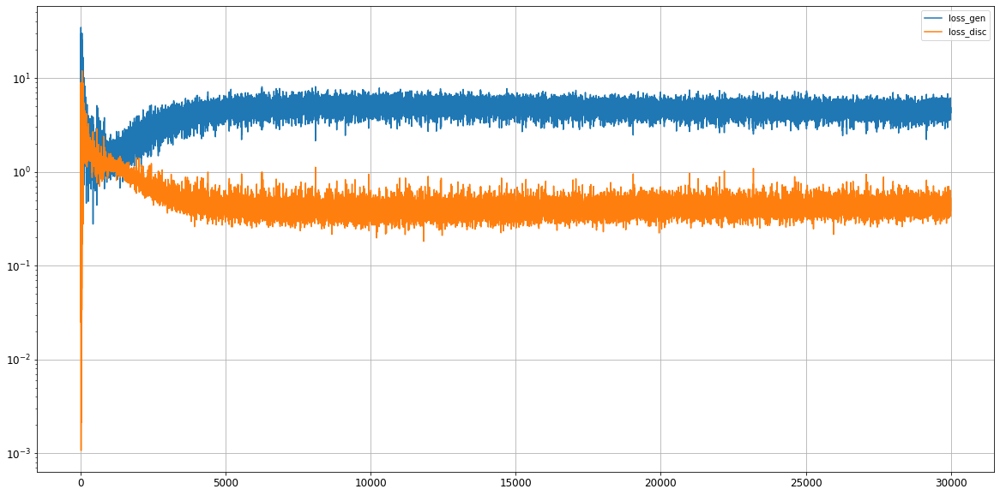

In [ ]:
'''
  outputting generator discriminator loss graph
'''
fig, ax = plt.subplots(1,1, figsize=[20,10])
ax.plot(hist)
ax.legend(['loss_gen', 'loss_disc'])
ax.set_yscale('log')
ax.grid()

Mode collapse check

In [ ]:
noise_check1 = tf.random.normal([1, latent_space])
noise_check2 = tf.random.normal([1, latent_space])

generated_image1 = generator(noise_check1, training=False)
generated_image2 = generator(noise_check2, training=False)

assert(np.allclose(noise_check1, noise_check2) == False)
assert(np.allclose(generated_image1, generated_image2) == False)

In [ ]:
generated_image1 = np.reshape(generated_image1, (9,50))
generated_image2 = np.reshape(generated_image2, (9,50))

Soft mode collapse check - equivalency

In [ ]:
# percentage of elements that are equivalent check
cnt = 0
gen_dim1, gen_dim2 = generated_image1.shape[0], generated_image1.shape[1]
for i in range(gen_dim1):
  for j in range(gen_dim2):
    if generated_image1[i][j] == generated_image2[i][j]:
      cnt += 1

print("percentage of equivalent elements within generated arrays: ", (cnt / (gen_dim1 * gen_dim2)*100), "%")

percentage of equivalent elements within generated arrays:  0.0 %


In [ ]:
'''
This save function saves:
- Architecture of the model, allowing to re-create the model
- Weights of the model
- Training configuration (loss, optimizer)
- The state of the optimizer, allowing to resume trainign exactly where left off
'''

gan.save('output_files/GAN_model_410.h5')